# Model 2.2 Working Space

In [1]:
from trackml.dataset import load_event
print("imported")

imported


In [21]:
import numpy as np
import pandas as pd
from sklearn.preprocessing import MinMaxScaler

def from_event_id_to_sequenced_data_min_max_norm(event_id, scaler = None):

    #load data
    print("Loading data...")
    hits, cells, particles, truth = load_event('train_1/'+event_id)
    print("Done!")
    
    #Get sequenced_hit_ids
    print("Getting sequenced hit ids...")
    sequenced_hit_ids = []
    
    fn="train_1/"+event_id

    A=np.loadtxt(fn+"-truth.csv",skiprows=1,delimiter=',')
    B=np.loadtxt(fn+"-particles.csv",skiprows=1,delimiter=',')

    for n in range(len(B)):
        part_id = B[n,0]

        hits_from_part = np.argwhere(A[:,1]==part_id)[:,0]
        sequenced_hit_ids.append(hits_from_part)
    
    print("Done!")
    #Proprocess event_cells
    print("Proprocessing event_cells...")
    
    
    result = pd.DataFrame({'hit_id':hits['hit_id'],
                            'cell_value_min':np.zeros(hits['hit_id'].shape[0]),
                           'cell_value_max':np.zeros(hits['hit_id'].shape[0]),
                           'cell_value_mean':np.zeros(hits['hit_id'].shape[0]),
                           'cell_value_median':np.zeros(hits['hit_id'].shape[0])
                          })

    for hit_id in hits['hit_id']:
        print("hit id: {}".format(hit_id))
        result.at[hit_id - 1, 'cell_value_mean'] = cells.loc[cells['hit_id'] == hit_id].loc[:,'value'].mean()
        result.at[hit_id - 1, 'cell_value_max'] = cells.loc[cells['hit_id'] == hit_id].loc[:,'value'].max()
        result.at[hit_id - 1, 'cell_value_min'] = cells.loc[cells['hit_id'] == hit_id].loc[:,'value'].min()
        result.at[hit_id - 1, 'cell_value_median'] = cells.loc[cells['hit_id'] == hit_id].loc[:,'value'].median()
    
    print("Done!")
    
    #Merge dataframe
    print("Merging dataframe")
    integrated = pd.merge(result, pd.merge(hits.loc[:,['hit_id','x','y','z']], truth.loc[:,['hit_id','tx','ty','tz']], on='hit_id'),on='hit_id')
    integrated = integrated.drop(columns=['hit_id'])
    print(integrated)
    print("Done!")
    
    if scaler == None:
        scaler = MinMaxScaler(feature_range=(0, 10))
        scaler.fit(integrated)
    else:
        pass
    integrated = pd.DataFrame(scaler.transform(integrated))
    print(integrated)
    print("Done!")
    
    
    #Generate final data
    print("Generating final data...")
    for index, element in enumerate(sequenced_hit_ids):
        sequenced_hit_ids[index] = sequenced_hit_ids[index].tolist()
        
    for particle_index, particle in enumerate(sequenced_hit_ids):
        for hit_index, hit in enumerate(particle):
            sequenced_hit_ids[particle_index][hit_index] = (integrated.iloc[sequenced_hit_ids[particle_index][hit_index]-1,:]).tolist()
    print("Done!")
    print(sequenced_hit_ids[0])
    
    #Padding
    print("Padding...")
    for index_particle, particle in enumerate(sequenced_hit_ids):
        while len(sequenced_hit_ids[index_particle])< 21:
            sequenced_hit_ids[index_particle].append([0,0,0,0,0,0,0,0,0,0])
    print("Done!")
    return sequenced_hit_ids, scaler

In [3]:
def xy_splitter_2_2(data):
    x = [[i[0]] for i in data]
    for index, i in enumerate(x):
        for j in range(19):
            x[index].append([0,0,0,0,0,0,0,0,0,0])
    x = np.array(x)
    y = np.array([i[1:] for i in data])
    return x, y

In [4]:
from sklearn.model_selection import train_test_split

def data_generator_2_2(data):
    X, y = xy_splitter_2_2(data)
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)
    return X_train, X_test, y_train, y_test

In [28]:
sequenced_list_of_hits2, scaler_2_2 = from_event_id_to_sequenced_data_min_max_norm('event000001000')

Loading data...
Done!
Getting sequenced hit ids...
Done!
Proprocessing event_cells...
hit id: 1
hit id: 2
hit id: 3
hit id: 4
hit id: 5
hit id: 6
hit id: 7
hit id: 8
hit id: 9
hit id: 10
hit id: 11
hit id: 12
hit id: 13
hit id: 14
hit id: 15
hit id: 16
hit id: 17
hit id: 18
hit id: 19
hit id: 20
hit id: 21
hit id: 22
hit id: 23
hit id: 24
hit id: 25
hit id: 26
hit id: 27
hit id: 28
hit id: 29
hit id: 30
hit id: 31
hit id: 32
hit id: 33
hit id: 34
hit id: 35
hit id: 36
hit id: 37
hit id: 38
hit id: 39
hit id: 40
hit id: 41
hit id: 42
hit id: 43
hit id: 44
hit id: 45
hit id: 46
hit id: 47
hit id: 48
hit id: 49
hit id: 50
hit id: 51
hit id: 52
hit id: 53
hit id: 54
hit id: 55
hit id: 56
hit id: 57
hit id: 58
hit id: 59
hit id: 60
hit id: 61
hit id: 62
hit id: 63
hit id: 64
hit id: 65
hit id: 66
hit id: 67
hit id: 68
hit id: 69
hit id: 70
hit id: 71
hit id: 72
hit id: 73
hit id: 74
hit id: 75
hit id: 76
hit id: 77
hit id: 78
hit id: 79
hit id: 80
hit id: 81
hit id: 82
hit id: 83
hit id: 84

hit id: 688
hit id: 689
hit id: 690
hit id: 691
hit id: 692
hit id: 693
hit id: 694
hit id: 695
hit id: 696
hit id: 697
hit id: 698
hit id: 699
hit id: 700
hit id: 701
hit id: 702
hit id: 703
hit id: 704
hit id: 705
hit id: 706
hit id: 707
hit id: 708
hit id: 709
hit id: 710
hit id: 711
hit id: 712
hit id: 713
hit id: 714
hit id: 715
hit id: 716
hit id: 717
hit id: 718
hit id: 719
hit id: 720
hit id: 721
hit id: 722
hit id: 723
hit id: 724
hit id: 725
hit id: 726
hit id: 727
hit id: 728
hit id: 729
hit id: 730
hit id: 731
hit id: 732
hit id: 733
hit id: 734
hit id: 735
hit id: 736
hit id: 737
hit id: 738
hit id: 739
hit id: 740
hit id: 741
hit id: 742
hit id: 743
hit id: 744
hit id: 745
hit id: 746
hit id: 747
hit id: 748
hit id: 749
hit id: 750
hit id: 751
hit id: 752
hit id: 753
hit id: 754
hit id: 755
hit id: 756
hit id: 757
hit id: 758
hit id: 759
hit id: 760
hit id: 761
hit id: 762
hit id: 763
hit id: 764
hit id: 765
hit id: 766
hit id: 767
hit id: 768
hit id: 769
hit id: 770
hit 

hit id: 1350
hit id: 1351
hit id: 1352
hit id: 1353
hit id: 1354
hit id: 1355
hit id: 1356
hit id: 1357
hit id: 1358
hit id: 1359
hit id: 1360
hit id: 1361
hit id: 1362
hit id: 1363
hit id: 1364
hit id: 1365
hit id: 1366
hit id: 1367
hit id: 1368
hit id: 1369
hit id: 1370
hit id: 1371
hit id: 1372
hit id: 1373
hit id: 1374
hit id: 1375
hit id: 1376
hit id: 1377
hit id: 1378
hit id: 1379
hit id: 1380
hit id: 1381
hit id: 1382
hit id: 1383
hit id: 1384
hit id: 1385
hit id: 1386
hit id: 1387
hit id: 1388
hit id: 1389
hit id: 1390
hit id: 1391
hit id: 1392
hit id: 1393
hit id: 1394
hit id: 1395
hit id: 1396
hit id: 1397
hit id: 1398
hit id: 1399
hit id: 1400
hit id: 1401
hit id: 1402
hit id: 1403
hit id: 1404
hit id: 1405
hit id: 1406
hit id: 1407
hit id: 1408
hit id: 1409
hit id: 1410
hit id: 1411
hit id: 1412
hit id: 1413
hit id: 1414
hit id: 1415
hit id: 1416
hit id: 1417
hit id: 1418
hit id: 1419
hit id: 1420
hit id: 1421
hit id: 1422
hit id: 1423
hit id: 1424
hit id: 1425
hit id: 1426

hit id: 1995
hit id: 1996
hit id: 1997
hit id: 1998
hit id: 1999
hit id: 2000
hit id: 2001
hit id: 2002
hit id: 2003
hit id: 2004
hit id: 2005
hit id: 2006
hit id: 2007
hit id: 2008
hit id: 2009
hit id: 2010
hit id: 2011
hit id: 2012
hit id: 2013
hit id: 2014
hit id: 2015
hit id: 2016
hit id: 2017
hit id: 2018
hit id: 2019
hit id: 2020
hit id: 2021
hit id: 2022
hit id: 2023
hit id: 2024
hit id: 2025
hit id: 2026
hit id: 2027
hit id: 2028
hit id: 2029
hit id: 2030
hit id: 2031
hit id: 2032
hit id: 2033
hit id: 2034
hit id: 2035
hit id: 2036
hit id: 2037
hit id: 2038
hit id: 2039
hit id: 2040
hit id: 2041
hit id: 2042
hit id: 2043
hit id: 2044
hit id: 2045
hit id: 2046
hit id: 2047
hit id: 2048
hit id: 2049
hit id: 2050
hit id: 2051
hit id: 2052
hit id: 2053
hit id: 2054
hit id: 2055
hit id: 2056
hit id: 2057
hit id: 2058
hit id: 2059
hit id: 2060
hit id: 2061
hit id: 2062
hit id: 2063
hit id: 2064
hit id: 2065
hit id: 2066
hit id: 2067
hit id: 2068
hit id: 2069
hit id: 2070
hit id: 2071

hit id: 2644
hit id: 2645
hit id: 2646
hit id: 2647
hit id: 2648
hit id: 2649
hit id: 2650
hit id: 2651
hit id: 2652
hit id: 2653
hit id: 2654
hit id: 2655
hit id: 2656
hit id: 2657
hit id: 2658
hit id: 2659
hit id: 2660
hit id: 2661
hit id: 2662
hit id: 2663
hit id: 2664
hit id: 2665
hit id: 2666
hit id: 2667
hit id: 2668
hit id: 2669
hit id: 2670
hit id: 2671
hit id: 2672
hit id: 2673
hit id: 2674
hit id: 2675
hit id: 2676
hit id: 2677
hit id: 2678
hit id: 2679
hit id: 2680
hit id: 2681
hit id: 2682
hit id: 2683
hit id: 2684
hit id: 2685
hit id: 2686
hit id: 2687
hit id: 2688
hit id: 2689
hit id: 2690
hit id: 2691
hit id: 2692
hit id: 2693
hit id: 2694
hit id: 2695
hit id: 2696
hit id: 2697
hit id: 2698
hit id: 2699
hit id: 2700
hit id: 2701
hit id: 2702
hit id: 2703
hit id: 2704
hit id: 2705
hit id: 2706
hit id: 2707
hit id: 2708
hit id: 2709
hit id: 2710
hit id: 2711
hit id: 2712
hit id: 2713
hit id: 2714
hit id: 2715
hit id: 2716
hit id: 2717
hit id: 2718
hit id: 2719
hit id: 2720

hit id: 3281
hit id: 3282
hit id: 3283
hit id: 3284
hit id: 3285
hit id: 3286
hit id: 3287
hit id: 3288
hit id: 3289
hit id: 3290
hit id: 3291
hit id: 3292
hit id: 3293
hit id: 3294
hit id: 3295
hit id: 3296
hit id: 3297
hit id: 3298
hit id: 3299
hit id: 3300
hit id: 3301
hit id: 3302
hit id: 3303
hit id: 3304
hit id: 3305
hit id: 3306
hit id: 3307
hit id: 3308
hit id: 3309
hit id: 3310
hit id: 3311
hit id: 3312
hit id: 3313
hit id: 3314
hit id: 3315
hit id: 3316
hit id: 3317
hit id: 3318
hit id: 3319
hit id: 3320
hit id: 3321
hit id: 3322
hit id: 3323
hit id: 3324
hit id: 3325
hit id: 3326
hit id: 3327
hit id: 3328
hit id: 3329
hit id: 3330
hit id: 3331
hit id: 3332
hit id: 3333
hit id: 3334
hit id: 3335
hit id: 3336
hit id: 3337
hit id: 3338
hit id: 3339
hit id: 3340
hit id: 3341
hit id: 3342
hit id: 3343
hit id: 3344
hit id: 3345
hit id: 3346
hit id: 3347
hit id: 3348
hit id: 3349
hit id: 3350
hit id: 3351
hit id: 3352
hit id: 3353
hit id: 3354
hit id: 3355
hit id: 3356
hit id: 3357

hit id: 3917
hit id: 3918
hit id: 3919
hit id: 3920
hit id: 3921
hit id: 3922
hit id: 3923
hit id: 3924
hit id: 3925
hit id: 3926
hit id: 3927
hit id: 3928
hit id: 3929
hit id: 3930
hit id: 3931
hit id: 3932
hit id: 3933
hit id: 3934
hit id: 3935
hit id: 3936
hit id: 3937
hit id: 3938
hit id: 3939
hit id: 3940
hit id: 3941
hit id: 3942
hit id: 3943
hit id: 3944
hit id: 3945
hit id: 3946
hit id: 3947
hit id: 3948
hit id: 3949
hit id: 3950
hit id: 3951
hit id: 3952
hit id: 3953
hit id: 3954
hit id: 3955
hit id: 3956
hit id: 3957
hit id: 3958
hit id: 3959
hit id: 3960
hit id: 3961
hit id: 3962
hit id: 3963
hit id: 3964
hit id: 3965
hit id: 3966
hit id: 3967
hit id: 3968
hit id: 3969
hit id: 3970
hit id: 3971
hit id: 3972
hit id: 3973
hit id: 3974
hit id: 3975
hit id: 3976
hit id: 3977
hit id: 3978
hit id: 3979
hit id: 3980
hit id: 3981
hit id: 3982
hit id: 3983
hit id: 3984
hit id: 3985
hit id: 3986
hit id: 3987
hit id: 3988
hit id: 3989
hit id: 3990
hit id: 3991
hit id: 3992
hit id: 3993

hit id: 4552
hit id: 4553
hit id: 4554
hit id: 4555
hit id: 4556
hit id: 4557
hit id: 4558
hit id: 4559
hit id: 4560
hit id: 4561
hit id: 4562
hit id: 4563
hit id: 4564
hit id: 4565
hit id: 4566
hit id: 4567
hit id: 4568
hit id: 4569
hit id: 4570
hit id: 4571
hit id: 4572
hit id: 4573
hit id: 4574
hit id: 4575
hit id: 4576
hit id: 4577
hit id: 4578
hit id: 4579
hit id: 4580
hit id: 4581
hit id: 4582
hit id: 4583
hit id: 4584
hit id: 4585
hit id: 4586
hit id: 4587
hit id: 4588
hit id: 4589
hit id: 4590
hit id: 4591
hit id: 4592
hit id: 4593
hit id: 4594
hit id: 4595
hit id: 4596
hit id: 4597
hit id: 4598
hit id: 4599
hit id: 4600
hit id: 4601
hit id: 4602
hit id: 4603
hit id: 4604
hit id: 4605
hit id: 4606
hit id: 4607
hit id: 4608
hit id: 4609
hit id: 4610
hit id: 4611
hit id: 4612
hit id: 4613
hit id: 4614
hit id: 4615
hit id: 4616
hit id: 4617
hit id: 4618
hit id: 4619
hit id: 4620
hit id: 4621
hit id: 4622
hit id: 4623
hit id: 4624
hit id: 4625
hit id: 4626
hit id: 4627
hit id: 4628

hit id: 5184
hit id: 5185
hit id: 5186
hit id: 5187
hit id: 5188
hit id: 5189
hit id: 5190
hit id: 5191
hit id: 5192
hit id: 5193
hit id: 5194
hit id: 5195
hit id: 5196
hit id: 5197
hit id: 5198
hit id: 5199
hit id: 5200
hit id: 5201
hit id: 5202
hit id: 5203
hit id: 5204
hit id: 5205
hit id: 5206
hit id: 5207
hit id: 5208
hit id: 5209
hit id: 5210
hit id: 5211
hit id: 5212
hit id: 5213
hit id: 5214
hit id: 5215
hit id: 5216
hit id: 5217
hit id: 5218
hit id: 5219
hit id: 5220
hit id: 5221
hit id: 5222
hit id: 5223
hit id: 5224
hit id: 5225
hit id: 5226
hit id: 5227
hit id: 5228
hit id: 5229
hit id: 5230
hit id: 5231
hit id: 5232
hit id: 5233
hit id: 5234
hit id: 5235
hit id: 5236
hit id: 5237
hit id: 5238
hit id: 5239
hit id: 5240
hit id: 5241
hit id: 5242
hit id: 5243
hit id: 5244
hit id: 5245
hit id: 5246
hit id: 5247
hit id: 5248
hit id: 5249
hit id: 5250
hit id: 5251
hit id: 5252
hit id: 5253
hit id: 5254
hit id: 5255
hit id: 5256
hit id: 5257
hit id: 5258
hit id: 5259
hit id: 5260

hit id: 5819
hit id: 5820
hit id: 5821
hit id: 5822
hit id: 5823
hit id: 5824
hit id: 5825
hit id: 5826
hit id: 5827
hit id: 5828
hit id: 5829
hit id: 5830
hit id: 5831
hit id: 5832
hit id: 5833
hit id: 5834
hit id: 5835
hit id: 5836
hit id: 5837
hit id: 5838
hit id: 5839
hit id: 5840
hit id: 5841
hit id: 5842
hit id: 5843
hit id: 5844
hit id: 5845
hit id: 5846
hit id: 5847
hit id: 5848
hit id: 5849
hit id: 5850
hit id: 5851
hit id: 5852
hit id: 5853
hit id: 5854
hit id: 5855
hit id: 5856
hit id: 5857
hit id: 5858
hit id: 5859
hit id: 5860
hit id: 5861
hit id: 5862
hit id: 5863
hit id: 5864
hit id: 5865
hit id: 5866
hit id: 5867
hit id: 5868
hit id: 5869
hit id: 5870
hit id: 5871
hit id: 5872
hit id: 5873
hit id: 5874
hit id: 5875
hit id: 5876
hit id: 5877
hit id: 5878
hit id: 5879
hit id: 5880
hit id: 5881
hit id: 5882
hit id: 5883
hit id: 5884
hit id: 5885
hit id: 5886
hit id: 5887
hit id: 5888
hit id: 5889
hit id: 5890
hit id: 5891
hit id: 5892
hit id: 5893
hit id: 5894
hit id: 5895

hit id: 6467
hit id: 6468
hit id: 6469
hit id: 6470
hit id: 6471
hit id: 6472
hit id: 6473
hit id: 6474
hit id: 6475
hit id: 6476
hit id: 6477
hit id: 6478
hit id: 6479
hit id: 6480
hit id: 6481
hit id: 6482
hit id: 6483
hit id: 6484
hit id: 6485
hit id: 6486
hit id: 6487
hit id: 6488
hit id: 6489
hit id: 6490
hit id: 6491
hit id: 6492
hit id: 6493
hit id: 6494
hit id: 6495
hit id: 6496
hit id: 6497
hit id: 6498
hit id: 6499
hit id: 6500
hit id: 6501
hit id: 6502
hit id: 6503
hit id: 6504
hit id: 6505
hit id: 6506
hit id: 6507
hit id: 6508
hit id: 6509
hit id: 6510
hit id: 6511
hit id: 6512
hit id: 6513
hit id: 6514
hit id: 6515
hit id: 6516
hit id: 6517
hit id: 6518
hit id: 6519
hit id: 6520
hit id: 6521
hit id: 6522
hit id: 6523
hit id: 6524
hit id: 6525
hit id: 6526
hit id: 6527
hit id: 6528
hit id: 6529
hit id: 6530
hit id: 6531
hit id: 6532
hit id: 6533
hit id: 6534
hit id: 6535
hit id: 6536
hit id: 6537
hit id: 6538
hit id: 6539
hit id: 6540
hit id: 6541
hit id: 6542
hit id: 6543

hit id: 7101
hit id: 7102
hit id: 7103
hit id: 7104
hit id: 7105
hit id: 7106
hit id: 7107
hit id: 7108
hit id: 7109
hit id: 7110
hit id: 7111
hit id: 7112
hit id: 7113
hit id: 7114
hit id: 7115
hit id: 7116
hit id: 7117
hit id: 7118
hit id: 7119
hit id: 7120
hit id: 7121
hit id: 7122
hit id: 7123
hit id: 7124
hit id: 7125
hit id: 7126
hit id: 7127
hit id: 7128
hit id: 7129
hit id: 7130
hit id: 7131
hit id: 7132
hit id: 7133
hit id: 7134
hit id: 7135
hit id: 7136
hit id: 7137
hit id: 7138
hit id: 7139
hit id: 7140
hit id: 7141
hit id: 7142
hit id: 7143
hit id: 7144
hit id: 7145
hit id: 7146
hit id: 7147
hit id: 7148
hit id: 7149
hit id: 7150
hit id: 7151
hit id: 7152
hit id: 7153
hit id: 7154
hit id: 7155
hit id: 7156
hit id: 7157
hit id: 7158
hit id: 7159
hit id: 7160
hit id: 7161
hit id: 7162
hit id: 7163
hit id: 7164
hit id: 7165
hit id: 7166
hit id: 7167
hit id: 7168
hit id: 7169
hit id: 7170
hit id: 7171
hit id: 7172
hit id: 7173
hit id: 7174
hit id: 7175
hit id: 7176
hit id: 7177

hit id: 7747
hit id: 7748
hit id: 7749
hit id: 7750
hit id: 7751
hit id: 7752
hit id: 7753
hit id: 7754
hit id: 7755
hit id: 7756
hit id: 7757
hit id: 7758
hit id: 7759
hit id: 7760
hit id: 7761
hit id: 7762
hit id: 7763
hit id: 7764
hit id: 7765
hit id: 7766
hit id: 7767
hit id: 7768
hit id: 7769
hit id: 7770
hit id: 7771
hit id: 7772
hit id: 7773
hit id: 7774
hit id: 7775
hit id: 7776
hit id: 7777
hit id: 7778
hit id: 7779
hit id: 7780
hit id: 7781
hit id: 7782
hit id: 7783
hit id: 7784
hit id: 7785
hit id: 7786
hit id: 7787
hit id: 7788
hit id: 7789
hit id: 7790
hit id: 7791
hit id: 7792
hit id: 7793
hit id: 7794
hit id: 7795
hit id: 7796
hit id: 7797
hit id: 7798
hit id: 7799
hit id: 7800
hit id: 7801
hit id: 7802
hit id: 7803
hit id: 7804
hit id: 7805
hit id: 7806
hit id: 7807
hit id: 7808
hit id: 7809
hit id: 7810
hit id: 7811
hit id: 7812
hit id: 7813
hit id: 7814
hit id: 7815
hit id: 7816
hit id: 7817
hit id: 7818
hit id: 7819
hit id: 7820
hit id: 7821
hit id: 7822
hit id: 7823

hit id: 8383
hit id: 8384
hit id: 8385
hit id: 8386
hit id: 8387
hit id: 8388
hit id: 8389
hit id: 8390
hit id: 8391
hit id: 8392
hit id: 8393
hit id: 8394
hit id: 8395
hit id: 8396
hit id: 8397
hit id: 8398
hit id: 8399
hit id: 8400
hit id: 8401
hit id: 8402
hit id: 8403
hit id: 8404
hit id: 8405
hit id: 8406
hit id: 8407
hit id: 8408
hit id: 8409
hit id: 8410
hit id: 8411
hit id: 8412
hit id: 8413
hit id: 8414
hit id: 8415
hit id: 8416
hit id: 8417
hit id: 8418
hit id: 8419
hit id: 8420
hit id: 8421
hit id: 8422
hit id: 8423
hit id: 8424
hit id: 8425
hit id: 8426
hit id: 8427
hit id: 8428
hit id: 8429
hit id: 8430
hit id: 8431
hit id: 8432
hit id: 8433
hit id: 8434
hit id: 8435
hit id: 8436
hit id: 8437
hit id: 8438
hit id: 8439
hit id: 8440
hit id: 8441
hit id: 8442
hit id: 8443
hit id: 8444
hit id: 8445
hit id: 8446
hit id: 8447
hit id: 8448
hit id: 8449
hit id: 8450
hit id: 8451
hit id: 8452
hit id: 8453
hit id: 8454
hit id: 8455
hit id: 8456
hit id: 8457
hit id: 8458
hit id: 8459

hit id: 9025
hit id: 9026
hit id: 9027
hit id: 9028
hit id: 9029
hit id: 9030
hit id: 9031
hit id: 9032
hit id: 9033
hit id: 9034
hit id: 9035
hit id: 9036
hit id: 9037
hit id: 9038
hit id: 9039
hit id: 9040
hit id: 9041
hit id: 9042
hit id: 9043
hit id: 9044
hit id: 9045
hit id: 9046
hit id: 9047
hit id: 9048
hit id: 9049
hit id: 9050
hit id: 9051
hit id: 9052
hit id: 9053
hit id: 9054
hit id: 9055
hit id: 9056
hit id: 9057
hit id: 9058
hit id: 9059
hit id: 9060
hit id: 9061
hit id: 9062
hit id: 9063
hit id: 9064
hit id: 9065
hit id: 9066
hit id: 9067
hit id: 9068
hit id: 9069
hit id: 9070
hit id: 9071
hit id: 9072
hit id: 9073
hit id: 9074
hit id: 9075
hit id: 9076
hit id: 9077
hit id: 9078
hit id: 9079
hit id: 9080
hit id: 9081
hit id: 9082
hit id: 9083
hit id: 9084
hit id: 9085
hit id: 9086
hit id: 9087
hit id: 9088
hit id: 9089
hit id: 9090
hit id: 9091
hit id: 9092
hit id: 9093
hit id: 9094
hit id: 9095
hit id: 9096
hit id: 9097
hit id: 9098
hit id: 9099
hit id: 9100
hit id: 9101

hit id: 9668
hit id: 9669
hit id: 9670
hit id: 9671
hit id: 9672
hit id: 9673
hit id: 9674
hit id: 9675
hit id: 9676
hit id: 9677
hit id: 9678
hit id: 9679
hit id: 9680
hit id: 9681
hit id: 9682
hit id: 9683
hit id: 9684
hit id: 9685
hit id: 9686
hit id: 9687
hit id: 9688
hit id: 9689
hit id: 9690
hit id: 9691
hit id: 9692
hit id: 9693
hit id: 9694
hit id: 9695
hit id: 9696
hit id: 9697
hit id: 9698
hit id: 9699
hit id: 9700
hit id: 9701
hit id: 9702
hit id: 9703
hit id: 9704
hit id: 9705
hit id: 9706
hit id: 9707
hit id: 9708
hit id: 9709
hit id: 9710
hit id: 9711
hit id: 9712
hit id: 9713
hit id: 9714
hit id: 9715
hit id: 9716
hit id: 9717
hit id: 9718
hit id: 9719
hit id: 9720
hit id: 9721
hit id: 9722
hit id: 9723
hit id: 9724
hit id: 9725
hit id: 9726
hit id: 9727
hit id: 9728
hit id: 9729
hit id: 9730
hit id: 9731
hit id: 9732
hit id: 9733
hit id: 9734
hit id: 9735
hit id: 9736
hit id: 9737
hit id: 9738
hit id: 9739
hit id: 9740
hit id: 9741
hit id: 9742
hit id: 9743
hit id: 9744

hit id: 10277
hit id: 10278
hit id: 10279
hit id: 10280
hit id: 10281
hit id: 10282
hit id: 10283
hit id: 10284
hit id: 10285
hit id: 10286
hit id: 10287
hit id: 10288
hit id: 10289
hit id: 10290
hit id: 10291
hit id: 10292
hit id: 10293
hit id: 10294
hit id: 10295
hit id: 10296
hit id: 10297
hit id: 10298
hit id: 10299
hit id: 10300
hit id: 10301
hit id: 10302
hit id: 10303
hit id: 10304
hit id: 10305
hit id: 10306
hit id: 10307
hit id: 10308
hit id: 10309
hit id: 10310
hit id: 10311
hit id: 10312
hit id: 10313
hit id: 10314
hit id: 10315
hit id: 10316
hit id: 10317
hit id: 10318
hit id: 10319
hit id: 10320
hit id: 10321
hit id: 10322
hit id: 10323
hit id: 10324
hit id: 10325
hit id: 10326
hit id: 10327
hit id: 10328
hit id: 10329
hit id: 10330
hit id: 10331
hit id: 10332
hit id: 10333
hit id: 10334
hit id: 10335
hit id: 10336
hit id: 10337
hit id: 10338
hit id: 10339
hit id: 10340
hit id: 10341
hit id: 10342
hit id: 10343
hit id: 10344
hit id: 10345
hit id: 10346
hit id: 10347
hit id

hit id: 10866
hit id: 10867
hit id: 10868
hit id: 10869
hit id: 10870
hit id: 10871
hit id: 10872
hit id: 10873
hit id: 10874
hit id: 10875
hit id: 10876
hit id: 10877
hit id: 10878
hit id: 10879
hit id: 10880
hit id: 10881
hit id: 10882
hit id: 10883
hit id: 10884
hit id: 10885
hit id: 10886
hit id: 10887
hit id: 10888
hit id: 10889
hit id: 10890
hit id: 10891
hit id: 10892
hit id: 10893
hit id: 10894
hit id: 10895
hit id: 10896
hit id: 10897
hit id: 10898
hit id: 10899
hit id: 10900
hit id: 10901
hit id: 10902
hit id: 10903
hit id: 10904
hit id: 10905
hit id: 10906
hit id: 10907
hit id: 10908
hit id: 10909
hit id: 10910
hit id: 10911
hit id: 10912
hit id: 10913
hit id: 10914
hit id: 10915
hit id: 10916
hit id: 10917
hit id: 10918
hit id: 10919
hit id: 10920
hit id: 10921
hit id: 10922
hit id: 10923
hit id: 10924
hit id: 10925
hit id: 10926
hit id: 10927
hit id: 10928
hit id: 10929
hit id: 10930
hit id: 10931
hit id: 10932
hit id: 10933
hit id: 10934
hit id: 10935
hit id: 10936
hit id

hit id: 11457
hit id: 11458
hit id: 11459
hit id: 11460
hit id: 11461
hit id: 11462
hit id: 11463
hit id: 11464
hit id: 11465
hit id: 11466
hit id: 11467
hit id: 11468
hit id: 11469
hit id: 11470
hit id: 11471
hit id: 11472
hit id: 11473
hit id: 11474
hit id: 11475
hit id: 11476
hit id: 11477
hit id: 11478
hit id: 11479
hit id: 11480
hit id: 11481
hit id: 11482
hit id: 11483
hit id: 11484
hit id: 11485
hit id: 11486
hit id: 11487
hit id: 11488
hit id: 11489
hit id: 11490
hit id: 11491
hit id: 11492
hit id: 11493
hit id: 11494
hit id: 11495
hit id: 11496
hit id: 11497
hit id: 11498
hit id: 11499
hit id: 11500
hit id: 11501
hit id: 11502
hit id: 11503
hit id: 11504
hit id: 11505
hit id: 11506
hit id: 11507
hit id: 11508
hit id: 11509
hit id: 11510
hit id: 11511
hit id: 11512
hit id: 11513
hit id: 11514
hit id: 11515
hit id: 11516
hit id: 11517
hit id: 11518
hit id: 11519
hit id: 11520
hit id: 11521
hit id: 11522
hit id: 11523
hit id: 11524
hit id: 11525
hit id: 11526
hit id: 11527
hit id

hit id: 12051
hit id: 12052
hit id: 12053
hit id: 12054
hit id: 12055
hit id: 12056
hit id: 12057
hit id: 12058
hit id: 12059
hit id: 12060
hit id: 12061
hit id: 12062
hit id: 12063
hit id: 12064
hit id: 12065
hit id: 12066
hit id: 12067
hit id: 12068
hit id: 12069
hit id: 12070
hit id: 12071
hit id: 12072
hit id: 12073
hit id: 12074
hit id: 12075
hit id: 12076
hit id: 12077
hit id: 12078
hit id: 12079
hit id: 12080
hit id: 12081
hit id: 12082
hit id: 12083
hit id: 12084
hit id: 12085
hit id: 12086
hit id: 12087
hit id: 12088
hit id: 12089
hit id: 12090
hit id: 12091
hit id: 12092
hit id: 12093
hit id: 12094
hit id: 12095
hit id: 12096
hit id: 12097
hit id: 12098
hit id: 12099
hit id: 12100
hit id: 12101
hit id: 12102
hit id: 12103
hit id: 12104
hit id: 12105
hit id: 12106
hit id: 12107
hit id: 12108
hit id: 12109
hit id: 12110
hit id: 12111
hit id: 12112
hit id: 12113
hit id: 12114
hit id: 12115
hit id: 12116
hit id: 12117
hit id: 12118
hit id: 12119
hit id: 12120
hit id: 12121
hit id

hit id: 12645
hit id: 12646
hit id: 12647
hit id: 12648
hit id: 12649
hit id: 12650
hit id: 12651
hit id: 12652
hit id: 12653
hit id: 12654
hit id: 12655
hit id: 12656
hit id: 12657
hit id: 12658
hit id: 12659
hit id: 12660
hit id: 12661
hit id: 12662
hit id: 12663
hit id: 12664
hit id: 12665
hit id: 12666
hit id: 12667
hit id: 12668
hit id: 12669
hit id: 12670
hit id: 12671
hit id: 12672
hit id: 12673
hit id: 12674
hit id: 12675
hit id: 12676
hit id: 12677
hit id: 12678
hit id: 12679
hit id: 12680
hit id: 12681
hit id: 12682
hit id: 12683
hit id: 12684
hit id: 12685
hit id: 12686
hit id: 12687
hit id: 12688
hit id: 12689
hit id: 12690
hit id: 12691
hit id: 12692
hit id: 12693
hit id: 12694
hit id: 12695
hit id: 12696
hit id: 12697
hit id: 12698
hit id: 12699
hit id: 12700
hit id: 12701
hit id: 12702
hit id: 12703
hit id: 12704
hit id: 12705
hit id: 12706
hit id: 12707
hit id: 12708
hit id: 12709
hit id: 12710
hit id: 12711
hit id: 12712
hit id: 12713
hit id: 12714
hit id: 12715
hit id

hit id: 13234
hit id: 13235
hit id: 13236
hit id: 13237
hit id: 13238
hit id: 13239
hit id: 13240
hit id: 13241
hit id: 13242
hit id: 13243
hit id: 13244
hit id: 13245
hit id: 13246
hit id: 13247
hit id: 13248
hit id: 13249
hit id: 13250
hit id: 13251
hit id: 13252
hit id: 13253
hit id: 13254
hit id: 13255
hit id: 13256
hit id: 13257
hit id: 13258
hit id: 13259
hit id: 13260
hit id: 13261
hit id: 13262
hit id: 13263
hit id: 13264
hit id: 13265
hit id: 13266
hit id: 13267
hit id: 13268
hit id: 13269
hit id: 13270
hit id: 13271
hit id: 13272
hit id: 13273
hit id: 13274
hit id: 13275
hit id: 13276
hit id: 13277
hit id: 13278
hit id: 13279
hit id: 13280
hit id: 13281
hit id: 13282
hit id: 13283
hit id: 13284
hit id: 13285
hit id: 13286
hit id: 13287
hit id: 13288
hit id: 13289
hit id: 13290
hit id: 13291
hit id: 13292
hit id: 13293
hit id: 13294
hit id: 13295
hit id: 13296
hit id: 13297
hit id: 13298
hit id: 13299
hit id: 13300
hit id: 13301
hit id: 13302
hit id: 13303
hit id: 13304
hit id

hit id: 13833
hit id: 13834
hit id: 13835
hit id: 13836
hit id: 13837
hit id: 13838
hit id: 13839
hit id: 13840
hit id: 13841
hit id: 13842
hit id: 13843
hit id: 13844
hit id: 13845
hit id: 13846
hit id: 13847
hit id: 13848
hit id: 13849
hit id: 13850
hit id: 13851
hit id: 13852
hit id: 13853
hit id: 13854
hit id: 13855
hit id: 13856
hit id: 13857
hit id: 13858
hit id: 13859
hit id: 13860
hit id: 13861
hit id: 13862
hit id: 13863
hit id: 13864
hit id: 13865
hit id: 13866
hit id: 13867
hit id: 13868
hit id: 13869
hit id: 13870
hit id: 13871
hit id: 13872
hit id: 13873
hit id: 13874
hit id: 13875
hit id: 13876
hit id: 13877
hit id: 13878
hit id: 13879
hit id: 13880
hit id: 13881
hit id: 13882
hit id: 13883
hit id: 13884
hit id: 13885
hit id: 13886
hit id: 13887
hit id: 13888
hit id: 13889
hit id: 13890
hit id: 13891
hit id: 13892
hit id: 13893
hit id: 13894
hit id: 13895
hit id: 13896
hit id: 13897
hit id: 13898
hit id: 13899
hit id: 13900
hit id: 13901
hit id: 13902
hit id: 13903
hit id

hit id: 14420
hit id: 14421
hit id: 14422
hit id: 14423
hit id: 14424
hit id: 14425
hit id: 14426
hit id: 14427
hit id: 14428
hit id: 14429
hit id: 14430
hit id: 14431
hit id: 14432
hit id: 14433
hit id: 14434
hit id: 14435
hit id: 14436
hit id: 14437
hit id: 14438
hit id: 14439
hit id: 14440
hit id: 14441
hit id: 14442
hit id: 14443
hit id: 14444
hit id: 14445
hit id: 14446
hit id: 14447
hit id: 14448
hit id: 14449
hit id: 14450
hit id: 14451
hit id: 14452
hit id: 14453
hit id: 14454
hit id: 14455
hit id: 14456
hit id: 14457
hit id: 14458
hit id: 14459
hit id: 14460
hit id: 14461
hit id: 14462
hit id: 14463
hit id: 14464
hit id: 14465
hit id: 14466
hit id: 14467
hit id: 14468
hit id: 14469
hit id: 14470
hit id: 14471
hit id: 14472
hit id: 14473
hit id: 14474
hit id: 14475
hit id: 14476
hit id: 14477
hit id: 14478
hit id: 14479
hit id: 14480
hit id: 14481
hit id: 14482
hit id: 14483
hit id: 14484
hit id: 14485
hit id: 14486
hit id: 14487
hit id: 14488
hit id: 14489
hit id: 14490
hit id

hit id: 15009
hit id: 15010
hit id: 15011
hit id: 15012
hit id: 15013
hit id: 15014
hit id: 15015
hit id: 15016
hit id: 15017
hit id: 15018
hit id: 15019
hit id: 15020
hit id: 15021
hit id: 15022
hit id: 15023
hit id: 15024
hit id: 15025
hit id: 15026
hit id: 15027
hit id: 15028
hit id: 15029
hit id: 15030
hit id: 15031
hit id: 15032
hit id: 15033
hit id: 15034
hit id: 15035
hit id: 15036
hit id: 15037
hit id: 15038
hit id: 15039
hit id: 15040
hit id: 15041
hit id: 15042
hit id: 15043
hit id: 15044
hit id: 15045
hit id: 15046
hit id: 15047
hit id: 15048
hit id: 15049
hit id: 15050
hit id: 15051
hit id: 15052
hit id: 15053
hit id: 15054
hit id: 15055
hit id: 15056
hit id: 15057
hit id: 15058
hit id: 15059
hit id: 15060
hit id: 15061
hit id: 15062
hit id: 15063
hit id: 15064
hit id: 15065
hit id: 15066
hit id: 15067
hit id: 15068
hit id: 15069
hit id: 15070
hit id: 15071
hit id: 15072
hit id: 15073
hit id: 15074
hit id: 15075
hit id: 15076
hit id: 15077
hit id: 15078
hit id: 15079
hit id

hit id: 15600
hit id: 15601
hit id: 15602
hit id: 15603
hit id: 15604
hit id: 15605
hit id: 15606
hit id: 15607
hit id: 15608
hit id: 15609
hit id: 15610
hit id: 15611
hit id: 15612
hit id: 15613
hit id: 15614
hit id: 15615
hit id: 15616
hit id: 15617
hit id: 15618
hit id: 15619
hit id: 15620
hit id: 15621
hit id: 15622
hit id: 15623
hit id: 15624
hit id: 15625
hit id: 15626
hit id: 15627
hit id: 15628
hit id: 15629
hit id: 15630
hit id: 15631
hit id: 15632
hit id: 15633
hit id: 15634
hit id: 15635
hit id: 15636
hit id: 15637
hit id: 15638
hit id: 15639
hit id: 15640
hit id: 15641
hit id: 15642
hit id: 15643
hit id: 15644
hit id: 15645
hit id: 15646
hit id: 15647
hit id: 15648
hit id: 15649
hit id: 15650
hit id: 15651
hit id: 15652
hit id: 15653
hit id: 15654
hit id: 15655
hit id: 15656
hit id: 15657
hit id: 15658
hit id: 15659
hit id: 15660
hit id: 15661
hit id: 15662
hit id: 15663
hit id: 15664
hit id: 15665
hit id: 15666
hit id: 15667
hit id: 15668
hit id: 15669
hit id: 15670
hit id

hit id: 16191
hit id: 16192
hit id: 16193
hit id: 16194
hit id: 16195
hit id: 16196
hit id: 16197
hit id: 16198
hit id: 16199
hit id: 16200
hit id: 16201
hit id: 16202
hit id: 16203
hit id: 16204
hit id: 16205
hit id: 16206
hit id: 16207
hit id: 16208
hit id: 16209
hit id: 16210
hit id: 16211
hit id: 16212
hit id: 16213
hit id: 16214
hit id: 16215
hit id: 16216
hit id: 16217
hit id: 16218
hit id: 16219
hit id: 16220
hit id: 16221
hit id: 16222
hit id: 16223
hit id: 16224
hit id: 16225
hit id: 16226
hit id: 16227
hit id: 16228
hit id: 16229
hit id: 16230
hit id: 16231
hit id: 16232
hit id: 16233
hit id: 16234
hit id: 16235
hit id: 16236
hit id: 16237
hit id: 16238
hit id: 16239
hit id: 16240
hit id: 16241
hit id: 16242
hit id: 16243
hit id: 16244
hit id: 16245
hit id: 16246
hit id: 16247
hit id: 16248
hit id: 16249
hit id: 16250
hit id: 16251
hit id: 16252
hit id: 16253
hit id: 16254
hit id: 16255
hit id: 16256
hit id: 16257
hit id: 16258
hit id: 16259
hit id: 16260
hit id: 16261
hit id

hit id: 16792
hit id: 16793
hit id: 16794
hit id: 16795
hit id: 16796
hit id: 16797
hit id: 16798
hit id: 16799
hit id: 16800
hit id: 16801
hit id: 16802
hit id: 16803
hit id: 16804
hit id: 16805
hit id: 16806
hit id: 16807
hit id: 16808
hit id: 16809
hit id: 16810
hit id: 16811
hit id: 16812
hit id: 16813
hit id: 16814
hit id: 16815
hit id: 16816
hit id: 16817
hit id: 16818
hit id: 16819
hit id: 16820
hit id: 16821
hit id: 16822
hit id: 16823
hit id: 16824
hit id: 16825
hit id: 16826
hit id: 16827
hit id: 16828
hit id: 16829
hit id: 16830
hit id: 16831
hit id: 16832
hit id: 16833
hit id: 16834
hit id: 16835
hit id: 16836
hit id: 16837
hit id: 16838
hit id: 16839
hit id: 16840
hit id: 16841
hit id: 16842
hit id: 16843
hit id: 16844
hit id: 16845
hit id: 16846
hit id: 16847
hit id: 16848
hit id: 16849
hit id: 16850
hit id: 16851
hit id: 16852
hit id: 16853
hit id: 16854
hit id: 16855
hit id: 16856
hit id: 16857
hit id: 16858
hit id: 16859
hit id: 16860
hit id: 16861
hit id: 16862
hit id

hit id: 17382
hit id: 17383
hit id: 17384
hit id: 17385
hit id: 17386
hit id: 17387
hit id: 17388
hit id: 17389
hit id: 17390
hit id: 17391
hit id: 17392
hit id: 17393
hit id: 17394
hit id: 17395
hit id: 17396
hit id: 17397
hit id: 17398
hit id: 17399
hit id: 17400
hit id: 17401
hit id: 17402
hit id: 17403
hit id: 17404
hit id: 17405
hit id: 17406
hit id: 17407
hit id: 17408
hit id: 17409
hit id: 17410
hit id: 17411
hit id: 17412
hit id: 17413
hit id: 17414
hit id: 17415
hit id: 17416
hit id: 17417
hit id: 17418
hit id: 17419
hit id: 17420
hit id: 17421
hit id: 17422
hit id: 17423
hit id: 17424
hit id: 17425
hit id: 17426
hit id: 17427
hit id: 17428
hit id: 17429
hit id: 17430
hit id: 17431
hit id: 17432
hit id: 17433
hit id: 17434
hit id: 17435
hit id: 17436
hit id: 17437
hit id: 17438
hit id: 17439
hit id: 17440
hit id: 17441
hit id: 17442
hit id: 17443
hit id: 17444
hit id: 17445
hit id: 17446
hit id: 17447
hit id: 17448
hit id: 17449
hit id: 17450
hit id: 17451
hit id: 17452
hit id

hit id: 17968
hit id: 17969
hit id: 17970
hit id: 17971
hit id: 17972
hit id: 17973
hit id: 17974
hit id: 17975
hit id: 17976
hit id: 17977
hit id: 17978
hit id: 17979
hit id: 17980
hit id: 17981
hit id: 17982
hit id: 17983
hit id: 17984
hit id: 17985
hit id: 17986
hit id: 17987
hit id: 17988
hit id: 17989
hit id: 17990
hit id: 17991
hit id: 17992
hit id: 17993
hit id: 17994
hit id: 17995
hit id: 17996
hit id: 17997
hit id: 17998
hit id: 17999
hit id: 18000
hit id: 18001
hit id: 18002
hit id: 18003
hit id: 18004
hit id: 18005
hit id: 18006
hit id: 18007
hit id: 18008
hit id: 18009
hit id: 18010
hit id: 18011
hit id: 18012
hit id: 18013
hit id: 18014
hit id: 18015
hit id: 18016
hit id: 18017
hit id: 18018
hit id: 18019
hit id: 18020
hit id: 18021
hit id: 18022
hit id: 18023
hit id: 18024
hit id: 18025
hit id: 18026
hit id: 18027
hit id: 18028
hit id: 18029
hit id: 18030
hit id: 18031
hit id: 18032
hit id: 18033
hit id: 18034
hit id: 18035
hit id: 18036
hit id: 18037
hit id: 18038
hit id

hit id: 18555
hit id: 18556
hit id: 18557
hit id: 18558
hit id: 18559
hit id: 18560
hit id: 18561
hit id: 18562
hit id: 18563
hit id: 18564
hit id: 18565
hit id: 18566
hit id: 18567
hit id: 18568
hit id: 18569
hit id: 18570
hit id: 18571
hit id: 18572
hit id: 18573
hit id: 18574
hit id: 18575
hit id: 18576
hit id: 18577
hit id: 18578
hit id: 18579
hit id: 18580
hit id: 18581
hit id: 18582
hit id: 18583
hit id: 18584
hit id: 18585
hit id: 18586
hit id: 18587
hit id: 18588
hit id: 18589
hit id: 18590
hit id: 18591
hit id: 18592
hit id: 18593
hit id: 18594
hit id: 18595
hit id: 18596
hit id: 18597
hit id: 18598
hit id: 18599
hit id: 18600
hit id: 18601
hit id: 18602
hit id: 18603
hit id: 18604
hit id: 18605
hit id: 18606
hit id: 18607
hit id: 18608
hit id: 18609
hit id: 18610
hit id: 18611
hit id: 18612
hit id: 18613
hit id: 18614
hit id: 18615
hit id: 18616
hit id: 18617
hit id: 18618
hit id: 18619
hit id: 18620
hit id: 18621
hit id: 18622
hit id: 18623
hit id: 18624
hit id: 18625
hit id

hit id: 19144
hit id: 19145
hit id: 19146
hit id: 19147
hit id: 19148
hit id: 19149
hit id: 19150
hit id: 19151
hit id: 19152
hit id: 19153
hit id: 19154
hit id: 19155
hit id: 19156
hit id: 19157
hit id: 19158
hit id: 19159
hit id: 19160
hit id: 19161
hit id: 19162
hit id: 19163
hit id: 19164
hit id: 19165
hit id: 19166
hit id: 19167
hit id: 19168
hit id: 19169
hit id: 19170
hit id: 19171
hit id: 19172
hit id: 19173
hit id: 19174
hit id: 19175
hit id: 19176
hit id: 19177
hit id: 19178
hit id: 19179
hit id: 19180
hit id: 19181
hit id: 19182
hit id: 19183
hit id: 19184
hit id: 19185
hit id: 19186
hit id: 19187
hit id: 19188
hit id: 19189
hit id: 19190
hit id: 19191
hit id: 19192
hit id: 19193
hit id: 19194
hit id: 19195
hit id: 19196
hit id: 19197
hit id: 19198
hit id: 19199
hit id: 19200
hit id: 19201
hit id: 19202
hit id: 19203
hit id: 19204
hit id: 19205
hit id: 19206
hit id: 19207
hit id: 19208
hit id: 19209
hit id: 19210
hit id: 19211
hit id: 19212
hit id: 19213
hit id: 19214
hit id

hit id: 19733
hit id: 19734
hit id: 19735
hit id: 19736
hit id: 19737
hit id: 19738
hit id: 19739
hit id: 19740
hit id: 19741
hit id: 19742
hit id: 19743
hit id: 19744
hit id: 19745
hit id: 19746
hit id: 19747
hit id: 19748
hit id: 19749
hit id: 19750
hit id: 19751
hit id: 19752
hit id: 19753
hit id: 19754
hit id: 19755
hit id: 19756
hit id: 19757
hit id: 19758
hit id: 19759
hit id: 19760
hit id: 19761
hit id: 19762
hit id: 19763
hit id: 19764
hit id: 19765
hit id: 19766
hit id: 19767
hit id: 19768
hit id: 19769
hit id: 19770
hit id: 19771
hit id: 19772
hit id: 19773
hit id: 19774
hit id: 19775
hit id: 19776
hit id: 19777
hit id: 19778
hit id: 19779
hit id: 19780
hit id: 19781
hit id: 19782
hit id: 19783
hit id: 19784
hit id: 19785
hit id: 19786
hit id: 19787
hit id: 19788
hit id: 19789
hit id: 19790
hit id: 19791
hit id: 19792
hit id: 19793
hit id: 19794
hit id: 19795
hit id: 19796
hit id: 19797
hit id: 19798
hit id: 19799
hit id: 19800
hit id: 19801
hit id: 19802
hit id: 19803
hit id

hit id: 20323
hit id: 20324
hit id: 20325
hit id: 20326
hit id: 20327
hit id: 20328
hit id: 20329
hit id: 20330
hit id: 20331
hit id: 20332
hit id: 20333
hit id: 20334
hit id: 20335
hit id: 20336
hit id: 20337
hit id: 20338
hit id: 20339
hit id: 20340
hit id: 20341
hit id: 20342
hit id: 20343
hit id: 20344
hit id: 20345
hit id: 20346
hit id: 20347
hit id: 20348
hit id: 20349
hit id: 20350
hit id: 20351
hit id: 20352
hit id: 20353
hit id: 20354
hit id: 20355
hit id: 20356
hit id: 20357
hit id: 20358
hit id: 20359
hit id: 20360
hit id: 20361
hit id: 20362
hit id: 20363
hit id: 20364
hit id: 20365
hit id: 20366
hit id: 20367
hit id: 20368
hit id: 20369
hit id: 20370
hit id: 20371
hit id: 20372
hit id: 20373
hit id: 20374
hit id: 20375
hit id: 20376
hit id: 20377
hit id: 20378
hit id: 20379
hit id: 20380
hit id: 20381
hit id: 20382
hit id: 20383
hit id: 20384
hit id: 20385
hit id: 20386
hit id: 20387
hit id: 20388
hit id: 20389
hit id: 20390
hit id: 20391
hit id: 20392
hit id: 20393
hit id

hit id: 20921
hit id: 20922
hit id: 20923
hit id: 20924
hit id: 20925
hit id: 20926
hit id: 20927
hit id: 20928
hit id: 20929
hit id: 20930
hit id: 20931
hit id: 20932
hit id: 20933
hit id: 20934
hit id: 20935
hit id: 20936
hit id: 20937
hit id: 20938
hit id: 20939
hit id: 20940
hit id: 20941
hit id: 20942
hit id: 20943
hit id: 20944
hit id: 20945
hit id: 20946
hit id: 20947
hit id: 20948
hit id: 20949
hit id: 20950
hit id: 20951
hit id: 20952
hit id: 20953
hit id: 20954
hit id: 20955
hit id: 20956
hit id: 20957
hit id: 20958
hit id: 20959
hit id: 20960
hit id: 20961
hit id: 20962
hit id: 20963
hit id: 20964
hit id: 20965
hit id: 20966
hit id: 20967
hit id: 20968
hit id: 20969
hit id: 20970
hit id: 20971
hit id: 20972
hit id: 20973
hit id: 20974
hit id: 20975
hit id: 20976
hit id: 20977
hit id: 20978
hit id: 20979
hit id: 20980
hit id: 20981
hit id: 20982
hit id: 20983
hit id: 20984
hit id: 20985
hit id: 20986
hit id: 20987
hit id: 20988
hit id: 20989
hit id: 20990
hit id: 20991
hit id

hit id: 21518
hit id: 21519
hit id: 21520
hit id: 21521
hit id: 21522
hit id: 21523
hit id: 21524
hit id: 21525
hit id: 21526
hit id: 21527
hit id: 21528
hit id: 21529
hit id: 21530
hit id: 21531
hit id: 21532
hit id: 21533
hit id: 21534
hit id: 21535
hit id: 21536
hit id: 21537
hit id: 21538
hit id: 21539
hit id: 21540
hit id: 21541
hit id: 21542
hit id: 21543
hit id: 21544
hit id: 21545
hit id: 21546
hit id: 21547
hit id: 21548
hit id: 21549
hit id: 21550
hit id: 21551
hit id: 21552
hit id: 21553
hit id: 21554
hit id: 21555
hit id: 21556
hit id: 21557
hit id: 21558
hit id: 21559
hit id: 21560
hit id: 21561
hit id: 21562
hit id: 21563
hit id: 21564
hit id: 21565
hit id: 21566
hit id: 21567
hit id: 21568
hit id: 21569
hit id: 21570
hit id: 21571
hit id: 21572
hit id: 21573
hit id: 21574
hit id: 21575
hit id: 21576
hit id: 21577
hit id: 21578
hit id: 21579
hit id: 21580
hit id: 21581
hit id: 21582
hit id: 21583
hit id: 21584
hit id: 21585
hit id: 21586
hit id: 21587
hit id: 21588
hit id

hit id: 22117
hit id: 22118
hit id: 22119
hit id: 22120
hit id: 22121
hit id: 22122
hit id: 22123
hit id: 22124
hit id: 22125
hit id: 22126
hit id: 22127
hit id: 22128
hit id: 22129
hit id: 22130
hit id: 22131
hit id: 22132
hit id: 22133
hit id: 22134
hit id: 22135
hit id: 22136
hit id: 22137
hit id: 22138
hit id: 22139
hit id: 22140
hit id: 22141
hit id: 22142
hit id: 22143
hit id: 22144
hit id: 22145
hit id: 22146
hit id: 22147
hit id: 22148
hit id: 22149
hit id: 22150
hit id: 22151
hit id: 22152
hit id: 22153
hit id: 22154
hit id: 22155
hit id: 22156
hit id: 22157
hit id: 22158
hit id: 22159
hit id: 22160
hit id: 22161
hit id: 22162
hit id: 22163
hit id: 22164
hit id: 22165
hit id: 22166
hit id: 22167
hit id: 22168
hit id: 22169
hit id: 22170
hit id: 22171
hit id: 22172
hit id: 22173
hit id: 22174
hit id: 22175
hit id: 22176
hit id: 22177
hit id: 22178
hit id: 22179
hit id: 22180
hit id: 22181
hit id: 22182
hit id: 22183
hit id: 22184
hit id: 22185
hit id: 22186
hit id: 22187
hit id

hit id: 22714
hit id: 22715
hit id: 22716
hit id: 22717
hit id: 22718
hit id: 22719
hit id: 22720
hit id: 22721
hit id: 22722
hit id: 22723
hit id: 22724
hit id: 22725
hit id: 22726
hit id: 22727
hit id: 22728
hit id: 22729
hit id: 22730
hit id: 22731
hit id: 22732
hit id: 22733
hit id: 22734
hit id: 22735
hit id: 22736
hit id: 22737
hit id: 22738
hit id: 22739
hit id: 22740
hit id: 22741
hit id: 22742
hit id: 22743
hit id: 22744
hit id: 22745
hit id: 22746
hit id: 22747
hit id: 22748
hit id: 22749
hit id: 22750
hit id: 22751
hit id: 22752
hit id: 22753
hit id: 22754
hit id: 22755
hit id: 22756
hit id: 22757
hit id: 22758
hit id: 22759
hit id: 22760
hit id: 22761
hit id: 22762
hit id: 22763
hit id: 22764
hit id: 22765
hit id: 22766
hit id: 22767
hit id: 22768
hit id: 22769
hit id: 22770
hit id: 22771
hit id: 22772
hit id: 22773
hit id: 22774
hit id: 22775
hit id: 22776
hit id: 22777
hit id: 22778
hit id: 22779
hit id: 22780
hit id: 22781
hit id: 22782
hit id: 22783
hit id: 22784
hit id

hit id: 23306
hit id: 23307
hit id: 23308
hit id: 23309
hit id: 23310
hit id: 23311
hit id: 23312
hit id: 23313
hit id: 23314
hit id: 23315
hit id: 23316
hit id: 23317
hit id: 23318
hit id: 23319
hit id: 23320
hit id: 23321
hit id: 23322
hit id: 23323
hit id: 23324
hit id: 23325
hit id: 23326
hit id: 23327
hit id: 23328
hit id: 23329
hit id: 23330
hit id: 23331
hit id: 23332
hit id: 23333
hit id: 23334
hit id: 23335
hit id: 23336
hit id: 23337
hit id: 23338
hit id: 23339
hit id: 23340
hit id: 23341
hit id: 23342
hit id: 23343
hit id: 23344
hit id: 23345
hit id: 23346
hit id: 23347
hit id: 23348
hit id: 23349
hit id: 23350
hit id: 23351
hit id: 23352
hit id: 23353
hit id: 23354
hit id: 23355
hit id: 23356
hit id: 23357
hit id: 23358
hit id: 23359
hit id: 23360
hit id: 23361
hit id: 23362
hit id: 23363
hit id: 23364
hit id: 23365
hit id: 23366
hit id: 23367
hit id: 23368
hit id: 23369
hit id: 23370
hit id: 23371
hit id: 23372
hit id: 23373
hit id: 23374
hit id: 23375
hit id: 23376
hit id

hit id: 23896
hit id: 23897
hit id: 23898
hit id: 23899
hit id: 23900
hit id: 23901
hit id: 23902
hit id: 23903
hit id: 23904
hit id: 23905
hit id: 23906
hit id: 23907
hit id: 23908
hit id: 23909
hit id: 23910
hit id: 23911
hit id: 23912
hit id: 23913
hit id: 23914
hit id: 23915
hit id: 23916
hit id: 23917
hit id: 23918
hit id: 23919
hit id: 23920
hit id: 23921
hit id: 23922
hit id: 23923
hit id: 23924
hit id: 23925
hit id: 23926
hit id: 23927
hit id: 23928
hit id: 23929
hit id: 23930
hit id: 23931
hit id: 23932
hit id: 23933
hit id: 23934
hit id: 23935
hit id: 23936
hit id: 23937
hit id: 23938
hit id: 23939
hit id: 23940
hit id: 23941
hit id: 23942
hit id: 23943
hit id: 23944
hit id: 23945
hit id: 23946
hit id: 23947
hit id: 23948
hit id: 23949
hit id: 23950
hit id: 23951
hit id: 23952
hit id: 23953
hit id: 23954
hit id: 23955
hit id: 23956
hit id: 23957
hit id: 23958
hit id: 23959
hit id: 23960
hit id: 23961
hit id: 23962
hit id: 23963
hit id: 23964
hit id: 23965
hit id: 23966
hit id

hit id: 24484
hit id: 24485
hit id: 24486
hit id: 24487
hit id: 24488
hit id: 24489
hit id: 24490
hit id: 24491
hit id: 24492
hit id: 24493
hit id: 24494
hit id: 24495
hit id: 24496
hit id: 24497
hit id: 24498
hit id: 24499
hit id: 24500
hit id: 24501
hit id: 24502
hit id: 24503
hit id: 24504
hit id: 24505
hit id: 24506
hit id: 24507
hit id: 24508
hit id: 24509
hit id: 24510
hit id: 24511
hit id: 24512
hit id: 24513
hit id: 24514
hit id: 24515
hit id: 24516
hit id: 24517
hit id: 24518
hit id: 24519
hit id: 24520
hit id: 24521
hit id: 24522
hit id: 24523
hit id: 24524
hit id: 24525
hit id: 24526
hit id: 24527
hit id: 24528
hit id: 24529
hit id: 24530
hit id: 24531
hit id: 24532
hit id: 24533
hit id: 24534
hit id: 24535
hit id: 24536
hit id: 24537
hit id: 24538
hit id: 24539
hit id: 24540
hit id: 24541
hit id: 24542
hit id: 24543
hit id: 24544
hit id: 24545
hit id: 24546
hit id: 24547
hit id: 24548
hit id: 24549
hit id: 24550
hit id: 24551
hit id: 24552
hit id: 24553
hit id: 24554
hit id

hit id: 25082
hit id: 25083
hit id: 25084
hit id: 25085
hit id: 25086
hit id: 25087
hit id: 25088
hit id: 25089
hit id: 25090
hit id: 25091
hit id: 25092
hit id: 25093
hit id: 25094
hit id: 25095
hit id: 25096
hit id: 25097
hit id: 25098
hit id: 25099
hit id: 25100
hit id: 25101
hit id: 25102
hit id: 25103
hit id: 25104
hit id: 25105
hit id: 25106
hit id: 25107
hit id: 25108
hit id: 25109
hit id: 25110
hit id: 25111
hit id: 25112
hit id: 25113
hit id: 25114
hit id: 25115
hit id: 25116
hit id: 25117
hit id: 25118
hit id: 25119
hit id: 25120
hit id: 25121
hit id: 25122
hit id: 25123
hit id: 25124
hit id: 25125
hit id: 25126
hit id: 25127
hit id: 25128
hit id: 25129
hit id: 25130
hit id: 25131
hit id: 25132
hit id: 25133
hit id: 25134
hit id: 25135
hit id: 25136
hit id: 25137
hit id: 25138
hit id: 25139
hit id: 25140
hit id: 25141
hit id: 25142
hit id: 25143
hit id: 25144
hit id: 25145
hit id: 25146
hit id: 25147
hit id: 25148
hit id: 25149
hit id: 25150
hit id: 25151
hit id: 25152
hit id

hit id: 25672
hit id: 25673
hit id: 25674
hit id: 25675
hit id: 25676
hit id: 25677
hit id: 25678
hit id: 25679
hit id: 25680
hit id: 25681
hit id: 25682
hit id: 25683
hit id: 25684
hit id: 25685
hit id: 25686
hit id: 25687
hit id: 25688
hit id: 25689
hit id: 25690
hit id: 25691
hit id: 25692
hit id: 25693
hit id: 25694
hit id: 25695
hit id: 25696
hit id: 25697
hit id: 25698
hit id: 25699
hit id: 25700
hit id: 25701
hit id: 25702
hit id: 25703
hit id: 25704
hit id: 25705
hit id: 25706
hit id: 25707
hit id: 25708
hit id: 25709
hit id: 25710
hit id: 25711
hit id: 25712
hit id: 25713
hit id: 25714
hit id: 25715
hit id: 25716
hit id: 25717
hit id: 25718
hit id: 25719
hit id: 25720
hit id: 25721
hit id: 25722
hit id: 25723
hit id: 25724
hit id: 25725
hit id: 25726
hit id: 25727
hit id: 25728
hit id: 25729
hit id: 25730
hit id: 25731
hit id: 25732
hit id: 25733
hit id: 25734
hit id: 25735
hit id: 25736
hit id: 25737
hit id: 25738
hit id: 25739
hit id: 25740
hit id: 25741
hit id: 25742
hit id

hit id: 26265
hit id: 26266
hit id: 26267
hit id: 26268
hit id: 26269
hit id: 26270
hit id: 26271
hit id: 26272
hit id: 26273
hit id: 26274
hit id: 26275
hit id: 26276
hit id: 26277
hit id: 26278
hit id: 26279
hit id: 26280
hit id: 26281
hit id: 26282
hit id: 26283
hit id: 26284
hit id: 26285
hit id: 26286
hit id: 26287
hit id: 26288
hit id: 26289
hit id: 26290
hit id: 26291
hit id: 26292
hit id: 26293
hit id: 26294
hit id: 26295
hit id: 26296
hit id: 26297
hit id: 26298
hit id: 26299
hit id: 26300
hit id: 26301
hit id: 26302
hit id: 26303
hit id: 26304
hit id: 26305
hit id: 26306
hit id: 26307
hit id: 26308
hit id: 26309
hit id: 26310
hit id: 26311
hit id: 26312
hit id: 26313
hit id: 26314
hit id: 26315
hit id: 26316
hit id: 26317
hit id: 26318
hit id: 26319
hit id: 26320
hit id: 26321
hit id: 26322
hit id: 26323
hit id: 26324
hit id: 26325
hit id: 26326
hit id: 26327
hit id: 26328
hit id: 26329
hit id: 26330
hit id: 26331
hit id: 26332
hit id: 26333
hit id: 26334
hit id: 26335
hit id

hit id: 26858
hit id: 26859
hit id: 26860
hit id: 26861
hit id: 26862
hit id: 26863
hit id: 26864
hit id: 26865
hit id: 26866
hit id: 26867
hit id: 26868
hit id: 26869
hit id: 26870
hit id: 26871
hit id: 26872
hit id: 26873
hit id: 26874
hit id: 26875
hit id: 26876
hit id: 26877
hit id: 26878
hit id: 26879
hit id: 26880
hit id: 26881
hit id: 26882
hit id: 26883
hit id: 26884
hit id: 26885
hit id: 26886
hit id: 26887
hit id: 26888
hit id: 26889
hit id: 26890
hit id: 26891
hit id: 26892
hit id: 26893
hit id: 26894
hit id: 26895
hit id: 26896
hit id: 26897
hit id: 26898
hit id: 26899
hit id: 26900
hit id: 26901
hit id: 26902
hit id: 26903
hit id: 26904
hit id: 26905
hit id: 26906
hit id: 26907
hit id: 26908
hit id: 26909
hit id: 26910
hit id: 26911
hit id: 26912
hit id: 26913
hit id: 26914
hit id: 26915
hit id: 26916
hit id: 26917
hit id: 26918
hit id: 26919
hit id: 26920
hit id: 26921
hit id: 26922
hit id: 26923
hit id: 26924
hit id: 26925
hit id: 26926
hit id: 26927
hit id: 26928
hit id

hit id: 27459
hit id: 27460
hit id: 27461
hit id: 27462
hit id: 27463
hit id: 27464
hit id: 27465
hit id: 27466
hit id: 27467
hit id: 27468
hit id: 27469
hit id: 27470
hit id: 27471
hit id: 27472
hit id: 27473
hit id: 27474
hit id: 27475
hit id: 27476
hit id: 27477
hit id: 27478
hit id: 27479
hit id: 27480
hit id: 27481
hit id: 27482
hit id: 27483
hit id: 27484
hit id: 27485
hit id: 27486
hit id: 27487
hit id: 27488
hit id: 27489
hit id: 27490
hit id: 27491
hit id: 27492
hit id: 27493
hit id: 27494
hit id: 27495
hit id: 27496
hit id: 27497
hit id: 27498
hit id: 27499
hit id: 27500
hit id: 27501
hit id: 27502
hit id: 27503
hit id: 27504
hit id: 27505
hit id: 27506
hit id: 27507
hit id: 27508
hit id: 27509
hit id: 27510
hit id: 27511
hit id: 27512
hit id: 27513
hit id: 27514
hit id: 27515
hit id: 27516
hit id: 27517
hit id: 27518
hit id: 27519
hit id: 27520
hit id: 27521
hit id: 27522
hit id: 27523
hit id: 27524
hit id: 27525
hit id: 27526
hit id: 27527
hit id: 27528
hit id: 27529
hit id

hit id: 28045
hit id: 28046
hit id: 28047
hit id: 28048
hit id: 28049
hit id: 28050
hit id: 28051
hit id: 28052
hit id: 28053
hit id: 28054
hit id: 28055
hit id: 28056
hit id: 28057
hit id: 28058
hit id: 28059
hit id: 28060
hit id: 28061
hit id: 28062
hit id: 28063
hit id: 28064
hit id: 28065
hit id: 28066
hit id: 28067
hit id: 28068
hit id: 28069
hit id: 28070
hit id: 28071
hit id: 28072
hit id: 28073
hit id: 28074
hit id: 28075
hit id: 28076
hit id: 28077
hit id: 28078
hit id: 28079
hit id: 28080
hit id: 28081
hit id: 28082
hit id: 28083
hit id: 28084
hit id: 28085
hit id: 28086
hit id: 28087
hit id: 28088
hit id: 28089
hit id: 28090
hit id: 28091
hit id: 28092
hit id: 28093
hit id: 28094
hit id: 28095
hit id: 28096
hit id: 28097
hit id: 28098
hit id: 28099
hit id: 28100
hit id: 28101
hit id: 28102
hit id: 28103
hit id: 28104
hit id: 28105
hit id: 28106
hit id: 28107
hit id: 28108
hit id: 28109
hit id: 28110
hit id: 28111
hit id: 28112
hit id: 28113
hit id: 28114
hit id: 28115
hit id

hit id: 28635
hit id: 28636
hit id: 28637
hit id: 28638
hit id: 28639
hit id: 28640
hit id: 28641
hit id: 28642
hit id: 28643
hit id: 28644
hit id: 28645
hit id: 28646
hit id: 28647
hit id: 28648
hit id: 28649
hit id: 28650
hit id: 28651
hit id: 28652
hit id: 28653
hit id: 28654
hit id: 28655
hit id: 28656
hit id: 28657
hit id: 28658
hit id: 28659
hit id: 28660
hit id: 28661
hit id: 28662
hit id: 28663
hit id: 28664
hit id: 28665
hit id: 28666
hit id: 28667
hit id: 28668
hit id: 28669
hit id: 28670
hit id: 28671
hit id: 28672
hit id: 28673
hit id: 28674
hit id: 28675
hit id: 28676
hit id: 28677
hit id: 28678
hit id: 28679
hit id: 28680
hit id: 28681
hit id: 28682
hit id: 28683
hit id: 28684
hit id: 28685
hit id: 28686
hit id: 28687
hit id: 28688
hit id: 28689
hit id: 28690
hit id: 28691
hit id: 28692
hit id: 28693
hit id: 28694
hit id: 28695
hit id: 28696
hit id: 28697
hit id: 28698
hit id: 28699
hit id: 28700
hit id: 28701
hit id: 28702
hit id: 28703
hit id: 28704
hit id: 28705
hit id

hit id: 29235
hit id: 29236
hit id: 29237
hit id: 29238
hit id: 29239
hit id: 29240
hit id: 29241
hit id: 29242
hit id: 29243
hit id: 29244
hit id: 29245
hit id: 29246
hit id: 29247
hit id: 29248
hit id: 29249
hit id: 29250
hit id: 29251
hit id: 29252
hit id: 29253
hit id: 29254
hit id: 29255
hit id: 29256
hit id: 29257
hit id: 29258
hit id: 29259
hit id: 29260
hit id: 29261
hit id: 29262
hit id: 29263
hit id: 29264
hit id: 29265
hit id: 29266
hit id: 29267
hit id: 29268
hit id: 29269
hit id: 29270
hit id: 29271
hit id: 29272
hit id: 29273
hit id: 29274
hit id: 29275
hit id: 29276
hit id: 29277
hit id: 29278
hit id: 29279
hit id: 29280
hit id: 29281
hit id: 29282
hit id: 29283
hit id: 29284
hit id: 29285
hit id: 29286
hit id: 29287
hit id: 29288
hit id: 29289
hit id: 29290
hit id: 29291
hit id: 29292
hit id: 29293
hit id: 29294
hit id: 29295
hit id: 29296
hit id: 29297
hit id: 29298
hit id: 29299
hit id: 29300
hit id: 29301
hit id: 29302
hit id: 29303
hit id: 29304
hit id: 29305
hit id

hit id: 29826
hit id: 29827
hit id: 29828
hit id: 29829
hit id: 29830
hit id: 29831
hit id: 29832
hit id: 29833
hit id: 29834
hit id: 29835
hit id: 29836
hit id: 29837
hit id: 29838
hit id: 29839
hit id: 29840
hit id: 29841
hit id: 29842
hit id: 29843
hit id: 29844
hit id: 29845
hit id: 29846
hit id: 29847
hit id: 29848
hit id: 29849
hit id: 29850
hit id: 29851
hit id: 29852
hit id: 29853
hit id: 29854
hit id: 29855
hit id: 29856
hit id: 29857
hit id: 29858
hit id: 29859
hit id: 29860
hit id: 29861
hit id: 29862
hit id: 29863
hit id: 29864
hit id: 29865
hit id: 29866
hit id: 29867
hit id: 29868
hit id: 29869
hit id: 29870
hit id: 29871
hit id: 29872
hit id: 29873
hit id: 29874
hit id: 29875
hit id: 29876
hit id: 29877
hit id: 29878
hit id: 29879
hit id: 29880
hit id: 29881
hit id: 29882
hit id: 29883
hit id: 29884
hit id: 29885
hit id: 29886
hit id: 29887
hit id: 29888
hit id: 29889
hit id: 29890
hit id: 29891
hit id: 29892
hit id: 29893
hit id: 29894
hit id: 29895
hit id: 29896
hit id

hit id: 30424
hit id: 30425
hit id: 30426
hit id: 30427
hit id: 30428
hit id: 30429
hit id: 30430
hit id: 30431
hit id: 30432
hit id: 30433
hit id: 30434
hit id: 30435
hit id: 30436
hit id: 30437
hit id: 30438
hit id: 30439
hit id: 30440
hit id: 30441
hit id: 30442
hit id: 30443
hit id: 30444
hit id: 30445
hit id: 30446
hit id: 30447
hit id: 30448
hit id: 30449
hit id: 30450
hit id: 30451
hit id: 30452
hit id: 30453
hit id: 30454
hit id: 30455
hit id: 30456
hit id: 30457
hit id: 30458
hit id: 30459
hit id: 30460
hit id: 30461
hit id: 30462
hit id: 30463
hit id: 30464
hit id: 30465
hit id: 30466
hit id: 30467
hit id: 30468
hit id: 30469
hit id: 30470
hit id: 30471
hit id: 30472
hit id: 30473
hit id: 30474
hit id: 30475
hit id: 30476
hit id: 30477
hit id: 30478
hit id: 30479
hit id: 30480
hit id: 30481
hit id: 30482
hit id: 30483
hit id: 30484
hit id: 30485
hit id: 30486
hit id: 30487
hit id: 30488
hit id: 30489
hit id: 30490
hit id: 30491
hit id: 30492
hit id: 30493
hit id: 30494
hit id

hit id: 31016
hit id: 31017
hit id: 31018
hit id: 31019
hit id: 31020
hit id: 31021
hit id: 31022
hit id: 31023
hit id: 31024
hit id: 31025
hit id: 31026
hit id: 31027
hit id: 31028
hit id: 31029
hit id: 31030
hit id: 31031
hit id: 31032
hit id: 31033
hit id: 31034
hit id: 31035
hit id: 31036
hit id: 31037
hit id: 31038
hit id: 31039
hit id: 31040
hit id: 31041
hit id: 31042
hit id: 31043
hit id: 31044
hit id: 31045
hit id: 31046
hit id: 31047
hit id: 31048
hit id: 31049
hit id: 31050
hit id: 31051
hit id: 31052
hit id: 31053
hit id: 31054
hit id: 31055
hit id: 31056
hit id: 31057
hit id: 31058
hit id: 31059
hit id: 31060
hit id: 31061
hit id: 31062
hit id: 31063
hit id: 31064
hit id: 31065
hit id: 31066
hit id: 31067
hit id: 31068
hit id: 31069
hit id: 31070
hit id: 31071
hit id: 31072
hit id: 31073
hit id: 31074
hit id: 31075
hit id: 31076
hit id: 31077
hit id: 31078
hit id: 31079
hit id: 31080
hit id: 31081
hit id: 31082
hit id: 31083
hit id: 31084
hit id: 31085
hit id: 31086
hit id

hit id: 31606
hit id: 31607
hit id: 31608
hit id: 31609
hit id: 31610
hit id: 31611
hit id: 31612
hit id: 31613
hit id: 31614
hit id: 31615
hit id: 31616
hit id: 31617
hit id: 31618
hit id: 31619
hit id: 31620
hit id: 31621
hit id: 31622
hit id: 31623
hit id: 31624
hit id: 31625
hit id: 31626
hit id: 31627
hit id: 31628
hit id: 31629
hit id: 31630
hit id: 31631
hit id: 31632
hit id: 31633
hit id: 31634
hit id: 31635
hit id: 31636
hit id: 31637
hit id: 31638
hit id: 31639
hit id: 31640
hit id: 31641
hit id: 31642
hit id: 31643
hit id: 31644
hit id: 31645
hit id: 31646
hit id: 31647
hit id: 31648
hit id: 31649
hit id: 31650
hit id: 31651
hit id: 31652
hit id: 31653
hit id: 31654
hit id: 31655
hit id: 31656
hit id: 31657
hit id: 31658
hit id: 31659
hit id: 31660
hit id: 31661
hit id: 31662
hit id: 31663
hit id: 31664
hit id: 31665
hit id: 31666
hit id: 31667
hit id: 31668
hit id: 31669
hit id: 31670
hit id: 31671
hit id: 31672
hit id: 31673
hit id: 31674
hit id: 31675
hit id: 31676
hit id

hit id: 32192
hit id: 32193
hit id: 32194
hit id: 32195
hit id: 32196
hit id: 32197
hit id: 32198
hit id: 32199
hit id: 32200
hit id: 32201
hit id: 32202
hit id: 32203
hit id: 32204
hit id: 32205
hit id: 32206
hit id: 32207
hit id: 32208
hit id: 32209
hit id: 32210
hit id: 32211
hit id: 32212
hit id: 32213
hit id: 32214
hit id: 32215
hit id: 32216
hit id: 32217
hit id: 32218
hit id: 32219
hit id: 32220
hit id: 32221
hit id: 32222
hit id: 32223
hit id: 32224
hit id: 32225
hit id: 32226
hit id: 32227
hit id: 32228
hit id: 32229
hit id: 32230
hit id: 32231
hit id: 32232
hit id: 32233
hit id: 32234
hit id: 32235
hit id: 32236
hit id: 32237
hit id: 32238
hit id: 32239
hit id: 32240
hit id: 32241
hit id: 32242
hit id: 32243
hit id: 32244
hit id: 32245
hit id: 32246
hit id: 32247
hit id: 32248
hit id: 32249
hit id: 32250
hit id: 32251
hit id: 32252
hit id: 32253
hit id: 32254
hit id: 32255
hit id: 32256
hit id: 32257
hit id: 32258
hit id: 32259
hit id: 32260
hit id: 32261
hit id: 32262
hit id

hit id: 32788
hit id: 32789
hit id: 32790
hit id: 32791
hit id: 32792
hit id: 32793
hit id: 32794
hit id: 32795
hit id: 32796
hit id: 32797
hit id: 32798
hit id: 32799
hit id: 32800
hit id: 32801
hit id: 32802
hit id: 32803
hit id: 32804
hit id: 32805
hit id: 32806
hit id: 32807
hit id: 32808
hit id: 32809
hit id: 32810
hit id: 32811
hit id: 32812
hit id: 32813
hit id: 32814
hit id: 32815
hit id: 32816
hit id: 32817
hit id: 32818
hit id: 32819
hit id: 32820
hit id: 32821
hit id: 32822
hit id: 32823
hit id: 32824
hit id: 32825
hit id: 32826
hit id: 32827
hit id: 32828
hit id: 32829
hit id: 32830
hit id: 32831
hit id: 32832
hit id: 32833
hit id: 32834
hit id: 32835
hit id: 32836
hit id: 32837
hit id: 32838
hit id: 32839
hit id: 32840
hit id: 32841
hit id: 32842
hit id: 32843
hit id: 32844
hit id: 32845
hit id: 32846
hit id: 32847
hit id: 32848
hit id: 32849
hit id: 32850
hit id: 32851
hit id: 32852
hit id: 32853
hit id: 32854
hit id: 32855
hit id: 32856
hit id: 32857
hit id: 32858
hit id

hit id: 33378
hit id: 33379
hit id: 33380
hit id: 33381
hit id: 33382
hit id: 33383
hit id: 33384
hit id: 33385
hit id: 33386
hit id: 33387
hit id: 33388
hit id: 33389
hit id: 33390
hit id: 33391
hit id: 33392
hit id: 33393
hit id: 33394
hit id: 33395
hit id: 33396
hit id: 33397
hit id: 33398
hit id: 33399
hit id: 33400
hit id: 33401
hit id: 33402
hit id: 33403
hit id: 33404
hit id: 33405
hit id: 33406
hit id: 33407
hit id: 33408
hit id: 33409
hit id: 33410
hit id: 33411
hit id: 33412
hit id: 33413
hit id: 33414
hit id: 33415
hit id: 33416
hit id: 33417
hit id: 33418
hit id: 33419
hit id: 33420
hit id: 33421
hit id: 33422
hit id: 33423
hit id: 33424
hit id: 33425
hit id: 33426
hit id: 33427
hit id: 33428
hit id: 33429
hit id: 33430
hit id: 33431
hit id: 33432
hit id: 33433
hit id: 33434
hit id: 33435
hit id: 33436
hit id: 33437
hit id: 33438
hit id: 33439
hit id: 33440
hit id: 33441
hit id: 33442
hit id: 33443
hit id: 33444
hit id: 33445
hit id: 33446
hit id: 33447
hit id: 33448
hit id

hit id: 33978
hit id: 33979
hit id: 33980
hit id: 33981
hit id: 33982
hit id: 33983
hit id: 33984
hit id: 33985
hit id: 33986
hit id: 33987
hit id: 33988
hit id: 33989
hit id: 33990
hit id: 33991
hit id: 33992
hit id: 33993
hit id: 33994
hit id: 33995
hit id: 33996
hit id: 33997
hit id: 33998
hit id: 33999
hit id: 34000
hit id: 34001
hit id: 34002
hit id: 34003
hit id: 34004
hit id: 34005
hit id: 34006
hit id: 34007
hit id: 34008
hit id: 34009
hit id: 34010
hit id: 34011
hit id: 34012
hit id: 34013
hit id: 34014
hit id: 34015
hit id: 34016
hit id: 34017
hit id: 34018
hit id: 34019
hit id: 34020
hit id: 34021
hit id: 34022
hit id: 34023
hit id: 34024
hit id: 34025
hit id: 34026
hit id: 34027
hit id: 34028
hit id: 34029
hit id: 34030
hit id: 34031
hit id: 34032
hit id: 34033
hit id: 34034
hit id: 34035
hit id: 34036
hit id: 34037
hit id: 34038
hit id: 34039
hit id: 34040
hit id: 34041
hit id: 34042
hit id: 34043
hit id: 34044
hit id: 34045
hit id: 34046
hit id: 34047
hit id: 34048
hit id

hit id: 34571
hit id: 34572
hit id: 34573
hit id: 34574
hit id: 34575
hit id: 34576
hit id: 34577
hit id: 34578
hit id: 34579
hit id: 34580
hit id: 34581
hit id: 34582
hit id: 34583
hit id: 34584
hit id: 34585
hit id: 34586
hit id: 34587
hit id: 34588
hit id: 34589
hit id: 34590
hit id: 34591
hit id: 34592
hit id: 34593
hit id: 34594
hit id: 34595
hit id: 34596
hit id: 34597
hit id: 34598
hit id: 34599
hit id: 34600
hit id: 34601
hit id: 34602
hit id: 34603
hit id: 34604
hit id: 34605
hit id: 34606
hit id: 34607
hit id: 34608
hit id: 34609
hit id: 34610
hit id: 34611
hit id: 34612
hit id: 34613
hit id: 34614
hit id: 34615
hit id: 34616
hit id: 34617
hit id: 34618
hit id: 34619
hit id: 34620
hit id: 34621
hit id: 34622
hit id: 34623
hit id: 34624
hit id: 34625
hit id: 34626
hit id: 34627
hit id: 34628
hit id: 34629
hit id: 34630
hit id: 34631
hit id: 34632
hit id: 34633
hit id: 34634
hit id: 34635
hit id: 34636
hit id: 34637
hit id: 34638
hit id: 34639
hit id: 34640
hit id: 34641
hit id

hit id: 35163
hit id: 35164
hit id: 35165
hit id: 35166
hit id: 35167
hit id: 35168
hit id: 35169
hit id: 35170
hit id: 35171
hit id: 35172
hit id: 35173
hit id: 35174
hit id: 35175
hit id: 35176
hit id: 35177
hit id: 35178
hit id: 35179
hit id: 35180
hit id: 35181
hit id: 35182
hit id: 35183
hit id: 35184
hit id: 35185
hit id: 35186
hit id: 35187
hit id: 35188
hit id: 35189
hit id: 35190
hit id: 35191
hit id: 35192
hit id: 35193
hit id: 35194
hit id: 35195
hit id: 35196
hit id: 35197
hit id: 35198
hit id: 35199
hit id: 35200
hit id: 35201
hit id: 35202
hit id: 35203
hit id: 35204
hit id: 35205
hit id: 35206
hit id: 35207
hit id: 35208
hit id: 35209
hit id: 35210
hit id: 35211
hit id: 35212
hit id: 35213
hit id: 35214
hit id: 35215
hit id: 35216
hit id: 35217
hit id: 35218
hit id: 35219
hit id: 35220
hit id: 35221
hit id: 35222
hit id: 35223
hit id: 35224
hit id: 35225
hit id: 35226
hit id: 35227
hit id: 35228
hit id: 35229
hit id: 35230
hit id: 35231
hit id: 35232
hit id: 35233
hit id

hit id: 35759
hit id: 35760
hit id: 35761
hit id: 35762
hit id: 35763
hit id: 35764
hit id: 35765
hit id: 35766
hit id: 35767
hit id: 35768
hit id: 35769
hit id: 35770
hit id: 35771
hit id: 35772
hit id: 35773
hit id: 35774
hit id: 35775
hit id: 35776
hit id: 35777
hit id: 35778
hit id: 35779
hit id: 35780
hit id: 35781
hit id: 35782
hit id: 35783
hit id: 35784
hit id: 35785
hit id: 35786
hit id: 35787
hit id: 35788
hit id: 35789
hit id: 35790
hit id: 35791
hit id: 35792
hit id: 35793
hit id: 35794
hit id: 35795
hit id: 35796
hit id: 35797
hit id: 35798
hit id: 35799
hit id: 35800
hit id: 35801
hit id: 35802
hit id: 35803
hit id: 35804
hit id: 35805
hit id: 35806
hit id: 35807
hit id: 35808
hit id: 35809
hit id: 35810
hit id: 35811
hit id: 35812
hit id: 35813
hit id: 35814
hit id: 35815
hit id: 35816
hit id: 35817
hit id: 35818
hit id: 35819
hit id: 35820
hit id: 35821
hit id: 35822
hit id: 35823
hit id: 35824
hit id: 35825
hit id: 35826
hit id: 35827
hit id: 35828
hit id: 35829
hit id

hit id: 36353
hit id: 36354
hit id: 36355
hit id: 36356
hit id: 36357
hit id: 36358
hit id: 36359
hit id: 36360
hit id: 36361
hit id: 36362
hit id: 36363
hit id: 36364
hit id: 36365
hit id: 36366
hit id: 36367
hit id: 36368
hit id: 36369
hit id: 36370
hit id: 36371
hit id: 36372
hit id: 36373
hit id: 36374
hit id: 36375
hit id: 36376
hit id: 36377
hit id: 36378
hit id: 36379
hit id: 36380
hit id: 36381
hit id: 36382
hit id: 36383
hit id: 36384
hit id: 36385
hit id: 36386
hit id: 36387
hit id: 36388
hit id: 36389
hit id: 36390
hit id: 36391
hit id: 36392
hit id: 36393
hit id: 36394
hit id: 36395
hit id: 36396
hit id: 36397
hit id: 36398
hit id: 36399
hit id: 36400
hit id: 36401
hit id: 36402
hit id: 36403
hit id: 36404
hit id: 36405
hit id: 36406
hit id: 36407
hit id: 36408
hit id: 36409
hit id: 36410
hit id: 36411
hit id: 36412
hit id: 36413
hit id: 36414
hit id: 36415
hit id: 36416
hit id: 36417
hit id: 36418
hit id: 36419
hit id: 36420
hit id: 36421
hit id: 36422
hit id: 36423
hit id

hit id: 36958
hit id: 36959
hit id: 36960
hit id: 36961
hit id: 36962
hit id: 36963
hit id: 36964
hit id: 36965
hit id: 36966
hit id: 36967
hit id: 36968
hit id: 36969
hit id: 36970
hit id: 36971
hit id: 36972
hit id: 36973
hit id: 36974
hit id: 36975
hit id: 36976
hit id: 36977
hit id: 36978
hit id: 36979
hit id: 36980
hit id: 36981
hit id: 36982
hit id: 36983
hit id: 36984
hit id: 36985
hit id: 36986
hit id: 36987
hit id: 36988
hit id: 36989
hit id: 36990
hit id: 36991
hit id: 36992
hit id: 36993
hit id: 36994
hit id: 36995
hit id: 36996
hit id: 36997
hit id: 36998
hit id: 36999
hit id: 37000
hit id: 37001
hit id: 37002
hit id: 37003
hit id: 37004
hit id: 37005
hit id: 37006
hit id: 37007
hit id: 37008
hit id: 37009
hit id: 37010
hit id: 37011
hit id: 37012
hit id: 37013
hit id: 37014
hit id: 37015
hit id: 37016
hit id: 37017
hit id: 37018
hit id: 37019
hit id: 37020
hit id: 37021
hit id: 37022
hit id: 37023
hit id: 37024
hit id: 37025
hit id: 37026
hit id: 37027
hit id: 37028
hit id

hit id: 37551
hit id: 37552
hit id: 37553
hit id: 37554
hit id: 37555
hit id: 37556
hit id: 37557
hit id: 37558
hit id: 37559
hit id: 37560
hit id: 37561
hit id: 37562
hit id: 37563
hit id: 37564
hit id: 37565
hit id: 37566
hit id: 37567
hit id: 37568
hit id: 37569
hit id: 37570
hit id: 37571
hit id: 37572
hit id: 37573
hit id: 37574
hit id: 37575
hit id: 37576
hit id: 37577
hit id: 37578
hit id: 37579
hit id: 37580
hit id: 37581
hit id: 37582
hit id: 37583
hit id: 37584
hit id: 37585
hit id: 37586
hit id: 37587
hit id: 37588
hit id: 37589
hit id: 37590
hit id: 37591
hit id: 37592
hit id: 37593
hit id: 37594
hit id: 37595
hit id: 37596
hit id: 37597
hit id: 37598
hit id: 37599
hit id: 37600
hit id: 37601
hit id: 37602
hit id: 37603
hit id: 37604
hit id: 37605
hit id: 37606
hit id: 37607
hit id: 37608
hit id: 37609
hit id: 37610
hit id: 37611
hit id: 37612
hit id: 37613
hit id: 37614
hit id: 37615
hit id: 37616
hit id: 37617
hit id: 37618
hit id: 37619
hit id: 37620
hit id: 37621
hit id

hit id: 38149
hit id: 38150
hit id: 38151
hit id: 38152
hit id: 38153
hit id: 38154
hit id: 38155
hit id: 38156
hit id: 38157
hit id: 38158
hit id: 38159
hit id: 38160
hit id: 38161
hit id: 38162
hit id: 38163
hit id: 38164
hit id: 38165
hit id: 38166
hit id: 38167
hit id: 38168
hit id: 38169
hit id: 38170
hit id: 38171
hit id: 38172
hit id: 38173
hit id: 38174
hit id: 38175
hit id: 38176
hit id: 38177
hit id: 38178
hit id: 38179
hit id: 38180
hit id: 38181
hit id: 38182
hit id: 38183
hit id: 38184
hit id: 38185
hit id: 38186
hit id: 38187
hit id: 38188
hit id: 38189
hit id: 38190
hit id: 38191
hit id: 38192
hit id: 38193
hit id: 38194
hit id: 38195
hit id: 38196
hit id: 38197
hit id: 38198
hit id: 38199
hit id: 38200
hit id: 38201
hit id: 38202
hit id: 38203
hit id: 38204
hit id: 38205
hit id: 38206
hit id: 38207
hit id: 38208
hit id: 38209
hit id: 38210
hit id: 38211
hit id: 38212
hit id: 38213
hit id: 38214
hit id: 38215
hit id: 38216
hit id: 38217
hit id: 38218
hit id: 38219
hit id

hit id: 38743
hit id: 38744
hit id: 38745
hit id: 38746
hit id: 38747
hit id: 38748
hit id: 38749
hit id: 38750
hit id: 38751
hit id: 38752
hit id: 38753
hit id: 38754
hit id: 38755
hit id: 38756
hit id: 38757
hit id: 38758
hit id: 38759
hit id: 38760
hit id: 38761
hit id: 38762
hit id: 38763
hit id: 38764
hit id: 38765
hit id: 38766
hit id: 38767
hit id: 38768
hit id: 38769
hit id: 38770
hit id: 38771
hit id: 38772
hit id: 38773
hit id: 38774
hit id: 38775
hit id: 38776
hit id: 38777
hit id: 38778
hit id: 38779
hit id: 38780
hit id: 38781
hit id: 38782
hit id: 38783
hit id: 38784
hit id: 38785
hit id: 38786
hit id: 38787
hit id: 38788
hit id: 38789
hit id: 38790
hit id: 38791
hit id: 38792
hit id: 38793
hit id: 38794
hit id: 38795
hit id: 38796
hit id: 38797
hit id: 38798
hit id: 38799
hit id: 38800
hit id: 38801
hit id: 38802
hit id: 38803
hit id: 38804
hit id: 38805
hit id: 38806
hit id: 38807
hit id: 38808
hit id: 38809
hit id: 38810
hit id: 38811
hit id: 38812
hit id: 38813
hit id

hit id: 39340
hit id: 39341
hit id: 39342
hit id: 39343
hit id: 39344
hit id: 39345
hit id: 39346
hit id: 39347
hit id: 39348
hit id: 39349
hit id: 39350
hit id: 39351
hit id: 39352
hit id: 39353
hit id: 39354
hit id: 39355
hit id: 39356
hit id: 39357
hit id: 39358
hit id: 39359
hit id: 39360
hit id: 39361
hit id: 39362
hit id: 39363
hit id: 39364
hit id: 39365
hit id: 39366
hit id: 39367
hit id: 39368
hit id: 39369
hit id: 39370
hit id: 39371
hit id: 39372
hit id: 39373
hit id: 39374
hit id: 39375
hit id: 39376
hit id: 39377
hit id: 39378
hit id: 39379
hit id: 39380
hit id: 39381
hit id: 39382
hit id: 39383
hit id: 39384
hit id: 39385
hit id: 39386
hit id: 39387
hit id: 39388
hit id: 39389
hit id: 39390
hit id: 39391
hit id: 39392
hit id: 39393
hit id: 39394
hit id: 39395
hit id: 39396
hit id: 39397
hit id: 39398
hit id: 39399
hit id: 39400
hit id: 39401
hit id: 39402
hit id: 39403
hit id: 39404
hit id: 39405
hit id: 39406
hit id: 39407
hit id: 39408
hit id: 39409
hit id: 39410
hit id

hit id: 39942
hit id: 39943
hit id: 39944
hit id: 39945
hit id: 39946
hit id: 39947
hit id: 39948
hit id: 39949
hit id: 39950
hit id: 39951
hit id: 39952
hit id: 39953
hit id: 39954
hit id: 39955
hit id: 39956
hit id: 39957
hit id: 39958
hit id: 39959
hit id: 39960
hit id: 39961
hit id: 39962
hit id: 39963
hit id: 39964
hit id: 39965
hit id: 39966
hit id: 39967
hit id: 39968
hit id: 39969
hit id: 39970
hit id: 39971
hit id: 39972
hit id: 39973
hit id: 39974
hit id: 39975
hit id: 39976
hit id: 39977
hit id: 39978
hit id: 39979
hit id: 39980
hit id: 39981
hit id: 39982
hit id: 39983
hit id: 39984
hit id: 39985
hit id: 39986
hit id: 39987
hit id: 39988
hit id: 39989
hit id: 39990
hit id: 39991
hit id: 39992
hit id: 39993
hit id: 39994
hit id: 39995
hit id: 39996
hit id: 39997
hit id: 39998
hit id: 39999
hit id: 40000
hit id: 40001
hit id: 40002
hit id: 40003
hit id: 40004
hit id: 40005
hit id: 40006
hit id: 40007
hit id: 40008
hit id: 40009
hit id: 40010
hit id: 40011
hit id: 40012
hit id

hit id: 40535
hit id: 40536
hit id: 40537
hit id: 40538
hit id: 40539
hit id: 40540
hit id: 40541
hit id: 40542
hit id: 40543
hit id: 40544
hit id: 40545
hit id: 40546
hit id: 40547
hit id: 40548
hit id: 40549
hit id: 40550
hit id: 40551
hit id: 40552
hit id: 40553
hit id: 40554
hit id: 40555
hit id: 40556
hit id: 40557
hit id: 40558
hit id: 40559
hit id: 40560
hit id: 40561
hit id: 40562
hit id: 40563
hit id: 40564
hit id: 40565
hit id: 40566
hit id: 40567
hit id: 40568
hit id: 40569
hit id: 40570
hit id: 40571
hit id: 40572
hit id: 40573
hit id: 40574
hit id: 40575
hit id: 40576
hit id: 40577
hit id: 40578
hit id: 40579
hit id: 40580
hit id: 40581
hit id: 40582
hit id: 40583
hit id: 40584
hit id: 40585
hit id: 40586
hit id: 40587
hit id: 40588
hit id: 40589
hit id: 40590
hit id: 40591
hit id: 40592
hit id: 40593
hit id: 40594
hit id: 40595
hit id: 40596
hit id: 40597
hit id: 40598
hit id: 40599
hit id: 40600
hit id: 40601
hit id: 40602
hit id: 40603
hit id: 40604
hit id: 40605
hit id

hit id: 41129
hit id: 41130
hit id: 41131
hit id: 41132
hit id: 41133
hit id: 41134
hit id: 41135
hit id: 41136
hit id: 41137
hit id: 41138
hit id: 41139
hit id: 41140
hit id: 41141
hit id: 41142
hit id: 41143
hit id: 41144
hit id: 41145
hit id: 41146
hit id: 41147
hit id: 41148
hit id: 41149
hit id: 41150
hit id: 41151
hit id: 41152
hit id: 41153
hit id: 41154
hit id: 41155
hit id: 41156
hit id: 41157
hit id: 41158
hit id: 41159
hit id: 41160
hit id: 41161
hit id: 41162
hit id: 41163
hit id: 41164
hit id: 41165
hit id: 41166
hit id: 41167
hit id: 41168
hit id: 41169
hit id: 41170
hit id: 41171
hit id: 41172
hit id: 41173
hit id: 41174
hit id: 41175
hit id: 41176
hit id: 41177
hit id: 41178
hit id: 41179
hit id: 41180
hit id: 41181
hit id: 41182
hit id: 41183
hit id: 41184
hit id: 41185
hit id: 41186
hit id: 41187
hit id: 41188
hit id: 41189
hit id: 41190
hit id: 41191
hit id: 41192
hit id: 41193
hit id: 41194
hit id: 41195
hit id: 41196
hit id: 41197
hit id: 41198
hit id: 41199
hit id

hit id: 41716
hit id: 41717
hit id: 41718
hit id: 41719
hit id: 41720
hit id: 41721
hit id: 41722
hit id: 41723
hit id: 41724
hit id: 41725
hit id: 41726
hit id: 41727
hit id: 41728
hit id: 41729
hit id: 41730
hit id: 41731
hit id: 41732
hit id: 41733
hit id: 41734
hit id: 41735
hit id: 41736
hit id: 41737
hit id: 41738
hit id: 41739
hit id: 41740
hit id: 41741
hit id: 41742
hit id: 41743
hit id: 41744
hit id: 41745
hit id: 41746
hit id: 41747
hit id: 41748
hit id: 41749
hit id: 41750
hit id: 41751
hit id: 41752
hit id: 41753
hit id: 41754
hit id: 41755
hit id: 41756
hit id: 41757
hit id: 41758
hit id: 41759
hit id: 41760
hit id: 41761
hit id: 41762
hit id: 41763
hit id: 41764
hit id: 41765
hit id: 41766
hit id: 41767
hit id: 41768
hit id: 41769
hit id: 41770
hit id: 41771
hit id: 41772
hit id: 41773
hit id: 41774
hit id: 41775
hit id: 41776
hit id: 41777
hit id: 41778
hit id: 41779
hit id: 41780
hit id: 41781
hit id: 41782
hit id: 41783
hit id: 41784
hit id: 41785
hit id: 41786
hit id

hit id: 42314
hit id: 42315
hit id: 42316
hit id: 42317
hit id: 42318
hit id: 42319
hit id: 42320
hit id: 42321
hit id: 42322
hit id: 42323
hit id: 42324
hit id: 42325
hit id: 42326
hit id: 42327
hit id: 42328
hit id: 42329
hit id: 42330
hit id: 42331
hit id: 42332
hit id: 42333
hit id: 42334
hit id: 42335
hit id: 42336
hit id: 42337
hit id: 42338
hit id: 42339
hit id: 42340
hit id: 42341
hit id: 42342
hit id: 42343
hit id: 42344
hit id: 42345
hit id: 42346
hit id: 42347
hit id: 42348
hit id: 42349
hit id: 42350
hit id: 42351
hit id: 42352
hit id: 42353
hit id: 42354
hit id: 42355
hit id: 42356
hit id: 42357
hit id: 42358
hit id: 42359
hit id: 42360
hit id: 42361
hit id: 42362
hit id: 42363
hit id: 42364
hit id: 42365
hit id: 42366
hit id: 42367
hit id: 42368
hit id: 42369
hit id: 42370
hit id: 42371
hit id: 42372
hit id: 42373
hit id: 42374
hit id: 42375
hit id: 42376
hit id: 42377
hit id: 42378
hit id: 42379
hit id: 42380
hit id: 42381
hit id: 42382
hit id: 42383
hit id: 42384
hit id

hit id: 42912
hit id: 42913
hit id: 42914
hit id: 42915
hit id: 42916
hit id: 42917
hit id: 42918
hit id: 42919
hit id: 42920
hit id: 42921
hit id: 42922
hit id: 42923
hit id: 42924
hit id: 42925
hit id: 42926
hit id: 42927
hit id: 42928
hit id: 42929
hit id: 42930
hit id: 42931
hit id: 42932
hit id: 42933
hit id: 42934
hit id: 42935
hit id: 42936
hit id: 42937
hit id: 42938
hit id: 42939
hit id: 42940
hit id: 42941
hit id: 42942
hit id: 42943
hit id: 42944
hit id: 42945
hit id: 42946
hit id: 42947
hit id: 42948
hit id: 42949
hit id: 42950
hit id: 42951
hit id: 42952
hit id: 42953
hit id: 42954
hit id: 42955
hit id: 42956
hit id: 42957
hit id: 42958
hit id: 42959
hit id: 42960
hit id: 42961
hit id: 42962
hit id: 42963
hit id: 42964
hit id: 42965
hit id: 42966
hit id: 42967
hit id: 42968
hit id: 42969
hit id: 42970
hit id: 42971
hit id: 42972
hit id: 42973
hit id: 42974
hit id: 42975
hit id: 42976
hit id: 42977
hit id: 42978
hit id: 42979
hit id: 42980
hit id: 42981
hit id: 42982
hit id

hit id: 43511
hit id: 43512
hit id: 43513
hit id: 43514
hit id: 43515
hit id: 43516
hit id: 43517
hit id: 43518
hit id: 43519
hit id: 43520
hit id: 43521
hit id: 43522
hit id: 43523
hit id: 43524
hit id: 43525
hit id: 43526
hit id: 43527
hit id: 43528
hit id: 43529
hit id: 43530
hit id: 43531
hit id: 43532
hit id: 43533
hit id: 43534
hit id: 43535
hit id: 43536
hit id: 43537
hit id: 43538
hit id: 43539
hit id: 43540
hit id: 43541
hit id: 43542
hit id: 43543
hit id: 43544
hit id: 43545
hit id: 43546
hit id: 43547
hit id: 43548
hit id: 43549
hit id: 43550
hit id: 43551
hit id: 43552
hit id: 43553
hit id: 43554
hit id: 43555
hit id: 43556
hit id: 43557
hit id: 43558
hit id: 43559
hit id: 43560
hit id: 43561
hit id: 43562
hit id: 43563
hit id: 43564
hit id: 43565
hit id: 43566
hit id: 43567
hit id: 43568
hit id: 43569
hit id: 43570
hit id: 43571
hit id: 43572
hit id: 43573
hit id: 43574
hit id: 43575
hit id: 43576
hit id: 43577
hit id: 43578
hit id: 43579
hit id: 43580
hit id: 43581
hit id

hit id: 44100
hit id: 44101
hit id: 44102
hit id: 44103
hit id: 44104
hit id: 44105
hit id: 44106
hit id: 44107
hit id: 44108
hit id: 44109
hit id: 44110
hit id: 44111
hit id: 44112
hit id: 44113
hit id: 44114
hit id: 44115
hit id: 44116
hit id: 44117
hit id: 44118
hit id: 44119
hit id: 44120
hit id: 44121
hit id: 44122
hit id: 44123
hit id: 44124
hit id: 44125
hit id: 44126
hit id: 44127
hit id: 44128
hit id: 44129
hit id: 44130
hit id: 44131
hit id: 44132
hit id: 44133
hit id: 44134
hit id: 44135
hit id: 44136
hit id: 44137
hit id: 44138
hit id: 44139
hit id: 44140
hit id: 44141
hit id: 44142
hit id: 44143
hit id: 44144
hit id: 44145
hit id: 44146
hit id: 44147
hit id: 44148
hit id: 44149
hit id: 44150
hit id: 44151
hit id: 44152
hit id: 44153
hit id: 44154
hit id: 44155
hit id: 44156
hit id: 44157
hit id: 44158
hit id: 44159
hit id: 44160
hit id: 44161
hit id: 44162
hit id: 44163
hit id: 44164
hit id: 44165
hit id: 44166
hit id: 44167
hit id: 44168
hit id: 44169
hit id: 44170
hit id

hit id: 44701
hit id: 44702
hit id: 44703
hit id: 44704
hit id: 44705
hit id: 44706
hit id: 44707
hit id: 44708
hit id: 44709
hit id: 44710
hit id: 44711
hit id: 44712
hit id: 44713
hit id: 44714
hit id: 44715
hit id: 44716
hit id: 44717
hit id: 44718
hit id: 44719
hit id: 44720
hit id: 44721
hit id: 44722
hit id: 44723
hit id: 44724
hit id: 44725
hit id: 44726
hit id: 44727
hit id: 44728
hit id: 44729
hit id: 44730
hit id: 44731
hit id: 44732
hit id: 44733
hit id: 44734
hit id: 44735
hit id: 44736
hit id: 44737
hit id: 44738
hit id: 44739
hit id: 44740
hit id: 44741
hit id: 44742
hit id: 44743
hit id: 44744
hit id: 44745
hit id: 44746
hit id: 44747
hit id: 44748
hit id: 44749
hit id: 44750
hit id: 44751
hit id: 44752
hit id: 44753
hit id: 44754
hit id: 44755
hit id: 44756
hit id: 44757
hit id: 44758
hit id: 44759
hit id: 44760
hit id: 44761
hit id: 44762
hit id: 44763
hit id: 44764
hit id: 44765
hit id: 44766
hit id: 44767
hit id: 44768
hit id: 44769
hit id: 44770
hit id: 44771
hit id

hit id: 45295
hit id: 45296
hit id: 45297
hit id: 45298
hit id: 45299
hit id: 45300
hit id: 45301
hit id: 45302
hit id: 45303
hit id: 45304
hit id: 45305
hit id: 45306
hit id: 45307
hit id: 45308
hit id: 45309
hit id: 45310
hit id: 45311
hit id: 45312
hit id: 45313
hit id: 45314
hit id: 45315
hit id: 45316
hit id: 45317
hit id: 45318
hit id: 45319
hit id: 45320
hit id: 45321
hit id: 45322
hit id: 45323
hit id: 45324
hit id: 45325
hit id: 45326
hit id: 45327
hit id: 45328
hit id: 45329
hit id: 45330
hit id: 45331
hit id: 45332
hit id: 45333
hit id: 45334
hit id: 45335
hit id: 45336
hit id: 45337
hit id: 45338
hit id: 45339
hit id: 45340
hit id: 45341
hit id: 45342
hit id: 45343
hit id: 45344
hit id: 45345
hit id: 45346
hit id: 45347
hit id: 45348
hit id: 45349
hit id: 45350
hit id: 45351
hit id: 45352
hit id: 45353
hit id: 45354
hit id: 45355
hit id: 45356
hit id: 45357
hit id: 45358
hit id: 45359
hit id: 45360
hit id: 45361
hit id: 45362
hit id: 45363
hit id: 45364
hit id: 45365
hit id

hit id: 45895
hit id: 45896
hit id: 45897
hit id: 45898
hit id: 45899
hit id: 45900
hit id: 45901
hit id: 45902
hit id: 45903
hit id: 45904
hit id: 45905
hit id: 45906
hit id: 45907
hit id: 45908
hit id: 45909
hit id: 45910
hit id: 45911
hit id: 45912
hit id: 45913
hit id: 45914
hit id: 45915
hit id: 45916
hit id: 45917
hit id: 45918
hit id: 45919
hit id: 45920
hit id: 45921
hit id: 45922
hit id: 45923
hit id: 45924
hit id: 45925
hit id: 45926
hit id: 45927
hit id: 45928
hit id: 45929
hit id: 45930
hit id: 45931
hit id: 45932
hit id: 45933
hit id: 45934
hit id: 45935
hit id: 45936
hit id: 45937
hit id: 45938
hit id: 45939
hit id: 45940
hit id: 45941
hit id: 45942
hit id: 45943
hit id: 45944
hit id: 45945
hit id: 45946
hit id: 45947
hit id: 45948
hit id: 45949
hit id: 45950
hit id: 45951
hit id: 45952
hit id: 45953
hit id: 45954
hit id: 45955
hit id: 45956
hit id: 45957
hit id: 45958
hit id: 45959
hit id: 45960
hit id: 45961
hit id: 45962
hit id: 45963
hit id: 45964
hit id: 45965
hit id

hit id: 46486
hit id: 46487
hit id: 46488
hit id: 46489
hit id: 46490
hit id: 46491
hit id: 46492
hit id: 46493
hit id: 46494
hit id: 46495
hit id: 46496
hit id: 46497
hit id: 46498
hit id: 46499
hit id: 46500
hit id: 46501
hit id: 46502
hit id: 46503
hit id: 46504
hit id: 46505
hit id: 46506
hit id: 46507
hit id: 46508
hit id: 46509
hit id: 46510
hit id: 46511
hit id: 46512
hit id: 46513
hit id: 46514
hit id: 46515
hit id: 46516
hit id: 46517
hit id: 46518
hit id: 46519
hit id: 46520
hit id: 46521
hit id: 46522
hit id: 46523
hit id: 46524
hit id: 46525
hit id: 46526
hit id: 46527
hit id: 46528
hit id: 46529
hit id: 46530
hit id: 46531
hit id: 46532
hit id: 46533
hit id: 46534
hit id: 46535
hit id: 46536
hit id: 46537
hit id: 46538
hit id: 46539
hit id: 46540
hit id: 46541
hit id: 46542
hit id: 46543
hit id: 46544
hit id: 46545
hit id: 46546
hit id: 46547
hit id: 46548
hit id: 46549
hit id: 46550
hit id: 46551
hit id: 46552
hit id: 46553
hit id: 46554
hit id: 46555
hit id: 46556
hit id

hit id: 47072
hit id: 47073
hit id: 47074
hit id: 47075
hit id: 47076
hit id: 47077
hit id: 47078
hit id: 47079
hit id: 47080
hit id: 47081
hit id: 47082
hit id: 47083
hit id: 47084
hit id: 47085
hit id: 47086
hit id: 47087
hit id: 47088
hit id: 47089
hit id: 47090
hit id: 47091
hit id: 47092
hit id: 47093
hit id: 47094
hit id: 47095
hit id: 47096
hit id: 47097
hit id: 47098
hit id: 47099
hit id: 47100
hit id: 47101
hit id: 47102
hit id: 47103
hit id: 47104
hit id: 47105
hit id: 47106
hit id: 47107
hit id: 47108
hit id: 47109
hit id: 47110
hit id: 47111
hit id: 47112
hit id: 47113
hit id: 47114
hit id: 47115
hit id: 47116
hit id: 47117
hit id: 47118
hit id: 47119
hit id: 47120
hit id: 47121
hit id: 47122
hit id: 47123
hit id: 47124
hit id: 47125
hit id: 47126
hit id: 47127
hit id: 47128
hit id: 47129
hit id: 47130
hit id: 47131
hit id: 47132
hit id: 47133
hit id: 47134
hit id: 47135
hit id: 47136
hit id: 47137
hit id: 47138
hit id: 47139
hit id: 47140
hit id: 47141
hit id: 47142
hit id

hit id: 47662
hit id: 47663
hit id: 47664
hit id: 47665
hit id: 47666
hit id: 47667
hit id: 47668
hit id: 47669
hit id: 47670
hit id: 47671
hit id: 47672
hit id: 47673
hit id: 47674
hit id: 47675
hit id: 47676
hit id: 47677
hit id: 47678
hit id: 47679
hit id: 47680
hit id: 47681
hit id: 47682
hit id: 47683
hit id: 47684
hit id: 47685
hit id: 47686
hit id: 47687
hit id: 47688
hit id: 47689
hit id: 47690
hit id: 47691
hit id: 47692
hit id: 47693
hit id: 47694
hit id: 47695
hit id: 47696
hit id: 47697
hit id: 47698
hit id: 47699
hit id: 47700
hit id: 47701
hit id: 47702
hit id: 47703
hit id: 47704
hit id: 47705
hit id: 47706
hit id: 47707
hit id: 47708
hit id: 47709
hit id: 47710
hit id: 47711
hit id: 47712
hit id: 47713
hit id: 47714
hit id: 47715
hit id: 47716
hit id: 47717
hit id: 47718
hit id: 47719
hit id: 47720
hit id: 47721
hit id: 47722
hit id: 47723
hit id: 47724
hit id: 47725
hit id: 47726
hit id: 47727
hit id: 47728
hit id: 47729
hit id: 47730
hit id: 47731
hit id: 47732
hit id

hit id: 48248
hit id: 48249
hit id: 48250
hit id: 48251
hit id: 48252
hit id: 48253
hit id: 48254
hit id: 48255
hit id: 48256
hit id: 48257
hit id: 48258
hit id: 48259
hit id: 48260
hit id: 48261
hit id: 48262
hit id: 48263
hit id: 48264
hit id: 48265
hit id: 48266
hit id: 48267
hit id: 48268
hit id: 48269
hit id: 48270
hit id: 48271
hit id: 48272
hit id: 48273
hit id: 48274
hit id: 48275
hit id: 48276
hit id: 48277
hit id: 48278
hit id: 48279
hit id: 48280
hit id: 48281
hit id: 48282
hit id: 48283
hit id: 48284
hit id: 48285
hit id: 48286
hit id: 48287
hit id: 48288
hit id: 48289
hit id: 48290
hit id: 48291
hit id: 48292
hit id: 48293
hit id: 48294
hit id: 48295
hit id: 48296
hit id: 48297
hit id: 48298
hit id: 48299
hit id: 48300
hit id: 48301
hit id: 48302
hit id: 48303
hit id: 48304
hit id: 48305
hit id: 48306
hit id: 48307
hit id: 48308
hit id: 48309
hit id: 48310
hit id: 48311
hit id: 48312
hit id: 48313
hit id: 48314
hit id: 48315
hit id: 48316
hit id: 48317
hit id: 48318
hit id

hit id: 48838
hit id: 48839
hit id: 48840
hit id: 48841
hit id: 48842
hit id: 48843
hit id: 48844
hit id: 48845
hit id: 48846
hit id: 48847
hit id: 48848
hit id: 48849
hit id: 48850
hit id: 48851
hit id: 48852
hit id: 48853
hit id: 48854
hit id: 48855
hit id: 48856
hit id: 48857
hit id: 48858
hit id: 48859
hit id: 48860
hit id: 48861
hit id: 48862
hit id: 48863
hit id: 48864
hit id: 48865
hit id: 48866
hit id: 48867
hit id: 48868
hit id: 48869
hit id: 48870
hit id: 48871
hit id: 48872
hit id: 48873
hit id: 48874
hit id: 48875
hit id: 48876
hit id: 48877
hit id: 48878
hit id: 48879
hit id: 48880
hit id: 48881
hit id: 48882
hit id: 48883
hit id: 48884
hit id: 48885
hit id: 48886
hit id: 48887
hit id: 48888
hit id: 48889
hit id: 48890
hit id: 48891
hit id: 48892
hit id: 48893
hit id: 48894
hit id: 48895
hit id: 48896
hit id: 48897
hit id: 48898
hit id: 48899
hit id: 48900
hit id: 48901
hit id: 48902
hit id: 48903
hit id: 48904
hit id: 48905
hit id: 48906
hit id: 48907
hit id: 48908
hit id

hit id: 49426
hit id: 49427
hit id: 49428
hit id: 49429
hit id: 49430
hit id: 49431
hit id: 49432
hit id: 49433
hit id: 49434
hit id: 49435
hit id: 49436
hit id: 49437
hit id: 49438
hit id: 49439
hit id: 49440
hit id: 49441
hit id: 49442
hit id: 49443
hit id: 49444
hit id: 49445
hit id: 49446
hit id: 49447
hit id: 49448
hit id: 49449
hit id: 49450
hit id: 49451
hit id: 49452
hit id: 49453
hit id: 49454
hit id: 49455
hit id: 49456
hit id: 49457
hit id: 49458
hit id: 49459
hit id: 49460
hit id: 49461
hit id: 49462
hit id: 49463
hit id: 49464
hit id: 49465
hit id: 49466
hit id: 49467
hit id: 49468
hit id: 49469
hit id: 49470
hit id: 49471
hit id: 49472
hit id: 49473
hit id: 49474
hit id: 49475
hit id: 49476
hit id: 49477
hit id: 49478
hit id: 49479
hit id: 49480
hit id: 49481
hit id: 49482
hit id: 49483
hit id: 49484
hit id: 49485
hit id: 49486
hit id: 49487
hit id: 49488
hit id: 49489
hit id: 49490
hit id: 49491
hit id: 49492
hit id: 49493
hit id: 49494
hit id: 49495
hit id: 49496
hit id

hit id: 50018
hit id: 50019
hit id: 50020
hit id: 50021
hit id: 50022
hit id: 50023
hit id: 50024
hit id: 50025
hit id: 50026
hit id: 50027
hit id: 50028
hit id: 50029
hit id: 50030
hit id: 50031
hit id: 50032
hit id: 50033
hit id: 50034
hit id: 50035
hit id: 50036
hit id: 50037
hit id: 50038
hit id: 50039
hit id: 50040
hit id: 50041
hit id: 50042
hit id: 50043
hit id: 50044
hit id: 50045
hit id: 50046
hit id: 50047
hit id: 50048
hit id: 50049
hit id: 50050
hit id: 50051
hit id: 50052
hit id: 50053
hit id: 50054
hit id: 50055
hit id: 50056
hit id: 50057
hit id: 50058
hit id: 50059
hit id: 50060
hit id: 50061
hit id: 50062
hit id: 50063
hit id: 50064
hit id: 50065
hit id: 50066
hit id: 50067
hit id: 50068
hit id: 50069
hit id: 50070
hit id: 50071
hit id: 50072
hit id: 50073
hit id: 50074
hit id: 50075
hit id: 50076
hit id: 50077
hit id: 50078
hit id: 50079
hit id: 50080
hit id: 50081
hit id: 50082
hit id: 50083
hit id: 50084
hit id: 50085
hit id: 50086
hit id: 50087
hit id: 50088
hit id

hit id: 50611
hit id: 50612
hit id: 50613
hit id: 50614
hit id: 50615
hit id: 50616
hit id: 50617
hit id: 50618
hit id: 50619
hit id: 50620
hit id: 50621
hit id: 50622
hit id: 50623
hit id: 50624
hit id: 50625
hit id: 50626
hit id: 50627
hit id: 50628
hit id: 50629
hit id: 50630
hit id: 50631
hit id: 50632
hit id: 50633
hit id: 50634
hit id: 50635
hit id: 50636
hit id: 50637
hit id: 50638
hit id: 50639
hit id: 50640
hit id: 50641
hit id: 50642
hit id: 50643
hit id: 50644
hit id: 50645
hit id: 50646
hit id: 50647
hit id: 50648
hit id: 50649
hit id: 50650
hit id: 50651
hit id: 50652
hit id: 50653
hit id: 50654
hit id: 50655
hit id: 50656
hit id: 50657
hit id: 50658
hit id: 50659
hit id: 50660
hit id: 50661
hit id: 50662
hit id: 50663
hit id: 50664
hit id: 50665
hit id: 50666
hit id: 50667
hit id: 50668
hit id: 50669
hit id: 50670
hit id: 50671
hit id: 50672
hit id: 50673
hit id: 50674
hit id: 50675
hit id: 50676
hit id: 50677
hit id: 50678
hit id: 50679
hit id: 50680
hit id: 50681
hit id

hit id: 51214
hit id: 51215
hit id: 51216
hit id: 51217
hit id: 51218
hit id: 51219
hit id: 51220
hit id: 51221
hit id: 51222
hit id: 51223
hit id: 51224
hit id: 51225
hit id: 51226
hit id: 51227
hit id: 51228
hit id: 51229
hit id: 51230
hit id: 51231
hit id: 51232
hit id: 51233
hit id: 51234
hit id: 51235
hit id: 51236
hit id: 51237
hit id: 51238
hit id: 51239
hit id: 51240
hit id: 51241
hit id: 51242
hit id: 51243
hit id: 51244
hit id: 51245
hit id: 51246
hit id: 51247
hit id: 51248
hit id: 51249
hit id: 51250
hit id: 51251
hit id: 51252
hit id: 51253
hit id: 51254
hit id: 51255
hit id: 51256
hit id: 51257
hit id: 51258
hit id: 51259
hit id: 51260
hit id: 51261
hit id: 51262
hit id: 51263
hit id: 51264
hit id: 51265
hit id: 51266
hit id: 51267
hit id: 51268
hit id: 51269
hit id: 51270
hit id: 51271
hit id: 51272
hit id: 51273
hit id: 51274
hit id: 51275
hit id: 51276
hit id: 51277
hit id: 51278
hit id: 51279
hit id: 51280
hit id: 51281
hit id: 51282
hit id: 51283
hit id: 51284
hit id

hit id: 51812
hit id: 51813
hit id: 51814
hit id: 51815
hit id: 51816
hit id: 51817
hit id: 51818
hit id: 51819
hit id: 51820
hit id: 51821
hit id: 51822
hit id: 51823
hit id: 51824
hit id: 51825
hit id: 51826
hit id: 51827
hit id: 51828
hit id: 51829
hit id: 51830
hit id: 51831
hit id: 51832
hit id: 51833
hit id: 51834
hit id: 51835
hit id: 51836
hit id: 51837
hit id: 51838
hit id: 51839
hit id: 51840
hit id: 51841
hit id: 51842
hit id: 51843
hit id: 51844
hit id: 51845
hit id: 51846
hit id: 51847
hit id: 51848
hit id: 51849
hit id: 51850
hit id: 51851
hit id: 51852
hit id: 51853
hit id: 51854
hit id: 51855
hit id: 51856
hit id: 51857
hit id: 51858
hit id: 51859
hit id: 51860
hit id: 51861
hit id: 51862
hit id: 51863
hit id: 51864
hit id: 51865
hit id: 51866
hit id: 51867
hit id: 51868
hit id: 51869
hit id: 51870
hit id: 51871
hit id: 51872
hit id: 51873
hit id: 51874
hit id: 51875
hit id: 51876
hit id: 51877
hit id: 51878
hit id: 51879
hit id: 51880
hit id: 51881
hit id: 51882
hit id

hit id: 52405
hit id: 52406
hit id: 52407
hit id: 52408
hit id: 52409
hit id: 52410
hit id: 52411
hit id: 52412
hit id: 52413
hit id: 52414
hit id: 52415
hit id: 52416
hit id: 52417
hit id: 52418
hit id: 52419
hit id: 52420
hit id: 52421
hit id: 52422
hit id: 52423
hit id: 52424
hit id: 52425
hit id: 52426
hit id: 52427
hit id: 52428
hit id: 52429
hit id: 52430
hit id: 52431
hit id: 52432
hit id: 52433
hit id: 52434
hit id: 52435
hit id: 52436
hit id: 52437
hit id: 52438
hit id: 52439
hit id: 52440
hit id: 52441
hit id: 52442
hit id: 52443
hit id: 52444
hit id: 52445
hit id: 52446
hit id: 52447
hit id: 52448
hit id: 52449
hit id: 52450
hit id: 52451
hit id: 52452
hit id: 52453
hit id: 52454
hit id: 52455
hit id: 52456
hit id: 52457
hit id: 52458
hit id: 52459
hit id: 52460
hit id: 52461
hit id: 52462
hit id: 52463
hit id: 52464
hit id: 52465
hit id: 52466
hit id: 52467
hit id: 52468
hit id: 52469
hit id: 52470
hit id: 52471
hit id: 52472
hit id: 52473
hit id: 52474
hit id: 52475
hit id

hit id: 52999
hit id: 53000
hit id: 53001
hit id: 53002
hit id: 53003
hit id: 53004
hit id: 53005
hit id: 53006
hit id: 53007
hit id: 53008
hit id: 53009
hit id: 53010
hit id: 53011
hit id: 53012
hit id: 53013
hit id: 53014
hit id: 53015
hit id: 53016
hit id: 53017
hit id: 53018
hit id: 53019
hit id: 53020
hit id: 53021
hit id: 53022
hit id: 53023
hit id: 53024
hit id: 53025
hit id: 53026
hit id: 53027
hit id: 53028
hit id: 53029
hit id: 53030
hit id: 53031
hit id: 53032
hit id: 53033
hit id: 53034
hit id: 53035
hit id: 53036
hit id: 53037
hit id: 53038
hit id: 53039
hit id: 53040
hit id: 53041
hit id: 53042
hit id: 53043
hit id: 53044
hit id: 53045
hit id: 53046
hit id: 53047
hit id: 53048
hit id: 53049
hit id: 53050
hit id: 53051
hit id: 53052
hit id: 53053
hit id: 53054
hit id: 53055
hit id: 53056
hit id: 53057
hit id: 53058
hit id: 53059
hit id: 53060
hit id: 53061
hit id: 53062
hit id: 53063
hit id: 53064
hit id: 53065
hit id: 53066
hit id: 53067
hit id: 53068
hit id: 53069
hit id

hit id: 53592
hit id: 53593
hit id: 53594
hit id: 53595
hit id: 53596
hit id: 53597
hit id: 53598
hit id: 53599
hit id: 53600
hit id: 53601
hit id: 53602
hit id: 53603
hit id: 53604
hit id: 53605
hit id: 53606
hit id: 53607
hit id: 53608
hit id: 53609
hit id: 53610
hit id: 53611
hit id: 53612
hit id: 53613
hit id: 53614
hit id: 53615
hit id: 53616
hit id: 53617
hit id: 53618
hit id: 53619
hit id: 53620
hit id: 53621
hit id: 53622
hit id: 53623
hit id: 53624
hit id: 53625
hit id: 53626
hit id: 53627
hit id: 53628
hit id: 53629
hit id: 53630
hit id: 53631
hit id: 53632
hit id: 53633
hit id: 53634
hit id: 53635
hit id: 53636
hit id: 53637
hit id: 53638
hit id: 53639
hit id: 53640
hit id: 53641
hit id: 53642
hit id: 53643
hit id: 53644
hit id: 53645
hit id: 53646
hit id: 53647
hit id: 53648
hit id: 53649
hit id: 53650
hit id: 53651
hit id: 53652
hit id: 53653
hit id: 53654
hit id: 53655
hit id: 53656
hit id: 53657
hit id: 53658
hit id: 53659
hit id: 53660
hit id: 53661
hit id: 53662
hit id

hit id: 54180
hit id: 54181
hit id: 54182
hit id: 54183
hit id: 54184
hit id: 54185
hit id: 54186
hit id: 54187
hit id: 54188
hit id: 54189
hit id: 54190
hit id: 54191
hit id: 54192
hit id: 54193
hit id: 54194
hit id: 54195
hit id: 54196
hit id: 54197
hit id: 54198
hit id: 54199
hit id: 54200
hit id: 54201
hit id: 54202
hit id: 54203
hit id: 54204
hit id: 54205
hit id: 54206
hit id: 54207
hit id: 54208
hit id: 54209
hit id: 54210
hit id: 54211
hit id: 54212
hit id: 54213
hit id: 54214
hit id: 54215
hit id: 54216
hit id: 54217
hit id: 54218
hit id: 54219
hit id: 54220
hit id: 54221
hit id: 54222
hit id: 54223
hit id: 54224
hit id: 54225
hit id: 54226
hit id: 54227
hit id: 54228
hit id: 54229
hit id: 54230
hit id: 54231
hit id: 54232
hit id: 54233
hit id: 54234
hit id: 54235
hit id: 54236
hit id: 54237
hit id: 54238
hit id: 54239
hit id: 54240
hit id: 54241
hit id: 54242
hit id: 54243
hit id: 54244
hit id: 54245
hit id: 54246
hit id: 54247
hit id: 54248
hit id: 54249
hit id: 54250
hit id

hit id: 54775
hit id: 54776
hit id: 54777
hit id: 54778
hit id: 54779
hit id: 54780
hit id: 54781
hit id: 54782
hit id: 54783
hit id: 54784
hit id: 54785
hit id: 54786
hit id: 54787
hit id: 54788
hit id: 54789
hit id: 54790
hit id: 54791
hit id: 54792
hit id: 54793
hit id: 54794
hit id: 54795
hit id: 54796
hit id: 54797
hit id: 54798
hit id: 54799
hit id: 54800
hit id: 54801
hit id: 54802
hit id: 54803
hit id: 54804
hit id: 54805
hit id: 54806
hit id: 54807
hit id: 54808
hit id: 54809
hit id: 54810
hit id: 54811
hit id: 54812
hit id: 54813
hit id: 54814
hit id: 54815
hit id: 54816
hit id: 54817
hit id: 54818
hit id: 54819
hit id: 54820
hit id: 54821
hit id: 54822
hit id: 54823
hit id: 54824
hit id: 54825
hit id: 54826
hit id: 54827
hit id: 54828
hit id: 54829
hit id: 54830
hit id: 54831
hit id: 54832
hit id: 54833
hit id: 54834
hit id: 54835
hit id: 54836
hit id: 54837
hit id: 54838
hit id: 54839
hit id: 54840
hit id: 54841
hit id: 54842
hit id: 54843
hit id: 54844
hit id: 54845
hit id

hit id: 55370
hit id: 55371
hit id: 55372
hit id: 55373
hit id: 55374
hit id: 55375
hit id: 55376
hit id: 55377
hit id: 55378
hit id: 55379
hit id: 55380
hit id: 55381
hit id: 55382
hit id: 55383
hit id: 55384
hit id: 55385
hit id: 55386
hit id: 55387
hit id: 55388
hit id: 55389
hit id: 55390
hit id: 55391
hit id: 55392
hit id: 55393
hit id: 55394
hit id: 55395
hit id: 55396
hit id: 55397
hit id: 55398
hit id: 55399
hit id: 55400
hit id: 55401
hit id: 55402
hit id: 55403
hit id: 55404
hit id: 55405
hit id: 55406
hit id: 55407
hit id: 55408
hit id: 55409
hit id: 55410
hit id: 55411
hit id: 55412
hit id: 55413
hit id: 55414
hit id: 55415
hit id: 55416
hit id: 55417
hit id: 55418
hit id: 55419
hit id: 55420
hit id: 55421
hit id: 55422
hit id: 55423
hit id: 55424
hit id: 55425
hit id: 55426
hit id: 55427
hit id: 55428
hit id: 55429
hit id: 55430
hit id: 55431
hit id: 55432
hit id: 55433
hit id: 55434
hit id: 55435
hit id: 55436
hit id: 55437
hit id: 55438
hit id: 55439
hit id: 55440
hit id

hit id: 55969
hit id: 55970
hit id: 55971
hit id: 55972
hit id: 55973
hit id: 55974
hit id: 55975
hit id: 55976
hit id: 55977
hit id: 55978
hit id: 55979
hit id: 55980
hit id: 55981
hit id: 55982
hit id: 55983
hit id: 55984
hit id: 55985
hit id: 55986
hit id: 55987
hit id: 55988
hit id: 55989
hit id: 55990
hit id: 55991
hit id: 55992
hit id: 55993
hit id: 55994
hit id: 55995
hit id: 55996
hit id: 55997
hit id: 55998
hit id: 55999
hit id: 56000
hit id: 56001
hit id: 56002
hit id: 56003
hit id: 56004
hit id: 56005
hit id: 56006
hit id: 56007
hit id: 56008
hit id: 56009
hit id: 56010
hit id: 56011
hit id: 56012
hit id: 56013
hit id: 56014
hit id: 56015
hit id: 56016
hit id: 56017
hit id: 56018
hit id: 56019
hit id: 56020
hit id: 56021
hit id: 56022
hit id: 56023
hit id: 56024
hit id: 56025
hit id: 56026
hit id: 56027
hit id: 56028
hit id: 56029
hit id: 56030
hit id: 56031
hit id: 56032
hit id: 56033
hit id: 56034
hit id: 56035
hit id: 56036
hit id: 56037
hit id: 56038
hit id: 56039
hit id

hit id: 56558
hit id: 56559
hit id: 56560
hit id: 56561
hit id: 56562
hit id: 56563
hit id: 56564
hit id: 56565
hit id: 56566
hit id: 56567
hit id: 56568
hit id: 56569
hit id: 56570
hit id: 56571
hit id: 56572
hit id: 56573
hit id: 56574
hit id: 56575
hit id: 56576
hit id: 56577
hit id: 56578
hit id: 56579
hit id: 56580
hit id: 56581
hit id: 56582
hit id: 56583
hit id: 56584
hit id: 56585
hit id: 56586
hit id: 56587
hit id: 56588
hit id: 56589
hit id: 56590
hit id: 56591
hit id: 56592
hit id: 56593
hit id: 56594
hit id: 56595
hit id: 56596
hit id: 56597
hit id: 56598
hit id: 56599
hit id: 56600
hit id: 56601
hit id: 56602
hit id: 56603
hit id: 56604
hit id: 56605
hit id: 56606
hit id: 56607
hit id: 56608
hit id: 56609
hit id: 56610
hit id: 56611
hit id: 56612
hit id: 56613
hit id: 56614
hit id: 56615
hit id: 56616
hit id: 56617
hit id: 56618
hit id: 56619
hit id: 56620
hit id: 56621
hit id: 56622
hit id: 56623
hit id: 56624
hit id: 56625
hit id: 56626
hit id: 56627
hit id: 56628
hit id

hit id: 57157
hit id: 57158
hit id: 57159
hit id: 57160
hit id: 57161
hit id: 57162
hit id: 57163
hit id: 57164
hit id: 57165
hit id: 57166
hit id: 57167
hit id: 57168
hit id: 57169
hit id: 57170
hit id: 57171
hit id: 57172
hit id: 57173
hit id: 57174
hit id: 57175
hit id: 57176
hit id: 57177
hit id: 57178
hit id: 57179
hit id: 57180
hit id: 57181
hit id: 57182
hit id: 57183
hit id: 57184
hit id: 57185
hit id: 57186
hit id: 57187
hit id: 57188
hit id: 57189
hit id: 57190
hit id: 57191
hit id: 57192
hit id: 57193
hit id: 57194
hit id: 57195
hit id: 57196
hit id: 57197
hit id: 57198
hit id: 57199
hit id: 57200
hit id: 57201
hit id: 57202
hit id: 57203
hit id: 57204
hit id: 57205
hit id: 57206
hit id: 57207
hit id: 57208
hit id: 57209
hit id: 57210
hit id: 57211
hit id: 57212
hit id: 57213
hit id: 57214
hit id: 57215
hit id: 57216
hit id: 57217
hit id: 57218
hit id: 57219
hit id: 57220
hit id: 57221
hit id: 57222
hit id: 57223
hit id: 57224
hit id: 57225
hit id: 57226
hit id: 57227
hit id

hit id: 57743
hit id: 57744
hit id: 57745
hit id: 57746
hit id: 57747
hit id: 57748
hit id: 57749
hit id: 57750
hit id: 57751
hit id: 57752
hit id: 57753
hit id: 57754
hit id: 57755
hit id: 57756
hit id: 57757
hit id: 57758
hit id: 57759
hit id: 57760
hit id: 57761
hit id: 57762
hit id: 57763
hit id: 57764
hit id: 57765
hit id: 57766
hit id: 57767
hit id: 57768
hit id: 57769
hit id: 57770
hit id: 57771
hit id: 57772
hit id: 57773
hit id: 57774
hit id: 57775
hit id: 57776
hit id: 57777
hit id: 57778
hit id: 57779
hit id: 57780
hit id: 57781
hit id: 57782
hit id: 57783
hit id: 57784
hit id: 57785
hit id: 57786
hit id: 57787
hit id: 57788
hit id: 57789
hit id: 57790
hit id: 57791
hit id: 57792
hit id: 57793
hit id: 57794
hit id: 57795
hit id: 57796
hit id: 57797
hit id: 57798
hit id: 57799
hit id: 57800
hit id: 57801
hit id: 57802
hit id: 57803
hit id: 57804
hit id: 57805
hit id: 57806
hit id: 57807
hit id: 57808
hit id: 57809
hit id: 57810
hit id: 57811
hit id: 57812
hit id: 57813
hit id

hit id: 58336
hit id: 58337
hit id: 58338
hit id: 58339
hit id: 58340
hit id: 58341
hit id: 58342
hit id: 58343
hit id: 58344
hit id: 58345
hit id: 58346
hit id: 58347
hit id: 58348
hit id: 58349
hit id: 58350
hit id: 58351
hit id: 58352
hit id: 58353
hit id: 58354
hit id: 58355
hit id: 58356
hit id: 58357
hit id: 58358
hit id: 58359
hit id: 58360
hit id: 58361
hit id: 58362
hit id: 58363
hit id: 58364
hit id: 58365
hit id: 58366
hit id: 58367
hit id: 58368
hit id: 58369
hit id: 58370
hit id: 58371
hit id: 58372
hit id: 58373
hit id: 58374
hit id: 58375
hit id: 58376
hit id: 58377
hit id: 58378
hit id: 58379
hit id: 58380
hit id: 58381
hit id: 58382
hit id: 58383
hit id: 58384
hit id: 58385
hit id: 58386
hit id: 58387
hit id: 58388
hit id: 58389
hit id: 58390
hit id: 58391
hit id: 58392
hit id: 58393
hit id: 58394
hit id: 58395
hit id: 58396
hit id: 58397
hit id: 58398
hit id: 58399
hit id: 58400
hit id: 58401
hit id: 58402
hit id: 58403
hit id: 58404
hit id: 58405
hit id: 58406
hit id

hit id: 58924
hit id: 58925
hit id: 58926
hit id: 58927
hit id: 58928
hit id: 58929
hit id: 58930
hit id: 58931
hit id: 58932
hit id: 58933
hit id: 58934
hit id: 58935
hit id: 58936
hit id: 58937
hit id: 58938
hit id: 58939
hit id: 58940
hit id: 58941
hit id: 58942
hit id: 58943
hit id: 58944
hit id: 58945
hit id: 58946
hit id: 58947
hit id: 58948
hit id: 58949
hit id: 58950
hit id: 58951
hit id: 58952
hit id: 58953
hit id: 58954
hit id: 58955
hit id: 58956
hit id: 58957
hit id: 58958
hit id: 58959
hit id: 58960
hit id: 58961
hit id: 58962
hit id: 58963
hit id: 58964
hit id: 58965
hit id: 58966
hit id: 58967
hit id: 58968
hit id: 58969
hit id: 58970
hit id: 58971
hit id: 58972
hit id: 58973
hit id: 58974
hit id: 58975
hit id: 58976
hit id: 58977
hit id: 58978
hit id: 58979
hit id: 58980
hit id: 58981
hit id: 58982
hit id: 58983
hit id: 58984
hit id: 58985
hit id: 58986
hit id: 58987
hit id: 58988
hit id: 58989
hit id: 58990
hit id: 58991
hit id: 58992
hit id: 58993
hit id: 58994
hit id

hit id: 59512
hit id: 59513
hit id: 59514
hit id: 59515
hit id: 59516
hit id: 59517
hit id: 59518
hit id: 59519
hit id: 59520
hit id: 59521
hit id: 59522
hit id: 59523
hit id: 59524
hit id: 59525
hit id: 59526
hit id: 59527
hit id: 59528
hit id: 59529
hit id: 59530
hit id: 59531
hit id: 59532
hit id: 59533
hit id: 59534
hit id: 59535
hit id: 59536
hit id: 59537
hit id: 59538
hit id: 59539
hit id: 59540
hit id: 59541
hit id: 59542
hit id: 59543
hit id: 59544
hit id: 59545
hit id: 59546
hit id: 59547
hit id: 59548
hit id: 59549
hit id: 59550
hit id: 59551
hit id: 59552
hit id: 59553
hit id: 59554
hit id: 59555
hit id: 59556
hit id: 59557
hit id: 59558
hit id: 59559
hit id: 59560
hit id: 59561
hit id: 59562
hit id: 59563
hit id: 59564
hit id: 59565
hit id: 59566
hit id: 59567
hit id: 59568
hit id: 59569
hit id: 59570
hit id: 59571
hit id: 59572
hit id: 59573
hit id: 59574
hit id: 59575
hit id: 59576
hit id: 59577
hit id: 59578
hit id: 59579
hit id: 59580
hit id: 59581
hit id: 59582
hit id

hit id: 60107
hit id: 60108
hit id: 60109
hit id: 60110
hit id: 60111
hit id: 60112
hit id: 60113
hit id: 60114
hit id: 60115
hit id: 60116
hit id: 60117
hit id: 60118
hit id: 60119
hit id: 60120
hit id: 60121
hit id: 60122
hit id: 60123
hit id: 60124
hit id: 60125
hit id: 60126
hit id: 60127
hit id: 60128
hit id: 60129
hit id: 60130
hit id: 60131
hit id: 60132
hit id: 60133
hit id: 60134
hit id: 60135
hit id: 60136
hit id: 60137
hit id: 60138
hit id: 60139
hit id: 60140
hit id: 60141
hit id: 60142
hit id: 60143
hit id: 60144
hit id: 60145
hit id: 60146
hit id: 60147
hit id: 60148
hit id: 60149
hit id: 60150
hit id: 60151
hit id: 60152
hit id: 60153
hit id: 60154
hit id: 60155
hit id: 60156
hit id: 60157
hit id: 60158
hit id: 60159
hit id: 60160
hit id: 60161
hit id: 60162
hit id: 60163
hit id: 60164
hit id: 60165
hit id: 60166
hit id: 60167
hit id: 60168
hit id: 60169
hit id: 60170
hit id: 60171
hit id: 60172
hit id: 60173
hit id: 60174
hit id: 60175
hit id: 60176
hit id: 60177
hit id

hit id: 60694
hit id: 60695
hit id: 60696
hit id: 60697
hit id: 60698
hit id: 60699
hit id: 60700
hit id: 60701
hit id: 60702
hit id: 60703
hit id: 60704
hit id: 60705
hit id: 60706
hit id: 60707
hit id: 60708
hit id: 60709
hit id: 60710
hit id: 60711
hit id: 60712
hit id: 60713
hit id: 60714
hit id: 60715
hit id: 60716
hit id: 60717
hit id: 60718
hit id: 60719
hit id: 60720
hit id: 60721
hit id: 60722
hit id: 60723
hit id: 60724
hit id: 60725
hit id: 60726
hit id: 60727
hit id: 60728
hit id: 60729
hit id: 60730
hit id: 60731
hit id: 60732
hit id: 60733
hit id: 60734
hit id: 60735
hit id: 60736
hit id: 60737
hit id: 60738
hit id: 60739
hit id: 60740
hit id: 60741
hit id: 60742
hit id: 60743
hit id: 60744
hit id: 60745
hit id: 60746
hit id: 60747
hit id: 60748
hit id: 60749
hit id: 60750
hit id: 60751
hit id: 60752
hit id: 60753
hit id: 60754
hit id: 60755
hit id: 60756
hit id: 60757
hit id: 60758
hit id: 60759
hit id: 60760
hit id: 60761
hit id: 60762
hit id: 60763
hit id: 60764
hit id

hit id: 61281
hit id: 61282
hit id: 61283
hit id: 61284
hit id: 61285
hit id: 61286
hit id: 61287
hit id: 61288
hit id: 61289
hit id: 61290
hit id: 61291
hit id: 61292
hit id: 61293
hit id: 61294
hit id: 61295
hit id: 61296
hit id: 61297
hit id: 61298
hit id: 61299
hit id: 61300
hit id: 61301
hit id: 61302
hit id: 61303
hit id: 61304
hit id: 61305
hit id: 61306
hit id: 61307
hit id: 61308
hit id: 61309
hit id: 61310
hit id: 61311
hit id: 61312
hit id: 61313
hit id: 61314
hit id: 61315
hit id: 61316
hit id: 61317
hit id: 61318
hit id: 61319
hit id: 61320
hit id: 61321
hit id: 61322
hit id: 61323
hit id: 61324
hit id: 61325
hit id: 61326
hit id: 61327
hit id: 61328
hit id: 61329
hit id: 61330
hit id: 61331
hit id: 61332
hit id: 61333
hit id: 61334
hit id: 61335
hit id: 61336
hit id: 61337
hit id: 61338
hit id: 61339
hit id: 61340
hit id: 61341
hit id: 61342
hit id: 61343
hit id: 61344
hit id: 61345
hit id: 61346
hit id: 61347
hit id: 61348
hit id: 61349
hit id: 61350
hit id: 61351
hit id

hit id: 61868
hit id: 61869
hit id: 61870
hit id: 61871
hit id: 61872
hit id: 61873
hit id: 61874
hit id: 61875
hit id: 61876
hit id: 61877
hit id: 61878
hit id: 61879
hit id: 61880
hit id: 61881
hit id: 61882
hit id: 61883
hit id: 61884
hit id: 61885
hit id: 61886
hit id: 61887
hit id: 61888
hit id: 61889
hit id: 61890
hit id: 61891
hit id: 61892
hit id: 61893
hit id: 61894
hit id: 61895
hit id: 61896
hit id: 61897
hit id: 61898
hit id: 61899
hit id: 61900
hit id: 61901
hit id: 61902
hit id: 61903
hit id: 61904
hit id: 61905
hit id: 61906
hit id: 61907
hit id: 61908
hit id: 61909
hit id: 61910
hit id: 61911
hit id: 61912
hit id: 61913
hit id: 61914
hit id: 61915
hit id: 61916
hit id: 61917
hit id: 61918
hit id: 61919
hit id: 61920
hit id: 61921
hit id: 61922
hit id: 61923
hit id: 61924
hit id: 61925
hit id: 61926
hit id: 61927
hit id: 61928
hit id: 61929
hit id: 61930
hit id: 61931
hit id: 61932
hit id: 61933
hit id: 61934
hit id: 61935
hit id: 61936
hit id: 61937
hit id: 61938
hit id

hit id: 62456
hit id: 62457
hit id: 62458
hit id: 62459
hit id: 62460
hit id: 62461
hit id: 62462
hit id: 62463
hit id: 62464
hit id: 62465
hit id: 62466
hit id: 62467
hit id: 62468
hit id: 62469
hit id: 62470
hit id: 62471
hit id: 62472
hit id: 62473
hit id: 62474
hit id: 62475
hit id: 62476
hit id: 62477
hit id: 62478
hit id: 62479
hit id: 62480
hit id: 62481
hit id: 62482
hit id: 62483
hit id: 62484
hit id: 62485
hit id: 62486
hit id: 62487
hit id: 62488
hit id: 62489
hit id: 62490
hit id: 62491
hit id: 62492
hit id: 62493
hit id: 62494
hit id: 62495
hit id: 62496
hit id: 62497
hit id: 62498
hit id: 62499
hit id: 62500
hit id: 62501
hit id: 62502
hit id: 62503
hit id: 62504
hit id: 62505
hit id: 62506
hit id: 62507
hit id: 62508
hit id: 62509
hit id: 62510
hit id: 62511
hit id: 62512
hit id: 62513
hit id: 62514
hit id: 62515
hit id: 62516
hit id: 62517
hit id: 62518
hit id: 62519
hit id: 62520
hit id: 62521
hit id: 62522
hit id: 62523
hit id: 62524
hit id: 62525
hit id: 62526
hit id

hit id: 63052
hit id: 63053
hit id: 63054
hit id: 63055
hit id: 63056
hit id: 63057
hit id: 63058
hit id: 63059
hit id: 63060
hit id: 63061
hit id: 63062
hit id: 63063
hit id: 63064
hit id: 63065
hit id: 63066
hit id: 63067
hit id: 63068
hit id: 63069
hit id: 63070
hit id: 63071
hit id: 63072
hit id: 63073
hit id: 63074
hit id: 63075
hit id: 63076
hit id: 63077
hit id: 63078
hit id: 63079
hit id: 63080
hit id: 63081
hit id: 63082
hit id: 63083
hit id: 63084
hit id: 63085
hit id: 63086
hit id: 63087
hit id: 63088
hit id: 63089
hit id: 63090
hit id: 63091
hit id: 63092
hit id: 63093
hit id: 63094
hit id: 63095
hit id: 63096
hit id: 63097
hit id: 63098
hit id: 63099
hit id: 63100
hit id: 63101
hit id: 63102
hit id: 63103
hit id: 63104
hit id: 63105
hit id: 63106
hit id: 63107
hit id: 63108
hit id: 63109
hit id: 63110
hit id: 63111
hit id: 63112
hit id: 63113
hit id: 63114
hit id: 63115
hit id: 63116
hit id: 63117
hit id: 63118
hit id: 63119
hit id: 63120
hit id: 63121
hit id: 63122
hit id

hit id: 63648
hit id: 63649
hit id: 63650
hit id: 63651
hit id: 63652
hit id: 63653
hit id: 63654
hit id: 63655
hit id: 63656
hit id: 63657
hit id: 63658
hit id: 63659
hit id: 63660
hit id: 63661
hit id: 63662
hit id: 63663
hit id: 63664
hit id: 63665
hit id: 63666
hit id: 63667
hit id: 63668
hit id: 63669
hit id: 63670
hit id: 63671
hit id: 63672
hit id: 63673
hit id: 63674
hit id: 63675
hit id: 63676
hit id: 63677
hit id: 63678
hit id: 63679
hit id: 63680
hit id: 63681
hit id: 63682
hit id: 63683
hit id: 63684
hit id: 63685
hit id: 63686
hit id: 63687
hit id: 63688
hit id: 63689
hit id: 63690
hit id: 63691
hit id: 63692
hit id: 63693
hit id: 63694
hit id: 63695
hit id: 63696
hit id: 63697
hit id: 63698
hit id: 63699
hit id: 63700
hit id: 63701
hit id: 63702
hit id: 63703
hit id: 63704
hit id: 63705
hit id: 63706
hit id: 63707
hit id: 63708
hit id: 63709
hit id: 63710
hit id: 63711
hit id: 63712
hit id: 63713
hit id: 63714
hit id: 63715
hit id: 63716
hit id: 63717
hit id: 63718
hit id

hit id: 64253
hit id: 64254
hit id: 64255
hit id: 64256
hit id: 64257
hit id: 64258
hit id: 64259
hit id: 64260
hit id: 64261
hit id: 64262
hit id: 64263
hit id: 64264
hit id: 64265
hit id: 64266
hit id: 64267
hit id: 64268
hit id: 64269
hit id: 64270
hit id: 64271
hit id: 64272
hit id: 64273
hit id: 64274
hit id: 64275
hit id: 64276
hit id: 64277
hit id: 64278
hit id: 64279
hit id: 64280
hit id: 64281
hit id: 64282
hit id: 64283
hit id: 64284
hit id: 64285
hit id: 64286
hit id: 64287
hit id: 64288
hit id: 64289
hit id: 64290
hit id: 64291
hit id: 64292
hit id: 64293
hit id: 64294
hit id: 64295
hit id: 64296
hit id: 64297
hit id: 64298
hit id: 64299
hit id: 64300
hit id: 64301
hit id: 64302
hit id: 64303
hit id: 64304
hit id: 64305
hit id: 64306
hit id: 64307
hit id: 64308
hit id: 64309
hit id: 64310
hit id: 64311
hit id: 64312
hit id: 64313
hit id: 64314
hit id: 64315
hit id: 64316
hit id: 64317
hit id: 64318
hit id: 64319
hit id: 64320
hit id: 64321
hit id: 64322
hit id: 64323
hit id

hit id: 64845
hit id: 64846
hit id: 64847
hit id: 64848
hit id: 64849
hit id: 64850
hit id: 64851
hit id: 64852
hit id: 64853
hit id: 64854
hit id: 64855
hit id: 64856
hit id: 64857
hit id: 64858
hit id: 64859
hit id: 64860
hit id: 64861
hit id: 64862
hit id: 64863
hit id: 64864
hit id: 64865
hit id: 64866
hit id: 64867
hit id: 64868
hit id: 64869
hit id: 64870
hit id: 64871
hit id: 64872
hit id: 64873
hit id: 64874
hit id: 64875
hit id: 64876
hit id: 64877
hit id: 64878
hit id: 64879
hit id: 64880
hit id: 64881
hit id: 64882
hit id: 64883
hit id: 64884
hit id: 64885
hit id: 64886
hit id: 64887
hit id: 64888
hit id: 64889
hit id: 64890
hit id: 64891
hit id: 64892
hit id: 64893
hit id: 64894
hit id: 64895
hit id: 64896
hit id: 64897
hit id: 64898
hit id: 64899
hit id: 64900
hit id: 64901
hit id: 64902
hit id: 64903
hit id: 64904
hit id: 64905
hit id: 64906
hit id: 64907
hit id: 64908
hit id: 64909
hit id: 64910
hit id: 64911
hit id: 64912
hit id: 64913
hit id: 64914
hit id: 64915
hit id

hit id: 65436
hit id: 65437
hit id: 65438
hit id: 65439
hit id: 65440
hit id: 65441
hit id: 65442
hit id: 65443
hit id: 65444
hit id: 65445
hit id: 65446
hit id: 65447
hit id: 65448
hit id: 65449
hit id: 65450
hit id: 65451
hit id: 65452
hit id: 65453
hit id: 65454
hit id: 65455
hit id: 65456
hit id: 65457
hit id: 65458
hit id: 65459
hit id: 65460
hit id: 65461
hit id: 65462
hit id: 65463
hit id: 65464
hit id: 65465
hit id: 65466
hit id: 65467
hit id: 65468
hit id: 65469
hit id: 65470
hit id: 65471
hit id: 65472
hit id: 65473
hit id: 65474
hit id: 65475
hit id: 65476
hit id: 65477
hit id: 65478
hit id: 65479
hit id: 65480
hit id: 65481
hit id: 65482
hit id: 65483
hit id: 65484
hit id: 65485
hit id: 65486
hit id: 65487
hit id: 65488
hit id: 65489
hit id: 65490
hit id: 65491
hit id: 65492
hit id: 65493
hit id: 65494
hit id: 65495
hit id: 65496
hit id: 65497
hit id: 65498
hit id: 65499
hit id: 65500
hit id: 65501
hit id: 65502
hit id: 65503
hit id: 65504
hit id: 65505
hit id: 65506
hit id

hit id: 66022
hit id: 66023
hit id: 66024
hit id: 66025
hit id: 66026
hit id: 66027
hit id: 66028
hit id: 66029
hit id: 66030
hit id: 66031
hit id: 66032
hit id: 66033
hit id: 66034
hit id: 66035
hit id: 66036
hit id: 66037
hit id: 66038
hit id: 66039
hit id: 66040
hit id: 66041
hit id: 66042
hit id: 66043
hit id: 66044
hit id: 66045
hit id: 66046
hit id: 66047
hit id: 66048
hit id: 66049
hit id: 66050
hit id: 66051
hit id: 66052
hit id: 66053
hit id: 66054
hit id: 66055
hit id: 66056
hit id: 66057
hit id: 66058
hit id: 66059
hit id: 66060
hit id: 66061
hit id: 66062
hit id: 66063
hit id: 66064
hit id: 66065
hit id: 66066
hit id: 66067
hit id: 66068
hit id: 66069
hit id: 66070
hit id: 66071
hit id: 66072
hit id: 66073
hit id: 66074
hit id: 66075
hit id: 66076
hit id: 66077
hit id: 66078
hit id: 66079
hit id: 66080
hit id: 66081
hit id: 66082
hit id: 66083
hit id: 66084
hit id: 66085
hit id: 66086
hit id: 66087
hit id: 66088
hit id: 66089
hit id: 66090
hit id: 66091
hit id: 66092
hit id

hit id: 66613
hit id: 66614
hit id: 66615
hit id: 66616
hit id: 66617
hit id: 66618
hit id: 66619
hit id: 66620
hit id: 66621
hit id: 66622
hit id: 66623
hit id: 66624
hit id: 66625
hit id: 66626
hit id: 66627
hit id: 66628
hit id: 66629
hit id: 66630
hit id: 66631
hit id: 66632
hit id: 66633
hit id: 66634
hit id: 66635
hit id: 66636
hit id: 66637
hit id: 66638
hit id: 66639
hit id: 66640
hit id: 66641
hit id: 66642
hit id: 66643
hit id: 66644
hit id: 66645
hit id: 66646
hit id: 66647
hit id: 66648
hit id: 66649
hit id: 66650
hit id: 66651
hit id: 66652
hit id: 66653
hit id: 66654
hit id: 66655
hit id: 66656
hit id: 66657
hit id: 66658
hit id: 66659
hit id: 66660
hit id: 66661
hit id: 66662
hit id: 66663
hit id: 66664
hit id: 66665
hit id: 66666
hit id: 66667
hit id: 66668
hit id: 66669
hit id: 66670
hit id: 66671
hit id: 66672
hit id: 66673
hit id: 66674
hit id: 66675
hit id: 66676
hit id: 66677
hit id: 66678
hit id: 66679
hit id: 66680
hit id: 66681
hit id: 66682
hit id: 66683
hit id

hit id: 67210
hit id: 67211
hit id: 67212
hit id: 67213
hit id: 67214
hit id: 67215
hit id: 67216
hit id: 67217
hit id: 67218
hit id: 67219
hit id: 67220
hit id: 67221
hit id: 67222
hit id: 67223
hit id: 67224
hit id: 67225
hit id: 67226
hit id: 67227
hit id: 67228
hit id: 67229
hit id: 67230
hit id: 67231
hit id: 67232
hit id: 67233
hit id: 67234
hit id: 67235
hit id: 67236
hit id: 67237
hit id: 67238
hit id: 67239
hit id: 67240
hit id: 67241
hit id: 67242
hit id: 67243
hit id: 67244
hit id: 67245
hit id: 67246
hit id: 67247
hit id: 67248
hit id: 67249
hit id: 67250
hit id: 67251
hit id: 67252
hit id: 67253
hit id: 67254
hit id: 67255
hit id: 67256
hit id: 67257
hit id: 67258
hit id: 67259
hit id: 67260
hit id: 67261
hit id: 67262
hit id: 67263
hit id: 67264
hit id: 67265
hit id: 67266
hit id: 67267
hit id: 67268
hit id: 67269
hit id: 67270
hit id: 67271
hit id: 67272
hit id: 67273
hit id: 67274
hit id: 67275
hit id: 67276
hit id: 67277
hit id: 67278
hit id: 67279
hit id: 67280
hit id

hit id: 67803
hit id: 67804
hit id: 67805
hit id: 67806
hit id: 67807
hit id: 67808
hit id: 67809
hit id: 67810
hit id: 67811
hit id: 67812
hit id: 67813
hit id: 67814
hit id: 67815
hit id: 67816
hit id: 67817
hit id: 67818
hit id: 67819
hit id: 67820
hit id: 67821
hit id: 67822
hit id: 67823
hit id: 67824
hit id: 67825
hit id: 67826
hit id: 67827
hit id: 67828
hit id: 67829
hit id: 67830
hit id: 67831
hit id: 67832
hit id: 67833
hit id: 67834
hit id: 67835
hit id: 67836
hit id: 67837
hit id: 67838
hit id: 67839
hit id: 67840
hit id: 67841
hit id: 67842
hit id: 67843
hit id: 67844
hit id: 67845
hit id: 67846
hit id: 67847
hit id: 67848
hit id: 67849
hit id: 67850
hit id: 67851
hit id: 67852
hit id: 67853
hit id: 67854
hit id: 67855
hit id: 67856
hit id: 67857
hit id: 67858
hit id: 67859
hit id: 67860
hit id: 67861
hit id: 67862
hit id: 67863
hit id: 67864
hit id: 67865
hit id: 67866
hit id: 67867
hit id: 67868
hit id: 67869
hit id: 67870
hit id: 67871
hit id: 67872
hit id: 67873
hit id

hit id: 68394
hit id: 68395
hit id: 68396
hit id: 68397
hit id: 68398
hit id: 68399
hit id: 68400
hit id: 68401
hit id: 68402
hit id: 68403
hit id: 68404
hit id: 68405
hit id: 68406
hit id: 68407
hit id: 68408
hit id: 68409
hit id: 68410
hit id: 68411
hit id: 68412
hit id: 68413
hit id: 68414
hit id: 68415
hit id: 68416
hit id: 68417
hit id: 68418
hit id: 68419
hit id: 68420
hit id: 68421
hit id: 68422
hit id: 68423
hit id: 68424
hit id: 68425
hit id: 68426
hit id: 68427
hit id: 68428
hit id: 68429
hit id: 68430
hit id: 68431
hit id: 68432
hit id: 68433
hit id: 68434
hit id: 68435
hit id: 68436
hit id: 68437
hit id: 68438
hit id: 68439
hit id: 68440
hit id: 68441
hit id: 68442
hit id: 68443
hit id: 68444
hit id: 68445
hit id: 68446
hit id: 68447
hit id: 68448
hit id: 68449
hit id: 68450
hit id: 68451
hit id: 68452
hit id: 68453
hit id: 68454
hit id: 68455
hit id: 68456
hit id: 68457
hit id: 68458
hit id: 68459
hit id: 68460
hit id: 68461
hit id: 68462
hit id: 68463
hit id: 68464
hit id

hit id: 68987
hit id: 68988
hit id: 68989
hit id: 68990
hit id: 68991
hit id: 68992
hit id: 68993
hit id: 68994
hit id: 68995
hit id: 68996
hit id: 68997
hit id: 68998
hit id: 68999
hit id: 69000
hit id: 69001
hit id: 69002
hit id: 69003
hit id: 69004
hit id: 69005
hit id: 69006
hit id: 69007
hit id: 69008
hit id: 69009
hit id: 69010
hit id: 69011
hit id: 69012
hit id: 69013
hit id: 69014
hit id: 69015
hit id: 69016
hit id: 69017
hit id: 69018
hit id: 69019
hit id: 69020
hit id: 69021
hit id: 69022
hit id: 69023
hit id: 69024
hit id: 69025
hit id: 69026
hit id: 69027
hit id: 69028
hit id: 69029
hit id: 69030
hit id: 69031
hit id: 69032
hit id: 69033
hit id: 69034
hit id: 69035
hit id: 69036
hit id: 69037
hit id: 69038
hit id: 69039
hit id: 69040
hit id: 69041
hit id: 69042
hit id: 69043
hit id: 69044
hit id: 69045
hit id: 69046
hit id: 69047
hit id: 69048
hit id: 69049
hit id: 69050
hit id: 69051
hit id: 69052
hit id: 69053
hit id: 69054
hit id: 69055
hit id: 69056
hit id: 69057
hit id

hit id: 69587
hit id: 69588
hit id: 69589
hit id: 69590
hit id: 69591
hit id: 69592
hit id: 69593
hit id: 69594
hit id: 69595
hit id: 69596
hit id: 69597
hit id: 69598
hit id: 69599
hit id: 69600
hit id: 69601
hit id: 69602
hit id: 69603
hit id: 69604
hit id: 69605
hit id: 69606
hit id: 69607
hit id: 69608
hit id: 69609
hit id: 69610
hit id: 69611
hit id: 69612
hit id: 69613
hit id: 69614
hit id: 69615
hit id: 69616
hit id: 69617
hit id: 69618
hit id: 69619
hit id: 69620
hit id: 69621
hit id: 69622
hit id: 69623
hit id: 69624
hit id: 69625
hit id: 69626
hit id: 69627
hit id: 69628
hit id: 69629
hit id: 69630
hit id: 69631
hit id: 69632
hit id: 69633
hit id: 69634
hit id: 69635
hit id: 69636
hit id: 69637
hit id: 69638
hit id: 69639
hit id: 69640
hit id: 69641
hit id: 69642
hit id: 69643
hit id: 69644
hit id: 69645
hit id: 69646
hit id: 69647
hit id: 69648
hit id: 69649
hit id: 69650
hit id: 69651
hit id: 69652
hit id: 69653
hit id: 69654
hit id: 69655
hit id: 69656
hit id: 69657
hit id

hit id: 70181
hit id: 70182
hit id: 70183
hit id: 70184
hit id: 70185
hit id: 70186
hit id: 70187
hit id: 70188
hit id: 70189
hit id: 70190
hit id: 70191
hit id: 70192
hit id: 70193
hit id: 70194
hit id: 70195
hit id: 70196
hit id: 70197
hit id: 70198
hit id: 70199
hit id: 70200
hit id: 70201
hit id: 70202
hit id: 70203
hit id: 70204
hit id: 70205
hit id: 70206
hit id: 70207
hit id: 70208
hit id: 70209
hit id: 70210
hit id: 70211
hit id: 70212
hit id: 70213
hit id: 70214
hit id: 70215
hit id: 70216
hit id: 70217
hit id: 70218
hit id: 70219
hit id: 70220
hit id: 70221
hit id: 70222
hit id: 70223
hit id: 70224
hit id: 70225
hit id: 70226
hit id: 70227
hit id: 70228
hit id: 70229
hit id: 70230
hit id: 70231
hit id: 70232
hit id: 70233
hit id: 70234
hit id: 70235
hit id: 70236
hit id: 70237
hit id: 70238
hit id: 70239
hit id: 70240
hit id: 70241
hit id: 70242
hit id: 70243
hit id: 70244
hit id: 70245
hit id: 70246
hit id: 70247
hit id: 70248
hit id: 70249
hit id: 70250
hit id: 70251
hit id

hit id: 70774
hit id: 70775
hit id: 70776
hit id: 70777
hit id: 70778
hit id: 70779
hit id: 70780
hit id: 70781
hit id: 70782
hit id: 70783
hit id: 70784
hit id: 70785
hit id: 70786
hit id: 70787
hit id: 70788
hit id: 70789
hit id: 70790
hit id: 70791
hit id: 70792
hit id: 70793
hit id: 70794
hit id: 70795
hit id: 70796
hit id: 70797
hit id: 70798
hit id: 70799
hit id: 70800
hit id: 70801
hit id: 70802
hit id: 70803
hit id: 70804
hit id: 70805
hit id: 70806
hit id: 70807
hit id: 70808
hit id: 70809
hit id: 70810
hit id: 70811
hit id: 70812
hit id: 70813
hit id: 70814
hit id: 70815
hit id: 70816
hit id: 70817
hit id: 70818
hit id: 70819
hit id: 70820
hit id: 70821
hit id: 70822
hit id: 70823
hit id: 70824
hit id: 70825
hit id: 70826
hit id: 70827
hit id: 70828
hit id: 70829
hit id: 70830
hit id: 70831
hit id: 70832
hit id: 70833
hit id: 70834
hit id: 70835
hit id: 70836
hit id: 70837
hit id: 70838
hit id: 70839
hit id: 70840
hit id: 70841
hit id: 70842
hit id: 70843
hit id: 70844
hit id

hit id: 71369
hit id: 71370
hit id: 71371
hit id: 71372
hit id: 71373
hit id: 71374
hit id: 71375
hit id: 71376
hit id: 71377
hit id: 71378
hit id: 71379
hit id: 71380
hit id: 71381
hit id: 71382
hit id: 71383
hit id: 71384
hit id: 71385
hit id: 71386
hit id: 71387
hit id: 71388
hit id: 71389
hit id: 71390
hit id: 71391
hit id: 71392
hit id: 71393
hit id: 71394
hit id: 71395
hit id: 71396
hit id: 71397
hit id: 71398
hit id: 71399
hit id: 71400
hit id: 71401
hit id: 71402
hit id: 71403
hit id: 71404
hit id: 71405
hit id: 71406
hit id: 71407
hit id: 71408
hit id: 71409
hit id: 71410
hit id: 71411
hit id: 71412
hit id: 71413
hit id: 71414
hit id: 71415
hit id: 71416
hit id: 71417
hit id: 71418
hit id: 71419
hit id: 71420
hit id: 71421
hit id: 71422
hit id: 71423
hit id: 71424
hit id: 71425
hit id: 71426
hit id: 71427
hit id: 71428
hit id: 71429
hit id: 71430
hit id: 71431
hit id: 71432
hit id: 71433
hit id: 71434
hit id: 71435
hit id: 71436
hit id: 71437
hit id: 71438
hit id: 71439
hit id

hit id: 71964
hit id: 71965
hit id: 71966
hit id: 71967
hit id: 71968
hit id: 71969
hit id: 71970
hit id: 71971
hit id: 71972
hit id: 71973
hit id: 71974
hit id: 71975
hit id: 71976
hit id: 71977
hit id: 71978
hit id: 71979
hit id: 71980
hit id: 71981
hit id: 71982
hit id: 71983
hit id: 71984
hit id: 71985
hit id: 71986
hit id: 71987
hit id: 71988
hit id: 71989
hit id: 71990
hit id: 71991
hit id: 71992
hit id: 71993
hit id: 71994
hit id: 71995
hit id: 71996
hit id: 71997
hit id: 71998
hit id: 71999
hit id: 72000
hit id: 72001
hit id: 72002
hit id: 72003
hit id: 72004
hit id: 72005
hit id: 72006
hit id: 72007
hit id: 72008
hit id: 72009
hit id: 72010
hit id: 72011
hit id: 72012
hit id: 72013
hit id: 72014
hit id: 72015
hit id: 72016
hit id: 72017
hit id: 72018
hit id: 72019
hit id: 72020
hit id: 72021
hit id: 72022
hit id: 72023
hit id: 72024
hit id: 72025
hit id: 72026
hit id: 72027
hit id: 72028
hit id: 72029
hit id: 72030
hit id: 72031
hit id: 72032
hit id: 72033
hit id: 72034
hit id

hit id: 72555
hit id: 72556
hit id: 72557
hit id: 72558
hit id: 72559
hit id: 72560
hit id: 72561
hit id: 72562
hit id: 72563
hit id: 72564
hit id: 72565
hit id: 72566
hit id: 72567
hit id: 72568
hit id: 72569
hit id: 72570
hit id: 72571
hit id: 72572
hit id: 72573
hit id: 72574
hit id: 72575
hit id: 72576
hit id: 72577
hit id: 72578
hit id: 72579
hit id: 72580
hit id: 72581
hit id: 72582
hit id: 72583
hit id: 72584
hit id: 72585
hit id: 72586
hit id: 72587
hit id: 72588
hit id: 72589
hit id: 72590
hit id: 72591
hit id: 72592
hit id: 72593
hit id: 72594
hit id: 72595
hit id: 72596
hit id: 72597
hit id: 72598
hit id: 72599
hit id: 72600
hit id: 72601
hit id: 72602
hit id: 72603
hit id: 72604
hit id: 72605
hit id: 72606
hit id: 72607
hit id: 72608
hit id: 72609
hit id: 72610
hit id: 72611
hit id: 72612
hit id: 72613
hit id: 72614
hit id: 72615
hit id: 72616
hit id: 72617
hit id: 72618
hit id: 72619
hit id: 72620
hit id: 72621
hit id: 72622
hit id: 72623
hit id: 72624
hit id: 72625
hit id

hit id: 73143
hit id: 73144
hit id: 73145
hit id: 73146
hit id: 73147
hit id: 73148
hit id: 73149
hit id: 73150
hit id: 73151
hit id: 73152
hit id: 73153
hit id: 73154
hit id: 73155
hit id: 73156
hit id: 73157
hit id: 73158
hit id: 73159
hit id: 73160
hit id: 73161
hit id: 73162
hit id: 73163
hit id: 73164
hit id: 73165
hit id: 73166
hit id: 73167
hit id: 73168
hit id: 73169
hit id: 73170
hit id: 73171
hit id: 73172
hit id: 73173
hit id: 73174
hit id: 73175
hit id: 73176
hit id: 73177
hit id: 73178
hit id: 73179
hit id: 73180
hit id: 73181
hit id: 73182
hit id: 73183
hit id: 73184
hit id: 73185
hit id: 73186
hit id: 73187
hit id: 73188
hit id: 73189
hit id: 73190
hit id: 73191
hit id: 73192
hit id: 73193
hit id: 73194
hit id: 73195
hit id: 73196
hit id: 73197
hit id: 73198
hit id: 73199
hit id: 73200
hit id: 73201
hit id: 73202
hit id: 73203
hit id: 73204
hit id: 73205
hit id: 73206
hit id: 73207
hit id: 73208
hit id: 73209
hit id: 73210
hit id: 73211
hit id: 73212
hit id: 73213
hit id

hit id: 73738
hit id: 73739
hit id: 73740
hit id: 73741
hit id: 73742
hit id: 73743
hit id: 73744
hit id: 73745
hit id: 73746
hit id: 73747
hit id: 73748
hit id: 73749
hit id: 73750
hit id: 73751
hit id: 73752
hit id: 73753
hit id: 73754
hit id: 73755
hit id: 73756
hit id: 73757
hit id: 73758
hit id: 73759
hit id: 73760
hit id: 73761
hit id: 73762
hit id: 73763
hit id: 73764
hit id: 73765
hit id: 73766
hit id: 73767
hit id: 73768
hit id: 73769
hit id: 73770
hit id: 73771
hit id: 73772
hit id: 73773
hit id: 73774
hit id: 73775
hit id: 73776
hit id: 73777
hit id: 73778
hit id: 73779
hit id: 73780
hit id: 73781
hit id: 73782
hit id: 73783
hit id: 73784
hit id: 73785
hit id: 73786
hit id: 73787
hit id: 73788
hit id: 73789
hit id: 73790
hit id: 73791
hit id: 73792
hit id: 73793
hit id: 73794
hit id: 73795
hit id: 73796
hit id: 73797
hit id: 73798
hit id: 73799
hit id: 73800
hit id: 73801
hit id: 73802
hit id: 73803
hit id: 73804
hit id: 73805
hit id: 73806
hit id: 73807
hit id: 73808
hit id

hit id: 74335
hit id: 74336
hit id: 74337
hit id: 74338
hit id: 74339
hit id: 74340
hit id: 74341
hit id: 74342
hit id: 74343
hit id: 74344
hit id: 74345
hit id: 74346
hit id: 74347
hit id: 74348
hit id: 74349
hit id: 74350
hit id: 74351
hit id: 74352
hit id: 74353
hit id: 74354
hit id: 74355
hit id: 74356
hit id: 74357
hit id: 74358
hit id: 74359
hit id: 74360
hit id: 74361
hit id: 74362
hit id: 74363
hit id: 74364
hit id: 74365
hit id: 74366
hit id: 74367
hit id: 74368
hit id: 74369
hit id: 74370
hit id: 74371
hit id: 74372
hit id: 74373
hit id: 74374
hit id: 74375
hit id: 74376
hit id: 74377
hit id: 74378
hit id: 74379
hit id: 74380
hit id: 74381
hit id: 74382
hit id: 74383
hit id: 74384
hit id: 74385
hit id: 74386
hit id: 74387
hit id: 74388
hit id: 74389
hit id: 74390
hit id: 74391
hit id: 74392
hit id: 74393
hit id: 74394
hit id: 74395
hit id: 74396
hit id: 74397
hit id: 74398
hit id: 74399
hit id: 74400
hit id: 74401
hit id: 74402
hit id: 74403
hit id: 74404
hit id: 74405
hit id

hit id: 74937
hit id: 74938
hit id: 74939
hit id: 74940
hit id: 74941
hit id: 74942
hit id: 74943
hit id: 74944
hit id: 74945
hit id: 74946
hit id: 74947
hit id: 74948
hit id: 74949
hit id: 74950
hit id: 74951
hit id: 74952
hit id: 74953
hit id: 74954
hit id: 74955
hit id: 74956
hit id: 74957
hit id: 74958
hit id: 74959
hit id: 74960
hit id: 74961
hit id: 74962
hit id: 74963
hit id: 74964
hit id: 74965
hit id: 74966
hit id: 74967
hit id: 74968
hit id: 74969
hit id: 74970
hit id: 74971
hit id: 74972
hit id: 74973
hit id: 74974
hit id: 74975
hit id: 74976
hit id: 74977
hit id: 74978
hit id: 74979
hit id: 74980
hit id: 74981
hit id: 74982
hit id: 74983
hit id: 74984
hit id: 74985
hit id: 74986
hit id: 74987
hit id: 74988
hit id: 74989
hit id: 74990
hit id: 74991
hit id: 74992
hit id: 74993
hit id: 74994
hit id: 74995
hit id: 74996
hit id: 74997
hit id: 74998
hit id: 74999
hit id: 75000
hit id: 75001
hit id: 75002
hit id: 75003
hit id: 75004
hit id: 75005
hit id: 75006
hit id: 75007
hit id

hit id: 75524
hit id: 75525
hit id: 75526
hit id: 75527
hit id: 75528
hit id: 75529
hit id: 75530
hit id: 75531
hit id: 75532
hit id: 75533
hit id: 75534
hit id: 75535
hit id: 75536
hit id: 75537
hit id: 75538
hit id: 75539
hit id: 75540
hit id: 75541
hit id: 75542
hit id: 75543
hit id: 75544
hit id: 75545
hit id: 75546
hit id: 75547
hit id: 75548
hit id: 75549
hit id: 75550
hit id: 75551
hit id: 75552
hit id: 75553
hit id: 75554
hit id: 75555
hit id: 75556
hit id: 75557
hit id: 75558
hit id: 75559
hit id: 75560
hit id: 75561
hit id: 75562
hit id: 75563
hit id: 75564
hit id: 75565
hit id: 75566
hit id: 75567
hit id: 75568
hit id: 75569
hit id: 75570
hit id: 75571
hit id: 75572
hit id: 75573
hit id: 75574
hit id: 75575
hit id: 75576
hit id: 75577
hit id: 75578
hit id: 75579
hit id: 75580
hit id: 75581
hit id: 75582
hit id: 75583
hit id: 75584
hit id: 75585
hit id: 75586
hit id: 75587
hit id: 75588
hit id: 75589
hit id: 75590
hit id: 75591
hit id: 75592
hit id: 75593
hit id: 75594
hit id

hit id: 76116
hit id: 76117
hit id: 76118
hit id: 76119
hit id: 76120
hit id: 76121
hit id: 76122
hit id: 76123
hit id: 76124
hit id: 76125
hit id: 76126
hit id: 76127
hit id: 76128
hit id: 76129
hit id: 76130
hit id: 76131
hit id: 76132
hit id: 76133
hit id: 76134
hit id: 76135
hit id: 76136
hit id: 76137
hit id: 76138
hit id: 76139
hit id: 76140
hit id: 76141
hit id: 76142
hit id: 76143
hit id: 76144
hit id: 76145
hit id: 76146
hit id: 76147
hit id: 76148
hit id: 76149
hit id: 76150
hit id: 76151
hit id: 76152
hit id: 76153
hit id: 76154
hit id: 76155
hit id: 76156
hit id: 76157
hit id: 76158
hit id: 76159
hit id: 76160
hit id: 76161
hit id: 76162
hit id: 76163
hit id: 76164
hit id: 76165
hit id: 76166
hit id: 76167
hit id: 76168
hit id: 76169
hit id: 76170
hit id: 76171
hit id: 76172
hit id: 76173
hit id: 76174
hit id: 76175
hit id: 76176
hit id: 76177
hit id: 76178
hit id: 76179
hit id: 76180
hit id: 76181
hit id: 76182
hit id: 76183
hit id: 76184
hit id: 76185
hit id: 76186
hit id

hit id: 76707
hit id: 76708
hit id: 76709
hit id: 76710
hit id: 76711
hit id: 76712
hit id: 76713
hit id: 76714
hit id: 76715
hit id: 76716
hit id: 76717
hit id: 76718
hit id: 76719
hit id: 76720
hit id: 76721
hit id: 76722
hit id: 76723
hit id: 76724
hit id: 76725
hit id: 76726
hit id: 76727
hit id: 76728
hit id: 76729
hit id: 76730
hit id: 76731
hit id: 76732
hit id: 76733
hit id: 76734
hit id: 76735
hit id: 76736
hit id: 76737
hit id: 76738
hit id: 76739
hit id: 76740
hit id: 76741
hit id: 76742
hit id: 76743
hit id: 76744
hit id: 76745
hit id: 76746
hit id: 76747
hit id: 76748
hit id: 76749
hit id: 76750
hit id: 76751
hit id: 76752
hit id: 76753
hit id: 76754
hit id: 76755
hit id: 76756
hit id: 76757
hit id: 76758
hit id: 76759
hit id: 76760
hit id: 76761
hit id: 76762
hit id: 76763
hit id: 76764
hit id: 76765
hit id: 76766
hit id: 76767
hit id: 76768
hit id: 76769
hit id: 76770
hit id: 76771
hit id: 76772
hit id: 76773
hit id: 76774
hit id: 76775
hit id: 76776
hit id: 76777
hit id

hit id: 77305
hit id: 77306
hit id: 77307
hit id: 77308
hit id: 77309
hit id: 77310
hit id: 77311
hit id: 77312
hit id: 77313
hit id: 77314
hit id: 77315
hit id: 77316
hit id: 77317
hit id: 77318
hit id: 77319
hit id: 77320
hit id: 77321
hit id: 77322
hit id: 77323
hit id: 77324
hit id: 77325
hit id: 77326
hit id: 77327
hit id: 77328
hit id: 77329
hit id: 77330
hit id: 77331
hit id: 77332
hit id: 77333
hit id: 77334
hit id: 77335
hit id: 77336
hit id: 77337
hit id: 77338
hit id: 77339
hit id: 77340
hit id: 77341
hit id: 77342
hit id: 77343
hit id: 77344
hit id: 77345
hit id: 77346
hit id: 77347
hit id: 77348
hit id: 77349
hit id: 77350
hit id: 77351
hit id: 77352
hit id: 77353
hit id: 77354
hit id: 77355
hit id: 77356
hit id: 77357
hit id: 77358
hit id: 77359
hit id: 77360
hit id: 77361
hit id: 77362
hit id: 77363
hit id: 77364
hit id: 77365
hit id: 77366
hit id: 77367
hit id: 77368
hit id: 77369
hit id: 77370
hit id: 77371
hit id: 77372
hit id: 77373
hit id: 77374
hit id: 77375
hit id

hit id: 77900
hit id: 77901
hit id: 77902
hit id: 77903
hit id: 77904
hit id: 77905
hit id: 77906
hit id: 77907
hit id: 77908
hit id: 77909
hit id: 77910
hit id: 77911
hit id: 77912
hit id: 77913
hit id: 77914
hit id: 77915
hit id: 77916
hit id: 77917
hit id: 77918
hit id: 77919
hit id: 77920
hit id: 77921
hit id: 77922
hit id: 77923
hit id: 77924
hit id: 77925
hit id: 77926
hit id: 77927
hit id: 77928
hit id: 77929
hit id: 77930
hit id: 77931
hit id: 77932
hit id: 77933
hit id: 77934
hit id: 77935
hit id: 77936
hit id: 77937
hit id: 77938
hit id: 77939
hit id: 77940
hit id: 77941
hit id: 77942
hit id: 77943
hit id: 77944
hit id: 77945
hit id: 77946
hit id: 77947
hit id: 77948
hit id: 77949
hit id: 77950
hit id: 77951
hit id: 77952
hit id: 77953
hit id: 77954
hit id: 77955
hit id: 77956
hit id: 77957
hit id: 77958
hit id: 77959
hit id: 77960
hit id: 77961
hit id: 77962
hit id: 77963
hit id: 77964
hit id: 77965
hit id: 77966
hit id: 77967
hit id: 77968
hit id: 77969
hit id: 77970
hit id

hit id: 78490
hit id: 78491
hit id: 78492
hit id: 78493
hit id: 78494
hit id: 78495
hit id: 78496
hit id: 78497
hit id: 78498
hit id: 78499
hit id: 78500
hit id: 78501
hit id: 78502
hit id: 78503
hit id: 78504
hit id: 78505
hit id: 78506
hit id: 78507
hit id: 78508
hit id: 78509
hit id: 78510
hit id: 78511
hit id: 78512
hit id: 78513
hit id: 78514
hit id: 78515
hit id: 78516
hit id: 78517
hit id: 78518
hit id: 78519
hit id: 78520
hit id: 78521
hit id: 78522
hit id: 78523
hit id: 78524
hit id: 78525
hit id: 78526
hit id: 78527
hit id: 78528
hit id: 78529
hit id: 78530
hit id: 78531
hit id: 78532
hit id: 78533
hit id: 78534
hit id: 78535
hit id: 78536
hit id: 78537
hit id: 78538
hit id: 78539
hit id: 78540
hit id: 78541
hit id: 78542
hit id: 78543
hit id: 78544
hit id: 78545
hit id: 78546
hit id: 78547
hit id: 78548
hit id: 78549
hit id: 78550
hit id: 78551
hit id: 78552
hit id: 78553
hit id: 78554
hit id: 78555
hit id: 78556
hit id: 78557
hit id: 78558
hit id: 78559
hit id: 78560
hit id

hit id: 79091
hit id: 79092
hit id: 79093
hit id: 79094
hit id: 79095
hit id: 79096
hit id: 79097
hit id: 79098
hit id: 79099
hit id: 79100
hit id: 79101
hit id: 79102
hit id: 79103
hit id: 79104
hit id: 79105
hit id: 79106
hit id: 79107
hit id: 79108
hit id: 79109
hit id: 79110
hit id: 79111
hit id: 79112
hit id: 79113
hit id: 79114
hit id: 79115
hit id: 79116
hit id: 79117
hit id: 79118
hit id: 79119
hit id: 79120
hit id: 79121
hit id: 79122
hit id: 79123
hit id: 79124
hit id: 79125
hit id: 79126
hit id: 79127
hit id: 79128
hit id: 79129
hit id: 79130
hit id: 79131
hit id: 79132
hit id: 79133
hit id: 79134
hit id: 79135
hit id: 79136
hit id: 79137
hit id: 79138
hit id: 79139
hit id: 79140
hit id: 79141
hit id: 79142
hit id: 79143
hit id: 79144
hit id: 79145
hit id: 79146
hit id: 79147
hit id: 79148
hit id: 79149
hit id: 79150
hit id: 79151
hit id: 79152
hit id: 79153
hit id: 79154
hit id: 79155
hit id: 79156
hit id: 79157
hit id: 79158
hit id: 79159
hit id: 79160
hit id: 79161
hit id

hit id: 79677
hit id: 79678
hit id: 79679
hit id: 79680
hit id: 79681
hit id: 79682
hit id: 79683
hit id: 79684
hit id: 79685
hit id: 79686
hit id: 79687
hit id: 79688
hit id: 79689
hit id: 79690
hit id: 79691
hit id: 79692
hit id: 79693
hit id: 79694
hit id: 79695
hit id: 79696
hit id: 79697
hit id: 79698
hit id: 79699
hit id: 79700
hit id: 79701
hit id: 79702
hit id: 79703
hit id: 79704
hit id: 79705
hit id: 79706
hit id: 79707
hit id: 79708
hit id: 79709
hit id: 79710
hit id: 79711
hit id: 79712
hit id: 79713
hit id: 79714
hit id: 79715
hit id: 79716
hit id: 79717
hit id: 79718
hit id: 79719
hit id: 79720
hit id: 79721
hit id: 79722
hit id: 79723
hit id: 79724
hit id: 79725
hit id: 79726
hit id: 79727
hit id: 79728
hit id: 79729
hit id: 79730
hit id: 79731
hit id: 79732
hit id: 79733
hit id: 79734
hit id: 79735
hit id: 79736
hit id: 79737
hit id: 79738
hit id: 79739
hit id: 79740
hit id: 79741
hit id: 79742
hit id: 79743
hit id: 79744
hit id: 79745
hit id: 79746
hit id: 79747
hit id

hit id: 80286
hit id: 80287
hit id: 80288
hit id: 80289
hit id: 80290
hit id: 80291
hit id: 80292
hit id: 80293
hit id: 80294
hit id: 80295
hit id: 80296
hit id: 80297
hit id: 80298
hit id: 80299
hit id: 80300
hit id: 80301
hit id: 80302
hit id: 80303
hit id: 80304
hit id: 80305
hit id: 80306
hit id: 80307
hit id: 80308
hit id: 80309
hit id: 80310
hit id: 80311
hit id: 80312
hit id: 80313
hit id: 80314
hit id: 80315
hit id: 80316
hit id: 80317
hit id: 80318
hit id: 80319
hit id: 80320
hit id: 80321
hit id: 80322
hit id: 80323
hit id: 80324
hit id: 80325
hit id: 80326
hit id: 80327
hit id: 80328
hit id: 80329
hit id: 80330
hit id: 80331
hit id: 80332
hit id: 80333
hit id: 80334
hit id: 80335
hit id: 80336
hit id: 80337
hit id: 80338
hit id: 80339
hit id: 80340
hit id: 80341
hit id: 80342
hit id: 80343
hit id: 80344
hit id: 80345
hit id: 80346
hit id: 80347
hit id: 80348
hit id: 80349
hit id: 80350
hit id: 80351
hit id: 80352
hit id: 80353
hit id: 80354
hit id: 80355
hit id: 80356
hit id

hit id: 80876
hit id: 80877
hit id: 80878
hit id: 80879
hit id: 80880
hit id: 80881
hit id: 80882
hit id: 80883
hit id: 80884
hit id: 80885
hit id: 80886
hit id: 80887
hit id: 80888
hit id: 80889
hit id: 80890
hit id: 80891
hit id: 80892
hit id: 80893
hit id: 80894
hit id: 80895
hit id: 80896
hit id: 80897
hit id: 80898
hit id: 80899
hit id: 80900
hit id: 80901
hit id: 80902
hit id: 80903
hit id: 80904
hit id: 80905
hit id: 80906
hit id: 80907
hit id: 80908
hit id: 80909
hit id: 80910
hit id: 80911
hit id: 80912
hit id: 80913
hit id: 80914
hit id: 80915
hit id: 80916
hit id: 80917
hit id: 80918
hit id: 80919
hit id: 80920
hit id: 80921
hit id: 80922
hit id: 80923
hit id: 80924
hit id: 80925
hit id: 80926
hit id: 80927
hit id: 80928
hit id: 80929
hit id: 80930
hit id: 80931
hit id: 80932
hit id: 80933
hit id: 80934
hit id: 80935
hit id: 80936
hit id: 80937
hit id: 80938
hit id: 80939
hit id: 80940
hit id: 80941
hit id: 80942
hit id: 80943
hit id: 80944
hit id: 80945
hit id: 80946
hit id

hit id: 81463
hit id: 81464
hit id: 81465
hit id: 81466
hit id: 81467
hit id: 81468
hit id: 81469
hit id: 81470
hit id: 81471
hit id: 81472
hit id: 81473
hit id: 81474
hit id: 81475
hit id: 81476
hit id: 81477
hit id: 81478
hit id: 81479
hit id: 81480
hit id: 81481
hit id: 81482
hit id: 81483
hit id: 81484
hit id: 81485
hit id: 81486
hit id: 81487
hit id: 81488
hit id: 81489
hit id: 81490
hit id: 81491
hit id: 81492
hit id: 81493
hit id: 81494
hit id: 81495
hit id: 81496
hit id: 81497
hit id: 81498
hit id: 81499
hit id: 81500
hit id: 81501
hit id: 81502
hit id: 81503
hit id: 81504
hit id: 81505
hit id: 81506
hit id: 81507
hit id: 81508
hit id: 81509
hit id: 81510
hit id: 81511
hit id: 81512
hit id: 81513
hit id: 81514
hit id: 81515
hit id: 81516
hit id: 81517
hit id: 81518
hit id: 81519
hit id: 81520
hit id: 81521
hit id: 81522
hit id: 81523
hit id: 81524
hit id: 81525
hit id: 81526
hit id: 81527
hit id: 81528
hit id: 81529
hit id: 81530
hit id: 81531
hit id: 81532
hit id: 81533
hit id

hit id: 82059
hit id: 82060
hit id: 82061
hit id: 82062
hit id: 82063
hit id: 82064
hit id: 82065
hit id: 82066
hit id: 82067
hit id: 82068
hit id: 82069
hit id: 82070
hit id: 82071
hit id: 82072
hit id: 82073
hit id: 82074
hit id: 82075
hit id: 82076
hit id: 82077
hit id: 82078
hit id: 82079
hit id: 82080
hit id: 82081
hit id: 82082
hit id: 82083
hit id: 82084
hit id: 82085
hit id: 82086
hit id: 82087
hit id: 82088
hit id: 82089
hit id: 82090
hit id: 82091
hit id: 82092
hit id: 82093
hit id: 82094
hit id: 82095
hit id: 82096
hit id: 82097
hit id: 82098
hit id: 82099
hit id: 82100
hit id: 82101
hit id: 82102
hit id: 82103
hit id: 82104
hit id: 82105
hit id: 82106
hit id: 82107
hit id: 82108
hit id: 82109
hit id: 82110
hit id: 82111
hit id: 82112
hit id: 82113
hit id: 82114
hit id: 82115
hit id: 82116
hit id: 82117
hit id: 82118
hit id: 82119
hit id: 82120
hit id: 82121
hit id: 82122
hit id: 82123
hit id: 82124
hit id: 82125
hit id: 82126
hit id: 82127
hit id: 82128
hit id: 82129
hit id

hit id: 82651
hit id: 82652
hit id: 82653
hit id: 82654
hit id: 82655
hit id: 82656
hit id: 82657
hit id: 82658
hit id: 82659
hit id: 82660
hit id: 82661
hit id: 82662
hit id: 82663
hit id: 82664
hit id: 82665
hit id: 82666
hit id: 82667
hit id: 82668
hit id: 82669
hit id: 82670
hit id: 82671
hit id: 82672
hit id: 82673
hit id: 82674
hit id: 82675
hit id: 82676
hit id: 82677
hit id: 82678
hit id: 82679
hit id: 82680
hit id: 82681
hit id: 82682
hit id: 82683
hit id: 82684
hit id: 82685
hit id: 82686
hit id: 82687
hit id: 82688
hit id: 82689
hit id: 82690
hit id: 82691
hit id: 82692
hit id: 82693
hit id: 82694
hit id: 82695
hit id: 82696
hit id: 82697
hit id: 82698
hit id: 82699
hit id: 82700
hit id: 82701
hit id: 82702
hit id: 82703
hit id: 82704
hit id: 82705
hit id: 82706
hit id: 82707
hit id: 82708
hit id: 82709
hit id: 82710
hit id: 82711
hit id: 82712
hit id: 82713
hit id: 82714
hit id: 82715
hit id: 82716
hit id: 82717
hit id: 82718
hit id: 82719
hit id: 82720
hit id: 82721
hit id

hit id: 83253
hit id: 83254
hit id: 83255
hit id: 83256
hit id: 83257
hit id: 83258
hit id: 83259
hit id: 83260
hit id: 83261
hit id: 83262
hit id: 83263
hit id: 83264
hit id: 83265
hit id: 83266
hit id: 83267
hit id: 83268
hit id: 83269
hit id: 83270
hit id: 83271
hit id: 83272
hit id: 83273
hit id: 83274
hit id: 83275
hit id: 83276
hit id: 83277
hit id: 83278
hit id: 83279
hit id: 83280
hit id: 83281
hit id: 83282
hit id: 83283
hit id: 83284
hit id: 83285
hit id: 83286
hit id: 83287
hit id: 83288
hit id: 83289
hit id: 83290
hit id: 83291
hit id: 83292
hit id: 83293
hit id: 83294
hit id: 83295
hit id: 83296
hit id: 83297
hit id: 83298
hit id: 83299
hit id: 83300
hit id: 83301
hit id: 83302
hit id: 83303
hit id: 83304
hit id: 83305
hit id: 83306
hit id: 83307
hit id: 83308
hit id: 83309
hit id: 83310
hit id: 83311
hit id: 83312
hit id: 83313
hit id: 83314
hit id: 83315
hit id: 83316
hit id: 83317
hit id: 83318
hit id: 83319
hit id: 83320
hit id: 83321
hit id: 83322
hit id: 83323
hit id

hit id: 83839
hit id: 83840
hit id: 83841
hit id: 83842
hit id: 83843
hit id: 83844
hit id: 83845
hit id: 83846
hit id: 83847
hit id: 83848
hit id: 83849
hit id: 83850
hit id: 83851
hit id: 83852
hit id: 83853
hit id: 83854
hit id: 83855
hit id: 83856
hit id: 83857
hit id: 83858
hit id: 83859
hit id: 83860
hit id: 83861
hit id: 83862
hit id: 83863
hit id: 83864
hit id: 83865
hit id: 83866
hit id: 83867
hit id: 83868
hit id: 83869
hit id: 83870
hit id: 83871
hit id: 83872
hit id: 83873
hit id: 83874
hit id: 83875
hit id: 83876
hit id: 83877
hit id: 83878
hit id: 83879
hit id: 83880
hit id: 83881
hit id: 83882
hit id: 83883
hit id: 83884
hit id: 83885
hit id: 83886
hit id: 83887
hit id: 83888
hit id: 83889
hit id: 83890
hit id: 83891
hit id: 83892
hit id: 83893
hit id: 83894
hit id: 83895
hit id: 83896
hit id: 83897
hit id: 83898
hit id: 83899
hit id: 83900
hit id: 83901
hit id: 83902
hit id: 83903
hit id: 83904
hit id: 83905
hit id: 83906
hit id: 83907
hit id: 83908
hit id: 83909
hit id

hit id: 84443
hit id: 84444
hit id: 84445
hit id: 84446
hit id: 84447
hit id: 84448
hit id: 84449
hit id: 84450
hit id: 84451
hit id: 84452
hit id: 84453
hit id: 84454
hit id: 84455
hit id: 84456
hit id: 84457
hit id: 84458
hit id: 84459
hit id: 84460
hit id: 84461
hit id: 84462
hit id: 84463
hit id: 84464
hit id: 84465
hit id: 84466
hit id: 84467
hit id: 84468
hit id: 84469
hit id: 84470
hit id: 84471
hit id: 84472
hit id: 84473
hit id: 84474
hit id: 84475
hit id: 84476
hit id: 84477
hit id: 84478
hit id: 84479
hit id: 84480
hit id: 84481
hit id: 84482
hit id: 84483
hit id: 84484
hit id: 84485
hit id: 84486
hit id: 84487
hit id: 84488
hit id: 84489
hit id: 84490
hit id: 84491
hit id: 84492
hit id: 84493
hit id: 84494
hit id: 84495
hit id: 84496
hit id: 84497
hit id: 84498
hit id: 84499
hit id: 84500
hit id: 84501
hit id: 84502
hit id: 84503
hit id: 84504
hit id: 84505
hit id: 84506
hit id: 84507
hit id: 84508
hit id: 84509
hit id: 84510
hit id: 84511
hit id: 84512
hit id: 84513
hit id

hit id: 85031
hit id: 85032
hit id: 85033
hit id: 85034
hit id: 85035
hit id: 85036
hit id: 85037
hit id: 85038
hit id: 85039
hit id: 85040
hit id: 85041
hit id: 85042
hit id: 85043
hit id: 85044
hit id: 85045
hit id: 85046
hit id: 85047
hit id: 85048
hit id: 85049
hit id: 85050
hit id: 85051
hit id: 85052
hit id: 85053
hit id: 85054
hit id: 85055
hit id: 85056
hit id: 85057
hit id: 85058
hit id: 85059
hit id: 85060
hit id: 85061
hit id: 85062
hit id: 85063
hit id: 85064
hit id: 85065
hit id: 85066
hit id: 85067
hit id: 85068
hit id: 85069
hit id: 85070
hit id: 85071
hit id: 85072
hit id: 85073
hit id: 85074
hit id: 85075
hit id: 85076
hit id: 85077
hit id: 85078
hit id: 85079
hit id: 85080
hit id: 85081
hit id: 85082
hit id: 85083
hit id: 85084
hit id: 85085
hit id: 85086
hit id: 85087
hit id: 85088
hit id: 85089
hit id: 85090
hit id: 85091
hit id: 85092
hit id: 85093
hit id: 85094
hit id: 85095
hit id: 85096
hit id: 85097
hit id: 85098
hit id: 85099
hit id: 85100
hit id: 85101
hit id

hit id: 85624
hit id: 85625
hit id: 85626
hit id: 85627
hit id: 85628
hit id: 85629
hit id: 85630
hit id: 85631
hit id: 85632
hit id: 85633
hit id: 85634
hit id: 85635
hit id: 85636
hit id: 85637
hit id: 85638
hit id: 85639
hit id: 85640
hit id: 85641
hit id: 85642
hit id: 85643
hit id: 85644
hit id: 85645
hit id: 85646
hit id: 85647
hit id: 85648
hit id: 85649
hit id: 85650
hit id: 85651
hit id: 85652
hit id: 85653
hit id: 85654
hit id: 85655
hit id: 85656
hit id: 85657
hit id: 85658
hit id: 85659
hit id: 85660
hit id: 85661
hit id: 85662
hit id: 85663
hit id: 85664
hit id: 85665
hit id: 85666
hit id: 85667
hit id: 85668
hit id: 85669
hit id: 85670
hit id: 85671
hit id: 85672
hit id: 85673
hit id: 85674
hit id: 85675
hit id: 85676
hit id: 85677
hit id: 85678
hit id: 85679
hit id: 85680
hit id: 85681
hit id: 85682
hit id: 85683
hit id: 85684
hit id: 85685
hit id: 85686
hit id: 85687
hit id: 85688
hit id: 85689
hit id: 85690
hit id: 85691
hit id: 85692
hit id: 85693
hit id: 85694
hit id

hit id: 86222
hit id: 86223
hit id: 86224
hit id: 86225
hit id: 86226
hit id: 86227
hit id: 86228
hit id: 86229
hit id: 86230
hit id: 86231
hit id: 86232
hit id: 86233
hit id: 86234
hit id: 86235
hit id: 86236
hit id: 86237
hit id: 86238
hit id: 86239
hit id: 86240
hit id: 86241
hit id: 86242
hit id: 86243
hit id: 86244
hit id: 86245
hit id: 86246
hit id: 86247
hit id: 86248
hit id: 86249
hit id: 86250
hit id: 86251
hit id: 86252
hit id: 86253
hit id: 86254
hit id: 86255
hit id: 86256
hit id: 86257
hit id: 86258
hit id: 86259
hit id: 86260
hit id: 86261
hit id: 86262
hit id: 86263
hit id: 86264
hit id: 86265
hit id: 86266
hit id: 86267
hit id: 86268
hit id: 86269
hit id: 86270
hit id: 86271
hit id: 86272
hit id: 86273
hit id: 86274
hit id: 86275
hit id: 86276
hit id: 86277
hit id: 86278
hit id: 86279
hit id: 86280
hit id: 86281
hit id: 86282
hit id: 86283
hit id: 86284
hit id: 86285
hit id: 86286
hit id: 86287
hit id: 86288
hit id: 86289
hit id: 86290
hit id: 86291
hit id: 86292
hit id

hit id: 86817
hit id: 86818
hit id: 86819
hit id: 86820
hit id: 86821
hit id: 86822
hit id: 86823
hit id: 86824
hit id: 86825
hit id: 86826
hit id: 86827
hit id: 86828
hit id: 86829
hit id: 86830
hit id: 86831
hit id: 86832
hit id: 86833
hit id: 86834
hit id: 86835
hit id: 86836
hit id: 86837
hit id: 86838
hit id: 86839
hit id: 86840
hit id: 86841
hit id: 86842
hit id: 86843
hit id: 86844
hit id: 86845
hit id: 86846
hit id: 86847
hit id: 86848
hit id: 86849
hit id: 86850
hit id: 86851
hit id: 86852
hit id: 86853
hit id: 86854
hit id: 86855
hit id: 86856
hit id: 86857
hit id: 86858
hit id: 86859
hit id: 86860
hit id: 86861
hit id: 86862
hit id: 86863
hit id: 86864
hit id: 86865
hit id: 86866
hit id: 86867
hit id: 86868
hit id: 86869
hit id: 86870
hit id: 86871
hit id: 86872
hit id: 86873
hit id: 86874
hit id: 86875
hit id: 86876
hit id: 86877
hit id: 86878
hit id: 86879
hit id: 86880
hit id: 86881
hit id: 86882
hit id: 86883
hit id: 86884
hit id: 86885
hit id: 86886
hit id: 86887
hit id

hit id: 87405
hit id: 87406
hit id: 87407
hit id: 87408
hit id: 87409
hit id: 87410
hit id: 87411
hit id: 87412
hit id: 87413
hit id: 87414
hit id: 87415
hit id: 87416
hit id: 87417
hit id: 87418
hit id: 87419
hit id: 87420
hit id: 87421
hit id: 87422
hit id: 87423
hit id: 87424
hit id: 87425
hit id: 87426
hit id: 87427
hit id: 87428
hit id: 87429
hit id: 87430
hit id: 87431
hit id: 87432
hit id: 87433
hit id: 87434
hit id: 87435
hit id: 87436
hit id: 87437
hit id: 87438
hit id: 87439
hit id: 87440
hit id: 87441
hit id: 87442
hit id: 87443
hit id: 87444
hit id: 87445
hit id: 87446
hit id: 87447
hit id: 87448
hit id: 87449
hit id: 87450
hit id: 87451
hit id: 87452
hit id: 87453
hit id: 87454
hit id: 87455
hit id: 87456
hit id: 87457
hit id: 87458
hit id: 87459
hit id: 87460
hit id: 87461
hit id: 87462
hit id: 87463
hit id: 87464
hit id: 87465
hit id: 87466
hit id: 87467
hit id: 87468
hit id: 87469
hit id: 87470
hit id: 87471
hit id: 87472
hit id: 87473
hit id: 87474
hit id: 87475
hit id

hit id: 87997
hit id: 87998
hit id: 87999
hit id: 88000
hit id: 88001
hit id: 88002
hit id: 88003
hit id: 88004
hit id: 88005
hit id: 88006
hit id: 88007
hit id: 88008
hit id: 88009
hit id: 88010
hit id: 88011
hit id: 88012
hit id: 88013
hit id: 88014
hit id: 88015
hit id: 88016
hit id: 88017
hit id: 88018
hit id: 88019
hit id: 88020
hit id: 88021
hit id: 88022
hit id: 88023
hit id: 88024
hit id: 88025
hit id: 88026
hit id: 88027
hit id: 88028
hit id: 88029
hit id: 88030
hit id: 88031
hit id: 88032
hit id: 88033
hit id: 88034
hit id: 88035
hit id: 88036
hit id: 88037
hit id: 88038
hit id: 88039
hit id: 88040
hit id: 88041
hit id: 88042
hit id: 88043
hit id: 88044
hit id: 88045
hit id: 88046
hit id: 88047
hit id: 88048
hit id: 88049
hit id: 88050
hit id: 88051
hit id: 88052
hit id: 88053
hit id: 88054
hit id: 88055
hit id: 88056
hit id: 88057
hit id: 88058
hit id: 88059
hit id: 88060
hit id: 88061
hit id: 88062
hit id: 88063
hit id: 88064
hit id: 88065
hit id: 88066
hit id: 88067
hit id

hit id: 88591
hit id: 88592
hit id: 88593
hit id: 88594
hit id: 88595
hit id: 88596
hit id: 88597
hit id: 88598
hit id: 88599
hit id: 88600
hit id: 88601
hit id: 88602
hit id: 88603
hit id: 88604
hit id: 88605
hit id: 88606
hit id: 88607
hit id: 88608
hit id: 88609
hit id: 88610
hit id: 88611
hit id: 88612
hit id: 88613
hit id: 88614
hit id: 88615
hit id: 88616
hit id: 88617
hit id: 88618
hit id: 88619
hit id: 88620
hit id: 88621
hit id: 88622
hit id: 88623
hit id: 88624
hit id: 88625
hit id: 88626
hit id: 88627
hit id: 88628
hit id: 88629
hit id: 88630
hit id: 88631
hit id: 88632
hit id: 88633
hit id: 88634
hit id: 88635
hit id: 88636
hit id: 88637
hit id: 88638
hit id: 88639
hit id: 88640
hit id: 88641
hit id: 88642
hit id: 88643
hit id: 88644
hit id: 88645
hit id: 88646
hit id: 88647
hit id: 88648
hit id: 88649
hit id: 88650
hit id: 88651
hit id: 88652
hit id: 88653
hit id: 88654
hit id: 88655
hit id: 88656
hit id: 88657
hit id: 88658
hit id: 88659
hit id: 88660
hit id: 88661
hit id

hit id: 89179
hit id: 89180
hit id: 89181
hit id: 89182
hit id: 89183
hit id: 89184
hit id: 89185
hit id: 89186
hit id: 89187
hit id: 89188
hit id: 89189
hit id: 89190
hit id: 89191
hit id: 89192
hit id: 89193
hit id: 89194
hit id: 89195
hit id: 89196
hit id: 89197
hit id: 89198
hit id: 89199
hit id: 89200
hit id: 89201
hit id: 89202
hit id: 89203
hit id: 89204
hit id: 89205
hit id: 89206
hit id: 89207
hit id: 89208
hit id: 89209
hit id: 89210
hit id: 89211
hit id: 89212
hit id: 89213
hit id: 89214
hit id: 89215
hit id: 89216
hit id: 89217
hit id: 89218
hit id: 89219
hit id: 89220
hit id: 89221
hit id: 89222
hit id: 89223
hit id: 89224
hit id: 89225
hit id: 89226
hit id: 89227
hit id: 89228
hit id: 89229
hit id: 89230
hit id: 89231
hit id: 89232
hit id: 89233
hit id: 89234
hit id: 89235
hit id: 89236
hit id: 89237
hit id: 89238
hit id: 89239
hit id: 89240
hit id: 89241
hit id: 89242
hit id: 89243
hit id: 89244
hit id: 89245
hit id: 89246
hit id: 89247
hit id: 89248
hit id: 89249
hit id

hit id: 89775
hit id: 89776
hit id: 89777
hit id: 89778
hit id: 89779
hit id: 89780
hit id: 89781
hit id: 89782
hit id: 89783
hit id: 89784
hit id: 89785
hit id: 89786
hit id: 89787
hit id: 89788
hit id: 89789
hit id: 89790
hit id: 89791
hit id: 89792
hit id: 89793
hit id: 89794
hit id: 89795
hit id: 89796
hit id: 89797
hit id: 89798
hit id: 89799
hit id: 89800
hit id: 89801
hit id: 89802
hit id: 89803
hit id: 89804
hit id: 89805
hit id: 89806
hit id: 89807
hit id: 89808
hit id: 89809
hit id: 89810
hit id: 89811
hit id: 89812
hit id: 89813
hit id: 89814
hit id: 89815
hit id: 89816
hit id: 89817
hit id: 89818
hit id: 89819
hit id: 89820
hit id: 89821
hit id: 89822
hit id: 89823
hit id: 89824
hit id: 89825
hit id: 89826
hit id: 89827
hit id: 89828
hit id: 89829
hit id: 89830
hit id: 89831
hit id: 89832
hit id: 89833
hit id: 89834
hit id: 89835
hit id: 89836
hit id: 89837
hit id: 89838
hit id: 89839
hit id: 89840
hit id: 89841
hit id: 89842
hit id: 89843
hit id: 89844
hit id: 89845
hit id

hit id: 90366
hit id: 90367
hit id: 90368
hit id: 90369
hit id: 90370
hit id: 90371
hit id: 90372
hit id: 90373
hit id: 90374
hit id: 90375
hit id: 90376
hit id: 90377
hit id: 90378
hit id: 90379
hit id: 90380
hit id: 90381
hit id: 90382
hit id: 90383
hit id: 90384
hit id: 90385
hit id: 90386
hit id: 90387
hit id: 90388
hit id: 90389
hit id: 90390
hit id: 90391
hit id: 90392
hit id: 90393
hit id: 90394
hit id: 90395
hit id: 90396
hit id: 90397
hit id: 90398
hit id: 90399
hit id: 90400
hit id: 90401
hit id: 90402
hit id: 90403
hit id: 90404
hit id: 90405
hit id: 90406
hit id: 90407
hit id: 90408
hit id: 90409
hit id: 90410
hit id: 90411
hit id: 90412
hit id: 90413
hit id: 90414
hit id: 90415
hit id: 90416
hit id: 90417
hit id: 90418
hit id: 90419
hit id: 90420
hit id: 90421
hit id: 90422
hit id: 90423
hit id: 90424
hit id: 90425
hit id: 90426
hit id: 90427
hit id: 90428
hit id: 90429
hit id: 90430
hit id: 90431
hit id: 90432
hit id: 90433
hit id: 90434
hit id: 90435
hit id: 90436
hit id

hit id: 90964
hit id: 90965
hit id: 90966
hit id: 90967
hit id: 90968
hit id: 90969
hit id: 90970
hit id: 90971
hit id: 90972
hit id: 90973
hit id: 90974
hit id: 90975
hit id: 90976
hit id: 90977
hit id: 90978
hit id: 90979
hit id: 90980
hit id: 90981
hit id: 90982
hit id: 90983
hit id: 90984
hit id: 90985
hit id: 90986
hit id: 90987
hit id: 90988
hit id: 90989
hit id: 90990
hit id: 90991
hit id: 90992
hit id: 90993
hit id: 90994
hit id: 90995
hit id: 90996
hit id: 90997
hit id: 90998
hit id: 90999
hit id: 91000
hit id: 91001
hit id: 91002
hit id: 91003
hit id: 91004
hit id: 91005
hit id: 91006
hit id: 91007
hit id: 91008
hit id: 91009
hit id: 91010
hit id: 91011
hit id: 91012
hit id: 91013
hit id: 91014
hit id: 91015
hit id: 91016
hit id: 91017
hit id: 91018
hit id: 91019
hit id: 91020
hit id: 91021
hit id: 91022
hit id: 91023
hit id: 91024
hit id: 91025
hit id: 91026
hit id: 91027
hit id: 91028
hit id: 91029
hit id: 91030
hit id: 91031
hit id: 91032
hit id: 91033
hit id: 91034
hit id

hit id: 91567
hit id: 91568
hit id: 91569
hit id: 91570
hit id: 91571
hit id: 91572
hit id: 91573
hit id: 91574
hit id: 91575
hit id: 91576
hit id: 91577
hit id: 91578
hit id: 91579
hit id: 91580
hit id: 91581
hit id: 91582
hit id: 91583
hit id: 91584
hit id: 91585
hit id: 91586
hit id: 91587
hit id: 91588
hit id: 91589
hit id: 91590
hit id: 91591
hit id: 91592
hit id: 91593
hit id: 91594
hit id: 91595
hit id: 91596
hit id: 91597
hit id: 91598
hit id: 91599
hit id: 91600
hit id: 91601
hit id: 91602
hit id: 91603
hit id: 91604
hit id: 91605
hit id: 91606
hit id: 91607
hit id: 91608
hit id: 91609
hit id: 91610
hit id: 91611
hit id: 91612
hit id: 91613
hit id: 91614
hit id: 91615
hit id: 91616
hit id: 91617
hit id: 91618
hit id: 91619
hit id: 91620
hit id: 91621
hit id: 91622
hit id: 91623
hit id: 91624
hit id: 91625
hit id: 91626
hit id: 91627
hit id: 91628
hit id: 91629
hit id: 91630
hit id: 91631
hit id: 91632
hit id: 91633
hit id: 91634
hit id: 91635
hit id: 91636
hit id: 91637
hit id

hit id: 92153
hit id: 92154
hit id: 92155
hit id: 92156
hit id: 92157
hit id: 92158
hit id: 92159
hit id: 92160
hit id: 92161
hit id: 92162
hit id: 92163
hit id: 92164
hit id: 92165
hit id: 92166
hit id: 92167
hit id: 92168
hit id: 92169
hit id: 92170
hit id: 92171
hit id: 92172
hit id: 92173
hit id: 92174
hit id: 92175
hit id: 92176
hit id: 92177
hit id: 92178
hit id: 92179
hit id: 92180
hit id: 92181
hit id: 92182
hit id: 92183
hit id: 92184
hit id: 92185
hit id: 92186
hit id: 92187
hit id: 92188
hit id: 92189
hit id: 92190
hit id: 92191
hit id: 92192
hit id: 92193
hit id: 92194
hit id: 92195
hit id: 92196
hit id: 92197
hit id: 92198
hit id: 92199
hit id: 92200
hit id: 92201
hit id: 92202
hit id: 92203
hit id: 92204
hit id: 92205
hit id: 92206
hit id: 92207
hit id: 92208
hit id: 92209
hit id: 92210
hit id: 92211
hit id: 92212
hit id: 92213
hit id: 92214
hit id: 92215
hit id: 92216
hit id: 92217
hit id: 92218
hit id: 92219
hit id: 92220
hit id: 92221
hit id: 92222
hit id: 92223
hit id

hit id: 92742
hit id: 92743
hit id: 92744
hit id: 92745
hit id: 92746
hit id: 92747
hit id: 92748
hit id: 92749
hit id: 92750
hit id: 92751
hit id: 92752
hit id: 92753
hit id: 92754
hit id: 92755
hit id: 92756
hit id: 92757
hit id: 92758
hit id: 92759
hit id: 92760
hit id: 92761
hit id: 92762
hit id: 92763
hit id: 92764
hit id: 92765
hit id: 92766
hit id: 92767
hit id: 92768
hit id: 92769
hit id: 92770
hit id: 92771
hit id: 92772
hit id: 92773
hit id: 92774
hit id: 92775
hit id: 92776
hit id: 92777
hit id: 92778
hit id: 92779
hit id: 92780
hit id: 92781
hit id: 92782
hit id: 92783
hit id: 92784
hit id: 92785
hit id: 92786
hit id: 92787
hit id: 92788
hit id: 92789
hit id: 92790
hit id: 92791
hit id: 92792
hit id: 92793
hit id: 92794
hit id: 92795
hit id: 92796
hit id: 92797
hit id: 92798
hit id: 92799
hit id: 92800
hit id: 92801
hit id: 92802
hit id: 92803
hit id: 92804
hit id: 92805
hit id: 92806
hit id: 92807
hit id: 92808
hit id: 92809
hit id: 92810
hit id: 92811
hit id: 92812
hit id

hit id: 93349
hit id: 93350
hit id: 93351
hit id: 93352
hit id: 93353
hit id: 93354
hit id: 93355
hit id: 93356
hit id: 93357
hit id: 93358
hit id: 93359
hit id: 93360
hit id: 93361
hit id: 93362
hit id: 93363
hit id: 93364
hit id: 93365
hit id: 93366
hit id: 93367
hit id: 93368
hit id: 93369
hit id: 93370
hit id: 93371
hit id: 93372
hit id: 93373
hit id: 93374
hit id: 93375
hit id: 93376
hit id: 93377
hit id: 93378
hit id: 93379
hit id: 93380
hit id: 93381
hit id: 93382
hit id: 93383
hit id: 93384
hit id: 93385
hit id: 93386
hit id: 93387
hit id: 93388
hit id: 93389
hit id: 93390
hit id: 93391
hit id: 93392
hit id: 93393
hit id: 93394
hit id: 93395
hit id: 93396
hit id: 93397
hit id: 93398
hit id: 93399
hit id: 93400
hit id: 93401
hit id: 93402
hit id: 93403
hit id: 93404
hit id: 93405
hit id: 93406
hit id: 93407
hit id: 93408
hit id: 93409
hit id: 93410
hit id: 93411
hit id: 93412
hit id: 93413
hit id: 93414
hit id: 93415
hit id: 93416
hit id: 93417
hit id: 93418
hit id: 93419
hit id

hit id: 93950
hit id: 93951
hit id: 93952
hit id: 93953
hit id: 93954
hit id: 93955
hit id: 93956
hit id: 93957
hit id: 93958
hit id: 93959
hit id: 93960
hit id: 93961
hit id: 93962
hit id: 93963
hit id: 93964
hit id: 93965
hit id: 93966
hit id: 93967
hit id: 93968
hit id: 93969
hit id: 93970
hit id: 93971
hit id: 93972
hit id: 93973
hit id: 93974
hit id: 93975
hit id: 93976
hit id: 93977
hit id: 93978
hit id: 93979
hit id: 93980
hit id: 93981
hit id: 93982
hit id: 93983
hit id: 93984
hit id: 93985
hit id: 93986
hit id: 93987
hit id: 93988
hit id: 93989
hit id: 93990
hit id: 93991
hit id: 93992
hit id: 93993
hit id: 93994
hit id: 93995
hit id: 93996
hit id: 93997
hit id: 93998
hit id: 93999
hit id: 94000
hit id: 94001
hit id: 94002
hit id: 94003
hit id: 94004
hit id: 94005
hit id: 94006
hit id: 94007
hit id: 94008
hit id: 94009
hit id: 94010
hit id: 94011
hit id: 94012
hit id: 94013
hit id: 94014
hit id: 94015
hit id: 94016
hit id: 94017
hit id: 94018
hit id: 94019
hit id: 94020
hit id

hit id: 94537
hit id: 94538
hit id: 94539
hit id: 94540
hit id: 94541
hit id: 94542
hit id: 94543
hit id: 94544
hit id: 94545
hit id: 94546
hit id: 94547
hit id: 94548
hit id: 94549
hit id: 94550
hit id: 94551
hit id: 94552
hit id: 94553
hit id: 94554
hit id: 94555
hit id: 94556
hit id: 94557
hit id: 94558
hit id: 94559
hit id: 94560
hit id: 94561
hit id: 94562
hit id: 94563
hit id: 94564
hit id: 94565
hit id: 94566
hit id: 94567
hit id: 94568
hit id: 94569
hit id: 94570
hit id: 94571
hit id: 94572
hit id: 94573
hit id: 94574
hit id: 94575
hit id: 94576
hit id: 94577
hit id: 94578
hit id: 94579
hit id: 94580
hit id: 94581
hit id: 94582
hit id: 94583
hit id: 94584
hit id: 94585
hit id: 94586
hit id: 94587
hit id: 94588
hit id: 94589
hit id: 94590
hit id: 94591
hit id: 94592
hit id: 94593
hit id: 94594
hit id: 94595
hit id: 94596
hit id: 94597
hit id: 94598
hit id: 94599
hit id: 94600
hit id: 94601
hit id: 94602
hit id: 94603
hit id: 94604
hit id: 94605
hit id: 94606
hit id: 94607
hit id

hit id: 95138
hit id: 95139
hit id: 95140
hit id: 95141
hit id: 95142
hit id: 95143
hit id: 95144
hit id: 95145
hit id: 95146
hit id: 95147
hit id: 95148
hit id: 95149
hit id: 95150
hit id: 95151
hit id: 95152
hit id: 95153
hit id: 95154
hit id: 95155
hit id: 95156
hit id: 95157
hit id: 95158
hit id: 95159
hit id: 95160
hit id: 95161
hit id: 95162
hit id: 95163
hit id: 95164
hit id: 95165
hit id: 95166
hit id: 95167
hit id: 95168
hit id: 95169
hit id: 95170
hit id: 95171
hit id: 95172
hit id: 95173
hit id: 95174
hit id: 95175
hit id: 95176
hit id: 95177
hit id: 95178
hit id: 95179
hit id: 95180
hit id: 95181
hit id: 95182
hit id: 95183
hit id: 95184
hit id: 95185
hit id: 95186
hit id: 95187
hit id: 95188
hit id: 95189
hit id: 95190
hit id: 95191
hit id: 95192
hit id: 95193
hit id: 95194
hit id: 95195
hit id: 95196
hit id: 95197
hit id: 95198
hit id: 95199
hit id: 95200
hit id: 95201
hit id: 95202
hit id: 95203
hit id: 95204
hit id: 95205
hit id: 95206
hit id: 95207
hit id: 95208
hit id

hit id: 95724
hit id: 95725
hit id: 95726
hit id: 95727
hit id: 95728
hit id: 95729
hit id: 95730
hit id: 95731
hit id: 95732
hit id: 95733
hit id: 95734
hit id: 95735
hit id: 95736
hit id: 95737
hit id: 95738
hit id: 95739
hit id: 95740
hit id: 95741
hit id: 95742
hit id: 95743
hit id: 95744
hit id: 95745
hit id: 95746
hit id: 95747
hit id: 95748
hit id: 95749
hit id: 95750
hit id: 95751
hit id: 95752
hit id: 95753
hit id: 95754
hit id: 95755
hit id: 95756
hit id: 95757
hit id: 95758
hit id: 95759
hit id: 95760
hit id: 95761
hit id: 95762
hit id: 95763
hit id: 95764
hit id: 95765
hit id: 95766
hit id: 95767
hit id: 95768
hit id: 95769
hit id: 95770
hit id: 95771
hit id: 95772
hit id: 95773
hit id: 95774
hit id: 95775
hit id: 95776
hit id: 95777
hit id: 95778
hit id: 95779
hit id: 95780
hit id: 95781
hit id: 95782
hit id: 95783
hit id: 95784
hit id: 95785
hit id: 95786
hit id: 95787
hit id: 95788
hit id: 95789
hit id: 95790
hit id: 95791
hit id: 95792
hit id: 95793
hit id: 95794
hit id

hit id: 96321
hit id: 96322
hit id: 96323
hit id: 96324
hit id: 96325
hit id: 96326
hit id: 96327
hit id: 96328
hit id: 96329
hit id: 96330
hit id: 96331
hit id: 96332
hit id: 96333
hit id: 96334
hit id: 96335
hit id: 96336
hit id: 96337
hit id: 96338
hit id: 96339
hit id: 96340
hit id: 96341
hit id: 96342
hit id: 96343
hit id: 96344
hit id: 96345
hit id: 96346
hit id: 96347
hit id: 96348
hit id: 96349
hit id: 96350
hit id: 96351
hit id: 96352
hit id: 96353
hit id: 96354
hit id: 96355
hit id: 96356
hit id: 96357
hit id: 96358
hit id: 96359
hit id: 96360
hit id: 96361
hit id: 96362
hit id: 96363
hit id: 96364
hit id: 96365
hit id: 96366
hit id: 96367
hit id: 96368
hit id: 96369
hit id: 96370
hit id: 96371
hit id: 96372
hit id: 96373
hit id: 96374
hit id: 96375
hit id: 96376
hit id: 96377
hit id: 96378
hit id: 96379
hit id: 96380
hit id: 96381
hit id: 96382
hit id: 96383
hit id: 96384
hit id: 96385
hit id: 96386
hit id: 96387
hit id: 96388
hit id: 96389
hit id: 96390
hit id: 96391
hit id

hit id: 96914
hit id: 96915
hit id: 96916
hit id: 96917
hit id: 96918
hit id: 96919
hit id: 96920
hit id: 96921
hit id: 96922
hit id: 96923
hit id: 96924
hit id: 96925
hit id: 96926
hit id: 96927
hit id: 96928
hit id: 96929
hit id: 96930
hit id: 96931
hit id: 96932
hit id: 96933
hit id: 96934
hit id: 96935
hit id: 96936
hit id: 96937
hit id: 96938
hit id: 96939
hit id: 96940
hit id: 96941
hit id: 96942
hit id: 96943
hit id: 96944
hit id: 96945
hit id: 96946
hit id: 96947
hit id: 96948
hit id: 96949
hit id: 96950
hit id: 96951
hit id: 96952
hit id: 96953
hit id: 96954
hit id: 96955
hit id: 96956
hit id: 96957
hit id: 96958
hit id: 96959
hit id: 96960
hit id: 96961
hit id: 96962
hit id: 96963
hit id: 96964
hit id: 96965
hit id: 96966
hit id: 96967
hit id: 96968
hit id: 96969
hit id: 96970
hit id: 96971
hit id: 96972
hit id: 96973
hit id: 96974
hit id: 96975
hit id: 96976
hit id: 96977
hit id: 96978
hit id: 96979
hit id: 96980
hit id: 96981
hit id: 96982
hit id: 96983
hit id: 96984
hit id

hit id: 97502
hit id: 97503
hit id: 97504
hit id: 97505
hit id: 97506
hit id: 97507
hit id: 97508
hit id: 97509
hit id: 97510
hit id: 97511
hit id: 97512
hit id: 97513
hit id: 97514
hit id: 97515
hit id: 97516
hit id: 97517
hit id: 97518
hit id: 97519
hit id: 97520
hit id: 97521
hit id: 97522
hit id: 97523
hit id: 97524
hit id: 97525
hit id: 97526
hit id: 97527
hit id: 97528
hit id: 97529
hit id: 97530
hit id: 97531
hit id: 97532
hit id: 97533
hit id: 97534
hit id: 97535
hit id: 97536
hit id: 97537
hit id: 97538
hit id: 97539
hit id: 97540
hit id: 97541
hit id: 97542
hit id: 97543
hit id: 97544
hit id: 97545
hit id: 97546
hit id: 97547
hit id: 97548
hit id: 97549
hit id: 97550
hit id: 97551
hit id: 97552
hit id: 97553
hit id: 97554
hit id: 97555
hit id: 97556
hit id: 97557
hit id: 97558
hit id: 97559
hit id: 97560
hit id: 97561
hit id: 97562
hit id: 97563
hit id: 97564
hit id: 97565
hit id: 97566
hit id: 97567
hit id: 97568
hit id: 97569
hit id: 97570
hit id: 97571
hit id: 97572
hit id

hit id: 98103
hit id: 98104
hit id: 98105
hit id: 98106
hit id: 98107
hit id: 98108
hit id: 98109
hit id: 98110
hit id: 98111
hit id: 98112
hit id: 98113
hit id: 98114
hit id: 98115
hit id: 98116
hit id: 98117
hit id: 98118
hit id: 98119
hit id: 98120
hit id: 98121
hit id: 98122
hit id: 98123
hit id: 98124
hit id: 98125
hit id: 98126
hit id: 98127
hit id: 98128
hit id: 98129
hit id: 98130
hit id: 98131
hit id: 98132
hit id: 98133
hit id: 98134
hit id: 98135
hit id: 98136
hit id: 98137
hit id: 98138
hit id: 98139
hit id: 98140
hit id: 98141
hit id: 98142
hit id: 98143
hit id: 98144
hit id: 98145
hit id: 98146
hit id: 98147
hit id: 98148
hit id: 98149
hit id: 98150
hit id: 98151
hit id: 98152
hit id: 98153
hit id: 98154
hit id: 98155
hit id: 98156
hit id: 98157
hit id: 98158
hit id: 98159
hit id: 98160
hit id: 98161
hit id: 98162
hit id: 98163
hit id: 98164
hit id: 98165
hit id: 98166
hit id: 98167
hit id: 98168
hit id: 98169
hit id: 98170
hit id: 98171
hit id: 98172
hit id: 98173
hit id

hit id: 98697
hit id: 98698
hit id: 98699
hit id: 98700
hit id: 98701
hit id: 98702
hit id: 98703
hit id: 98704
hit id: 98705
hit id: 98706
hit id: 98707
hit id: 98708
hit id: 98709
hit id: 98710
hit id: 98711
hit id: 98712
hit id: 98713
hit id: 98714
hit id: 98715
hit id: 98716
hit id: 98717
hit id: 98718
hit id: 98719
hit id: 98720
hit id: 98721
hit id: 98722
hit id: 98723
hit id: 98724
hit id: 98725
hit id: 98726
hit id: 98727
hit id: 98728
hit id: 98729
hit id: 98730
hit id: 98731
hit id: 98732
hit id: 98733
hit id: 98734
hit id: 98735
hit id: 98736
hit id: 98737
hit id: 98738
hit id: 98739
hit id: 98740
hit id: 98741
hit id: 98742
hit id: 98743
hit id: 98744
hit id: 98745
hit id: 98746
hit id: 98747
hit id: 98748
hit id: 98749
hit id: 98750
hit id: 98751
hit id: 98752
hit id: 98753
hit id: 98754
hit id: 98755
hit id: 98756
hit id: 98757
hit id: 98758
hit id: 98759
hit id: 98760
hit id: 98761
hit id: 98762
hit id: 98763
hit id: 98764
hit id: 98765
hit id: 98766
hit id: 98767
hit id

hit id: 99292
hit id: 99293
hit id: 99294
hit id: 99295
hit id: 99296
hit id: 99297
hit id: 99298
hit id: 99299
hit id: 99300
hit id: 99301
hit id: 99302
hit id: 99303
hit id: 99304
hit id: 99305
hit id: 99306
hit id: 99307
hit id: 99308
hit id: 99309
hit id: 99310
hit id: 99311
hit id: 99312
hit id: 99313
hit id: 99314
hit id: 99315
hit id: 99316
hit id: 99317
hit id: 99318
hit id: 99319
hit id: 99320
hit id: 99321
hit id: 99322
hit id: 99323
hit id: 99324
hit id: 99325
hit id: 99326
hit id: 99327
hit id: 99328
hit id: 99329
hit id: 99330
hit id: 99331
hit id: 99332
hit id: 99333
hit id: 99334
hit id: 99335
hit id: 99336
hit id: 99337
hit id: 99338
hit id: 99339
hit id: 99340
hit id: 99341
hit id: 99342
hit id: 99343
hit id: 99344
hit id: 99345
hit id: 99346
hit id: 99347
hit id: 99348
hit id: 99349
hit id: 99350
hit id: 99351
hit id: 99352
hit id: 99353
hit id: 99354
hit id: 99355
hit id: 99356
hit id: 99357
hit id: 99358
hit id: 99359
hit id: 99360
hit id: 99361
hit id: 99362
hit id

hit id: 99888
hit id: 99889
hit id: 99890
hit id: 99891
hit id: 99892
hit id: 99893
hit id: 99894
hit id: 99895
hit id: 99896
hit id: 99897
hit id: 99898
hit id: 99899
hit id: 99900
hit id: 99901
hit id: 99902
hit id: 99903
hit id: 99904
hit id: 99905
hit id: 99906
hit id: 99907
hit id: 99908
hit id: 99909
hit id: 99910
hit id: 99911
hit id: 99912
hit id: 99913
hit id: 99914
hit id: 99915
hit id: 99916
hit id: 99917
hit id: 99918
hit id: 99919
hit id: 99920
hit id: 99921
hit id: 99922
hit id: 99923
hit id: 99924
hit id: 99925
hit id: 99926
hit id: 99927
hit id: 99928
hit id: 99929
hit id: 99930
hit id: 99931
hit id: 99932
hit id: 99933
hit id: 99934
hit id: 99935
hit id: 99936
hit id: 99937
hit id: 99938
hit id: 99939
hit id: 99940
hit id: 99941
hit id: 99942
hit id: 99943
hit id: 99944
hit id: 99945
hit id: 99946
hit id: 99947
hit id: 99948
hit id: 99949
hit id: 99950
hit id: 99951
hit id: 99952
hit id: 99953
hit id: 99954
hit id: 99955
hit id: 99956
hit id: 99957
hit id: 99958
hit id

hit id: 100446
hit id: 100447
hit id: 100448
hit id: 100449
hit id: 100450
hit id: 100451
hit id: 100452
hit id: 100453
hit id: 100454
hit id: 100455
hit id: 100456
hit id: 100457
hit id: 100458
hit id: 100459
hit id: 100460
hit id: 100461
hit id: 100462
hit id: 100463
hit id: 100464
hit id: 100465
hit id: 100466
hit id: 100467
hit id: 100468
hit id: 100469
hit id: 100470
hit id: 100471
hit id: 100472
hit id: 100473
hit id: 100474
hit id: 100475
hit id: 100476
hit id: 100477
hit id: 100478
hit id: 100479
hit id: 100480
hit id: 100481
hit id: 100482
hit id: 100483
hit id: 100484
hit id: 100485
hit id: 100486
hit id: 100487
hit id: 100488
hit id: 100489
hit id: 100490
hit id: 100491
hit id: 100492
hit id: 100493
hit id: 100494
hit id: 100495
hit id: 100496
hit id: 100497
hit id: 100498
hit id: 100499
hit id: 100500
hit id: 100501
hit id: 100502
hit id: 100503
hit id: 100504
hit id: 100505
hit id: 100506
hit id: 100507
hit id: 100508
hit id: 100509
hit id: 100510
hit id: 100511
hit id: 10

hit id: 101006
hit id: 101007
hit id: 101008
hit id: 101009
hit id: 101010
hit id: 101011
hit id: 101012
hit id: 101013
hit id: 101014
hit id: 101015
hit id: 101016
hit id: 101017
hit id: 101018
hit id: 101019
hit id: 101020
hit id: 101021
hit id: 101022
hit id: 101023
hit id: 101024
hit id: 101025
hit id: 101026
hit id: 101027
hit id: 101028
hit id: 101029
hit id: 101030
hit id: 101031
hit id: 101032
hit id: 101033
hit id: 101034
hit id: 101035
hit id: 101036
hit id: 101037
hit id: 101038
hit id: 101039
hit id: 101040
hit id: 101041
hit id: 101042
hit id: 101043
hit id: 101044
hit id: 101045
hit id: 101046
hit id: 101047
hit id: 101048
hit id: 101049
hit id: 101050
hit id: 101051
hit id: 101052
hit id: 101053
hit id: 101054
hit id: 101055
hit id: 101056
hit id: 101057
hit id: 101058
hit id: 101059
hit id: 101060
hit id: 101061
hit id: 101062
hit id: 101063
hit id: 101064
hit id: 101065
hit id: 101066
hit id: 101067
hit id: 101068
hit id: 101069
hit id: 101070
hit id: 101071
hit id: 10

hit id: 101555
hit id: 101556
hit id: 101557
hit id: 101558
hit id: 101559
hit id: 101560
hit id: 101561
hit id: 101562
hit id: 101563
hit id: 101564
hit id: 101565
hit id: 101566
hit id: 101567
hit id: 101568
hit id: 101569
hit id: 101570
hit id: 101571
hit id: 101572
hit id: 101573
hit id: 101574
hit id: 101575
hit id: 101576
hit id: 101577
hit id: 101578
hit id: 101579
hit id: 101580
hit id: 101581
hit id: 101582
hit id: 101583
hit id: 101584
hit id: 101585
hit id: 101586
hit id: 101587
hit id: 101588
hit id: 101589
hit id: 101590
hit id: 101591
hit id: 101592
hit id: 101593
hit id: 101594
hit id: 101595
hit id: 101596
hit id: 101597
hit id: 101598
hit id: 101599
hit id: 101600
hit id: 101601
hit id: 101602
hit id: 101603
hit id: 101604
hit id: 101605
hit id: 101606
hit id: 101607
hit id: 101608
hit id: 101609
hit id: 101610
hit id: 101611
hit id: 101612
hit id: 101613
hit id: 101614
hit id: 101615
hit id: 101616
hit id: 101617
hit id: 101618
hit id: 101619
hit id: 101620
hit id: 10

hit id: 102114
hit id: 102115
hit id: 102116
hit id: 102117
hit id: 102118
hit id: 102119
hit id: 102120
hit id: 102121
hit id: 102122
hit id: 102123
hit id: 102124
hit id: 102125
hit id: 102126
hit id: 102127
hit id: 102128
hit id: 102129
hit id: 102130
hit id: 102131
hit id: 102132
hit id: 102133
hit id: 102134
hit id: 102135
hit id: 102136
hit id: 102137
hit id: 102138
hit id: 102139
hit id: 102140
hit id: 102141
hit id: 102142
hit id: 102143
hit id: 102144
hit id: 102145
hit id: 102146
hit id: 102147
hit id: 102148
hit id: 102149
hit id: 102150
hit id: 102151
hit id: 102152
hit id: 102153
hit id: 102154
hit id: 102155
hit id: 102156
hit id: 102157
hit id: 102158
hit id: 102159
hit id: 102160
hit id: 102161
hit id: 102162
hit id: 102163
hit id: 102164
hit id: 102165
hit id: 102166
hit id: 102167
hit id: 102168
hit id: 102169
hit id: 102170
hit id: 102171
hit id: 102172
hit id: 102173
hit id: 102174
hit id: 102175
hit id: 102176
hit id: 102177
hit id: 102178
hit id: 102179
hit id: 10

hit id: 102667
hit id: 102668
hit id: 102669
hit id: 102670
hit id: 102671
hit id: 102672
hit id: 102673
hit id: 102674
hit id: 102675
hit id: 102676
hit id: 102677
hit id: 102678
hit id: 102679
hit id: 102680
hit id: 102681
hit id: 102682
hit id: 102683
hit id: 102684
hit id: 102685
hit id: 102686
hit id: 102687
hit id: 102688
hit id: 102689
hit id: 102690
hit id: 102691
hit id: 102692
hit id: 102693
hit id: 102694
hit id: 102695
hit id: 102696
hit id: 102697
hit id: 102698
hit id: 102699
hit id: 102700
hit id: 102701
hit id: 102702
hit id: 102703
hit id: 102704
hit id: 102705
hit id: 102706
hit id: 102707
hit id: 102708
hit id: 102709
hit id: 102710
hit id: 102711
hit id: 102712
hit id: 102713
hit id: 102714
hit id: 102715
hit id: 102716
hit id: 102717
hit id: 102718
hit id: 102719
hit id: 102720
hit id: 102721
hit id: 102722
hit id: 102723
hit id: 102724
hit id: 102725
hit id: 102726
hit id: 102727
hit id: 102728
hit id: 102729
hit id: 102730
hit id: 102731
hit id: 102732
hit id: 10

hit id: 103227
hit id: 103228
hit id: 103229
hit id: 103230
hit id: 103231
hit id: 103232
hit id: 103233
hit id: 103234
hit id: 103235
hit id: 103236
hit id: 103237
hit id: 103238
hit id: 103239
hit id: 103240
hit id: 103241
hit id: 103242
hit id: 103243
hit id: 103244
hit id: 103245
hit id: 103246
hit id: 103247
hit id: 103248
hit id: 103249
hit id: 103250
hit id: 103251
hit id: 103252
hit id: 103253
hit id: 103254
hit id: 103255
hit id: 103256
hit id: 103257
hit id: 103258
hit id: 103259
hit id: 103260
hit id: 103261
hit id: 103262
hit id: 103263
hit id: 103264
hit id: 103265
hit id: 103266
hit id: 103267
hit id: 103268
hit id: 103269
hit id: 103270
hit id: 103271
hit id: 103272
hit id: 103273
hit id: 103274
hit id: 103275
hit id: 103276
hit id: 103277
hit id: 103278
hit id: 103279
hit id: 103280
hit id: 103281
hit id: 103282
hit id: 103283
hit id: 103284
hit id: 103285
hit id: 103286
hit id: 103287
hit id: 103288
hit id: 103289
hit id: 103290
hit id: 103291
hit id: 103292
hit id: 10

hit id: 103784
hit id: 103785
hit id: 103786
hit id: 103787
hit id: 103788
hit id: 103789
hit id: 103790
hit id: 103791
hit id: 103792
hit id: 103793
hit id: 103794
hit id: 103795
hit id: 103796
hit id: 103797
hit id: 103798
hit id: 103799
hit id: 103800
hit id: 103801
hit id: 103802
hit id: 103803
hit id: 103804
hit id: 103805
hit id: 103806
hit id: 103807
hit id: 103808
hit id: 103809
hit id: 103810
hit id: 103811
hit id: 103812
hit id: 103813
hit id: 103814
hit id: 103815
hit id: 103816
hit id: 103817
hit id: 103818
hit id: 103819
hit id: 103820
hit id: 103821
hit id: 103822
hit id: 103823
hit id: 103824
hit id: 103825
hit id: 103826
hit id: 103827
hit id: 103828
hit id: 103829
hit id: 103830
hit id: 103831
hit id: 103832
hit id: 103833
hit id: 103834
hit id: 103835
hit id: 103836
hit id: 103837
hit id: 103838
hit id: 103839
hit id: 103840
hit id: 103841
hit id: 103842
hit id: 103843
hit id: 103844
hit id: 103845
hit id: 103846
hit id: 103847
hit id: 103848
hit id: 103849
hit id: 10

hit id: 104342
hit id: 104343
hit id: 104344
hit id: 104345
hit id: 104346
hit id: 104347
hit id: 104348
hit id: 104349
hit id: 104350
hit id: 104351
hit id: 104352
hit id: 104353
hit id: 104354
hit id: 104355
hit id: 104356
hit id: 104357
hit id: 104358
hit id: 104359
hit id: 104360
hit id: 104361
hit id: 104362
hit id: 104363
hit id: 104364
hit id: 104365
hit id: 104366
hit id: 104367
hit id: 104368
hit id: 104369
hit id: 104370
hit id: 104371
hit id: 104372
hit id: 104373
hit id: 104374
hit id: 104375
hit id: 104376
hit id: 104377
hit id: 104378
hit id: 104379
hit id: 104380
hit id: 104381
hit id: 104382
hit id: 104383
hit id: 104384
hit id: 104385
hit id: 104386
hit id: 104387
hit id: 104388
hit id: 104389
hit id: 104390
hit id: 104391
hit id: 104392
hit id: 104393
hit id: 104394
hit id: 104395
hit id: 104396
hit id: 104397
hit id: 104398
hit id: 104399
hit id: 104400
hit id: 104401
hit id: 104402
hit id: 104403
hit id: 104404
hit id: 104405
hit id: 104406
hit id: 104407
hit id: 10

hit id: 104901
hit id: 104902
hit id: 104903
hit id: 104904
hit id: 104905
hit id: 104906
hit id: 104907
hit id: 104908
hit id: 104909
hit id: 104910
hit id: 104911
hit id: 104912
hit id: 104913
hit id: 104914
hit id: 104915
hit id: 104916
hit id: 104917
hit id: 104918
hit id: 104919
hit id: 104920
hit id: 104921
hit id: 104922
hit id: 104923
hit id: 104924
hit id: 104925
hit id: 104926
hit id: 104927
hit id: 104928
hit id: 104929
hit id: 104930
hit id: 104931
hit id: 104932
hit id: 104933
hit id: 104934
hit id: 104935
hit id: 104936
hit id: 104937
hit id: 104938
hit id: 104939
hit id: 104940
hit id: 104941
hit id: 104942
hit id: 104943
hit id: 104944
hit id: 104945
hit id: 104946
hit id: 104947
hit id: 104948
hit id: 104949
hit id: 104950
hit id: 104951
hit id: 104952
hit id: 104953
hit id: 104954
hit id: 104955
hit id: 104956
hit id: 104957
hit id: 104958
hit id: 104959
hit id: 104960
hit id: 104961
hit id: 104962
hit id: 104963
hit id: 104964
hit id: 104965
hit id: 104966
hit id: 10

hit id: 105462
hit id: 105463
hit id: 105464
hit id: 105465
hit id: 105466
hit id: 105467
hit id: 105468
hit id: 105469
hit id: 105470
hit id: 105471
hit id: 105472
hit id: 105473
hit id: 105474
hit id: 105475
hit id: 105476
hit id: 105477
hit id: 105478
hit id: 105479
hit id: 105480
hit id: 105481
hit id: 105482
hit id: 105483
hit id: 105484
hit id: 105485
hit id: 105486
hit id: 105487
hit id: 105488
hit id: 105489
hit id: 105490
hit id: 105491
hit id: 105492
hit id: 105493
hit id: 105494
hit id: 105495
hit id: 105496
hit id: 105497
hit id: 105498
hit id: 105499
hit id: 105500
hit id: 105501
hit id: 105502
hit id: 105503
hit id: 105504
hit id: 105505
hit id: 105506
hit id: 105507
hit id: 105508
hit id: 105509
hit id: 105510
hit id: 105511
hit id: 105512
hit id: 105513
hit id: 105514
hit id: 105515
hit id: 105516
hit id: 105517
hit id: 105518
hit id: 105519
hit id: 105520
hit id: 105521
hit id: 105522
hit id: 105523
hit id: 105524
hit id: 105525
hit id: 105526
hit id: 105527
hit id: 10

hit id: 106010
hit id: 106011
hit id: 106012
hit id: 106013
hit id: 106014
hit id: 106015
hit id: 106016
hit id: 106017
hit id: 106018
hit id: 106019
hit id: 106020
hit id: 106021
hit id: 106022
hit id: 106023
hit id: 106024
hit id: 106025
hit id: 106026
hit id: 106027
hit id: 106028
hit id: 106029
hit id: 106030
hit id: 106031
hit id: 106032
hit id: 106033
hit id: 106034
hit id: 106035
hit id: 106036
hit id: 106037
hit id: 106038
hit id: 106039
hit id: 106040
hit id: 106041
hit id: 106042
hit id: 106043
hit id: 106044
hit id: 106045
hit id: 106046
hit id: 106047
hit id: 106048
hit id: 106049
hit id: 106050
hit id: 106051
hit id: 106052
hit id: 106053
hit id: 106054
hit id: 106055
hit id: 106056
hit id: 106057
hit id: 106058
hit id: 106059
hit id: 106060
hit id: 106061
hit id: 106062
hit id: 106063
hit id: 106064
hit id: 106065
hit id: 106066
hit id: 106067
hit id: 106068
hit id: 106069
hit id: 106070
hit id: 106071
hit id: 106072
hit id: 106073
hit id: 106074
hit id: 106075
hit id: 10

hit id: 106565
hit id: 106566
hit id: 106567
hit id: 106568
hit id: 106569
hit id: 106570
hit id: 106571
hit id: 106572
hit id: 106573
hit id: 106574
hit id: 106575
hit id: 106576
hit id: 106577
hit id: 106578
hit id: 106579
hit id: 106580
hit id: 106581
hit id: 106582
hit id: 106583
hit id: 106584
hit id: 106585
hit id: 106586
hit id: 106587
hit id: 106588
hit id: 106589
hit id: 106590
hit id: 106591
hit id: 106592
hit id: 106593
hit id: 106594
hit id: 106595
hit id: 106596
hit id: 106597
hit id: 106598
hit id: 106599
hit id: 106600
hit id: 106601
hit id: 106602
hit id: 106603
hit id: 106604
hit id: 106605
hit id: 106606
hit id: 106607
hit id: 106608
hit id: 106609
hit id: 106610
hit id: 106611
hit id: 106612
hit id: 106613
hit id: 106614
hit id: 106615
hit id: 106616
hit id: 106617
hit id: 106618
hit id: 106619
hit id: 106620
hit id: 106621
hit id: 106622
hit id: 106623
hit id: 106624
hit id: 106625
hit id: 106626
hit id: 106627
hit id: 106628
hit id: 106629
hit id: 106630
hit id: 10

hit id: 107116
hit id: 107117
hit id: 107118
hit id: 107119
hit id: 107120
hit id: 107121
hit id: 107122
hit id: 107123
hit id: 107124
hit id: 107125
hit id: 107126
hit id: 107127
hit id: 107128
hit id: 107129
hit id: 107130
hit id: 107131
hit id: 107132
hit id: 107133
hit id: 107134
hit id: 107135
hit id: 107136
hit id: 107137
hit id: 107138
hit id: 107139
hit id: 107140
hit id: 107141
hit id: 107142
hit id: 107143
hit id: 107144
hit id: 107145
hit id: 107146
hit id: 107147
hit id: 107148
hit id: 107149
hit id: 107150
hit id: 107151
hit id: 107152
hit id: 107153
hit id: 107154
hit id: 107155
hit id: 107156
hit id: 107157
hit id: 107158
hit id: 107159
hit id: 107160
hit id: 107161
hit id: 107162
hit id: 107163
hit id: 107164
hit id: 107165
hit id: 107166
hit id: 107167
hit id: 107168
hit id: 107169
hit id: 107170
hit id: 107171
hit id: 107172
hit id: 107173
hit id: 107174
hit id: 107175
hit id: 107176
hit id: 107177
hit id: 107178
hit id: 107179
hit id: 107180
hit id: 107181
hit id: 10

hit id: 107681
hit id: 107682
hit id: 107683
hit id: 107684
hit id: 107685
hit id: 107686
hit id: 107687
hit id: 107688
hit id: 107689
hit id: 107690
hit id: 107691
hit id: 107692
hit id: 107693
hit id: 107694
hit id: 107695
hit id: 107696
hit id: 107697
hit id: 107698
hit id: 107699
hit id: 107700
hit id: 107701
hit id: 107702
hit id: 107703
hit id: 107704
hit id: 107705
hit id: 107706
hit id: 107707
hit id: 107708
hit id: 107709
hit id: 107710
hit id: 107711
hit id: 107712
hit id: 107713
hit id: 107714
hit id: 107715
hit id: 107716
hit id: 107717
hit id: 107718
hit id: 107719
hit id: 107720
hit id: 107721
hit id: 107722
hit id: 107723
hit id: 107724
hit id: 107725
hit id: 107726
hit id: 107727
hit id: 107728
hit id: 107729
hit id: 107730
hit id: 107731
hit id: 107732
hit id: 107733
hit id: 107734
hit id: 107735
hit id: 107736
hit id: 107737
hit id: 107738
hit id: 107739
hit id: 107740
hit id: 107741
hit id: 107742
hit id: 107743
hit id: 107744
hit id: 107745
hit id: 107746
hit id: 10

hit id: 108234
hit id: 108235
hit id: 108236
hit id: 108237
hit id: 108238
hit id: 108239
hit id: 108240
hit id: 108241
hit id: 108242
hit id: 108243
hit id: 108244
hit id: 108245
hit id: 108246
hit id: 108247
hit id: 108248
hit id: 108249
hit id: 108250
hit id: 108251
hit id: 108252
hit id: 108253
hit id: 108254
hit id: 108255
hit id: 108256
hit id: 108257
hit id: 108258
hit id: 108259
hit id: 108260
hit id: 108261
hit id: 108262
hit id: 108263
hit id: 108264
hit id: 108265
hit id: 108266
hit id: 108267
hit id: 108268
hit id: 108269
hit id: 108270
hit id: 108271
hit id: 108272
hit id: 108273
hit id: 108274
hit id: 108275
hit id: 108276
hit id: 108277
hit id: 108278
hit id: 108279
hit id: 108280
hit id: 108281
hit id: 108282
hit id: 108283
hit id: 108284
hit id: 108285
hit id: 108286
hit id: 108287
hit id: 108288
hit id: 108289
hit id: 108290
hit id: 108291
hit id: 108292
hit id: 108293
hit id: 108294
hit id: 108295
hit id: 108296
hit id: 108297
hit id: 108298
hit id: 108299
hit id: 10

hit id: 108781
hit id: 108782
hit id: 108783
hit id: 108784
hit id: 108785
hit id: 108786
hit id: 108787
hit id: 108788
hit id: 108789
hit id: 108790
hit id: 108791
hit id: 108792
hit id: 108793
hit id: 108794
hit id: 108795
hit id: 108796
hit id: 108797
hit id: 108798
hit id: 108799
hit id: 108800
hit id: 108801
hit id: 108802
hit id: 108803
hit id: 108804
hit id: 108805
hit id: 108806
hit id: 108807
hit id: 108808
hit id: 108809
hit id: 108810
hit id: 108811
hit id: 108812
hit id: 108813
hit id: 108814
hit id: 108815
hit id: 108816
hit id: 108817
hit id: 108818
hit id: 108819
hit id: 108820
hit id: 108821
hit id: 108822
hit id: 108823
hit id: 108824
hit id: 108825
hit id: 108826
hit id: 108827
hit id: 108828
hit id: 108829
hit id: 108830
hit id: 108831
hit id: 108832
hit id: 108833
hit id: 108834
hit id: 108835
hit id: 108836
hit id: 108837
hit id: 108838
hit id: 108839
hit id: 108840
hit id: 108841
hit id: 108842
hit id: 108843
hit id: 108844
hit id: 108845
hit id: 108846
hit id: 10

hit id: 109331
hit id: 109332
hit id: 109333
hit id: 109334
hit id: 109335
hit id: 109336
hit id: 109337
hit id: 109338
hit id: 109339
hit id: 109340
hit id: 109341
hit id: 109342
hit id: 109343
hit id: 109344
hit id: 109345
hit id: 109346
hit id: 109347
hit id: 109348
hit id: 109349
hit id: 109350
hit id: 109351
hit id: 109352
hit id: 109353
hit id: 109354
hit id: 109355
hit id: 109356
hit id: 109357
hit id: 109358
hit id: 109359
hit id: 109360
hit id: 109361
hit id: 109362
hit id: 109363
hit id: 109364
hit id: 109365
hit id: 109366
hit id: 109367
hit id: 109368
hit id: 109369
hit id: 109370
hit id: 109371
hit id: 109372
hit id: 109373
hit id: 109374
hit id: 109375
hit id: 109376
hit id: 109377
hit id: 109378
hit id: 109379
hit id: 109380
hit id: 109381
hit id: 109382
hit id: 109383
hit id: 109384
hit id: 109385
hit id: 109386
hit id: 109387
hit id: 109388
hit id: 109389
hit id: 109390
hit id: 109391
hit id: 109392
hit id: 109393
hit id: 109394
hit id: 109395
hit id: 109396
hit id: 10

hit id: 109880
hit id: 109881
hit id: 109882
hit id: 109883
hit id: 109884
hit id: 109885
hit id: 109886
hit id: 109887
hit id: 109888
hit id: 109889
hit id: 109890
hit id: 109891
hit id: 109892
hit id: 109893
hit id: 109894
hit id: 109895
hit id: 109896
hit id: 109897
hit id: 109898
hit id: 109899
hit id: 109900
hit id: 109901
hit id: 109902
hit id: 109903
hit id: 109904
hit id: 109905
hit id: 109906
hit id: 109907
hit id: 109908
hit id: 109909
hit id: 109910
hit id: 109911
hit id: 109912
hit id: 109913
hit id: 109914
hit id: 109915
hit id: 109916
hit id: 109917
hit id: 109918
hit id: 109919
hit id: 109920
hit id: 109921
hit id: 109922
hit id: 109923
hit id: 109924
hit id: 109925
hit id: 109926
hit id: 109927
hit id: 109928
hit id: 109929
hit id: 109930
hit id: 109931
hit id: 109932
hit id: 109933
hit id: 109934
hit id: 109935
hit id: 109936
hit id: 109937
hit id: 109938
hit id: 109939
hit id: 109940
hit id: 109941
hit id: 109942
hit id: 109943
hit id: 109944
hit id: 109945
hit id: 10

hit id: 110439
hit id: 110440
hit id: 110441
hit id: 110442
hit id: 110443
hit id: 110444
hit id: 110445
hit id: 110446
hit id: 110447
hit id: 110448
hit id: 110449
hit id: 110450
hit id: 110451
hit id: 110452
hit id: 110453
hit id: 110454
hit id: 110455
hit id: 110456
hit id: 110457
hit id: 110458
hit id: 110459
hit id: 110460
hit id: 110461
hit id: 110462
hit id: 110463
hit id: 110464
hit id: 110465
hit id: 110466
hit id: 110467
hit id: 110468
hit id: 110469
hit id: 110470
hit id: 110471
hit id: 110472
hit id: 110473
hit id: 110474
hit id: 110475
hit id: 110476
hit id: 110477
hit id: 110478
hit id: 110479
hit id: 110480
hit id: 110481
hit id: 110482
hit id: 110483
hit id: 110484
hit id: 110485
hit id: 110486
hit id: 110487
hit id: 110488
hit id: 110489
hit id: 110490
hit id: 110491
hit id: 110492
hit id: 110493
hit id: 110494
hit id: 110495
hit id: 110496
hit id: 110497
hit id: 110498
hit id: 110499
hit id: 110500
hit id: 110501
hit id: 110502
hit id: 110503
hit id: 110504
hit id: 11

hit id: 110994
hit id: 110995
hit id: 110996
hit id: 110997
hit id: 110998
hit id: 110999
hit id: 111000
hit id: 111001
hit id: 111002
hit id: 111003
hit id: 111004
hit id: 111005
hit id: 111006
hit id: 111007
hit id: 111008
hit id: 111009
hit id: 111010
hit id: 111011
hit id: 111012
hit id: 111013
hit id: 111014
hit id: 111015
hit id: 111016
hit id: 111017
hit id: 111018
hit id: 111019
hit id: 111020
hit id: 111021
hit id: 111022
hit id: 111023
hit id: 111024
hit id: 111025
hit id: 111026
hit id: 111027
hit id: 111028
hit id: 111029
hit id: 111030
hit id: 111031
hit id: 111032
hit id: 111033
hit id: 111034
hit id: 111035
hit id: 111036
hit id: 111037
hit id: 111038
hit id: 111039
hit id: 111040
hit id: 111041
hit id: 111042
hit id: 111043
hit id: 111044
hit id: 111045
hit id: 111046
hit id: 111047
hit id: 111048
hit id: 111049
hit id: 111050
hit id: 111051
hit id: 111052
hit id: 111053
hit id: 111054
hit id: 111055
hit id: 111056
hit id: 111057
hit id: 111058
hit id: 111059
hit id: 11

hit id: 111551
hit id: 111552
hit id: 111553
hit id: 111554
hit id: 111555
hit id: 111556
hit id: 111557
hit id: 111558
hit id: 111559
hit id: 111560
hit id: 111561
hit id: 111562
hit id: 111563
hit id: 111564
hit id: 111565
hit id: 111566
hit id: 111567
hit id: 111568
hit id: 111569
hit id: 111570
hit id: 111571
hit id: 111572
hit id: 111573
hit id: 111574
hit id: 111575
hit id: 111576
hit id: 111577
hit id: 111578
hit id: 111579
hit id: 111580
hit id: 111581
hit id: 111582
hit id: 111583
hit id: 111584
hit id: 111585
hit id: 111586
hit id: 111587
hit id: 111588
hit id: 111589
hit id: 111590
hit id: 111591
hit id: 111592
hit id: 111593
hit id: 111594
hit id: 111595
hit id: 111596
hit id: 111597
hit id: 111598
hit id: 111599
hit id: 111600
hit id: 111601
hit id: 111602
hit id: 111603
hit id: 111604
hit id: 111605
hit id: 111606
hit id: 111607
hit id: 111608
hit id: 111609
hit id: 111610
hit id: 111611
hit id: 111612
hit id: 111613
hit id: 111614
hit id: 111615
hit id: 111616
hit id: 11

hit id: 112104
hit id: 112105
hit id: 112106
hit id: 112107
hit id: 112108
hit id: 112109
hit id: 112110
hit id: 112111
hit id: 112112
hit id: 112113
hit id: 112114
hit id: 112115
hit id: 112116
hit id: 112117
hit id: 112118
hit id: 112119
hit id: 112120
hit id: 112121
hit id: 112122
hit id: 112123
hit id: 112124
hit id: 112125
hit id: 112126
hit id: 112127
hit id: 112128
hit id: 112129
hit id: 112130
hit id: 112131
hit id: 112132
hit id: 112133
hit id: 112134
hit id: 112135
hit id: 112136
hit id: 112137
hit id: 112138
hit id: 112139
hit id: 112140
hit id: 112141
hit id: 112142
hit id: 112143
hit id: 112144
hit id: 112145
hit id: 112146
hit id: 112147
hit id: 112148
hit id: 112149
hit id: 112150
hit id: 112151
hit id: 112152
hit id: 112153
hit id: 112154
hit id: 112155
hit id: 112156
hit id: 112157
hit id: 112158
hit id: 112159
hit id: 112160
hit id: 112161
hit id: 112162
hit id: 112163
hit id: 112164
hit id: 112165
hit id: 112166
hit id: 112167
hit id: 112168
hit id: 112169
hit id: 11

hit id: 112653
hit id: 112654
hit id: 112655
hit id: 112656
hit id: 112657
hit id: 112658
hit id: 112659
hit id: 112660
hit id: 112661
hit id: 112662
hit id: 112663
hit id: 112664
hit id: 112665
hit id: 112666
hit id: 112667
hit id: 112668
hit id: 112669
hit id: 112670
hit id: 112671
hit id: 112672
hit id: 112673
hit id: 112674
hit id: 112675
hit id: 112676
hit id: 112677
hit id: 112678
hit id: 112679
hit id: 112680
hit id: 112681
hit id: 112682
hit id: 112683
hit id: 112684
hit id: 112685
hit id: 112686
hit id: 112687
hit id: 112688
hit id: 112689
hit id: 112690
hit id: 112691
hit id: 112692
hit id: 112693
hit id: 112694
hit id: 112695
hit id: 112696
hit id: 112697
hit id: 112698
hit id: 112699
hit id: 112700
hit id: 112701
hit id: 112702
hit id: 112703
hit id: 112704
hit id: 112705
hit id: 112706
hit id: 112707
hit id: 112708
hit id: 112709
hit id: 112710
hit id: 112711
hit id: 112712
hit id: 112713
hit id: 112714
hit id: 112715
hit id: 112716
hit id: 112717
hit id: 112718
hit id: 11

hit id: 113214
hit id: 113215
hit id: 113216
hit id: 113217
hit id: 113218
hit id: 113219
hit id: 113220
hit id: 113221
hit id: 113222
hit id: 113223
hit id: 113224
hit id: 113225
hit id: 113226
hit id: 113227
hit id: 113228
hit id: 113229
hit id: 113230
hit id: 113231
hit id: 113232
hit id: 113233
hit id: 113234
hit id: 113235
hit id: 113236
hit id: 113237
hit id: 113238
hit id: 113239
hit id: 113240
hit id: 113241
hit id: 113242
hit id: 113243
hit id: 113244
hit id: 113245
hit id: 113246
hit id: 113247
hit id: 113248
hit id: 113249
hit id: 113250
hit id: 113251
hit id: 113252
hit id: 113253
hit id: 113254
hit id: 113255
hit id: 113256
hit id: 113257
hit id: 113258
hit id: 113259
hit id: 113260
hit id: 113261
hit id: 113262
hit id: 113263
hit id: 113264
hit id: 113265
hit id: 113266
hit id: 113267
hit id: 113268
hit id: 113269
hit id: 113270
hit id: 113271
hit id: 113272
hit id: 113273
hit id: 113274
hit id: 113275
hit id: 113276
hit id: 113277
hit id: 113278
hit id: 113279
hit id: 11

hit id: 113767
hit id: 113768
hit id: 113769
hit id: 113770
hit id: 113771
hit id: 113772
hit id: 113773
hit id: 113774
hit id: 113775
hit id: 113776
hit id: 113777
hit id: 113778
hit id: 113779
hit id: 113780
hit id: 113781
hit id: 113782
hit id: 113783
hit id: 113784
hit id: 113785
hit id: 113786
hit id: 113787
hit id: 113788
hit id: 113789
hit id: 113790
hit id: 113791
hit id: 113792
hit id: 113793
hit id: 113794
hit id: 113795
hit id: 113796
hit id: 113797
hit id: 113798
hit id: 113799
hit id: 113800
hit id: 113801
hit id: 113802
hit id: 113803
hit id: 113804
hit id: 113805
hit id: 113806
hit id: 113807
hit id: 113808
hit id: 113809
hit id: 113810
hit id: 113811
hit id: 113812
hit id: 113813
hit id: 113814
hit id: 113815
hit id: 113816
hit id: 113817
hit id: 113818
hit id: 113819
hit id: 113820
hit id: 113821
hit id: 113822
hit id: 113823
hit id: 113824
hit id: 113825
hit id: 113826
hit id: 113827
hit id: 113828
hit id: 113829
hit id: 113830
hit id: 113831
hit id: 113832
hit id: 11

hit id: 114325
hit id: 114326
hit id: 114327
hit id: 114328
hit id: 114329
hit id: 114330
hit id: 114331
hit id: 114332
hit id: 114333
hit id: 114334
hit id: 114335
hit id: 114336
hit id: 114337
hit id: 114338
hit id: 114339
hit id: 114340
hit id: 114341
hit id: 114342
hit id: 114343
hit id: 114344
hit id: 114345
hit id: 114346
hit id: 114347
hit id: 114348
hit id: 114349
hit id: 114350
hit id: 114351
hit id: 114352
hit id: 114353
hit id: 114354
hit id: 114355
hit id: 114356
hit id: 114357
hit id: 114358
hit id: 114359
hit id: 114360
hit id: 114361
hit id: 114362
hit id: 114363
hit id: 114364
hit id: 114365
hit id: 114366
hit id: 114367
hit id: 114368
hit id: 114369
hit id: 114370
hit id: 114371
hit id: 114372
hit id: 114373
hit id: 114374
hit id: 114375
hit id: 114376
hit id: 114377
hit id: 114378
hit id: 114379
hit id: 114380
hit id: 114381
hit id: 114382
hit id: 114383
hit id: 114384
hit id: 114385
hit id: 114386
hit id: 114387
hit id: 114388
hit id: 114389
hit id: 114390
hit id: 11

hit id: 114877
hit id: 114878
hit id: 114879
hit id: 114880
hit id: 114881
hit id: 114882
hit id: 114883
hit id: 114884
hit id: 114885
hit id: 114886
hit id: 114887
hit id: 114888
hit id: 114889
hit id: 114890
hit id: 114891
hit id: 114892
hit id: 114893
hit id: 114894
hit id: 114895
hit id: 114896
hit id: 114897
hit id: 114898
hit id: 114899
hit id: 114900
hit id: 114901
hit id: 114902
hit id: 114903
hit id: 114904
hit id: 114905
hit id: 114906
hit id: 114907
hit id: 114908
hit id: 114909
hit id: 114910
hit id: 114911
hit id: 114912
hit id: 114913
hit id: 114914
hit id: 114915
hit id: 114916
hit id: 114917
hit id: 114918
hit id: 114919
hit id: 114920
hit id: 114921
hit id: 114922
hit id: 114923
hit id: 114924
hit id: 114925
hit id: 114926
hit id: 114927
hit id: 114928
hit id: 114929
hit id: 114930
hit id: 114931
hit id: 114932
hit id: 114933
hit id: 114934
hit id: 114935
hit id: 114936
hit id: 114937
hit id: 114938
hit id: 114939
hit id: 114940
hit id: 114941
hit id: 114942
hit id: 11

hit id: 115440
hit id: 115441
hit id: 115442
hit id: 115443
hit id: 115444
hit id: 115445
hit id: 115446
hit id: 115447
hit id: 115448
hit id: 115449
hit id: 115450
hit id: 115451
hit id: 115452
hit id: 115453
hit id: 115454
hit id: 115455
hit id: 115456
hit id: 115457
hit id: 115458
hit id: 115459
hit id: 115460
hit id: 115461
hit id: 115462
hit id: 115463
hit id: 115464
hit id: 115465
hit id: 115466
hit id: 115467
hit id: 115468
hit id: 115469
hit id: 115470
hit id: 115471
hit id: 115472
hit id: 115473
hit id: 115474
hit id: 115475
hit id: 115476
hit id: 115477
hit id: 115478
hit id: 115479
hit id: 115480
hit id: 115481
hit id: 115482
hit id: 115483
hit id: 115484
hit id: 115485
hit id: 115486
hit id: 115487
hit id: 115488
hit id: 115489
hit id: 115490
hit id: 115491
hit id: 115492
hit id: 115493
hit id: 115494
hit id: 115495
hit id: 115496
hit id: 115497
hit id: 115498
hit id: 115499
hit id: 115500
hit id: 115501
hit id: 115502
hit id: 115503
hit id: 115504
hit id: 115505
hit id: 11

hit id: 116002
hit id: 116003
hit id: 116004
hit id: 116005
hit id: 116006
hit id: 116007
hit id: 116008
hit id: 116009
hit id: 116010
hit id: 116011
hit id: 116012
hit id: 116013
hit id: 116014
hit id: 116015
hit id: 116016
hit id: 116017
hit id: 116018
hit id: 116019
hit id: 116020
hit id: 116021
hit id: 116022
hit id: 116023
hit id: 116024
hit id: 116025
hit id: 116026
hit id: 116027
hit id: 116028
hit id: 116029
hit id: 116030
hit id: 116031
hit id: 116032
hit id: 116033
hit id: 116034
hit id: 116035
hit id: 116036
hit id: 116037
hit id: 116038
hit id: 116039
hit id: 116040
hit id: 116041
hit id: 116042
hit id: 116043
hit id: 116044
hit id: 116045
hit id: 116046
hit id: 116047
hit id: 116048
hit id: 116049
hit id: 116050
hit id: 116051
hit id: 116052
hit id: 116053
hit id: 116054
hit id: 116055
hit id: 116056
hit id: 116057
hit id: 116058
hit id: 116059
hit id: 116060
hit id: 116061
hit id: 116062
hit id: 116063
hit id: 116064
hit id: 116065
hit id: 116066
hit id: 116067
hit id: 11

hit id: 116551
hit id: 116552
hit id: 116553
hit id: 116554
hit id: 116555
hit id: 116556
hit id: 116557
hit id: 116558
hit id: 116559
hit id: 116560
hit id: 116561
hit id: 116562
hit id: 116563
hit id: 116564
hit id: 116565
hit id: 116566
hit id: 116567
hit id: 116568
hit id: 116569
hit id: 116570
hit id: 116571
hit id: 116572
hit id: 116573
hit id: 116574
hit id: 116575
hit id: 116576
hit id: 116577
hit id: 116578
hit id: 116579
hit id: 116580
hit id: 116581
hit id: 116582
hit id: 116583
hit id: 116584
hit id: 116585
hit id: 116586
hit id: 116587
hit id: 116588
hit id: 116589
hit id: 116590
hit id: 116591
hit id: 116592
hit id: 116593
hit id: 116594
hit id: 116595
hit id: 116596
hit id: 116597
hit id: 116598
hit id: 116599
hit id: 116600
hit id: 116601
hit id: 116602
hit id: 116603
hit id: 116604
hit id: 116605
hit id: 116606
hit id: 116607
hit id: 116608
hit id: 116609
hit id: 116610
hit id: 116611
hit id: 116612
hit id: 116613
hit id: 116614
hit id: 116615
hit id: 116616
hit id: 11

hit id: 117102
hit id: 117103
hit id: 117104
hit id: 117105
hit id: 117106
hit id: 117107
hit id: 117108
hit id: 117109
hit id: 117110
hit id: 117111
hit id: 117112
hit id: 117113
hit id: 117114
hit id: 117115
hit id: 117116
hit id: 117117
hit id: 117118
hit id: 117119
hit id: 117120
hit id: 117121
hit id: 117122
hit id: 117123
hit id: 117124
hit id: 117125
hit id: 117126
hit id: 117127
hit id: 117128
hit id: 117129
hit id: 117130
hit id: 117131
hit id: 117132
hit id: 117133
hit id: 117134
hit id: 117135
hit id: 117136
hit id: 117137
hit id: 117138
hit id: 117139
hit id: 117140
hit id: 117141
hit id: 117142
hit id: 117143
hit id: 117144
hit id: 117145
hit id: 117146
hit id: 117147
hit id: 117148
hit id: 117149
hit id: 117150
hit id: 117151
hit id: 117152
hit id: 117153
hit id: 117154
hit id: 117155
hit id: 117156
hit id: 117157
hit id: 117158
hit id: 117159
hit id: 117160
hit id: 117161
hit id: 117162
hit id: 117163
hit id: 117164
hit id: 117165
hit id: 117166
hit id: 117167
hit id: 11

hit id: 117656
hit id: 117657
hit id: 117658
hit id: 117659
hit id: 117660
hit id: 117661
hit id: 117662
hit id: 117663
hit id: 117664
hit id: 117665
hit id: 117666
hit id: 117667
hit id: 117668
hit id: 117669
hit id: 117670
hit id: 117671
hit id: 117672
hit id: 117673
hit id: 117674
hit id: 117675
hit id: 117676
hit id: 117677
hit id: 117678
hit id: 117679
hit id: 117680
hit id: 117681
hit id: 117682
hit id: 117683
hit id: 117684
hit id: 117685
hit id: 117686
hit id: 117687
hit id: 117688
hit id: 117689
hit id: 117690
hit id: 117691
hit id: 117692
hit id: 117693
hit id: 117694
hit id: 117695
hit id: 117696
hit id: 117697
hit id: 117698
hit id: 117699
hit id: 117700
hit id: 117701
hit id: 117702
hit id: 117703
hit id: 117704
hit id: 117705
hit id: 117706
hit id: 117707
hit id: 117708
hit id: 117709
hit id: 117710
hit id: 117711
hit id: 117712
hit id: 117713
hit id: 117714
hit id: 117715
hit id: 117716
hit id: 117717
hit id: 117718
hit id: 117719
hit id: 117720
hit id: 117721
hit id: 11

hit id: 118214
hit id: 118215
hit id: 118216
hit id: 118217
hit id: 118218
hit id: 118219
hit id: 118220
hit id: 118221
hit id: 118222
hit id: 118223
hit id: 118224
hit id: 118225
hit id: 118226
hit id: 118227
hit id: 118228
hit id: 118229
hit id: 118230
hit id: 118231
hit id: 118232
hit id: 118233
hit id: 118234
hit id: 118235
hit id: 118236
hit id: 118237
hit id: 118238
hit id: 118239
hit id: 118240
hit id: 118241
hit id: 118242
hit id: 118243
hit id: 118244
hit id: 118245
hit id: 118246
hit id: 118247
hit id: 118248
hit id: 118249
hit id: 118250
hit id: 118251
hit id: 118252
hit id: 118253
hit id: 118254
hit id: 118255
hit id: 118256
hit id: 118257
hit id: 118258
hit id: 118259
hit id: 118260
hit id: 118261
hit id: 118262
hit id: 118263
hit id: 118264
hit id: 118265
hit id: 118266
hit id: 118267
hit id: 118268
hit id: 118269
hit id: 118270
hit id: 118271
hit id: 118272
hit id: 118273
hit id: 118274
hit id: 118275
hit id: 118276
hit id: 118277
hit id: 118278
hit id: 118279
hit id: 11

hit id: 118773
hit id: 118774
hit id: 118775
hit id: 118776
hit id: 118777
hit id: 118778
hit id: 118779
hit id: 118780
hit id: 118781
hit id: 118782
hit id: 118783
hit id: 118784
hit id: 118785
hit id: 118786
hit id: 118787
hit id: 118788
hit id: 118789
hit id: 118790
hit id: 118791
hit id: 118792
hit id: 118793
hit id: 118794
hit id: 118795
hit id: 118796
hit id: 118797
hit id: 118798
hit id: 118799
hit id: 118800
hit id: 118801
hit id: 118802
hit id: 118803
hit id: 118804
hit id: 118805
hit id: 118806
hit id: 118807
hit id: 118808
hit id: 118809
hit id: 118810
hit id: 118811
hit id: 118812
hit id: 118813
hit id: 118814
hit id: 118815
hit id: 118816
hit id: 118817
hit id: 118818
hit id: 118819
hit id: 118820
hit id: 118821
hit id: 118822
hit id: 118823
hit id: 118824
hit id: 118825
hit id: 118826
hit id: 118827
hit id: 118828
hit id: 118829
hit id: 118830
hit id: 118831
hit id: 118832
hit id: 118833
hit id: 118834
hit id: 118835
hit id: 118836
hit id: 118837
hit id: 118838
hit id: 11

hit id: 119330
hit id: 119331
hit id: 119332
hit id: 119333
hit id: 119334
hit id: 119335
hit id: 119336
hit id: 119337
hit id: 119338
hit id: 119339
hit id: 119340
hit id: 119341
hit id: 119342
hit id: 119343
hit id: 119344
hit id: 119345
hit id: 119346
hit id: 119347
hit id: 119348
hit id: 119349
hit id: 119350
hit id: 119351
hit id: 119352
hit id: 119353
hit id: 119354
hit id: 119355
hit id: 119356
hit id: 119357
hit id: 119358
hit id: 119359
hit id: 119360
hit id: 119361
hit id: 119362
hit id: 119363
hit id: 119364
hit id: 119365
hit id: 119366
hit id: 119367
hit id: 119368
hit id: 119369
hit id: 119370
hit id: 119371
hit id: 119372
hit id: 119373
hit id: 119374
hit id: 119375
hit id: 119376
hit id: 119377
hit id: 119378
hit id: 119379
hit id: 119380
hit id: 119381
hit id: 119382
hit id: 119383
hit id: 119384
hit id: 119385
hit id: 119386
hit id: 119387
hit id: 119388
hit id: 119389
hit id: 119390
hit id: 119391
hit id: 119392
hit id: 119393
hit id: 119394
hit id: 119395
hit id: 11

hit id: 119891
hit id: 119892
hit id: 119893
hit id: 119894
hit id: 119895
hit id: 119896
hit id: 119897
hit id: 119898
hit id: 119899
hit id: 119900
hit id: 119901
hit id: 119902
hit id: 119903
hit id: 119904
hit id: 119905
hit id: 119906
hit id: 119907
hit id: 119908
hit id: 119909
hit id: 119910
hit id: 119911
hit id: 119912
hit id: 119913
hit id: 119914
hit id: 119915
hit id: 119916
hit id: 119917
hit id: 119918
hit id: 119919
hit id: 119920
hit id: 119921
hit id: 119922
hit id: 119923
hit id: 119924
hit id: 119925
hit id: 119926
hit id: 119927
hit id: 119928
hit id: 119929
hit id: 119930
hit id: 119931
hit id: 119932
hit id: 119933
hit id: 119934
hit id: 119935
hit id: 119936
hit id: 119937
hit id: 119938
hit id: 119939
hit id: 119940
hit id: 119941
hit id: 119942
hit id: 119943
hit id: 119944
hit id: 119945
hit id: 119946
hit id: 119947
hit id: 119948
hit id: 119949
hit id: 119950
hit id: 119951
hit id: 119952
hit id: 119953
hit id: 119954
hit id: 119955
hit id: 119956
hit id: 11

hit id: 120440
hit id: 120441
hit id: 120442
hit id: 120443
hit id: 120444
hit id: 120445
hit id: 120446
hit id: 120447
hit id: 120448
hit id: 120449
hit id: 120450
hit id: 120451
hit id: 120452
hit id: 120453
hit id: 120454
hit id: 120455
hit id: 120456
hit id: 120457
hit id: 120458
hit id: 120459
hit id: 120460
hit id: 120461
hit id: 120462
hit id: 120463
hit id: 120464
hit id: 120465
hit id: 120466
hit id: 120467
hit id: 120468
hit id: 120469
hit id: 120470
hit id: 120471
hit id: 120472
hit id: 120473
hit id: 120474
hit id: 120475
hit id: 120476
hit id: 120477
hit id: 120478
hit id: 120479
hit id: 120480
hit id: 120481
hit id: 120482
hit id: 120483
hit id: 120484
hit id: 120485
hit id: 120486
hit id: 120487
hit id: 120488
hit id: 120489
hit id: 120490
hit id: 120491
hit id: 120492
hit id: 120493
hit id: 120494
hit id: 120495
hit id: 120496
hit id: 120497
hit id: 120498
hit id: 120499
hit id: 120500
hit id: 120501
hit id: 120502
hit id: 120503
hit id: 120504
hit id: 120505
hit id: 12

Done!
[[0.798364132769109, 0.31976166390656896, 0.5000588204839829, 0.32622058090397343, 5.00439326924806, 5.16761647536585, 4.992093893098581, 5.004350841197345, 5.167594814475391, 4.992091473821576], [0.5248889965865603, 0.30817474948201956, 0.6704117976855063, 0.24256757314845218, 4.876761458862261, 5.328739613697676, 4.903794451426218, 4.876713838650859, 5.3287168042522, 4.903792928386876], [0.5525354516437749, 0.11642996075295625, 0.3890750423925361, 0.03802814411965449, 4.805182029857472, 5.527566411715359, 4.870188801326116, 4.805131684992983, 5.527544573127559, 4.870190324365457], [0.7249103204117503, 0.36266877736320263, 0.7065711097659634, 0.04137474285035186, 4.763334771162738, 5.81019142666182, 4.834180175905158, 4.763285318695463, 5.810170968112669, 4.834174587125203], [10.0, 10.0, 10.0, 10.0, 4.469736648281822, 6.169027766000575, 4.70123497529434, 4.469663753048796, 6.168999308648328, 4.700984603115153], [10.0, 10.0, 10.0, 10.0, 4.1061326495421975, 6.5293176636452985, 4.5

In [43]:
sequenced_list_of_hits_norm_1000, _ = from_event_id_to_sequenced_data_min_max_norm('event000001000', scaler_2_2)
sequenced_list_of_hits_norm_1005, _ = from_event_id_to_sequenced_data_min_max_norm('event000001005', scaler_2_2)
sequenced_list_of_hits_norm_1006, _ = from_event_id_to_sequenced_data_min_max_norm('event000001006', scaler_2_2)
sequenced_list_of_hits_norm_1007, _ = from_event_id_to_sequenced_data_min_max_norm('event000001007', scaler_2_2)
sequenced_list_of_hits_norm_1008, _ = from_event_id_to_sequenced_data_min_max_norm('event000001008', scaler_2_2)
sequenced_list_of_hits_norm_1009, _ = from_event_id_to_sequenced_data_min_max_norm('event000001009', scaler_2_2)
sequenced_list_of_hits_norm_1010, _ = from_event_id_to_sequenced_data_min_max_norm('event000001010', scaler_2_2)

Loading data...
Done!
Getting sequenced hit ids...
Done!
Proprocessing event_cells...
hit id: 1
hit id: 2
hit id: 3
hit id: 4
hit id: 5
hit id: 6
hit id: 7
hit id: 8
hit id: 9
hit id: 10
hit id: 11
hit id: 12
hit id: 13
hit id: 14
hit id: 15
hit id: 16
hit id: 17
hit id: 18
hit id: 19
hit id: 20
hit id: 21
hit id: 22
hit id: 23
hit id: 24
hit id: 25
hit id: 26
hit id: 27
hit id: 28
hit id: 29
hit id: 30
hit id: 31
hit id: 32
hit id: 33
hit id: 34
hit id: 35
hit id: 36
hit id: 37
hit id: 38
hit id: 39
hit id: 40
hit id: 41
hit id: 42
hit id: 43
hit id: 44
hit id: 45
hit id: 46
hit id: 47
hit id: 48
hit id: 49
hit id: 50
hit id: 51
hit id: 52
hit id: 53
hit id: 54
hit id: 55
hit id: 56
hit id: 57
hit id: 58
hit id: 59
hit id: 60
hit id: 61
hit id: 62
hit id: 63
hit id: 64
hit id: 65
hit id: 66
hit id: 67
hit id: 68
hit id: 69
hit id: 70
hit id: 71
hit id: 72
hit id: 73
hit id: 74
hit id: 75
hit id: 76
hit id: 77
hit id: 78
hit id: 79
hit id: 80
hit id: 81
hit id: 82
hit id: 83
hit id: 84

hit id: 687
hit id: 688
hit id: 689
hit id: 690
hit id: 691
hit id: 692
hit id: 693
hit id: 694
hit id: 695
hit id: 696
hit id: 697
hit id: 698
hit id: 699
hit id: 700
hit id: 701
hit id: 702
hit id: 703
hit id: 704
hit id: 705
hit id: 706
hit id: 707
hit id: 708
hit id: 709
hit id: 710
hit id: 711
hit id: 712
hit id: 713
hit id: 714
hit id: 715
hit id: 716
hit id: 717
hit id: 718
hit id: 719
hit id: 720
hit id: 721
hit id: 722
hit id: 723
hit id: 724
hit id: 725
hit id: 726
hit id: 727
hit id: 728
hit id: 729
hit id: 730
hit id: 731
hit id: 732
hit id: 733
hit id: 734
hit id: 735
hit id: 736
hit id: 737
hit id: 738
hit id: 739
hit id: 740
hit id: 741
hit id: 742
hit id: 743
hit id: 744
hit id: 745
hit id: 746
hit id: 747
hit id: 748
hit id: 749
hit id: 750
hit id: 751
hit id: 752
hit id: 753
hit id: 754
hit id: 755
hit id: 756
hit id: 757
hit id: 758
hit id: 759
hit id: 760
hit id: 761
hit id: 762
hit id: 763
hit id: 764
hit id: 765
hit id: 766
hit id: 767
hit id: 768
hit id: 769
hit 

hit id: 1352
hit id: 1353
hit id: 1354
hit id: 1355
hit id: 1356
hit id: 1357
hit id: 1358
hit id: 1359
hit id: 1360
hit id: 1361
hit id: 1362
hit id: 1363
hit id: 1364
hit id: 1365
hit id: 1366
hit id: 1367
hit id: 1368
hit id: 1369
hit id: 1370
hit id: 1371
hit id: 1372
hit id: 1373
hit id: 1374
hit id: 1375
hit id: 1376
hit id: 1377
hit id: 1378
hit id: 1379
hit id: 1380
hit id: 1381
hit id: 1382
hit id: 1383
hit id: 1384
hit id: 1385
hit id: 1386
hit id: 1387
hit id: 1388
hit id: 1389
hit id: 1390
hit id: 1391
hit id: 1392
hit id: 1393
hit id: 1394
hit id: 1395
hit id: 1396
hit id: 1397
hit id: 1398
hit id: 1399
hit id: 1400
hit id: 1401
hit id: 1402
hit id: 1403
hit id: 1404
hit id: 1405
hit id: 1406
hit id: 1407
hit id: 1408
hit id: 1409
hit id: 1410
hit id: 1411
hit id: 1412
hit id: 1413
hit id: 1414
hit id: 1415
hit id: 1416
hit id: 1417
hit id: 1418
hit id: 1419
hit id: 1420
hit id: 1421
hit id: 1422
hit id: 1423
hit id: 1424
hit id: 1425
hit id: 1426
hit id: 1427
hit id: 1428

hit id: 1985
hit id: 1986
hit id: 1987
hit id: 1988
hit id: 1989
hit id: 1990
hit id: 1991
hit id: 1992
hit id: 1993
hit id: 1994
hit id: 1995
hit id: 1996
hit id: 1997
hit id: 1998
hit id: 1999
hit id: 2000
hit id: 2001
hit id: 2002
hit id: 2003
hit id: 2004
hit id: 2005
hit id: 2006
hit id: 2007
hit id: 2008
hit id: 2009
hit id: 2010
hit id: 2011
hit id: 2012
hit id: 2013
hit id: 2014
hit id: 2015
hit id: 2016
hit id: 2017
hit id: 2018
hit id: 2019
hit id: 2020
hit id: 2021
hit id: 2022
hit id: 2023
hit id: 2024
hit id: 2025
hit id: 2026
hit id: 2027
hit id: 2028
hit id: 2029
hit id: 2030
hit id: 2031
hit id: 2032
hit id: 2033
hit id: 2034
hit id: 2035
hit id: 2036
hit id: 2037
hit id: 2038
hit id: 2039
hit id: 2040
hit id: 2041
hit id: 2042
hit id: 2043
hit id: 2044
hit id: 2045
hit id: 2046
hit id: 2047
hit id: 2048
hit id: 2049
hit id: 2050
hit id: 2051
hit id: 2052
hit id: 2053
hit id: 2054
hit id: 2055
hit id: 2056
hit id: 2057
hit id: 2058
hit id: 2059
hit id: 2060
hit id: 2061

hit id: 2618
hit id: 2619
hit id: 2620
hit id: 2621
hit id: 2622
hit id: 2623
hit id: 2624
hit id: 2625
hit id: 2626
hit id: 2627
hit id: 2628
hit id: 2629
hit id: 2630
hit id: 2631
hit id: 2632
hit id: 2633
hit id: 2634
hit id: 2635
hit id: 2636
hit id: 2637
hit id: 2638
hit id: 2639
hit id: 2640
hit id: 2641
hit id: 2642
hit id: 2643
hit id: 2644
hit id: 2645
hit id: 2646
hit id: 2647
hit id: 2648
hit id: 2649
hit id: 2650
hit id: 2651
hit id: 2652
hit id: 2653
hit id: 2654
hit id: 2655
hit id: 2656
hit id: 2657
hit id: 2658
hit id: 2659
hit id: 2660
hit id: 2661
hit id: 2662
hit id: 2663
hit id: 2664
hit id: 2665
hit id: 2666
hit id: 2667
hit id: 2668
hit id: 2669
hit id: 2670
hit id: 2671
hit id: 2672
hit id: 2673
hit id: 2674
hit id: 2675
hit id: 2676
hit id: 2677
hit id: 2678
hit id: 2679
hit id: 2680
hit id: 2681
hit id: 2682
hit id: 2683
hit id: 2684
hit id: 2685
hit id: 2686
hit id: 2687
hit id: 2688
hit id: 2689
hit id: 2690
hit id: 2691
hit id: 2692
hit id: 2693
hit id: 2694

hit id: 3256
hit id: 3257
hit id: 3258
hit id: 3259
hit id: 3260
hit id: 3261
hit id: 3262
hit id: 3263
hit id: 3264
hit id: 3265
hit id: 3266
hit id: 3267
hit id: 3268
hit id: 3269
hit id: 3270
hit id: 3271
hit id: 3272
hit id: 3273
hit id: 3274
hit id: 3275
hit id: 3276
hit id: 3277
hit id: 3278
hit id: 3279
hit id: 3280
hit id: 3281
hit id: 3282
hit id: 3283
hit id: 3284
hit id: 3285
hit id: 3286
hit id: 3287
hit id: 3288
hit id: 3289
hit id: 3290
hit id: 3291
hit id: 3292
hit id: 3293
hit id: 3294
hit id: 3295
hit id: 3296
hit id: 3297
hit id: 3298
hit id: 3299
hit id: 3300
hit id: 3301
hit id: 3302
hit id: 3303
hit id: 3304
hit id: 3305
hit id: 3306
hit id: 3307
hit id: 3308
hit id: 3309
hit id: 3310
hit id: 3311
hit id: 3312
hit id: 3313
hit id: 3314
hit id: 3315
hit id: 3316
hit id: 3317
hit id: 3318
hit id: 3319
hit id: 3320
hit id: 3321
hit id: 3322
hit id: 3323
hit id: 3324
hit id: 3325
hit id: 3326
hit id: 3327
hit id: 3328
hit id: 3329
hit id: 3330
hit id: 3331
hit id: 3332

hit id: 3900
hit id: 3901
hit id: 3902
hit id: 3903
hit id: 3904
hit id: 3905
hit id: 3906
hit id: 3907
hit id: 3908
hit id: 3909
hit id: 3910
hit id: 3911
hit id: 3912
hit id: 3913
hit id: 3914
hit id: 3915
hit id: 3916
hit id: 3917
hit id: 3918
hit id: 3919
hit id: 3920
hit id: 3921
hit id: 3922
hit id: 3923
hit id: 3924
hit id: 3925
hit id: 3926
hit id: 3927
hit id: 3928
hit id: 3929
hit id: 3930
hit id: 3931
hit id: 3932
hit id: 3933
hit id: 3934
hit id: 3935
hit id: 3936
hit id: 3937
hit id: 3938
hit id: 3939
hit id: 3940
hit id: 3941
hit id: 3942
hit id: 3943
hit id: 3944
hit id: 3945
hit id: 3946
hit id: 3947
hit id: 3948
hit id: 3949
hit id: 3950
hit id: 3951
hit id: 3952
hit id: 3953
hit id: 3954
hit id: 3955
hit id: 3956
hit id: 3957
hit id: 3958
hit id: 3959
hit id: 3960
hit id: 3961
hit id: 3962
hit id: 3963
hit id: 3964
hit id: 3965
hit id: 3966
hit id: 3967
hit id: 3968
hit id: 3969
hit id: 3970
hit id: 3971
hit id: 3972
hit id: 3973
hit id: 3974
hit id: 3975
hit id: 3976

hit id: 4550
hit id: 4551
hit id: 4552
hit id: 4553
hit id: 4554
hit id: 4555
hit id: 4556
hit id: 4557
hit id: 4558
hit id: 4559
hit id: 4560
hit id: 4561
hit id: 4562
hit id: 4563
hit id: 4564
hit id: 4565
hit id: 4566
hit id: 4567
hit id: 4568
hit id: 4569
hit id: 4570
hit id: 4571
hit id: 4572
hit id: 4573
hit id: 4574
hit id: 4575
hit id: 4576
hit id: 4577
hit id: 4578
hit id: 4579
hit id: 4580
hit id: 4581
hit id: 4582
hit id: 4583
hit id: 4584
hit id: 4585
hit id: 4586
hit id: 4587
hit id: 4588
hit id: 4589
hit id: 4590
hit id: 4591
hit id: 4592
hit id: 4593
hit id: 4594
hit id: 4595
hit id: 4596
hit id: 4597
hit id: 4598
hit id: 4599
hit id: 4600
hit id: 4601
hit id: 4602
hit id: 4603
hit id: 4604
hit id: 4605
hit id: 4606
hit id: 4607
hit id: 4608
hit id: 4609
hit id: 4610
hit id: 4611
hit id: 4612
hit id: 4613
hit id: 4614
hit id: 4615
hit id: 4616
hit id: 4617
hit id: 4618
hit id: 4619
hit id: 4620
hit id: 4621
hit id: 4622
hit id: 4623
hit id: 4624
hit id: 4625
hit id: 4626

hit id: 5201
hit id: 5202
hit id: 5203
hit id: 5204
hit id: 5205
hit id: 5206
hit id: 5207
hit id: 5208
hit id: 5209
hit id: 5210
hit id: 5211
hit id: 5212
hit id: 5213
hit id: 5214
hit id: 5215
hit id: 5216
hit id: 5217
hit id: 5218
hit id: 5219
hit id: 5220
hit id: 5221
hit id: 5222
hit id: 5223
hit id: 5224
hit id: 5225
hit id: 5226
hit id: 5227
hit id: 5228
hit id: 5229
hit id: 5230
hit id: 5231
hit id: 5232
hit id: 5233
hit id: 5234
hit id: 5235
hit id: 5236
hit id: 5237
hit id: 5238
hit id: 5239
hit id: 5240
hit id: 5241
hit id: 5242
hit id: 5243
hit id: 5244
hit id: 5245
hit id: 5246
hit id: 5247
hit id: 5248
hit id: 5249
hit id: 5250
hit id: 5251
hit id: 5252
hit id: 5253
hit id: 5254
hit id: 5255
hit id: 5256
hit id: 5257
hit id: 5258
hit id: 5259
hit id: 5260
hit id: 5261
hit id: 5262
hit id: 5263
hit id: 5264
hit id: 5265
hit id: 5266
hit id: 5267
hit id: 5268
hit id: 5269
hit id: 5270
hit id: 5271
hit id: 5272
hit id: 5273
hit id: 5274
hit id: 5275
hit id: 5276
hit id: 5277

hit id: 5846
hit id: 5847
hit id: 5848
hit id: 5849
hit id: 5850
hit id: 5851
hit id: 5852
hit id: 5853
hit id: 5854
hit id: 5855
hit id: 5856
hit id: 5857
hit id: 5858
hit id: 5859
hit id: 5860
hit id: 5861
hit id: 5862
hit id: 5863
hit id: 5864
hit id: 5865
hit id: 5866
hit id: 5867
hit id: 5868
hit id: 5869
hit id: 5870
hit id: 5871
hit id: 5872
hit id: 5873
hit id: 5874
hit id: 5875
hit id: 5876
hit id: 5877
hit id: 5878
hit id: 5879
hit id: 5880
hit id: 5881
hit id: 5882
hit id: 5883
hit id: 5884
hit id: 5885
hit id: 5886
hit id: 5887
hit id: 5888
hit id: 5889
hit id: 5890
hit id: 5891
hit id: 5892
hit id: 5893
hit id: 5894
hit id: 5895
hit id: 5896
hit id: 5897
hit id: 5898
hit id: 5899
hit id: 5900
hit id: 5901
hit id: 5902
hit id: 5903
hit id: 5904
hit id: 5905
hit id: 5906
hit id: 5907
hit id: 5908
hit id: 5909
hit id: 5910
hit id: 5911
hit id: 5912
hit id: 5913
hit id: 5914
hit id: 5915
hit id: 5916
hit id: 5917
hit id: 5918
hit id: 5919
hit id: 5920
hit id: 5921
hit id: 5922

hit id: 6489
hit id: 6490
hit id: 6491
hit id: 6492
hit id: 6493
hit id: 6494
hit id: 6495
hit id: 6496
hit id: 6497
hit id: 6498
hit id: 6499
hit id: 6500
hit id: 6501
hit id: 6502
hit id: 6503
hit id: 6504
hit id: 6505
hit id: 6506
hit id: 6507
hit id: 6508
hit id: 6509
hit id: 6510
hit id: 6511
hit id: 6512
hit id: 6513
hit id: 6514
hit id: 6515
hit id: 6516
hit id: 6517
hit id: 6518
hit id: 6519
hit id: 6520
hit id: 6521
hit id: 6522
hit id: 6523
hit id: 6524
hit id: 6525
hit id: 6526
hit id: 6527
hit id: 6528
hit id: 6529
hit id: 6530
hit id: 6531
hit id: 6532
hit id: 6533
hit id: 6534
hit id: 6535
hit id: 6536
hit id: 6537
hit id: 6538
hit id: 6539
hit id: 6540
hit id: 6541
hit id: 6542
hit id: 6543
hit id: 6544
hit id: 6545
hit id: 6546
hit id: 6547
hit id: 6548
hit id: 6549
hit id: 6550
hit id: 6551
hit id: 6552
hit id: 6553
hit id: 6554
hit id: 6555
hit id: 6556
hit id: 6557
hit id: 6558
hit id: 6559
hit id: 6560
hit id: 6561
hit id: 6562
hit id: 6563
hit id: 6564
hit id: 6565

hit id: 7137
hit id: 7138
hit id: 7139
hit id: 7140
hit id: 7141
hit id: 7142
hit id: 7143
hit id: 7144
hit id: 7145
hit id: 7146
hit id: 7147
hit id: 7148
hit id: 7149
hit id: 7150
hit id: 7151
hit id: 7152
hit id: 7153
hit id: 7154
hit id: 7155
hit id: 7156
hit id: 7157
hit id: 7158
hit id: 7159
hit id: 7160
hit id: 7161
hit id: 7162
hit id: 7163
hit id: 7164
hit id: 7165
hit id: 7166
hit id: 7167
hit id: 7168
hit id: 7169
hit id: 7170
hit id: 7171
hit id: 7172
hit id: 7173
hit id: 7174
hit id: 7175
hit id: 7176
hit id: 7177
hit id: 7178
hit id: 7179
hit id: 7180
hit id: 7181
hit id: 7182
hit id: 7183
hit id: 7184
hit id: 7185
hit id: 7186
hit id: 7187
hit id: 7188
hit id: 7189
hit id: 7190
hit id: 7191
hit id: 7192
hit id: 7193
hit id: 7194
hit id: 7195
hit id: 7196
hit id: 7197
hit id: 7198
hit id: 7199
hit id: 7200
hit id: 7201
hit id: 7202
hit id: 7203
hit id: 7204
hit id: 7205
hit id: 7206
hit id: 7207
hit id: 7208
hit id: 7209
hit id: 7210
hit id: 7211
hit id: 7212
hit id: 7213

hit id: 7772
hit id: 7773
hit id: 7774
hit id: 7775
hit id: 7776
hit id: 7777
hit id: 7778
hit id: 7779
hit id: 7780
hit id: 7781
hit id: 7782
hit id: 7783
hit id: 7784
hit id: 7785
hit id: 7786
hit id: 7787
hit id: 7788
hit id: 7789
hit id: 7790
hit id: 7791
hit id: 7792
hit id: 7793
hit id: 7794
hit id: 7795
hit id: 7796
hit id: 7797
hit id: 7798
hit id: 7799
hit id: 7800
hit id: 7801
hit id: 7802
hit id: 7803
hit id: 7804
hit id: 7805
hit id: 7806
hit id: 7807
hit id: 7808
hit id: 7809
hit id: 7810
hit id: 7811
hit id: 7812
hit id: 7813
hit id: 7814
hit id: 7815
hit id: 7816
hit id: 7817
hit id: 7818
hit id: 7819
hit id: 7820
hit id: 7821
hit id: 7822
hit id: 7823
hit id: 7824
hit id: 7825
hit id: 7826
hit id: 7827
hit id: 7828
hit id: 7829
hit id: 7830
hit id: 7831
hit id: 7832
hit id: 7833
hit id: 7834
hit id: 7835
hit id: 7836
hit id: 7837
hit id: 7838
hit id: 7839
hit id: 7840
hit id: 7841
hit id: 7842
hit id: 7843
hit id: 7844
hit id: 7845
hit id: 7846
hit id: 7847
hit id: 7848

hit id: 8416
hit id: 8417
hit id: 8418
hit id: 8419
hit id: 8420
hit id: 8421
hit id: 8422
hit id: 8423
hit id: 8424
hit id: 8425
hit id: 8426
hit id: 8427
hit id: 8428
hit id: 8429
hit id: 8430
hit id: 8431
hit id: 8432
hit id: 8433
hit id: 8434
hit id: 8435
hit id: 8436
hit id: 8437
hit id: 8438
hit id: 8439
hit id: 8440
hit id: 8441
hit id: 8442
hit id: 8443
hit id: 8444
hit id: 8445
hit id: 8446
hit id: 8447
hit id: 8448
hit id: 8449
hit id: 8450
hit id: 8451
hit id: 8452
hit id: 8453
hit id: 8454
hit id: 8455
hit id: 8456
hit id: 8457
hit id: 8458
hit id: 8459
hit id: 8460
hit id: 8461
hit id: 8462
hit id: 8463
hit id: 8464
hit id: 8465
hit id: 8466
hit id: 8467
hit id: 8468
hit id: 8469
hit id: 8470
hit id: 8471
hit id: 8472
hit id: 8473
hit id: 8474
hit id: 8475
hit id: 8476
hit id: 8477
hit id: 8478
hit id: 8479
hit id: 8480
hit id: 8481
hit id: 8482
hit id: 8483
hit id: 8484
hit id: 8485
hit id: 8486
hit id: 8487
hit id: 8488
hit id: 8489
hit id: 8490
hit id: 8491
hit id: 8492

hit id: 9057
hit id: 9058
hit id: 9059
hit id: 9060
hit id: 9061
hit id: 9062
hit id: 9063
hit id: 9064
hit id: 9065
hit id: 9066
hit id: 9067
hit id: 9068
hit id: 9069
hit id: 9070
hit id: 9071
hit id: 9072
hit id: 9073
hit id: 9074
hit id: 9075
hit id: 9076
hit id: 9077
hit id: 9078
hit id: 9079
hit id: 9080
hit id: 9081
hit id: 9082
hit id: 9083
hit id: 9084
hit id: 9085
hit id: 9086
hit id: 9087
hit id: 9088
hit id: 9089
hit id: 9090
hit id: 9091
hit id: 9092
hit id: 9093
hit id: 9094
hit id: 9095
hit id: 9096
hit id: 9097
hit id: 9098
hit id: 9099
hit id: 9100
hit id: 9101
hit id: 9102
hit id: 9103
hit id: 9104
hit id: 9105
hit id: 9106
hit id: 9107
hit id: 9108
hit id: 9109
hit id: 9110
hit id: 9111
hit id: 9112
hit id: 9113
hit id: 9114
hit id: 9115
hit id: 9116
hit id: 9117
hit id: 9118
hit id: 9119
hit id: 9120
hit id: 9121
hit id: 9122
hit id: 9123
hit id: 9124
hit id: 9125
hit id: 9126
hit id: 9127
hit id: 9128
hit id: 9129
hit id: 9130
hit id: 9131
hit id: 9132
hit id: 9133

hit id: 9688
hit id: 9689
hit id: 9690
hit id: 9691
hit id: 9692
hit id: 9693
hit id: 9694
hit id: 9695
hit id: 9696
hit id: 9697
hit id: 9698
hit id: 9699
hit id: 9700
hit id: 9701
hit id: 9702
hit id: 9703
hit id: 9704
hit id: 9705
hit id: 9706
hit id: 9707
hit id: 9708
hit id: 9709
hit id: 9710
hit id: 9711
hit id: 9712
hit id: 9713
hit id: 9714
hit id: 9715
hit id: 9716
hit id: 9717
hit id: 9718
hit id: 9719
hit id: 9720
hit id: 9721
hit id: 9722
hit id: 9723
hit id: 9724
hit id: 9725
hit id: 9726
hit id: 9727
hit id: 9728
hit id: 9729
hit id: 9730
hit id: 9731
hit id: 9732
hit id: 9733
hit id: 9734
hit id: 9735
hit id: 9736
hit id: 9737
hit id: 9738
hit id: 9739
hit id: 9740
hit id: 9741
hit id: 9742
hit id: 9743
hit id: 9744
hit id: 9745
hit id: 9746
hit id: 9747
hit id: 9748
hit id: 9749
hit id: 9750
hit id: 9751
hit id: 9752
hit id: 9753
hit id: 9754
hit id: 9755
hit id: 9756
hit id: 9757
hit id: 9758
hit id: 9759
hit id: 9760
hit id: 9761
hit id: 9762
hit id: 9763
hit id: 9764

hit id: 10306
hit id: 10307
hit id: 10308
hit id: 10309
hit id: 10310
hit id: 10311
hit id: 10312
hit id: 10313
hit id: 10314
hit id: 10315
hit id: 10316
hit id: 10317
hit id: 10318
hit id: 10319
hit id: 10320
hit id: 10321
hit id: 10322
hit id: 10323
hit id: 10324
hit id: 10325
hit id: 10326
hit id: 10327
hit id: 10328
hit id: 10329
hit id: 10330
hit id: 10331
hit id: 10332
hit id: 10333
hit id: 10334
hit id: 10335
hit id: 10336
hit id: 10337
hit id: 10338
hit id: 10339
hit id: 10340
hit id: 10341
hit id: 10342
hit id: 10343
hit id: 10344
hit id: 10345
hit id: 10346
hit id: 10347
hit id: 10348
hit id: 10349
hit id: 10350
hit id: 10351
hit id: 10352
hit id: 10353
hit id: 10354
hit id: 10355
hit id: 10356
hit id: 10357
hit id: 10358
hit id: 10359
hit id: 10360
hit id: 10361
hit id: 10362
hit id: 10363
hit id: 10364
hit id: 10365
hit id: 10366
hit id: 10367
hit id: 10368
hit id: 10369
hit id: 10370
hit id: 10371
hit id: 10372
hit id: 10373
hit id: 10374
hit id: 10375
hit id: 10376
hit id

hit id: 10899
hit id: 10900
hit id: 10901
hit id: 10902
hit id: 10903
hit id: 10904
hit id: 10905
hit id: 10906
hit id: 10907
hit id: 10908
hit id: 10909
hit id: 10910
hit id: 10911
hit id: 10912
hit id: 10913
hit id: 10914
hit id: 10915
hit id: 10916
hit id: 10917
hit id: 10918
hit id: 10919
hit id: 10920
hit id: 10921
hit id: 10922
hit id: 10923
hit id: 10924
hit id: 10925
hit id: 10926
hit id: 10927
hit id: 10928
hit id: 10929
hit id: 10930
hit id: 10931
hit id: 10932
hit id: 10933
hit id: 10934
hit id: 10935
hit id: 10936
hit id: 10937
hit id: 10938
hit id: 10939
hit id: 10940
hit id: 10941
hit id: 10942
hit id: 10943
hit id: 10944
hit id: 10945
hit id: 10946
hit id: 10947
hit id: 10948
hit id: 10949
hit id: 10950
hit id: 10951
hit id: 10952
hit id: 10953
hit id: 10954
hit id: 10955
hit id: 10956
hit id: 10957
hit id: 10958
hit id: 10959
hit id: 10960
hit id: 10961
hit id: 10962
hit id: 10963
hit id: 10964
hit id: 10965
hit id: 10966
hit id: 10967
hit id: 10968
hit id: 10969
hit id

hit id: 11495
hit id: 11496
hit id: 11497
hit id: 11498
hit id: 11499
hit id: 11500
hit id: 11501
hit id: 11502
hit id: 11503
hit id: 11504
hit id: 11505
hit id: 11506
hit id: 11507
hit id: 11508
hit id: 11509
hit id: 11510
hit id: 11511
hit id: 11512
hit id: 11513
hit id: 11514
hit id: 11515
hit id: 11516
hit id: 11517
hit id: 11518
hit id: 11519
hit id: 11520
hit id: 11521
hit id: 11522
hit id: 11523
hit id: 11524
hit id: 11525
hit id: 11526
hit id: 11527
hit id: 11528
hit id: 11529
hit id: 11530
hit id: 11531
hit id: 11532
hit id: 11533
hit id: 11534
hit id: 11535
hit id: 11536
hit id: 11537
hit id: 11538
hit id: 11539
hit id: 11540
hit id: 11541
hit id: 11542
hit id: 11543
hit id: 11544
hit id: 11545
hit id: 11546
hit id: 11547
hit id: 11548
hit id: 11549
hit id: 11550
hit id: 11551
hit id: 11552
hit id: 11553
hit id: 11554
hit id: 11555
hit id: 11556
hit id: 11557
hit id: 11558
hit id: 11559
hit id: 11560
hit id: 11561
hit id: 11562
hit id: 11563
hit id: 11564
hit id: 11565
hit id

hit id: 12081
hit id: 12082
hit id: 12083
hit id: 12084
hit id: 12085
hit id: 12086
hit id: 12087
hit id: 12088
hit id: 12089
hit id: 12090
hit id: 12091
hit id: 12092
hit id: 12093
hit id: 12094
hit id: 12095
hit id: 12096
hit id: 12097
hit id: 12098
hit id: 12099
hit id: 12100
hit id: 12101
hit id: 12102
hit id: 12103
hit id: 12104
hit id: 12105
hit id: 12106
hit id: 12107
hit id: 12108
hit id: 12109
hit id: 12110
hit id: 12111
hit id: 12112
hit id: 12113
hit id: 12114
hit id: 12115
hit id: 12116
hit id: 12117
hit id: 12118
hit id: 12119
hit id: 12120
hit id: 12121
hit id: 12122
hit id: 12123
hit id: 12124
hit id: 12125
hit id: 12126
hit id: 12127
hit id: 12128
hit id: 12129
hit id: 12130
hit id: 12131
hit id: 12132
hit id: 12133
hit id: 12134
hit id: 12135
hit id: 12136
hit id: 12137
hit id: 12138
hit id: 12139
hit id: 12140
hit id: 12141
hit id: 12142
hit id: 12143
hit id: 12144
hit id: 12145
hit id: 12146
hit id: 12147
hit id: 12148
hit id: 12149
hit id: 12150
hit id: 12151
hit id

hit id: 12670
hit id: 12671
hit id: 12672
hit id: 12673
hit id: 12674
hit id: 12675
hit id: 12676
hit id: 12677
hit id: 12678
hit id: 12679
hit id: 12680
hit id: 12681
hit id: 12682
hit id: 12683
hit id: 12684
hit id: 12685
hit id: 12686
hit id: 12687
hit id: 12688
hit id: 12689
hit id: 12690
hit id: 12691
hit id: 12692
hit id: 12693
hit id: 12694
hit id: 12695
hit id: 12696
hit id: 12697
hit id: 12698
hit id: 12699
hit id: 12700
hit id: 12701
hit id: 12702
hit id: 12703
hit id: 12704
hit id: 12705
hit id: 12706
hit id: 12707
hit id: 12708
hit id: 12709
hit id: 12710
hit id: 12711
hit id: 12712
hit id: 12713
hit id: 12714
hit id: 12715
hit id: 12716
hit id: 12717
hit id: 12718
hit id: 12719
hit id: 12720
hit id: 12721
hit id: 12722
hit id: 12723
hit id: 12724
hit id: 12725
hit id: 12726
hit id: 12727
hit id: 12728
hit id: 12729
hit id: 12730
hit id: 12731
hit id: 12732
hit id: 12733
hit id: 12734
hit id: 12735
hit id: 12736
hit id: 12737
hit id: 12738
hit id: 12739
hit id: 12740
hit id

hit id: 13259
hit id: 13260
hit id: 13261
hit id: 13262
hit id: 13263
hit id: 13264
hit id: 13265
hit id: 13266
hit id: 13267
hit id: 13268
hit id: 13269
hit id: 13270
hit id: 13271
hit id: 13272
hit id: 13273
hit id: 13274
hit id: 13275
hit id: 13276
hit id: 13277
hit id: 13278
hit id: 13279
hit id: 13280
hit id: 13281
hit id: 13282
hit id: 13283
hit id: 13284
hit id: 13285
hit id: 13286
hit id: 13287
hit id: 13288
hit id: 13289
hit id: 13290
hit id: 13291
hit id: 13292
hit id: 13293
hit id: 13294
hit id: 13295
hit id: 13296
hit id: 13297
hit id: 13298
hit id: 13299
hit id: 13300
hit id: 13301
hit id: 13302
hit id: 13303
hit id: 13304
hit id: 13305
hit id: 13306
hit id: 13307
hit id: 13308
hit id: 13309
hit id: 13310
hit id: 13311
hit id: 13312
hit id: 13313
hit id: 13314
hit id: 13315
hit id: 13316
hit id: 13317
hit id: 13318
hit id: 13319
hit id: 13320
hit id: 13321
hit id: 13322
hit id: 13323
hit id: 13324
hit id: 13325
hit id: 13326
hit id: 13327
hit id: 13328
hit id: 13329
hit id

hit id: 13858
hit id: 13859
hit id: 13860
hit id: 13861
hit id: 13862
hit id: 13863
hit id: 13864
hit id: 13865
hit id: 13866
hit id: 13867
hit id: 13868
hit id: 13869
hit id: 13870
hit id: 13871
hit id: 13872
hit id: 13873
hit id: 13874
hit id: 13875
hit id: 13876
hit id: 13877
hit id: 13878
hit id: 13879
hit id: 13880
hit id: 13881
hit id: 13882
hit id: 13883
hit id: 13884
hit id: 13885
hit id: 13886
hit id: 13887
hit id: 13888
hit id: 13889
hit id: 13890
hit id: 13891
hit id: 13892
hit id: 13893
hit id: 13894
hit id: 13895
hit id: 13896
hit id: 13897
hit id: 13898
hit id: 13899
hit id: 13900
hit id: 13901
hit id: 13902
hit id: 13903
hit id: 13904
hit id: 13905
hit id: 13906
hit id: 13907
hit id: 13908
hit id: 13909
hit id: 13910
hit id: 13911
hit id: 13912
hit id: 13913
hit id: 13914
hit id: 13915
hit id: 13916
hit id: 13917
hit id: 13918
hit id: 13919
hit id: 13920
hit id: 13921
hit id: 13922
hit id: 13923
hit id: 13924
hit id: 13925
hit id: 13926
hit id: 13927
hit id: 13928
hit id

hit id: 14460
hit id: 14461
hit id: 14462
hit id: 14463
hit id: 14464
hit id: 14465
hit id: 14466
hit id: 14467
hit id: 14468
hit id: 14469
hit id: 14470
hit id: 14471
hit id: 14472
hit id: 14473
hit id: 14474
hit id: 14475
hit id: 14476
hit id: 14477
hit id: 14478
hit id: 14479
hit id: 14480
hit id: 14481
hit id: 14482
hit id: 14483
hit id: 14484
hit id: 14485
hit id: 14486
hit id: 14487
hit id: 14488
hit id: 14489
hit id: 14490
hit id: 14491
hit id: 14492
hit id: 14493
hit id: 14494
hit id: 14495
hit id: 14496
hit id: 14497
hit id: 14498
hit id: 14499
hit id: 14500
hit id: 14501
hit id: 14502
hit id: 14503
hit id: 14504
hit id: 14505
hit id: 14506
hit id: 14507
hit id: 14508
hit id: 14509
hit id: 14510
hit id: 14511
hit id: 14512
hit id: 14513
hit id: 14514
hit id: 14515
hit id: 14516
hit id: 14517
hit id: 14518
hit id: 14519
hit id: 14520
hit id: 14521
hit id: 14522
hit id: 14523
hit id: 14524
hit id: 14525
hit id: 14526
hit id: 14527
hit id: 14528
hit id: 14529
hit id: 14530
hit id

hit id: 15046
hit id: 15047
hit id: 15048
hit id: 15049
hit id: 15050
hit id: 15051
hit id: 15052
hit id: 15053
hit id: 15054
hit id: 15055
hit id: 15056
hit id: 15057
hit id: 15058
hit id: 15059
hit id: 15060
hit id: 15061
hit id: 15062
hit id: 15063
hit id: 15064
hit id: 15065
hit id: 15066
hit id: 15067
hit id: 15068
hit id: 15069
hit id: 15070
hit id: 15071
hit id: 15072
hit id: 15073
hit id: 15074
hit id: 15075
hit id: 15076
hit id: 15077
hit id: 15078
hit id: 15079
hit id: 15080
hit id: 15081
hit id: 15082
hit id: 15083
hit id: 15084
hit id: 15085
hit id: 15086
hit id: 15087
hit id: 15088
hit id: 15089
hit id: 15090
hit id: 15091
hit id: 15092
hit id: 15093
hit id: 15094
hit id: 15095
hit id: 15096
hit id: 15097
hit id: 15098
hit id: 15099
hit id: 15100
hit id: 15101
hit id: 15102
hit id: 15103
hit id: 15104
hit id: 15105
hit id: 15106
hit id: 15107
hit id: 15108
hit id: 15109
hit id: 15110
hit id: 15111
hit id: 15112
hit id: 15113
hit id: 15114
hit id: 15115
hit id: 15116
hit id

hit id: 15632
hit id: 15633
hit id: 15634
hit id: 15635
hit id: 15636
hit id: 15637
hit id: 15638
hit id: 15639
hit id: 15640
hit id: 15641
hit id: 15642
hit id: 15643
hit id: 15644
hit id: 15645
hit id: 15646
hit id: 15647
hit id: 15648
hit id: 15649
hit id: 15650
hit id: 15651
hit id: 15652
hit id: 15653
hit id: 15654
hit id: 15655
hit id: 15656
hit id: 15657
hit id: 15658
hit id: 15659
hit id: 15660
hit id: 15661
hit id: 15662
hit id: 15663
hit id: 15664
hit id: 15665
hit id: 15666
hit id: 15667
hit id: 15668
hit id: 15669
hit id: 15670
hit id: 15671
hit id: 15672
hit id: 15673
hit id: 15674
hit id: 15675
hit id: 15676
hit id: 15677
hit id: 15678
hit id: 15679
hit id: 15680
hit id: 15681
hit id: 15682
hit id: 15683
hit id: 15684
hit id: 15685
hit id: 15686
hit id: 15687
hit id: 15688
hit id: 15689
hit id: 15690
hit id: 15691
hit id: 15692
hit id: 15693
hit id: 15694
hit id: 15695
hit id: 15696
hit id: 15697
hit id: 15698
hit id: 15699
hit id: 15700
hit id: 15701
hit id: 15702
hit id

hit id: 16232
hit id: 16233
hit id: 16234
hit id: 16235
hit id: 16236
hit id: 16237
hit id: 16238
hit id: 16239
hit id: 16240
hit id: 16241
hit id: 16242
hit id: 16243
hit id: 16244
hit id: 16245
hit id: 16246
hit id: 16247
hit id: 16248
hit id: 16249
hit id: 16250
hit id: 16251
hit id: 16252
hit id: 16253
hit id: 16254
hit id: 16255
hit id: 16256
hit id: 16257
hit id: 16258
hit id: 16259
hit id: 16260
hit id: 16261
hit id: 16262
hit id: 16263
hit id: 16264
hit id: 16265
hit id: 16266
hit id: 16267
hit id: 16268
hit id: 16269
hit id: 16270
hit id: 16271
hit id: 16272
hit id: 16273
hit id: 16274
hit id: 16275
hit id: 16276
hit id: 16277
hit id: 16278
hit id: 16279
hit id: 16280
hit id: 16281
hit id: 16282
hit id: 16283
hit id: 16284
hit id: 16285
hit id: 16286
hit id: 16287
hit id: 16288
hit id: 16289
hit id: 16290
hit id: 16291
hit id: 16292
hit id: 16293
hit id: 16294
hit id: 16295
hit id: 16296
hit id: 16297
hit id: 16298
hit id: 16299
hit id: 16300
hit id: 16301
hit id: 16302
hit id

hit id: 16826
hit id: 16827
hit id: 16828
hit id: 16829
hit id: 16830
hit id: 16831
hit id: 16832
hit id: 16833
hit id: 16834
hit id: 16835
hit id: 16836
hit id: 16837
hit id: 16838
hit id: 16839
hit id: 16840
hit id: 16841
hit id: 16842
hit id: 16843
hit id: 16844
hit id: 16845
hit id: 16846
hit id: 16847
hit id: 16848
hit id: 16849
hit id: 16850
hit id: 16851
hit id: 16852
hit id: 16853
hit id: 16854
hit id: 16855
hit id: 16856
hit id: 16857
hit id: 16858
hit id: 16859
hit id: 16860
hit id: 16861
hit id: 16862
hit id: 16863
hit id: 16864
hit id: 16865
hit id: 16866
hit id: 16867
hit id: 16868
hit id: 16869
hit id: 16870
hit id: 16871
hit id: 16872
hit id: 16873
hit id: 16874
hit id: 16875
hit id: 16876
hit id: 16877
hit id: 16878
hit id: 16879
hit id: 16880
hit id: 16881
hit id: 16882
hit id: 16883
hit id: 16884
hit id: 16885
hit id: 16886
hit id: 16887
hit id: 16888
hit id: 16889
hit id: 16890
hit id: 16891
hit id: 16892
hit id: 16893
hit id: 16894
hit id: 16895
hit id: 16896
hit id

hit id: 17413
hit id: 17414
hit id: 17415
hit id: 17416
hit id: 17417
hit id: 17418
hit id: 17419
hit id: 17420
hit id: 17421
hit id: 17422
hit id: 17423
hit id: 17424
hit id: 17425
hit id: 17426
hit id: 17427
hit id: 17428
hit id: 17429
hit id: 17430
hit id: 17431
hit id: 17432
hit id: 17433
hit id: 17434
hit id: 17435
hit id: 17436
hit id: 17437
hit id: 17438
hit id: 17439
hit id: 17440
hit id: 17441
hit id: 17442
hit id: 17443
hit id: 17444
hit id: 17445
hit id: 17446
hit id: 17447
hit id: 17448
hit id: 17449
hit id: 17450
hit id: 17451
hit id: 17452
hit id: 17453
hit id: 17454
hit id: 17455
hit id: 17456
hit id: 17457
hit id: 17458
hit id: 17459
hit id: 17460
hit id: 17461
hit id: 17462
hit id: 17463
hit id: 17464
hit id: 17465
hit id: 17466
hit id: 17467
hit id: 17468
hit id: 17469
hit id: 17470
hit id: 17471
hit id: 17472
hit id: 17473
hit id: 17474
hit id: 17475
hit id: 17476
hit id: 17477
hit id: 17478
hit id: 17479
hit id: 17480
hit id: 17481
hit id: 17482
hit id: 17483
hit id

hit id: 18016
hit id: 18017
hit id: 18018
hit id: 18019
hit id: 18020
hit id: 18021
hit id: 18022
hit id: 18023
hit id: 18024
hit id: 18025
hit id: 18026
hit id: 18027
hit id: 18028
hit id: 18029
hit id: 18030
hit id: 18031
hit id: 18032
hit id: 18033
hit id: 18034
hit id: 18035
hit id: 18036
hit id: 18037
hit id: 18038
hit id: 18039
hit id: 18040
hit id: 18041
hit id: 18042
hit id: 18043
hit id: 18044
hit id: 18045
hit id: 18046
hit id: 18047
hit id: 18048
hit id: 18049
hit id: 18050
hit id: 18051
hit id: 18052
hit id: 18053
hit id: 18054
hit id: 18055
hit id: 18056
hit id: 18057
hit id: 18058
hit id: 18059
hit id: 18060
hit id: 18061
hit id: 18062
hit id: 18063
hit id: 18064
hit id: 18065
hit id: 18066
hit id: 18067
hit id: 18068
hit id: 18069
hit id: 18070
hit id: 18071
hit id: 18072
hit id: 18073
hit id: 18074
hit id: 18075
hit id: 18076
hit id: 18077
hit id: 18078
hit id: 18079
hit id: 18080
hit id: 18081
hit id: 18082
hit id: 18083
hit id: 18084
hit id: 18085
hit id: 18086
hit id

hit id: 18608
hit id: 18609
hit id: 18610
hit id: 18611
hit id: 18612
hit id: 18613
hit id: 18614
hit id: 18615
hit id: 18616
hit id: 18617
hit id: 18618
hit id: 18619
hit id: 18620
hit id: 18621
hit id: 18622
hit id: 18623
hit id: 18624
hit id: 18625
hit id: 18626
hit id: 18627
hit id: 18628
hit id: 18629
hit id: 18630
hit id: 18631
hit id: 18632
hit id: 18633
hit id: 18634
hit id: 18635
hit id: 18636
hit id: 18637
hit id: 18638
hit id: 18639
hit id: 18640
hit id: 18641
hit id: 18642
hit id: 18643
hit id: 18644
hit id: 18645
hit id: 18646
hit id: 18647
hit id: 18648
hit id: 18649
hit id: 18650
hit id: 18651
hit id: 18652
hit id: 18653
hit id: 18654
hit id: 18655
hit id: 18656
hit id: 18657
hit id: 18658
hit id: 18659
hit id: 18660
hit id: 18661
hit id: 18662
hit id: 18663
hit id: 18664
hit id: 18665
hit id: 18666
hit id: 18667
hit id: 18668
hit id: 18669
hit id: 18670
hit id: 18671
hit id: 18672
hit id: 18673
hit id: 18674
hit id: 18675
hit id: 18676
hit id: 18677
hit id: 18678
hit id

hit id: 19196
hit id: 19197
hit id: 19198
hit id: 19199
hit id: 19200
hit id: 19201
hit id: 19202
hit id: 19203
hit id: 19204
hit id: 19205
hit id: 19206
hit id: 19207
hit id: 19208
hit id: 19209
hit id: 19210
hit id: 19211
hit id: 19212
hit id: 19213
hit id: 19214
hit id: 19215
hit id: 19216
hit id: 19217
hit id: 19218
hit id: 19219
hit id: 19220
hit id: 19221
hit id: 19222
hit id: 19223
hit id: 19224
hit id: 19225
hit id: 19226
hit id: 19227
hit id: 19228
hit id: 19229
hit id: 19230
hit id: 19231
hit id: 19232
hit id: 19233
hit id: 19234
hit id: 19235
hit id: 19236
hit id: 19237
hit id: 19238
hit id: 19239
hit id: 19240
hit id: 19241
hit id: 19242
hit id: 19243
hit id: 19244
hit id: 19245
hit id: 19246
hit id: 19247
hit id: 19248
hit id: 19249
hit id: 19250
hit id: 19251
hit id: 19252
hit id: 19253
hit id: 19254
hit id: 19255
hit id: 19256
hit id: 19257
hit id: 19258
hit id: 19259
hit id: 19260
hit id: 19261
hit id: 19262
hit id: 19263
hit id: 19264
hit id: 19265
hit id: 19266
hit id

hit id: 19786
hit id: 19787
hit id: 19788
hit id: 19789
hit id: 19790
hit id: 19791
hit id: 19792
hit id: 19793
hit id: 19794
hit id: 19795
hit id: 19796
hit id: 19797
hit id: 19798
hit id: 19799
hit id: 19800
hit id: 19801
hit id: 19802
hit id: 19803
hit id: 19804
hit id: 19805
hit id: 19806
hit id: 19807
hit id: 19808
hit id: 19809
hit id: 19810
hit id: 19811
hit id: 19812
hit id: 19813
hit id: 19814
hit id: 19815
hit id: 19816
hit id: 19817
hit id: 19818
hit id: 19819
hit id: 19820
hit id: 19821
hit id: 19822
hit id: 19823
hit id: 19824
hit id: 19825
hit id: 19826
hit id: 19827
hit id: 19828
hit id: 19829
hit id: 19830
hit id: 19831
hit id: 19832
hit id: 19833
hit id: 19834
hit id: 19835
hit id: 19836
hit id: 19837
hit id: 19838
hit id: 19839
hit id: 19840
hit id: 19841
hit id: 19842
hit id: 19843
hit id: 19844
hit id: 19845
hit id: 19846
hit id: 19847
hit id: 19848
hit id: 19849
hit id: 19850
hit id: 19851
hit id: 19852
hit id: 19853
hit id: 19854
hit id: 19855
hit id: 19856
hit id

hit id: 20388
hit id: 20389
hit id: 20390
hit id: 20391
hit id: 20392
hit id: 20393
hit id: 20394
hit id: 20395
hit id: 20396
hit id: 20397
hit id: 20398
hit id: 20399
hit id: 20400
hit id: 20401
hit id: 20402
hit id: 20403
hit id: 20404
hit id: 20405
hit id: 20406
hit id: 20407
hit id: 20408
hit id: 20409
hit id: 20410
hit id: 20411
hit id: 20412
hit id: 20413
hit id: 20414
hit id: 20415
hit id: 20416
hit id: 20417
hit id: 20418
hit id: 20419
hit id: 20420
hit id: 20421
hit id: 20422
hit id: 20423
hit id: 20424
hit id: 20425
hit id: 20426
hit id: 20427
hit id: 20428
hit id: 20429
hit id: 20430
hit id: 20431
hit id: 20432
hit id: 20433
hit id: 20434
hit id: 20435
hit id: 20436
hit id: 20437
hit id: 20438
hit id: 20439
hit id: 20440
hit id: 20441
hit id: 20442
hit id: 20443
hit id: 20444
hit id: 20445
hit id: 20446
hit id: 20447
hit id: 20448
hit id: 20449
hit id: 20450
hit id: 20451
hit id: 20452
hit id: 20453
hit id: 20454
hit id: 20455
hit id: 20456
hit id: 20457
hit id: 20458
hit id

hit id: 20982
hit id: 20983
hit id: 20984
hit id: 20985
hit id: 20986
hit id: 20987
hit id: 20988
hit id: 20989
hit id: 20990
hit id: 20991
hit id: 20992
hit id: 20993
hit id: 20994
hit id: 20995
hit id: 20996
hit id: 20997
hit id: 20998
hit id: 20999
hit id: 21000
hit id: 21001
hit id: 21002
hit id: 21003
hit id: 21004
hit id: 21005
hit id: 21006
hit id: 21007
hit id: 21008
hit id: 21009
hit id: 21010
hit id: 21011
hit id: 21012
hit id: 21013
hit id: 21014
hit id: 21015
hit id: 21016
hit id: 21017
hit id: 21018
hit id: 21019
hit id: 21020
hit id: 21021
hit id: 21022
hit id: 21023
hit id: 21024
hit id: 21025
hit id: 21026
hit id: 21027
hit id: 21028
hit id: 21029
hit id: 21030
hit id: 21031
hit id: 21032
hit id: 21033
hit id: 21034
hit id: 21035
hit id: 21036
hit id: 21037
hit id: 21038
hit id: 21039
hit id: 21040
hit id: 21041
hit id: 21042
hit id: 21043
hit id: 21044
hit id: 21045
hit id: 21046
hit id: 21047
hit id: 21048
hit id: 21049
hit id: 21050
hit id: 21051
hit id: 21052
hit id

hit id: 21572
hit id: 21573
hit id: 21574
hit id: 21575
hit id: 21576
hit id: 21577
hit id: 21578
hit id: 21579
hit id: 21580
hit id: 21581
hit id: 21582
hit id: 21583
hit id: 21584
hit id: 21585
hit id: 21586
hit id: 21587
hit id: 21588
hit id: 21589
hit id: 21590
hit id: 21591
hit id: 21592
hit id: 21593
hit id: 21594
hit id: 21595
hit id: 21596
hit id: 21597
hit id: 21598
hit id: 21599
hit id: 21600
hit id: 21601
hit id: 21602
hit id: 21603
hit id: 21604
hit id: 21605
hit id: 21606
hit id: 21607
hit id: 21608
hit id: 21609
hit id: 21610
hit id: 21611
hit id: 21612
hit id: 21613
hit id: 21614
hit id: 21615
hit id: 21616
hit id: 21617
hit id: 21618
hit id: 21619
hit id: 21620
hit id: 21621
hit id: 21622
hit id: 21623
hit id: 21624
hit id: 21625
hit id: 21626
hit id: 21627
hit id: 21628
hit id: 21629
hit id: 21630
hit id: 21631
hit id: 21632
hit id: 21633
hit id: 21634
hit id: 21635
hit id: 21636
hit id: 21637
hit id: 21638
hit id: 21639
hit id: 21640
hit id: 21641
hit id: 21642
hit id

hit id: 22160
hit id: 22161
hit id: 22162
hit id: 22163
hit id: 22164
hit id: 22165
hit id: 22166
hit id: 22167
hit id: 22168
hit id: 22169
hit id: 22170
hit id: 22171
hit id: 22172
hit id: 22173
hit id: 22174
hit id: 22175
hit id: 22176
hit id: 22177
hit id: 22178
hit id: 22179
hit id: 22180
hit id: 22181
hit id: 22182
hit id: 22183
hit id: 22184
hit id: 22185
hit id: 22186
hit id: 22187
hit id: 22188
hit id: 22189
hit id: 22190
hit id: 22191
hit id: 22192
hit id: 22193
hit id: 22194
hit id: 22195
hit id: 22196
hit id: 22197
hit id: 22198
hit id: 22199
hit id: 22200
hit id: 22201
hit id: 22202
hit id: 22203
hit id: 22204
hit id: 22205
hit id: 22206
hit id: 22207
hit id: 22208
hit id: 22209
hit id: 22210
hit id: 22211
hit id: 22212
hit id: 22213
hit id: 22214
hit id: 22215
hit id: 22216
hit id: 22217
hit id: 22218
hit id: 22219
hit id: 22220
hit id: 22221
hit id: 22222
hit id: 22223
hit id: 22224
hit id: 22225
hit id: 22226
hit id: 22227
hit id: 22228
hit id: 22229
hit id: 22230
hit id

hit id: 22758
hit id: 22759
hit id: 22760
hit id: 22761
hit id: 22762
hit id: 22763
hit id: 22764
hit id: 22765
hit id: 22766
hit id: 22767
hit id: 22768
hit id: 22769
hit id: 22770
hit id: 22771
hit id: 22772
hit id: 22773
hit id: 22774
hit id: 22775
hit id: 22776
hit id: 22777
hit id: 22778
hit id: 22779
hit id: 22780
hit id: 22781
hit id: 22782
hit id: 22783
hit id: 22784
hit id: 22785
hit id: 22786
hit id: 22787
hit id: 22788
hit id: 22789
hit id: 22790
hit id: 22791
hit id: 22792
hit id: 22793
hit id: 22794
hit id: 22795
hit id: 22796
hit id: 22797
hit id: 22798
hit id: 22799
hit id: 22800
hit id: 22801
hit id: 22802
hit id: 22803
hit id: 22804
hit id: 22805
hit id: 22806
hit id: 22807
hit id: 22808
hit id: 22809
hit id: 22810
hit id: 22811
hit id: 22812
hit id: 22813
hit id: 22814
hit id: 22815
hit id: 22816
hit id: 22817
hit id: 22818
hit id: 22819
hit id: 22820
hit id: 22821
hit id: 22822
hit id: 22823
hit id: 22824
hit id: 22825
hit id: 22826
hit id: 22827
hit id: 22828
hit id

hit id: 23357
hit id: 23358
hit id: 23359
hit id: 23360
hit id: 23361
hit id: 23362
hit id: 23363
hit id: 23364
hit id: 23365
hit id: 23366
hit id: 23367
hit id: 23368
hit id: 23369
hit id: 23370
hit id: 23371
hit id: 23372
hit id: 23373
hit id: 23374
hit id: 23375
hit id: 23376
hit id: 23377
hit id: 23378
hit id: 23379
hit id: 23380
hit id: 23381
hit id: 23382
hit id: 23383
hit id: 23384
hit id: 23385
hit id: 23386
hit id: 23387
hit id: 23388
hit id: 23389
hit id: 23390
hit id: 23391
hit id: 23392
hit id: 23393
hit id: 23394
hit id: 23395
hit id: 23396
hit id: 23397
hit id: 23398
hit id: 23399
hit id: 23400
hit id: 23401
hit id: 23402
hit id: 23403
hit id: 23404
hit id: 23405
hit id: 23406
hit id: 23407
hit id: 23408
hit id: 23409
hit id: 23410
hit id: 23411
hit id: 23412
hit id: 23413
hit id: 23414
hit id: 23415
hit id: 23416
hit id: 23417
hit id: 23418
hit id: 23419
hit id: 23420
hit id: 23421
hit id: 23422
hit id: 23423
hit id: 23424
hit id: 23425
hit id: 23426
hit id: 23427
hit id

hit id: 23953
hit id: 23954
hit id: 23955
hit id: 23956
hit id: 23957
hit id: 23958
hit id: 23959
hit id: 23960
hit id: 23961
hit id: 23962
hit id: 23963
hit id: 23964
hit id: 23965
hit id: 23966
hit id: 23967
hit id: 23968
hit id: 23969
hit id: 23970
hit id: 23971
hit id: 23972
hit id: 23973
hit id: 23974
hit id: 23975
hit id: 23976
hit id: 23977
hit id: 23978
hit id: 23979
hit id: 23980
hit id: 23981
hit id: 23982
hit id: 23983
hit id: 23984
hit id: 23985
hit id: 23986
hit id: 23987
hit id: 23988
hit id: 23989
hit id: 23990
hit id: 23991
hit id: 23992
hit id: 23993
hit id: 23994
hit id: 23995
hit id: 23996
hit id: 23997
hit id: 23998
hit id: 23999
hit id: 24000
hit id: 24001
hit id: 24002
hit id: 24003
hit id: 24004
hit id: 24005
hit id: 24006
hit id: 24007
hit id: 24008
hit id: 24009
hit id: 24010
hit id: 24011
hit id: 24012
hit id: 24013
hit id: 24014
hit id: 24015
hit id: 24016
hit id: 24017
hit id: 24018
hit id: 24019
hit id: 24020
hit id: 24021
hit id: 24022
hit id: 24023
hit id

hit id: 24557
hit id: 24558
hit id: 24559
hit id: 24560
hit id: 24561
hit id: 24562
hit id: 24563
hit id: 24564
hit id: 24565
hit id: 24566
hit id: 24567
hit id: 24568
hit id: 24569
hit id: 24570
hit id: 24571
hit id: 24572
hit id: 24573
hit id: 24574
hit id: 24575
hit id: 24576
hit id: 24577
hit id: 24578
hit id: 24579
hit id: 24580
hit id: 24581
hit id: 24582
hit id: 24583
hit id: 24584
hit id: 24585
hit id: 24586
hit id: 24587
hit id: 24588
hit id: 24589
hit id: 24590
hit id: 24591
hit id: 24592
hit id: 24593
hit id: 24594
hit id: 24595
hit id: 24596
hit id: 24597
hit id: 24598
hit id: 24599
hit id: 24600
hit id: 24601
hit id: 24602
hit id: 24603
hit id: 24604
hit id: 24605
hit id: 24606
hit id: 24607
hit id: 24608
hit id: 24609
hit id: 24610
hit id: 24611
hit id: 24612
hit id: 24613
hit id: 24614
hit id: 24615
hit id: 24616
hit id: 24617
hit id: 24618
hit id: 24619
hit id: 24620
hit id: 24621
hit id: 24622
hit id: 24623
hit id: 24624
hit id: 24625
hit id: 24626
hit id: 24627
hit id

hit id: 25147
hit id: 25148
hit id: 25149
hit id: 25150
hit id: 25151
hit id: 25152
hit id: 25153
hit id: 25154
hit id: 25155
hit id: 25156
hit id: 25157
hit id: 25158
hit id: 25159
hit id: 25160
hit id: 25161
hit id: 25162
hit id: 25163
hit id: 25164
hit id: 25165
hit id: 25166
hit id: 25167
hit id: 25168
hit id: 25169
hit id: 25170
hit id: 25171
hit id: 25172
hit id: 25173
hit id: 25174
hit id: 25175
hit id: 25176
hit id: 25177
hit id: 25178
hit id: 25179
hit id: 25180
hit id: 25181
hit id: 25182
hit id: 25183
hit id: 25184
hit id: 25185
hit id: 25186
hit id: 25187
hit id: 25188
hit id: 25189
hit id: 25190
hit id: 25191
hit id: 25192
hit id: 25193
hit id: 25194
hit id: 25195
hit id: 25196
hit id: 25197
hit id: 25198
hit id: 25199
hit id: 25200
hit id: 25201
hit id: 25202
hit id: 25203
hit id: 25204
hit id: 25205
hit id: 25206
hit id: 25207
hit id: 25208
hit id: 25209
hit id: 25210
hit id: 25211
hit id: 25212
hit id: 25213
hit id: 25214
hit id: 25215
hit id: 25216
hit id: 25217
hit id

hit id: 25739
hit id: 25740
hit id: 25741
hit id: 25742
hit id: 25743
hit id: 25744
hit id: 25745
hit id: 25746
hit id: 25747
hit id: 25748
hit id: 25749
hit id: 25750
hit id: 25751
hit id: 25752
hit id: 25753
hit id: 25754
hit id: 25755
hit id: 25756
hit id: 25757
hit id: 25758
hit id: 25759
hit id: 25760
hit id: 25761
hit id: 25762
hit id: 25763
hit id: 25764
hit id: 25765
hit id: 25766
hit id: 25767
hit id: 25768
hit id: 25769
hit id: 25770
hit id: 25771
hit id: 25772
hit id: 25773
hit id: 25774
hit id: 25775
hit id: 25776
hit id: 25777
hit id: 25778
hit id: 25779
hit id: 25780
hit id: 25781
hit id: 25782
hit id: 25783
hit id: 25784
hit id: 25785
hit id: 25786
hit id: 25787
hit id: 25788
hit id: 25789
hit id: 25790
hit id: 25791
hit id: 25792
hit id: 25793
hit id: 25794
hit id: 25795
hit id: 25796
hit id: 25797
hit id: 25798
hit id: 25799
hit id: 25800
hit id: 25801
hit id: 25802
hit id: 25803
hit id: 25804
hit id: 25805
hit id: 25806
hit id: 25807
hit id: 25808
hit id: 25809
hit id

hit id: 26336
hit id: 26337
hit id: 26338
hit id: 26339
hit id: 26340
hit id: 26341
hit id: 26342
hit id: 26343
hit id: 26344
hit id: 26345
hit id: 26346
hit id: 26347
hit id: 26348
hit id: 26349
hit id: 26350
hit id: 26351
hit id: 26352
hit id: 26353
hit id: 26354
hit id: 26355
hit id: 26356
hit id: 26357
hit id: 26358
hit id: 26359
hit id: 26360
hit id: 26361
hit id: 26362
hit id: 26363
hit id: 26364
hit id: 26365
hit id: 26366
hit id: 26367
hit id: 26368
hit id: 26369
hit id: 26370
hit id: 26371
hit id: 26372
hit id: 26373
hit id: 26374
hit id: 26375
hit id: 26376
hit id: 26377
hit id: 26378
hit id: 26379
hit id: 26380
hit id: 26381
hit id: 26382
hit id: 26383
hit id: 26384
hit id: 26385
hit id: 26386
hit id: 26387
hit id: 26388
hit id: 26389
hit id: 26390
hit id: 26391
hit id: 26392
hit id: 26393
hit id: 26394
hit id: 26395
hit id: 26396
hit id: 26397
hit id: 26398
hit id: 26399
hit id: 26400
hit id: 26401
hit id: 26402
hit id: 26403
hit id: 26404
hit id: 26405
hit id: 26406
hit id

hit id: 26923
hit id: 26924
hit id: 26925
hit id: 26926
hit id: 26927
hit id: 26928
hit id: 26929
hit id: 26930
hit id: 26931
hit id: 26932
hit id: 26933
hit id: 26934
hit id: 26935
hit id: 26936
hit id: 26937
hit id: 26938
hit id: 26939
hit id: 26940
hit id: 26941
hit id: 26942
hit id: 26943
hit id: 26944
hit id: 26945
hit id: 26946
hit id: 26947
hit id: 26948
hit id: 26949
hit id: 26950
hit id: 26951
hit id: 26952
hit id: 26953
hit id: 26954
hit id: 26955
hit id: 26956
hit id: 26957
hit id: 26958
hit id: 26959
hit id: 26960
hit id: 26961
hit id: 26962
hit id: 26963
hit id: 26964
hit id: 26965
hit id: 26966
hit id: 26967
hit id: 26968
hit id: 26969
hit id: 26970
hit id: 26971
hit id: 26972
hit id: 26973
hit id: 26974
hit id: 26975
hit id: 26976
hit id: 26977
hit id: 26978
hit id: 26979
hit id: 26980
hit id: 26981
hit id: 26982
hit id: 26983
hit id: 26984
hit id: 26985
hit id: 26986
hit id: 26987
hit id: 26988
hit id: 26989
hit id: 26990
hit id: 26991
hit id: 26992
hit id: 26993
hit id

hit id: 27524
hit id: 27525
hit id: 27526
hit id: 27527
hit id: 27528
hit id: 27529
hit id: 27530
hit id: 27531
hit id: 27532
hit id: 27533
hit id: 27534
hit id: 27535
hit id: 27536
hit id: 27537
hit id: 27538
hit id: 27539
hit id: 27540
hit id: 27541
hit id: 27542
hit id: 27543
hit id: 27544
hit id: 27545
hit id: 27546
hit id: 27547
hit id: 27548
hit id: 27549
hit id: 27550
hit id: 27551
hit id: 27552
hit id: 27553
hit id: 27554
hit id: 27555
hit id: 27556
hit id: 27557
hit id: 27558
hit id: 27559
hit id: 27560
hit id: 27561
hit id: 27562
hit id: 27563
hit id: 27564
hit id: 27565
hit id: 27566
hit id: 27567
hit id: 27568
hit id: 27569
hit id: 27570
hit id: 27571
hit id: 27572
hit id: 27573
hit id: 27574
hit id: 27575
hit id: 27576
hit id: 27577
hit id: 27578
hit id: 27579
hit id: 27580
hit id: 27581
hit id: 27582
hit id: 27583
hit id: 27584
hit id: 27585
hit id: 27586
hit id: 27587
hit id: 27588
hit id: 27589
hit id: 27590
hit id: 27591
hit id: 27592
hit id: 27593
hit id: 27594
hit id

hit id: 28125
hit id: 28126
hit id: 28127
hit id: 28128
hit id: 28129
hit id: 28130
hit id: 28131
hit id: 28132
hit id: 28133
hit id: 28134
hit id: 28135
hit id: 28136
hit id: 28137
hit id: 28138
hit id: 28139
hit id: 28140
hit id: 28141
hit id: 28142
hit id: 28143
hit id: 28144
hit id: 28145
hit id: 28146
hit id: 28147
hit id: 28148
hit id: 28149
hit id: 28150
hit id: 28151
hit id: 28152
hit id: 28153
hit id: 28154
hit id: 28155
hit id: 28156
hit id: 28157
hit id: 28158
hit id: 28159
hit id: 28160
hit id: 28161
hit id: 28162
hit id: 28163
hit id: 28164
hit id: 28165
hit id: 28166
hit id: 28167
hit id: 28168
hit id: 28169
hit id: 28170
hit id: 28171
hit id: 28172
hit id: 28173
hit id: 28174
hit id: 28175
hit id: 28176
hit id: 28177
hit id: 28178
hit id: 28179
hit id: 28180
hit id: 28181
hit id: 28182
hit id: 28183
hit id: 28184
hit id: 28185
hit id: 28186
hit id: 28187
hit id: 28188
hit id: 28189
hit id: 28190
hit id: 28191
hit id: 28192
hit id: 28193
hit id: 28194
hit id: 28195
hit id

hit id: 28724
hit id: 28725
hit id: 28726
hit id: 28727
hit id: 28728
hit id: 28729
hit id: 28730
hit id: 28731
hit id: 28732
hit id: 28733
hit id: 28734
hit id: 28735
hit id: 28736
hit id: 28737
hit id: 28738
hit id: 28739
hit id: 28740
hit id: 28741
hit id: 28742
hit id: 28743
hit id: 28744
hit id: 28745
hit id: 28746
hit id: 28747
hit id: 28748
hit id: 28749
hit id: 28750
hit id: 28751
hit id: 28752
hit id: 28753
hit id: 28754
hit id: 28755
hit id: 28756
hit id: 28757
hit id: 28758
hit id: 28759
hit id: 28760
hit id: 28761
hit id: 28762
hit id: 28763
hit id: 28764
hit id: 28765
hit id: 28766
hit id: 28767
hit id: 28768
hit id: 28769
hit id: 28770
hit id: 28771
hit id: 28772
hit id: 28773
hit id: 28774
hit id: 28775
hit id: 28776
hit id: 28777
hit id: 28778
hit id: 28779
hit id: 28780
hit id: 28781
hit id: 28782
hit id: 28783
hit id: 28784
hit id: 28785
hit id: 28786
hit id: 28787
hit id: 28788
hit id: 28789
hit id: 28790
hit id: 28791
hit id: 28792
hit id: 28793
hit id: 28794
hit id

hit id: 29328
hit id: 29329
hit id: 29330
hit id: 29331
hit id: 29332
hit id: 29333
hit id: 29334
hit id: 29335
hit id: 29336
hit id: 29337
hit id: 29338
hit id: 29339
hit id: 29340
hit id: 29341
hit id: 29342
hit id: 29343
hit id: 29344
hit id: 29345
hit id: 29346
hit id: 29347
hit id: 29348
hit id: 29349
hit id: 29350
hit id: 29351
hit id: 29352
hit id: 29353
hit id: 29354
hit id: 29355
hit id: 29356
hit id: 29357
hit id: 29358
hit id: 29359
hit id: 29360
hit id: 29361
hit id: 29362
hit id: 29363
hit id: 29364
hit id: 29365
hit id: 29366
hit id: 29367
hit id: 29368
hit id: 29369
hit id: 29370
hit id: 29371
hit id: 29372
hit id: 29373
hit id: 29374
hit id: 29375
hit id: 29376
hit id: 29377
hit id: 29378
hit id: 29379
hit id: 29380
hit id: 29381
hit id: 29382
hit id: 29383
hit id: 29384
hit id: 29385
hit id: 29386
hit id: 29387
hit id: 29388
hit id: 29389
hit id: 29390
hit id: 29391
hit id: 29392
hit id: 29393
hit id: 29394
hit id: 29395
hit id: 29396
hit id: 29397
hit id: 29398
hit id

hit id: 29924
hit id: 29925
hit id: 29926
hit id: 29927
hit id: 29928
hit id: 29929
hit id: 29930
hit id: 29931
hit id: 29932
hit id: 29933
hit id: 29934
hit id: 29935
hit id: 29936
hit id: 29937
hit id: 29938
hit id: 29939
hit id: 29940
hit id: 29941
hit id: 29942
hit id: 29943
hit id: 29944
hit id: 29945
hit id: 29946
hit id: 29947
hit id: 29948
hit id: 29949
hit id: 29950
hit id: 29951
hit id: 29952
hit id: 29953
hit id: 29954
hit id: 29955
hit id: 29956
hit id: 29957
hit id: 29958
hit id: 29959
hit id: 29960
hit id: 29961
hit id: 29962
hit id: 29963
hit id: 29964
hit id: 29965
hit id: 29966
hit id: 29967
hit id: 29968
hit id: 29969
hit id: 29970
hit id: 29971
hit id: 29972
hit id: 29973
hit id: 29974
hit id: 29975
hit id: 29976
hit id: 29977
hit id: 29978
hit id: 29979
hit id: 29980
hit id: 29981
hit id: 29982
hit id: 29983
hit id: 29984
hit id: 29985
hit id: 29986
hit id: 29987
hit id: 29988
hit id: 29989
hit id: 29990
hit id: 29991
hit id: 29992
hit id: 29993
hit id: 29994
hit id

hit id: 30519
hit id: 30520
hit id: 30521
hit id: 30522
hit id: 30523
hit id: 30524
hit id: 30525
hit id: 30526
hit id: 30527
hit id: 30528
hit id: 30529
hit id: 30530
hit id: 30531
hit id: 30532
hit id: 30533
hit id: 30534
hit id: 30535
hit id: 30536
hit id: 30537
hit id: 30538
hit id: 30539
hit id: 30540
hit id: 30541
hit id: 30542
hit id: 30543
hit id: 30544
hit id: 30545
hit id: 30546
hit id: 30547
hit id: 30548
hit id: 30549
hit id: 30550
hit id: 30551
hit id: 30552
hit id: 30553
hit id: 30554
hit id: 30555
hit id: 30556
hit id: 30557
hit id: 30558
hit id: 30559
hit id: 30560
hit id: 30561
hit id: 30562
hit id: 30563
hit id: 30564
hit id: 30565
hit id: 30566
hit id: 30567
hit id: 30568
hit id: 30569
hit id: 30570
hit id: 30571
hit id: 30572
hit id: 30573
hit id: 30574
hit id: 30575
hit id: 30576
hit id: 30577
hit id: 30578
hit id: 30579
hit id: 30580
hit id: 30581
hit id: 30582
hit id: 30583
hit id: 30584
hit id: 30585
hit id: 30586
hit id: 30587
hit id: 30588
hit id: 30589
hit id

hit id: 31114
hit id: 31115
hit id: 31116
hit id: 31117
hit id: 31118
hit id: 31119
hit id: 31120
hit id: 31121
hit id: 31122
hit id: 31123
hit id: 31124
hit id: 31125
hit id: 31126
hit id: 31127
hit id: 31128
hit id: 31129
hit id: 31130
hit id: 31131
hit id: 31132
hit id: 31133
hit id: 31134
hit id: 31135
hit id: 31136
hit id: 31137
hit id: 31138
hit id: 31139
hit id: 31140
hit id: 31141
hit id: 31142
hit id: 31143
hit id: 31144
hit id: 31145
hit id: 31146
hit id: 31147
hit id: 31148
hit id: 31149
hit id: 31150
hit id: 31151
hit id: 31152
hit id: 31153
hit id: 31154
hit id: 31155
hit id: 31156
hit id: 31157
hit id: 31158
hit id: 31159
hit id: 31160
hit id: 31161
hit id: 31162
hit id: 31163
hit id: 31164
hit id: 31165
hit id: 31166
hit id: 31167
hit id: 31168
hit id: 31169
hit id: 31170
hit id: 31171
hit id: 31172
hit id: 31173
hit id: 31174
hit id: 31175
hit id: 31176
hit id: 31177
hit id: 31178
hit id: 31179
hit id: 31180
hit id: 31181
hit id: 31182
hit id: 31183
hit id: 31184
hit id

hit id: 31710
hit id: 31711
hit id: 31712
hit id: 31713
hit id: 31714
hit id: 31715
hit id: 31716
hit id: 31717
hit id: 31718
hit id: 31719
hit id: 31720
hit id: 31721
hit id: 31722
hit id: 31723
hit id: 31724
hit id: 31725
hit id: 31726
hit id: 31727
hit id: 31728
hit id: 31729
hit id: 31730
hit id: 31731
hit id: 31732
hit id: 31733
hit id: 31734
hit id: 31735
hit id: 31736
hit id: 31737
hit id: 31738
hit id: 31739
hit id: 31740
hit id: 31741
hit id: 31742
hit id: 31743
hit id: 31744
hit id: 31745
hit id: 31746
hit id: 31747
hit id: 31748
hit id: 31749
hit id: 31750
hit id: 31751
hit id: 31752
hit id: 31753
hit id: 31754
hit id: 31755
hit id: 31756
hit id: 31757
hit id: 31758
hit id: 31759
hit id: 31760
hit id: 31761
hit id: 31762
hit id: 31763
hit id: 31764
hit id: 31765
hit id: 31766
hit id: 31767
hit id: 31768
hit id: 31769
hit id: 31770
hit id: 31771
hit id: 31772
hit id: 31773
hit id: 31774
hit id: 31775
hit id: 31776
hit id: 31777
hit id: 31778
hit id: 31779
hit id: 31780
hit id

hit id: 32313
hit id: 32314
hit id: 32315
hit id: 32316
hit id: 32317
hit id: 32318
hit id: 32319
hit id: 32320
hit id: 32321
hit id: 32322
hit id: 32323
hit id: 32324
hit id: 32325
hit id: 32326
hit id: 32327
hit id: 32328
hit id: 32329
hit id: 32330
hit id: 32331
hit id: 32332
hit id: 32333
hit id: 32334
hit id: 32335
hit id: 32336
hit id: 32337
hit id: 32338
hit id: 32339
hit id: 32340
hit id: 32341
hit id: 32342
hit id: 32343
hit id: 32344
hit id: 32345
hit id: 32346
hit id: 32347
hit id: 32348
hit id: 32349
hit id: 32350
hit id: 32351
hit id: 32352
hit id: 32353
hit id: 32354
hit id: 32355
hit id: 32356
hit id: 32357
hit id: 32358
hit id: 32359
hit id: 32360
hit id: 32361
hit id: 32362
hit id: 32363
hit id: 32364
hit id: 32365
hit id: 32366
hit id: 32367
hit id: 32368
hit id: 32369
hit id: 32370
hit id: 32371
hit id: 32372
hit id: 32373
hit id: 32374
hit id: 32375
hit id: 32376
hit id: 32377
hit id: 32378
hit id: 32379
hit id: 32380
hit id: 32381
hit id: 32382
hit id: 32383
hit id

hit id: 32901
hit id: 32902
hit id: 32903
hit id: 32904
hit id: 32905
hit id: 32906
hit id: 32907
hit id: 32908
hit id: 32909
hit id: 32910
hit id: 32911
hit id: 32912
hit id: 32913
hit id: 32914
hit id: 32915
hit id: 32916
hit id: 32917
hit id: 32918
hit id: 32919
hit id: 32920
hit id: 32921
hit id: 32922
hit id: 32923
hit id: 32924
hit id: 32925
hit id: 32926
hit id: 32927
hit id: 32928
hit id: 32929
hit id: 32930
hit id: 32931
hit id: 32932
hit id: 32933
hit id: 32934
hit id: 32935
hit id: 32936
hit id: 32937
hit id: 32938
hit id: 32939
hit id: 32940
hit id: 32941
hit id: 32942
hit id: 32943
hit id: 32944
hit id: 32945
hit id: 32946
hit id: 32947
hit id: 32948
hit id: 32949
hit id: 32950
hit id: 32951
hit id: 32952
hit id: 32953
hit id: 32954
hit id: 32955
hit id: 32956
hit id: 32957
hit id: 32958
hit id: 32959
hit id: 32960
hit id: 32961
hit id: 32962
hit id: 32963
hit id: 32964
hit id: 32965
hit id: 32966
hit id: 32967
hit id: 32968
hit id: 32969
hit id: 32970
hit id: 32971
hit id

hit id: 33492
hit id: 33493
hit id: 33494
hit id: 33495
hit id: 33496
hit id: 33497
hit id: 33498
hit id: 33499
hit id: 33500
hit id: 33501
hit id: 33502
hit id: 33503
hit id: 33504
hit id: 33505
hit id: 33506
hit id: 33507
hit id: 33508
hit id: 33509
hit id: 33510
hit id: 33511
hit id: 33512
hit id: 33513
hit id: 33514
hit id: 33515
hit id: 33516
hit id: 33517
hit id: 33518
hit id: 33519
hit id: 33520
hit id: 33521
hit id: 33522
hit id: 33523
hit id: 33524
hit id: 33525
hit id: 33526
hit id: 33527
hit id: 33528
hit id: 33529
hit id: 33530
hit id: 33531
hit id: 33532
hit id: 33533
hit id: 33534
hit id: 33535
hit id: 33536
hit id: 33537
hit id: 33538
hit id: 33539
hit id: 33540
hit id: 33541
hit id: 33542
hit id: 33543
hit id: 33544
hit id: 33545
hit id: 33546
hit id: 33547
hit id: 33548
hit id: 33549
hit id: 33550
hit id: 33551
hit id: 33552
hit id: 33553
hit id: 33554
hit id: 33555
hit id: 33556
hit id: 33557
hit id: 33558
hit id: 33559
hit id: 33560
hit id: 33561
hit id: 33562
hit id

hit id: 34087
hit id: 34088
hit id: 34089
hit id: 34090
hit id: 34091
hit id: 34092
hit id: 34093
hit id: 34094
hit id: 34095
hit id: 34096
hit id: 34097
hit id: 34098
hit id: 34099
hit id: 34100
hit id: 34101
hit id: 34102
hit id: 34103
hit id: 34104
hit id: 34105
hit id: 34106
hit id: 34107
hit id: 34108
hit id: 34109
hit id: 34110
hit id: 34111
hit id: 34112
hit id: 34113
hit id: 34114
hit id: 34115
hit id: 34116
hit id: 34117
hit id: 34118
hit id: 34119
hit id: 34120
hit id: 34121
hit id: 34122
hit id: 34123
hit id: 34124
hit id: 34125
hit id: 34126
hit id: 34127
hit id: 34128
hit id: 34129
hit id: 34130
hit id: 34131
hit id: 34132
hit id: 34133
hit id: 34134
hit id: 34135
hit id: 34136
hit id: 34137
hit id: 34138
hit id: 34139
hit id: 34140
hit id: 34141
hit id: 34142
hit id: 34143
hit id: 34144
hit id: 34145
hit id: 34146
hit id: 34147
hit id: 34148
hit id: 34149
hit id: 34150
hit id: 34151
hit id: 34152
hit id: 34153
hit id: 34154
hit id: 34155
hit id: 34156
hit id: 34157
hit id

hit id: 34673
hit id: 34674
hit id: 34675
hit id: 34676
hit id: 34677
hit id: 34678
hit id: 34679
hit id: 34680
hit id: 34681
hit id: 34682
hit id: 34683
hit id: 34684
hit id: 34685
hit id: 34686
hit id: 34687
hit id: 34688
hit id: 34689
hit id: 34690
hit id: 34691
hit id: 34692
hit id: 34693
hit id: 34694
hit id: 34695
hit id: 34696
hit id: 34697
hit id: 34698
hit id: 34699
hit id: 34700
hit id: 34701
hit id: 34702
hit id: 34703
hit id: 34704
hit id: 34705
hit id: 34706
hit id: 34707
hit id: 34708
hit id: 34709
hit id: 34710
hit id: 34711
hit id: 34712
hit id: 34713
hit id: 34714
hit id: 34715
hit id: 34716
hit id: 34717
hit id: 34718
hit id: 34719
hit id: 34720
hit id: 34721
hit id: 34722
hit id: 34723
hit id: 34724
hit id: 34725
hit id: 34726
hit id: 34727
hit id: 34728
hit id: 34729
hit id: 34730
hit id: 34731
hit id: 34732
hit id: 34733
hit id: 34734
hit id: 34735
hit id: 34736
hit id: 34737
hit id: 34738
hit id: 34739
hit id: 34740
hit id: 34741
hit id: 34742
hit id: 34743
hit id

hit id: 35259
hit id: 35260
hit id: 35261
hit id: 35262
hit id: 35263
hit id: 35264
hit id: 35265
hit id: 35266
hit id: 35267
hit id: 35268
hit id: 35269
hit id: 35270
hit id: 35271
hit id: 35272
hit id: 35273
hit id: 35274
hit id: 35275
hit id: 35276
hit id: 35277
hit id: 35278
hit id: 35279
hit id: 35280
hit id: 35281
hit id: 35282
hit id: 35283
hit id: 35284
hit id: 35285
hit id: 35286
hit id: 35287
hit id: 35288
hit id: 35289
hit id: 35290
hit id: 35291
hit id: 35292
hit id: 35293
hit id: 35294
hit id: 35295
hit id: 35296
hit id: 35297
hit id: 35298
hit id: 35299
hit id: 35300
hit id: 35301
hit id: 35302
hit id: 35303
hit id: 35304
hit id: 35305
hit id: 35306
hit id: 35307
hit id: 35308
hit id: 35309
hit id: 35310
hit id: 35311
hit id: 35312
hit id: 35313
hit id: 35314
hit id: 35315
hit id: 35316
hit id: 35317
hit id: 35318
hit id: 35319
hit id: 35320
hit id: 35321
hit id: 35322
hit id: 35323
hit id: 35324
hit id: 35325
hit id: 35326
hit id: 35327
hit id: 35328
hit id: 35329
hit id

hit id: 35856
hit id: 35857
hit id: 35858
hit id: 35859
hit id: 35860
hit id: 35861
hit id: 35862
hit id: 35863
hit id: 35864
hit id: 35865
hit id: 35866
hit id: 35867
hit id: 35868
hit id: 35869
hit id: 35870
hit id: 35871
hit id: 35872
hit id: 35873
hit id: 35874
hit id: 35875
hit id: 35876
hit id: 35877
hit id: 35878
hit id: 35879
hit id: 35880
hit id: 35881
hit id: 35882
hit id: 35883
hit id: 35884
hit id: 35885
hit id: 35886
hit id: 35887
hit id: 35888
hit id: 35889
hit id: 35890
hit id: 35891
hit id: 35892
hit id: 35893
hit id: 35894
hit id: 35895
hit id: 35896
hit id: 35897
hit id: 35898
hit id: 35899
hit id: 35900
hit id: 35901
hit id: 35902
hit id: 35903
hit id: 35904
hit id: 35905
hit id: 35906
hit id: 35907
hit id: 35908
hit id: 35909
hit id: 35910
hit id: 35911
hit id: 35912
hit id: 35913
hit id: 35914
hit id: 35915
hit id: 35916
hit id: 35917
hit id: 35918
hit id: 35919
hit id: 35920
hit id: 35921
hit id: 35922
hit id: 35923
hit id: 35924
hit id: 35925
hit id: 35926
hit id

hit id: 36449
hit id: 36450
hit id: 36451
hit id: 36452
hit id: 36453
hit id: 36454
hit id: 36455
hit id: 36456
hit id: 36457
hit id: 36458
hit id: 36459
hit id: 36460
hit id: 36461
hit id: 36462
hit id: 36463
hit id: 36464
hit id: 36465
hit id: 36466
hit id: 36467
hit id: 36468
hit id: 36469
hit id: 36470
hit id: 36471
hit id: 36472
hit id: 36473
hit id: 36474
hit id: 36475
hit id: 36476
hit id: 36477
hit id: 36478
hit id: 36479
hit id: 36480
hit id: 36481
hit id: 36482
hit id: 36483
hit id: 36484
hit id: 36485
hit id: 36486
hit id: 36487
hit id: 36488
hit id: 36489
hit id: 36490
hit id: 36491
hit id: 36492
hit id: 36493
hit id: 36494
hit id: 36495
hit id: 36496
hit id: 36497
hit id: 36498
hit id: 36499
hit id: 36500
hit id: 36501
hit id: 36502
hit id: 36503
hit id: 36504
hit id: 36505
hit id: 36506
hit id: 36507
hit id: 36508
hit id: 36509
hit id: 36510
hit id: 36511
hit id: 36512
hit id: 36513
hit id: 36514
hit id: 36515
hit id: 36516
hit id: 36517
hit id: 36518
hit id: 36519
hit id

hit id: 37044
hit id: 37045
hit id: 37046
hit id: 37047
hit id: 37048
hit id: 37049
hit id: 37050
hit id: 37051
hit id: 37052
hit id: 37053
hit id: 37054
hit id: 37055
hit id: 37056
hit id: 37057
hit id: 37058
hit id: 37059
hit id: 37060
hit id: 37061
hit id: 37062
hit id: 37063
hit id: 37064
hit id: 37065
hit id: 37066
hit id: 37067
hit id: 37068
hit id: 37069
hit id: 37070
hit id: 37071
hit id: 37072
hit id: 37073
hit id: 37074
hit id: 37075
hit id: 37076
hit id: 37077
hit id: 37078
hit id: 37079
hit id: 37080
hit id: 37081
hit id: 37082
hit id: 37083
hit id: 37084
hit id: 37085
hit id: 37086
hit id: 37087
hit id: 37088
hit id: 37089
hit id: 37090
hit id: 37091
hit id: 37092
hit id: 37093
hit id: 37094
hit id: 37095
hit id: 37096
hit id: 37097
hit id: 37098
hit id: 37099
hit id: 37100
hit id: 37101
hit id: 37102
hit id: 37103
hit id: 37104
hit id: 37105
hit id: 37106
hit id: 37107
hit id: 37108
hit id: 37109
hit id: 37110
hit id: 37111
hit id: 37112
hit id: 37113
hit id: 37114
hit id

hit id: 37640
hit id: 37641
hit id: 37642
hit id: 37643
hit id: 37644
hit id: 37645
hit id: 37646
hit id: 37647
hit id: 37648
hit id: 37649
hit id: 37650
hit id: 37651
hit id: 37652
hit id: 37653
hit id: 37654
hit id: 37655
hit id: 37656
hit id: 37657
hit id: 37658
hit id: 37659
hit id: 37660
hit id: 37661
hit id: 37662
hit id: 37663
hit id: 37664
hit id: 37665
hit id: 37666
hit id: 37667
hit id: 37668
hit id: 37669
hit id: 37670
hit id: 37671
hit id: 37672
hit id: 37673
hit id: 37674
hit id: 37675
hit id: 37676
hit id: 37677
hit id: 37678
hit id: 37679
hit id: 37680
hit id: 37681
hit id: 37682
hit id: 37683
hit id: 37684
hit id: 37685
hit id: 37686
hit id: 37687
hit id: 37688
hit id: 37689
hit id: 37690
hit id: 37691
hit id: 37692
hit id: 37693
hit id: 37694
hit id: 37695
hit id: 37696
hit id: 37697
hit id: 37698
hit id: 37699
hit id: 37700
hit id: 37701
hit id: 37702
hit id: 37703
hit id: 37704
hit id: 37705
hit id: 37706
hit id: 37707
hit id: 37708
hit id: 37709
hit id: 37710
hit id

hit id: 38228
hit id: 38229
hit id: 38230
hit id: 38231
hit id: 38232
hit id: 38233
hit id: 38234
hit id: 38235
hit id: 38236
hit id: 38237
hit id: 38238
hit id: 38239
hit id: 38240
hit id: 38241
hit id: 38242
hit id: 38243
hit id: 38244
hit id: 38245
hit id: 38246
hit id: 38247
hit id: 38248
hit id: 38249
hit id: 38250
hit id: 38251
hit id: 38252
hit id: 38253
hit id: 38254
hit id: 38255
hit id: 38256
hit id: 38257
hit id: 38258
hit id: 38259
hit id: 38260
hit id: 38261
hit id: 38262
hit id: 38263
hit id: 38264
hit id: 38265
hit id: 38266
hit id: 38267
hit id: 38268
hit id: 38269
hit id: 38270
hit id: 38271
hit id: 38272
hit id: 38273
hit id: 38274
hit id: 38275
hit id: 38276
hit id: 38277
hit id: 38278
hit id: 38279
hit id: 38280
hit id: 38281
hit id: 38282
hit id: 38283
hit id: 38284
hit id: 38285
hit id: 38286
hit id: 38287
hit id: 38288
hit id: 38289
hit id: 38290
hit id: 38291
hit id: 38292
hit id: 38293
hit id: 38294
hit id: 38295
hit id: 38296
hit id: 38297
hit id: 38298
hit id

hit id: 38826
hit id: 38827
hit id: 38828
hit id: 38829
hit id: 38830
hit id: 38831
hit id: 38832
hit id: 38833
hit id: 38834
hit id: 38835
hit id: 38836
hit id: 38837
hit id: 38838
hit id: 38839
hit id: 38840
hit id: 38841
hit id: 38842
hit id: 38843
hit id: 38844
hit id: 38845
hit id: 38846
hit id: 38847
hit id: 38848
hit id: 38849
hit id: 38850
hit id: 38851
hit id: 38852
hit id: 38853
hit id: 38854
hit id: 38855
hit id: 38856
hit id: 38857
hit id: 38858
hit id: 38859
hit id: 38860
hit id: 38861
hit id: 38862
hit id: 38863
hit id: 38864
hit id: 38865
hit id: 38866
hit id: 38867
hit id: 38868
hit id: 38869
hit id: 38870
hit id: 38871
hit id: 38872
hit id: 38873
hit id: 38874
hit id: 38875
hit id: 38876
hit id: 38877
hit id: 38878
hit id: 38879
hit id: 38880
hit id: 38881
hit id: 38882
hit id: 38883
hit id: 38884
hit id: 38885
hit id: 38886
hit id: 38887
hit id: 38888
hit id: 38889
hit id: 38890
hit id: 38891
hit id: 38892
hit id: 38893
hit id: 38894
hit id: 38895
hit id: 38896
hit id

hit id: 39422
hit id: 39423
hit id: 39424
hit id: 39425
hit id: 39426
hit id: 39427
hit id: 39428
hit id: 39429
hit id: 39430
hit id: 39431
hit id: 39432
hit id: 39433
hit id: 39434
hit id: 39435
hit id: 39436
hit id: 39437
hit id: 39438
hit id: 39439
hit id: 39440
hit id: 39441
hit id: 39442
hit id: 39443
hit id: 39444
hit id: 39445
hit id: 39446
hit id: 39447
hit id: 39448
hit id: 39449
hit id: 39450
hit id: 39451
hit id: 39452
hit id: 39453
hit id: 39454
hit id: 39455
hit id: 39456
hit id: 39457
hit id: 39458
hit id: 39459
hit id: 39460
hit id: 39461
hit id: 39462
hit id: 39463
hit id: 39464
hit id: 39465
hit id: 39466
hit id: 39467
hit id: 39468
hit id: 39469
hit id: 39470
hit id: 39471
hit id: 39472
hit id: 39473
hit id: 39474
hit id: 39475
hit id: 39476
hit id: 39477
hit id: 39478
hit id: 39479
hit id: 39480
hit id: 39481
hit id: 39482
hit id: 39483
hit id: 39484
hit id: 39485
hit id: 39486
hit id: 39487
hit id: 39488
hit id: 39489
hit id: 39490
hit id: 39491
hit id: 39492
hit id

hit id: 40013
hit id: 40014
hit id: 40015
hit id: 40016
hit id: 40017
hit id: 40018
hit id: 40019
hit id: 40020
hit id: 40021
hit id: 40022
hit id: 40023
hit id: 40024
hit id: 40025
hit id: 40026
hit id: 40027
hit id: 40028
hit id: 40029
hit id: 40030
hit id: 40031
hit id: 40032
hit id: 40033
hit id: 40034
hit id: 40035
hit id: 40036
hit id: 40037
hit id: 40038
hit id: 40039
hit id: 40040
hit id: 40041
hit id: 40042
hit id: 40043
hit id: 40044
hit id: 40045
hit id: 40046
hit id: 40047
hit id: 40048
hit id: 40049
hit id: 40050
hit id: 40051
hit id: 40052
hit id: 40053
hit id: 40054
hit id: 40055
hit id: 40056
hit id: 40057
hit id: 40058
hit id: 40059
hit id: 40060
hit id: 40061
hit id: 40062
hit id: 40063
hit id: 40064
hit id: 40065
hit id: 40066
hit id: 40067
hit id: 40068
hit id: 40069
hit id: 40070
hit id: 40071
hit id: 40072
hit id: 40073
hit id: 40074
hit id: 40075
hit id: 40076
hit id: 40077
hit id: 40078
hit id: 40079
hit id: 40080
hit id: 40081
hit id: 40082
hit id: 40083
hit id

hit id: 40611
hit id: 40612
hit id: 40613
hit id: 40614
hit id: 40615
hit id: 40616
hit id: 40617
hit id: 40618
hit id: 40619
hit id: 40620
hit id: 40621
hit id: 40622
hit id: 40623
hit id: 40624
hit id: 40625
hit id: 40626
hit id: 40627
hit id: 40628
hit id: 40629
hit id: 40630
hit id: 40631
hit id: 40632
hit id: 40633
hit id: 40634
hit id: 40635
hit id: 40636
hit id: 40637
hit id: 40638
hit id: 40639
hit id: 40640
hit id: 40641
hit id: 40642
hit id: 40643
hit id: 40644
hit id: 40645
hit id: 40646
hit id: 40647
hit id: 40648
hit id: 40649
hit id: 40650
hit id: 40651
hit id: 40652
hit id: 40653
hit id: 40654
hit id: 40655
hit id: 40656
hit id: 40657
hit id: 40658
hit id: 40659
hit id: 40660
hit id: 40661
hit id: 40662
hit id: 40663
hit id: 40664
hit id: 40665
hit id: 40666
hit id: 40667
hit id: 40668
hit id: 40669
hit id: 40670
hit id: 40671
hit id: 40672
hit id: 40673
hit id: 40674
hit id: 40675
hit id: 40676
hit id: 40677
hit id: 40678
hit id: 40679
hit id: 40680
hit id: 40681
hit id

hit id: 41202
hit id: 41203
hit id: 41204
hit id: 41205
hit id: 41206
hit id: 41207
hit id: 41208
hit id: 41209
hit id: 41210
hit id: 41211
hit id: 41212
hit id: 41213
hit id: 41214
hit id: 41215
hit id: 41216
hit id: 41217
hit id: 41218
hit id: 41219
hit id: 41220
hit id: 41221
hit id: 41222
hit id: 41223
hit id: 41224
hit id: 41225
hit id: 41226
hit id: 41227
hit id: 41228
hit id: 41229
hit id: 41230
hit id: 41231
hit id: 41232
hit id: 41233
hit id: 41234
hit id: 41235
hit id: 41236
hit id: 41237
hit id: 41238
hit id: 41239
hit id: 41240
hit id: 41241
hit id: 41242
hit id: 41243
hit id: 41244
hit id: 41245
hit id: 41246
hit id: 41247
hit id: 41248
hit id: 41249
hit id: 41250
hit id: 41251
hit id: 41252
hit id: 41253
hit id: 41254
hit id: 41255
hit id: 41256
hit id: 41257
hit id: 41258
hit id: 41259
hit id: 41260
hit id: 41261
hit id: 41262
hit id: 41263
hit id: 41264
hit id: 41265
hit id: 41266
hit id: 41267
hit id: 41268
hit id: 41269
hit id: 41270
hit id: 41271
hit id: 41272
hit id

hit id: 41790
hit id: 41791
hit id: 41792
hit id: 41793
hit id: 41794
hit id: 41795
hit id: 41796
hit id: 41797
hit id: 41798
hit id: 41799
hit id: 41800
hit id: 41801
hit id: 41802
hit id: 41803
hit id: 41804
hit id: 41805
hit id: 41806
hit id: 41807
hit id: 41808
hit id: 41809
hit id: 41810
hit id: 41811
hit id: 41812
hit id: 41813
hit id: 41814
hit id: 41815
hit id: 41816
hit id: 41817
hit id: 41818
hit id: 41819
hit id: 41820
hit id: 41821
hit id: 41822
hit id: 41823
hit id: 41824
hit id: 41825
hit id: 41826
hit id: 41827
hit id: 41828
hit id: 41829
hit id: 41830
hit id: 41831
hit id: 41832
hit id: 41833
hit id: 41834
hit id: 41835
hit id: 41836
hit id: 41837
hit id: 41838
hit id: 41839
hit id: 41840
hit id: 41841
hit id: 41842
hit id: 41843
hit id: 41844
hit id: 41845
hit id: 41846
hit id: 41847
hit id: 41848
hit id: 41849
hit id: 41850
hit id: 41851
hit id: 41852
hit id: 41853
hit id: 41854
hit id: 41855
hit id: 41856
hit id: 41857
hit id: 41858
hit id: 41859
hit id: 41860
hit id

hit id: 42393
hit id: 42394
hit id: 42395
hit id: 42396
hit id: 42397
hit id: 42398
hit id: 42399
hit id: 42400
hit id: 42401
hit id: 42402
hit id: 42403
hit id: 42404
hit id: 42405
hit id: 42406
hit id: 42407
hit id: 42408
hit id: 42409
hit id: 42410
hit id: 42411
hit id: 42412
hit id: 42413
hit id: 42414
hit id: 42415
hit id: 42416
hit id: 42417
hit id: 42418
hit id: 42419
hit id: 42420
hit id: 42421
hit id: 42422
hit id: 42423
hit id: 42424
hit id: 42425
hit id: 42426
hit id: 42427
hit id: 42428
hit id: 42429
hit id: 42430
hit id: 42431
hit id: 42432
hit id: 42433
hit id: 42434
hit id: 42435
hit id: 42436
hit id: 42437
hit id: 42438
hit id: 42439
hit id: 42440
hit id: 42441
hit id: 42442
hit id: 42443
hit id: 42444
hit id: 42445
hit id: 42446
hit id: 42447
hit id: 42448
hit id: 42449
hit id: 42450
hit id: 42451
hit id: 42452
hit id: 42453
hit id: 42454
hit id: 42455
hit id: 42456
hit id: 42457
hit id: 42458
hit id: 42459
hit id: 42460
hit id: 42461
hit id: 42462
hit id: 42463
hit id

hit id: 42993
hit id: 42994
hit id: 42995
hit id: 42996
hit id: 42997
hit id: 42998
hit id: 42999
hit id: 43000
hit id: 43001
hit id: 43002
hit id: 43003
hit id: 43004
hit id: 43005
hit id: 43006
hit id: 43007
hit id: 43008
hit id: 43009
hit id: 43010
hit id: 43011
hit id: 43012
hit id: 43013
hit id: 43014
hit id: 43015
hit id: 43016
hit id: 43017
hit id: 43018
hit id: 43019
hit id: 43020
hit id: 43021
hit id: 43022
hit id: 43023
hit id: 43024
hit id: 43025
hit id: 43026
hit id: 43027
hit id: 43028
hit id: 43029
hit id: 43030
hit id: 43031
hit id: 43032
hit id: 43033
hit id: 43034
hit id: 43035
hit id: 43036
hit id: 43037
hit id: 43038
hit id: 43039
hit id: 43040
hit id: 43041
hit id: 43042
hit id: 43043
hit id: 43044
hit id: 43045
hit id: 43046
hit id: 43047
hit id: 43048
hit id: 43049
hit id: 43050
hit id: 43051
hit id: 43052
hit id: 43053
hit id: 43054
hit id: 43055
hit id: 43056
hit id: 43057
hit id: 43058
hit id: 43059
hit id: 43060
hit id: 43061
hit id: 43062
hit id: 43063
hit id

hit id: 43584
hit id: 43585
hit id: 43586
hit id: 43587
hit id: 43588
hit id: 43589
hit id: 43590
hit id: 43591
hit id: 43592
hit id: 43593
hit id: 43594
hit id: 43595
hit id: 43596
hit id: 43597
hit id: 43598
hit id: 43599
hit id: 43600
hit id: 43601
hit id: 43602
hit id: 43603
hit id: 43604
hit id: 43605
hit id: 43606
hit id: 43607
hit id: 43608
hit id: 43609
hit id: 43610
hit id: 43611
hit id: 43612
hit id: 43613
hit id: 43614
hit id: 43615
hit id: 43616
hit id: 43617
hit id: 43618
hit id: 43619
hit id: 43620
hit id: 43621
hit id: 43622
hit id: 43623
hit id: 43624
hit id: 43625
hit id: 43626
hit id: 43627
hit id: 43628
hit id: 43629
hit id: 43630
hit id: 43631
hit id: 43632
hit id: 43633
hit id: 43634
hit id: 43635
hit id: 43636
hit id: 43637
hit id: 43638
hit id: 43639
hit id: 43640
hit id: 43641
hit id: 43642
hit id: 43643
hit id: 43644
hit id: 43645
hit id: 43646
hit id: 43647
hit id: 43648
hit id: 43649
hit id: 43650
hit id: 43651
hit id: 43652
hit id: 43653
hit id: 43654
hit id

hit id: 44171
hit id: 44172
hit id: 44173
hit id: 44174
hit id: 44175
hit id: 44176
hit id: 44177
hit id: 44178
hit id: 44179
hit id: 44180
hit id: 44181
hit id: 44182
hit id: 44183
hit id: 44184
hit id: 44185
hit id: 44186
hit id: 44187
hit id: 44188
hit id: 44189
hit id: 44190
hit id: 44191
hit id: 44192
hit id: 44193
hit id: 44194
hit id: 44195
hit id: 44196
hit id: 44197
hit id: 44198
hit id: 44199
hit id: 44200
hit id: 44201
hit id: 44202
hit id: 44203
hit id: 44204
hit id: 44205
hit id: 44206
hit id: 44207
hit id: 44208
hit id: 44209
hit id: 44210
hit id: 44211
hit id: 44212
hit id: 44213
hit id: 44214
hit id: 44215
hit id: 44216
hit id: 44217
hit id: 44218
hit id: 44219
hit id: 44220
hit id: 44221
hit id: 44222
hit id: 44223
hit id: 44224
hit id: 44225
hit id: 44226
hit id: 44227
hit id: 44228
hit id: 44229
hit id: 44230
hit id: 44231
hit id: 44232
hit id: 44233
hit id: 44234
hit id: 44235
hit id: 44236
hit id: 44237
hit id: 44238
hit id: 44239
hit id: 44240
hit id: 44241
hit id

hit id: 44759
hit id: 44760
hit id: 44761
hit id: 44762
hit id: 44763
hit id: 44764
hit id: 44765
hit id: 44766
hit id: 44767
hit id: 44768
hit id: 44769
hit id: 44770
hit id: 44771
hit id: 44772
hit id: 44773
hit id: 44774
hit id: 44775
hit id: 44776
hit id: 44777
hit id: 44778
hit id: 44779
hit id: 44780
hit id: 44781
hit id: 44782
hit id: 44783
hit id: 44784
hit id: 44785
hit id: 44786
hit id: 44787
hit id: 44788
hit id: 44789
hit id: 44790
hit id: 44791
hit id: 44792
hit id: 44793
hit id: 44794
hit id: 44795
hit id: 44796
hit id: 44797
hit id: 44798
hit id: 44799
hit id: 44800
hit id: 44801
hit id: 44802
hit id: 44803
hit id: 44804
hit id: 44805
hit id: 44806
hit id: 44807
hit id: 44808
hit id: 44809
hit id: 44810
hit id: 44811
hit id: 44812
hit id: 44813
hit id: 44814
hit id: 44815
hit id: 44816
hit id: 44817
hit id: 44818
hit id: 44819
hit id: 44820
hit id: 44821
hit id: 44822
hit id: 44823
hit id: 44824
hit id: 44825
hit id: 44826
hit id: 44827
hit id: 44828
hit id: 44829
hit id

hit id: 45364
hit id: 45365
hit id: 45366
hit id: 45367
hit id: 45368
hit id: 45369
hit id: 45370
hit id: 45371
hit id: 45372
hit id: 45373
hit id: 45374
hit id: 45375
hit id: 45376
hit id: 45377
hit id: 45378
hit id: 45379
hit id: 45380
hit id: 45381
hit id: 45382
hit id: 45383
hit id: 45384
hit id: 45385
hit id: 45386
hit id: 45387
hit id: 45388
hit id: 45389
hit id: 45390
hit id: 45391
hit id: 45392
hit id: 45393
hit id: 45394
hit id: 45395
hit id: 45396
hit id: 45397
hit id: 45398
hit id: 45399
hit id: 45400
hit id: 45401
hit id: 45402
hit id: 45403
hit id: 45404
hit id: 45405
hit id: 45406
hit id: 45407
hit id: 45408
hit id: 45409
hit id: 45410
hit id: 45411
hit id: 45412
hit id: 45413
hit id: 45414
hit id: 45415
hit id: 45416
hit id: 45417
hit id: 45418
hit id: 45419
hit id: 45420
hit id: 45421
hit id: 45422
hit id: 45423
hit id: 45424
hit id: 45425
hit id: 45426
hit id: 45427
hit id: 45428
hit id: 45429
hit id: 45430
hit id: 45431
hit id: 45432
hit id: 45433
hit id: 45434
hit id

hit id: 45952
hit id: 45953
hit id: 45954
hit id: 45955
hit id: 45956
hit id: 45957
hit id: 45958
hit id: 45959
hit id: 45960
hit id: 45961
hit id: 45962
hit id: 45963
hit id: 45964
hit id: 45965
hit id: 45966
hit id: 45967
hit id: 45968
hit id: 45969
hit id: 45970
hit id: 45971
hit id: 45972
hit id: 45973
hit id: 45974
hit id: 45975
hit id: 45976
hit id: 45977
hit id: 45978
hit id: 45979
hit id: 45980
hit id: 45981
hit id: 45982
hit id: 45983
hit id: 45984
hit id: 45985
hit id: 45986
hit id: 45987
hit id: 45988
hit id: 45989
hit id: 45990
hit id: 45991
hit id: 45992
hit id: 45993
hit id: 45994
hit id: 45995
hit id: 45996
hit id: 45997
hit id: 45998
hit id: 45999
hit id: 46000
hit id: 46001
hit id: 46002
hit id: 46003
hit id: 46004
hit id: 46005
hit id: 46006
hit id: 46007
hit id: 46008
hit id: 46009
hit id: 46010
hit id: 46011
hit id: 46012
hit id: 46013
hit id: 46014
hit id: 46015
hit id: 46016
hit id: 46017
hit id: 46018
hit id: 46019
hit id: 46020
hit id: 46021
hit id: 46022
hit id

hit id: 46538
hit id: 46539
hit id: 46540
hit id: 46541
hit id: 46542
hit id: 46543
hit id: 46544
hit id: 46545
hit id: 46546
hit id: 46547
hit id: 46548
hit id: 46549
hit id: 46550
hit id: 46551
hit id: 46552
hit id: 46553
hit id: 46554
hit id: 46555
hit id: 46556
hit id: 46557
hit id: 46558
hit id: 46559
hit id: 46560
hit id: 46561
hit id: 46562
hit id: 46563
hit id: 46564
hit id: 46565
hit id: 46566
hit id: 46567
hit id: 46568
hit id: 46569
hit id: 46570
hit id: 46571
hit id: 46572
hit id: 46573
hit id: 46574
hit id: 46575
hit id: 46576
hit id: 46577
hit id: 46578
hit id: 46579
hit id: 46580
hit id: 46581
hit id: 46582
hit id: 46583
hit id: 46584
hit id: 46585
hit id: 46586
hit id: 46587
hit id: 46588
hit id: 46589
hit id: 46590
hit id: 46591
hit id: 46592
hit id: 46593
hit id: 46594
hit id: 46595
hit id: 46596
hit id: 46597
hit id: 46598
hit id: 46599
hit id: 46600
hit id: 46601
hit id: 46602
hit id: 46603
hit id: 46604
hit id: 46605
hit id: 46606
hit id: 46607
hit id: 46608
hit id

hit id: 47136
hit id: 47137
hit id: 47138
hit id: 47139
hit id: 47140
hit id: 47141
hit id: 47142
hit id: 47143
hit id: 47144
hit id: 47145
hit id: 47146
hit id: 47147
hit id: 47148
hit id: 47149
hit id: 47150
hit id: 47151
hit id: 47152
hit id: 47153
hit id: 47154
hit id: 47155
hit id: 47156
hit id: 47157
hit id: 47158
hit id: 47159
hit id: 47160
hit id: 47161
hit id: 47162
hit id: 47163
hit id: 47164
hit id: 47165
hit id: 47166
hit id: 47167
hit id: 47168
hit id: 47169
hit id: 47170
hit id: 47171
hit id: 47172
hit id: 47173
hit id: 47174
hit id: 47175
hit id: 47176
hit id: 47177
hit id: 47178
hit id: 47179
hit id: 47180
hit id: 47181
hit id: 47182
hit id: 47183
hit id: 47184
hit id: 47185
hit id: 47186
hit id: 47187
hit id: 47188
hit id: 47189
hit id: 47190
hit id: 47191
hit id: 47192
hit id: 47193
hit id: 47194
hit id: 47195
hit id: 47196
hit id: 47197
hit id: 47198
hit id: 47199
hit id: 47200
hit id: 47201
hit id: 47202
hit id: 47203
hit id: 47204
hit id: 47205
hit id: 47206
hit id

hit id: 47730
hit id: 47731
hit id: 47732
hit id: 47733
hit id: 47734
hit id: 47735
hit id: 47736
hit id: 47737
hit id: 47738
hit id: 47739
hit id: 47740
hit id: 47741
hit id: 47742
hit id: 47743
hit id: 47744
hit id: 47745
hit id: 47746
hit id: 47747
hit id: 47748
hit id: 47749
hit id: 47750
hit id: 47751
hit id: 47752
hit id: 47753
hit id: 47754
hit id: 47755
hit id: 47756
hit id: 47757
hit id: 47758
hit id: 47759
hit id: 47760
hit id: 47761
hit id: 47762
hit id: 47763
hit id: 47764
hit id: 47765
hit id: 47766
hit id: 47767
hit id: 47768
hit id: 47769
hit id: 47770
hit id: 47771
hit id: 47772
hit id: 47773
hit id: 47774
hit id: 47775
hit id: 47776
hit id: 47777
hit id: 47778
hit id: 47779
hit id: 47780
hit id: 47781
hit id: 47782
hit id: 47783
hit id: 47784
hit id: 47785
hit id: 47786
hit id: 47787
hit id: 47788
hit id: 47789
hit id: 47790
hit id: 47791
hit id: 47792
hit id: 47793
hit id: 47794
hit id: 47795
hit id: 47796
hit id: 47797
hit id: 47798
hit id: 47799
hit id: 47800
hit id

hit id: 48322
hit id: 48323
hit id: 48324
hit id: 48325
hit id: 48326
hit id: 48327
hit id: 48328
hit id: 48329
hit id: 48330
hit id: 48331
hit id: 48332
hit id: 48333
hit id: 48334
hit id: 48335
hit id: 48336
hit id: 48337
hit id: 48338
hit id: 48339
hit id: 48340
hit id: 48341
hit id: 48342
hit id: 48343
hit id: 48344
hit id: 48345
hit id: 48346
hit id: 48347
hit id: 48348
hit id: 48349
hit id: 48350
hit id: 48351
hit id: 48352
hit id: 48353
hit id: 48354
hit id: 48355
hit id: 48356
hit id: 48357
hit id: 48358
hit id: 48359
hit id: 48360
hit id: 48361
hit id: 48362
hit id: 48363
hit id: 48364
hit id: 48365
hit id: 48366
hit id: 48367
hit id: 48368
hit id: 48369
hit id: 48370
hit id: 48371
hit id: 48372
hit id: 48373
hit id: 48374
hit id: 48375
hit id: 48376
hit id: 48377
hit id: 48378
hit id: 48379
hit id: 48380
hit id: 48381
hit id: 48382
hit id: 48383
hit id: 48384
hit id: 48385
hit id: 48386
hit id: 48387
hit id: 48388
hit id: 48389
hit id: 48390
hit id: 48391
hit id: 48392
hit id

hit id: 48921
hit id: 48922
hit id: 48923
hit id: 48924
hit id: 48925
hit id: 48926
hit id: 48927
hit id: 48928
hit id: 48929
hit id: 48930
hit id: 48931
hit id: 48932
hit id: 48933
hit id: 48934
hit id: 48935
hit id: 48936
hit id: 48937
hit id: 48938
hit id: 48939
hit id: 48940
hit id: 48941
hit id: 48942
hit id: 48943
hit id: 48944
hit id: 48945
hit id: 48946
hit id: 48947
hit id: 48948
hit id: 48949
hit id: 48950
hit id: 48951
hit id: 48952
hit id: 48953
hit id: 48954
hit id: 48955
hit id: 48956
hit id: 48957
hit id: 48958
hit id: 48959
hit id: 48960
hit id: 48961
hit id: 48962
hit id: 48963
hit id: 48964
hit id: 48965
hit id: 48966
hit id: 48967
hit id: 48968
hit id: 48969
hit id: 48970
hit id: 48971
hit id: 48972
hit id: 48973
hit id: 48974
hit id: 48975
hit id: 48976
hit id: 48977
hit id: 48978
hit id: 48979
hit id: 48980
hit id: 48981
hit id: 48982
hit id: 48983
hit id: 48984
hit id: 48985
hit id: 48986
hit id: 48987
hit id: 48988
hit id: 48989
hit id: 48990
hit id: 48991
hit id

hit id: 49511
hit id: 49512
hit id: 49513
hit id: 49514
hit id: 49515
hit id: 49516
hit id: 49517
hit id: 49518
hit id: 49519
hit id: 49520
hit id: 49521
hit id: 49522
hit id: 49523
hit id: 49524
hit id: 49525
hit id: 49526
hit id: 49527
hit id: 49528
hit id: 49529
hit id: 49530
hit id: 49531
hit id: 49532
hit id: 49533
hit id: 49534
hit id: 49535
hit id: 49536
hit id: 49537
hit id: 49538
hit id: 49539
hit id: 49540
hit id: 49541
hit id: 49542
hit id: 49543
hit id: 49544
hit id: 49545
hit id: 49546
hit id: 49547
hit id: 49548
hit id: 49549
hit id: 49550
hit id: 49551
hit id: 49552
hit id: 49553
hit id: 49554
hit id: 49555
hit id: 49556
hit id: 49557
hit id: 49558
hit id: 49559
hit id: 49560
hit id: 49561
hit id: 49562
hit id: 49563
hit id: 49564
hit id: 49565
hit id: 49566
hit id: 49567
hit id: 49568
hit id: 49569
hit id: 49570
hit id: 49571
hit id: 49572
hit id: 49573
hit id: 49574
hit id: 49575
hit id: 49576
hit id: 49577
hit id: 49578
hit id: 49579
hit id: 49580
hit id: 49581
hit id

hit id: 50100
hit id: 50101
hit id: 50102
hit id: 50103
hit id: 50104
hit id: 50105
hit id: 50106
hit id: 50107
hit id: 50108
hit id: 50109
hit id: 50110
hit id: 50111
hit id: 50112
hit id: 50113
hit id: 50114
hit id: 50115
hit id: 50116
hit id: 50117
hit id: 50118
hit id: 50119
hit id: 50120
hit id: 50121
hit id: 50122
hit id: 50123
hit id: 50124
hit id: 50125
hit id: 50126
hit id: 50127
hit id: 50128
hit id: 50129
hit id: 50130
hit id: 50131
hit id: 50132
hit id: 50133
hit id: 50134
hit id: 50135
hit id: 50136
hit id: 50137
hit id: 50138
hit id: 50139
hit id: 50140
hit id: 50141
hit id: 50142
hit id: 50143
hit id: 50144
hit id: 50145
hit id: 50146
hit id: 50147
hit id: 50148
hit id: 50149
hit id: 50150
hit id: 50151
hit id: 50152
hit id: 50153
hit id: 50154
hit id: 50155
hit id: 50156
hit id: 50157
hit id: 50158
hit id: 50159
hit id: 50160
hit id: 50161
hit id: 50162
hit id: 50163
hit id: 50164
hit id: 50165
hit id: 50166
hit id: 50167
hit id: 50168
hit id: 50169
hit id: 50170
hit id

hit id: 50687
hit id: 50688
hit id: 50689
hit id: 50690
hit id: 50691
hit id: 50692
hit id: 50693
hit id: 50694
hit id: 50695
hit id: 50696
hit id: 50697
hit id: 50698
hit id: 50699
hit id: 50700
hit id: 50701
hit id: 50702
hit id: 50703
hit id: 50704
hit id: 50705
hit id: 50706
hit id: 50707
hit id: 50708
hit id: 50709
hit id: 50710
hit id: 50711
hit id: 50712
hit id: 50713
hit id: 50714
hit id: 50715
hit id: 50716
hit id: 50717
hit id: 50718
hit id: 50719
hit id: 50720
hit id: 50721
hit id: 50722
hit id: 50723
hit id: 50724
hit id: 50725
hit id: 50726
hit id: 50727
hit id: 50728
hit id: 50729
hit id: 50730
hit id: 50731
hit id: 50732
hit id: 50733
hit id: 50734
hit id: 50735
hit id: 50736
hit id: 50737
hit id: 50738
hit id: 50739
hit id: 50740
hit id: 50741
hit id: 50742
hit id: 50743
hit id: 50744
hit id: 50745
hit id: 50746
hit id: 50747
hit id: 50748
hit id: 50749
hit id: 50750
hit id: 50751
hit id: 50752
hit id: 50753
hit id: 50754
hit id: 50755
hit id: 50756
hit id: 50757
hit id

hit id: 51281
hit id: 51282
hit id: 51283
hit id: 51284
hit id: 51285
hit id: 51286
hit id: 51287
hit id: 51288
hit id: 51289
hit id: 51290
hit id: 51291
hit id: 51292
hit id: 51293
hit id: 51294
hit id: 51295
hit id: 51296
hit id: 51297
hit id: 51298
hit id: 51299
hit id: 51300
hit id: 51301
hit id: 51302
hit id: 51303
hit id: 51304
hit id: 51305
hit id: 51306
hit id: 51307
hit id: 51308
hit id: 51309
hit id: 51310
hit id: 51311
hit id: 51312
hit id: 51313
hit id: 51314
hit id: 51315
hit id: 51316
hit id: 51317
hit id: 51318
hit id: 51319
hit id: 51320
hit id: 51321
hit id: 51322
hit id: 51323
hit id: 51324
hit id: 51325
hit id: 51326
hit id: 51327
hit id: 51328
hit id: 51329
hit id: 51330
hit id: 51331
hit id: 51332
hit id: 51333
hit id: 51334
hit id: 51335
hit id: 51336
hit id: 51337
hit id: 51338
hit id: 51339
hit id: 51340
hit id: 51341
hit id: 51342
hit id: 51343
hit id: 51344
hit id: 51345
hit id: 51346
hit id: 51347
hit id: 51348
hit id: 51349
hit id: 51350
hit id: 51351
hit id

hit id: 51868
hit id: 51869
hit id: 51870
hit id: 51871
hit id: 51872
hit id: 51873
hit id: 51874
hit id: 51875
hit id: 51876
hit id: 51877
hit id: 51878
hit id: 51879
hit id: 51880
hit id: 51881
hit id: 51882
hit id: 51883
hit id: 51884
hit id: 51885
hit id: 51886
hit id: 51887
hit id: 51888
hit id: 51889
hit id: 51890
hit id: 51891
hit id: 51892
hit id: 51893
hit id: 51894
hit id: 51895
hit id: 51896
hit id: 51897
hit id: 51898
hit id: 51899
hit id: 51900
hit id: 51901
hit id: 51902
hit id: 51903
hit id: 51904
hit id: 51905
hit id: 51906
hit id: 51907
hit id: 51908
hit id: 51909
hit id: 51910
hit id: 51911
hit id: 51912
hit id: 51913
hit id: 51914
hit id: 51915
hit id: 51916
hit id: 51917
hit id: 51918
hit id: 51919
hit id: 51920
hit id: 51921
hit id: 51922
hit id: 51923
hit id: 51924
hit id: 51925
hit id: 51926
hit id: 51927
hit id: 51928
hit id: 51929
hit id: 51930
hit id: 51931
hit id: 51932
hit id: 51933
hit id: 51934
hit id: 51935
hit id: 51936
hit id: 51937
hit id: 51938
hit id

hit id: 52462
hit id: 52463
hit id: 52464
hit id: 52465
hit id: 52466
hit id: 52467
hit id: 52468
hit id: 52469
hit id: 52470
hit id: 52471
hit id: 52472
hit id: 52473
hit id: 52474
hit id: 52475
hit id: 52476
hit id: 52477
hit id: 52478
hit id: 52479
hit id: 52480
hit id: 52481
hit id: 52482
hit id: 52483
hit id: 52484
hit id: 52485
hit id: 52486
hit id: 52487
hit id: 52488
hit id: 52489
hit id: 52490
hit id: 52491
hit id: 52492
hit id: 52493
hit id: 52494
hit id: 52495
hit id: 52496
hit id: 52497
hit id: 52498
hit id: 52499
hit id: 52500
hit id: 52501
hit id: 52502
hit id: 52503
hit id: 52504
hit id: 52505
hit id: 52506
hit id: 52507
hit id: 52508
hit id: 52509
hit id: 52510
hit id: 52511
hit id: 52512
hit id: 52513
hit id: 52514
hit id: 52515
hit id: 52516
hit id: 52517
hit id: 52518
hit id: 52519
hit id: 52520
hit id: 52521
hit id: 52522
hit id: 52523
hit id: 52524
hit id: 52525
hit id: 52526
hit id: 52527
hit id: 52528
hit id: 52529
hit id: 52530
hit id: 52531
hit id: 52532
hit id

hit id: 53064
hit id: 53065
hit id: 53066
hit id: 53067
hit id: 53068
hit id: 53069
hit id: 53070
hit id: 53071
hit id: 53072
hit id: 53073
hit id: 53074
hit id: 53075
hit id: 53076
hit id: 53077
hit id: 53078
hit id: 53079
hit id: 53080
hit id: 53081
hit id: 53082
hit id: 53083
hit id: 53084
hit id: 53085
hit id: 53086
hit id: 53087
hit id: 53088
hit id: 53089
hit id: 53090
hit id: 53091
hit id: 53092
hit id: 53093
hit id: 53094
hit id: 53095
hit id: 53096
hit id: 53097
hit id: 53098
hit id: 53099
hit id: 53100
hit id: 53101
hit id: 53102
hit id: 53103
hit id: 53104
hit id: 53105
hit id: 53106
hit id: 53107
hit id: 53108
hit id: 53109
hit id: 53110
hit id: 53111
hit id: 53112
hit id: 53113
hit id: 53114
hit id: 53115
hit id: 53116
hit id: 53117
hit id: 53118
hit id: 53119
hit id: 53120
hit id: 53121
hit id: 53122
hit id: 53123
hit id: 53124
hit id: 53125
hit id: 53126
hit id: 53127
hit id: 53128
hit id: 53129
hit id: 53130
hit id: 53131
hit id: 53132
hit id: 53133
hit id: 53134
hit id

hit id: 53665
hit id: 53666
hit id: 53667
hit id: 53668
hit id: 53669
hit id: 53670
hit id: 53671
hit id: 53672
hit id: 53673
hit id: 53674
hit id: 53675
hit id: 53676
hit id: 53677
hit id: 53678
hit id: 53679
hit id: 53680
hit id: 53681
hit id: 53682
hit id: 53683
hit id: 53684
hit id: 53685
hit id: 53686
hit id: 53687
hit id: 53688
hit id: 53689
hit id: 53690
hit id: 53691
hit id: 53692
hit id: 53693
hit id: 53694
hit id: 53695
hit id: 53696
hit id: 53697
hit id: 53698
hit id: 53699
hit id: 53700
hit id: 53701
hit id: 53702
hit id: 53703
hit id: 53704
hit id: 53705
hit id: 53706
hit id: 53707
hit id: 53708
hit id: 53709
hit id: 53710
hit id: 53711
hit id: 53712
hit id: 53713
hit id: 53714
hit id: 53715
hit id: 53716
hit id: 53717
hit id: 53718
hit id: 53719
hit id: 53720
hit id: 53721
hit id: 53722
hit id: 53723
hit id: 53724
hit id: 53725
hit id: 53726
hit id: 53727
hit id: 53728
hit id: 53729
hit id: 53730
hit id: 53731
hit id: 53732
hit id: 53733
hit id: 53734
hit id: 53735
hit id

hit id: 54268
hit id: 54269
hit id: 54270
hit id: 54271
hit id: 54272
hit id: 54273
hit id: 54274
hit id: 54275
hit id: 54276
hit id: 54277
hit id: 54278
hit id: 54279
hit id: 54280
hit id: 54281
hit id: 54282
hit id: 54283
hit id: 54284
hit id: 54285
hit id: 54286
hit id: 54287
hit id: 54288
hit id: 54289
hit id: 54290
hit id: 54291
hit id: 54292
hit id: 54293
hit id: 54294
hit id: 54295
hit id: 54296
hit id: 54297
hit id: 54298
hit id: 54299
hit id: 54300
hit id: 54301
hit id: 54302
hit id: 54303
hit id: 54304
hit id: 54305
hit id: 54306
hit id: 54307
hit id: 54308
hit id: 54309
hit id: 54310
hit id: 54311
hit id: 54312
hit id: 54313
hit id: 54314
hit id: 54315
hit id: 54316
hit id: 54317
hit id: 54318
hit id: 54319
hit id: 54320
hit id: 54321
hit id: 54322
hit id: 54323
hit id: 54324
hit id: 54325
hit id: 54326
hit id: 54327
hit id: 54328
hit id: 54329
hit id: 54330
hit id: 54331
hit id: 54332
hit id: 54333
hit id: 54334
hit id: 54335
hit id: 54336
hit id: 54337
hit id: 54338
hit id

hit id: 54864
hit id: 54865
hit id: 54866
hit id: 54867
hit id: 54868
hit id: 54869
hit id: 54870
hit id: 54871
hit id: 54872
hit id: 54873
hit id: 54874
hit id: 54875
hit id: 54876
hit id: 54877
hit id: 54878
hit id: 54879
hit id: 54880
hit id: 54881
hit id: 54882
hit id: 54883
hit id: 54884
hit id: 54885
hit id: 54886
hit id: 54887
hit id: 54888
hit id: 54889
hit id: 54890
hit id: 54891
hit id: 54892
hit id: 54893
hit id: 54894
hit id: 54895
hit id: 54896
hit id: 54897
hit id: 54898
hit id: 54899
hit id: 54900
hit id: 54901
hit id: 54902
hit id: 54903
hit id: 54904
hit id: 54905
hit id: 54906
hit id: 54907
hit id: 54908
hit id: 54909
hit id: 54910
hit id: 54911
hit id: 54912
hit id: 54913
hit id: 54914
hit id: 54915
hit id: 54916
hit id: 54917
hit id: 54918
hit id: 54919
hit id: 54920
hit id: 54921
hit id: 54922
hit id: 54923
hit id: 54924
hit id: 54925
hit id: 54926
hit id: 54927
hit id: 54928
hit id: 54929
hit id: 54930
hit id: 54931
hit id: 54932
hit id: 54933
hit id: 54934
hit id

hit id: 55458
hit id: 55459
hit id: 55460
hit id: 55461
hit id: 55462
hit id: 55463
hit id: 55464
hit id: 55465
hit id: 55466
hit id: 55467
hit id: 55468
hit id: 55469
hit id: 55470
hit id: 55471
hit id: 55472
hit id: 55473
hit id: 55474
hit id: 55475
hit id: 55476
hit id: 55477
hit id: 55478
hit id: 55479
hit id: 55480
hit id: 55481
hit id: 55482
hit id: 55483
hit id: 55484
hit id: 55485
hit id: 55486
hit id: 55487
hit id: 55488
hit id: 55489
hit id: 55490
hit id: 55491
hit id: 55492
hit id: 55493
hit id: 55494
hit id: 55495
hit id: 55496
hit id: 55497
hit id: 55498
hit id: 55499
hit id: 55500
hit id: 55501
hit id: 55502
hit id: 55503
hit id: 55504
hit id: 55505
hit id: 55506
hit id: 55507
hit id: 55508
hit id: 55509
hit id: 55510
hit id: 55511
hit id: 55512
hit id: 55513
hit id: 55514
hit id: 55515
hit id: 55516
hit id: 55517
hit id: 55518
hit id: 55519
hit id: 55520
hit id: 55521
hit id: 55522
hit id: 55523
hit id: 55524
hit id: 55525
hit id: 55526
hit id: 55527
hit id: 55528
hit id

hit id: 56056
hit id: 56057
hit id: 56058
hit id: 56059
hit id: 56060
hit id: 56061
hit id: 56062
hit id: 56063
hit id: 56064
hit id: 56065
hit id: 56066
hit id: 56067
hit id: 56068
hit id: 56069
hit id: 56070
hit id: 56071
hit id: 56072
hit id: 56073
hit id: 56074
hit id: 56075
hit id: 56076
hit id: 56077
hit id: 56078
hit id: 56079
hit id: 56080
hit id: 56081
hit id: 56082
hit id: 56083
hit id: 56084
hit id: 56085
hit id: 56086
hit id: 56087
hit id: 56088
hit id: 56089
hit id: 56090
hit id: 56091
hit id: 56092
hit id: 56093
hit id: 56094
hit id: 56095
hit id: 56096
hit id: 56097
hit id: 56098
hit id: 56099
hit id: 56100
hit id: 56101
hit id: 56102
hit id: 56103
hit id: 56104
hit id: 56105
hit id: 56106
hit id: 56107
hit id: 56108
hit id: 56109
hit id: 56110
hit id: 56111
hit id: 56112
hit id: 56113
hit id: 56114
hit id: 56115
hit id: 56116
hit id: 56117
hit id: 56118
hit id: 56119
hit id: 56120
hit id: 56121
hit id: 56122
hit id: 56123
hit id: 56124
hit id: 56125
hit id: 56126
hit id

hit id: 56649
hit id: 56650
hit id: 56651
hit id: 56652
hit id: 56653
hit id: 56654
hit id: 56655
hit id: 56656
hit id: 56657
hit id: 56658
hit id: 56659
hit id: 56660
hit id: 56661
hit id: 56662
hit id: 56663
hit id: 56664
hit id: 56665
hit id: 56666
hit id: 56667
hit id: 56668
hit id: 56669
hit id: 56670
hit id: 56671
hit id: 56672
hit id: 56673
hit id: 56674
hit id: 56675
hit id: 56676
hit id: 56677
hit id: 56678
hit id: 56679
hit id: 56680
hit id: 56681
hit id: 56682
hit id: 56683
hit id: 56684
hit id: 56685
hit id: 56686
hit id: 56687
hit id: 56688
hit id: 56689
hit id: 56690
hit id: 56691
hit id: 56692
hit id: 56693
hit id: 56694
hit id: 56695
hit id: 56696
hit id: 56697
hit id: 56698
hit id: 56699
hit id: 56700
hit id: 56701
hit id: 56702
hit id: 56703
hit id: 56704
hit id: 56705
hit id: 56706
hit id: 56707
hit id: 56708
hit id: 56709
hit id: 56710
hit id: 56711
hit id: 56712
hit id: 56713
hit id: 56714
hit id: 56715
hit id: 56716
hit id: 56717
hit id: 56718
hit id: 56719
hit id

hit id: 57240
hit id: 57241
hit id: 57242
hit id: 57243
hit id: 57244
hit id: 57245
hit id: 57246
hit id: 57247
hit id: 57248
hit id: 57249
hit id: 57250
hit id: 57251
hit id: 57252
hit id: 57253
hit id: 57254
hit id: 57255
hit id: 57256
hit id: 57257
hit id: 57258
hit id: 57259
hit id: 57260
hit id: 57261
hit id: 57262
hit id: 57263
hit id: 57264
hit id: 57265
hit id: 57266
hit id: 57267
hit id: 57268
hit id: 57269
hit id: 57270
hit id: 57271
hit id: 57272
hit id: 57273
hit id: 57274
hit id: 57275
hit id: 57276
hit id: 57277
hit id: 57278
hit id: 57279
hit id: 57280
hit id: 57281
hit id: 57282
hit id: 57283
hit id: 57284
hit id: 57285
hit id: 57286
hit id: 57287
hit id: 57288
hit id: 57289
hit id: 57290
hit id: 57291
hit id: 57292
hit id: 57293
hit id: 57294
hit id: 57295
hit id: 57296
hit id: 57297
hit id: 57298
hit id: 57299
hit id: 57300
hit id: 57301
hit id: 57302
hit id: 57303
hit id: 57304
hit id: 57305
hit id: 57306
hit id: 57307
hit id: 57308
hit id: 57309
hit id: 57310
hit id

hit id: 57838
hit id: 57839
hit id: 57840
hit id: 57841
hit id: 57842
hit id: 57843
hit id: 57844
hit id: 57845
hit id: 57846
hit id: 57847
hit id: 57848
hit id: 57849
hit id: 57850
hit id: 57851
hit id: 57852
hit id: 57853
hit id: 57854
hit id: 57855
hit id: 57856
hit id: 57857
hit id: 57858
hit id: 57859
hit id: 57860
hit id: 57861
hit id: 57862
hit id: 57863
hit id: 57864
hit id: 57865
hit id: 57866
hit id: 57867
hit id: 57868
hit id: 57869
hit id: 57870
hit id: 57871
hit id: 57872
hit id: 57873
hit id: 57874
hit id: 57875
hit id: 57876
hit id: 57877
hit id: 57878
hit id: 57879
hit id: 57880
hit id: 57881
hit id: 57882
hit id: 57883
hit id: 57884
hit id: 57885
hit id: 57886
hit id: 57887
hit id: 57888
hit id: 57889
hit id: 57890
hit id: 57891
hit id: 57892
hit id: 57893
hit id: 57894
hit id: 57895
hit id: 57896
hit id: 57897
hit id: 57898
hit id: 57899
hit id: 57900
hit id: 57901
hit id: 57902
hit id: 57903
hit id: 57904
hit id: 57905
hit id: 57906
hit id: 57907
hit id: 57908
hit id

hit id: 58427
hit id: 58428
hit id: 58429
hit id: 58430
hit id: 58431
hit id: 58432
hit id: 58433
hit id: 58434
hit id: 58435
hit id: 58436
hit id: 58437
hit id: 58438
hit id: 58439
hit id: 58440
hit id: 58441
hit id: 58442
hit id: 58443
hit id: 58444
hit id: 58445
hit id: 58446
hit id: 58447
hit id: 58448
hit id: 58449
hit id: 58450
hit id: 58451
hit id: 58452
hit id: 58453
hit id: 58454
hit id: 58455
hit id: 58456
hit id: 58457
hit id: 58458
hit id: 58459
hit id: 58460
hit id: 58461
hit id: 58462
hit id: 58463
hit id: 58464
hit id: 58465
hit id: 58466
hit id: 58467
hit id: 58468
hit id: 58469
hit id: 58470
hit id: 58471
hit id: 58472
hit id: 58473
hit id: 58474
hit id: 58475
hit id: 58476
hit id: 58477
hit id: 58478
hit id: 58479
hit id: 58480
hit id: 58481
hit id: 58482
hit id: 58483
hit id: 58484
hit id: 58485
hit id: 58486
hit id: 58487
hit id: 58488
hit id: 58489
hit id: 58490
hit id: 58491
hit id: 58492
hit id: 58493
hit id: 58494
hit id: 58495
hit id: 58496
hit id: 58497
hit id

hit id: 59020
hit id: 59021
hit id: 59022
hit id: 59023
hit id: 59024
hit id: 59025
hit id: 59026
hit id: 59027
hit id: 59028
hit id: 59029
hit id: 59030
hit id: 59031
hit id: 59032
hit id: 59033
hit id: 59034
hit id: 59035
hit id: 59036
hit id: 59037
hit id: 59038
hit id: 59039
hit id: 59040
hit id: 59041
hit id: 59042
hit id: 59043
hit id: 59044
hit id: 59045
hit id: 59046
hit id: 59047
hit id: 59048
hit id: 59049
hit id: 59050
hit id: 59051
hit id: 59052
hit id: 59053
hit id: 59054
hit id: 59055
hit id: 59056
hit id: 59057
hit id: 59058
hit id: 59059
hit id: 59060
hit id: 59061
hit id: 59062
hit id: 59063
hit id: 59064
hit id: 59065
hit id: 59066
hit id: 59067
hit id: 59068
hit id: 59069
hit id: 59070
hit id: 59071
hit id: 59072
hit id: 59073
hit id: 59074
hit id: 59075
hit id: 59076
hit id: 59077
hit id: 59078
hit id: 59079
hit id: 59080
hit id: 59081
hit id: 59082
hit id: 59083
hit id: 59084
hit id: 59085
hit id: 59086
hit id: 59087
hit id: 59088
hit id: 59089
hit id: 59090
hit id

hit id: 59622
hit id: 59623
hit id: 59624
hit id: 59625
hit id: 59626
hit id: 59627
hit id: 59628
hit id: 59629
hit id: 59630
hit id: 59631
hit id: 59632
hit id: 59633
hit id: 59634
hit id: 59635
hit id: 59636
hit id: 59637
hit id: 59638
hit id: 59639
hit id: 59640
hit id: 59641
hit id: 59642
hit id: 59643
hit id: 59644
hit id: 59645
hit id: 59646
hit id: 59647
hit id: 59648
hit id: 59649
hit id: 59650
hit id: 59651
hit id: 59652
hit id: 59653
hit id: 59654
hit id: 59655
hit id: 59656
hit id: 59657
hit id: 59658
hit id: 59659
hit id: 59660
hit id: 59661
hit id: 59662
hit id: 59663
hit id: 59664
hit id: 59665
hit id: 59666
hit id: 59667
hit id: 59668
hit id: 59669
hit id: 59670
hit id: 59671
hit id: 59672
hit id: 59673
hit id: 59674
hit id: 59675
hit id: 59676
hit id: 59677
hit id: 59678
hit id: 59679
hit id: 59680
hit id: 59681
hit id: 59682
hit id: 59683
hit id: 59684
hit id: 59685
hit id: 59686
hit id: 59687
hit id: 59688
hit id: 59689
hit id: 59690
hit id: 59691
hit id: 59692
hit id

hit id: 60220
hit id: 60221
hit id: 60222
hit id: 60223
hit id: 60224
hit id: 60225
hit id: 60226
hit id: 60227
hit id: 60228
hit id: 60229
hit id: 60230
hit id: 60231
hit id: 60232
hit id: 60233
hit id: 60234
hit id: 60235
hit id: 60236
hit id: 60237
hit id: 60238
hit id: 60239
hit id: 60240
hit id: 60241
hit id: 60242
hit id: 60243
hit id: 60244
hit id: 60245
hit id: 60246
hit id: 60247
hit id: 60248
hit id: 60249
hit id: 60250
hit id: 60251
hit id: 60252
hit id: 60253
hit id: 60254
hit id: 60255
hit id: 60256
hit id: 60257
hit id: 60258
hit id: 60259
hit id: 60260
hit id: 60261
hit id: 60262
hit id: 60263
hit id: 60264
hit id: 60265
hit id: 60266
hit id: 60267
hit id: 60268
hit id: 60269
hit id: 60270
hit id: 60271
hit id: 60272
hit id: 60273
hit id: 60274
hit id: 60275
hit id: 60276
hit id: 60277
hit id: 60278
hit id: 60279
hit id: 60280
hit id: 60281
hit id: 60282
hit id: 60283
hit id: 60284
hit id: 60285
hit id: 60286
hit id: 60287
hit id: 60288
hit id: 60289
hit id: 60290
hit id

hit id: 60821
hit id: 60822
hit id: 60823
hit id: 60824
hit id: 60825
hit id: 60826
hit id: 60827
hit id: 60828
hit id: 60829
hit id: 60830
hit id: 60831
hit id: 60832
hit id: 60833
hit id: 60834
hit id: 60835
hit id: 60836
hit id: 60837
hit id: 60838
hit id: 60839
hit id: 60840
hit id: 60841
hit id: 60842
hit id: 60843
hit id: 60844
hit id: 60845
hit id: 60846
hit id: 60847
hit id: 60848
hit id: 60849
hit id: 60850
hit id: 60851
hit id: 60852
hit id: 60853
hit id: 60854
hit id: 60855
hit id: 60856
hit id: 60857
hit id: 60858
hit id: 60859
hit id: 60860
hit id: 60861
hit id: 60862
hit id: 60863
hit id: 60864
hit id: 60865
hit id: 60866
hit id: 60867
hit id: 60868
hit id: 60869
hit id: 60870
hit id: 60871
hit id: 60872
hit id: 60873
hit id: 60874
hit id: 60875
hit id: 60876
hit id: 60877
hit id: 60878
hit id: 60879
hit id: 60880
hit id: 60881
hit id: 60882
hit id: 60883
hit id: 60884
hit id: 60885
hit id: 60886
hit id: 60887
hit id: 60888
hit id: 60889
hit id: 60890
hit id: 60891
hit id

hit id: 61420
hit id: 61421
hit id: 61422
hit id: 61423
hit id: 61424
hit id: 61425
hit id: 61426
hit id: 61427
hit id: 61428
hit id: 61429
hit id: 61430
hit id: 61431
hit id: 61432
hit id: 61433
hit id: 61434
hit id: 61435
hit id: 61436
hit id: 61437
hit id: 61438
hit id: 61439
hit id: 61440
hit id: 61441
hit id: 61442
hit id: 61443
hit id: 61444
hit id: 61445
hit id: 61446
hit id: 61447
hit id: 61448
hit id: 61449
hit id: 61450
hit id: 61451
hit id: 61452
hit id: 61453
hit id: 61454
hit id: 61455
hit id: 61456
hit id: 61457
hit id: 61458
hit id: 61459
hit id: 61460
hit id: 61461
hit id: 61462
hit id: 61463
hit id: 61464
hit id: 61465
hit id: 61466
hit id: 61467
hit id: 61468
hit id: 61469
hit id: 61470
hit id: 61471
hit id: 61472
hit id: 61473
hit id: 61474
hit id: 61475
hit id: 61476
hit id: 61477
hit id: 61478
hit id: 61479
hit id: 61480
hit id: 61481
hit id: 61482
hit id: 61483
hit id: 61484
hit id: 61485
hit id: 61486
hit id: 61487
hit id: 61488
hit id: 61489
hit id: 61490
hit id

hit id: 62011
hit id: 62012
hit id: 62013
hit id: 62014
hit id: 62015
hit id: 62016
hit id: 62017
hit id: 62018
hit id: 62019
hit id: 62020
hit id: 62021
hit id: 62022
hit id: 62023
hit id: 62024
hit id: 62025
hit id: 62026
hit id: 62027
hit id: 62028
hit id: 62029
hit id: 62030
hit id: 62031
hit id: 62032
hit id: 62033
hit id: 62034
hit id: 62035
hit id: 62036
hit id: 62037
hit id: 62038
hit id: 62039
hit id: 62040
hit id: 62041
hit id: 62042
hit id: 62043
hit id: 62044
hit id: 62045
hit id: 62046
hit id: 62047
hit id: 62048
hit id: 62049
hit id: 62050
hit id: 62051
hit id: 62052
hit id: 62053
hit id: 62054
hit id: 62055
hit id: 62056
hit id: 62057
hit id: 62058
hit id: 62059
hit id: 62060
hit id: 62061
hit id: 62062
hit id: 62063
hit id: 62064
hit id: 62065
hit id: 62066
hit id: 62067
hit id: 62068
hit id: 62069
hit id: 62070
hit id: 62071
hit id: 62072
hit id: 62073
hit id: 62074
hit id: 62075
hit id: 62076
hit id: 62077
hit id: 62078
hit id: 62079
hit id: 62080
hit id: 62081
hit id

hit id: 62612
hit id: 62613
hit id: 62614
hit id: 62615
hit id: 62616
hit id: 62617
hit id: 62618
hit id: 62619
hit id: 62620
hit id: 62621
hit id: 62622
hit id: 62623
hit id: 62624
hit id: 62625
hit id: 62626
hit id: 62627
hit id: 62628
hit id: 62629
hit id: 62630
hit id: 62631
hit id: 62632
hit id: 62633
hit id: 62634
hit id: 62635
hit id: 62636
hit id: 62637
hit id: 62638
hit id: 62639
hit id: 62640
hit id: 62641
hit id: 62642
hit id: 62643
hit id: 62644
hit id: 62645
hit id: 62646
hit id: 62647
hit id: 62648
hit id: 62649
hit id: 62650
hit id: 62651
hit id: 62652
hit id: 62653
hit id: 62654
hit id: 62655
hit id: 62656
hit id: 62657
hit id: 62658
hit id: 62659
hit id: 62660
hit id: 62661
hit id: 62662
hit id: 62663
hit id: 62664
hit id: 62665
hit id: 62666
hit id: 62667
hit id: 62668
hit id: 62669
hit id: 62670
hit id: 62671
hit id: 62672
hit id: 62673
hit id: 62674
hit id: 62675
hit id: 62676
hit id: 62677
hit id: 62678
hit id: 62679
hit id: 62680
hit id: 62681
hit id: 62682
hit id

hit id: 63212
hit id: 63213
hit id: 63214
hit id: 63215
hit id: 63216
hit id: 63217
hit id: 63218
hit id: 63219
hit id: 63220
hit id: 63221
hit id: 63222
hit id: 63223
hit id: 63224
hit id: 63225
hit id: 63226
hit id: 63227
hit id: 63228
hit id: 63229
hit id: 63230
hit id: 63231
hit id: 63232
hit id: 63233
hit id: 63234
hit id: 63235
hit id: 63236
hit id: 63237
hit id: 63238
hit id: 63239
hit id: 63240
hit id: 63241
hit id: 63242
hit id: 63243
hit id: 63244
hit id: 63245
hit id: 63246
hit id: 63247
hit id: 63248
hit id: 63249
hit id: 63250
hit id: 63251
hit id: 63252
hit id: 63253
hit id: 63254
hit id: 63255
hit id: 63256
hit id: 63257
hit id: 63258
hit id: 63259
hit id: 63260
hit id: 63261
hit id: 63262
hit id: 63263
hit id: 63264
hit id: 63265
hit id: 63266
hit id: 63267
hit id: 63268
hit id: 63269
hit id: 63270
hit id: 63271
hit id: 63272
hit id: 63273
hit id: 63274
hit id: 63275
hit id: 63276
hit id: 63277
hit id: 63278
hit id: 63279
hit id: 63280
hit id: 63281
hit id: 63282
hit id

hit id: 63816
hit id: 63817
hit id: 63818
hit id: 63819
hit id: 63820
hit id: 63821
hit id: 63822
hit id: 63823
hit id: 63824
hit id: 63825
hit id: 63826
hit id: 63827
hit id: 63828
hit id: 63829
hit id: 63830
hit id: 63831
hit id: 63832
hit id: 63833
hit id: 63834
hit id: 63835
hit id: 63836
hit id: 63837
hit id: 63838
hit id: 63839
hit id: 63840
hit id: 63841
hit id: 63842
hit id: 63843
hit id: 63844
hit id: 63845
hit id: 63846
hit id: 63847
hit id: 63848
hit id: 63849
hit id: 63850
hit id: 63851
hit id: 63852
hit id: 63853
hit id: 63854
hit id: 63855
hit id: 63856
hit id: 63857
hit id: 63858
hit id: 63859
hit id: 63860
hit id: 63861
hit id: 63862
hit id: 63863
hit id: 63864
hit id: 63865
hit id: 63866
hit id: 63867
hit id: 63868
hit id: 63869
hit id: 63870
hit id: 63871
hit id: 63872
hit id: 63873
hit id: 63874
hit id: 63875
hit id: 63876
hit id: 63877
hit id: 63878
hit id: 63879
hit id: 63880
hit id: 63881
hit id: 63882
hit id: 63883
hit id: 63884
hit id: 63885
hit id: 63886
hit id

hit id: 64412
hit id: 64413
hit id: 64414
hit id: 64415
hit id: 64416
hit id: 64417
hit id: 64418
hit id: 64419
hit id: 64420
hit id: 64421
hit id: 64422
hit id: 64423
hit id: 64424
hit id: 64425
hit id: 64426
hit id: 64427
hit id: 64428
hit id: 64429
hit id: 64430
hit id: 64431
hit id: 64432
hit id: 64433
hit id: 64434
hit id: 64435
hit id: 64436
hit id: 64437
hit id: 64438
hit id: 64439
hit id: 64440
hit id: 64441
hit id: 64442
hit id: 64443
hit id: 64444
hit id: 64445
hit id: 64446
hit id: 64447
hit id: 64448
hit id: 64449
hit id: 64450
hit id: 64451
hit id: 64452
hit id: 64453
hit id: 64454
hit id: 64455
hit id: 64456
hit id: 64457
hit id: 64458
hit id: 64459
hit id: 64460
hit id: 64461
hit id: 64462
hit id: 64463
hit id: 64464
hit id: 64465
hit id: 64466
hit id: 64467
hit id: 64468
hit id: 64469
hit id: 64470
hit id: 64471
hit id: 64472
hit id: 64473
hit id: 64474
hit id: 64475
hit id: 64476
hit id: 64477
hit id: 64478
hit id: 64479
hit id: 64480
hit id: 64481
hit id: 64482
hit id

hit id: 65001
hit id: 65002
hit id: 65003
hit id: 65004
hit id: 65005
hit id: 65006
hit id: 65007
hit id: 65008
hit id: 65009
hit id: 65010
hit id: 65011
hit id: 65012
hit id: 65013
hit id: 65014
hit id: 65015
hit id: 65016
hit id: 65017
hit id: 65018
hit id: 65019
hit id: 65020
hit id: 65021
hit id: 65022
hit id: 65023
hit id: 65024
hit id: 65025
hit id: 65026
hit id: 65027
hit id: 65028
hit id: 65029
hit id: 65030
hit id: 65031
hit id: 65032
hit id: 65033
hit id: 65034
hit id: 65035
hit id: 65036
hit id: 65037
hit id: 65038
hit id: 65039
hit id: 65040
hit id: 65041
hit id: 65042
hit id: 65043
hit id: 65044
hit id: 65045
hit id: 65046
hit id: 65047
hit id: 65048
hit id: 65049
hit id: 65050
hit id: 65051
hit id: 65052
hit id: 65053
hit id: 65054
hit id: 65055
hit id: 65056
hit id: 65057
hit id: 65058
hit id: 65059
hit id: 65060
hit id: 65061
hit id: 65062
hit id: 65063
hit id: 65064
hit id: 65065
hit id: 65066
hit id: 65067
hit id: 65068
hit id: 65069
hit id: 65070
hit id: 65071
hit id

hit id: 65602
hit id: 65603
hit id: 65604
hit id: 65605
hit id: 65606
hit id: 65607
hit id: 65608
hit id: 65609
hit id: 65610
hit id: 65611
hit id: 65612
hit id: 65613
hit id: 65614
hit id: 65615
hit id: 65616
hit id: 65617
hit id: 65618
hit id: 65619
hit id: 65620
hit id: 65621
hit id: 65622
hit id: 65623
hit id: 65624
hit id: 65625
hit id: 65626
hit id: 65627
hit id: 65628
hit id: 65629
hit id: 65630
hit id: 65631
hit id: 65632
hit id: 65633
hit id: 65634
hit id: 65635
hit id: 65636
hit id: 65637
hit id: 65638
hit id: 65639
hit id: 65640
hit id: 65641
hit id: 65642
hit id: 65643
hit id: 65644
hit id: 65645
hit id: 65646
hit id: 65647
hit id: 65648
hit id: 65649
hit id: 65650
hit id: 65651
hit id: 65652
hit id: 65653
hit id: 65654
hit id: 65655
hit id: 65656
hit id: 65657
hit id: 65658
hit id: 65659
hit id: 65660
hit id: 65661
hit id: 65662
hit id: 65663
hit id: 65664
hit id: 65665
hit id: 65666
hit id: 65667
hit id: 65668
hit id: 65669
hit id: 65670
hit id: 65671
hit id: 65672
hit id

hit id: 66200
hit id: 66201
hit id: 66202
hit id: 66203
hit id: 66204
hit id: 66205
hit id: 66206
hit id: 66207
hit id: 66208
hit id: 66209
hit id: 66210
hit id: 66211
hit id: 66212
hit id: 66213
hit id: 66214
hit id: 66215
hit id: 66216
hit id: 66217
hit id: 66218
hit id: 66219
hit id: 66220
hit id: 66221
hit id: 66222
hit id: 66223
hit id: 66224
hit id: 66225
hit id: 66226
hit id: 66227
hit id: 66228
hit id: 66229
hit id: 66230
hit id: 66231
hit id: 66232
hit id: 66233
hit id: 66234
hit id: 66235
hit id: 66236
hit id: 66237
hit id: 66238
hit id: 66239
hit id: 66240
hit id: 66241
hit id: 66242
hit id: 66243
hit id: 66244
hit id: 66245
hit id: 66246
hit id: 66247
hit id: 66248
hit id: 66249
hit id: 66250
hit id: 66251
hit id: 66252
hit id: 66253
hit id: 66254
hit id: 66255
hit id: 66256
hit id: 66257
hit id: 66258
hit id: 66259
hit id: 66260
hit id: 66261
hit id: 66262
hit id: 66263
hit id: 66264
hit id: 66265
hit id: 66266
hit id: 66267
hit id: 66268
hit id: 66269
hit id: 66270
hit id

hit id: 66788
hit id: 66789
hit id: 66790
hit id: 66791
hit id: 66792
hit id: 66793
hit id: 66794
hit id: 66795
hit id: 66796
hit id: 66797
hit id: 66798
hit id: 66799
hit id: 66800
hit id: 66801
hit id: 66802
hit id: 66803
hit id: 66804
hit id: 66805
hit id: 66806
hit id: 66807
hit id: 66808
hit id: 66809
hit id: 66810
hit id: 66811
hit id: 66812
hit id: 66813
hit id: 66814
hit id: 66815
hit id: 66816
hit id: 66817
hit id: 66818
hit id: 66819
hit id: 66820
hit id: 66821
hit id: 66822
hit id: 66823
hit id: 66824
hit id: 66825
hit id: 66826
hit id: 66827
hit id: 66828
hit id: 66829
hit id: 66830
hit id: 66831
hit id: 66832
hit id: 66833
hit id: 66834
hit id: 66835
hit id: 66836
hit id: 66837
hit id: 66838
hit id: 66839
hit id: 66840
hit id: 66841
hit id: 66842
hit id: 66843
hit id: 66844
hit id: 66845
hit id: 66846
hit id: 66847
hit id: 66848
hit id: 66849
hit id: 66850
hit id: 66851
hit id: 66852
hit id: 66853
hit id: 66854
hit id: 66855
hit id: 66856
hit id: 66857
hit id: 66858
hit id

hit id: 67384
hit id: 67385
hit id: 67386
hit id: 67387
hit id: 67388
hit id: 67389
hit id: 67390
hit id: 67391
hit id: 67392
hit id: 67393
hit id: 67394
hit id: 67395
hit id: 67396
hit id: 67397
hit id: 67398
hit id: 67399
hit id: 67400
hit id: 67401
hit id: 67402
hit id: 67403
hit id: 67404
hit id: 67405
hit id: 67406
hit id: 67407
hit id: 67408
hit id: 67409
hit id: 67410
hit id: 67411
hit id: 67412
hit id: 67413
hit id: 67414
hit id: 67415
hit id: 67416
hit id: 67417
hit id: 67418
hit id: 67419
hit id: 67420
hit id: 67421
hit id: 67422
hit id: 67423
hit id: 67424
hit id: 67425
hit id: 67426
hit id: 67427
hit id: 67428
hit id: 67429
hit id: 67430
hit id: 67431
hit id: 67432
hit id: 67433
hit id: 67434
hit id: 67435
hit id: 67436
hit id: 67437
hit id: 67438
hit id: 67439
hit id: 67440
hit id: 67441
hit id: 67442
hit id: 67443
hit id: 67444
hit id: 67445
hit id: 67446
hit id: 67447
hit id: 67448
hit id: 67449
hit id: 67450
hit id: 67451
hit id: 67452
hit id: 67453
hit id: 67454
hit id

hit id: 67982
hit id: 67983
hit id: 67984
hit id: 67985
hit id: 67986
hit id: 67987
hit id: 67988
hit id: 67989
hit id: 67990
hit id: 67991
hit id: 67992
hit id: 67993
hit id: 67994
hit id: 67995
hit id: 67996
hit id: 67997
hit id: 67998
hit id: 67999
hit id: 68000
hit id: 68001
hit id: 68002
hit id: 68003
hit id: 68004
hit id: 68005
hit id: 68006
hit id: 68007
hit id: 68008
hit id: 68009
hit id: 68010
hit id: 68011
hit id: 68012
hit id: 68013
hit id: 68014
hit id: 68015
hit id: 68016
hit id: 68017
hit id: 68018
hit id: 68019
hit id: 68020
hit id: 68021
hit id: 68022
hit id: 68023
hit id: 68024
hit id: 68025
hit id: 68026
hit id: 68027
hit id: 68028
hit id: 68029
hit id: 68030
hit id: 68031
hit id: 68032
hit id: 68033
hit id: 68034
hit id: 68035
hit id: 68036
hit id: 68037
hit id: 68038
hit id: 68039
hit id: 68040
hit id: 68041
hit id: 68042
hit id: 68043
hit id: 68044
hit id: 68045
hit id: 68046
hit id: 68047
hit id: 68048
hit id: 68049
hit id: 68050
hit id: 68051
hit id: 68052
hit id

hit id: 68580
hit id: 68581
hit id: 68582
hit id: 68583
hit id: 68584
hit id: 68585
hit id: 68586
hit id: 68587
hit id: 68588
hit id: 68589
hit id: 68590
hit id: 68591
hit id: 68592
hit id: 68593
hit id: 68594
hit id: 68595
hit id: 68596
hit id: 68597
hit id: 68598
hit id: 68599
hit id: 68600
hit id: 68601
hit id: 68602
hit id: 68603
hit id: 68604
hit id: 68605
hit id: 68606
hit id: 68607
hit id: 68608
hit id: 68609
hit id: 68610
hit id: 68611
hit id: 68612
hit id: 68613
hit id: 68614
hit id: 68615
hit id: 68616
hit id: 68617
hit id: 68618
hit id: 68619
hit id: 68620
hit id: 68621
hit id: 68622
hit id: 68623
hit id: 68624
hit id: 68625
hit id: 68626
hit id: 68627
hit id: 68628
hit id: 68629
hit id: 68630
hit id: 68631
hit id: 68632
hit id: 68633
hit id: 68634
hit id: 68635
hit id: 68636
hit id: 68637
hit id: 68638
hit id: 68639
hit id: 68640
hit id: 68641
hit id: 68642
hit id: 68643
hit id: 68644
hit id: 68645
hit id: 68646
hit id: 68647
hit id: 68648
hit id: 68649
hit id: 68650
hit id

hit id: 69178
hit id: 69179
hit id: 69180
hit id: 69181
hit id: 69182
hit id: 69183
hit id: 69184
hit id: 69185
hit id: 69186
hit id: 69187
hit id: 69188
hit id: 69189
hit id: 69190
hit id: 69191
hit id: 69192
hit id: 69193
hit id: 69194
hit id: 69195
hit id: 69196
hit id: 69197
hit id: 69198
hit id: 69199
hit id: 69200
hit id: 69201
hit id: 69202
hit id: 69203
hit id: 69204
hit id: 69205
hit id: 69206
hit id: 69207
hit id: 69208
hit id: 69209
hit id: 69210
hit id: 69211
hit id: 69212
hit id: 69213
hit id: 69214
hit id: 69215
hit id: 69216
hit id: 69217
hit id: 69218
hit id: 69219
hit id: 69220
hit id: 69221
hit id: 69222
hit id: 69223
hit id: 69224
hit id: 69225
hit id: 69226
hit id: 69227
hit id: 69228
hit id: 69229
hit id: 69230
hit id: 69231
hit id: 69232
hit id: 69233
hit id: 69234
hit id: 69235
hit id: 69236
hit id: 69237
hit id: 69238
hit id: 69239
hit id: 69240
hit id: 69241
hit id: 69242
hit id: 69243
hit id: 69244
hit id: 69245
hit id: 69246
hit id: 69247
hit id: 69248
hit id

hit id: 69774
hit id: 69775
hit id: 69776
hit id: 69777
hit id: 69778
hit id: 69779
hit id: 69780
hit id: 69781
hit id: 69782
hit id: 69783
hit id: 69784
hit id: 69785
hit id: 69786
hit id: 69787
hit id: 69788
hit id: 69789
hit id: 69790
hit id: 69791
hit id: 69792
hit id: 69793
hit id: 69794
hit id: 69795
hit id: 69796
hit id: 69797
hit id: 69798
hit id: 69799
hit id: 69800
hit id: 69801
hit id: 69802
hit id: 69803
hit id: 69804
hit id: 69805
hit id: 69806
hit id: 69807
hit id: 69808
hit id: 69809
hit id: 69810
hit id: 69811
hit id: 69812
hit id: 69813
hit id: 69814
hit id: 69815
hit id: 69816
hit id: 69817
hit id: 69818
hit id: 69819
hit id: 69820
hit id: 69821
hit id: 69822
hit id: 69823
hit id: 69824
hit id: 69825
hit id: 69826
hit id: 69827
hit id: 69828
hit id: 69829
hit id: 69830
hit id: 69831
hit id: 69832
hit id: 69833
hit id: 69834
hit id: 69835
hit id: 69836
hit id: 69837
hit id: 69838
hit id: 69839
hit id: 69840
hit id: 69841
hit id: 69842
hit id: 69843
hit id: 69844
hit id

hit id: 70362
hit id: 70363
hit id: 70364
hit id: 70365
hit id: 70366
hit id: 70367
hit id: 70368
hit id: 70369
hit id: 70370
hit id: 70371
hit id: 70372
hit id: 70373
hit id: 70374
hit id: 70375
hit id: 70376
hit id: 70377
hit id: 70378
hit id: 70379
hit id: 70380
hit id: 70381
hit id: 70382
hit id: 70383
hit id: 70384
hit id: 70385
hit id: 70386
hit id: 70387
hit id: 70388
hit id: 70389
hit id: 70390
hit id: 70391
hit id: 70392
hit id: 70393
hit id: 70394
hit id: 70395
hit id: 70396
hit id: 70397
hit id: 70398
hit id: 70399
hit id: 70400
hit id: 70401
hit id: 70402
hit id: 70403
hit id: 70404
hit id: 70405
hit id: 70406
hit id: 70407
hit id: 70408
hit id: 70409
hit id: 70410
hit id: 70411
hit id: 70412
hit id: 70413
hit id: 70414
hit id: 70415
hit id: 70416
hit id: 70417
hit id: 70418
hit id: 70419
hit id: 70420
hit id: 70421
hit id: 70422
hit id: 70423
hit id: 70424
hit id: 70425
hit id: 70426
hit id: 70427
hit id: 70428
hit id: 70429
hit id: 70430
hit id: 70431
hit id: 70432
hit id

hit id: 70962
hit id: 70963
hit id: 70964
hit id: 70965
hit id: 70966
hit id: 70967
hit id: 70968
hit id: 70969
hit id: 70970
hit id: 70971
hit id: 70972
hit id: 70973
hit id: 70974
hit id: 70975
hit id: 70976
hit id: 70977
hit id: 70978
hit id: 70979
hit id: 70980
hit id: 70981
hit id: 70982
hit id: 70983
hit id: 70984
hit id: 70985
hit id: 70986
hit id: 70987
hit id: 70988
hit id: 70989
hit id: 70990
hit id: 70991
hit id: 70992
hit id: 70993
hit id: 70994
hit id: 70995
hit id: 70996
hit id: 70997
hit id: 70998
hit id: 70999
hit id: 71000
hit id: 71001
hit id: 71002
hit id: 71003
hit id: 71004
hit id: 71005
hit id: 71006
hit id: 71007
hit id: 71008
hit id: 71009
hit id: 71010
hit id: 71011
hit id: 71012
hit id: 71013
hit id: 71014
hit id: 71015
hit id: 71016
hit id: 71017
hit id: 71018
hit id: 71019
hit id: 71020
hit id: 71021
hit id: 71022
hit id: 71023
hit id: 71024
hit id: 71025
hit id: 71026
hit id: 71027
hit id: 71028
hit id: 71029
hit id: 71030
hit id: 71031
hit id: 71032
hit id

hit id: 71551
hit id: 71552
hit id: 71553
hit id: 71554
hit id: 71555
hit id: 71556
hit id: 71557
hit id: 71558
hit id: 71559
hit id: 71560
hit id: 71561
hit id: 71562
hit id: 71563
hit id: 71564
hit id: 71565
hit id: 71566
hit id: 71567
hit id: 71568
hit id: 71569
hit id: 71570
hit id: 71571
hit id: 71572
hit id: 71573
hit id: 71574
hit id: 71575
hit id: 71576
hit id: 71577
hit id: 71578
hit id: 71579
hit id: 71580
hit id: 71581
hit id: 71582
hit id: 71583
hit id: 71584
hit id: 71585
hit id: 71586
hit id: 71587
hit id: 71588
hit id: 71589
hit id: 71590
hit id: 71591
hit id: 71592
hit id: 71593
hit id: 71594
hit id: 71595
hit id: 71596
hit id: 71597
hit id: 71598
hit id: 71599
hit id: 71600
hit id: 71601
hit id: 71602
hit id: 71603
hit id: 71604
hit id: 71605
hit id: 71606
hit id: 71607
hit id: 71608
hit id: 71609
hit id: 71610
hit id: 71611
hit id: 71612
hit id: 71613
hit id: 71614
hit id: 71615
hit id: 71616
hit id: 71617
hit id: 71618
hit id: 71619
hit id: 71620
hit id: 71621
hit id

hit id: 72142
hit id: 72143
hit id: 72144
hit id: 72145
hit id: 72146
hit id: 72147
hit id: 72148
hit id: 72149
hit id: 72150
hit id: 72151
hit id: 72152
hit id: 72153
hit id: 72154
hit id: 72155
hit id: 72156
hit id: 72157
hit id: 72158
hit id: 72159
hit id: 72160
hit id: 72161
hit id: 72162
hit id: 72163
hit id: 72164
hit id: 72165
hit id: 72166
hit id: 72167
hit id: 72168
hit id: 72169
hit id: 72170
hit id: 72171
hit id: 72172
hit id: 72173
hit id: 72174
hit id: 72175
hit id: 72176
hit id: 72177
hit id: 72178
hit id: 72179
hit id: 72180
hit id: 72181
hit id: 72182
hit id: 72183
hit id: 72184
hit id: 72185
hit id: 72186
hit id: 72187
hit id: 72188
hit id: 72189
hit id: 72190
hit id: 72191
hit id: 72192
hit id: 72193
hit id: 72194
hit id: 72195
hit id: 72196
hit id: 72197
hit id: 72198
hit id: 72199
hit id: 72200
hit id: 72201
hit id: 72202
hit id: 72203
hit id: 72204
hit id: 72205
hit id: 72206
hit id: 72207
hit id: 72208
hit id: 72209
hit id: 72210
hit id: 72211
hit id: 72212
hit id

hit id: 72742
hit id: 72743
hit id: 72744
hit id: 72745
hit id: 72746
hit id: 72747
hit id: 72748
hit id: 72749
hit id: 72750
hit id: 72751
hit id: 72752
hit id: 72753
hit id: 72754
hit id: 72755
hit id: 72756
hit id: 72757
hit id: 72758
hit id: 72759
hit id: 72760
hit id: 72761
hit id: 72762
hit id: 72763
hit id: 72764
hit id: 72765
hit id: 72766
hit id: 72767
hit id: 72768
hit id: 72769
hit id: 72770
hit id: 72771
hit id: 72772
hit id: 72773
hit id: 72774
hit id: 72775
hit id: 72776
hit id: 72777
hit id: 72778
hit id: 72779
hit id: 72780
hit id: 72781
hit id: 72782
hit id: 72783
hit id: 72784
hit id: 72785
hit id: 72786
hit id: 72787
hit id: 72788
hit id: 72789
hit id: 72790
hit id: 72791
hit id: 72792
hit id: 72793
hit id: 72794
hit id: 72795
hit id: 72796
hit id: 72797
hit id: 72798
hit id: 72799
hit id: 72800
hit id: 72801
hit id: 72802
hit id: 72803
hit id: 72804
hit id: 72805
hit id: 72806
hit id: 72807
hit id: 72808
hit id: 72809
hit id: 72810
hit id: 72811
hit id: 72812
hit id

hit id: 73341
hit id: 73342
hit id: 73343
hit id: 73344
hit id: 73345
hit id: 73346
hit id: 73347
hit id: 73348
hit id: 73349
hit id: 73350
hit id: 73351
hit id: 73352
hit id: 73353
hit id: 73354
hit id: 73355
hit id: 73356
hit id: 73357
hit id: 73358
hit id: 73359
hit id: 73360
hit id: 73361
hit id: 73362
hit id: 73363
hit id: 73364
hit id: 73365
hit id: 73366
hit id: 73367
hit id: 73368
hit id: 73369
hit id: 73370
hit id: 73371
hit id: 73372
hit id: 73373
hit id: 73374
hit id: 73375
hit id: 73376
hit id: 73377
hit id: 73378
hit id: 73379
hit id: 73380
hit id: 73381
hit id: 73382
hit id: 73383
hit id: 73384
hit id: 73385
hit id: 73386
hit id: 73387
hit id: 73388
hit id: 73389
hit id: 73390
hit id: 73391
hit id: 73392
hit id: 73393
hit id: 73394
hit id: 73395
hit id: 73396
hit id: 73397
hit id: 73398
hit id: 73399
hit id: 73400
hit id: 73401
hit id: 73402
hit id: 73403
hit id: 73404
hit id: 73405
hit id: 73406
hit id: 73407
hit id: 73408
hit id: 73409
hit id: 73410
hit id: 73411
hit id

hit id: 73928
hit id: 73929
hit id: 73930
hit id: 73931
hit id: 73932
hit id: 73933
hit id: 73934
hit id: 73935
hit id: 73936
hit id: 73937
hit id: 73938
hit id: 73939
hit id: 73940
hit id: 73941
hit id: 73942
hit id: 73943
hit id: 73944
hit id: 73945
hit id: 73946
hit id: 73947
hit id: 73948
hit id: 73949
hit id: 73950
hit id: 73951
hit id: 73952
hit id: 73953
hit id: 73954
hit id: 73955
hit id: 73956
hit id: 73957
hit id: 73958
hit id: 73959
hit id: 73960
hit id: 73961
hit id: 73962
hit id: 73963
hit id: 73964
hit id: 73965
hit id: 73966
hit id: 73967
hit id: 73968
hit id: 73969
hit id: 73970
hit id: 73971
hit id: 73972
hit id: 73973
hit id: 73974
hit id: 73975
hit id: 73976
hit id: 73977
hit id: 73978
hit id: 73979
hit id: 73980
hit id: 73981
hit id: 73982
hit id: 73983
hit id: 73984
hit id: 73985
hit id: 73986
hit id: 73987
hit id: 73988
hit id: 73989
hit id: 73990
hit id: 73991
hit id: 73992
hit id: 73993
hit id: 73994
hit id: 73995
hit id: 73996
hit id: 73997
hit id: 73998
hit id

hit id: 74518
hit id: 74519
hit id: 74520
hit id: 74521
hit id: 74522
hit id: 74523
hit id: 74524
hit id: 74525
hit id: 74526
hit id: 74527
hit id: 74528
hit id: 74529
hit id: 74530
hit id: 74531
hit id: 74532
hit id: 74533
hit id: 74534
hit id: 74535
hit id: 74536
hit id: 74537
hit id: 74538
hit id: 74539
hit id: 74540
hit id: 74541
hit id: 74542
hit id: 74543
hit id: 74544
hit id: 74545
hit id: 74546
hit id: 74547
hit id: 74548
hit id: 74549
hit id: 74550
hit id: 74551
hit id: 74552
hit id: 74553
hit id: 74554
hit id: 74555
hit id: 74556
hit id: 74557
hit id: 74558
hit id: 74559
hit id: 74560
hit id: 74561
hit id: 74562
hit id: 74563
hit id: 74564
hit id: 74565
hit id: 74566
hit id: 74567
hit id: 74568
hit id: 74569
hit id: 74570
hit id: 74571
hit id: 74572
hit id: 74573
hit id: 74574
hit id: 74575
hit id: 74576
hit id: 74577
hit id: 74578
hit id: 74579
hit id: 74580
hit id: 74581
hit id: 74582
hit id: 74583
hit id: 74584
hit id: 74585
hit id: 74586
hit id: 74587
hit id: 74588
hit id

hit id: 75106
hit id: 75107
hit id: 75108
hit id: 75109
hit id: 75110
hit id: 75111
hit id: 75112
hit id: 75113
hit id: 75114
hit id: 75115
hit id: 75116
hit id: 75117
hit id: 75118
hit id: 75119
hit id: 75120
hit id: 75121
hit id: 75122
hit id: 75123
hit id: 75124
hit id: 75125
hit id: 75126
hit id: 75127
hit id: 75128
hit id: 75129
hit id: 75130
hit id: 75131
hit id: 75132
hit id: 75133
hit id: 75134
hit id: 75135
hit id: 75136
hit id: 75137
hit id: 75138
hit id: 75139
hit id: 75140
hit id: 75141
hit id: 75142
hit id: 75143
hit id: 75144
hit id: 75145
hit id: 75146
hit id: 75147
hit id: 75148
hit id: 75149
hit id: 75150
hit id: 75151
hit id: 75152
hit id: 75153
hit id: 75154
hit id: 75155
hit id: 75156
hit id: 75157
hit id: 75158
hit id: 75159
hit id: 75160
hit id: 75161
hit id: 75162
hit id: 75163
hit id: 75164
hit id: 75165
hit id: 75166
hit id: 75167
hit id: 75168
hit id: 75169
hit id: 75170
hit id: 75171
hit id: 75172
hit id: 75173
hit id: 75174
hit id: 75175
hit id: 75176
hit id

hit id: 75694
hit id: 75695
hit id: 75696
hit id: 75697
hit id: 75698
hit id: 75699
hit id: 75700
hit id: 75701
hit id: 75702
hit id: 75703
hit id: 75704
hit id: 75705
hit id: 75706
hit id: 75707
hit id: 75708
hit id: 75709
hit id: 75710
hit id: 75711
hit id: 75712
hit id: 75713
hit id: 75714
hit id: 75715
hit id: 75716
hit id: 75717
hit id: 75718
hit id: 75719
hit id: 75720
hit id: 75721
hit id: 75722
hit id: 75723
hit id: 75724
hit id: 75725
hit id: 75726
hit id: 75727
hit id: 75728
hit id: 75729
hit id: 75730
hit id: 75731
hit id: 75732
hit id: 75733
hit id: 75734
hit id: 75735
hit id: 75736
hit id: 75737
hit id: 75738
hit id: 75739
hit id: 75740
hit id: 75741
hit id: 75742
hit id: 75743
hit id: 75744
hit id: 75745
hit id: 75746
hit id: 75747
hit id: 75748
hit id: 75749
hit id: 75750
hit id: 75751
hit id: 75752
hit id: 75753
hit id: 75754
hit id: 75755
hit id: 75756
hit id: 75757
hit id: 75758
hit id: 75759
hit id: 75760
hit id: 75761
hit id: 75762
hit id: 75763
hit id: 75764
hit id

hit id: 76283
hit id: 76284
hit id: 76285
hit id: 76286
hit id: 76287
hit id: 76288
hit id: 76289
hit id: 76290
hit id: 76291
hit id: 76292
hit id: 76293
hit id: 76294
hit id: 76295
hit id: 76296
hit id: 76297
hit id: 76298
hit id: 76299
hit id: 76300
hit id: 76301
hit id: 76302
hit id: 76303
hit id: 76304
hit id: 76305
hit id: 76306
hit id: 76307
hit id: 76308
hit id: 76309
hit id: 76310
hit id: 76311
hit id: 76312
hit id: 76313
hit id: 76314
hit id: 76315
hit id: 76316
hit id: 76317
hit id: 76318
hit id: 76319
hit id: 76320
hit id: 76321
hit id: 76322
hit id: 76323
hit id: 76324
hit id: 76325
hit id: 76326
hit id: 76327
hit id: 76328
hit id: 76329
hit id: 76330
hit id: 76331
hit id: 76332
hit id: 76333
hit id: 76334
hit id: 76335
hit id: 76336
hit id: 76337
hit id: 76338
hit id: 76339
hit id: 76340
hit id: 76341
hit id: 76342
hit id: 76343
hit id: 76344
hit id: 76345
hit id: 76346
hit id: 76347
hit id: 76348
hit id: 76349
hit id: 76350
hit id: 76351
hit id: 76352
hit id: 76353
hit id

hit id: 76873
hit id: 76874
hit id: 76875
hit id: 76876
hit id: 76877
hit id: 76878
hit id: 76879
hit id: 76880
hit id: 76881
hit id: 76882
hit id: 76883
hit id: 76884
hit id: 76885
hit id: 76886
hit id: 76887
hit id: 76888
hit id: 76889
hit id: 76890
hit id: 76891
hit id: 76892
hit id: 76893
hit id: 76894
hit id: 76895
hit id: 76896
hit id: 76897
hit id: 76898
hit id: 76899
hit id: 76900
hit id: 76901
hit id: 76902
hit id: 76903
hit id: 76904
hit id: 76905
hit id: 76906
hit id: 76907
hit id: 76908
hit id: 76909
hit id: 76910
hit id: 76911
hit id: 76912
hit id: 76913
hit id: 76914
hit id: 76915
hit id: 76916
hit id: 76917
hit id: 76918
hit id: 76919
hit id: 76920
hit id: 76921
hit id: 76922
hit id: 76923
hit id: 76924
hit id: 76925
hit id: 76926
hit id: 76927
hit id: 76928
hit id: 76929
hit id: 76930
hit id: 76931
hit id: 76932
hit id: 76933
hit id: 76934
hit id: 76935
hit id: 76936
hit id: 76937
hit id: 76938
hit id: 76939
hit id: 76940
hit id: 76941
hit id: 76942
hit id: 76943
hit id

hit id: 77464
hit id: 77465
hit id: 77466
hit id: 77467
hit id: 77468
hit id: 77469
hit id: 77470
hit id: 77471
hit id: 77472
hit id: 77473
hit id: 77474
hit id: 77475
hit id: 77476
hit id: 77477
hit id: 77478
hit id: 77479
hit id: 77480
hit id: 77481
hit id: 77482
hit id: 77483
hit id: 77484
hit id: 77485
hit id: 77486
hit id: 77487
hit id: 77488
hit id: 77489
hit id: 77490
hit id: 77491
hit id: 77492
hit id: 77493
hit id: 77494
hit id: 77495
hit id: 77496
hit id: 77497
hit id: 77498
hit id: 77499
hit id: 77500
hit id: 77501
hit id: 77502
hit id: 77503
hit id: 77504
hit id: 77505
hit id: 77506
hit id: 77507
hit id: 77508
hit id: 77509
hit id: 77510
hit id: 77511
hit id: 77512
hit id: 77513
hit id: 77514
hit id: 77515
hit id: 77516
hit id: 77517
hit id: 77518
hit id: 77519
hit id: 77520
hit id: 77521
hit id: 77522
hit id: 77523
hit id: 77524
hit id: 77525
hit id: 77526
hit id: 77527
hit id: 77528
hit id: 77529
hit id: 77530
hit id: 77531
hit id: 77532
hit id: 77533
hit id: 77534
hit id

hit id: 78053
hit id: 78054
hit id: 78055
hit id: 78056
hit id: 78057
hit id: 78058
hit id: 78059
hit id: 78060
hit id: 78061
hit id: 78062
hit id: 78063
hit id: 78064
hit id: 78065
hit id: 78066
hit id: 78067
hit id: 78068
hit id: 78069
hit id: 78070
hit id: 78071
hit id: 78072
hit id: 78073
hit id: 78074
hit id: 78075
hit id: 78076
hit id: 78077
hit id: 78078
hit id: 78079
hit id: 78080
hit id: 78081
hit id: 78082
hit id: 78083
hit id: 78084
hit id: 78085
hit id: 78086
hit id: 78087
hit id: 78088
hit id: 78089
hit id: 78090
hit id: 78091
hit id: 78092
hit id: 78093
hit id: 78094
hit id: 78095
hit id: 78096
hit id: 78097
hit id: 78098
hit id: 78099
hit id: 78100
hit id: 78101
hit id: 78102
hit id: 78103
hit id: 78104
hit id: 78105
hit id: 78106
hit id: 78107
hit id: 78108
hit id: 78109
hit id: 78110
hit id: 78111
hit id: 78112
hit id: 78113
hit id: 78114
hit id: 78115
hit id: 78116
hit id: 78117
hit id: 78118
hit id: 78119
hit id: 78120
hit id: 78121
hit id: 78122
hit id: 78123
hit id

hit id: 78659
hit id: 78660
hit id: 78661
hit id: 78662
hit id: 78663
hit id: 78664
hit id: 78665
hit id: 78666
hit id: 78667
hit id: 78668
hit id: 78669
hit id: 78670
hit id: 78671
hit id: 78672
hit id: 78673
hit id: 78674
hit id: 78675
hit id: 78676
hit id: 78677
hit id: 78678
hit id: 78679
hit id: 78680
hit id: 78681
hit id: 78682
hit id: 78683
hit id: 78684
hit id: 78685
hit id: 78686
hit id: 78687
hit id: 78688
hit id: 78689
hit id: 78690
hit id: 78691
hit id: 78692
hit id: 78693
hit id: 78694
hit id: 78695
hit id: 78696
hit id: 78697
hit id: 78698
hit id: 78699
hit id: 78700
hit id: 78701
hit id: 78702
hit id: 78703
hit id: 78704
hit id: 78705
hit id: 78706
hit id: 78707
hit id: 78708
hit id: 78709
hit id: 78710
hit id: 78711
hit id: 78712
hit id: 78713
hit id: 78714
hit id: 78715
hit id: 78716
hit id: 78717
hit id: 78718
hit id: 78719
hit id: 78720
hit id: 78721
hit id: 78722
hit id: 78723
hit id: 78724
hit id: 78725
hit id: 78726
hit id: 78727
hit id: 78728
hit id: 78729
hit id

hit id: 79258
hit id: 79259
hit id: 79260
hit id: 79261
hit id: 79262
hit id: 79263
hit id: 79264
hit id: 79265
hit id: 79266
hit id: 79267
hit id: 79268
hit id: 79269
hit id: 79270
hit id: 79271
hit id: 79272
hit id: 79273
hit id: 79274
hit id: 79275
hit id: 79276
hit id: 79277
hit id: 79278
hit id: 79279
hit id: 79280
hit id: 79281
hit id: 79282
hit id: 79283
hit id: 79284
hit id: 79285
hit id: 79286
hit id: 79287
hit id: 79288
hit id: 79289
hit id: 79290
hit id: 79291
hit id: 79292
hit id: 79293
hit id: 79294
hit id: 79295
hit id: 79296
hit id: 79297
hit id: 79298
hit id: 79299
hit id: 79300
hit id: 79301
hit id: 79302
hit id: 79303
hit id: 79304
hit id: 79305
hit id: 79306
hit id: 79307
hit id: 79308
hit id: 79309
hit id: 79310
hit id: 79311
hit id: 79312
hit id: 79313
hit id: 79314
hit id: 79315
hit id: 79316
hit id: 79317
hit id: 79318
hit id: 79319
hit id: 79320
hit id: 79321
hit id: 79322
hit id: 79323
hit id: 79324
hit id: 79325
hit id: 79326
hit id: 79327
hit id: 79328
hit id

hit id: 79845
hit id: 79846
hit id: 79847
hit id: 79848
hit id: 79849
hit id: 79850
hit id: 79851
hit id: 79852
hit id: 79853
hit id: 79854
hit id: 79855
hit id: 79856
hit id: 79857
hit id: 79858
hit id: 79859
hit id: 79860
hit id: 79861
hit id: 79862
hit id: 79863
hit id: 79864
hit id: 79865
hit id: 79866
hit id: 79867
hit id: 79868
hit id: 79869
hit id: 79870
hit id: 79871
hit id: 79872
hit id: 79873
hit id: 79874
hit id: 79875
hit id: 79876
hit id: 79877
hit id: 79878
hit id: 79879
hit id: 79880
hit id: 79881
hit id: 79882
hit id: 79883
hit id: 79884
hit id: 79885
hit id: 79886
hit id: 79887
hit id: 79888
hit id: 79889
hit id: 79890
hit id: 79891
hit id: 79892
hit id: 79893
hit id: 79894
hit id: 79895
hit id: 79896
hit id: 79897
hit id: 79898
hit id: 79899
hit id: 79900
hit id: 79901
hit id: 79902
hit id: 79903
hit id: 79904
hit id: 79905
hit id: 79906
hit id: 79907
hit id: 79908
hit id: 79909
hit id: 79910
hit id: 79911
hit id: 79912
hit id: 79913
hit id: 79914
hit id: 79915
hit id

hit id: 80443
hit id: 80444
hit id: 80445
hit id: 80446
hit id: 80447
hit id: 80448
hit id: 80449
hit id: 80450
hit id: 80451
hit id: 80452
hit id: 80453
hit id: 80454
hit id: 80455
hit id: 80456
hit id: 80457
hit id: 80458
hit id: 80459
hit id: 80460
hit id: 80461
hit id: 80462
hit id: 80463
hit id: 80464
hit id: 80465
hit id: 80466
hit id: 80467
hit id: 80468
hit id: 80469
hit id: 80470
hit id: 80471
hit id: 80472
hit id: 80473
hit id: 80474
hit id: 80475
hit id: 80476
hit id: 80477
hit id: 80478
hit id: 80479
hit id: 80480
hit id: 80481
hit id: 80482
hit id: 80483
hit id: 80484
hit id: 80485
hit id: 80486
hit id: 80487
hit id: 80488
hit id: 80489
hit id: 80490
hit id: 80491
hit id: 80492
hit id: 80493
hit id: 80494
hit id: 80495
hit id: 80496
hit id: 80497
hit id: 80498
hit id: 80499
hit id: 80500
hit id: 80501
hit id: 80502
hit id: 80503
hit id: 80504
hit id: 80505
hit id: 80506
hit id: 80507
hit id: 80508
hit id: 80509
hit id: 80510
hit id: 80511
hit id: 80512
hit id: 80513
hit id

hit id: 81039
hit id: 81040
hit id: 81041
hit id: 81042
hit id: 81043
hit id: 81044
hit id: 81045
hit id: 81046
hit id: 81047
hit id: 81048
hit id: 81049
hit id: 81050
hit id: 81051
hit id: 81052
hit id: 81053
hit id: 81054
hit id: 81055
hit id: 81056
hit id: 81057
hit id: 81058
hit id: 81059
hit id: 81060
hit id: 81061
hit id: 81062
hit id: 81063
hit id: 81064
hit id: 81065
hit id: 81066
hit id: 81067
hit id: 81068
hit id: 81069
hit id: 81070
hit id: 81071
hit id: 81072
hit id: 81073
hit id: 81074
hit id: 81075
hit id: 81076
hit id: 81077
hit id: 81078
hit id: 81079
hit id: 81080
hit id: 81081
hit id: 81082
hit id: 81083
hit id: 81084
hit id: 81085
hit id: 81086
hit id: 81087
hit id: 81088
hit id: 81089
hit id: 81090
hit id: 81091
hit id: 81092
hit id: 81093
hit id: 81094
hit id: 81095
hit id: 81096
hit id: 81097
hit id: 81098
hit id: 81099
hit id: 81100
hit id: 81101
hit id: 81102
hit id: 81103
hit id: 81104
hit id: 81105
hit id: 81106
hit id: 81107
hit id: 81108
hit id: 81109
hit id

hit id: 81632
hit id: 81633
hit id: 81634
hit id: 81635
hit id: 81636
hit id: 81637
hit id: 81638
hit id: 81639
hit id: 81640
hit id: 81641
hit id: 81642
hit id: 81643
hit id: 81644
hit id: 81645
hit id: 81646
hit id: 81647
hit id: 81648
hit id: 81649
hit id: 81650
hit id: 81651
hit id: 81652
hit id: 81653
hit id: 81654
hit id: 81655
hit id: 81656
hit id: 81657
hit id: 81658
hit id: 81659
hit id: 81660
hit id: 81661
hit id: 81662
hit id: 81663
hit id: 81664
hit id: 81665
hit id: 81666
hit id: 81667
hit id: 81668
hit id: 81669
hit id: 81670
hit id: 81671
hit id: 81672
hit id: 81673
hit id: 81674
hit id: 81675
hit id: 81676
hit id: 81677
hit id: 81678
hit id: 81679
hit id: 81680
hit id: 81681
hit id: 81682
hit id: 81683
hit id: 81684
hit id: 81685
hit id: 81686
hit id: 81687
hit id: 81688
hit id: 81689
hit id: 81690
hit id: 81691
hit id: 81692
hit id: 81693
hit id: 81694
hit id: 81695
hit id: 81696
hit id: 81697
hit id: 81698
hit id: 81699
hit id: 81700
hit id: 81701
hit id: 81702
hit id

hit id: 82229
hit id: 82230
hit id: 82231
hit id: 82232
hit id: 82233
hit id: 82234
hit id: 82235
hit id: 82236
hit id: 82237
hit id: 82238
hit id: 82239
hit id: 82240
hit id: 82241
hit id: 82242
hit id: 82243
hit id: 82244
hit id: 82245
hit id: 82246
hit id: 82247
hit id: 82248
hit id: 82249
hit id: 82250
hit id: 82251
hit id: 82252
hit id: 82253
hit id: 82254
hit id: 82255
hit id: 82256
hit id: 82257
hit id: 82258
hit id: 82259
hit id: 82260
hit id: 82261
hit id: 82262
hit id: 82263
hit id: 82264
hit id: 82265
hit id: 82266
hit id: 82267
hit id: 82268
hit id: 82269
hit id: 82270
hit id: 82271
hit id: 82272
hit id: 82273
hit id: 82274
hit id: 82275
hit id: 82276
hit id: 82277
hit id: 82278
hit id: 82279
hit id: 82280
hit id: 82281
hit id: 82282
hit id: 82283
hit id: 82284
hit id: 82285
hit id: 82286
hit id: 82287
hit id: 82288
hit id: 82289
hit id: 82290
hit id: 82291
hit id: 82292
hit id: 82293
hit id: 82294
hit id: 82295
hit id: 82296
hit id: 82297
hit id: 82298
hit id: 82299
hit id

hit id: 82816
hit id: 82817
hit id: 82818
hit id: 82819
hit id: 82820
hit id: 82821
hit id: 82822
hit id: 82823
hit id: 82824
hit id: 82825
hit id: 82826
hit id: 82827
hit id: 82828
hit id: 82829
hit id: 82830
hit id: 82831
hit id: 82832
hit id: 82833
hit id: 82834
hit id: 82835
hit id: 82836
hit id: 82837
hit id: 82838
hit id: 82839
hit id: 82840
hit id: 82841
hit id: 82842
hit id: 82843
hit id: 82844
hit id: 82845
hit id: 82846
hit id: 82847
hit id: 82848
hit id: 82849
hit id: 82850
hit id: 82851
hit id: 82852
hit id: 82853
hit id: 82854
hit id: 82855
hit id: 82856
hit id: 82857
hit id: 82858
hit id: 82859
hit id: 82860
hit id: 82861
hit id: 82862
hit id: 82863
hit id: 82864
hit id: 82865
hit id: 82866
hit id: 82867
hit id: 82868
hit id: 82869
hit id: 82870
hit id: 82871
hit id: 82872
hit id: 82873
hit id: 82874
hit id: 82875
hit id: 82876
hit id: 82877
hit id: 82878
hit id: 82879
hit id: 82880
hit id: 82881
hit id: 82882
hit id: 82883
hit id: 82884
hit id: 82885
hit id: 82886
hit id

hit id: 83420
hit id: 83421
hit id: 83422
hit id: 83423
hit id: 83424
hit id: 83425
hit id: 83426
hit id: 83427
hit id: 83428
hit id: 83429
hit id: 83430
hit id: 83431
hit id: 83432
hit id: 83433
hit id: 83434
hit id: 83435
hit id: 83436
hit id: 83437
hit id: 83438
hit id: 83439
hit id: 83440
hit id: 83441
hit id: 83442
hit id: 83443
hit id: 83444
hit id: 83445
hit id: 83446
hit id: 83447
hit id: 83448
hit id: 83449
hit id: 83450
hit id: 83451
hit id: 83452
hit id: 83453
hit id: 83454
hit id: 83455
hit id: 83456
hit id: 83457
hit id: 83458
hit id: 83459
hit id: 83460
hit id: 83461
hit id: 83462
hit id: 83463
hit id: 83464
hit id: 83465
hit id: 83466
hit id: 83467
hit id: 83468
hit id: 83469
hit id: 83470
hit id: 83471
hit id: 83472
hit id: 83473
hit id: 83474
hit id: 83475
hit id: 83476
hit id: 83477
hit id: 83478
hit id: 83479
hit id: 83480
hit id: 83481
hit id: 83482
hit id: 83483
hit id: 83484
hit id: 83485
hit id: 83486
hit id: 83487
hit id: 83488
hit id: 83489
hit id: 83490
hit id

hit id: 84006
hit id: 84007
hit id: 84008
hit id: 84009
hit id: 84010
hit id: 84011
hit id: 84012
hit id: 84013
hit id: 84014
hit id: 84015
hit id: 84016
hit id: 84017
hit id: 84018
hit id: 84019
hit id: 84020
hit id: 84021
hit id: 84022
hit id: 84023
hit id: 84024
hit id: 84025
hit id: 84026
hit id: 84027
hit id: 84028
hit id: 84029
hit id: 84030
hit id: 84031
hit id: 84032
hit id: 84033
hit id: 84034
hit id: 84035
hit id: 84036
hit id: 84037
hit id: 84038
hit id: 84039
hit id: 84040
hit id: 84041
hit id: 84042
hit id: 84043
hit id: 84044
hit id: 84045
hit id: 84046
hit id: 84047
hit id: 84048
hit id: 84049
hit id: 84050
hit id: 84051
hit id: 84052
hit id: 84053
hit id: 84054
hit id: 84055
hit id: 84056
hit id: 84057
hit id: 84058
hit id: 84059
hit id: 84060
hit id: 84061
hit id: 84062
hit id: 84063
hit id: 84064
hit id: 84065
hit id: 84066
hit id: 84067
hit id: 84068
hit id: 84069
hit id: 84070
hit id: 84071
hit id: 84072
hit id: 84073
hit id: 84074
hit id: 84075
hit id: 84076
hit id

hit id: 84609
hit id: 84610
hit id: 84611
hit id: 84612
hit id: 84613
hit id: 84614
hit id: 84615
hit id: 84616
hit id: 84617
hit id: 84618
hit id: 84619
hit id: 84620
hit id: 84621
hit id: 84622
hit id: 84623
hit id: 84624
hit id: 84625
hit id: 84626
hit id: 84627
hit id: 84628
hit id: 84629
hit id: 84630
hit id: 84631
hit id: 84632
hit id: 84633
hit id: 84634
hit id: 84635
hit id: 84636
hit id: 84637
hit id: 84638
hit id: 84639
hit id: 84640
hit id: 84641
hit id: 84642
hit id: 84643
hit id: 84644
hit id: 84645
hit id: 84646
hit id: 84647
hit id: 84648
hit id: 84649
hit id: 84650
hit id: 84651
hit id: 84652
hit id: 84653
hit id: 84654
hit id: 84655
hit id: 84656
hit id: 84657
hit id: 84658
hit id: 84659
hit id: 84660
hit id: 84661
hit id: 84662
hit id: 84663
hit id: 84664
hit id: 84665
hit id: 84666
hit id: 84667
hit id: 84668
hit id: 84669
hit id: 84670
hit id: 84671
hit id: 84672
hit id: 84673
hit id: 84674
hit id: 84675
hit id: 84676
hit id: 84677
hit id: 84678
hit id: 84679
hit id

hit id: 85202
hit id: 85203
hit id: 85204
hit id: 85205
hit id: 85206
hit id: 85207
hit id: 85208
hit id: 85209
hit id: 85210
hit id: 85211
hit id: 85212
hit id: 85213
hit id: 85214
hit id: 85215
hit id: 85216
hit id: 85217
hit id: 85218
hit id: 85219
hit id: 85220
hit id: 85221
hit id: 85222
hit id: 85223
hit id: 85224
hit id: 85225
hit id: 85226
hit id: 85227
hit id: 85228
hit id: 85229
hit id: 85230
hit id: 85231
hit id: 85232
hit id: 85233
hit id: 85234
hit id: 85235
hit id: 85236
hit id: 85237
hit id: 85238
hit id: 85239
hit id: 85240
hit id: 85241
hit id: 85242
hit id: 85243
hit id: 85244
hit id: 85245
hit id: 85246
hit id: 85247
hit id: 85248
hit id: 85249
hit id: 85250
hit id: 85251
hit id: 85252
hit id: 85253
hit id: 85254
hit id: 85255
hit id: 85256
hit id: 85257
hit id: 85258
hit id: 85259
hit id: 85260
hit id: 85261
hit id: 85262
hit id: 85263
hit id: 85264
hit id: 85265
hit id: 85266
hit id: 85267
hit id: 85268
hit id: 85269
hit id: 85270
hit id: 85271
hit id: 85272
hit id

hit id: 85803
hit id: 85804
hit id: 85805
hit id: 85806
hit id: 85807
hit id: 85808
hit id: 85809
hit id: 85810
hit id: 85811
hit id: 85812
hit id: 85813
hit id: 85814
hit id: 85815
hit id: 85816
hit id: 85817
hit id: 85818
hit id: 85819
hit id: 85820
hit id: 85821
hit id: 85822
hit id: 85823
hit id: 85824
hit id: 85825
hit id: 85826
hit id: 85827
hit id: 85828
hit id: 85829
hit id: 85830
hit id: 85831
hit id: 85832
hit id: 85833
hit id: 85834
hit id: 85835
hit id: 85836
hit id: 85837
hit id: 85838
hit id: 85839
hit id: 85840
hit id: 85841
hit id: 85842
hit id: 85843
hit id: 85844
hit id: 85845
hit id: 85846
hit id: 85847
hit id: 85848
hit id: 85849
hit id: 85850
hit id: 85851
hit id: 85852
hit id: 85853
hit id: 85854
hit id: 85855
hit id: 85856
hit id: 85857
hit id: 85858
hit id: 85859
hit id: 85860
hit id: 85861
hit id: 85862
hit id: 85863
hit id: 85864
hit id: 85865
hit id: 85866
hit id: 85867
hit id: 85868
hit id: 85869
hit id: 85870
hit id: 85871
hit id: 85872
hit id: 85873
hit id

hit id: 86390
hit id: 86391
hit id: 86392
hit id: 86393
hit id: 86394
hit id: 86395
hit id: 86396
hit id: 86397
hit id: 86398
hit id: 86399
hit id: 86400
hit id: 86401
hit id: 86402
hit id: 86403
hit id: 86404
hit id: 86405
hit id: 86406
hit id: 86407
hit id: 86408
hit id: 86409
hit id: 86410
hit id: 86411
hit id: 86412
hit id: 86413
hit id: 86414
hit id: 86415
hit id: 86416
hit id: 86417
hit id: 86418
hit id: 86419
hit id: 86420
hit id: 86421
hit id: 86422
hit id: 86423
hit id: 86424
hit id: 86425
hit id: 86426
hit id: 86427
hit id: 86428
hit id: 86429
hit id: 86430
hit id: 86431
hit id: 86432
hit id: 86433
hit id: 86434
hit id: 86435
hit id: 86436
hit id: 86437
hit id: 86438
hit id: 86439
hit id: 86440
hit id: 86441
hit id: 86442
hit id: 86443
hit id: 86444
hit id: 86445
hit id: 86446
hit id: 86447
hit id: 86448
hit id: 86449
hit id: 86450
hit id: 86451
hit id: 86452
hit id: 86453
hit id: 86454
hit id: 86455
hit id: 86456
hit id: 86457
hit id: 86458
hit id: 86459
hit id: 86460
hit id

hit id: 86990
hit id: 86991
hit id: 86992
hit id: 86993
hit id: 86994
hit id: 86995
hit id: 86996
hit id: 86997
hit id: 86998
hit id: 86999
hit id: 87000
hit id: 87001
hit id: 87002
hit id: 87003
hit id: 87004
hit id: 87005
hit id: 87006
hit id: 87007
hit id: 87008
hit id: 87009
hit id: 87010
hit id: 87011
hit id: 87012
hit id: 87013
hit id: 87014
hit id: 87015
hit id: 87016
hit id: 87017
hit id: 87018
hit id: 87019
hit id: 87020
hit id: 87021
hit id: 87022
hit id: 87023
hit id: 87024
hit id: 87025
hit id: 87026
hit id: 87027
hit id: 87028
hit id: 87029
hit id: 87030
hit id: 87031
hit id: 87032
hit id: 87033
hit id: 87034
hit id: 87035
hit id: 87036
hit id: 87037
hit id: 87038
hit id: 87039
hit id: 87040
hit id: 87041
hit id: 87042
hit id: 87043
hit id: 87044
hit id: 87045
hit id: 87046
hit id: 87047
hit id: 87048
hit id: 87049
hit id: 87050
hit id: 87051
hit id: 87052
hit id: 87053
hit id: 87054
hit id: 87055
hit id: 87056
hit id: 87057
hit id: 87058
hit id: 87059
hit id: 87060
hit id

hit id: 87588
hit id: 87589
hit id: 87590
hit id: 87591
hit id: 87592
hit id: 87593
hit id: 87594
hit id: 87595
hit id: 87596
hit id: 87597
hit id: 87598
hit id: 87599
hit id: 87600
hit id: 87601
hit id: 87602
hit id: 87603
hit id: 87604
hit id: 87605
hit id: 87606
hit id: 87607
hit id: 87608
hit id: 87609
hit id: 87610
hit id: 87611
hit id: 87612
hit id: 87613
hit id: 87614
hit id: 87615
hit id: 87616
hit id: 87617
hit id: 87618
hit id: 87619
hit id: 87620
hit id: 87621
hit id: 87622
hit id: 87623
hit id: 87624
hit id: 87625
hit id: 87626
hit id: 87627
hit id: 87628
hit id: 87629
hit id: 87630
hit id: 87631
hit id: 87632
hit id: 87633
hit id: 87634
hit id: 87635
hit id: 87636
hit id: 87637
hit id: 87638
hit id: 87639
hit id: 87640
hit id: 87641
hit id: 87642
hit id: 87643
hit id: 87644
hit id: 87645
hit id: 87646
hit id: 87647
hit id: 87648
hit id: 87649
hit id: 87650
hit id: 87651
hit id: 87652
hit id: 87653
hit id: 87654
hit id: 87655
hit id: 87656
hit id: 87657
hit id: 87658
hit id

hit id: 88176
hit id: 88177
hit id: 88178
hit id: 88179
hit id: 88180
hit id: 88181
hit id: 88182
hit id: 88183
hit id: 88184
hit id: 88185
hit id: 88186
hit id: 88187
hit id: 88188
hit id: 88189
hit id: 88190
hit id: 88191
hit id: 88192
hit id: 88193
hit id: 88194
hit id: 88195
hit id: 88196
hit id: 88197
hit id: 88198
hit id: 88199
hit id: 88200
hit id: 88201
hit id: 88202
hit id: 88203
hit id: 88204
hit id: 88205
hit id: 88206
hit id: 88207
hit id: 88208
hit id: 88209
hit id: 88210
hit id: 88211
hit id: 88212
hit id: 88213
hit id: 88214
hit id: 88215
hit id: 88216
hit id: 88217
hit id: 88218
hit id: 88219
hit id: 88220
hit id: 88221
hit id: 88222
hit id: 88223
hit id: 88224
hit id: 88225
hit id: 88226
hit id: 88227
hit id: 88228
hit id: 88229
hit id: 88230
hit id: 88231
hit id: 88232
hit id: 88233
hit id: 88234
hit id: 88235
hit id: 88236
hit id: 88237
hit id: 88238
hit id: 88239
hit id: 88240
hit id: 88241
hit id: 88242
hit id: 88243
hit id: 88244
hit id: 88245
hit id: 88246
hit id

hit id: 88780
hit id: 88781
hit id: 88782
hit id: 88783
hit id: 88784
hit id: 88785
hit id: 88786
hit id: 88787
hit id: 88788
hit id: 88789
hit id: 88790
hit id: 88791
hit id: 88792
hit id: 88793
hit id: 88794
hit id: 88795
hit id: 88796
hit id: 88797
hit id: 88798
hit id: 88799
hit id: 88800
hit id: 88801
hit id: 88802
hit id: 88803
hit id: 88804
hit id: 88805
hit id: 88806
hit id: 88807
hit id: 88808
hit id: 88809
hit id: 88810
hit id: 88811
hit id: 88812
hit id: 88813
hit id: 88814
hit id: 88815
hit id: 88816
hit id: 88817
hit id: 88818
hit id: 88819
hit id: 88820
hit id: 88821
hit id: 88822
hit id: 88823
hit id: 88824
hit id: 88825
hit id: 88826
hit id: 88827
hit id: 88828
hit id: 88829
hit id: 88830
hit id: 88831
hit id: 88832
hit id: 88833
hit id: 88834
hit id: 88835
hit id: 88836
hit id: 88837
hit id: 88838
hit id: 88839
hit id: 88840
hit id: 88841
hit id: 88842
hit id: 88843
hit id: 88844
hit id: 88845
hit id: 88846
hit id: 88847
hit id: 88848
hit id: 88849
hit id: 88850
hit id

hit id: 89373
hit id: 89374
hit id: 89375
hit id: 89376
hit id: 89377
hit id: 89378
hit id: 89379
hit id: 89380
hit id: 89381
hit id: 89382
hit id: 89383
hit id: 89384
hit id: 89385
hit id: 89386
hit id: 89387
hit id: 89388
hit id: 89389
hit id: 89390
hit id: 89391
hit id: 89392
hit id: 89393
hit id: 89394
hit id: 89395
hit id: 89396
hit id: 89397
hit id: 89398
hit id: 89399
hit id: 89400
hit id: 89401
hit id: 89402
hit id: 89403
hit id: 89404
hit id: 89405
hit id: 89406
hit id: 89407
hit id: 89408
hit id: 89409
hit id: 89410
hit id: 89411
hit id: 89412
hit id: 89413
hit id: 89414
hit id: 89415
hit id: 89416
hit id: 89417
hit id: 89418
hit id: 89419
hit id: 89420
hit id: 89421
hit id: 89422
hit id: 89423
hit id: 89424
hit id: 89425
hit id: 89426
hit id: 89427
hit id: 89428
hit id: 89429
hit id: 89430
hit id: 89431
hit id: 89432
hit id: 89433
hit id: 89434
hit id: 89435
hit id: 89436
hit id: 89437
hit id: 89438
hit id: 89439
hit id: 89440
hit id: 89441
hit id: 89442
hit id: 89443
hit id

hit id: 89975
hit id: 89976
hit id: 89977
hit id: 89978
hit id: 89979
hit id: 89980
hit id: 89981
hit id: 89982
hit id: 89983
hit id: 89984
hit id: 89985
hit id: 89986
hit id: 89987
hit id: 89988
hit id: 89989
hit id: 89990
hit id: 89991
hit id: 89992
hit id: 89993
hit id: 89994
hit id: 89995
hit id: 89996
hit id: 89997
hit id: 89998
hit id: 89999
hit id: 90000
hit id: 90001
hit id: 90002
hit id: 90003
hit id: 90004
hit id: 90005
hit id: 90006
hit id: 90007
hit id: 90008
hit id: 90009
hit id: 90010
hit id: 90011
hit id: 90012
hit id: 90013
hit id: 90014
hit id: 90015
hit id: 90016
hit id: 90017
hit id: 90018
hit id: 90019
hit id: 90020
hit id: 90021
hit id: 90022
hit id: 90023
hit id: 90024
hit id: 90025
hit id: 90026
hit id: 90027
hit id: 90028
hit id: 90029
hit id: 90030
hit id: 90031
hit id: 90032
hit id: 90033
hit id: 90034
hit id: 90035
hit id: 90036
hit id: 90037
hit id: 90038
hit id: 90039
hit id: 90040
hit id: 90041
hit id: 90042
hit id: 90043
hit id: 90044
hit id: 90045
hit id

hit id: 90566
hit id: 90567
hit id: 90568
hit id: 90569
hit id: 90570
hit id: 90571
hit id: 90572
hit id: 90573
hit id: 90574
hit id: 90575
hit id: 90576
hit id: 90577
hit id: 90578
hit id: 90579
hit id: 90580
hit id: 90581
hit id: 90582
hit id: 90583
hit id: 90584
hit id: 90585
hit id: 90586
hit id: 90587
hit id: 90588
hit id: 90589
hit id: 90590
hit id: 90591
hit id: 90592
hit id: 90593
hit id: 90594
hit id: 90595
hit id: 90596
hit id: 90597
hit id: 90598
hit id: 90599
hit id: 90600
hit id: 90601
hit id: 90602
hit id: 90603
hit id: 90604
hit id: 90605
hit id: 90606
hit id: 90607
hit id: 90608
hit id: 90609
hit id: 90610
hit id: 90611
hit id: 90612
hit id: 90613
hit id: 90614
hit id: 90615
hit id: 90616
hit id: 90617
hit id: 90618
hit id: 90619
hit id: 90620
hit id: 90621
hit id: 90622
hit id: 90623
hit id: 90624
hit id: 90625
hit id: 90626
hit id: 90627
hit id: 90628
hit id: 90629
hit id: 90630
hit id: 90631
hit id: 90632
hit id: 90633
hit id: 90634
hit id: 90635
hit id: 90636
hit id

hit id: 91153
hit id: 91154
hit id: 91155
hit id: 91156
hit id: 91157
hit id: 91158
hit id: 91159
hit id: 91160
hit id: 91161
hit id: 91162
hit id: 91163
hit id: 91164
hit id: 91165
hit id: 91166
hit id: 91167
hit id: 91168
hit id: 91169
hit id: 91170
hit id: 91171
hit id: 91172
hit id: 91173
hit id: 91174
hit id: 91175
hit id: 91176
hit id: 91177
hit id: 91178
hit id: 91179
hit id: 91180
hit id: 91181
hit id: 91182
hit id: 91183
hit id: 91184
hit id: 91185
hit id: 91186
hit id: 91187
hit id: 91188
hit id: 91189
hit id: 91190
hit id: 91191
hit id: 91192
hit id: 91193
hit id: 91194
hit id: 91195
hit id: 91196
hit id: 91197
hit id: 91198
hit id: 91199
hit id: 91200
hit id: 91201
hit id: 91202
hit id: 91203
hit id: 91204
hit id: 91205
hit id: 91206
hit id: 91207
hit id: 91208
hit id: 91209
hit id: 91210
hit id: 91211
hit id: 91212
hit id: 91213
hit id: 91214
hit id: 91215
hit id: 91216
hit id: 91217
hit id: 91218
hit id: 91219
hit id: 91220
hit id: 91221
hit id: 91222
hit id: 91223
hit id

hit id: 91752
hit id: 91753
hit id: 91754
hit id: 91755
hit id: 91756
hit id: 91757
hit id: 91758
hit id: 91759
hit id: 91760
hit id: 91761
hit id: 91762
hit id: 91763
hit id: 91764
hit id: 91765
hit id: 91766
hit id: 91767
hit id: 91768
hit id: 91769
hit id: 91770
hit id: 91771
hit id: 91772
hit id: 91773
hit id: 91774
hit id: 91775
hit id: 91776
hit id: 91777
hit id: 91778
hit id: 91779
hit id: 91780
hit id: 91781
hit id: 91782
hit id: 91783
hit id: 91784
hit id: 91785
hit id: 91786
hit id: 91787
hit id: 91788
hit id: 91789
hit id: 91790
hit id: 91791
hit id: 91792
hit id: 91793
hit id: 91794
hit id: 91795
hit id: 91796
hit id: 91797
hit id: 91798
hit id: 91799
hit id: 91800
hit id: 91801
hit id: 91802
hit id: 91803
hit id: 91804
hit id: 91805
hit id: 91806
hit id: 91807
hit id: 91808
hit id: 91809
hit id: 91810
hit id: 91811
hit id: 91812
hit id: 91813
hit id: 91814
hit id: 91815
hit id: 91816
hit id: 91817
hit id: 91818
hit id: 91819
hit id: 91820
hit id: 91821
hit id: 91822
hit id

hit id: 92340
hit id: 92341
hit id: 92342
hit id: 92343
hit id: 92344
hit id: 92345
hit id: 92346
hit id: 92347
hit id: 92348
hit id: 92349
hit id: 92350
hit id: 92351
hit id: 92352
hit id: 92353
hit id: 92354
hit id: 92355
hit id: 92356
hit id: 92357
hit id: 92358
hit id: 92359
hit id: 92360
hit id: 92361
hit id: 92362
hit id: 92363
hit id: 92364
hit id: 92365
hit id: 92366
hit id: 92367
hit id: 92368
hit id: 92369
hit id: 92370
hit id: 92371
hit id: 92372
hit id: 92373
hit id: 92374
hit id: 92375
hit id: 92376
hit id: 92377
hit id: 92378
hit id: 92379
hit id: 92380
hit id: 92381
hit id: 92382
hit id: 92383
hit id: 92384
hit id: 92385
hit id: 92386
hit id: 92387
hit id: 92388
hit id: 92389
hit id: 92390
hit id: 92391
hit id: 92392
hit id: 92393
hit id: 92394
hit id: 92395
hit id: 92396
hit id: 92397
hit id: 92398
hit id: 92399
hit id: 92400
hit id: 92401
hit id: 92402
hit id: 92403
hit id: 92404
hit id: 92405
hit id: 92406
hit id: 92407
hit id: 92408
hit id: 92409
hit id: 92410
hit id

hit id: 92941
hit id: 92942
hit id: 92943
hit id: 92944
hit id: 92945
hit id: 92946
hit id: 92947
hit id: 92948
hit id: 92949
hit id: 92950
hit id: 92951
hit id: 92952
hit id: 92953
hit id: 92954
hit id: 92955
hit id: 92956
hit id: 92957
hit id: 92958
hit id: 92959
hit id: 92960
hit id: 92961
hit id: 92962
hit id: 92963
hit id: 92964
hit id: 92965
hit id: 92966
hit id: 92967
hit id: 92968
hit id: 92969
hit id: 92970
hit id: 92971
hit id: 92972
hit id: 92973
hit id: 92974
hit id: 92975
hit id: 92976
hit id: 92977
hit id: 92978
hit id: 92979
hit id: 92980
hit id: 92981
hit id: 92982
hit id: 92983
hit id: 92984
hit id: 92985
hit id: 92986
hit id: 92987
hit id: 92988
hit id: 92989
hit id: 92990
hit id: 92991
hit id: 92992
hit id: 92993
hit id: 92994
hit id: 92995
hit id: 92996
hit id: 92997
hit id: 92998
hit id: 92999
hit id: 93000
hit id: 93001
hit id: 93002
hit id: 93003
hit id: 93004
hit id: 93005
hit id: 93006
hit id: 93007
hit id: 93008
hit id: 93009
hit id: 93010
hit id: 93011
hit id

hit id: 93538
hit id: 93539
hit id: 93540
hit id: 93541
hit id: 93542
hit id: 93543
hit id: 93544
hit id: 93545
hit id: 93546
hit id: 93547
hit id: 93548
hit id: 93549
hit id: 93550
hit id: 93551
hit id: 93552
hit id: 93553
hit id: 93554
hit id: 93555
hit id: 93556
hit id: 93557
hit id: 93558
hit id: 93559
hit id: 93560
hit id: 93561
hit id: 93562
hit id: 93563
hit id: 93564
hit id: 93565
hit id: 93566
hit id: 93567
hit id: 93568
hit id: 93569
hit id: 93570
hit id: 93571
hit id: 93572
hit id: 93573
hit id: 93574
hit id: 93575
hit id: 93576
hit id: 93577
hit id: 93578
hit id: 93579
hit id: 93580
hit id: 93581
hit id: 93582
hit id: 93583
hit id: 93584
hit id: 93585
hit id: 93586
hit id: 93587
hit id: 93588
hit id: 93589
hit id: 93590
hit id: 93591
hit id: 93592
hit id: 93593
hit id: 93594
hit id: 93595
hit id: 93596
hit id: 93597
hit id: 93598
hit id: 93599
hit id: 93600
hit id: 93601
hit id: 93602
hit id: 93603
hit id: 93604
hit id: 93605
hit id: 93606
hit id: 93607
hit id: 93608
hit id

hit id: 94132
hit id: 94133
hit id: 94134
hit id: 94135
hit id: 94136
hit id: 94137
hit id: 94138
hit id: 94139
hit id: 94140
hit id: 94141
hit id: 94142
hit id: 94143
hit id: 94144
hit id: 94145
hit id: 94146
hit id: 94147
hit id: 94148
hit id: 94149
hit id: 94150
hit id: 94151
hit id: 94152
hit id: 94153
hit id: 94154
hit id: 94155
hit id: 94156
hit id: 94157
hit id: 94158
hit id: 94159
hit id: 94160
hit id: 94161
hit id: 94162
hit id: 94163
hit id: 94164
hit id: 94165
hit id: 94166
hit id: 94167
hit id: 94168
hit id: 94169
hit id: 94170
hit id: 94171
hit id: 94172
hit id: 94173
hit id: 94174
hit id: 94175
hit id: 94176
hit id: 94177
hit id: 94178
hit id: 94179
hit id: 94180
hit id: 94181
hit id: 94182
hit id: 94183
hit id: 94184
hit id: 94185
hit id: 94186
hit id: 94187
hit id: 94188
hit id: 94189
hit id: 94190
hit id: 94191
hit id: 94192
hit id: 94193
hit id: 94194
hit id: 94195
hit id: 94196
hit id: 94197
hit id: 94198
hit id: 94199
hit id: 94200
hit id: 94201
hit id: 94202
hit id

hit id: 94730
hit id: 94731
hit id: 94732
hit id: 94733
hit id: 94734
hit id: 94735
hit id: 94736
hit id: 94737
hit id: 94738
hit id: 94739
hit id: 94740
hit id: 94741
hit id: 94742
hit id: 94743
hit id: 94744
hit id: 94745
hit id: 94746
hit id: 94747
hit id: 94748
hit id: 94749
hit id: 94750
hit id: 94751
hit id: 94752
hit id: 94753
hit id: 94754
hit id: 94755
hit id: 94756
hit id: 94757
hit id: 94758
hit id: 94759
hit id: 94760
hit id: 94761
hit id: 94762
hit id: 94763
hit id: 94764
hit id: 94765
hit id: 94766
hit id: 94767
hit id: 94768
hit id: 94769
hit id: 94770
hit id: 94771
hit id: 94772
hit id: 94773
hit id: 94774
hit id: 94775
hit id: 94776
hit id: 94777
hit id: 94778
hit id: 94779
hit id: 94780
hit id: 94781
hit id: 94782
hit id: 94783
hit id: 94784
hit id: 94785
hit id: 94786
hit id: 94787
hit id: 94788
hit id: 94789
hit id: 94790
hit id: 94791
hit id: 94792
hit id: 94793
hit id: 94794
hit id: 94795
hit id: 94796
hit id: 94797
hit id: 94798
hit id: 94799
hit id: 94800
hit id

hit id: 95329
hit id: 95330
hit id: 95331
hit id: 95332
hit id: 95333
hit id: 95334
hit id: 95335
hit id: 95336
hit id: 95337
hit id: 95338
hit id: 95339
hit id: 95340
hit id: 95341
hit id: 95342
hit id: 95343
hit id: 95344
hit id: 95345
hit id: 95346
hit id: 95347
hit id: 95348
hit id: 95349
hit id: 95350
hit id: 95351
hit id: 95352
hit id: 95353
hit id: 95354
hit id: 95355
hit id: 95356
hit id: 95357
hit id: 95358
hit id: 95359
hit id: 95360
hit id: 95361
hit id: 95362
hit id: 95363
hit id: 95364
hit id: 95365
hit id: 95366
hit id: 95367
hit id: 95368
hit id: 95369
hit id: 95370
hit id: 95371
hit id: 95372
hit id: 95373
hit id: 95374
hit id: 95375
hit id: 95376
hit id: 95377
hit id: 95378
hit id: 95379
hit id: 95380
hit id: 95381
hit id: 95382
hit id: 95383
hit id: 95384
hit id: 95385
hit id: 95386
hit id: 95387
hit id: 95388
hit id: 95389
hit id: 95390
hit id: 95391
hit id: 95392
hit id: 95393
hit id: 95394
hit id: 95395
hit id: 95396
hit id: 95397
hit id: 95398
hit id: 95399
hit id

hit id: 95919
hit id: 95920
hit id: 95921
hit id: 95922
hit id: 95923
hit id: 95924
hit id: 95925
hit id: 95926
hit id: 95927
hit id: 95928
hit id: 95929
hit id: 95930
hit id: 95931
hit id: 95932
hit id: 95933
hit id: 95934
hit id: 95935
hit id: 95936
hit id: 95937
hit id: 95938
hit id: 95939
hit id: 95940
hit id: 95941
hit id: 95942
hit id: 95943
hit id: 95944
hit id: 95945
hit id: 95946
hit id: 95947
hit id: 95948
hit id: 95949
hit id: 95950
hit id: 95951
hit id: 95952
hit id: 95953
hit id: 95954
hit id: 95955
hit id: 95956
hit id: 95957
hit id: 95958
hit id: 95959
hit id: 95960
hit id: 95961
hit id: 95962
hit id: 95963
hit id: 95964
hit id: 95965
hit id: 95966
hit id: 95967
hit id: 95968
hit id: 95969
hit id: 95970
hit id: 95971
hit id: 95972
hit id: 95973
hit id: 95974
hit id: 95975
hit id: 95976
hit id: 95977
hit id: 95978
hit id: 95979
hit id: 95980
hit id: 95981
hit id: 95982
hit id: 95983
hit id: 95984
hit id: 95985
hit id: 95986
hit id: 95987
hit id: 95988
hit id: 95989
hit id

hit id: 96515
hit id: 96516
hit id: 96517
hit id: 96518
hit id: 96519
hit id: 96520
hit id: 96521
hit id: 96522
hit id: 96523
hit id: 96524
hit id: 96525
hit id: 96526
hit id: 96527
hit id: 96528
hit id: 96529
hit id: 96530
hit id: 96531
hit id: 96532
hit id: 96533
hit id: 96534
hit id: 96535
hit id: 96536
hit id: 96537
hit id: 96538
hit id: 96539
hit id: 96540
hit id: 96541
hit id: 96542
hit id: 96543
hit id: 96544
hit id: 96545
hit id: 96546
hit id: 96547
hit id: 96548
hit id: 96549
hit id: 96550
hit id: 96551
hit id: 96552
hit id: 96553
hit id: 96554
hit id: 96555
hit id: 96556
hit id: 96557
hit id: 96558
hit id: 96559
hit id: 96560
hit id: 96561
hit id: 96562
hit id: 96563
hit id: 96564
hit id: 96565
hit id: 96566
hit id: 96567
hit id: 96568
hit id: 96569
hit id: 96570
hit id: 96571
hit id: 96572
hit id: 96573
hit id: 96574
hit id: 96575
hit id: 96576
hit id: 96577
hit id: 96578
hit id: 96579
hit id: 96580
hit id: 96581
hit id: 96582
hit id: 96583
hit id: 96584
hit id: 96585
hit id

hit id: 97119
hit id: 97120
hit id: 97121
hit id: 97122
hit id: 97123
hit id: 97124
hit id: 97125
hit id: 97126
hit id: 97127
hit id: 97128
hit id: 97129
hit id: 97130
hit id: 97131
hit id: 97132
hit id: 97133
hit id: 97134
hit id: 97135
hit id: 97136
hit id: 97137
hit id: 97138
hit id: 97139
hit id: 97140
hit id: 97141
hit id: 97142
hit id: 97143
hit id: 97144
hit id: 97145
hit id: 97146
hit id: 97147
hit id: 97148
hit id: 97149
hit id: 97150
hit id: 97151
hit id: 97152
hit id: 97153
hit id: 97154
hit id: 97155
hit id: 97156
hit id: 97157
hit id: 97158
hit id: 97159
hit id: 97160
hit id: 97161
hit id: 97162
hit id: 97163
hit id: 97164
hit id: 97165
hit id: 97166
hit id: 97167
hit id: 97168
hit id: 97169
hit id: 97170
hit id: 97171
hit id: 97172
hit id: 97173
hit id: 97174
hit id: 97175
hit id: 97176
hit id: 97177
hit id: 97178
hit id: 97179
hit id: 97180
hit id: 97181
hit id: 97182
hit id: 97183
hit id: 97184
hit id: 97185
hit id: 97186
hit id: 97187
hit id: 97188
hit id: 97189
hit id

hit id: 97718
hit id: 97719
hit id: 97720
hit id: 97721
hit id: 97722
hit id: 97723
hit id: 97724
hit id: 97725
hit id: 97726
hit id: 97727
hit id: 97728
hit id: 97729
hit id: 97730
hit id: 97731
hit id: 97732
hit id: 97733
hit id: 97734
hit id: 97735
hit id: 97736
hit id: 97737
hit id: 97738
hit id: 97739
hit id: 97740
hit id: 97741
hit id: 97742
hit id: 97743
hit id: 97744
hit id: 97745
hit id: 97746
hit id: 97747
hit id: 97748
hit id: 97749
hit id: 97750
hit id: 97751
hit id: 97752
hit id: 97753
hit id: 97754
hit id: 97755
hit id: 97756
hit id: 97757
hit id: 97758
hit id: 97759
hit id: 97760
hit id: 97761
hit id: 97762
hit id: 97763
hit id: 97764
hit id: 97765
hit id: 97766
hit id: 97767
hit id: 97768
hit id: 97769
hit id: 97770
hit id: 97771
hit id: 97772
hit id: 97773
hit id: 97774
hit id: 97775
hit id: 97776
hit id: 97777
hit id: 97778
hit id: 97779
hit id: 97780
hit id: 97781
hit id: 97782
hit id: 97783
hit id: 97784
hit id: 97785
hit id: 97786
hit id: 97787
hit id: 97788
hit id

hit id: 98325
hit id: 98326
hit id: 98327
hit id: 98328
hit id: 98329
hit id: 98330
hit id: 98331
hit id: 98332
hit id: 98333
hit id: 98334
hit id: 98335
hit id: 98336
hit id: 98337
hit id: 98338
hit id: 98339
hit id: 98340
hit id: 98341
hit id: 98342
hit id: 98343
hit id: 98344
hit id: 98345
hit id: 98346
hit id: 98347
hit id: 98348
hit id: 98349
hit id: 98350
hit id: 98351
hit id: 98352
hit id: 98353
hit id: 98354
hit id: 98355
hit id: 98356
hit id: 98357
hit id: 98358
hit id: 98359
hit id: 98360
hit id: 98361
hit id: 98362
hit id: 98363
hit id: 98364
hit id: 98365
hit id: 98366
hit id: 98367
hit id: 98368
hit id: 98369
hit id: 98370
hit id: 98371
hit id: 98372
hit id: 98373
hit id: 98374
hit id: 98375
hit id: 98376
hit id: 98377
hit id: 98378
hit id: 98379
hit id: 98380
hit id: 98381
hit id: 98382
hit id: 98383
hit id: 98384
hit id: 98385
hit id: 98386
hit id: 98387
hit id: 98388
hit id: 98389
hit id: 98390
hit id: 98391
hit id: 98392
hit id: 98393
hit id: 98394
hit id: 98395
hit id

hit id: 98916
hit id: 98917
hit id: 98918
hit id: 98919
hit id: 98920
hit id: 98921
hit id: 98922
hit id: 98923
hit id: 98924
hit id: 98925
hit id: 98926
hit id: 98927
hit id: 98928
hit id: 98929
hit id: 98930
hit id: 98931
hit id: 98932
hit id: 98933
hit id: 98934
hit id: 98935
hit id: 98936
hit id: 98937
hit id: 98938
hit id: 98939
hit id: 98940
hit id: 98941
hit id: 98942
hit id: 98943
hit id: 98944
hit id: 98945
hit id: 98946
hit id: 98947
hit id: 98948
hit id: 98949
hit id: 98950
hit id: 98951
hit id: 98952
hit id: 98953
hit id: 98954
hit id: 98955
hit id: 98956
hit id: 98957
hit id: 98958
hit id: 98959
hit id: 98960
hit id: 98961
hit id: 98962
hit id: 98963
hit id: 98964
hit id: 98965
hit id: 98966
hit id: 98967
hit id: 98968
hit id: 98969
hit id: 98970
hit id: 98971
hit id: 98972
hit id: 98973
hit id: 98974
hit id: 98975
hit id: 98976
hit id: 98977
hit id: 98978
hit id: 98979
hit id: 98980
hit id: 98981
hit id: 98982
hit id: 98983
hit id: 98984
hit id: 98985
hit id: 98986
hit id

hit id: 99504
hit id: 99505
hit id: 99506
hit id: 99507
hit id: 99508
hit id: 99509
hit id: 99510
hit id: 99511
hit id: 99512
hit id: 99513
hit id: 99514
hit id: 99515
hit id: 99516
hit id: 99517
hit id: 99518
hit id: 99519
hit id: 99520
hit id: 99521
hit id: 99522
hit id: 99523
hit id: 99524
hit id: 99525
hit id: 99526
hit id: 99527
hit id: 99528
hit id: 99529
hit id: 99530
hit id: 99531
hit id: 99532
hit id: 99533
hit id: 99534
hit id: 99535
hit id: 99536
hit id: 99537
hit id: 99538
hit id: 99539
hit id: 99540
hit id: 99541
hit id: 99542
hit id: 99543
hit id: 99544
hit id: 99545
hit id: 99546
hit id: 99547
hit id: 99548
hit id: 99549
hit id: 99550
hit id: 99551
hit id: 99552
hit id: 99553
hit id: 99554
hit id: 99555
hit id: 99556
hit id: 99557
hit id: 99558
hit id: 99559
hit id: 99560
hit id: 99561
hit id: 99562
hit id: 99563
hit id: 99564
hit id: 99565
hit id: 99566
hit id: 99567
hit id: 99568
hit id: 99569
hit id: 99570
hit id: 99571
hit id: 99572
hit id: 99573
hit id: 99574
hit id

hit id: 100093
hit id: 100094
hit id: 100095
hit id: 100096
hit id: 100097
hit id: 100098
hit id: 100099
hit id: 100100
hit id: 100101
hit id: 100102
hit id: 100103
hit id: 100104
hit id: 100105
hit id: 100106
hit id: 100107
hit id: 100108
hit id: 100109
hit id: 100110
hit id: 100111
hit id: 100112
hit id: 100113
hit id: 100114
hit id: 100115
hit id: 100116
hit id: 100117
hit id: 100118
hit id: 100119
hit id: 100120
hit id: 100121
hit id: 100122
hit id: 100123
hit id: 100124
hit id: 100125
hit id: 100126
hit id: 100127
hit id: 100128
hit id: 100129
hit id: 100130
hit id: 100131
hit id: 100132
hit id: 100133
hit id: 100134
hit id: 100135
hit id: 100136
hit id: 100137
hit id: 100138
hit id: 100139
hit id: 100140
hit id: 100141
hit id: 100142
hit id: 100143
hit id: 100144
hit id: 100145
hit id: 100146
hit id: 100147
hit id: 100148
hit id: 100149
hit id: 100150
hit id: 100151
hit id: 100152
hit id: 100153
hit id: 100154
hit id: 100155
hit id: 100156
hit id: 100157
hit id: 100158
hit id: 10

hit id: 100645
hit id: 100646
hit id: 100647
hit id: 100648
hit id: 100649
hit id: 100650
hit id: 100651
hit id: 100652
hit id: 100653
hit id: 100654
hit id: 100655
hit id: 100656
hit id: 100657
hit id: 100658
hit id: 100659
hit id: 100660
hit id: 100661
hit id: 100662
hit id: 100663
hit id: 100664
hit id: 100665
hit id: 100666
hit id: 100667
hit id: 100668
hit id: 100669
hit id: 100670
hit id: 100671
hit id: 100672
hit id: 100673
hit id: 100674
hit id: 100675
hit id: 100676
hit id: 100677
hit id: 100678
hit id: 100679
hit id: 100680
hit id: 100681
hit id: 100682
hit id: 100683
hit id: 100684
hit id: 100685
hit id: 100686
hit id: 100687
hit id: 100688
hit id: 100689
hit id: 100690
hit id: 100691
hit id: 100692
hit id: 100693
hit id: 100694
hit id: 100695
hit id: 100696
hit id: 100697
hit id: 100698
hit id: 100699
hit id: 100700
hit id: 100701
hit id: 100702
hit id: 100703
hit id: 100704
hit id: 100705
hit id: 100706
hit id: 100707
hit id: 100708
hit id: 100709
hit id: 100710
hit id: 10

hit id: 101201
hit id: 101202
hit id: 101203
hit id: 101204
hit id: 101205
hit id: 101206
hit id: 101207
hit id: 101208
hit id: 101209
hit id: 101210
hit id: 101211
hit id: 101212
hit id: 101213
hit id: 101214
hit id: 101215
hit id: 101216
hit id: 101217
hit id: 101218
hit id: 101219
hit id: 101220
hit id: 101221
hit id: 101222
hit id: 101223
hit id: 101224
hit id: 101225
hit id: 101226
hit id: 101227
hit id: 101228
hit id: 101229
hit id: 101230
hit id: 101231
hit id: 101232
hit id: 101233
hit id: 101234
hit id: 101235
hit id: 101236
hit id: 101237
hit id: 101238
hit id: 101239
hit id: 101240
hit id: 101241
hit id: 101242
hit id: 101243
hit id: 101244
hit id: 101245
hit id: 101246
hit id: 101247
hit id: 101248
hit id: 101249
hit id: 101250
hit id: 101251
hit id: 101252
hit id: 101253
hit id: 101254
hit id: 101255
hit id: 101256
hit id: 101257
hit id: 101258
hit id: 101259
hit id: 101260
hit id: 101261
hit id: 101262
hit id: 101263
hit id: 101264
hit id: 101265
hit id: 101266
hit id: 10

hit id: 101755
hit id: 101756
hit id: 101757
hit id: 101758
hit id: 101759
hit id: 101760
hit id: 101761
hit id: 101762
hit id: 101763
hit id: 101764
hit id: 101765
hit id: 101766
hit id: 101767
hit id: 101768
hit id: 101769
hit id: 101770
hit id: 101771
hit id: 101772
hit id: 101773
hit id: 101774
hit id: 101775
hit id: 101776
hit id: 101777
hit id: 101778
hit id: 101779
hit id: 101780
hit id: 101781
hit id: 101782
hit id: 101783
hit id: 101784
hit id: 101785
hit id: 101786
hit id: 101787
hit id: 101788
hit id: 101789
hit id: 101790
hit id: 101791
hit id: 101792
hit id: 101793
hit id: 101794
hit id: 101795
hit id: 101796
hit id: 101797
hit id: 101798
hit id: 101799
hit id: 101800
hit id: 101801
hit id: 101802
hit id: 101803
hit id: 101804
hit id: 101805
hit id: 101806
hit id: 101807
hit id: 101808
hit id: 101809
hit id: 101810
hit id: 101811
hit id: 101812
hit id: 101813
hit id: 101814
hit id: 101815
hit id: 101816
hit id: 101817
hit id: 101818
hit id: 101819
hit id: 101820
hit id: 10

hit id: 102307
hit id: 102308
hit id: 102309
hit id: 102310
hit id: 102311
hit id: 102312
hit id: 102313
hit id: 102314
hit id: 102315
hit id: 102316
hit id: 102317
hit id: 102318
hit id: 102319
hit id: 102320
hit id: 102321
hit id: 102322
hit id: 102323
hit id: 102324
hit id: 102325
hit id: 102326
hit id: 102327
hit id: 102328
hit id: 102329
hit id: 102330
hit id: 102331
hit id: 102332
hit id: 102333
hit id: 102334
hit id: 102335
hit id: 102336
hit id: 102337
hit id: 102338
hit id: 102339
hit id: 102340
hit id: 102341
hit id: 102342
hit id: 102343
hit id: 102344
hit id: 102345
hit id: 102346
hit id: 102347
hit id: 102348
hit id: 102349
hit id: 102350
hit id: 102351
hit id: 102352
hit id: 102353
hit id: 102354
hit id: 102355
hit id: 102356
hit id: 102357
hit id: 102358
hit id: 102359
hit id: 102360
hit id: 102361
hit id: 102362
hit id: 102363
hit id: 102364
hit id: 102365
hit id: 102366
hit id: 102367
hit id: 102368
hit id: 102369
hit id: 102370
hit id: 102371
hit id: 102372
hit id: 10

hit id: 102859
hit id: 102860
hit id: 102861
hit id: 102862
hit id: 102863
hit id: 102864
hit id: 102865
hit id: 102866
hit id: 102867
hit id: 102868
hit id: 102869
hit id: 102870
hit id: 102871
hit id: 102872
hit id: 102873
hit id: 102874
hit id: 102875
hit id: 102876
hit id: 102877
hit id: 102878
hit id: 102879
hit id: 102880
hit id: 102881
hit id: 102882
hit id: 102883
hit id: 102884
hit id: 102885
hit id: 102886
hit id: 102887
hit id: 102888
hit id: 102889
hit id: 102890
hit id: 102891
hit id: 102892
hit id: 102893
hit id: 102894
hit id: 102895
hit id: 102896
hit id: 102897
hit id: 102898
hit id: 102899
hit id: 102900
hit id: 102901
hit id: 102902
hit id: 102903
hit id: 102904
hit id: 102905
hit id: 102906
hit id: 102907
hit id: 102908
hit id: 102909
hit id: 102910
hit id: 102911
hit id: 102912
hit id: 102913
hit id: 102914
hit id: 102915
hit id: 102916
hit id: 102917
hit id: 102918
hit id: 102919
hit id: 102920
hit id: 102921
hit id: 102922
hit id: 102923
hit id: 102924
hit id: 10

hit id: 103407
hit id: 103408
hit id: 103409
hit id: 103410
hit id: 103411
hit id: 103412
hit id: 103413
hit id: 103414
hit id: 103415
hit id: 103416
hit id: 103417
hit id: 103418
hit id: 103419
hit id: 103420
hit id: 103421
hit id: 103422
hit id: 103423
hit id: 103424
hit id: 103425
hit id: 103426
hit id: 103427
hit id: 103428
hit id: 103429
hit id: 103430
hit id: 103431
hit id: 103432
hit id: 103433
hit id: 103434
hit id: 103435
hit id: 103436
hit id: 103437
hit id: 103438
hit id: 103439
hit id: 103440
hit id: 103441
hit id: 103442
hit id: 103443
hit id: 103444
hit id: 103445
hit id: 103446
hit id: 103447
hit id: 103448
hit id: 103449
hit id: 103450
hit id: 103451
hit id: 103452
hit id: 103453
hit id: 103454
hit id: 103455
hit id: 103456
hit id: 103457
hit id: 103458
hit id: 103459
hit id: 103460
hit id: 103461
hit id: 103462
hit id: 103463
hit id: 103464
hit id: 103465
hit id: 103466
hit id: 103467
hit id: 103468
hit id: 103469
hit id: 103470
hit id: 103471
hit id: 103472
hit id: 10

hit id: 103965
hit id: 103966
hit id: 103967
hit id: 103968
hit id: 103969
hit id: 103970
hit id: 103971
hit id: 103972
hit id: 103973
hit id: 103974
hit id: 103975
hit id: 103976
hit id: 103977
hit id: 103978
hit id: 103979
hit id: 103980
hit id: 103981
hit id: 103982
hit id: 103983
hit id: 103984
hit id: 103985
hit id: 103986
hit id: 103987
hit id: 103988
hit id: 103989
hit id: 103990
hit id: 103991
hit id: 103992
hit id: 103993
hit id: 103994
hit id: 103995
hit id: 103996
hit id: 103997
hit id: 103998
hit id: 103999
hit id: 104000
hit id: 104001
hit id: 104002
hit id: 104003
hit id: 104004
hit id: 104005
hit id: 104006
hit id: 104007
hit id: 104008
hit id: 104009
hit id: 104010
hit id: 104011
hit id: 104012
hit id: 104013
hit id: 104014
hit id: 104015
hit id: 104016
hit id: 104017
hit id: 104018
hit id: 104019
hit id: 104020
hit id: 104021
hit id: 104022
hit id: 104023
hit id: 104024
hit id: 104025
hit id: 104026
hit id: 104027
hit id: 104028
hit id: 104029
hit id: 104030
hit id: 10

hit id: 104515
hit id: 104516
hit id: 104517
hit id: 104518
hit id: 104519
hit id: 104520
hit id: 104521
hit id: 104522
hit id: 104523
hit id: 104524
hit id: 104525
hit id: 104526
hit id: 104527
hit id: 104528
hit id: 104529
hit id: 104530
hit id: 104531
hit id: 104532
hit id: 104533
hit id: 104534
hit id: 104535
hit id: 104536
hit id: 104537
hit id: 104538
hit id: 104539
hit id: 104540
hit id: 104541
hit id: 104542
hit id: 104543
hit id: 104544
hit id: 104545
hit id: 104546
hit id: 104547
hit id: 104548
hit id: 104549
hit id: 104550
hit id: 104551
hit id: 104552
hit id: 104553
hit id: 104554
hit id: 104555
hit id: 104556
hit id: 104557
hit id: 104558
hit id: 104559
hit id: 104560
hit id: 104561
hit id: 104562
hit id: 104563
hit id: 104564
hit id: 104565
hit id: 104566
hit id: 104567
hit id: 104568
hit id: 104569
hit id: 104570
hit id: 104571
hit id: 104572
hit id: 104573
hit id: 104574
hit id: 104575
hit id: 104576
hit id: 104577
hit id: 104578
hit id: 104579
hit id: 104580
hit id: 10

hit id: 105063
hit id: 105064
hit id: 105065
hit id: 105066
hit id: 105067
hit id: 105068
hit id: 105069
hit id: 105070
hit id: 105071
hit id: 105072
hit id: 105073
hit id: 105074
hit id: 105075
hit id: 105076
hit id: 105077
hit id: 105078
hit id: 105079
hit id: 105080
hit id: 105081
hit id: 105082
hit id: 105083
hit id: 105084
hit id: 105085
hit id: 105086
hit id: 105087
hit id: 105088
hit id: 105089
hit id: 105090
hit id: 105091
hit id: 105092
hit id: 105093
hit id: 105094
hit id: 105095
hit id: 105096
hit id: 105097
hit id: 105098
hit id: 105099
hit id: 105100
hit id: 105101
hit id: 105102
hit id: 105103
hit id: 105104
hit id: 105105
hit id: 105106
hit id: 105107
hit id: 105108
hit id: 105109
hit id: 105110
hit id: 105111
hit id: 105112
hit id: 105113
hit id: 105114
hit id: 105115
hit id: 105116
hit id: 105117
hit id: 105118
hit id: 105119
hit id: 105120
hit id: 105121
hit id: 105122
hit id: 105123
hit id: 105124
hit id: 105125
hit id: 105126
hit id: 105127
hit id: 105128
hit id: 10

hit id: 105616
hit id: 105617
hit id: 105618
hit id: 105619
hit id: 105620
hit id: 105621
hit id: 105622
hit id: 105623
hit id: 105624
hit id: 105625
hit id: 105626
hit id: 105627
hit id: 105628
hit id: 105629
hit id: 105630
hit id: 105631
hit id: 105632
hit id: 105633
hit id: 105634
hit id: 105635
hit id: 105636
hit id: 105637
hit id: 105638
hit id: 105639
hit id: 105640
hit id: 105641
hit id: 105642
hit id: 105643
hit id: 105644
hit id: 105645
hit id: 105646
hit id: 105647
hit id: 105648
hit id: 105649
hit id: 105650
hit id: 105651
hit id: 105652
hit id: 105653
hit id: 105654
hit id: 105655
hit id: 105656
hit id: 105657
hit id: 105658
hit id: 105659
hit id: 105660
hit id: 105661
hit id: 105662
hit id: 105663
hit id: 105664
hit id: 105665
hit id: 105666
hit id: 105667
hit id: 105668
hit id: 105669
hit id: 105670
hit id: 105671
hit id: 105672
hit id: 105673
hit id: 105674
hit id: 105675
hit id: 105676
hit id: 105677
hit id: 105678
hit id: 105679
hit id: 105680
hit id: 105681
hit id: 10

hit id: 106172
hit id: 106173
hit id: 106174
hit id: 106175
hit id: 106176
hit id: 106177
hit id: 106178
hit id: 106179
hit id: 106180
hit id: 106181
hit id: 106182
hit id: 106183
hit id: 106184
hit id: 106185
hit id: 106186
hit id: 106187
hit id: 106188
hit id: 106189
hit id: 106190
hit id: 106191
hit id: 106192
hit id: 106193
hit id: 106194
hit id: 106195
hit id: 106196
hit id: 106197
hit id: 106198
hit id: 106199
hit id: 106200
hit id: 106201
hit id: 106202
hit id: 106203
hit id: 106204
hit id: 106205
hit id: 106206
hit id: 106207
hit id: 106208
hit id: 106209
hit id: 106210
hit id: 106211
hit id: 106212
hit id: 106213
hit id: 106214
hit id: 106215
hit id: 106216
hit id: 106217
hit id: 106218
hit id: 106219
hit id: 106220
hit id: 106221
hit id: 106222
hit id: 106223
hit id: 106224
hit id: 106225
hit id: 106226
hit id: 106227
hit id: 106228
hit id: 106229
hit id: 106230
hit id: 106231
hit id: 106232
hit id: 106233
hit id: 106234
hit id: 106235
hit id: 106236
hit id: 106237
hit id: 10

hit id: 106720
hit id: 106721
hit id: 106722
hit id: 106723
hit id: 106724
hit id: 106725
hit id: 106726
hit id: 106727
hit id: 106728
hit id: 106729
hit id: 106730
hit id: 106731
hit id: 106732
hit id: 106733
hit id: 106734
hit id: 106735
hit id: 106736
hit id: 106737
hit id: 106738
hit id: 106739
hit id: 106740
hit id: 106741
hit id: 106742
hit id: 106743
hit id: 106744
hit id: 106745
hit id: 106746
hit id: 106747
hit id: 106748
hit id: 106749
hit id: 106750
hit id: 106751
hit id: 106752
hit id: 106753
hit id: 106754
hit id: 106755
hit id: 106756
hit id: 106757
hit id: 106758
hit id: 106759
hit id: 106760
hit id: 106761
hit id: 106762
hit id: 106763
hit id: 106764
hit id: 106765
hit id: 106766
hit id: 106767
hit id: 106768
hit id: 106769
hit id: 106770
hit id: 106771
hit id: 106772
hit id: 106773
hit id: 106774
hit id: 106775
hit id: 106776
hit id: 106777
hit id: 106778
hit id: 106779
hit id: 106780
hit id: 106781
hit id: 106782
hit id: 106783
hit id: 106784
hit id: 106785
hit id: 10

hit id: 107275
hit id: 107276
hit id: 107277
hit id: 107278
hit id: 107279
hit id: 107280
hit id: 107281
hit id: 107282
hit id: 107283
hit id: 107284
hit id: 107285
hit id: 107286
hit id: 107287
hit id: 107288
hit id: 107289
hit id: 107290
hit id: 107291
hit id: 107292
hit id: 107293
hit id: 107294
hit id: 107295
hit id: 107296
hit id: 107297
hit id: 107298
hit id: 107299
hit id: 107300
hit id: 107301
hit id: 107302
hit id: 107303
hit id: 107304
hit id: 107305
hit id: 107306
hit id: 107307
hit id: 107308
hit id: 107309
hit id: 107310
hit id: 107311
hit id: 107312
hit id: 107313
hit id: 107314
hit id: 107315
hit id: 107316
hit id: 107317
hit id: 107318
hit id: 107319
hit id: 107320
hit id: 107321
hit id: 107322
hit id: 107323
hit id: 107324
hit id: 107325
hit id: 107326
hit id: 107327
hit id: 107328
hit id: 107329
hit id: 107330
hit id: 107331
hit id: 107332
hit id: 107333
hit id: 107334
hit id: 107335
hit id: 107336
hit id: 107337
hit id: 107338
hit id: 107339
hit id: 107340
hit id: 10

hit id: 107827
hit id: 107828
hit id: 107829
hit id: 107830
hit id: 107831
hit id: 107832
hit id: 107833
hit id: 107834
hit id: 107835
hit id: 107836
hit id: 107837
hit id: 107838
hit id: 107839
hit id: 107840
hit id: 107841
hit id: 107842
hit id: 107843
hit id: 107844
hit id: 107845
hit id: 107846
hit id: 107847
hit id: 107848
hit id: 107849
hit id: 107850
hit id: 107851
hit id: 107852
hit id: 107853
hit id: 107854
hit id: 107855
hit id: 107856
hit id: 107857
hit id: 107858
hit id: 107859
hit id: 107860
hit id: 107861
hit id: 107862
hit id: 107863
hit id: 107864
hit id: 107865
hit id: 107866
hit id: 107867
hit id: 107868
hit id: 107869
hit id: 107870
hit id: 107871
hit id: 107872
hit id: 107873
hit id: 107874
hit id: 107875
hit id: 107876
hit id: 107877
hit id: 107878
hit id: 107879
hit id: 107880
hit id: 107881
hit id: 107882
hit id: 107883
hit id: 107884
hit id: 107885
hit id: 107886
hit id: 107887
hit id: 107888
hit id: 107889
hit id: 107890
hit id: 107891
hit id: 107892
hit id: 10

hit id: 108378
hit id: 108379
hit id: 108380
hit id: 108381
hit id: 108382
hit id: 108383
hit id: 108384
hit id: 108385
hit id: 108386
hit id: 108387
hit id: 108388
hit id: 108389
hit id: 108390
hit id: 108391
hit id: 108392
hit id: 108393
hit id: 108394
hit id: 108395
hit id: 108396
hit id: 108397
hit id: 108398
hit id: 108399
hit id: 108400
hit id: 108401
hit id: 108402
hit id: 108403
hit id: 108404
hit id: 108405
hit id: 108406
hit id: 108407
hit id: 108408
hit id: 108409
hit id: 108410
hit id: 108411
hit id: 108412
hit id: 108413
hit id: 108414
hit id: 108415
hit id: 108416
hit id: 108417
hit id: 108418
hit id: 108419
hit id: 108420
hit id: 108421
hit id: 108422
hit id: 108423
hit id: 108424
hit id: 108425
hit id: 108426
hit id: 108427
hit id: 108428
hit id: 108429
hit id: 108430
hit id: 108431
hit id: 108432
hit id: 108433
hit id: 108434
hit id: 108435
hit id: 108436
hit id: 108437
hit id: 108438
hit id: 108439
hit id: 108440
hit id: 108441
hit id: 108442
hit id: 108443
hit id: 10

hit id: 108930
hit id: 108931
hit id: 108932
hit id: 108933
hit id: 108934
hit id: 108935
hit id: 108936
hit id: 108937
hit id: 108938
hit id: 108939
hit id: 108940
hit id: 108941
hit id: 108942
hit id: 108943
hit id: 108944
hit id: 108945
hit id: 108946
hit id: 108947
hit id: 108948
hit id: 108949
hit id: 108950
hit id: 108951
hit id: 108952
hit id: 108953
hit id: 108954
hit id: 108955
hit id: 108956
hit id: 108957
hit id: 108958
hit id: 108959
hit id: 108960
hit id: 108961
hit id: 108962
hit id: 108963
hit id: 108964
hit id: 108965
hit id: 108966
hit id: 108967
hit id: 108968
hit id: 108969
hit id: 108970
hit id: 108971
hit id: 108972
hit id: 108973
hit id: 108974
hit id: 108975
hit id: 108976
hit id: 108977
hit id: 108978
hit id: 108979
hit id: 108980
hit id: 108981
hit id: 108982
hit id: 108983
hit id: 108984
hit id: 108985
hit id: 108986
hit id: 108987
hit id: 108988
hit id: 108989
hit id: 108990
hit id: 108991
hit id: 108992
hit id: 108993
hit id: 108994
hit id: 108995
hit id: 10

hit id: 109480
hit id: 109481
hit id: 109482
hit id: 109483
hit id: 109484
hit id: 109485
hit id: 109486
hit id: 109487
hit id: 109488
hit id: 109489
hit id: 109490
hit id: 109491
hit id: 109492
hit id: 109493
hit id: 109494
hit id: 109495
hit id: 109496
hit id: 109497
hit id: 109498
hit id: 109499
hit id: 109500
hit id: 109501
hit id: 109502
hit id: 109503
hit id: 109504
hit id: 109505
hit id: 109506
hit id: 109507
hit id: 109508
hit id: 109509
hit id: 109510
hit id: 109511
hit id: 109512
hit id: 109513
hit id: 109514
hit id: 109515
hit id: 109516
hit id: 109517
hit id: 109518
hit id: 109519
hit id: 109520
hit id: 109521
hit id: 109522
hit id: 109523
hit id: 109524
hit id: 109525
hit id: 109526
hit id: 109527
hit id: 109528
hit id: 109529
hit id: 109530
hit id: 109531
hit id: 109532
hit id: 109533
hit id: 109534
hit id: 109535
hit id: 109536
hit id: 109537
hit id: 109538
hit id: 109539
hit id: 109540
hit id: 109541
hit id: 109542
hit id: 109543
hit id: 109544
hit id: 109545
hit id: 10

hit id: 110028
hit id: 110029
hit id: 110030
hit id: 110031
hit id: 110032
hit id: 110033
hit id: 110034
hit id: 110035
hit id: 110036
hit id: 110037
hit id: 110038
hit id: 110039
hit id: 110040
hit id: 110041
hit id: 110042
hit id: 110043
hit id: 110044
hit id: 110045
hit id: 110046
hit id: 110047
hit id: 110048
hit id: 110049
hit id: 110050
hit id: 110051
hit id: 110052
hit id: 110053
hit id: 110054
hit id: 110055
hit id: 110056
hit id: 110057
hit id: 110058
hit id: 110059
hit id: 110060
hit id: 110061
hit id: 110062
hit id: 110063
hit id: 110064
hit id: 110065
hit id: 110066
hit id: 110067
hit id: 110068
hit id: 110069
hit id: 110070
hit id: 110071
hit id: 110072
hit id: 110073
hit id: 110074
hit id: 110075
hit id: 110076
hit id: 110077
hit id: 110078
hit id: 110079
hit id: 110080
hit id: 110081
hit id: 110082
hit id: 110083
hit id: 110084
hit id: 110085
hit id: 110086
hit id: 110087
hit id: 110088
hit id: 110089
hit id: 110090
hit id: 110091
hit id: 110092
hit id: 110093
hit id: 11

hit id: 110581
hit id: 110582
hit id: 110583
hit id: 110584
hit id: 110585
hit id: 110586
hit id: 110587
hit id: 110588
hit id: 110589
hit id: 110590
hit id: 110591
hit id: 110592
hit id: 110593
hit id: 110594
hit id: 110595
hit id: 110596
hit id: 110597
hit id: 110598
hit id: 110599
hit id: 110600
hit id: 110601
hit id: 110602
hit id: 110603
hit id: 110604
hit id: 110605
hit id: 110606
hit id: 110607
hit id: 110608
hit id: 110609
hit id: 110610
hit id: 110611
hit id: 110612
hit id: 110613
hit id: 110614
hit id: 110615
hit id: 110616
hit id: 110617
hit id: 110618
hit id: 110619
hit id: 110620
hit id: 110621
hit id: 110622
hit id: 110623
hit id: 110624
hit id: 110625
hit id: 110626
hit id: 110627
hit id: 110628
hit id: 110629
hit id: 110630
hit id: 110631
hit id: 110632
hit id: 110633
hit id: 110634
hit id: 110635
hit id: 110636
hit id: 110637
hit id: 110638
hit id: 110639
hit id: 110640
hit id: 110641
hit id: 110642
hit id: 110643
hit id: 110644
hit id: 110645
hit id: 110646
hit id: 11

hit id: 111137
hit id: 111138
hit id: 111139
hit id: 111140
hit id: 111141
hit id: 111142
hit id: 111143
hit id: 111144
hit id: 111145
hit id: 111146
hit id: 111147
hit id: 111148
hit id: 111149
hit id: 111150
hit id: 111151
hit id: 111152
hit id: 111153
hit id: 111154
hit id: 111155
hit id: 111156
hit id: 111157
hit id: 111158
hit id: 111159
hit id: 111160
hit id: 111161
hit id: 111162
hit id: 111163
hit id: 111164
hit id: 111165
hit id: 111166
hit id: 111167
hit id: 111168
hit id: 111169
hit id: 111170
hit id: 111171
hit id: 111172
hit id: 111173
hit id: 111174
hit id: 111175
hit id: 111176
hit id: 111177
hit id: 111178
hit id: 111179
hit id: 111180
hit id: 111181
hit id: 111182
hit id: 111183
hit id: 111184
hit id: 111185
hit id: 111186
hit id: 111187
hit id: 111188
hit id: 111189
hit id: 111190
hit id: 111191
hit id: 111192
hit id: 111193
hit id: 111194
hit id: 111195
hit id: 111196
hit id: 111197
hit id: 111198
hit id: 111199
hit id: 111200
hit id: 111201
hit id: 111202
hit id: 11

hit id: 111689
hit id: 111690
hit id: 111691
hit id: 111692
hit id: 111693
hit id: 111694
hit id: 111695
hit id: 111696
hit id: 111697
hit id: 111698
hit id: 111699
hit id: 111700
hit id: 111701
hit id: 111702
hit id: 111703
hit id: 111704
hit id: 111705
hit id: 111706
hit id: 111707
hit id: 111708
hit id: 111709
hit id: 111710
hit id: 111711
hit id: 111712
hit id: 111713
hit id: 111714
hit id: 111715
hit id: 111716
hit id: 111717
hit id: 111718
hit id: 111719
hit id: 111720
hit id: 111721
hit id: 111722
hit id: 111723
hit id: 111724
hit id: 111725
hit id: 111726
hit id: 111727
hit id: 111728
hit id: 111729
hit id: 111730
hit id: 111731
hit id: 111732
hit id: 111733
hit id: 111734
hit id: 111735
hit id: 111736
hit id: 111737
hit id: 111738
hit id: 111739
hit id: 111740
hit id: 111741
hit id: 111742
hit id: 111743
hit id: 111744
hit id: 111745
hit id: 111746
hit id: 111747
hit id: 111748
hit id: 111749
hit id: 111750
hit id: 111751
hit id: 111752
hit id: 111753
hit id: 111754
hit id: 11

hit id: 112246
hit id: 112247
hit id: 112248
hit id: 112249
hit id: 112250
hit id: 112251
hit id: 112252
hit id: 112253
hit id: 112254
hit id: 112255
hit id: 112256
hit id: 112257
hit id: 112258
hit id: 112259
hit id: 112260
hit id: 112261
hit id: 112262
hit id: 112263
hit id: 112264
hit id: 112265
hit id: 112266
hit id: 112267
hit id: 112268
hit id: 112269
hit id: 112270
hit id: 112271
hit id: 112272
hit id: 112273
hit id: 112274
hit id: 112275
hit id: 112276
hit id: 112277
hit id: 112278
hit id: 112279
hit id: 112280
hit id: 112281
hit id: 112282
hit id: 112283
hit id: 112284
hit id: 112285
hit id: 112286
hit id: 112287
hit id: 112288
hit id: 112289
hit id: 112290
hit id: 112291
hit id: 112292
hit id: 112293
hit id: 112294
hit id: 112295
hit id: 112296
hit id: 112297
hit id: 112298
hit id: 112299
hit id: 112300
hit id: 112301
hit id: 112302
hit id: 112303
hit id: 112304
hit id: 112305
hit id: 112306
hit id: 112307
hit id: 112308
hit id: 112309
hit id: 112310
hit id: 112311
hit id: 11

hit id: 112795
hit id: 112796
hit id: 112797
hit id: 112798
hit id: 112799
hit id: 112800
hit id: 112801
hit id: 112802
hit id: 112803
hit id: 112804
hit id: 112805
hit id: 112806
hit id: 112807
hit id: 112808
hit id: 112809
hit id: 112810
hit id: 112811
hit id: 112812
hit id: 112813
hit id: 112814
hit id: 112815
hit id: 112816
hit id: 112817
hit id: 112818
hit id: 112819
hit id: 112820
hit id: 112821
hit id: 112822
hit id: 112823
hit id: 112824
hit id: 112825
hit id: 112826
hit id: 112827
hit id: 112828
hit id: 112829
hit id: 112830
hit id: 112831
hit id: 112832
hit id: 112833
hit id: 112834
hit id: 112835
hit id: 112836
hit id: 112837
hit id: 112838
hit id: 112839
hit id: 112840
hit id: 112841
hit id: 112842
hit id: 112843
hit id: 112844
hit id: 112845
hit id: 112846
hit id: 112847
hit id: 112848
hit id: 112849
hit id: 112850
hit id: 112851
hit id: 112852
hit id: 112853
hit id: 112854
hit id: 112855
hit id: 112856
hit id: 112857
hit id: 112858
hit id: 112859
hit id: 112860
hit id: 11

hit id: 113359
hit id: 113360
hit id: 113361
hit id: 113362
hit id: 113363
hit id: 113364
hit id: 113365
hit id: 113366
hit id: 113367
hit id: 113368
hit id: 113369
hit id: 113370
hit id: 113371
hit id: 113372
hit id: 113373
hit id: 113374
hit id: 113375
hit id: 113376
hit id: 113377
hit id: 113378
hit id: 113379
hit id: 113380
hit id: 113381
hit id: 113382
hit id: 113383
hit id: 113384
hit id: 113385
hit id: 113386
hit id: 113387
hit id: 113388
hit id: 113389
hit id: 113390
hit id: 113391
hit id: 113392
hit id: 113393
hit id: 113394
hit id: 113395
hit id: 113396
hit id: 113397
hit id: 113398
hit id: 113399
hit id: 113400
hit id: 113401
hit id: 113402
hit id: 113403
hit id: 113404
hit id: 113405
hit id: 113406
hit id: 113407
hit id: 113408
hit id: 113409
hit id: 113410
hit id: 113411
hit id: 113412
hit id: 113413
hit id: 113414
hit id: 113415
hit id: 113416
hit id: 113417
hit id: 113418
hit id: 113419
hit id: 113420
hit id: 113421
hit id: 113422
hit id: 113423
hit id: 113424
hit id: 11

hit id: 113909
hit id: 113910
hit id: 113911
hit id: 113912
hit id: 113913
hit id: 113914
hit id: 113915
hit id: 113916
hit id: 113917
hit id: 113918
hit id: 113919
hit id: 113920
hit id: 113921
hit id: 113922
hit id: 113923
hit id: 113924
hit id: 113925
hit id: 113926
hit id: 113927
hit id: 113928
hit id: 113929
hit id: 113930
hit id: 113931
hit id: 113932
hit id: 113933
hit id: 113934
hit id: 113935
hit id: 113936
hit id: 113937
hit id: 113938
hit id: 113939
hit id: 113940
hit id: 113941
hit id: 113942
hit id: 113943
hit id: 113944
hit id: 113945
hit id: 113946
hit id: 113947
hit id: 113948
hit id: 113949
hit id: 113950
hit id: 113951
hit id: 113952
hit id: 113953
hit id: 113954
hit id: 113955
hit id: 113956
hit id: 113957
hit id: 113958
hit id: 113959
hit id: 113960
hit id: 113961
hit id: 113962
hit id: 113963
hit id: 113964
hit id: 113965
hit id: 113966
hit id: 113967
hit id: 113968
hit id: 113969
hit id: 113970
hit id: 113971
hit id: 113972
hit id: 113973
hit id: 113974
hit id: 11

hit id: 114473
hit id: 114474
hit id: 114475
hit id: 114476
hit id: 114477
hit id: 114478
hit id: 114479
hit id: 114480
hit id: 114481
hit id: 114482
hit id: 114483
hit id: 114484
hit id: 114485
hit id: 114486
hit id: 114487
hit id: 114488
hit id: 114489
hit id: 114490
hit id: 114491
hit id: 114492
hit id: 114493
hit id: 114494
hit id: 114495
hit id: 114496
hit id: 114497
hit id: 114498
hit id: 114499
hit id: 114500
hit id: 114501
hit id: 114502
hit id: 114503
hit id: 114504
hit id: 114505
hit id: 114506
hit id: 114507
hit id: 114508
hit id: 114509
hit id: 114510
hit id: 114511
hit id: 114512
hit id: 114513
hit id: 114514
hit id: 114515
hit id: 114516
hit id: 114517
hit id: 114518
hit id: 114519
hit id: 114520
hit id: 114521
hit id: 114522
hit id: 114523
hit id: 114524
hit id: 114525
hit id: 114526
hit id: 114527
hit id: 114528
hit id: 114529
hit id: 114530
hit id: 114531
hit id: 114532
hit id: 114533
hit id: 114534
hit id: 114535
hit id: 114536
hit id: 114537
hit id: 114538
hit id: 11

hit id: 115029
hit id: 115030
hit id: 115031
hit id: 115032
hit id: 115033
hit id: 115034
hit id: 115035
hit id: 115036
hit id: 115037
hit id: 115038
hit id: 115039
hit id: 115040
hit id: 115041
hit id: 115042
hit id: 115043
hit id: 115044
hit id: 115045
hit id: 115046
hit id: 115047
hit id: 115048
hit id: 115049
hit id: 115050
hit id: 115051
hit id: 115052
hit id: 115053
hit id: 115054
hit id: 115055
hit id: 115056
hit id: 115057
hit id: 115058
hit id: 115059
hit id: 115060
hit id: 115061
hit id: 115062
hit id: 115063
hit id: 115064
hit id: 115065
hit id: 115066
hit id: 115067
hit id: 115068
hit id: 115069
hit id: 115070
hit id: 115071
hit id: 115072
hit id: 115073
hit id: 115074
hit id: 115075
hit id: 115076
hit id: 115077
hit id: 115078
hit id: 115079
hit id: 115080
hit id: 115081
hit id: 115082
hit id: 115083
hit id: 115084
hit id: 115085
hit id: 115086
hit id: 115087
hit id: 115088
hit id: 115089
hit id: 115090
hit id: 115091
hit id: 115092
hit id: 115093
hit id: 115094
hit id: 11

hit id: 115592
hit id: 115593
hit id: 115594
hit id: 115595
hit id: 115596
hit id: 115597
hit id: 115598
hit id: 115599
hit id: 115600
hit id: 115601
hit id: 115602
hit id: 115603
hit id: 115604
hit id: 115605
hit id: 115606
hit id: 115607
hit id: 115608
hit id: 115609
hit id: 115610
hit id: 115611
hit id: 115612
hit id: 115613
hit id: 115614
hit id: 115615
hit id: 115616
hit id: 115617
hit id: 115618
hit id: 115619
hit id: 115620
hit id: 115621
hit id: 115622
hit id: 115623
hit id: 115624
hit id: 115625
hit id: 115626
hit id: 115627
hit id: 115628
hit id: 115629
hit id: 115630
hit id: 115631
hit id: 115632
hit id: 115633
hit id: 115634
hit id: 115635
hit id: 115636
hit id: 115637
hit id: 115638
hit id: 115639
hit id: 115640
hit id: 115641
hit id: 115642
hit id: 115643
hit id: 115644
hit id: 115645
hit id: 115646
hit id: 115647
hit id: 115648
hit id: 115649
hit id: 115650
hit id: 115651
hit id: 115652
hit id: 115653
hit id: 115654
hit id: 115655
hit id: 115656
hit id: 115657
hit id: 11

hit id: 116139
hit id: 116140
hit id: 116141
hit id: 116142
hit id: 116143
hit id: 116144
hit id: 116145
hit id: 116146
hit id: 116147
hit id: 116148
hit id: 116149
hit id: 116150
hit id: 116151
hit id: 116152
hit id: 116153
hit id: 116154
hit id: 116155
hit id: 116156
hit id: 116157
hit id: 116158
hit id: 116159
hit id: 116160
hit id: 116161
hit id: 116162
hit id: 116163
hit id: 116164
hit id: 116165
hit id: 116166
hit id: 116167
hit id: 116168
hit id: 116169
hit id: 116170
hit id: 116171
hit id: 116172
hit id: 116173
hit id: 116174
hit id: 116175
hit id: 116176
hit id: 116177
hit id: 116178
hit id: 116179
hit id: 116180
hit id: 116181
hit id: 116182
hit id: 116183
hit id: 116184
hit id: 116185
hit id: 116186
hit id: 116187
hit id: 116188
hit id: 116189
hit id: 116190
hit id: 116191
hit id: 116192
hit id: 116193
hit id: 116194
hit id: 116195
hit id: 116196
hit id: 116197
hit id: 116198
hit id: 116199
hit id: 116200
hit id: 116201
hit id: 116202
hit id: 116203
hit id: 116204
hit id: 11

hit id: 116689
hit id: 116690
hit id: 116691
hit id: 116692
hit id: 116693
hit id: 116694
hit id: 116695
hit id: 116696
hit id: 116697
hit id: 116698
hit id: 116699
hit id: 116700
hit id: 116701
hit id: 116702
hit id: 116703
hit id: 116704
hit id: 116705
hit id: 116706
hit id: 116707
hit id: 116708
hit id: 116709
hit id: 116710
hit id: 116711
hit id: 116712
hit id: 116713
hit id: 116714
hit id: 116715
hit id: 116716
hit id: 116717
hit id: 116718
hit id: 116719
hit id: 116720
hit id: 116721
hit id: 116722
hit id: 116723
hit id: 116724
hit id: 116725
hit id: 116726
hit id: 116727
hit id: 116728
hit id: 116729
hit id: 116730
hit id: 116731
hit id: 116732
hit id: 116733
hit id: 116734
hit id: 116735
hit id: 116736
hit id: 116737
hit id: 116738
hit id: 116739
hit id: 116740
hit id: 116741
hit id: 116742
hit id: 116743
hit id: 116744
hit id: 116745
hit id: 116746
hit id: 116747
hit id: 116748
hit id: 116749
hit id: 116750
hit id: 116751
hit id: 116752
hit id: 116753
hit id: 116754
hit id: 11

hit id: 117240
hit id: 117241
hit id: 117242
hit id: 117243
hit id: 117244
hit id: 117245
hit id: 117246
hit id: 117247
hit id: 117248
hit id: 117249
hit id: 117250
hit id: 117251
hit id: 117252
hit id: 117253
hit id: 117254
hit id: 117255
hit id: 117256
hit id: 117257
hit id: 117258
hit id: 117259
hit id: 117260
hit id: 117261
hit id: 117262
hit id: 117263
hit id: 117264
hit id: 117265
hit id: 117266
hit id: 117267
hit id: 117268
hit id: 117269
hit id: 117270
hit id: 117271
hit id: 117272
hit id: 117273
hit id: 117274
hit id: 117275
hit id: 117276
hit id: 117277
hit id: 117278
hit id: 117279
hit id: 117280
hit id: 117281
hit id: 117282
hit id: 117283
hit id: 117284
hit id: 117285
hit id: 117286
hit id: 117287
hit id: 117288
hit id: 117289
hit id: 117290
hit id: 117291
hit id: 117292
hit id: 117293
hit id: 117294
hit id: 117295
hit id: 117296
hit id: 117297
hit id: 117298
hit id: 117299
hit id: 117300
hit id: 117301
hit id: 117302
hit id: 117303
hit id: 117304
hit id: 117305
hit id: 11

hit id: 117801
hit id: 117802
hit id: 117803
hit id: 117804
hit id: 117805
hit id: 117806
hit id: 117807
hit id: 117808
hit id: 117809
hit id: 117810
hit id: 117811
hit id: 117812
hit id: 117813
hit id: 117814
hit id: 117815
hit id: 117816
hit id: 117817
hit id: 117818
hit id: 117819
hit id: 117820
hit id: 117821
hit id: 117822
hit id: 117823
hit id: 117824
hit id: 117825
hit id: 117826
hit id: 117827
hit id: 117828
hit id: 117829
hit id: 117830
hit id: 117831
hit id: 117832
hit id: 117833
hit id: 117834
hit id: 117835
hit id: 117836
hit id: 117837
hit id: 117838
hit id: 117839
hit id: 117840
hit id: 117841
hit id: 117842
hit id: 117843
hit id: 117844
hit id: 117845
hit id: 117846
hit id: 117847
hit id: 117848
hit id: 117849
hit id: 117850
hit id: 117851
hit id: 117852
hit id: 117853
hit id: 117854
hit id: 117855
hit id: 117856
hit id: 117857
hit id: 117858
hit id: 117859
hit id: 117860
hit id: 117861
hit id: 117862
hit id: 117863
hit id: 117864
hit id: 117865
hit id: 117866
hit id: 11

hit id: 118362
hit id: 118363
hit id: 118364
hit id: 118365
hit id: 118366
hit id: 118367
hit id: 118368
hit id: 118369
hit id: 118370
hit id: 118371
hit id: 118372
hit id: 118373
hit id: 118374
hit id: 118375
hit id: 118376
hit id: 118377
hit id: 118378
hit id: 118379
hit id: 118380
hit id: 118381
hit id: 118382
hit id: 118383
hit id: 118384
hit id: 118385
hit id: 118386
hit id: 118387
hit id: 118388
hit id: 118389
hit id: 118390
hit id: 118391
hit id: 118392
hit id: 118393
hit id: 118394
hit id: 118395
hit id: 118396
hit id: 118397
hit id: 118398
hit id: 118399
hit id: 118400
hit id: 118401
hit id: 118402
hit id: 118403
hit id: 118404
hit id: 118405
hit id: 118406
hit id: 118407
hit id: 118408
hit id: 118409
hit id: 118410
hit id: 118411
hit id: 118412
hit id: 118413
hit id: 118414
hit id: 118415
hit id: 118416
hit id: 118417
hit id: 118418
hit id: 118419
hit id: 118420
hit id: 118421
hit id: 118422
hit id: 118423
hit id: 118424
hit id: 118425
hit id: 118426
hit id: 118427
hit id: 11

hit id: 118915
hit id: 118916
hit id: 118917
hit id: 118918
hit id: 118919
hit id: 118920
hit id: 118921
hit id: 118922
hit id: 118923
hit id: 118924
hit id: 118925
hit id: 118926
hit id: 118927
hit id: 118928
hit id: 118929
hit id: 118930
hit id: 118931
hit id: 118932
hit id: 118933
hit id: 118934
hit id: 118935
hit id: 118936
hit id: 118937
hit id: 118938
hit id: 118939
hit id: 118940
hit id: 118941
hit id: 118942
hit id: 118943
hit id: 118944
hit id: 118945
hit id: 118946
hit id: 118947
hit id: 118948
hit id: 118949
hit id: 118950
hit id: 118951
hit id: 118952
hit id: 118953
hit id: 118954
hit id: 118955
hit id: 118956
hit id: 118957
hit id: 118958
hit id: 118959
hit id: 118960
hit id: 118961
hit id: 118962
hit id: 118963
hit id: 118964
hit id: 118965
hit id: 118966
hit id: 118967
hit id: 118968
hit id: 118969
hit id: 118970
hit id: 118971
hit id: 118972
hit id: 118973
hit id: 118974
hit id: 118975
hit id: 118976
hit id: 118977
hit id: 118978
hit id: 118979
hit id: 118980
hit id: 11

hit id: 119463
hit id: 119464
hit id: 119465
hit id: 119466
hit id: 119467
hit id: 119468
hit id: 119469
hit id: 119470
hit id: 119471
hit id: 119472
hit id: 119473
hit id: 119474
hit id: 119475
hit id: 119476
hit id: 119477
hit id: 119478
hit id: 119479
hit id: 119480
hit id: 119481
hit id: 119482
hit id: 119483
hit id: 119484
hit id: 119485
hit id: 119486
hit id: 119487
hit id: 119488
hit id: 119489
hit id: 119490
hit id: 119491
hit id: 119492
hit id: 119493
hit id: 119494
hit id: 119495
hit id: 119496
hit id: 119497
hit id: 119498
hit id: 119499
hit id: 119500
hit id: 119501
hit id: 119502
hit id: 119503
hit id: 119504
hit id: 119505
hit id: 119506
hit id: 119507
hit id: 119508
hit id: 119509
hit id: 119510
hit id: 119511
hit id: 119512
hit id: 119513
hit id: 119514
hit id: 119515
hit id: 119516
hit id: 119517
hit id: 119518
hit id: 119519
hit id: 119520
hit id: 119521
hit id: 119522
hit id: 119523
hit id: 119524
hit id: 119525
hit id: 119526
hit id: 119527
hit id: 119528
hit id: 11

hit id: 120015
hit id: 120016
hit id: 120017
hit id: 120018
hit id: 120019
hit id: 120020
hit id: 120021
hit id: 120022
hit id: 120023
hit id: 120024
hit id: 120025
hit id: 120026
hit id: 120027
hit id: 120028
hit id: 120029
hit id: 120030
hit id: 120031
hit id: 120032
hit id: 120033
hit id: 120034
hit id: 120035
hit id: 120036
hit id: 120037
hit id: 120038
hit id: 120039
hit id: 120040
hit id: 120041
hit id: 120042
hit id: 120043
hit id: 120044
hit id: 120045
hit id: 120046
hit id: 120047
hit id: 120048
hit id: 120049
hit id: 120050
hit id: 120051
hit id: 120052
hit id: 120053
hit id: 120054
hit id: 120055
hit id: 120056
hit id: 120057
hit id: 120058
hit id: 120059
hit id: 120060
hit id: 120061
hit id: 120062
hit id: 120063
hit id: 120064
hit id: 120065
hit id: 120066
hit id: 120067
hit id: 120068
hit id: 120069
hit id: 120070
hit id: 120071
hit id: 120072
hit id: 120073
hit id: 120074
hit id: 120075
hit id: 120076
hit id: 120077
hit id: 120078
hit id: 120079
hit id: 120080
hit id: 12

hit id: 120572
hit id: 120573
hit id: 120574
hit id: 120575
hit id: 120576
hit id: 120577
hit id: 120578
hit id: 120579
hit id: 120580
hit id: 120581
hit id: 120582
hit id: 120583
hit id: 120584
hit id: 120585
hit id: 120586
hit id: 120587
hit id: 120588
hit id: 120589
hit id: 120590
hit id: 120591
hit id: 120592
hit id: 120593
hit id: 120594
hit id: 120595
hit id: 120596
hit id: 120597
hit id: 120598
hit id: 120599
hit id: 120600
hit id: 120601
hit id: 120602
hit id: 120603
hit id: 120604
hit id: 120605
hit id: 120606
hit id: 120607
hit id: 120608
hit id: 120609
hit id: 120610
hit id: 120611
hit id: 120612
hit id: 120613
hit id: 120614
hit id: 120615
hit id: 120616
hit id: 120617
hit id: 120618
hit id: 120619
hit id: 120620
hit id: 120621
hit id: 120622
hit id: 120623
hit id: 120624
hit id: 120625
hit id: 120626
hit id: 120627
hit id: 120628
hit id: 120629
hit id: 120630
hit id: 120631
hit id: 120632
hit id: 120633
hit id: 120634
hit id: 120635
hit id: 120636
hit id: 120637
hit id: 12

Done!
[[0.798364132769109, 0.31976166390656896, 0.5000588204839829, 0.32622058090397343, 5.00439326924806, 5.16761647536585, 4.992093893098581, 5.004350841197345, 5.167594814475391, 4.992091473821576], [0.5248889965865603, 0.30817474948201956, 0.6704117976855063, 0.24256757314845218, 4.876761458862261, 5.328739613697676, 4.903794451426218, 4.876713838650859, 5.3287168042522, 4.903792928386876], [0.5525354516437749, 0.11642996075295625, 0.3890750423925361, 0.03802814411965449, 4.805182029857472, 5.527566411715359, 4.870188801326116, 4.805131684992983, 5.527544573127559, 4.870190324365457], [0.7249103204117503, 0.36266877736320263, 0.7065711097659634, 0.04137474285035186, 4.763334771162738, 5.81019142666182, 4.834180175905158, 4.763285318695463, 5.810170968112669, 4.834174587125203], [10.0, 10.0, 10.0, 10.0, 4.469736648281822, 6.169027766000575, 4.70123497529434, 4.469663753048796, 6.168999308648328, 4.700984603115153], [10.0, 10.0, 10.0, 10.0, 4.1061326495421975, 6.5293176636452985, 4.5

hit id: 584
hit id: 585
hit id: 586
hit id: 587
hit id: 588
hit id: 589
hit id: 590
hit id: 591
hit id: 592
hit id: 593
hit id: 594
hit id: 595
hit id: 596
hit id: 597
hit id: 598
hit id: 599
hit id: 600
hit id: 601
hit id: 602
hit id: 603
hit id: 604
hit id: 605
hit id: 606
hit id: 607
hit id: 608
hit id: 609
hit id: 610
hit id: 611
hit id: 612
hit id: 613
hit id: 614
hit id: 615
hit id: 616
hit id: 617
hit id: 618
hit id: 619
hit id: 620
hit id: 621
hit id: 622
hit id: 623
hit id: 624
hit id: 625
hit id: 626
hit id: 627
hit id: 628
hit id: 629
hit id: 630
hit id: 631
hit id: 632
hit id: 633
hit id: 634
hit id: 635
hit id: 636
hit id: 637
hit id: 638
hit id: 639
hit id: 640
hit id: 641
hit id: 642
hit id: 643
hit id: 644
hit id: 645
hit id: 646
hit id: 647
hit id: 648
hit id: 649
hit id: 650
hit id: 651
hit id: 652
hit id: 653
hit id: 654
hit id: 655
hit id: 656
hit id: 657
hit id: 658
hit id: 659
hit id: 660
hit id: 661
hit id: 662
hit id: 663
hit id: 664
hit id: 665
hit id: 666
hit 

hit id: 1261
hit id: 1262
hit id: 1263
hit id: 1264
hit id: 1265
hit id: 1266
hit id: 1267
hit id: 1268
hit id: 1269
hit id: 1270
hit id: 1271
hit id: 1272
hit id: 1273
hit id: 1274
hit id: 1275
hit id: 1276
hit id: 1277
hit id: 1278
hit id: 1279
hit id: 1280
hit id: 1281
hit id: 1282
hit id: 1283
hit id: 1284
hit id: 1285
hit id: 1286
hit id: 1287
hit id: 1288
hit id: 1289
hit id: 1290
hit id: 1291
hit id: 1292
hit id: 1293
hit id: 1294
hit id: 1295
hit id: 1296
hit id: 1297
hit id: 1298
hit id: 1299
hit id: 1300
hit id: 1301
hit id: 1302
hit id: 1303
hit id: 1304
hit id: 1305
hit id: 1306
hit id: 1307
hit id: 1308
hit id: 1309
hit id: 1310
hit id: 1311
hit id: 1312
hit id: 1313
hit id: 1314
hit id: 1315
hit id: 1316
hit id: 1317
hit id: 1318
hit id: 1319
hit id: 1320
hit id: 1321
hit id: 1322
hit id: 1323
hit id: 1324
hit id: 1325
hit id: 1326
hit id: 1327
hit id: 1328
hit id: 1329
hit id: 1330
hit id: 1331
hit id: 1332
hit id: 1333
hit id: 1334
hit id: 1335
hit id: 1336
hit id: 1337

hit id: 1894
hit id: 1895
hit id: 1896
hit id: 1897
hit id: 1898
hit id: 1899
hit id: 1900
hit id: 1901
hit id: 1902
hit id: 1903
hit id: 1904
hit id: 1905
hit id: 1906
hit id: 1907
hit id: 1908
hit id: 1909
hit id: 1910
hit id: 1911
hit id: 1912
hit id: 1913
hit id: 1914
hit id: 1915
hit id: 1916
hit id: 1917
hit id: 1918
hit id: 1919
hit id: 1920
hit id: 1921
hit id: 1922
hit id: 1923
hit id: 1924
hit id: 1925
hit id: 1926
hit id: 1927
hit id: 1928
hit id: 1929
hit id: 1930
hit id: 1931
hit id: 1932
hit id: 1933
hit id: 1934
hit id: 1935
hit id: 1936
hit id: 1937
hit id: 1938
hit id: 1939
hit id: 1940
hit id: 1941
hit id: 1942
hit id: 1943
hit id: 1944
hit id: 1945
hit id: 1946
hit id: 1947
hit id: 1948
hit id: 1949
hit id: 1950
hit id: 1951
hit id: 1952
hit id: 1953
hit id: 1954
hit id: 1955
hit id: 1956
hit id: 1957
hit id: 1958
hit id: 1959
hit id: 1960
hit id: 1961
hit id: 1962
hit id: 1963
hit id: 1964
hit id: 1965
hit id: 1966
hit id: 1967
hit id: 1968
hit id: 1969
hit id: 1970

hit id: 2545
hit id: 2546
hit id: 2547
hit id: 2548
hit id: 2549
hit id: 2550
hit id: 2551
hit id: 2552
hit id: 2553
hit id: 2554
hit id: 2555
hit id: 2556
hit id: 2557
hit id: 2558
hit id: 2559
hit id: 2560
hit id: 2561
hit id: 2562
hit id: 2563
hit id: 2564
hit id: 2565
hit id: 2566
hit id: 2567
hit id: 2568
hit id: 2569
hit id: 2570
hit id: 2571
hit id: 2572
hit id: 2573
hit id: 2574
hit id: 2575
hit id: 2576
hit id: 2577
hit id: 2578
hit id: 2579
hit id: 2580
hit id: 2581
hit id: 2582
hit id: 2583
hit id: 2584
hit id: 2585
hit id: 2586
hit id: 2587
hit id: 2588
hit id: 2589
hit id: 2590
hit id: 2591
hit id: 2592
hit id: 2593
hit id: 2594
hit id: 2595
hit id: 2596
hit id: 2597
hit id: 2598
hit id: 2599
hit id: 2600
hit id: 2601
hit id: 2602
hit id: 2603
hit id: 2604
hit id: 2605
hit id: 2606
hit id: 2607
hit id: 2608
hit id: 2609
hit id: 2610
hit id: 2611
hit id: 2612
hit id: 2613
hit id: 2614
hit id: 2615
hit id: 2616
hit id: 2617
hit id: 2618
hit id: 2619
hit id: 2620
hit id: 2621

hit id: 3186
hit id: 3187
hit id: 3188
hit id: 3189
hit id: 3190
hit id: 3191
hit id: 3192
hit id: 3193
hit id: 3194
hit id: 3195
hit id: 3196
hit id: 3197
hit id: 3198
hit id: 3199
hit id: 3200
hit id: 3201
hit id: 3202
hit id: 3203
hit id: 3204
hit id: 3205
hit id: 3206
hit id: 3207
hit id: 3208
hit id: 3209
hit id: 3210
hit id: 3211
hit id: 3212
hit id: 3213
hit id: 3214
hit id: 3215
hit id: 3216
hit id: 3217
hit id: 3218
hit id: 3219
hit id: 3220
hit id: 3221
hit id: 3222
hit id: 3223
hit id: 3224
hit id: 3225
hit id: 3226
hit id: 3227
hit id: 3228
hit id: 3229
hit id: 3230
hit id: 3231
hit id: 3232
hit id: 3233
hit id: 3234
hit id: 3235
hit id: 3236
hit id: 3237
hit id: 3238
hit id: 3239
hit id: 3240
hit id: 3241
hit id: 3242
hit id: 3243
hit id: 3244
hit id: 3245
hit id: 3246
hit id: 3247
hit id: 3248
hit id: 3249
hit id: 3250
hit id: 3251
hit id: 3252
hit id: 3253
hit id: 3254
hit id: 3255
hit id: 3256
hit id: 3257
hit id: 3258
hit id: 3259
hit id: 3260
hit id: 3261
hit id: 3262

hit id: 3820
hit id: 3821
hit id: 3822
hit id: 3823
hit id: 3824
hit id: 3825
hit id: 3826
hit id: 3827
hit id: 3828
hit id: 3829
hit id: 3830
hit id: 3831
hit id: 3832
hit id: 3833
hit id: 3834
hit id: 3835
hit id: 3836
hit id: 3837
hit id: 3838
hit id: 3839
hit id: 3840
hit id: 3841
hit id: 3842
hit id: 3843
hit id: 3844
hit id: 3845
hit id: 3846
hit id: 3847
hit id: 3848
hit id: 3849
hit id: 3850
hit id: 3851
hit id: 3852
hit id: 3853
hit id: 3854
hit id: 3855
hit id: 3856
hit id: 3857
hit id: 3858
hit id: 3859
hit id: 3860
hit id: 3861
hit id: 3862
hit id: 3863
hit id: 3864
hit id: 3865
hit id: 3866
hit id: 3867
hit id: 3868
hit id: 3869
hit id: 3870
hit id: 3871
hit id: 3872
hit id: 3873
hit id: 3874
hit id: 3875
hit id: 3876
hit id: 3877
hit id: 3878
hit id: 3879
hit id: 3880
hit id: 3881
hit id: 3882
hit id: 3883
hit id: 3884
hit id: 3885
hit id: 3886
hit id: 3887
hit id: 3888
hit id: 3889
hit id: 3890
hit id: 3891
hit id: 3892
hit id: 3893
hit id: 3894
hit id: 3895
hit id: 3896

hit id: 4456
hit id: 4457
hit id: 4458
hit id: 4459
hit id: 4460
hit id: 4461
hit id: 4462
hit id: 4463
hit id: 4464
hit id: 4465
hit id: 4466
hit id: 4467
hit id: 4468
hit id: 4469
hit id: 4470
hit id: 4471
hit id: 4472
hit id: 4473
hit id: 4474
hit id: 4475
hit id: 4476
hit id: 4477
hit id: 4478
hit id: 4479
hit id: 4480
hit id: 4481
hit id: 4482
hit id: 4483
hit id: 4484
hit id: 4485
hit id: 4486
hit id: 4487
hit id: 4488
hit id: 4489
hit id: 4490
hit id: 4491
hit id: 4492
hit id: 4493
hit id: 4494
hit id: 4495
hit id: 4496
hit id: 4497
hit id: 4498
hit id: 4499
hit id: 4500
hit id: 4501
hit id: 4502
hit id: 4503
hit id: 4504
hit id: 4505
hit id: 4506
hit id: 4507
hit id: 4508
hit id: 4509
hit id: 4510
hit id: 4511
hit id: 4512
hit id: 4513
hit id: 4514
hit id: 4515
hit id: 4516
hit id: 4517
hit id: 4518
hit id: 4519
hit id: 4520
hit id: 4521
hit id: 4522
hit id: 4523
hit id: 4524
hit id: 4525
hit id: 4526
hit id: 4527
hit id: 4528
hit id: 4529
hit id: 4530
hit id: 4531
hit id: 4532

hit id: 5093
hit id: 5094
hit id: 5095
hit id: 5096
hit id: 5097
hit id: 5098
hit id: 5099
hit id: 5100
hit id: 5101
hit id: 5102
hit id: 5103
hit id: 5104
hit id: 5105
hit id: 5106
hit id: 5107
hit id: 5108
hit id: 5109
hit id: 5110
hit id: 5111
hit id: 5112
hit id: 5113
hit id: 5114
hit id: 5115
hit id: 5116
hit id: 5117
hit id: 5118
hit id: 5119
hit id: 5120
hit id: 5121
hit id: 5122
hit id: 5123
hit id: 5124
hit id: 5125
hit id: 5126
hit id: 5127
hit id: 5128
hit id: 5129
hit id: 5130
hit id: 5131
hit id: 5132
hit id: 5133
hit id: 5134
hit id: 5135
hit id: 5136
hit id: 5137
hit id: 5138
hit id: 5139
hit id: 5140
hit id: 5141
hit id: 5142
hit id: 5143
hit id: 5144
hit id: 5145
hit id: 5146
hit id: 5147
hit id: 5148
hit id: 5149
hit id: 5150
hit id: 5151
hit id: 5152
hit id: 5153
hit id: 5154
hit id: 5155
hit id: 5156
hit id: 5157
hit id: 5158
hit id: 5159
hit id: 5160
hit id: 5161
hit id: 5162
hit id: 5163
hit id: 5164
hit id: 5165
hit id: 5166
hit id: 5167
hit id: 5168
hit id: 5169

hit id: 5737
hit id: 5738
hit id: 5739
hit id: 5740
hit id: 5741
hit id: 5742
hit id: 5743
hit id: 5744
hit id: 5745
hit id: 5746
hit id: 5747
hit id: 5748
hit id: 5749
hit id: 5750
hit id: 5751
hit id: 5752
hit id: 5753
hit id: 5754
hit id: 5755
hit id: 5756
hit id: 5757
hit id: 5758
hit id: 5759
hit id: 5760
hit id: 5761
hit id: 5762
hit id: 5763
hit id: 5764
hit id: 5765
hit id: 5766
hit id: 5767
hit id: 5768
hit id: 5769
hit id: 5770
hit id: 5771
hit id: 5772
hit id: 5773
hit id: 5774
hit id: 5775
hit id: 5776
hit id: 5777
hit id: 5778
hit id: 5779
hit id: 5780
hit id: 5781
hit id: 5782
hit id: 5783
hit id: 5784
hit id: 5785
hit id: 5786
hit id: 5787
hit id: 5788
hit id: 5789
hit id: 5790
hit id: 5791
hit id: 5792
hit id: 5793
hit id: 5794
hit id: 5795
hit id: 5796
hit id: 5797
hit id: 5798
hit id: 5799
hit id: 5800
hit id: 5801
hit id: 5802
hit id: 5803
hit id: 5804
hit id: 5805
hit id: 5806
hit id: 5807
hit id: 5808
hit id: 5809
hit id: 5810
hit id: 5811
hit id: 5812
hit id: 5813

hit id: 6386
hit id: 6387
hit id: 6388
hit id: 6389
hit id: 6390
hit id: 6391
hit id: 6392
hit id: 6393
hit id: 6394
hit id: 6395
hit id: 6396
hit id: 6397
hit id: 6398
hit id: 6399
hit id: 6400
hit id: 6401
hit id: 6402
hit id: 6403
hit id: 6404
hit id: 6405
hit id: 6406
hit id: 6407
hit id: 6408
hit id: 6409
hit id: 6410
hit id: 6411
hit id: 6412
hit id: 6413
hit id: 6414
hit id: 6415
hit id: 6416
hit id: 6417
hit id: 6418
hit id: 6419
hit id: 6420
hit id: 6421
hit id: 6422
hit id: 6423
hit id: 6424
hit id: 6425
hit id: 6426
hit id: 6427
hit id: 6428
hit id: 6429
hit id: 6430
hit id: 6431
hit id: 6432
hit id: 6433
hit id: 6434
hit id: 6435
hit id: 6436
hit id: 6437
hit id: 6438
hit id: 6439
hit id: 6440
hit id: 6441
hit id: 6442
hit id: 6443
hit id: 6444
hit id: 6445
hit id: 6446
hit id: 6447
hit id: 6448
hit id: 6449
hit id: 6450
hit id: 6451
hit id: 6452
hit id: 6453
hit id: 6454
hit id: 6455
hit id: 6456
hit id: 6457
hit id: 6458
hit id: 6459
hit id: 6460
hit id: 6461
hit id: 6462

hit id: 7024
hit id: 7025
hit id: 7026
hit id: 7027
hit id: 7028
hit id: 7029
hit id: 7030
hit id: 7031
hit id: 7032
hit id: 7033
hit id: 7034
hit id: 7035
hit id: 7036
hit id: 7037
hit id: 7038
hit id: 7039
hit id: 7040
hit id: 7041
hit id: 7042
hit id: 7043
hit id: 7044
hit id: 7045
hit id: 7046
hit id: 7047
hit id: 7048
hit id: 7049
hit id: 7050
hit id: 7051
hit id: 7052
hit id: 7053
hit id: 7054
hit id: 7055
hit id: 7056
hit id: 7057
hit id: 7058
hit id: 7059
hit id: 7060
hit id: 7061
hit id: 7062
hit id: 7063
hit id: 7064
hit id: 7065
hit id: 7066
hit id: 7067
hit id: 7068
hit id: 7069
hit id: 7070
hit id: 7071
hit id: 7072
hit id: 7073
hit id: 7074
hit id: 7075
hit id: 7076
hit id: 7077
hit id: 7078
hit id: 7079
hit id: 7080
hit id: 7081
hit id: 7082
hit id: 7083
hit id: 7084
hit id: 7085
hit id: 7086
hit id: 7087
hit id: 7088
hit id: 7089
hit id: 7090
hit id: 7091
hit id: 7092
hit id: 7093
hit id: 7094
hit id: 7095
hit id: 7096
hit id: 7097
hit id: 7098
hit id: 7099
hit id: 7100

hit id: 7660
hit id: 7661
hit id: 7662
hit id: 7663
hit id: 7664
hit id: 7665
hit id: 7666
hit id: 7667
hit id: 7668
hit id: 7669
hit id: 7670
hit id: 7671
hit id: 7672
hit id: 7673
hit id: 7674
hit id: 7675
hit id: 7676
hit id: 7677
hit id: 7678
hit id: 7679
hit id: 7680
hit id: 7681
hit id: 7682
hit id: 7683
hit id: 7684
hit id: 7685
hit id: 7686
hit id: 7687
hit id: 7688
hit id: 7689
hit id: 7690
hit id: 7691
hit id: 7692
hit id: 7693
hit id: 7694
hit id: 7695
hit id: 7696
hit id: 7697
hit id: 7698
hit id: 7699
hit id: 7700
hit id: 7701
hit id: 7702
hit id: 7703
hit id: 7704
hit id: 7705
hit id: 7706
hit id: 7707
hit id: 7708
hit id: 7709
hit id: 7710
hit id: 7711
hit id: 7712
hit id: 7713
hit id: 7714
hit id: 7715
hit id: 7716
hit id: 7717
hit id: 7718
hit id: 7719
hit id: 7720
hit id: 7721
hit id: 7722
hit id: 7723
hit id: 7724
hit id: 7725
hit id: 7726
hit id: 7727
hit id: 7728
hit id: 7729
hit id: 7730
hit id: 7731
hit id: 7732
hit id: 7733
hit id: 7734
hit id: 7735
hit id: 7736

hit id: 8303
hit id: 8304
hit id: 8305
hit id: 8306
hit id: 8307
hit id: 8308
hit id: 8309
hit id: 8310
hit id: 8311
hit id: 8312
hit id: 8313
hit id: 8314
hit id: 8315
hit id: 8316
hit id: 8317
hit id: 8318
hit id: 8319
hit id: 8320
hit id: 8321
hit id: 8322
hit id: 8323
hit id: 8324
hit id: 8325
hit id: 8326
hit id: 8327
hit id: 8328
hit id: 8329
hit id: 8330
hit id: 8331
hit id: 8332
hit id: 8333
hit id: 8334
hit id: 8335
hit id: 8336
hit id: 8337
hit id: 8338
hit id: 8339
hit id: 8340
hit id: 8341
hit id: 8342
hit id: 8343
hit id: 8344
hit id: 8345
hit id: 8346
hit id: 8347
hit id: 8348
hit id: 8349
hit id: 8350
hit id: 8351
hit id: 8352
hit id: 8353
hit id: 8354
hit id: 8355
hit id: 8356
hit id: 8357
hit id: 8358
hit id: 8359
hit id: 8360
hit id: 8361
hit id: 8362
hit id: 8363
hit id: 8364
hit id: 8365
hit id: 8366
hit id: 8367
hit id: 8368
hit id: 8369
hit id: 8370
hit id: 8371
hit id: 8372
hit id: 8373
hit id: 8374
hit id: 8375
hit id: 8376
hit id: 8377
hit id: 8378
hit id: 8379

hit id: 8952
hit id: 8953
hit id: 8954
hit id: 8955
hit id: 8956
hit id: 8957
hit id: 8958
hit id: 8959
hit id: 8960
hit id: 8961
hit id: 8962
hit id: 8963
hit id: 8964
hit id: 8965
hit id: 8966
hit id: 8967
hit id: 8968
hit id: 8969
hit id: 8970
hit id: 8971
hit id: 8972
hit id: 8973
hit id: 8974
hit id: 8975
hit id: 8976
hit id: 8977
hit id: 8978
hit id: 8979
hit id: 8980
hit id: 8981
hit id: 8982
hit id: 8983
hit id: 8984
hit id: 8985
hit id: 8986
hit id: 8987
hit id: 8988
hit id: 8989
hit id: 8990
hit id: 8991
hit id: 8992
hit id: 8993
hit id: 8994
hit id: 8995
hit id: 8996
hit id: 8997
hit id: 8998
hit id: 8999
hit id: 9000
hit id: 9001
hit id: 9002
hit id: 9003
hit id: 9004
hit id: 9005
hit id: 9006
hit id: 9007
hit id: 9008
hit id: 9009
hit id: 9010
hit id: 9011
hit id: 9012
hit id: 9013
hit id: 9014
hit id: 9015
hit id: 9016
hit id: 9017
hit id: 9018
hit id: 9019
hit id: 9020
hit id: 9021
hit id: 9022
hit id: 9023
hit id: 9024
hit id: 9025
hit id: 9026
hit id: 9027
hit id: 9028

hit id: 9597
hit id: 9598
hit id: 9599
hit id: 9600
hit id: 9601
hit id: 9602
hit id: 9603
hit id: 9604
hit id: 9605
hit id: 9606
hit id: 9607
hit id: 9608
hit id: 9609
hit id: 9610
hit id: 9611
hit id: 9612
hit id: 9613
hit id: 9614
hit id: 9615
hit id: 9616
hit id: 9617
hit id: 9618
hit id: 9619
hit id: 9620
hit id: 9621
hit id: 9622
hit id: 9623
hit id: 9624
hit id: 9625
hit id: 9626
hit id: 9627
hit id: 9628
hit id: 9629
hit id: 9630
hit id: 9631
hit id: 9632
hit id: 9633
hit id: 9634
hit id: 9635
hit id: 9636
hit id: 9637
hit id: 9638
hit id: 9639
hit id: 9640
hit id: 9641
hit id: 9642
hit id: 9643
hit id: 9644
hit id: 9645
hit id: 9646
hit id: 9647
hit id: 9648
hit id: 9649
hit id: 9650
hit id: 9651
hit id: 9652
hit id: 9653
hit id: 9654
hit id: 9655
hit id: 9656
hit id: 9657
hit id: 9658
hit id: 9659
hit id: 9660
hit id: 9661
hit id: 9662
hit id: 9663
hit id: 9664
hit id: 9665
hit id: 9666
hit id: 9667
hit id: 9668
hit id: 9669
hit id: 9670
hit id: 9671
hit id: 9672
hit id: 9673

hit id: 10222
hit id: 10223
hit id: 10224
hit id: 10225
hit id: 10226
hit id: 10227
hit id: 10228
hit id: 10229
hit id: 10230
hit id: 10231
hit id: 10232
hit id: 10233
hit id: 10234
hit id: 10235
hit id: 10236
hit id: 10237
hit id: 10238
hit id: 10239
hit id: 10240
hit id: 10241
hit id: 10242
hit id: 10243
hit id: 10244
hit id: 10245
hit id: 10246
hit id: 10247
hit id: 10248
hit id: 10249
hit id: 10250
hit id: 10251
hit id: 10252
hit id: 10253
hit id: 10254
hit id: 10255
hit id: 10256
hit id: 10257
hit id: 10258
hit id: 10259
hit id: 10260
hit id: 10261
hit id: 10262
hit id: 10263
hit id: 10264
hit id: 10265
hit id: 10266
hit id: 10267
hit id: 10268
hit id: 10269
hit id: 10270
hit id: 10271
hit id: 10272
hit id: 10273
hit id: 10274
hit id: 10275
hit id: 10276
hit id: 10277
hit id: 10278
hit id: 10279
hit id: 10280
hit id: 10281
hit id: 10282
hit id: 10283
hit id: 10284
hit id: 10285
hit id: 10286
hit id: 10287
hit id: 10288
hit id: 10289
hit id: 10290
hit id: 10291
hit id: 10292
hit id

hit id: 10816
hit id: 10817
hit id: 10818
hit id: 10819
hit id: 10820
hit id: 10821
hit id: 10822
hit id: 10823
hit id: 10824
hit id: 10825
hit id: 10826
hit id: 10827
hit id: 10828
hit id: 10829
hit id: 10830
hit id: 10831
hit id: 10832
hit id: 10833
hit id: 10834
hit id: 10835
hit id: 10836
hit id: 10837
hit id: 10838
hit id: 10839
hit id: 10840
hit id: 10841
hit id: 10842
hit id: 10843
hit id: 10844
hit id: 10845
hit id: 10846
hit id: 10847
hit id: 10848
hit id: 10849
hit id: 10850
hit id: 10851
hit id: 10852
hit id: 10853
hit id: 10854
hit id: 10855
hit id: 10856
hit id: 10857
hit id: 10858
hit id: 10859
hit id: 10860
hit id: 10861
hit id: 10862
hit id: 10863
hit id: 10864
hit id: 10865
hit id: 10866
hit id: 10867
hit id: 10868
hit id: 10869
hit id: 10870
hit id: 10871
hit id: 10872
hit id: 10873
hit id: 10874
hit id: 10875
hit id: 10876
hit id: 10877
hit id: 10878
hit id: 10879
hit id: 10880
hit id: 10881
hit id: 10882
hit id: 10883
hit id: 10884
hit id: 10885
hit id: 10886
hit id

hit id: 11404
hit id: 11405
hit id: 11406
hit id: 11407
hit id: 11408
hit id: 11409
hit id: 11410
hit id: 11411
hit id: 11412
hit id: 11413
hit id: 11414
hit id: 11415
hit id: 11416
hit id: 11417
hit id: 11418
hit id: 11419
hit id: 11420
hit id: 11421
hit id: 11422
hit id: 11423
hit id: 11424
hit id: 11425
hit id: 11426
hit id: 11427
hit id: 11428
hit id: 11429
hit id: 11430
hit id: 11431
hit id: 11432
hit id: 11433
hit id: 11434
hit id: 11435
hit id: 11436
hit id: 11437
hit id: 11438
hit id: 11439
hit id: 11440
hit id: 11441
hit id: 11442
hit id: 11443
hit id: 11444
hit id: 11445
hit id: 11446
hit id: 11447
hit id: 11448
hit id: 11449
hit id: 11450
hit id: 11451
hit id: 11452
hit id: 11453
hit id: 11454
hit id: 11455
hit id: 11456
hit id: 11457
hit id: 11458
hit id: 11459
hit id: 11460
hit id: 11461
hit id: 11462
hit id: 11463
hit id: 11464
hit id: 11465
hit id: 11466
hit id: 11467
hit id: 11468
hit id: 11469
hit id: 11470
hit id: 11471
hit id: 11472
hit id: 11473
hit id: 11474
hit id

hit id: 11993
hit id: 11994
hit id: 11995
hit id: 11996
hit id: 11997
hit id: 11998
hit id: 11999
hit id: 12000
hit id: 12001
hit id: 12002
hit id: 12003
hit id: 12004
hit id: 12005
hit id: 12006
hit id: 12007
hit id: 12008
hit id: 12009
hit id: 12010
hit id: 12011
hit id: 12012
hit id: 12013
hit id: 12014
hit id: 12015
hit id: 12016
hit id: 12017
hit id: 12018
hit id: 12019
hit id: 12020
hit id: 12021
hit id: 12022
hit id: 12023
hit id: 12024
hit id: 12025
hit id: 12026
hit id: 12027
hit id: 12028
hit id: 12029
hit id: 12030
hit id: 12031
hit id: 12032
hit id: 12033
hit id: 12034
hit id: 12035
hit id: 12036
hit id: 12037
hit id: 12038
hit id: 12039
hit id: 12040
hit id: 12041
hit id: 12042
hit id: 12043
hit id: 12044
hit id: 12045
hit id: 12046
hit id: 12047
hit id: 12048
hit id: 12049
hit id: 12050
hit id: 12051
hit id: 12052
hit id: 12053
hit id: 12054
hit id: 12055
hit id: 12056
hit id: 12057
hit id: 12058
hit id: 12059
hit id: 12060
hit id: 12061
hit id: 12062
hit id: 12063
hit id

hit id: 12580
hit id: 12581
hit id: 12582
hit id: 12583
hit id: 12584
hit id: 12585
hit id: 12586
hit id: 12587
hit id: 12588
hit id: 12589
hit id: 12590
hit id: 12591
hit id: 12592
hit id: 12593
hit id: 12594
hit id: 12595
hit id: 12596
hit id: 12597
hit id: 12598
hit id: 12599
hit id: 12600
hit id: 12601
hit id: 12602
hit id: 12603
hit id: 12604
hit id: 12605
hit id: 12606
hit id: 12607
hit id: 12608
hit id: 12609
hit id: 12610
hit id: 12611
hit id: 12612
hit id: 12613
hit id: 12614
hit id: 12615
hit id: 12616
hit id: 12617
hit id: 12618
hit id: 12619
hit id: 12620
hit id: 12621
hit id: 12622
hit id: 12623
hit id: 12624
hit id: 12625
hit id: 12626
hit id: 12627
hit id: 12628
hit id: 12629
hit id: 12630
hit id: 12631
hit id: 12632
hit id: 12633
hit id: 12634
hit id: 12635
hit id: 12636
hit id: 12637
hit id: 12638
hit id: 12639
hit id: 12640
hit id: 12641
hit id: 12642
hit id: 12643
hit id: 12644
hit id: 12645
hit id: 12646
hit id: 12647
hit id: 12648
hit id: 12649
hit id: 12650
hit id

hit id: 13183
hit id: 13184
hit id: 13185
hit id: 13186
hit id: 13187
hit id: 13188
hit id: 13189
hit id: 13190
hit id: 13191
hit id: 13192
hit id: 13193
hit id: 13194
hit id: 13195
hit id: 13196
hit id: 13197
hit id: 13198
hit id: 13199
hit id: 13200
hit id: 13201
hit id: 13202
hit id: 13203
hit id: 13204
hit id: 13205
hit id: 13206
hit id: 13207
hit id: 13208
hit id: 13209
hit id: 13210
hit id: 13211
hit id: 13212
hit id: 13213
hit id: 13214
hit id: 13215
hit id: 13216
hit id: 13217
hit id: 13218
hit id: 13219
hit id: 13220
hit id: 13221
hit id: 13222
hit id: 13223
hit id: 13224
hit id: 13225
hit id: 13226
hit id: 13227
hit id: 13228
hit id: 13229
hit id: 13230
hit id: 13231
hit id: 13232
hit id: 13233
hit id: 13234
hit id: 13235
hit id: 13236
hit id: 13237
hit id: 13238
hit id: 13239
hit id: 13240
hit id: 13241
hit id: 13242
hit id: 13243
hit id: 13244
hit id: 13245
hit id: 13246
hit id: 13247
hit id: 13248
hit id: 13249
hit id: 13250
hit id: 13251
hit id: 13252
hit id: 13253
hit id

hit id: 13770
hit id: 13771
hit id: 13772
hit id: 13773
hit id: 13774
hit id: 13775
hit id: 13776
hit id: 13777
hit id: 13778
hit id: 13779
hit id: 13780
hit id: 13781
hit id: 13782
hit id: 13783
hit id: 13784
hit id: 13785
hit id: 13786
hit id: 13787
hit id: 13788
hit id: 13789
hit id: 13790
hit id: 13791
hit id: 13792
hit id: 13793
hit id: 13794
hit id: 13795
hit id: 13796
hit id: 13797
hit id: 13798
hit id: 13799
hit id: 13800
hit id: 13801
hit id: 13802
hit id: 13803
hit id: 13804
hit id: 13805
hit id: 13806
hit id: 13807
hit id: 13808
hit id: 13809
hit id: 13810
hit id: 13811
hit id: 13812
hit id: 13813
hit id: 13814
hit id: 13815
hit id: 13816
hit id: 13817
hit id: 13818
hit id: 13819
hit id: 13820
hit id: 13821
hit id: 13822
hit id: 13823
hit id: 13824
hit id: 13825
hit id: 13826
hit id: 13827
hit id: 13828
hit id: 13829
hit id: 13830
hit id: 13831
hit id: 13832
hit id: 13833
hit id: 13834
hit id: 13835
hit id: 13836
hit id: 13837
hit id: 13838
hit id: 13839
hit id: 13840
hit id

hit id: 14373
hit id: 14374
hit id: 14375
hit id: 14376
hit id: 14377
hit id: 14378
hit id: 14379
hit id: 14380
hit id: 14381
hit id: 14382
hit id: 14383
hit id: 14384
hit id: 14385
hit id: 14386
hit id: 14387
hit id: 14388
hit id: 14389
hit id: 14390
hit id: 14391
hit id: 14392
hit id: 14393
hit id: 14394
hit id: 14395
hit id: 14396
hit id: 14397
hit id: 14398
hit id: 14399
hit id: 14400
hit id: 14401
hit id: 14402
hit id: 14403
hit id: 14404
hit id: 14405
hit id: 14406
hit id: 14407
hit id: 14408
hit id: 14409
hit id: 14410
hit id: 14411
hit id: 14412
hit id: 14413
hit id: 14414
hit id: 14415
hit id: 14416
hit id: 14417
hit id: 14418
hit id: 14419
hit id: 14420
hit id: 14421
hit id: 14422
hit id: 14423
hit id: 14424
hit id: 14425
hit id: 14426
hit id: 14427
hit id: 14428
hit id: 14429
hit id: 14430
hit id: 14431
hit id: 14432
hit id: 14433
hit id: 14434
hit id: 14435
hit id: 14436
hit id: 14437
hit id: 14438
hit id: 14439
hit id: 14440
hit id: 14441
hit id: 14442
hit id: 14443
hit id

hit id: 14964
hit id: 14965
hit id: 14966
hit id: 14967
hit id: 14968
hit id: 14969
hit id: 14970
hit id: 14971
hit id: 14972
hit id: 14973
hit id: 14974
hit id: 14975
hit id: 14976
hit id: 14977
hit id: 14978
hit id: 14979
hit id: 14980
hit id: 14981
hit id: 14982
hit id: 14983
hit id: 14984
hit id: 14985
hit id: 14986
hit id: 14987
hit id: 14988
hit id: 14989
hit id: 14990
hit id: 14991
hit id: 14992
hit id: 14993
hit id: 14994
hit id: 14995
hit id: 14996
hit id: 14997
hit id: 14998
hit id: 14999
hit id: 15000
hit id: 15001
hit id: 15002
hit id: 15003
hit id: 15004
hit id: 15005
hit id: 15006
hit id: 15007
hit id: 15008
hit id: 15009
hit id: 15010
hit id: 15011
hit id: 15012
hit id: 15013
hit id: 15014
hit id: 15015
hit id: 15016
hit id: 15017
hit id: 15018
hit id: 15019
hit id: 15020
hit id: 15021
hit id: 15022
hit id: 15023
hit id: 15024
hit id: 15025
hit id: 15026
hit id: 15027
hit id: 15028
hit id: 15029
hit id: 15030
hit id: 15031
hit id: 15032
hit id: 15033
hit id: 15034
hit id

hit id: 15566
hit id: 15567
hit id: 15568
hit id: 15569
hit id: 15570
hit id: 15571
hit id: 15572
hit id: 15573
hit id: 15574
hit id: 15575
hit id: 15576
hit id: 15577
hit id: 15578
hit id: 15579
hit id: 15580
hit id: 15581
hit id: 15582
hit id: 15583
hit id: 15584
hit id: 15585
hit id: 15586
hit id: 15587
hit id: 15588
hit id: 15589
hit id: 15590
hit id: 15591
hit id: 15592
hit id: 15593
hit id: 15594
hit id: 15595
hit id: 15596
hit id: 15597
hit id: 15598
hit id: 15599
hit id: 15600
hit id: 15601
hit id: 15602
hit id: 15603
hit id: 15604
hit id: 15605
hit id: 15606
hit id: 15607
hit id: 15608
hit id: 15609
hit id: 15610
hit id: 15611
hit id: 15612
hit id: 15613
hit id: 15614
hit id: 15615
hit id: 15616
hit id: 15617
hit id: 15618
hit id: 15619
hit id: 15620
hit id: 15621
hit id: 15622
hit id: 15623
hit id: 15624
hit id: 15625
hit id: 15626
hit id: 15627
hit id: 15628
hit id: 15629
hit id: 15630
hit id: 15631
hit id: 15632
hit id: 15633
hit id: 15634
hit id: 15635
hit id: 15636
hit id

hit id: 16159
hit id: 16160
hit id: 16161
hit id: 16162
hit id: 16163
hit id: 16164
hit id: 16165
hit id: 16166
hit id: 16167
hit id: 16168
hit id: 16169
hit id: 16170
hit id: 16171
hit id: 16172
hit id: 16173
hit id: 16174
hit id: 16175
hit id: 16176
hit id: 16177
hit id: 16178
hit id: 16179
hit id: 16180
hit id: 16181
hit id: 16182
hit id: 16183
hit id: 16184
hit id: 16185
hit id: 16186
hit id: 16187
hit id: 16188
hit id: 16189
hit id: 16190
hit id: 16191
hit id: 16192
hit id: 16193
hit id: 16194
hit id: 16195
hit id: 16196
hit id: 16197
hit id: 16198
hit id: 16199
hit id: 16200
hit id: 16201
hit id: 16202
hit id: 16203
hit id: 16204
hit id: 16205
hit id: 16206
hit id: 16207
hit id: 16208
hit id: 16209
hit id: 16210
hit id: 16211
hit id: 16212
hit id: 16213
hit id: 16214
hit id: 16215
hit id: 16216
hit id: 16217
hit id: 16218
hit id: 16219
hit id: 16220
hit id: 16221
hit id: 16222
hit id: 16223
hit id: 16224
hit id: 16225
hit id: 16226
hit id: 16227
hit id: 16228
hit id: 16229
hit id

hit id: 16756
hit id: 16757
hit id: 16758
hit id: 16759
hit id: 16760
hit id: 16761
hit id: 16762
hit id: 16763
hit id: 16764
hit id: 16765
hit id: 16766
hit id: 16767
hit id: 16768
hit id: 16769
hit id: 16770
hit id: 16771
hit id: 16772
hit id: 16773
hit id: 16774
hit id: 16775
hit id: 16776
hit id: 16777
hit id: 16778
hit id: 16779
hit id: 16780
hit id: 16781
hit id: 16782
hit id: 16783
hit id: 16784
hit id: 16785
hit id: 16786
hit id: 16787
hit id: 16788
hit id: 16789
hit id: 16790
hit id: 16791
hit id: 16792
hit id: 16793
hit id: 16794
hit id: 16795
hit id: 16796
hit id: 16797
hit id: 16798
hit id: 16799
hit id: 16800
hit id: 16801
hit id: 16802
hit id: 16803
hit id: 16804
hit id: 16805
hit id: 16806
hit id: 16807
hit id: 16808
hit id: 16809
hit id: 16810
hit id: 16811
hit id: 16812
hit id: 16813
hit id: 16814
hit id: 16815
hit id: 16816
hit id: 16817
hit id: 16818
hit id: 16819
hit id: 16820
hit id: 16821
hit id: 16822
hit id: 16823
hit id: 16824
hit id: 16825
hit id: 16826
hit id

hit id: 17356
hit id: 17357
hit id: 17358
hit id: 17359
hit id: 17360
hit id: 17361
hit id: 17362
hit id: 17363
hit id: 17364
hit id: 17365
hit id: 17366
hit id: 17367
hit id: 17368
hit id: 17369
hit id: 17370
hit id: 17371
hit id: 17372
hit id: 17373
hit id: 17374
hit id: 17375
hit id: 17376
hit id: 17377
hit id: 17378
hit id: 17379
hit id: 17380
hit id: 17381
hit id: 17382
hit id: 17383
hit id: 17384
hit id: 17385
hit id: 17386
hit id: 17387
hit id: 17388
hit id: 17389
hit id: 17390
hit id: 17391
hit id: 17392
hit id: 17393
hit id: 17394
hit id: 17395
hit id: 17396
hit id: 17397
hit id: 17398
hit id: 17399
hit id: 17400
hit id: 17401
hit id: 17402
hit id: 17403
hit id: 17404
hit id: 17405
hit id: 17406
hit id: 17407
hit id: 17408
hit id: 17409
hit id: 17410
hit id: 17411
hit id: 17412
hit id: 17413
hit id: 17414
hit id: 17415
hit id: 17416
hit id: 17417
hit id: 17418
hit id: 17419
hit id: 17420
hit id: 17421
hit id: 17422
hit id: 17423
hit id: 17424
hit id: 17425
hit id: 17426
hit id

hit id: 17946
hit id: 17947
hit id: 17948
hit id: 17949
hit id: 17950
hit id: 17951
hit id: 17952
hit id: 17953
hit id: 17954
hit id: 17955
hit id: 17956
hit id: 17957
hit id: 17958
hit id: 17959
hit id: 17960
hit id: 17961
hit id: 17962
hit id: 17963
hit id: 17964
hit id: 17965
hit id: 17966
hit id: 17967
hit id: 17968
hit id: 17969
hit id: 17970
hit id: 17971
hit id: 17972
hit id: 17973
hit id: 17974
hit id: 17975
hit id: 17976
hit id: 17977
hit id: 17978
hit id: 17979
hit id: 17980
hit id: 17981
hit id: 17982
hit id: 17983
hit id: 17984
hit id: 17985
hit id: 17986
hit id: 17987
hit id: 17988
hit id: 17989
hit id: 17990
hit id: 17991
hit id: 17992
hit id: 17993
hit id: 17994
hit id: 17995
hit id: 17996
hit id: 17997
hit id: 17998
hit id: 17999
hit id: 18000
hit id: 18001
hit id: 18002
hit id: 18003
hit id: 18004
hit id: 18005
hit id: 18006
hit id: 18007
hit id: 18008
hit id: 18009
hit id: 18010
hit id: 18011
hit id: 18012
hit id: 18013
hit id: 18014
hit id: 18015
hit id: 18016
hit id

hit id: 18534
hit id: 18535
hit id: 18536
hit id: 18537
hit id: 18538
hit id: 18539
hit id: 18540
hit id: 18541
hit id: 18542
hit id: 18543
hit id: 18544
hit id: 18545
hit id: 18546
hit id: 18547
hit id: 18548
hit id: 18549
hit id: 18550
hit id: 18551
hit id: 18552
hit id: 18553
hit id: 18554
hit id: 18555
hit id: 18556
hit id: 18557
hit id: 18558
hit id: 18559
hit id: 18560
hit id: 18561
hit id: 18562
hit id: 18563
hit id: 18564
hit id: 18565
hit id: 18566
hit id: 18567
hit id: 18568
hit id: 18569
hit id: 18570
hit id: 18571
hit id: 18572
hit id: 18573
hit id: 18574
hit id: 18575
hit id: 18576
hit id: 18577
hit id: 18578
hit id: 18579
hit id: 18580
hit id: 18581
hit id: 18582
hit id: 18583
hit id: 18584
hit id: 18585
hit id: 18586
hit id: 18587
hit id: 18588
hit id: 18589
hit id: 18590
hit id: 18591
hit id: 18592
hit id: 18593
hit id: 18594
hit id: 18595
hit id: 18596
hit id: 18597
hit id: 18598
hit id: 18599
hit id: 18600
hit id: 18601
hit id: 18602
hit id: 18603
hit id: 18604
hit id

hit id: 19126
hit id: 19127
hit id: 19128
hit id: 19129
hit id: 19130
hit id: 19131
hit id: 19132
hit id: 19133
hit id: 19134
hit id: 19135
hit id: 19136
hit id: 19137
hit id: 19138
hit id: 19139
hit id: 19140
hit id: 19141
hit id: 19142
hit id: 19143
hit id: 19144
hit id: 19145
hit id: 19146
hit id: 19147
hit id: 19148
hit id: 19149
hit id: 19150
hit id: 19151
hit id: 19152
hit id: 19153
hit id: 19154
hit id: 19155
hit id: 19156
hit id: 19157
hit id: 19158
hit id: 19159
hit id: 19160
hit id: 19161
hit id: 19162
hit id: 19163
hit id: 19164
hit id: 19165
hit id: 19166
hit id: 19167
hit id: 19168
hit id: 19169
hit id: 19170
hit id: 19171
hit id: 19172
hit id: 19173
hit id: 19174
hit id: 19175
hit id: 19176
hit id: 19177
hit id: 19178
hit id: 19179
hit id: 19180
hit id: 19181
hit id: 19182
hit id: 19183
hit id: 19184
hit id: 19185
hit id: 19186
hit id: 19187
hit id: 19188
hit id: 19189
hit id: 19190
hit id: 19191
hit id: 19192
hit id: 19193
hit id: 19194
hit id: 19195
hit id: 19196
hit id

hit id: 19712
hit id: 19713
hit id: 19714
hit id: 19715
hit id: 19716
hit id: 19717
hit id: 19718
hit id: 19719
hit id: 19720
hit id: 19721
hit id: 19722
hit id: 19723
hit id: 19724
hit id: 19725
hit id: 19726
hit id: 19727
hit id: 19728
hit id: 19729
hit id: 19730
hit id: 19731
hit id: 19732
hit id: 19733
hit id: 19734
hit id: 19735
hit id: 19736
hit id: 19737
hit id: 19738
hit id: 19739
hit id: 19740
hit id: 19741
hit id: 19742
hit id: 19743
hit id: 19744
hit id: 19745
hit id: 19746
hit id: 19747
hit id: 19748
hit id: 19749
hit id: 19750
hit id: 19751
hit id: 19752
hit id: 19753
hit id: 19754
hit id: 19755
hit id: 19756
hit id: 19757
hit id: 19758
hit id: 19759
hit id: 19760
hit id: 19761
hit id: 19762
hit id: 19763
hit id: 19764
hit id: 19765
hit id: 19766
hit id: 19767
hit id: 19768
hit id: 19769
hit id: 19770
hit id: 19771
hit id: 19772
hit id: 19773
hit id: 19774
hit id: 19775
hit id: 19776
hit id: 19777
hit id: 19778
hit id: 19779
hit id: 19780
hit id: 19781
hit id: 19782
hit id

hit id: 20310
hit id: 20311
hit id: 20312
hit id: 20313
hit id: 20314
hit id: 20315
hit id: 20316
hit id: 20317
hit id: 20318
hit id: 20319
hit id: 20320
hit id: 20321
hit id: 20322
hit id: 20323
hit id: 20324
hit id: 20325
hit id: 20326
hit id: 20327
hit id: 20328
hit id: 20329
hit id: 20330
hit id: 20331
hit id: 20332
hit id: 20333
hit id: 20334
hit id: 20335
hit id: 20336
hit id: 20337
hit id: 20338
hit id: 20339
hit id: 20340
hit id: 20341
hit id: 20342
hit id: 20343
hit id: 20344
hit id: 20345
hit id: 20346
hit id: 20347
hit id: 20348
hit id: 20349
hit id: 20350
hit id: 20351
hit id: 20352
hit id: 20353
hit id: 20354
hit id: 20355
hit id: 20356
hit id: 20357
hit id: 20358
hit id: 20359
hit id: 20360
hit id: 20361
hit id: 20362
hit id: 20363
hit id: 20364
hit id: 20365
hit id: 20366
hit id: 20367
hit id: 20368
hit id: 20369
hit id: 20370
hit id: 20371
hit id: 20372
hit id: 20373
hit id: 20374
hit id: 20375
hit id: 20376
hit id: 20377
hit id: 20378
hit id: 20379
hit id: 20380
hit id

hit id: 20906
hit id: 20907
hit id: 20908
hit id: 20909
hit id: 20910
hit id: 20911
hit id: 20912
hit id: 20913
hit id: 20914
hit id: 20915
hit id: 20916
hit id: 20917
hit id: 20918
hit id: 20919
hit id: 20920
hit id: 20921
hit id: 20922
hit id: 20923
hit id: 20924
hit id: 20925
hit id: 20926
hit id: 20927
hit id: 20928
hit id: 20929
hit id: 20930
hit id: 20931
hit id: 20932
hit id: 20933
hit id: 20934
hit id: 20935
hit id: 20936
hit id: 20937
hit id: 20938
hit id: 20939
hit id: 20940
hit id: 20941
hit id: 20942
hit id: 20943
hit id: 20944
hit id: 20945
hit id: 20946
hit id: 20947
hit id: 20948
hit id: 20949
hit id: 20950
hit id: 20951
hit id: 20952
hit id: 20953
hit id: 20954
hit id: 20955
hit id: 20956
hit id: 20957
hit id: 20958
hit id: 20959
hit id: 20960
hit id: 20961
hit id: 20962
hit id: 20963
hit id: 20964
hit id: 20965
hit id: 20966
hit id: 20967
hit id: 20968
hit id: 20969
hit id: 20970
hit id: 20971
hit id: 20972
hit id: 20973
hit id: 20974
hit id: 20975
hit id: 20976
hit id

hit id: 21508
hit id: 21509
hit id: 21510
hit id: 21511
hit id: 21512
hit id: 21513
hit id: 21514
hit id: 21515
hit id: 21516
hit id: 21517
hit id: 21518
hit id: 21519
hit id: 21520
hit id: 21521
hit id: 21522
hit id: 21523
hit id: 21524
hit id: 21525
hit id: 21526
hit id: 21527
hit id: 21528
hit id: 21529
hit id: 21530
hit id: 21531
hit id: 21532
hit id: 21533
hit id: 21534
hit id: 21535
hit id: 21536
hit id: 21537
hit id: 21538
hit id: 21539
hit id: 21540
hit id: 21541
hit id: 21542
hit id: 21543
hit id: 21544
hit id: 21545
hit id: 21546
hit id: 21547
hit id: 21548
hit id: 21549
hit id: 21550
hit id: 21551
hit id: 21552
hit id: 21553
hit id: 21554
hit id: 21555
hit id: 21556
hit id: 21557
hit id: 21558
hit id: 21559
hit id: 21560
hit id: 21561
hit id: 21562
hit id: 21563
hit id: 21564
hit id: 21565
hit id: 21566
hit id: 21567
hit id: 21568
hit id: 21569
hit id: 21570
hit id: 21571
hit id: 21572
hit id: 21573
hit id: 21574
hit id: 21575
hit id: 21576
hit id: 21577
hit id: 21578
hit id

hit id: 22110
hit id: 22111
hit id: 22112
hit id: 22113
hit id: 22114
hit id: 22115
hit id: 22116
hit id: 22117
hit id: 22118
hit id: 22119
hit id: 22120
hit id: 22121
hit id: 22122
hit id: 22123
hit id: 22124
hit id: 22125
hit id: 22126
hit id: 22127
hit id: 22128
hit id: 22129
hit id: 22130
hit id: 22131
hit id: 22132
hit id: 22133
hit id: 22134
hit id: 22135
hit id: 22136
hit id: 22137
hit id: 22138
hit id: 22139
hit id: 22140
hit id: 22141
hit id: 22142
hit id: 22143
hit id: 22144
hit id: 22145
hit id: 22146
hit id: 22147
hit id: 22148
hit id: 22149
hit id: 22150
hit id: 22151
hit id: 22152
hit id: 22153
hit id: 22154
hit id: 22155
hit id: 22156
hit id: 22157
hit id: 22158
hit id: 22159
hit id: 22160
hit id: 22161
hit id: 22162
hit id: 22163
hit id: 22164
hit id: 22165
hit id: 22166
hit id: 22167
hit id: 22168
hit id: 22169
hit id: 22170
hit id: 22171
hit id: 22172
hit id: 22173
hit id: 22174
hit id: 22175
hit id: 22176
hit id: 22177
hit id: 22178
hit id: 22179
hit id: 22180
hit id

hit id: 22702
hit id: 22703
hit id: 22704
hit id: 22705
hit id: 22706
hit id: 22707
hit id: 22708
hit id: 22709
hit id: 22710
hit id: 22711
hit id: 22712
hit id: 22713
hit id: 22714
hit id: 22715
hit id: 22716
hit id: 22717
hit id: 22718
hit id: 22719
hit id: 22720
hit id: 22721
hit id: 22722
hit id: 22723
hit id: 22724
hit id: 22725
hit id: 22726
hit id: 22727
hit id: 22728
hit id: 22729
hit id: 22730
hit id: 22731
hit id: 22732
hit id: 22733
hit id: 22734
hit id: 22735
hit id: 22736
hit id: 22737
hit id: 22738
hit id: 22739
hit id: 22740
hit id: 22741
hit id: 22742
hit id: 22743
hit id: 22744
hit id: 22745
hit id: 22746
hit id: 22747
hit id: 22748
hit id: 22749
hit id: 22750
hit id: 22751
hit id: 22752
hit id: 22753
hit id: 22754
hit id: 22755
hit id: 22756
hit id: 22757
hit id: 22758
hit id: 22759
hit id: 22760
hit id: 22761
hit id: 22762
hit id: 22763
hit id: 22764
hit id: 22765
hit id: 22766
hit id: 22767
hit id: 22768
hit id: 22769
hit id: 22770
hit id: 22771
hit id: 22772
hit id

hit id: 23288
hit id: 23289
hit id: 23290
hit id: 23291
hit id: 23292
hit id: 23293
hit id: 23294
hit id: 23295
hit id: 23296
hit id: 23297
hit id: 23298
hit id: 23299
hit id: 23300
hit id: 23301
hit id: 23302
hit id: 23303
hit id: 23304
hit id: 23305
hit id: 23306
hit id: 23307
hit id: 23308
hit id: 23309
hit id: 23310
hit id: 23311
hit id: 23312
hit id: 23313
hit id: 23314
hit id: 23315
hit id: 23316
hit id: 23317
hit id: 23318
hit id: 23319
hit id: 23320
hit id: 23321
hit id: 23322
hit id: 23323
hit id: 23324
hit id: 23325
hit id: 23326
hit id: 23327
hit id: 23328
hit id: 23329
hit id: 23330
hit id: 23331
hit id: 23332
hit id: 23333
hit id: 23334
hit id: 23335
hit id: 23336
hit id: 23337
hit id: 23338
hit id: 23339
hit id: 23340
hit id: 23341
hit id: 23342
hit id: 23343
hit id: 23344
hit id: 23345
hit id: 23346
hit id: 23347
hit id: 23348
hit id: 23349
hit id: 23350
hit id: 23351
hit id: 23352
hit id: 23353
hit id: 23354
hit id: 23355
hit id: 23356
hit id: 23357
hit id: 23358
hit id

hit id: 23883
hit id: 23884
hit id: 23885
hit id: 23886
hit id: 23887
hit id: 23888
hit id: 23889
hit id: 23890
hit id: 23891
hit id: 23892
hit id: 23893
hit id: 23894
hit id: 23895
hit id: 23896
hit id: 23897
hit id: 23898
hit id: 23899
hit id: 23900
hit id: 23901
hit id: 23902
hit id: 23903
hit id: 23904
hit id: 23905
hit id: 23906
hit id: 23907
hit id: 23908
hit id: 23909
hit id: 23910
hit id: 23911
hit id: 23912
hit id: 23913
hit id: 23914
hit id: 23915
hit id: 23916
hit id: 23917
hit id: 23918
hit id: 23919
hit id: 23920
hit id: 23921
hit id: 23922
hit id: 23923
hit id: 23924
hit id: 23925
hit id: 23926
hit id: 23927
hit id: 23928
hit id: 23929
hit id: 23930
hit id: 23931
hit id: 23932
hit id: 23933
hit id: 23934
hit id: 23935
hit id: 23936
hit id: 23937
hit id: 23938
hit id: 23939
hit id: 23940
hit id: 23941
hit id: 23942
hit id: 23943
hit id: 23944
hit id: 23945
hit id: 23946
hit id: 23947
hit id: 23948
hit id: 23949
hit id: 23950
hit id: 23951
hit id: 23952
hit id: 23953
hit id

hit id: 24476
hit id: 24477
hit id: 24478
hit id: 24479
hit id: 24480
hit id: 24481
hit id: 24482
hit id: 24483
hit id: 24484
hit id: 24485
hit id: 24486
hit id: 24487
hit id: 24488
hit id: 24489
hit id: 24490
hit id: 24491
hit id: 24492
hit id: 24493
hit id: 24494
hit id: 24495
hit id: 24496
hit id: 24497
hit id: 24498
hit id: 24499
hit id: 24500
hit id: 24501
hit id: 24502
hit id: 24503
hit id: 24504
hit id: 24505
hit id: 24506
hit id: 24507
hit id: 24508
hit id: 24509
hit id: 24510
hit id: 24511
hit id: 24512
hit id: 24513
hit id: 24514
hit id: 24515
hit id: 24516
hit id: 24517
hit id: 24518
hit id: 24519
hit id: 24520
hit id: 24521
hit id: 24522
hit id: 24523
hit id: 24524
hit id: 24525
hit id: 24526
hit id: 24527
hit id: 24528
hit id: 24529
hit id: 24530
hit id: 24531
hit id: 24532
hit id: 24533
hit id: 24534
hit id: 24535
hit id: 24536
hit id: 24537
hit id: 24538
hit id: 24539
hit id: 24540
hit id: 24541
hit id: 24542
hit id: 24543
hit id: 24544
hit id: 24545
hit id: 24546
hit id

hit id: 25072
hit id: 25073
hit id: 25074
hit id: 25075
hit id: 25076
hit id: 25077
hit id: 25078
hit id: 25079
hit id: 25080
hit id: 25081
hit id: 25082
hit id: 25083
hit id: 25084
hit id: 25085
hit id: 25086
hit id: 25087
hit id: 25088
hit id: 25089
hit id: 25090
hit id: 25091
hit id: 25092
hit id: 25093
hit id: 25094
hit id: 25095
hit id: 25096
hit id: 25097
hit id: 25098
hit id: 25099
hit id: 25100
hit id: 25101
hit id: 25102
hit id: 25103
hit id: 25104
hit id: 25105
hit id: 25106
hit id: 25107
hit id: 25108
hit id: 25109
hit id: 25110
hit id: 25111
hit id: 25112
hit id: 25113
hit id: 25114
hit id: 25115
hit id: 25116
hit id: 25117
hit id: 25118
hit id: 25119
hit id: 25120
hit id: 25121
hit id: 25122
hit id: 25123
hit id: 25124
hit id: 25125
hit id: 25126
hit id: 25127
hit id: 25128
hit id: 25129
hit id: 25130
hit id: 25131
hit id: 25132
hit id: 25133
hit id: 25134
hit id: 25135
hit id: 25136
hit id: 25137
hit id: 25138
hit id: 25139
hit id: 25140
hit id: 25141
hit id: 25142
hit id

hit id: 25670
hit id: 25671
hit id: 25672
hit id: 25673
hit id: 25674
hit id: 25675
hit id: 25676
hit id: 25677
hit id: 25678
hit id: 25679
hit id: 25680
hit id: 25681
hit id: 25682
hit id: 25683
hit id: 25684
hit id: 25685
hit id: 25686
hit id: 25687
hit id: 25688
hit id: 25689
hit id: 25690
hit id: 25691
hit id: 25692
hit id: 25693
hit id: 25694
hit id: 25695
hit id: 25696
hit id: 25697
hit id: 25698
hit id: 25699
hit id: 25700
hit id: 25701
hit id: 25702
hit id: 25703
hit id: 25704
hit id: 25705
hit id: 25706
hit id: 25707
hit id: 25708
hit id: 25709
hit id: 25710
hit id: 25711
hit id: 25712
hit id: 25713
hit id: 25714
hit id: 25715
hit id: 25716
hit id: 25717
hit id: 25718
hit id: 25719
hit id: 25720
hit id: 25721
hit id: 25722
hit id: 25723
hit id: 25724
hit id: 25725
hit id: 25726
hit id: 25727
hit id: 25728
hit id: 25729
hit id: 25730
hit id: 25731
hit id: 25732
hit id: 25733
hit id: 25734
hit id: 25735
hit id: 25736
hit id: 25737
hit id: 25738
hit id: 25739
hit id: 25740
hit id

hit id: 26263
hit id: 26264
hit id: 26265
hit id: 26266
hit id: 26267
hit id: 26268
hit id: 26269
hit id: 26270
hit id: 26271
hit id: 26272
hit id: 26273
hit id: 26274
hit id: 26275
hit id: 26276
hit id: 26277
hit id: 26278
hit id: 26279
hit id: 26280
hit id: 26281
hit id: 26282
hit id: 26283
hit id: 26284
hit id: 26285
hit id: 26286
hit id: 26287
hit id: 26288
hit id: 26289
hit id: 26290
hit id: 26291
hit id: 26292
hit id: 26293
hit id: 26294
hit id: 26295
hit id: 26296
hit id: 26297
hit id: 26298
hit id: 26299
hit id: 26300
hit id: 26301
hit id: 26302
hit id: 26303
hit id: 26304
hit id: 26305
hit id: 26306
hit id: 26307
hit id: 26308
hit id: 26309
hit id: 26310
hit id: 26311
hit id: 26312
hit id: 26313
hit id: 26314
hit id: 26315
hit id: 26316
hit id: 26317
hit id: 26318
hit id: 26319
hit id: 26320
hit id: 26321
hit id: 26322
hit id: 26323
hit id: 26324
hit id: 26325
hit id: 26326
hit id: 26327
hit id: 26328
hit id: 26329
hit id: 26330
hit id: 26331
hit id: 26332
hit id: 26333
hit id

hit id: 26866
hit id: 26867
hit id: 26868
hit id: 26869
hit id: 26870
hit id: 26871
hit id: 26872
hit id: 26873
hit id: 26874
hit id: 26875
hit id: 26876
hit id: 26877
hit id: 26878
hit id: 26879
hit id: 26880
hit id: 26881
hit id: 26882
hit id: 26883
hit id: 26884
hit id: 26885
hit id: 26886
hit id: 26887
hit id: 26888
hit id: 26889
hit id: 26890
hit id: 26891
hit id: 26892
hit id: 26893
hit id: 26894
hit id: 26895
hit id: 26896
hit id: 26897
hit id: 26898
hit id: 26899
hit id: 26900
hit id: 26901
hit id: 26902
hit id: 26903
hit id: 26904
hit id: 26905
hit id: 26906
hit id: 26907
hit id: 26908
hit id: 26909
hit id: 26910
hit id: 26911
hit id: 26912
hit id: 26913
hit id: 26914
hit id: 26915
hit id: 26916
hit id: 26917
hit id: 26918
hit id: 26919
hit id: 26920
hit id: 26921
hit id: 26922
hit id: 26923
hit id: 26924
hit id: 26925
hit id: 26926
hit id: 26927
hit id: 26928
hit id: 26929
hit id: 26930
hit id: 26931
hit id: 26932
hit id: 26933
hit id: 26934
hit id: 26935
hit id: 26936
hit id

hit id: 27468
hit id: 27469
hit id: 27470
hit id: 27471
hit id: 27472
hit id: 27473
hit id: 27474
hit id: 27475
hit id: 27476
hit id: 27477
hit id: 27478
hit id: 27479
hit id: 27480
hit id: 27481
hit id: 27482
hit id: 27483
hit id: 27484
hit id: 27485
hit id: 27486
hit id: 27487
hit id: 27488
hit id: 27489
hit id: 27490
hit id: 27491
hit id: 27492
hit id: 27493
hit id: 27494
hit id: 27495
hit id: 27496
hit id: 27497
hit id: 27498
hit id: 27499
hit id: 27500
hit id: 27501
hit id: 27502
hit id: 27503
hit id: 27504
hit id: 27505
hit id: 27506
hit id: 27507
hit id: 27508
hit id: 27509
hit id: 27510
hit id: 27511
hit id: 27512
hit id: 27513
hit id: 27514
hit id: 27515
hit id: 27516
hit id: 27517
hit id: 27518
hit id: 27519
hit id: 27520
hit id: 27521
hit id: 27522
hit id: 27523
hit id: 27524
hit id: 27525
hit id: 27526
hit id: 27527
hit id: 27528
hit id: 27529
hit id: 27530
hit id: 27531
hit id: 27532
hit id: 27533
hit id: 27534
hit id: 27535
hit id: 27536
hit id: 27537
hit id: 27538
hit id

hit id: 28063
hit id: 28064
hit id: 28065
hit id: 28066
hit id: 28067
hit id: 28068
hit id: 28069
hit id: 28070
hit id: 28071
hit id: 28072
hit id: 28073
hit id: 28074
hit id: 28075
hit id: 28076
hit id: 28077
hit id: 28078
hit id: 28079
hit id: 28080
hit id: 28081
hit id: 28082
hit id: 28083
hit id: 28084
hit id: 28085
hit id: 28086
hit id: 28087
hit id: 28088
hit id: 28089
hit id: 28090
hit id: 28091
hit id: 28092
hit id: 28093
hit id: 28094
hit id: 28095
hit id: 28096
hit id: 28097
hit id: 28098
hit id: 28099
hit id: 28100
hit id: 28101
hit id: 28102
hit id: 28103
hit id: 28104
hit id: 28105
hit id: 28106
hit id: 28107
hit id: 28108
hit id: 28109
hit id: 28110
hit id: 28111
hit id: 28112
hit id: 28113
hit id: 28114
hit id: 28115
hit id: 28116
hit id: 28117
hit id: 28118
hit id: 28119
hit id: 28120
hit id: 28121
hit id: 28122
hit id: 28123
hit id: 28124
hit id: 28125
hit id: 28126
hit id: 28127
hit id: 28128
hit id: 28129
hit id: 28130
hit id: 28131
hit id: 28132
hit id: 28133
hit id

hit id: 28659
hit id: 28660
hit id: 28661
hit id: 28662
hit id: 28663
hit id: 28664
hit id: 28665
hit id: 28666
hit id: 28667
hit id: 28668
hit id: 28669
hit id: 28670
hit id: 28671
hit id: 28672
hit id: 28673
hit id: 28674
hit id: 28675
hit id: 28676
hit id: 28677
hit id: 28678
hit id: 28679
hit id: 28680
hit id: 28681
hit id: 28682
hit id: 28683
hit id: 28684
hit id: 28685
hit id: 28686
hit id: 28687
hit id: 28688
hit id: 28689
hit id: 28690
hit id: 28691
hit id: 28692
hit id: 28693
hit id: 28694
hit id: 28695
hit id: 28696
hit id: 28697
hit id: 28698
hit id: 28699
hit id: 28700
hit id: 28701
hit id: 28702
hit id: 28703
hit id: 28704
hit id: 28705
hit id: 28706
hit id: 28707
hit id: 28708
hit id: 28709
hit id: 28710
hit id: 28711
hit id: 28712
hit id: 28713
hit id: 28714
hit id: 28715
hit id: 28716
hit id: 28717
hit id: 28718
hit id: 28719
hit id: 28720
hit id: 28721
hit id: 28722
hit id: 28723
hit id: 28724
hit id: 28725
hit id: 28726
hit id: 28727
hit id: 28728
hit id: 28729
hit id

hit id: 29259
hit id: 29260
hit id: 29261
hit id: 29262
hit id: 29263
hit id: 29264
hit id: 29265
hit id: 29266
hit id: 29267
hit id: 29268
hit id: 29269
hit id: 29270
hit id: 29271
hit id: 29272
hit id: 29273
hit id: 29274
hit id: 29275
hit id: 29276
hit id: 29277
hit id: 29278
hit id: 29279
hit id: 29280
hit id: 29281
hit id: 29282
hit id: 29283
hit id: 29284
hit id: 29285
hit id: 29286
hit id: 29287
hit id: 29288
hit id: 29289
hit id: 29290
hit id: 29291
hit id: 29292
hit id: 29293
hit id: 29294
hit id: 29295
hit id: 29296
hit id: 29297
hit id: 29298
hit id: 29299
hit id: 29300
hit id: 29301
hit id: 29302
hit id: 29303
hit id: 29304
hit id: 29305
hit id: 29306
hit id: 29307
hit id: 29308
hit id: 29309
hit id: 29310
hit id: 29311
hit id: 29312
hit id: 29313
hit id: 29314
hit id: 29315
hit id: 29316
hit id: 29317
hit id: 29318
hit id: 29319
hit id: 29320
hit id: 29321
hit id: 29322
hit id: 29323
hit id: 29324
hit id: 29325
hit id: 29326
hit id: 29327
hit id: 29328
hit id: 29329
hit id

hit id: 29863
hit id: 29864
hit id: 29865
hit id: 29866
hit id: 29867
hit id: 29868
hit id: 29869
hit id: 29870
hit id: 29871
hit id: 29872
hit id: 29873
hit id: 29874
hit id: 29875
hit id: 29876
hit id: 29877
hit id: 29878
hit id: 29879
hit id: 29880
hit id: 29881
hit id: 29882
hit id: 29883
hit id: 29884
hit id: 29885
hit id: 29886
hit id: 29887
hit id: 29888
hit id: 29889
hit id: 29890
hit id: 29891
hit id: 29892
hit id: 29893
hit id: 29894
hit id: 29895
hit id: 29896
hit id: 29897
hit id: 29898
hit id: 29899
hit id: 29900
hit id: 29901
hit id: 29902
hit id: 29903
hit id: 29904
hit id: 29905
hit id: 29906
hit id: 29907
hit id: 29908
hit id: 29909
hit id: 29910
hit id: 29911
hit id: 29912
hit id: 29913
hit id: 29914
hit id: 29915
hit id: 29916
hit id: 29917
hit id: 29918
hit id: 29919
hit id: 29920
hit id: 29921
hit id: 29922
hit id: 29923
hit id: 29924
hit id: 29925
hit id: 29926
hit id: 29927
hit id: 29928
hit id: 29929
hit id: 29930
hit id: 29931
hit id: 29932
hit id: 29933
hit id

hit id: 30468
hit id: 30469
hit id: 30470
hit id: 30471
hit id: 30472
hit id: 30473
hit id: 30474
hit id: 30475
hit id: 30476
hit id: 30477
hit id: 30478
hit id: 30479
hit id: 30480
hit id: 30481
hit id: 30482
hit id: 30483
hit id: 30484
hit id: 30485
hit id: 30486
hit id: 30487
hit id: 30488
hit id: 30489
hit id: 30490
hit id: 30491
hit id: 30492
hit id: 30493
hit id: 30494
hit id: 30495
hit id: 30496
hit id: 30497
hit id: 30498
hit id: 30499
hit id: 30500
hit id: 30501
hit id: 30502
hit id: 30503
hit id: 30504
hit id: 30505
hit id: 30506
hit id: 30507
hit id: 30508
hit id: 30509
hit id: 30510
hit id: 30511
hit id: 30512
hit id: 30513
hit id: 30514
hit id: 30515
hit id: 30516
hit id: 30517
hit id: 30518
hit id: 30519
hit id: 30520
hit id: 30521
hit id: 30522
hit id: 30523
hit id: 30524
hit id: 30525
hit id: 30526
hit id: 30527
hit id: 30528
hit id: 30529
hit id: 30530
hit id: 30531
hit id: 30532
hit id: 30533
hit id: 30534
hit id: 30535
hit id: 30536
hit id: 30537
hit id: 30538
hit id

hit id: 31071
hit id: 31072
hit id: 31073
hit id: 31074
hit id: 31075
hit id: 31076
hit id: 31077
hit id: 31078
hit id: 31079
hit id: 31080
hit id: 31081
hit id: 31082
hit id: 31083
hit id: 31084
hit id: 31085
hit id: 31086
hit id: 31087
hit id: 31088
hit id: 31089
hit id: 31090
hit id: 31091
hit id: 31092
hit id: 31093
hit id: 31094
hit id: 31095
hit id: 31096
hit id: 31097
hit id: 31098
hit id: 31099
hit id: 31100
hit id: 31101
hit id: 31102
hit id: 31103
hit id: 31104
hit id: 31105
hit id: 31106
hit id: 31107
hit id: 31108
hit id: 31109
hit id: 31110
hit id: 31111
hit id: 31112
hit id: 31113
hit id: 31114
hit id: 31115
hit id: 31116
hit id: 31117
hit id: 31118
hit id: 31119
hit id: 31120
hit id: 31121
hit id: 31122
hit id: 31123
hit id: 31124
hit id: 31125
hit id: 31126
hit id: 31127
hit id: 31128
hit id: 31129
hit id: 31130
hit id: 31131
hit id: 31132
hit id: 31133
hit id: 31134
hit id: 31135
hit id: 31136
hit id: 31137
hit id: 31138
hit id: 31139
hit id: 31140
hit id: 31141
hit id

hit id: 31662
hit id: 31663
hit id: 31664
hit id: 31665
hit id: 31666
hit id: 31667
hit id: 31668
hit id: 31669
hit id: 31670
hit id: 31671
hit id: 31672
hit id: 31673
hit id: 31674
hit id: 31675
hit id: 31676
hit id: 31677
hit id: 31678
hit id: 31679
hit id: 31680
hit id: 31681
hit id: 31682
hit id: 31683
hit id: 31684
hit id: 31685
hit id: 31686
hit id: 31687
hit id: 31688
hit id: 31689
hit id: 31690
hit id: 31691
hit id: 31692
hit id: 31693
hit id: 31694
hit id: 31695
hit id: 31696
hit id: 31697
hit id: 31698
hit id: 31699
hit id: 31700
hit id: 31701
hit id: 31702
hit id: 31703
hit id: 31704
hit id: 31705
hit id: 31706
hit id: 31707
hit id: 31708
hit id: 31709
hit id: 31710
hit id: 31711
hit id: 31712
hit id: 31713
hit id: 31714
hit id: 31715
hit id: 31716
hit id: 31717
hit id: 31718
hit id: 31719
hit id: 31720
hit id: 31721
hit id: 31722
hit id: 31723
hit id: 31724
hit id: 31725
hit id: 31726
hit id: 31727
hit id: 31728
hit id: 31729
hit id: 31730
hit id: 31731
hit id: 31732
hit id

hit id: 32259
hit id: 32260
hit id: 32261
hit id: 32262
hit id: 32263
hit id: 32264
hit id: 32265
hit id: 32266
hit id: 32267
hit id: 32268
hit id: 32269
hit id: 32270
hit id: 32271
hit id: 32272
hit id: 32273
hit id: 32274
hit id: 32275
hit id: 32276
hit id: 32277
hit id: 32278
hit id: 32279
hit id: 32280
hit id: 32281
hit id: 32282
hit id: 32283
hit id: 32284
hit id: 32285
hit id: 32286
hit id: 32287
hit id: 32288
hit id: 32289
hit id: 32290
hit id: 32291
hit id: 32292
hit id: 32293
hit id: 32294
hit id: 32295
hit id: 32296
hit id: 32297
hit id: 32298
hit id: 32299
hit id: 32300
hit id: 32301
hit id: 32302
hit id: 32303
hit id: 32304
hit id: 32305
hit id: 32306
hit id: 32307
hit id: 32308
hit id: 32309
hit id: 32310
hit id: 32311
hit id: 32312
hit id: 32313
hit id: 32314
hit id: 32315
hit id: 32316
hit id: 32317
hit id: 32318
hit id: 32319
hit id: 32320
hit id: 32321
hit id: 32322
hit id: 32323
hit id: 32324
hit id: 32325
hit id: 32326
hit id: 32327
hit id: 32328
hit id: 32329
hit id

hit id: 32864
hit id: 32865
hit id: 32866
hit id: 32867
hit id: 32868
hit id: 32869
hit id: 32870
hit id: 32871
hit id: 32872
hit id: 32873
hit id: 32874
hit id: 32875
hit id: 32876
hit id: 32877
hit id: 32878
hit id: 32879
hit id: 32880
hit id: 32881
hit id: 32882
hit id: 32883
hit id: 32884
hit id: 32885
hit id: 32886
hit id: 32887
hit id: 32888
hit id: 32889
hit id: 32890
hit id: 32891
hit id: 32892
hit id: 32893
hit id: 32894
hit id: 32895
hit id: 32896
hit id: 32897
hit id: 32898
hit id: 32899
hit id: 32900
hit id: 32901
hit id: 32902
hit id: 32903
hit id: 32904
hit id: 32905
hit id: 32906
hit id: 32907
hit id: 32908
hit id: 32909
hit id: 32910
hit id: 32911
hit id: 32912
hit id: 32913
hit id: 32914
hit id: 32915
hit id: 32916
hit id: 32917
hit id: 32918
hit id: 32919
hit id: 32920
hit id: 32921
hit id: 32922
hit id: 32923
hit id: 32924
hit id: 32925
hit id: 32926
hit id: 32927
hit id: 32928
hit id: 32929
hit id: 32930
hit id: 32931
hit id: 32932
hit id: 32933
hit id: 32934
hit id

hit id: 33466
hit id: 33467
hit id: 33468
hit id: 33469
hit id: 33470
hit id: 33471
hit id: 33472
hit id: 33473
hit id: 33474
hit id: 33475
hit id: 33476
hit id: 33477
hit id: 33478
hit id: 33479
hit id: 33480
hit id: 33481
hit id: 33482
hit id: 33483
hit id: 33484
hit id: 33485
hit id: 33486
hit id: 33487
hit id: 33488
hit id: 33489
hit id: 33490
hit id: 33491
hit id: 33492
hit id: 33493
hit id: 33494
hit id: 33495
hit id: 33496
hit id: 33497
hit id: 33498
hit id: 33499
hit id: 33500
hit id: 33501
hit id: 33502
hit id: 33503
hit id: 33504
hit id: 33505
hit id: 33506
hit id: 33507
hit id: 33508
hit id: 33509
hit id: 33510
hit id: 33511
hit id: 33512
hit id: 33513
hit id: 33514
hit id: 33515
hit id: 33516
hit id: 33517
hit id: 33518
hit id: 33519
hit id: 33520
hit id: 33521
hit id: 33522
hit id: 33523
hit id: 33524
hit id: 33525
hit id: 33526
hit id: 33527
hit id: 33528
hit id: 33529
hit id: 33530
hit id: 33531
hit id: 33532
hit id: 33533
hit id: 33534
hit id: 33535
hit id: 33536
hit id

hit id: 34056
hit id: 34057
hit id: 34058
hit id: 34059
hit id: 34060
hit id: 34061
hit id: 34062
hit id: 34063
hit id: 34064
hit id: 34065
hit id: 34066
hit id: 34067
hit id: 34068
hit id: 34069
hit id: 34070
hit id: 34071
hit id: 34072
hit id: 34073
hit id: 34074
hit id: 34075
hit id: 34076
hit id: 34077
hit id: 34078
hit id: 34079
hit id: 34080
hit id: 34081
hit id: 34082
hit id: 34083
hit id: 34084
hit id: 34085
hit id: 34086
hit id: 34087
hit id: 34088
hit id: 34089
hit id: 34090
hit id: 34091
hit id: 34092
hit id: 34093
hit id: 34094
hit id: 34095
hit id: 34096
hit id: 34097
hit id: 34098
hit id: 34099
hit id: 34100
hit id: 34101
hit id: 34102
hit id: 34103
hit id: 34104
hit id: 34105
hit id: 34106
hit id: 34107
hit id: 34108
hit id: 34109
hit id: 34110
hit id: 34111
hit id: 34112
hit id: 34113
hit id: 34114
hit id: 34115
hit id: 34116
hit id: 34117
hit id: 34118
hit id: 34119
hit id: 34120
hit id: 34121
hit id: 34122
hit id: 34123
hit id: 34124
hit id: 34125
hit id: 34126
hit id

hit id: 34657
hit id: 34658
hit id: 34659
hit id: 34660
hit id: 34661
hit id: 34662
hit id: 34663
hit id: 34664
hit id: 34665
hit id: 34666
hit id: 34667
hit id: 34668
hit id: 34669
hit id: 34670
hit id: 34671
hit id: 34672
hit id: 34673
hit id: 34674
hit id: 34675
hit id: 34676
hit id: 34677
hit id: 34678
hit id: 34679
hit id: 34680
hit id: 34681
hit id: 34682
hit id: 34683
hit id: 34684
hit id: 34685
hit id: 34686
hit id: 34687
hit id: 34688
hit id: 34689
hit id: 34690
hit id: 34691
hit id: 34692
hit id: 34693
hit id: 34694
hit id: 34695
hit id: 34696
hit id: 34697
hit id: 34698
hit id: 34699
hit id: 34700
hit id: 34701
hit id: 34702
hit id: 34703
hit id: 34704
hit id: 34705
hit id: 34706
hit id: 34707
hit id: 34708
hit id: 34709
hit id: 34710
hit id: 34711
hit id: 34712
hit id: 34713
hit id: 34714
hit id: 34715
hit id: 34716
hit id: 34717
hit id: 34718
hit id: 34719
hit id: 34720
hit id: 34721
hit id: 34722
hit id: 34723
hit id: 34724
hit id: 34725
hit id: 34726
hit id: 34727
hit id

hit id: 35254
hit id: 35255
hit id: 35256
hit id: 35257
hit id: 35258
hit id: 35259
hit id: 35260
hit id: 35261
hit id: 35262
hit id: 35263
hit id: 35264
hit id: 35265
hit id: 35266
hit id: 35267
hit id: 35268
hit id: 35269
hit id: 35270
hit id: 35271
hit id: 35272
hit id: 35273
hit id: 35274
hit id: 35275
hit id: 35276
hit id: 35277
hit id: 35278
hit id: 35279
hit id: 35280
hit id: 35281
hit id: 35282
hit id: 35283
hit id: 35284
hit id: 35285
hit id: 35286
hit id: 35287
hit id: 35288
hit id: 35289
hit id: 35290
hit id: 35291
hit id: 35292
hit id: 35293
hit id: 35294
hit id: 35295
hit id: 35296
hit id: 35297
hit id: 35298
hit id: 35299
hit id: 35300
hit id: 35301
hit id: 35302
hit id: 35303
hit id: 35304
hit id: 35305
hit id: 35306
hit id: 35307
hit id: 35308
hit id: 35309
hit id: 35310
hit id: 35311
hit id: 35312
hit id: 35313
hit id: 35314
hit id: 35315
hit id: 35316
hit id: 35317
hit id: 35318
hit id: 35319
hit id: 35320
hit id: 35321
hit id: 35322
hit id: 35323
hit id: 35324
hit id

hit id: 35851
hit id: 35852
hit id: 35853
hit id: 35854
hit id: 35855
hit id: 35856
hit id: 35857
hit id: 35858
hit id: 35859
hit id: 35860
hit id: 35861
hit id: 35862
hit id: 35863
hit id: 35864
hit id: 35865
hit id: 35866
hit id: 35867
hit id: 35868
hit id: 35869
hit id: 35870
hit id: 35871
hit id: 35872
hit id: 35873
hit id: 35874
hit id: 35875
hit id: 35876
hit id: 35877
hit id: 35878
hit id: 35879
hit id: 35880
hit id: 35881
hit id: 35882
hit id: 35883
hit id: 35884
hit id: 35885
hit id: 35886
hit id: 35887
hit id: 35888
hit id: 35889
hit id: 35890
hit id: 35891
hit id: 35892
hit id: 35893
hit id: 35894
hit id: 35895
hit id: 35896
hit id: 35897
hit id: 35898
hit id: 35899
hit id: 35900
hit id: 35901
hit id: 35902
hit id: 35903
hit id: 35904
hit id: 35905
hit id: 35906
hit id: 35907
hit id: 35908
hit id: 35909
hit id: 35910
hit id: 35911
hit id: 35912
hit id: 35913
hit id: 35914
hit id: 35915
hit id: 35916
hit id: 35917
hit id: 35918
hit id: 35919
hit id: 35920
hit id: 35921
hit id

hit id: 36445
hit id: 36446
hit id: 36447
hit id: 36448
hit id: 36449
hit id: 36450
hit id: 36451
hit id: 36452
hit id: 36453
hit id: 36454
hit id: 36455
hit id: 36456
hit id: 36457
hit id: 36458
hit id: 36459
hit id: 36460
hit id: 36461
hit id: 36462
hit id: 36463
hit id: 36464
hit id: 36465
hit id: 36466
hit id: 36467
hit id: 36468
hit id: 36469
hit id: 36470
hit id: 36471
hit id: 36472
hit id: 36473
hit id: 36474
hit id: 36475
hit id: 36476
hit id: 36477
hit id: 36478
hit id: 36479
hit id: 36480
hit id: 36481
hit id: 36482
hit id: 36483
hit id: 36484
hit id: 36485
hit id: 36486
hit id: 36487
hit id: 36488
hit id: 36489
hit id: 36490
hit id: 36491
hit id: 36492
hit id: 36493
hit id: 36494
hit id: 36495
hit id: 36496
hit id: 36497
hit id: 36498
hit id: 36499
hit id: 36500
hit id: 36501
hit id: 36502
hit id: 36503
hit id: 36504
hit id: 36505
hit id: 36506
hit id: 36507
hit id: 36508
hit id: 36509
hit id: 36510
hit id: 36511
hit id: 36512
hit id: 36513
hit id: 36514
hit id: 36515
hit id

hit id: 37033
hit id: 37034
hit id: 37035
hit id: 37036
hit id: 37037
hit id: 37038
hit id: 37039
hit id: 37040
hit id: 37041
hit id: 37042
hit id: 37043
hit id: 37044
hit id: 37045
hit id: 37046
hit id: 37047
hit id: 37048
hit id: 37049
hit id: 37050
hit id: 37051
hit id: 37052
hit id: 37053
hit id: 37054
hit id: 37055
hit id: 37056
hit id: 37057
hit id: 37058
hit id: 37059
hit id: 37060
hit id: 37061
hit id: 37062
hit id: 37063
hit id: 37064
hit id: 37065
hit id: 37066
hit id: 37067
hit id: 37068
hit id: 37069
hit id: 37070
hit id: 37071
hit id: 37072
hit id: 37073
hit id: 37074
hit id: 37075
hit id: 37076
hit id: 37077
hit id: 37078
hit id: 37079
hit id: 37080
hit id: 37081
hit id: 37082
hit id: 37083
hit id: 37084
hit id: 37085
hit id: 37086
hit id: 37087
hit id: 37088
hit id: 37089
hit id: 37090
hit id: 37091
hit id: 37092
hit id: 37093
hit id: 37094
hit id: 37095
hit id: 37096
hit id: 37097
hit id: 37098
hit id: 37099
hit id: 37100
hit id: 37101
hit id: 37102
hit id: 37103
hit id

hit id: 37634
hit id: 37635
hit id: 37636
hit id: 37637
hit id: 37638
hit id: 37639
hit id: 37640
hit id: 37641
hit id: 37642
hit id: 37643
hit id: 37644
hit id: 37645
hit id: 37646
hit id: 37647
hit id: 37648
hit id: 37649
hit id: 37650
hit id: 37651
hit id: 37652
hit id: 37653
hit id: 37654
hit id: 37655
hit id: 37656
hit id: 37657
hit id: 37658
hit id: 37659
hit id: 37660
hit id: 37661
hit id: 37662
hit id: 37663
hit id: 37664
hit id: 37665
hit id: 37666
hit id: 37667
hit id: 37668
hit id: 37669
hit id: 37670
hit id: 37671
hit id: 37672
hit id: 37673
hit id: 37674
hit id: 37675
hit id: 37676
hit id: 37677
hit id: 37678
hit id: 37679
hit id: 37680
hit id: 37681
hit id: 37682
hit id: 37683
hit id: 37684
hit id: 37685
hit id: 37686
hit id: 37687
hit id: 37688
hit id: 37689
hit id: 37690
hit id: 37691
hit id: 37692
hit id: 37693
hit id: 37694
hit id: 37695
hit id: 37696
hit id: 37697
hit id: 37698
hit id: 37699
hit id: 37700
hit id: 37701
hit id: 37702
hit id: 37703
hit id: 37704
hit id

hit id: 38223
hit id: 38224
hit id: 38225
hit id: 38226
hit id: 38227
hit id: 38228
hit id: 38229
hit id: 38230
hit id: 38231
hit id: 38232
hit id: 38233
hit id: 38234
hit id: 38235
hit id: 38236
hit id: 38237
hit id: 38238
hit id: 38239
hit id: 38240
hit id: 38241
hit id: 38242
hit id: 38243
hit id: 38244
hit id: 38245
hit id: 38246
hit id: 38247
hit id: 38248
hit id: 38249
hit id: 38250
hit id: 38251
hit id: 38252
hit id: 38253
hit id: 38254
hit id: 38255
hit id: 38256
hit id: 38257
hit id: 38258
hit id: 38259
hit id: 38260
hit id: 38261
hit id: 38262
hit id: 38263
hit id: 38264
hit id: 38265
hit id: 38266
hit id: 38267
hit id: 38268
hit id: 38269
hit id: 38270
hit id: 38271
hit id: 38272
hit id: 38273
hit id: 38274
hit id: 38275
hit id: 38276
hit id: 38277
hit id: 38278
hit id: 38279
hit id: 38280
hit id: 38281
hit id: 38282
hit id: 38283
hit id: 38284
hit id: 38285
hit id: 38286
hit id: 38287
hit id: 38288
hit id: 38289
hit id: 38290
hit id: 38291
hit id: 38292
hit id: 38293
hit id

hit id: 38824
hit id: 38825
hit id: 38826
hit id: 38827
hit id: 38828
hit id: 38829
hit id: 38830
hit id: 38831
hit id: 38832
hit id: 38833
hit id: 38834
hit id: 38835
hit id: 38836
hit id: 38837
hit id: 38838
hit id: 38839
hit id: 38840
hit id: 38841
hit id: 38842
hit id: 38843
hit id: 38844
hit id: 38845
hit id: 38846
hit id: 38847
hit id: 38848
hit id: 38849
hit id: 38850
hit id: 38851
hit id: 38852
hit id: 38853
hit id: 38854
hit id: 38855
hit id: 38856
hit id: 38857
hit id: 38858
hit id: 38859
hit id: 38860
hit id: 38861
hit id: 38862
hit id: 38863
hit id: 38864
hit id: 38865
hit id: 38866
hit id: 38867
hit id: 38868
hit id: 38869
hit id: 38870
hit id: 38871
hit id: 38872
hit id: 38873
hit id: 38874
hit id: 38875
hit id: 38876
hit id: 38877
hit id: 38878
hit id: 38879
hit id: 38880
hit id: 38881
hit id: 38882
hit id: 38883
hit id: 38884
hit id: 38885
hit id: 38886
hit id: 38887
hit id: 38888
hit id: 38889
hit id: 38890
hit id: 38891
hit id: 38892
hit id: 38893
hit id: 38894
hit id

hit id: 39416
hit id: 39417
hit id: 39418
hit id: 39419
hit id: 39420
hit id: 39421
hit id: 39422
hit id: 39423
hit id: 39424
hit id: 39425
hit id: 39426
hit id: 39427
hit id: 39428
hit id: 39429
hit id: 39430
hit id: 39431
hit id: 39432
hit id: 39433
hit id: 39434
hit id: 39435
hit id: 39436
hit id: 39437
hit id: 39438
hit id: 39439
hit id: 39440
hit id: 39441
hit id: 39442
hit id: 39443
hit id: 39444
hit id: 39445
hit id: 39446
hit id: 39447
hit id: 39448
hit id: 39449
hit id: 39450
hit id: 39451
hit id: 39452
hit id: 39453
hit id: 39454
hit id: 39455
hit id: 39456
hit id: 39457
hit id: 39458
hit id: 39459
hit id: 39460
hit id: 39461
hit id: 39462
hit id: 39463
hit id: 39464
hit id: 39465
hit id: 39466
hit id: 39467
hit id: 39468
hit id: 39469
hit id: 39470
hit id: 39471
hit id: 39472
hit id: 39473
hit id: 39474
hit id: 39475
hit id: 39476
hit id: 39477
hit id: 39478
hit id: 39479
hit id: 39480
hit id: 39481
hit id: 39482
hit id: 39483
hit id: 39484
hit id: 39485
hit id: 39486
hit id

hit id: 40002
hit id: 40003
hit id: 40004
hit id: 40005
hit id: 40006
hit id: 40007
hit id: 40008
hit id: 40009
hit id: 40010
hit id: 40011
hit id: 40012
hit id: 40013
hit id: 40014
hit id: 40015
hit id: 40016
hit id: 40017
hit id: 40018
hit id: 40019
hit id: 40020
hit id: 40021
hit id: 40022
hit id: 40023
hit id: 40024
hit id: 40025
hit id: 40026
hit id: 40027
hit id: 40028
hit id: 40029
hit id: 40030
hit id: 40031
hit id: 40032
hit id: 40033
hit id: 40034
hit id: 40035
hit id: 40036
hit id: 40037
hit id: 40038
hit id: 40039
hit id: 40040
hit id: 40041
hit id: 40042
hit id: 40043
hit id: 40044
hit id: 40045
hit id: 40046
hit id: 40047
hit id: 40048
hit id: 40049
hit id: 40050
hit id: 40051
hit id: 40052
hit id: 40053
hit id: 40054
hit id: 40055
hit id: 40056
hit id: 40057
hit id: 40058
hit id: 40059
hit id: 40060
hit id: 40061
hit id: 40062
hit id: 40063
hit id: 40064
hit id: 40065
hit id: 40066
hit id: 40067
hit id: 40068
hit id: 40069
hit id: 40070
hit id: 40071
hit id: 40072
hit id

hit id: 40589
hit id: 40590
hit id: 40591
hit id: 40592
hit id: 40593
hit id: 40594
hit id: 40595
hit id: 40596
hit id: 40597
hit id: 40598
hit id: 40599
hit id: 40600
hit id: 40601
hit id: 40602
hit id: 40603
hit id: 40604
hit id: 40605
hit id: 40606
hit id: 40607
hit id: 40608
hit id: 40609
hit id: 40610
hit id: 40611
hit id: 40612
hit id: 40613
hit id: 40614
hit id: 40615
hit id: 40616
hit id: 40617
hit id: 40618
hit id: 40619
hit id: 40620
hit id: 40621
hit id: 40622
hit id: 40623
hit id: 40624
hit id: 40625
hit id: 40626
hit id: 40627
hit id: 40628
hit id: 40629
hit id: 40630
hit id: 40631
hit id: 40632
hit id: 40633
hit id: 40634
hit id: 40635
hit id: 40636
hit id: 40637
hit id: 40638
hit id: 40639
hit id: 40640
hit id: 40641
hit id: 40642
hit id: 40643
hit id: 40644
hit id: 40645
hit id: 40646
hit id: 40647
hit id: 40648
hit id: 40649
hit id: 40650
hit id: 40651
hit id: 40652
hit id: 40653
hit id: 40654
hit id: 40655
hit id: 40656
hit id: 40657
hit id: 40658
hit id: 40659
hit id

hit id: 41188
hit id: 41189
hit id: 41190
hit id: 41191
hit id: 41192
hit id: 41193
hit id: 41194
hit id: 41195
hit id: 41196
hit id: 41197
hit id: 41198
hit id: 41199
hit id: 41200
hit id: 41201
hit id: 41202
hit id: 41203
hit id: 41204
hit id: 41205
hit id: 41206
hit id: 41207
hit id: 41208
hit id: 41209
hit id: 41210
hit id: 41211
hit id: 41212
hit id: 41213
hit id: 41214
hit id: 41215
hit id: 41216
hit id: 41217
hit id: 41218
hit id: 41219
hit id: 41220
hit id: 41221
hit id: 41222
hit id: 41223
hit id: 41224
hit id: 41225
hit id: 41226
hit id: 41227
hit id: 41228
hit id: 41229
hit id: 41230
hit id: 41231
hit id: 41232
hit id: 41233
hit id: 41234
hit id: 41235
hit id: 41236
hit id: 41237
hit id: 41238
hit id: 41239
hit id: 41240
hit id: 41241
hit id: 41242
hit id: 41243
hit id: 41244
hit id: 41245
hit id: 41246
hit id: 41247
hit id: 41248
hit id: 41249
hit id: 41250
hit id: 41251
hit id: 41252
hit id: 41253
hit id: 41254
hit id: 41255
hit id: 41256
hit id: 41257
hit id: 41258
hit id

hit id: 41786
hit id: 41787
hit id: 41788
hit id: 41789
hit id: 41790
hit id: 41791
hit id: 41792
hit id: 41793
hit id: 41794
hit id: 41795
hit id: 41796
hit id: 41797
hit id: 41798
hit id: 41799
hit id: 41800
hit id: 41801
hit id: 41802
hit id: 41803
hit id: 41804
hit id: 41805
hit id: 41806
hit id: 41807
hit id: 41808
hit id: 41809
hit id: 41810
hit id: 41811
hit id: 41812
hit id: 41813
hit id: 41814
hit id: 41815
hit id: 41816
hit id: 41817
hit id: 41818
hit id: 41819
hit id: 41820
hit id: 41821
hit id: 41822
hit id: 41823
hit id: 41824
hit id: 41825
hit id: 41826
hit id: 41827
hit id: 41828
hit id: 41829
hit id: 41830
hit id: 41831
hit id: 41832
hit id: 41833
hit id: 41834
hit id: 41835
hit id: 41836
hit id: 41837
hit id: 41838
hit id: 41839
hit id: 41840
hit id: 41841
hit id: 41842
hit id: 41843
hit id: 41844
hit id: 41845
hit id: 41846
hit id: 41847
hit id: 41848
hit id: 41849
hit id: 41850
hit id: 41851
hit id: 41852
hit id: 41853
hit id: 41854
hit id: 41855
hit id: 41856
hit id

hit id: 42388
hit id: 42389
hit id: 42390
hit id: 42391
hit id: 42392
hit id: 42393
hit id: 42394
hit id: 42395
hit id: 42396
hit id: 42397
hit id: 42398
hit id: 42399
hit id: 42400
hit id: 42401
hit id: 42402
hit id: 42403
hit id: 42404
hit id: 42405
hit id: 42406
hit id: 42407
hit id: 42408
hit id: 42409
hit id: 42410
hit id: 42411
hit id: 42412
hit id: 42413
hit id: 42414
hit id: 42415
hit id: 42416
hit id: 42417
hit id: 42418
hit id: 42419
hit id: 42420
hit id: 42421
hit id: 42422
hit id: 42423
hit id: 42424
hit id: 42425
hit id: 42426
hit id: 42427
hit id: 42428
hit id: 42429
hit id: 42430
hit id: 42431
hit id: 42432
hit id: 42433
hit id: 42434
hit id: 42435
hit id: 42436
hit id: 42437
hit id: 42438
hit id: 42439
hit id: 42440
hit id: 42441
hit id: 42442
hit id: 42443
hit id: 42444
hit id: 42445
hit id: 42446
hit id: 42447
hit id: 42448
hit id: 42449
hit id: 42450
hit id: 42451
hit id: 42452
hit id: 42453
hit id: 42454
hit id: 42455
hit id: 42456
hit id: 42457
hit id: 42458
hit id

hit id: 42989
hit id: 42990
hit id: 42991
hit id: 42992
hit id: 42993
hit id: 42994
hit id: 42995
hit id: 42996
hit id: 42997
hit id: 42998
hit id: 42999
hit id: 43000
hit id: 43001
hit id: 43002
hit id: 43003
hit id: 43004
hit id: 43005
hit id: 43006
hit id: 43007
hit id: 43008
hit id: 43009
hit id: 43010
hit id: 43011
hit id: 43012
hit id: 43013
hit id: 43014
hit id: 43015
hit id: 43016
hit id: 43017
hit id: 43018
hit id: 43019
hit id: 43020
hit id: 43021
hit id: 43022
hit id: 43023
hit id: 43024
hit id: 43025
hit id: 43026
hit id: 43027
hit id: 43028
hit id: 43029
hit id: 43030
hit id: 43031
hit id: 43032
hit id: 43033
hit id: 43034
hit id: 43035
hit id: 43036
hit id: 43037
hit id: 43038
hit id: 43039
hit id: 43040
hit id: 43041
hit id: 43042
hit id: 43043
hit id: 43044
hit id: 43045
hit id: 43046
hit id: 43047
hit id: 43048
hit id: 43049
hit id: 43050
hit id: 43051
hit id: 43052
hit id: 43053
hit id: 43054
hit id: 43055
hit id: 43056
hit id: 43057
hit id: 43058
hit id: 43059
hit id

hit id: 43588
hit id: 43589
hit id: 43590
hit id: 43591
hit id: 43592
hit id: 43593
hit id: 43594
hit id: 43595
hit id: 43596
hit id: 43597
hit id: 43598
hit id: 43599
hit id: 43600
hit id: 43601
hit id: 43602
hit id: 43603
hit id: 43604
hit id: 43605
hit id: 43606
hit id: 43607
hit id: 43608
hit id: 43609
hit id: 43610
hit id: 43611
hit id: 43612
hit id: 43613
hit id: 43614
hit id: 43615
hit id: 43616
hit id: 43617
hit id: 43618
hit id: 43619
hit id: 43620
hit id: 43621
hit id: 43622
hit id: 43623
hit id: 43624
hit id: 43625
hit id: 43626
hit id: 43627
hit id: 43628
hit id: 43629
hit id: 43630
hit id: 43631
hit id: 43632
hit id: 43633
hit id: 43634
hit id: 43635
hit id: 43636
hit id: 43637
hit id: 43638
hit id: 43639
hit id: 43640
hit id: 43641
hit id: 43642
hit id: 43643
hit id: 43644
hit id: 43645
hit id: 43646
hit id: 43647
hit id: 43648
hit id: 43649
hit id: 43650
hit id: 43651
hit id: 43652
hit id: 43653
hit id: 43654
hit id: 43655
hit id: 43656
hit id: 43657
hit id: 43658
hit id

hit id: 44186
hit id: 44187
hit id: 44188
hit id: 44189
hit id: 44190
hit id: 44191
hit id: 44192
hit id: 44193
hit id: 44194
hit id: 44195
hit id: 44196
hit id: 44197
hit id: 44198
hit id: 44199
hit id: 44200
hit id: 44201
hit id: 44202
hit id: 44203
hit id: 44204
hit id: 44205
hit id: 44206
hit id: 44207
hit id: 44208
hit id: 44209
hit id: 44210
hit id: 44211
hit id: 44212
hit id: 44213
hit id: 44214
hit id: 44215
hit id: 44216
hit id: 44217
hit id: 44218
hit id: 44219
hit id: 44220
hit id: 44221
hit id: 44222
hit id: 44223
hit id: 44224
hit id: 44225
hit id: 44226
hit id: 44227
hit id: 44228
hit id: 44229
hit id: 44230
hit id: 44231
hit id: 44232
hit id: 44233
hit id: 44234
hit id: 44235
hit id: 44236
hit id: 44237
hit id: 44238
hit id: 44239
hit id: 44240
hit id: 44241
hit id: 44242
hit id: 44243
hit id: 44244
hit id: 44245
hit id: 44246
hit id: 44247
hit id: 44248
hit id: 44249
hit id: 44250
hit id: 44251
hit id: 44252
hit id: 44253
hit id: 44254
hit id: 44255
hit id: 44256
hit id

hit id: 44784
hit id: 44785
hit id: 44786
hit id: 44787
hit id: 44788
hit id: 44789
hit id: 44790
hit id: 44791
hit id: 44792
hit id: 44793
hit id: 44794
hit id: 44795
hit id: 44796
hit id: 44797
hit id: 44798
hit id: 44799
hit id: 44800
hit id: 44801
hit id: 44802
hit id: 44803
hit id: 44804
hit id: 44805
hit id: 44806
hit id: 44807
hit id: 44808
hit id: 44809
hit id: 44810
hit id: 44811
hit id: 44812
hit id: 44813
hit id: 44814
hit id: 44815
hit id: 44816
hit id: 44817
hit id: 44818
hit id: 44819
hit id: 44820
hit id: 44821
hit id: 44822
hit id: 44823
hit id: 44824
hit id: 44825
hit id: 44826
hit id: 44827
hit id: 44828
hit id: 44829
hit id: 44830
hit id: 44831
hit id: 44832
hit id: 44833
hit id: 44834
hit id: 44835
hit id: 44836
hit id: 44837
hit id: 44838
hit id: 44839
hit id: 44840
hit id: 44841
hit id: 44842
hit id: 44843
hit id: 44844
hit id: 44845
hit id: 44846
hit id: 44847
hit id: 44848
hit id: 44849
hit id: 44850
hit id: 44851
hit id: 44852
hit id: 44853
hit id: 44854
hit id

hit id: 45383
hit id: 45384
hit id: 45385
hit id: 45386
hit id: 45387
hit id: 45388
hit id: 45389
hit id: 45390
hit id: 45391
hit id: 45392
hit id: 45393
hit id: 45394
hit id: 45395
hit id: 45396
hit id: 45397
hit id: 45398
hit id: 45399
hit id: 45400
hit id: 45401
hit id: 45402
hit id: 45403
hit id: 45404
hit id: 45405
hit id: 45406
hit id: 45407
hit id: 45408
hit id: 45409
hit id: 45410
hit id: 45411
hit id: 45412
hit id: 45413
hit id: 45414
hit id: 45415
hit id: 45416
hit id: 45417
hit id: 45418
hit id: 45419
hit id: 45420
hit id: 45421
hit id: 45422
hit id: 45423
hit id: 45424
hit id: 45425
hit id: 45426
hit id: 45427
hit id: 45428
hit id: 45429
hit id: 45430
hit id: 45431
hit id: 45432
hit id: 45433
hit id: 45434
hit id: 45435
hit id: 45436
hit id: 45437
hit id: 45438
hit id: 45439
hit id: 45440
hit id: 45441
hit id: 45442
hit id: 45443
hit id: 45444
hit id: 45445
hit id: 45446
hit id: 45447
hit id: 45448
hit id: 45449
hit id: 45450
hit id: 45451
hit id: 45452
hit id: 45453
hit id

hit id: 45977
hit id: 45978
hit id: 45979
hit id: 45980
hit id: 45981
hit id: 45982
hit id: 45983
hit id: 45984
hit id: 45985
hit id: 45986
hit id: 45987
hit id: 45988
hit id: 45989
hit id: 45990
hit id: 45991
hit id: 45992
hit id: 45993
hit id: 45994
hit id: 45995
hit id: 45996
hit id: 45997
hit id: 45998
hit id: 45999
hit id: 46000
hit id: 46001
hit id: 46002
hit id: 46003
hit id: 46004
hit id: 46005
hit id: 46006
hit id: 46007
hit id: 46008
hit id: 46009
hit id: 46010
hit id: 46011
hit id: 46012
hit id: 46013
hit id: 46014
hit id: 46015
hit id: 46016
hit id: 46017
hit id: 46018
hit id: 46019
hit id: 46020
hit id: 46021
hit id: 46022
hit id: 46023
hit id: 46024
hit id: 46025
hit id: 46026
hit id: 46027
hit id: 46028
hit id: 46029
hit id: 46030
hit id: 46031
hit id: 46032
hit id: 46033
hit id: 46034
hit id: 46035
hit id: 46036
hit id: 46037
hit id: 46038
hit id: 46039
hit id: 46040
hit id: 46041
hit id: 46042
hit id: 46043
hit id: 46044
hit id: 46045
hit id: 46046
hit id: 46047
hit id

hit id: 46563
hit id: 46564
hit id: 46565
hit id: 46566
hit id: 46567
hit id: 46568
hit id: 46569
hit id: 46570
hit id: 46571
hit id: 46572
hit id: 46573
hit id: 46574
hit id: 46575
hit id: 46576
hit id: 46577
hit id: 46578
hit id: 46579
hit id: 46580
hit id: 46581
hit id: 46582
hit id: 46583
hit id: 46584
hit id: 46585
hit id: 46586
hit id: 46587
hit id: 46588
hit id: 46589
hit id: 46590
hit id: 46591
hit id: 46592
hit id: 46593
hit id: 46594
hit id: 46595
hit id: 46596
hit id: 46597
hit id: 46598
hit id: 46599
hit id: 46600
hit id: 46601
hit id: 46602
hit id: 46603
hit id: 46604
hit id: 46605
hit id: 46606
hit id: 46607
hit id: 46608
hit id: 46609
hit id: 46610
hit id: 46611
hit id: 46612
hit id: 46613
hit id: 46614
hit id: 46615
hit id: 46616
hit id: 46617
hit id: 46618
hit id: 46619
hit id: 46620
hit id: 46621
hit id: 46622
hit id: 46623
hit id: 46624
hit id: 46625
hit id: 46626
hit id: 46627
hit id: 46628
hit id: 46629
hit id: 46630
hit id: 46631
hit id: 46632
hit id: 46633
hit id

hit id: 47167
hit id: 47168
hit id: 47169
hit id: 47170
hit id: 47171
hit id: 47172
hit id: 47173
hit id: 47174
hit id: 47175
hit id: 47176
hit id: 47177
hit id: 47178
hit id: 47179
hit id: 47180
hit id: 47181
hit id: 47182
hit id: 47183
hit id: 47184
hit id: 47185
hit id: 47186
hit id: 47187
hit id: 47188
hit id: 47189
hit id: 47190
hit id: 47191
hit id: 47192
hit id: 47193
hit id: 47194
hit id: 47195
hit id: 47196
hit id: 47197
hit id: 47198
hit id: 47199
hit id: 47200
hit id: 47201
hit id: 47202
hit id: 47203
hit id: 47204
hit id: 47205
hit id: 47206
hit id: 47207
hit id: 47208
hit id: 47209
hit id: 47210
hit id: 47211
hit id: 47212
hit id: 47213
hit id: 47214
hit id: 47215
hit id: 47216
hit id: 47217
hit id: 47218
hit id: 47219
hit id: 47220
hit id: 47221
hit id: 47222
hit id: 47223
hit id: 47224
hit id: 47225
hit id: 47226
hit id: 47227
hit id: 47228
hit id: 47229
hit id: 47230
hit id: 47231
hit id: 47232
hit id: 47233
hit id: 47234
hit id: 47235
hit id: 47236
hit id: 47237
hit id

hit id: 47761
hit id: 47762
hit id: 47763
hit id: 47764
hit id: 47765
hit id: 47766
hit id: 47767
hit id: 47768
hit id: 47769
hit id: 47770
hit id: 47771
hit id: 47772
hit id: 47773
hit id: 47774
hit id: 47775
hit id: 47776
hit id: 47777
hit id: 47778
hit id: 47779
hit id: 47780
hit id: 47781
hit id: 47782
hit id: 47783
hit id: 47784
hit id: 47785
hit id: 47786
hit id: 47787
hit id: 47788
hit id: 47789
hit id: 47790
hit id: 47791
hit id: 47792
hit id: 47793
hit id: 47794
hit id: 47795
hit id: 47796
hit id: 47797
hit id: 47798
hit id: 47799
hit id: 47800
hit id: 47801
hit id: 47802
hit id: 47803
hit id: 47804
hit id: 47805
hit id: 47806
hit id: 47807
hit id: 47808
hit id: 47809
hit id: 47810
hit id: 47811
hit id: 47812
hit id: 47813
hit id: 47814
hit id: 47815
hit id: 47816
hit id: 47817
hit id: 47818
hit id: 47819
hit id: 47820
hit id: 47821
hit id: 47822
hit id: 47823
hit id: 47824
hit id: 47825
hit id: 47826
hit id: 47827
hit id: 47828
hit id: 47829
hit id: 47830
hit id: 47831
hit id

hit id: 48357
hit id: 48358
hit id: 48359
hit id: 48360
hit id: 48361
hit id: 48362
hit id: 48363
hit id: 48364
hit id: 48365
hit id: 48366
hit id: 48367
hit id: 48368
hit id: 48369
hit id: 48370
hit id: 48371
hit id: 48372
hit id: 48373
hit id: 48374
hit id: 48375
hit id: 48376
hit id: 48377
hit id: 48378
hit id: 48379
hit id: 48380
hit id: 48381
hit id: 48382
hit id: 48383
hit id: 48384
hit id: 48385
hit id: 48386
hit id: 48387
hit id: 48388
hit id: 48389
hit id: 48390
hit id: 48391
hit id: 48392
hit id: 48393
hit id: 48394
hit id: 48395
hit id: 48396
hit id: 48397
hit id: 48398
hit id: 48399
hit id: 48400
hit id: 48401
hit id: 48402
hit id: 48403
hit id: 48404
hit id: 48405
hit id: 48406
hit id: 48407
hit id: 48408
hit id: 48409
hit id: 48410
hit id: 48411
hit id: 48412
hit id: 48413
hit id: 48414
hit id: 48415
hit id: 48416
hit id: 48417
hit id: 48418
hit id: 48419
hit id: 48420
hit id: 48421
hit id: 48422
hit id: 48423
hit id: 48424
hit id: 48425
hit id: 48426
hit id: 48427
hit id

hit id: 48957
hit id: 48958
hit id: 48959
hit id: 48960
hit id: 48961
hit id: 48962
hit id: 48963
hit id: 48964
hit id: 48965
hit id: 48966
hit id: 48967
hit id: 48968
hit id: 48969
hit id: 48970
hit id: 48971
hit id: 48972
hit id: 48973
hit id: 48974
hit id: 48975
hit id: 48976
hit id: 48977
hit id: 48978
hit id: 48979
hit id: 48980
hit id: 48981
hit id: 48982
hit id: 48983
hit id: 48984
hit id: 48985
hit id: 48986
hit id: 48987
hit id: 48988
hit id: 48989
hit id: 48990
hit id: 48991
hit id: 48992
hit id: 48993
hit id: 48994
hit id: 48995
hit id: 48996
hit id: 48997
hit id: 48998
hit id: 48999
hit id: 49000
hit id: 49001
hit id: 49002
hit id: 49003
hit id: 49004
hit id: 49005
hit id: 49006
hit id: 49007
hit id: 49008
hit id: 49009
hit id: 49010
hit id: 49011
hit id: 49012
hit id: 49013
hit id: 49014
hit id: 49015
hit id: 49016
hit id: 49017
hit id: 49018
hit id: 49019
hit id: 49020
hit id: 49021
hit id: 49022
hit id: 49023
hit id: 49024
hit id: 49025
hit id: 49026
hit id: 49027
hit id

hit id: 49554
hit id: 49555
hit id: 49556
hit id: 49557
hit id: 49558
hit id: 49559
hit id: 49560
hit id: 49561
hit id: 49562
hit id: 49563
hit id: 49564
hit id: 49565
hit id: 49566
hit id: 49567
hit id: 49568
hit id: 49569
hit id: 49570
hit id: 49571
hit id: 49572
hit id: 49573
hit id: 49574
hit id: 49575
hit id: 49576
hit id: 49577
hit id: 49578
hit id: 49579
hit id: 49580
hit id: 49581
hit id: 49582
hit id: 49583
hit id: 49584
hit id: 49585
hit id: 49586
hit id: 49587
hit id: 49588
hit id: 49589
hit id: 49590
hit id: 49591
hit id: 49592
hit id: 49593
hit id: 49594
hit id: 49595
hit id: 49596
hit id: 49597
hit id: 49598
hit id: 49599
hit id: 49600
hit id: 49601
hit id: 49602
hit id: 49603
hit id: 49604
hit id: 49605
hit id: 49606
hit id: 49607
hit id: 49608
hit id: 49609
hit id: 49610
hit id: 49611
hit id: 49612
hit id: 49613
hit id: 49614
hit id: 49615
hit id: 49616
hit id: 49617
hit id: 49618
hit id: 49619
hit id: 49620
hit id: 49621
hit id: 49622
hit id: 49623
hit id: 49624
hit id

hit id: 50153
hit id: 50154
hit id: 50155
hit id: 50156
hit id: 50157
hit id: 50158
hit id: 50159
hit id: 50160
hit id: 50161
hit id: 50162
hit id: 50163
hit id: 50164
hit id: 50165
hit id: 50166
hit id: 50167
hit id: 50168
hit id: 50169
hit id: 50170
hit id: 50171
hit id: 50172
hit id: 50173
hit id: 50174
hit id: 50175
hit id: 50176
hit id: 50177
hit id: 50178
hit id: 50179
hit id: 50180
hit id: 50181
hit id: 50182
hit id: 50183
hit id: 50184
hit id: 50185
hit id: 50186
hit id: 50187
hit id: 50188
hit id: 50189
hit id: 50190
hit id: 50191
hit id: 50192
hit id: 50193
hit id: 50194
hit id: 50195
hit id: 50196
hit id: 50197
hit id: 50198
hit id: 50199
hit id: 50200
hit id: 50201
hit id: 50202
hit id: 50203
hit id: 50204
hit id: 50205
hit id: 50206
hit id: 50207
hit id: 50208
hit id: 50209
hit id: 50210
hit id: 50211
hit id: 50212
hit id: 50213
hit id: 50214
hit id: 50215
hit id: 50216
hit id: 50217
hit id: 50218
hit id: 50219
hit id: 50220
hit id: 50221
hit id: 50222
hit id: 50223
hit id

hit id: 50745
hit id: 50746
hit id: 50747
hit id: 50748
hit id: 50749
hit id: 50750
hit id: 50751
hit id: 50752
hit id: 50753
hit id: 50754
hit id: 50755
hit id: 50756
hit id: 50757
hit id: 50758
hit id: 50759
hit id: 50760
hit id: 50761
hit id: 50762
hit id: 50763
hit id: 50764
hit id: 50765
hit id: 50766
hit id: 50767
hit id: 50768
hit id: 50769
hit id: 50770
hit id: 50771
hit id: 50772
hit id: 50773
hit id: 50774
hit id: 50775
hit id: 50776
hit id: 50777
hit id: 50778
hit id: 50779
hit id: 50780
hit id: 50781
hit id: 50782
hit id: 50783
hit id: 50784
hit id: 50785
hit id: 50786
hit id: 50787
hit id: 50788
hit id: 50789
hit id: 50790
hit id: 50791
hit id: 50792
hit id: 50793
hit id: 50794
hit id: 50795
hit id: 50796
hit id: 50797
hit id: 50798
hit id: 50799
hit id: 50800
hit id: 50801
hit id: 50802
hit id: 50803
hit id: 50804
hit id: 50805
hit id: 50806
hit id: 50807
hit id: 50808
hit id: 50809
hit id: 50810
hit id: 50811
hit id: 50812
hit id: 50813
hit id: 50814
hit id: 50815
hit id

hit id: 51343
hit id: 51344
hit id: 51345
hit id: 51346
hit id: 51347
hit id: 51348
hit id: 51349
hit id: 51350
hit id: 51351
hit id: 51352
hit id: 51353
hit id: 51354
hit id: 51355
hit id: 51356
hit id: 51357
hit id: 51358
hit id: 51359
hit id: 51360
hit id: 51361
hit id: 51362
hit id: 51363
hit id: 51364
hit id: 51365
hit id: 51366
hit id: 51367
hit id: 51368
hit id: 51369
hit id: 51370
hit id: 51371
hit id: 51372
hit id: 51373
hit id: 51374
hit id: 51375
hit id: 51376
hit id: 51377
hit id: 51378
hit id: 51379
hit id: 51380
hit id: 51381
hit id: 51382
hit id: 51383
hit id: 51384
hit id: 51385
hit id: 51386
hit id: 51387
hit id: 51388
hit id: 51389
hit id: 51390
hit id: 51391
hit id: 51392
hit id: 51393
hit id: 51394
hit id: 51395
hit id: 51396
hit id: 51397
hit id: 51398
hit id: 51399
hit id: 51400
hit id: 51401
hit id: 51402
hit id: 51403
hit id: 51404
hit id: 51405
hit id: 51406
hit id: 51407
hit id: 51408
hit id: 51409
hit id: 51410
hit id: 51411
hit id: 51412
hit id: 51413
hit id

hit id: 51941
hit id: 51942
hit id: 51943
hit id: 51944
hit id: 51945
hit id: 51946
hit id: 51947
hit id: 51948
hit id: 51949
hit id: 51950
hit id: 51951
hit id: 51952
hit id: 51953
hit id: 51954
hit id: 51955
hit id: 51956
hit id: 51957
hit id: 51958
hit id: 51959
hit id: 51960
hit id: 51961
hit id: 51962
hit id: 51963
hit id: 51964
hit id: 51965
hit id: 51966
hit id: 51967
hit id: 51968
hit id: 51969
hit id: 51970
hit id: 51971
hit id: 51972
hit id: 51973
hit id: 51974
hit id: 51975
hit id: 51976
hit id: 51977
hit id: 51978
hit id: 51979
hit id: 51980
hit id: 51981
hit id: 51982
hit id: 51983
hit id: 51984
hit id: 51985
hit id: 51986
hit id: 51987
hit id: 51988
hit id: 51989
hit id: 51990
hit id: 51991
hit id: 51992
hit id: 51993
hit id: 51994
hit id: 51995
hit id: 51996
hit id: 51997
hit id: 51998
hit id: 51999
hit id: 52000
hit id: 52001
hit id: 52002
hit id: 52003
hit id: 52004
hit id: 52005
hit id: 52006
hit id: 52007
hit id: 52008
hit id: 52009
hit id: 52010
hit id: 52011
hit id

hit id: 52539
hit id: 52540
hit id: 52541
hit id: 52542
hit id: 52543
hit id: 52544
hit id: 52545
hit id: 52546
hit id: 52547
hit id: 52548
hit id: 52549
hit id: 52550
hit id: 52551
hit id: 52552
hit id: 52553
hit id: 52554
hit id: 52555
hit id: 52556
hit id: 52557
hit id: 52558
hit id: 52559
hit id: 52560
hit id: 52561
hit id: 52562
hit id: 52563
hit id: 52564
hit id: 52565
hit id: 52566
hit id: 52567
hit id: 52568
hit id: 52569
hit id: 52570
hit id: 52571
hit id: 52572
hit id: 52573
hit id: 52574
hit id: 52575
hit id: 52576
hit id: 52577
hit id: 52578
hit id: 52579
hit id: 52580
hit id: 52581
hit id: 52582
hit id: 52583
hit id: 52584
hit id: 52585
hit id: 52586
hit id: 52587
hit id: 52588
hit id: 52589
hit id: 52590
hit id: 52591
hit id: 52592
hit id: 52593
hit id: 52594
hit id: 52595
hit id: 52596
hit id: 52597
hit id: 52598
hit id: 52599
hit id: 52600
hit id: 52601
hit id: 52602
hit id: 52603
hit id: 52604
hit id: 52605
hit id: 52606
hit id: 52607
hit id: 52608
hit id: 52609
hit id

hit id: 53130
hit id: 53131
hit id: 53132
hit id: 53133
hit id: 53134
hit id: 53135
hit id: 53136
hit id: 53137
hit id: 53138
hit id: 53139
hit id: 53140
hit id: 53141
hit id: 53142
hit id: 53143
hit id: 53144
hit id: 53145
hit id: 53146
hit id: 53147
hit id: 53148
hit id: 53149
hit id: 53150
hit id: 53151
hit id: 53152
hit id: 53153
hit id: 53154
hit id: 53155
hit id: 53156
hit id: 53157
hit id: 53158
hit id: 53159
hit id: 53160
hit id: 53161
hit id: 53162
hit id: 53163
hit id: 53164
hit id: 53165
hit id: 53166
hit id: 53167
hit id: 53168
hit id: 53169
hit id: 53170
hit id: 53171
hit id: 53172
hit id: 53173
hit id: 53174
hit id: 53175
hit id: 53176
hit id: 53177
hit id: 53178
hit id: 53179
hit id: 53180
hit id: 53181
hit id: 53182
hit id: 53183
hit id: 53184
hit id: 53185
hit id: 53186
hit id: 53187
hit id: 53188
hit id: 53189
hit id: 53190
hit id: 53191
hit id: 53192
hit id: 53193
hit id: 53194
hit id: 53195
hit id: 53196
hit id: 53197
hit id: 53198
hit id: 53199
hit id: 53200
hit id

hit id: 53719
hit id: 53720
hit id: 53721
hit id: 53722
hit id: 53723
hit id: 53724
hit id: 53725
hit id: 53726
hit id: 53727
hit id: 53728
hit id: 53729
hit id: 53730
hit id: 53731
hit id: 53732
hit id: 53733
hit id: 53734
hit id: 53735
hit id: 53736
hit id: 53737
hit id: 53738
hit id: 53739
hit id: 53740
hit id: 53741
hit id: 53742
hit id: 53743
hit id: 53744
hit id: 53745
hit id: 53746
hit id: 53747
hit id: 53748
hit id: 53749
hit id: 53750
hit id: 53751
hit id: 53752
hit id: 53753
hit id: 53754
hit id: 53755
hit id: 53756
hit id: 53757
hit id: 53758
hit id: 53759
hit id: 53760
hit id: 53761
hit id: 53762
hit id: 53763
hit id: 53764
hit id: 53765
hit id: 53766
hit id: 53767
hit id: 53768
hit id: 53769
hit id: 53770
hit id: 53771
hit id: 53772
hit id: 53773
hit id: 53774
hit id: 53775
hit id: 53776
hit id: 53777
hit id: 53778
hit id: 53779
hit id: 53780
hit id: 53781
hit id: 53782
hit id: 53783
hit id: 53784
hit id: 53785
hit id: 53786
hit id: 53787
hit id: 53788
hit id: 53789
hit id

hit id: 54312
hit id: 54313
hit id: 54314
hit id: 54315
hit id: 54316
hit id: 54317
hit id: 54318
hit id: 54319
hit id: 54320
hit id: 54321
hit id: 54322
hit id: 54323
hit id: 54324
hit id: 54325
hit id: 54326
hit id: 54327
hit id: 54328
hit id: 54329
hit id: 54330
hit id: 54331
hit id: 54332
hit id: 54333
hit id: 54334
hit id: 54335
hit id: 54336
hit id: 54337
hit id: 54338
hit id: 54339
hit id: 54340
hit id: 54341
hit id: 54342
hit id: 54343
hit id: 54344
hit id: 54345
hit id: 54346
hit id: 54347
hit id: 54348
hit id: 54349
hit id: 54350
hit id: 54351
hit id: 54352
hit id: 54353
hit id: 54354
hit id: 54355
hit id: 54356
hit id: 54357
hit id: 54358
hit id: 54359
hit id: 54360
hit id: 54361
hit id: 54362
hit id: 54363
hit id: 54364
hit id: 54365
hit id: 54366
hit id: 54367
hit id: 54368
hit id: 54369
hit id: 54370
hit id: 54371
hit id: 54372
hit id: 54373
hit id: 54374
hit id: 54375
hit id: 54376
hit id: 54377
hit id: 54378
hit id: 54379
hit id: 54380
hit id: 54381
hit id: 54382
hit id

hit id: 54916
hit id: 54917
hit id: 54918
hit id: 54919
hit id: 54920
hit id: 54921
hit id: 54922
hit id: 54923
hit id: 54924
hit id: 54925
hit id: 54926
hit id: 54927
hit id: 54928
hit id: 54929
hit id: 54930
hit id: 54931
hit id: 54932
hit id: 54933
hit id: 54934
hit id: 54935
hit id: 54936
hit id: 54937
hit id: 54938
hit id: 54939
hit id: 54940
hit id: 54941
hit id: 54942
hit id: 54943
hit id: 54944
hit id: 54945
hit id: 54946
hit id: 54947
hit id: 54948
hit id: 54949
hit id: 54950
hit id: 54951
hit id: 54952
hit id: 54953
hit id: 54954
hit id: 54955
hit id: 54956
hit id: 54957
hit id: 54958
hit id: 54959
hit id: 54960
hit id: 54961
hit id: 54962
hit id: 54963
hit id: 54964
hit id: 54965
hit id: 54966
hit id: 54967
hit id: 54968
hit id: 54969
hit id: 54970
hit id: 54971
hit id: 54972
hit id: 54973
hit id: 54974
hit id: 54975
hit id: 54976
hit id: 54977
hit id: 54978
hit id: 54979
hit id: 54980
hit id: 54981
hit id: 54982
hit id: 54983
hit id: 54984
hit id: 54985
hit id: 54986
hit id

hit id: 55512
hit id: 55513
hit id: 55514
hit id: 55515
hit id: 55516
hit id: 55517
hit id: 55518
hit id: 55519
hit id: 55520
hit id: 55521
hit id: 55522
hit id: 55523
hit id: 55524
hit id: 55525
hit id: 55526
hit id: 55527
hit id: 55528
hit id: 55529
hit id: 55530
hit id: 55531
hit id: 55532
hit id: 55533
hit id: 55534
hit id: 55535
hit id: 55536
hit id: 55537
hit id: 55538
hit id: 55539
hit id: 55540
hit id: 55541
hit id: 55542
hit id: 55543
hit id: 55544
hit id: 55545
hit id: 55546
hit id: 55547
hit id: 55548
hit id: 55549
hit id: 55550
hit id: 55551
hit id: 55552
hit id: 55553
hit id: 55554
hit id: 55555
hit id: 55556
hit id: 55557
hit id: 55558
hit id: 55559
hit id: 55560
hit id: 55561
hit id: 55562
hit id: 55563
hit id: 55564
hit id: 55565
hit id: 55566
hit id: 55567
hit id: 55568
hit id: 55569
hit id: 55570
hit id: 55571
hit id: 55572
hit id: 55573
hit id: 55574
hit id: 55575
hit id: 55576
hit id: 55577
hit id: 55578
hit id: 55579
hit id: 55580
hit id: 55581
hit id: 55582
hit id

hit id: 56100
hit id: 56101
hit id: 56102
hit id: 56103
hit id: 56104
hit id: 56105
hit id: 56106
hit id: 56107
hit id: 56108
hit id: 56109
hit id: 56110
hit id: 56111
hit id: 56112
hit id: 56113
hit id: 56114
hit id: 56115
hit id: 56116
hit id: 56117
hit id: 56118
hit id: 56119
hit id: 56120
hit id: 56121
hit id: 56122
hit id: 56123
hit id: 56124
hit id: 56125
hit id: 56126
hit id: 56127
hit id: 56128
hit id: 56129
hit id: 56130
hit id: 56131
hit id: 56132
hit id: 56133
hit id: 56134
hit id: 56135
hit id: 56136
hit id: 56137
hit id: 56138
hit id: 56139
hit id: 56140
hit id: 56141
hit id: 56142
hit id: 56143
hit id: 56144
hit id: 56145
hit id: 56146
hit id: 56147
hit id: 56148
hit id: 56149
hit id: 56150
hit id: 56151
hit id: 56152
hit id: 56153
hit id: 56154
hit id: 56155
hit id: 56156
hit id: 56157
hit id: 56158
hit id: 56159
hit id: 56160
hit id: 56161
hit id: 56162
hit id: 56163
hit id: 56164
hit id: 56165
hit id: 56166
hit id: 56167
hit id: 56168
hit id: 56169
hit id: 56170
hit id

hit id: 56706
hit id: 56707
hit id: 56708
hit id: 56709
hit id: 56710
hit id: 56711
hit id: 56712
hit id: 56713
hit id: 56714
hit id: 56715
hit id: 56716
hit id: 56717
hit id: 56718
hit id: 56719
hit id: 56720
hit id: 56721
hit id: 56722
hit id: 56723
hit id: 56724
hit id: 56725
hit id: 56726
hit id: 56727
hit id: 56728
hit id: 56729
hit id: 56730
hit id: 56731
hit id: 56732
hit id: 56733
hit id: 56734
hit id: 56735
hit id: 56736
hit id: 56737
hit id: 56738
hit id: 56739
hit id: 56740
hit id: 56741
hit id: 56742
hit id: 56743
hit id: 56744
hit id: 56745
hit id: 56746
hit id: 56747
hit id: 56748
hit id: 56749
hit id: 56750
hit id: 56751
hit id: 56752
hit id: 56753
hit id: 56754
hit id: 56755
hit id: 56756
hit id: 56757
hit id: 56758
hit id: 56759
hit id: 56760
hit id: 56761
hit id: 56762
hit id: 56763
hit id: 56764
hit id: 56765
hit id: 56766
hit id: 56767
hit id: 56768
hit id: 56769
hit id: 56770
hit id: 56771
hit id: 56772
hit id: 56773
hit id: 56774
hit id: 56775
hit id: 56776
hit id

hit id: 57294
hit id: 57295
hit id: 57296
hit id: 57297
hit id: 57298
hit id: 57299
hit id: 57300
hit id: 57301
hit id: 57302
hit id: 57303
hit id: 57304
hit id: 57305
hit id: 57306
hit id: 57307
hit id: 57308
hit id: 57309
hit id: 57310
hit id: 57311
hit id: 57312
hit id: 57313
hit id: 57314
hit id: 57315
hit id: 57316
hit id: 57317
hit id: 57318
hit id: 57319
hit id: 57320
hit id: 57321
hit id: 57322
hit id: 57323
hit id: 57324
hit id: 57325
hit id: 57326
hit id: 57327
hit id: 57328
hit id: 57329
hit id: 57330
hit id: 57331
hit id: 57332
hit id: 57333
hit id: 57334
hit id: 57335
hit id: 57336
hit id: 57337
hit id: 57338
hit id: 57339
hit id: 57340
hit id: 57341
hit id: 57342
hit id: 57343
hit id: 57344
hit id: 57345
hit id: 57346
hit id: 57347
hit id: 57348
hit id: 57349
hit id: 57350
hit id: 57351
hit id: 57352
hit id: 57353
hit id: 57354
hit id: 57355
hit id: 57356
hit id: 57357
hit id: 57358
hit id: 57359
hit id: 57360
hit id: 57361
hit id: 57362
hit id: 57363
hit id: 57364
hit id

hit id: 57883
hit id: 57884
hit id: 57885
hit id: 57886
hit id: 57887
hit id: 57888
hit id: 57889
hit id: 57890
hit id: 57891
hit id: 57892
hit id: 57893
hit id: 57894
hit id: 57895
hit id: 57896
hit id: 57897
hit id: 57898
hit id: 57899
hit id: 57900
hit id: 57901
hit id: 57902
hit id: 57903
hit id: 57904
hit id: 57905
hit id: 57906
hit id: 57907
hit id: 57908
hit id: 57909
hit id: 57910
hit id: 57911
hit id: 57912
hit id: 57913
hit id: 57914
hit id: 57915
hit id: 57916
hit id: 57917
hit id: 57918
hit id: 57919
hit id: 57920
hit id: 57921
hit id: 57922
hit id: 57923
hit id: 57924
hit id: 57925
hit id: 57926
hit id: 57927
hit id: 57928
hit id: 57929
hit id: 57930
hit id: 57931
hit id: 57932
hit id: 57933
hit id: 57934
hit id: 57935
hit id: 57936
hit id: 57937
hit id: 57938
hit id: 57939
hit id: 57940
hit id: 57941
hit id: 57942
hit id: 57943
hit id: 57944
hit id: 57945
hit id: 57946
hit id: 57947
hit id: 57948
hit id: 57949
hit id: 57950
hit id: 57951
hit id: 57952
hit id: 57953
hit id

hit id: 58477
hit id: 58478
hit id: 58479
hit id: 58480
hit id: 58481
hit id: 58482
hit id: 58483
hit id: 58484
hit id: 58485
hit id: 58486
hit id: 58487
hit id: 58488
hit id: 58489
hit id: 58490
hit id: 58491
hit id: 58492
hit id: 58493
hit id: 58494
hit id: 58495
hit id: 58496
hit id: 58497
hit id: 58498
hit id: 58499
hit id: 58500
hit id: 58501
hit id: 58502
hit id: 58503
hit id: 58504
hit id: 58505
hit id: 58506
hit id: 58507
hit id: 58508
hit id: 58509
hit id: 58510
hit id: 58511
hit id: 58512
hit id: 58513
hit id: 58514
hit id: 58515
hit id: 58516
hit id: 58517
hit id: 58518
hit id: 58519
hit id: 58520
hit id: 58521
hit id: 58522
hit id: 58523
hit id: 58524
hit id: 58525
hit id: 58526
hit id: 58527
hit id: 58528
hit id: 58529
hit id: 58530
hit id: 58531
hit id: 58532
hit id: 58533
hit id: 58534
hit id: 58535
hit id: 58536
hit id: 58537
hit id: 58538
hit id: 58539
hit id: 58540
hit id: 58541
hit id: 58542
hit id: 58543
hit id: 58544
hit id: 58545
hit id: 58546
hit id: 58547
hit id

hit id: 59087
hit id: 59088
hit id: 59089
hit id: 59090
hit id: 59091
hit id: 59092
hit id: 59093
hit id: 59094
hit id: 59095
hit id: 59096
hit id: 59097
hit id: 59098
hit id: 59099
hit id: 59100
hit id: 59101
hit id: 59102
hit id: 59103
hit id: 59104
hit id: 59105
hit id: 59106
hit id: 59107
hit id: 59108
hit id: 59109
hit id: 59110
hit id: 59111
hit id: 59112
hit id: 59113
hit id: 59114
hit id: 59115
hit id: 59116
hit id: 59117
hit id: 59118
hit id: 59119
hit id: 59120
hit id: 59121
hit id: 59122
hit id: 59123
hit id: 59124
hit id: 59125
hit id: 59126
hit id: 59127
hit id: 59128
hit id: 59129
hit id: 59130
hit id: 59131
hit id: 59132
hit id: 59133
hit id: 59134
hit id: 59135
hit id: 59136
hit id: 59137
hit id: 59138
hit id: 59139
hit id: 59140
hit id: 59141
hit id: 59142
hit id: 59143
hit id: 59144
hit id: 59145
hit id: 59146
hit id: 59147
hit id: 59148
hit id: 59149
hit id: 59150
hit id: 59151
hit id: 59152
hit id: 59153
hit id: 59154
hit id: 59155
hit id: 59156
hit id: 59157
hit id

hit id: 59686
hit id: 59687
hit id: 59688
hit id: 59689
hit id: 59690
hit id: 59691
hit id: 59692
hit id: 59693
hit id: 59694
hit id: 59695
hit id: 59696
hit id: 59697
hit id: 59698
hit id: 59699
hit id: 59700
hit id: 59701
hit id: 59702
hit id: 59703
hit id: 59704
hit id: 59705
hit id: 59706
hit id: 59707
hit id: 59708
hit id: 59709
hit id: 59710
hit id: 59711
hit id: 59712
hit id: 59713
hit id: 59714
hit id: 59715
hit id: 59716
hit id: 59717
hit id: 59718
hit id: 59719
hit id: 59720
hit id: 59721
hit id: 59722
hit id: 59723
hit id: 59724
hit id: 59725
hit id: 59726
hit id: 59727
hit id: 59728
hit id: 59729
hit id: 59730
hit id: 59731
hit id: 59732
hit id: 59733
hit id: 59734
hit id: 59735
hit id: 59736
hit id: 59737
hit id: 59738
hit id: 59739
hit id: 59740
hit id: 59741
hit id: 59742
hit id: 59743
hit id: 59744
hit id: 59745
hit id: 59746
hit id: 59747
hit id: 59748
hit id: 59749
hit id: 59750
hit id: 59751
hit id: 59752
hit id: 59753
hit id: 59754
hit id: 59755
hit id: 59756
hit id

hit id: 60287
hit id: 60288
hit id: 60289
hit id: 60290
hit id: 60291
hit id: 60292
hit id: 60293
hit id: 60294
hit id: 60295
hit id: 60296
hit id: 60297
hit id: 60298
hit id: 60299
hit id: 60300
hit id: 60301
hit id: 60302
hit id: 60303
hit id: 60304
hit id: 60305
hit id: 60306
hit id: 60307
hit id: 60308
hit id: 60309
hit id: 60310
hit id: 60311
hit id: 60312
hit id: 60313
hit id: 60314
hit id: 60315
hit id: 60316
hit id: 60317
hit id: 60318
hit id: 60319
hit id: 60320
hit id: 60321
hit id: 60322
hit id: 60323
hit id: 60324
hit id: 60325
hit id: 60326
hit id: 60327
hit id: 60328
hit id: 60329
hit id: 60330
hit id: 60331
hit id: 60332
hit id: 60333
hit id: 60334
hit id: 60335
hit id: 60336
hit id: 60337
hit id: 60338
hit id: 60339
hit id: 60340
hit id: 60341
hit id: 60342
hit id: 60343
hit id: 60344
hit id: 60345
hit id: 60346
hit id: 60347
hit id: 60348
hit id: 60349
hit id: 60350
hit id: 60351
hit id: 60352
hit id: 60353
hit id: 60354
hit id: 60355
hit id: 60356
hit id: 60357
hit id

hit id: 60885
hit id: 60886
hit id: 60887
hit id: 60888
hit id: 60889
hit id: 60890
hit id: 60891
hit id: 60892
hit id: 60893
hit id: 60894
hit id: 60895
hit id: 60896
hit id: 60897
hit id: 60898
hit id: 60899
hit id: 60900
hit id: 60901
hit id: 60902
hit id: 60903
hit id: 60904
hit id: 60905
hit id: 60906
hit id: 60907
hit id: 60908
hit id: 60909
hit id: 60910
hit id: 60911
hit id: 60912
hit id: 60913
hit id: 60914
hit id: 60915
hit id: 60916
hit id: 60917
hit id: 60918
hit id: 60919
hit id: 60920
hit id: 60921
hit id: 60922
hit id: 60923
hit id: 60924
hit id: 60925
hit id: 60926
hit id: 60927
hit id: 60928
hit id: 60929
hit id: 60930
hit id: 60931
hit id: 60932
hit id: 60933
hit id: 60934
hit id: 60935
hit id: 60936
hit id: 60937
hit id: 60938
hit id: 60939
hit id: 60940
hit id: 60941
hit id: 60942
hit id: 60943
hit id: 60944
hit id: 60945
hit id: 60946
hit id: 60947
hit id: 60948
hit id: 60949
hit id: 60950
hit id: 60951
hit id: 60952
hit id: 60953
hit id: 60954
hit id: 60955
hit id

hit id: 61486
hit id: 61487
hit id: 61488
hit id: 61489
hit id: 61490
hit id: 61491
hit id: 61492
hit id: 61493
hit id: 61494
hit id: 61495
hit id: 61496
hit id: 61497
hit id: 61498
hit id: 61499
hit id: 61500
hit id: 61501
hit id: 61502
hit id: 61503
hit id: 61504
hit id: 61505
hit id: 61506
hit id: 61507
hit id: 61508
hit id: 61509
hit id: 61510
hit id: 61511
hit id: 61512
hit id: 61513
hit id: 61514
hit id: 61515
hit id: 61516
hit id: 61517
hit id: 61518
hit id: 61519
hit id: 61520
hit id: 61521
hit id: 61522
hit id: 61523
hit id: 61524
hit id: 61525
hit id: 61526
hit id: 61527
hit id: 61528
hit id: 61529
hit id: 61530
hit id: 61531
hit id: 61532
hit id: 61533
hit id: 61534
hit id: 61535
hit id: 61536
hit id: 61537
hit id: 61538
hit id: 61539
hit id: 61540
hit id: 61541
hit id: 61542
hit id: 61543
hit id: 61544
hit id: 61545
hit id: 61546
hit id: 61547
hit id: 61548
hit id: 61549
hit id: 61550
hit id: 61551
hit id: 61552
hit id: 61553
hit id: 61554
hit id: 61555
hit id: 61556
hit id

hit id: 62093
hit id: 62094
hit id: 62095
hit id: 62096
hit id: 62097
hit id: 62098
hit id: 62099
hit id: 62100
hit id: 62101
hit id: 62102
hit id: 62103
hit id: 62104
hit id: 62105
hit id: 62106
hit id: 62107
hit id: 62108
hit id: 62109
hit id: 62110
hit id: 62111
hit id: 62112
hit id: 62113
hit id: 62114
hit id: 62115
hit id: 62116
hit id: 62117
hit id: 62118
hit id: 62119
hit id: 62120
hit id: 62121
hit id: 62122
hit id: 62123
hit id: 62124
hit id: 62125
hit id: 62126
hit id: 62127
hit id: 62128
hit id: 62129
hit id: 62130
hit id: 62131
hit id: 62132
hit id: 62133
hit id: 62134
hit id: 62135
hit id: 62136
hit id: 62137
hit id: 62138
hit id: 62139
hit id: 62140
hit id: 62141
hit id: 62142
hit id: 62143
hit id: 62144
hit id: 62145
hit id: 62146
hit id: 62147
hit id: 62148
hit id: 62149
hit id: 62150
hit id: 62151
hit id: 62152
hit id: 62153
hit id: 62154
hit id: 62155
hit id: 62156
hit id: 62157
hit id: 62158
hit id: 62159
hit id: 62160
hit id: 62161
hit id: 62162
hit id: 62163
hit id

hit id: 62685
hit id: 62686
hit id: 62687
hit id: 62688
hit id: 62689
hit id: 62690
hit id: 62691
hit id: 62692
hit id: 62693
hit id: 62694
hit id: 62695
hit id: 62696
hit id: 62697
hit id: 62698
hit id: 62699
hit id: 62700
hit id: 62701
hit id: 62702
hit id: 62703
hit id: 62704
hit id: 62705
hit id: 62706
hit id: 62707
hit id: 62708
hit id: 62709
hit id: 62710
hit id: 62711
hit id: 62712
hit id: 62713
hit id: 62714
hit id: 62715
hit id: 62716
hit id: 62717
hit id: 62718
hit id: 62719
hit id: 62720
hit id: 62721
hit id: 62722
hit id: 62723
hit id: 62724
hit id: 62725
hit id: 62726
hit id: 62727
hit id: 62728
hit id: 62729
hit id: 62730
hit id: 62731
hit id: 62732
hit id: 62733
hit id: 62734
hit id: 62735
hit id: 62736
hit id: 62737
hit id: 62738
hit id: 62739
hit id: 62740
hit id: 62741
hit id: 62742
hit id: 62743
hit id: 62744
hit id: 62745
hit id: 62746
hit id: 62747
hit id: 62748
hit id: 62749
hit id: 62750
hit id: 62751
hit id: 62752
hit id: 62753
hit id: 62754
hit id: 62755
hit id

hit id: 63281
hit id: 63282
hit id: 63283
hit id: 63284
hit id: 63285
hit id: 63286
hit id: 63287
hit id: 63288
hit id: 63289
hit id: 63290
hit id: 63291
hit id: 63292
hit id: 63293
hit id: 63294
hit id: 63295
hit id: 63296
hit id: 63297
hit id: 63298
hit id: 63299
hit id: 63300
hit id: 63301
hit id: 63302
hit id: 63303
hit id: 63304
hit id: 63305
hit id: 63306
hit id: 63307
hit id: 63308
hit id: 63309
hit id: 63310
hit id: 63311
hit id: 63312
hit id: 63313
hit id: 63314
hit id: 63315
hit id: 63316
hit id: 63317
hit id: 63318
hit id: 63319
hit id: 63320
hit id: 63321
hit id: 63322
hit id: 63323
hit id: 63324
hit id: 63325
hit id: 63326
hit id: 63327
hit id: 63328
hit id: 63329
hit id: 63330
hit id: 63331
hit id: 63332
hit id: 63333
hit id: 63334
hit id: 63335
hit id: 63336
hit id: 63337
hit id: 63338
hit id: 63339
hit id: 63340
hit id: 63341
hit id: 63342
hit id: 63343
hit id: 63344
hit id: 63345
hit id: 63346
hit id: 63347
hit id: 63348
hit id: 63349
hit id: 63350
hit id: 63351
hit id

hit id: 63882
hit id: 63883
hit id: 63884
hit id: 63885
hit id: 63886
hit id: 63887
hit id: 63888
hit id: 63889
hit id: 63890
hit id: 63891
hit id: 63892
hit id: 63893
hit id: 63894
hit id: 63895
hit id: 63896
hit id: 63897
hit id: 63898
hit id: 63899
hit id: 63900
hit id: 63901
hit id: 63902
hit id: 63903
hit id: 63904
hit id: 63905
hit id: 63906
hit id: 63907
hit id: 63908
hit id: 63909
hit id: 63910
hit id: 63911
hit id: 63912
hit id: 63913
hit id: 63914
hit id: 63915
hit id: 63916
hit id: 63917
hit id: 63918
hit id: 63919
hit id: 63920
hit id: 63921
hit id: 63922
hit id: 63923
hit id: 63924
hit id: 63925
hit id: 63926
hit id: 63927
hit id: 63928
hit id: 63929
hit id: 63930
hit id: 63931
hit id: 63932
hit id: 63933
hit id: 63934
hit id: 63935
hit id: 63936
hit id: 63937
hit id: 63938
hit id: 63939
hit id: 63940
hit id: 63941
hit id: 63942
hit id: 63943
hit id: 63944
hit id: 63945
hit id: 63946
hit id: 63947
hit id: 63948
hit id: 63949
hit id: 63950
hit id: 63951
hit id: 63952
hit id

hit id: 64476
hit id: 64477
hit id: 64478
hit id: 64479
hit id: 64480
hit id: 64481
hit id: 64482
hit id: 64483
hit id: 64484
hit id: 64485
hit id: 64486
hit id: 64487
hit id: 64488
hit id: 64489
hit id: 64490
hit id: 64491
hit id: 64492
hit id: 64493
hit id: 64494
hit id: 64495
hit id: 64496
hit id: 64497
hit id: 64498
hit id: 64499
hit id: 64500
hit id: 64501
hit id: 64502
hit id: 64503
hit id: 64504
hit id: 64505
hit id: 64506
hit id: 64507
hit id: 64508
hit id: 64509
hit id: 64510
hit id: 64511
hit id: 64512
hit id: 64513
hit id: 64514
hit id: 64515
hit id: 64516
hit id: 64517
hit id: 64518
hit id: 64519
hit id: 64520
hit id: 64521
hit id: 64522
hit id: 64523
hit id: 64524
hit id: 64525
hit id: 64526
hit id: 64527
hit id: 64528
hit id: 64529
hit id: 64530
hit id: 64531
hit id: 64532
hit id: 64533
hit id: 64534
hit id: 64535
hit id: 64536
hit id: 64537
hit id: 64538
hit id: 64539
hit id: 64540
hit id: 64541
hit id: 64542
hit id: 64543
hit id: 64544
hit id: 64545
hit id: 64546
hit id

hit id: 65070
hit id: 65071
hit id: 65072
hit id: 65073
hit id: 65074
hit id: 65075
hit id: 65076
hit id: 65077
hit id: 65078
hit id: 65079
hit id: 65080
hit id: 65081
hit id: 65082
hit id: 65083
hit id: 65084
hit id: 65085
hit id: 65086
hit id: 65087
hit id: 65088
hit id: 65089
hit id: 65090
hit id: 65091
hit id: 65092
hit id: 65093
hit id: 65094
hit id: 65095
hit id: 65096
hit id: 65097
hit id: 65098
hit id: 65099
hit id: 65100
hit id: 65101
hit id: 65102
hit id: 65103
hit id: 65104
hit id: 65105
hit id: 65106
hit id: 65107
hit id: 65108
hit id: 65109
hit id: 65110
hit id: 65111
hit id: 65112
hit id: 65113
hit id: 65114
hit id: 65115
hit id: 65116
hit id: 65117
hit id: 65118
hit id: 65119
hit id: 65120
hit id: 65121
hit id: 65122
hit id: 65123
hit id: 65124
hit id: 65125
hit id: 65126
hit id: 65127
hit id: 65128
hit id: 65129
hit id: 65130
hit id: 65131
hit id: 65132
hit id: 65133
hit id: 65134
hit id: 65135
hit id: 65136
hit id: 65137
hit id: 65138
hit id: 65139
hit id: 65140
hit id

hit id: 65657
hit id: 65658
hit id: 65659
hit id: 65660
hit id: 65661
hit id: 65662
hit id: 65663
hit id: 65664
hit id: 65665
hit id: 65666
hit id: 65667
hit id: 65668
hit id: 65669
hit id: 65670
hit id: 65671
hit id: 65672
hit id: 65673
hit id: 65674
hit id: 65675
hit id: 65676
hit id: 65677
hit id: 65678
hit id: 65679
hit id: 65680
hit id: 65681
hit id: 65682
hit id: 65683
hit id: 65684
hit id: 65685
hit id: 65686
hit id: 65687
hit id: 65688
hit id: 65689
hit id: 65690
hit id: 65691
hit id: 65692
hit id: 65693
hit id: 65694
hit id: 65695
hit id: 65696
hit id: 65697
hit id: 65698
hit id: 65699
hit id: 65700
hit id: 65701
hit id: 65702
hit id: 65703
hit id: 65704
hit id: 65705
hit id: 65706
hit id: 65707
hit id: 65708
hit id: 65709
hit id: 65710
hit id: 65711
hit id: 65712
hit id: 65713
hit id: 65714
hit id: 65715
hit id: 65716
hit id: 65717
hit id: 65718
hit id: 65719
hit id: 65720
hit id: 65721
hit id: 65722
hit id: 65723
hit id: 65724
hit id: 65725
hit id: 65726
hit id: 65727
hit id

hit id: 66263
hit id: 66264
hit id: 66265
hit id: 66266
hit id: 66267
hit id: 66268
hit id: 66269
hit id: 66270
hit id: 66271
hit id: 66272
hit id: 66273
hit id: 66274
hit id: 66275
hit id: 66276
hit id: 66277
hit id: 66278
hit id: 66279
hit id: 66280
hit id: 66281
hit id: 66282
hit id: 66283
hit id: 66284
hit id: 66285
hit id: 66286
hit id: 66287
hit id: 66288
hit id: 66289
hit id: 66290
hit id: 66291
hit id: 66292
hit id: 66293
hit id: 66294
hit id: 66295
hit id: 66296
hit id: 66297
hit id: 66298
hit id: 66299
hit id: 66300
hit id: 66301
hit id: 66302
hit id: 66303
hit id: 66304
hit id: 66305
hit id: 66306
hit id: 66307
hit id: 66308
hit id: 66309
hit id: 66310
hit id: 66311
hit id: 66312
hit id: 66313
hit id: 66314
hit id: 66315
hit id: 66316
hit id: 66317
hit id: 66318
hit id: 66319
hit id: 66320
hit id: 66321
hit id: 66322
hit id: 66323
hit id: 66324
hit id: 66325
hit id: 66326
hit id: 66327
hit id: 66328
hit id: 66329
hit id: 66330
hit id: 66331
hit id: 66332
hit id: 66333
hit id

hit id: 66863
hit id: 66864
hit id: 66865
hit id: 66866
hit id: 66867
hit id: 66868
hit id: 66869
hit id: 66870
hit id: 66871
hit id: 66872
hit id: 66873
hit id: 66874
hit id: 66875
hit id: 66876
hit id: 66877
hit id: 66878
hit id: 66879
hit id: 66880
hit id: 66881
hit id: 66882
hit id: 66883
hit id: 66884
hit id: 66885
hit id: 66886
hit id: 66887
hit id: 66888
hit id: 66889
hit id: 66890
hit id: 66891
hit id: 66892
hit id: 66893
hit id: 66894
hit id: 66895
hit id: 66896
hit id: 66897
hit id: 66898
hit id: 66899
hit id: 66900
hit id: 66901
hit id: 66902
hit id: 66903
hit id: 66904
hit id: 66905
hit id: 66906
hit id: 66907
hit id: 66908
hit id: 66909
hit id: 66910
hit id: 66911
hit id: 66912
hit id: 66913
hit id: 66914
hit id: 66915
hit id: 66916
hit id: 66917
hit id: 66918
hit id: 66919
hit id: 66920
hit id: 66921
hit id: 66922
hit id: 66923
hit id: 66924
hit id: 66925
hit id: 66926
hit id: 66927
hit id: 66928
hit id: 66929
hit id: 66930
hit id: 66931
hit id: 66932
hit id: 66933
hit id

hit id: 67449
hit id: 67450
hit id: 67451
hit id: 67452
hit id: 67453
hit id: 67454
hit id: 67455
hit id: 67456
hit id: 67457
hit id: 67458
hit id: 67459
hit id: 67460
hit id: 67461
hit id: 67462
hit id: 67463
hit id: 67464
hit id: 67465
hit id: 67466
hit id: 67467
hit id: 67468
hit id: 67469
hit id: 67470
hit id: 67471
hit id: 67472
hit id: 67473
hit id: 67474
hit id: 67475
hit id: 67476
hit id: 67477
hit id: 67478
hit id: 67479
hit id: 67480
hit id: 67481
hit id: 67482
hit id: 67483
hit id: 67484
hit id: 67485
hit id: 67486
hit id: 67487
hit id: 67488
hit id: 67489
hit id: 67490
hit id: 67491
hit id: 67492
hit id: 67493
hit id: 67494
hit id: 67495
hit id: 67496
hit id: 67497
hit id: 67498
hit id: 67499
hit id: 67500
hit id: 67501
hit id: 67502
hit id: 67503
hit id: 67504
hit id: 67505
hit id: 67506
hit id: 67507
hit id: 67508
hit id: 67509
hit id: 67510
hit id: 67511
hit id: 67512
hit id: 67513
hit id: 67514
hit id: 67515
hit id: 67516
hit id: 67517
hit id: 67518
hit id: 67519
hit id

hit id: 68041
hit id: 68042
hit id: 68043
hit id: 68044
hit id: 68045
hit id: 68046
hit id: 68047
hit id: 68048
hit id: 68049
hit id: 68050
hit id: 68051
hit id: 68052
hit id: 68053
hit id: 68054
hit id: 68055
hit id: 68056
hit id: 68057
hit id: 68058
hit id: 68059
hit id: 68060
hit id: 68061
hit id: 68062
hit id: 68063
hit id: 68064
hit id: 68065
hit id: 68066
hit id: 68067
hit id: 68068
hit id: 68069
hit id: 68070
hit id: 68071
hit id: 68072
hit id: 68073
hit id: 68074
hit id: 68075
hit id: 68076
hit id: 68077
hit id: 68078
hit id: 68079
hit id: 68080
hit id: 68081
hit id: 68082
hit id: 68083
hit id: 68084
hit id: 68085
hit id: 68086
hit id: 68087
hit id: 68088
hit id: 68089
hit id: 68090
hit id: 68091
hit id: 68092
hit id: 68093
hit id: 68094
hit id: 68095
hit id: 68096
hit id: 68097
hit id: 68098
hit id: 68099
hit id: 68100
hit id: 68101
hit id: 68102
hit id: 68103
hit id: 68104
hit id: 68105
hit id: 68106
hit id: 68107
hit id: 68108
hit id: 68109
hit id: 68110
hit id: 68111
hit id

hit id: 68638
hit id: 68639
hit id: 68640
hit id: 68641
hit id: 68642
hit id: 68643
hit id: 68644
hit id: 68645
hit id: 68646
hit id: 68647
hit id: 68648
hit id: 68649
hit id: 68650
hit id: 68651
hit id: 68652
hit id: 68653
hit id: 68654
hit id: 68655
hit id: 68656
hit id: 68657
hit id: 68658
hit id: 68659
hit id: 68660
hit id: 68661
hit id: 68662
hit id: 68663
hit id: 68664
hit id: 68665
hit id: 68666
hit id: 68667
hit id: 68668
hit id: 68669
hit id: 68670
hit id: 68671
hit id: 68672
hit id: 68673
hit id: 68674
hit id: 68675
hit id: 68676
hit id: 68677
hit id: 68678
hit id: 68679
hit id: 68680
hit id: 68681
hit id: 68682
hit id: 68683
hit id: 68684
hit id: 68685
hit id: 68686
hit id: 68687
hit id: 68688
hit id: 68689
hit id: 68690
hit id: 68691
hit id: 68692
hit id: 68693
hit id: 68694
hit id: 68695
hit id: 68696
hit id: 68697
hit id: 68698
hit id: 68699
hit id: 68700
hit id: 68701
hit id: 68702
hit id: 68703
hit id: 68704
hit id: 68705
hit id: 68706
hit id: 68707
hit id: 68708
hit id

hit id: 69240
hit id: 69241
hit id: 69242
hit id: 69243
hit id: 69244
hit id: 69245
hit id: 69246
hit id: 69247
hit id: 69248
hit id: 69249
hit id: 69250
hit id: 69251
hit id: 69252
hit id: 69253
hit id: 69254
hit id: 69255
hit id: 69256
hit id: 69257
hit id: 69258
hit id: 69259
hit id: 69260
hit id: 69261
hit id: 69262
hit id: 69263
hit id: 69264
hit id: 69265
hit id: 69266
hit id: 69267
hit id: 69268
hit id: 69269
hit id: 69270
hit id: 69271
hit id: 69272
hit id: 69273
hit id: 69274
hit id: 69275
hit id: 69276
hit id: 69277
hit id: 69278
hit id: 69279
hit id: 69280
hit id: 69281
hit id: 69282
hit id: 69283
hit id: 69284
hit id: 69285
hit id: 69286
hit id: 69287
hit id: 69288
hit id: 69289
hit id: 69290
hit id: 69291
hit id: 69292
hit id: 69293
hit id: 69294
hit id: 69295
hit id: 69296
hit id: 69297
hit id: 69298
hit id: 69299
hit id: 69300
hit id: 69301
hit id: 69302
hit id: 69303
hit id: 69304
hit id: 69305
hit id: 69306
hit id: 69307
hit id: 69308
hit id: 69309
hit id: 69310
hit id

hit id: 69826
hit id: 69827
hit id: 69828
hit id: 69829
hit id: 69830
hit id: 69831
hit id: 69832
hit id: 69833
hit id: 69834
hit id: 69835
hit id: 69836
hit id: 69837
hit id: 69838
hit id: 69839
hit id: 69840
hit id: 69841
hit id: 69842
hit id: 69843
hit id: 69844
hit id: 69845
hit id: 69846
hit id: 69847
hit id: 69848
hit id: 69849
hit id: 69850
hit id: 69851
hit id: 69852
hit id: 69853
hit id: 69854
hit id: 69855
hit id: 69856
hit id: 69857
hit id: 69858
hit id: 69859
hit id: 69860
hit id: 69861
hit id: 69862
hit id: 69863
hit id: 69864
hit id: 69865
hit id: 69866
hit id: 69867
hit id: 69868
hit id: 69869
hit id: 69870
hit id: 69871
hit id: 69872
hit id: 69873
hit id: 69874
hit id: 69875
hit id: 69876
hit id: 69877
hit id: 69878
hit id: 69879
hit id: 69880
hit id: 69881
hit id: 69882
hit id: 69883
hit id: 69884
hit id: 69885
hit id: 69886
hit id: 69887
hit id: 69888
hit id: 69889
hit id: 69890
hit id: 69891
hit id: 69892
hit id: 69893
hit id: 69894
hit id: 69895
hit id: 69896
hit id

hit id: 70418
hit id: 70419
hit id: 70420
hit id: 70421
hit id: 70422
hit id: 70423
hit id: 70424
hit id: 70425
hit id: 70426
hit id: 70427
hit id: 70428
hit id: 70429
hit id: 70430
hit id: 70431
hit id: 70432
hit id: 70433
hit id: 70434
hit id: 70435
hit id: 70436
hit id: 70437
hit id: 70438
hit id: 70439
hit id: 70440
hit id: 70441
hit id: 70442
hit id: 70443
hit id: 70444
hit id: 70445
hit id: 70446
hit id: 70447
hit id: 70448
hit id: 70449
hit id: 70450
hit id: 70451
hit id: 70452
hit id: 70453
hit id: 70454
hit id: 70455
hit id: 70456
hit id: 70457
hit id: 70458
hit id: 70459
hit id: 70460
hit id: 70461
hit id: 70462
hit id: 70463
hit id: 70464
hit id: 70465
hit id: 70466
hit id: 70467
hit id: 70468
hit id: 70469
hit id: 70470
hit id: 70471
hit id: 70472
hit id: 70473
hit id: 70474
hit id: 70475
hit id: 70476
hit id: 70477
hit id: 70478
hit id: 70479
hit id: 70480
hit id: 70481
hit id: 70482
hit id: 70483
hit id: 70484
hit id: 70485
hit id: 70486
hit id: 70487
hit id: 70488
hit id

hit id: 71016
hit id: 71017
hit id: 71018
hit id: 71019
hit id: 71020
hit id: 71021
hit id: 71022
hit id: 71023
hit id: 71024
hit id: 71025
hit id: 71026
hit id: 71027
hit id: 71028
hit id: 71029
hit id: 71030
hit id: 71031
hit id: 71032
hit id: 71033
hit id: 71034
hit id: 71035
hit id: 71036
hit id: 71037
hit id: 71038
hit id: 71039
hit id: 71040
hit id: 71041
hit id: 71042
hit id: 71043
hit id: 71044
hit id: 71045
hit id: 71046
hit id: 71047
hit id: 71048
hit id: 71049
hit id: 71050
hit id: 71051
hit id: 71052
hit id: 71053
hit id: 71054
hit id: 71055
hit id: 71056
hit id: 71057
hit id: 71058
hit id: 71059
hit id: 71060
hit id: 71061
hit id: 71062
hit id: 71063
hit id: 71064
hit id: 71065
hit id: 71066
hit id: 71067
hit id: 71068
hit id: 71069
hit id: 71070
hit id: 71071
hit id: 71072
hit id: 71073
hit id: 71074
hit id: 71075
hit id: 71076
hit id: 71077
hit id: 71078
hit id: 71079
hit id: 71080
hit id: 71081
hit id: 71082
hit id: 71083
hit id: 71084
hit id: 71085
hit id: 71086
hit id

hit id: 71602
hit id: 71603
hit id: 71604
hit id: 71605
hit id: 71606
hit id: 71607
hit id: 71608
hit id: 71609
hit id: 71610
hit id: 71611
hit id: 71612
hit id: 71613
hit id: 71614
hit id: 71615
hit id: 71616
hit id: 71617
hit id: 71618
hit id: 71619
hit id: 71620
hit id: 71621
hit id: 71622
hit id: 71623
hit id: 71624
hit id: 71625
hit id: 71626
hit id: 71627
hit id: 71628
hit id: 71629
hit id: 71630
hit id: 71631
hit id: 71632
hit id: 71633
hit id: 71634
hit id: 71635
hit id: 71636
hit id: 71637
hit id: 71638
hit id: 71639
hit id: 71640
hit id: 71641
hit id: 71642
hit id: 71643
hit id: 71644
hit id: 71645
hit id: 71646
hit id: 71647
hit id: 71648
hit id: 71649
hit id: 71650
hit id: 71651
hit id: 71652
hit id: 71653
hit id: 71654
hit id: 71655
hit id: 71656
hit id: 71657
hit id: 71658
hit id: 71659
hit id: 71660
hit id: 71661
hit id: 71662
hit id: 71663
hit id: 71664
hit id: 71665
hit id: 71666
hit id: 71667
hit id: 71668
hit id: 71669
hit id: 71670
hit id: 71671
hit id: 71672
hit id

hit id: 72198
hit id: 72199
hit id: 72200
hit id: 72201
hit id: 72202
hit id: 72203
hit id: 72204
hit id: 72205
hit id: 72206
hit id: 72207
hit id: 72208
hit id: 72209
hit id: 72210
hit id: 72211
hit id: 72212
hit id: 72213
hit id: 72214
hit id: 72215
hit id: 72216
hit id: 72217
hit id: 72218
hit id: 72219
hit id: 72220
hit id: 72221
hit id: 72222
hit id: 72223
hit id: 72224
hit id: 72225
hit id: 72226
hit id: 72227
hit id: 72228
hit id: 72229
hit id: 72230
hit id: 72231
hit id: 72232
hit id: 72233
hit id: 72234
hit id: 72235
hit id: 72236
hit id: 72237
hit id: 72238
hit id: 72239
hit id: 72240
hit id: 72241
hit id: 72242
hit id: 72243
hit id: 72244
hit id: 72245
hit id: 72246
hit id: 72247
hit id: 72248
hit id: 72249
hit id: 72250
hit id: 72251
hit id: 72252
hit id: 72253
hit id: 72254
hit id: 72255
hit id: 72256
hit id: 72257
hit id: 72258
hit id: 72259
hit id: 72260
hit id: 72261
hit id: 72262
hit id: 72263
hit id: 72264
hit id: 72265
hit id: 72266
hit id: 72267
hit id: 72268
hit id

hit id: 72786
hit id: 72787
hit id: 72788
hit id: 72789
hit id: 72790
hit id: 72791
hit id: 72792
hit id: 72793
hit id: 72794
hit id: 72795
hit id: 72796
hit id: 72797
hit id: 72798
hit id: 72799
hit id: 72800
hit id: 72801
hit id: 72802
hit id: 72803
hit id: 72804
hit id: 72805
hit id: 72806
hit id: 72807
hit id: 72808
hit id: 72809
hit id: 72810
hit id: 72811
hit id: 72812
hit id: 72813
hit id: 72814
hit id: 72815
hit id: 72816
hit id: 72817
hit id: 72818
hit id: 72819
hit id: 72820
hit id: 72821
hit id: 72822
hit id: 72823
hit id: 72824
hit id: 72825
hit id: 72826
hit id: 72827
hit id: 72828
hit id: 72829
hit id: 72830
hit id: 72831
hit id: 72832
hit id: 72833
hit id: 72834
hit id: 72835
hit id: 72836
hit id: 72837
hit id: 72838
hit id: 72839
hit id: 72840
hit id: 72841
hit id: 72842
hit id: 72843
hit id: 72844
hit id: 72845
hit id: 72846
hit id: 72847
hit id: 72848
hit id: 72849
hit id: 72850
hit id: 72851
hit id: 72852
hit id: 72853
hit id: 72854
hit id: 72855
hit id: 72856
hit id

hit id: 73385
hit id: 73386
hit id: 73387
hit id: 73388
hit id: 73389
hit id: 73390
hit id: 73391
hit id: 73392
hit id: 73393
hit id: 73394
hit id: 73395
hit id: 73396
hit id: 73397
hit id: 73398
hit id: 73399
hit id: 73400
hit id: 73401
hit id: 73402
hit id: 73403
hit id: 73404
hit id: 73405
hit id: 73406
hit id: 73407
hit id: 73408
hit id: 73409
hit id: 73410
hit id: 73411
hit id: 73412
hit id: 73413
hit id: 73414
hit id: 73415
hit id: 73416
hit id: 73417
hit id: 73418
hit id: 73419
hit id: 73420
hit id: 73421
hit id: 73422
hit id: 73423
hit id: 73424
hit id: 73425
hit id: 73426
hit id: 73427
hit id: 73428
hit id: 73429
hit id: 73430
hit id: 73431
hit id: 73432
hit id: 73433
hit id: 73434
hit id: 73435
hit id: 73436
hit id: 73437
hit id: 73438
hit id: 73439
hit id: 73440
hit id: 73441
hit id: 73442
hit id: 73443
hit id: 73444
hit id: 73445
hit id: 73446
hit id: 73447
hit id: 73448
hit id: 73449
hit id: 73450
hit id: 73451
hit id: 73452
hit id: 73453
hit id: 73454
hit id: 73455
hit id

hit id: 73985
hit id: 73986
hit id: 73987
hit id: 73988
hit id: 73989
hit id: 73990
hit id: 73991
hit id: 73992
hit id: 73993
hit id: 73994
hit id: 73995
hit id: 73996
hit id: 73997
hit id: 73998
hit id: 73999
hit id: 74000
hit id: 74001
hit id: 74002
hit id: 74003
hit id: 74004
hit id: 74005
hit id: 74006
hit id: 74007
hit id: 74008
hit id: 74009
hit id: 74010
hit id: 74011
hit id: 74012
hit id: 74013
hit id: 74014
hit id: 74015
hit id: 74016
hit id: 74017
hit id: 74018
hit id: 74019
hit id: 74020
hit id: 74021
hit id: 74022
hit id: 74023
hit id: 74024
hit id: 74025
hit id: 74026
hit id: 74027
hit id: 74028
hit id: 74029
hit id: 74030
hit id: 74031
hit id: 74032
hit id: 74033
hit id: 74034
hit id: 74035
hit id: 74036
hit id: 74037
hit id: 74038
hit id: 74039
hit id: 74040
hit id: 74041
hit id: 74042
hit id: 74043
hit id: 74044
hit id: 74045
hit id: 74046
hit id: 74047
hit id: 74048
hit id: 74049
hit id: 74050
hit id: 74051
hit id: 74052
hit id: 74053
hit id: 74054
hit id: 74055
hit id

hit id: 74585
hit id: 74586
hit id: 74587
hit id: 74588
hit id: 74589
hit id: 74590
hit id: 74591
hit id: 74592
hit id: 74593
hit id: 74594
hit id: 74595
hit id: 74596
hit id: 74597
hit id: 74598
hit id: 74599
hit id: 74600
hit id: 74601
hit id: 74602
hit id: 74603
hit id: 74604
hit id: 74605
hit id: 74606
hit id: 74607
hit id: 74608
hit id: 74609
hit id: 74610
hit id: 74611
hit id: 74612
hit id: 74613
hit id: 74614
hit id: 74615
hit id: 74616
hit id: 74617
hit id: 74618
hit id: 74619
hit id: 74620
hit id: 74621
hit id: 74622
hit id: 74623
hit id: 74624
hit id: 74625
hit id: 74626
hit id: 74627
hit id: 74628
hit id: 74629
hit id: 74630
hit id: 74631
hit id: 74632
hit id: 74633
hit id: 74634
hit id: 74635
hit id: 74636
hit id: 74637
hit id: 74638
hit id: 74639
hit id: 74640
hit id: 74641
hit id: 74642
hit id: 74643
hit id: 74644
hit id: 74645
hit id: 74646
hit id: 74647
hit id: 74648
hit id: 74649
hit id: 74650
hit id: 74651
hit id: 74652
hit id: 74653
hit id: 74654
hit id: 74655
hit id

hit id: 75180
hit id: 75181
hit id: 75182
hit id: 75183
hit id: 75184
hit id: 75185
hit id: 75186
hit id: 75187
hit id: 75188
hit id: 75189
hit id: 75190
hit id: 75191
hit id: 75192
hit id: 75193
hit id: 75194
hit id: 75195
hit id: 75196
hit id: 75197
hit id: 75198
hit id: 75199
hit id: 75200
hit id: 75201
hit id: 75202
hit id: 75203
hit id: 75204
hit id: 75205
hit id: 75206
hit id: 75207
hit id: 75208
hit id: 75209
hit id: 75210
hit id: 75211
hit id: 75212
hit id: 75213
hit id: 75214
hit id: 75215
hit id: 75216
hit id: 75217
hit id: 75218
hit id: 75219
hit id: 75220
hit id: 75221
hit id: 75222
hit id: 75223
hit id: 75224
hit id: 75225
hit id: 75226
hit id: 75227
hit id: 75228
hit id: 75229
hit id: 75230
hit id: 75231
hit id: 75232
hit id: 75233
hit id: 75234
hit id: 75235
hit id: 75236
hit id: 75237
hit id: 75238
hit id: 75239
hit id: 75240
hit id: 75241
hit id: 75242
hit id: 75243
hit id: 75244
hit id: 75245
hit id: 75246
hit id: 75247
hit id: 75248
hit id: 75249
hit id: 75250
hit id

hit id: 75772
hit id: 75773
hit id: 75774
hit id: 75775
hit id: 75776
hit id: 75777
hit id: 75778
hit id: 75779
hit id: 75780
hit id: 75781
hit id: 75782
hit id: 75783
hit id: 75784
hit id: 75785
hit id: 75786
hit id: 75787
hit id: 75788
hit id: 75789
hit id: 75790
hit id: 75791
hit id: 75792
hit id: 75793
hit id: 75794
hit id: 75795
hit id: 75796
hit id: 75797
hit id: 75798
hit id: 75799
hit id: 75800
hit id: 75801
hit id: 75802
hit id: 75803
hit id: 75804
hit id: 75805
hit id: 75806
hit id: 75807
hit id: 75808
hit id: 75809
hit id: 75810
hit id: 75811
hit id: 75812
hit id: 75813
hit id: 75814
hit id: 75815
hit id: 75816
hit id: 75817
hit id: 75818
hit id: 75819
hit id: 75820
hit id: 75821
hit id: 75822
hit id: 75823
hit id: 75824
hit id: 75825
hit id: 75826
hit id: 75827
hit id: 75828
hit id: 75829
hit id: 75830
hit id: 75831
hit id: 75832
hit id: 75833
hit id: 75834
hit id: 75835
hit id: 75836
hit id: 75837
hit id: 75838
hit id: 75839
hit id: 75840
hit id: 75841
hit id: 75842
hit id

hit id: 76372
hit id: 76373
hit id: 76374
hit id: 76375
hit id: 76376
hit id: 76377
hit id: 76378
hit id: 76379
hit id: 76380
hit id: 76381
hit id: 76382
hit id: 76383
hit id: 76384
hit id: 76385
hit id: 76386
hit id: 76387
hit id: 76388
hit id: 76389
hit id: 76390
hit id: 76391
hit id: 76392
hit id: 76393
hit id: 76394
hit id: 76395
hit id: 76396
hit id: 76397
hit id: 76398
hit id: 76399
hit id: 76400
hit id: 76401
hit id: 76402
hit id: 76403
hit id: 76404
hit id: 76405
hit id: 76406
hit id: 76407
hit id: 76408
hit id: 76409
hit id: 76410
hit id: 76411
hit id: 76412
hit id: 76413
hit id: 76414
hit id: 76415
hit id: 76416
hit id: 76417
hit id: 76418
hit id: 76419
hit id: 76420
hit id: 76421
hit id: 76422
hit id: 76423
hit id: 76424
hit id: 76425
hit id: 76426
hit id: 76427
hit id: 76428
hit id: 76429
hit id: 76430
hit id: 76431
hit id: 76432
hit id: 76433
hit id: 76434
hit id: 76435
hit id: 76436
hit id: 76437
hit id: 76438
hit id: 76439
hit id: 76440
hit id: 76441
hit id: 76442
hit id

hit id: 76962
hit id: 76963
hit id: 76964
hit id: 76965
hit id: 76966
hit id: 76967
hit id: 76968
hit id: 76969
hit id: 76970
hit id: 76971
hit id: 76972
hit id: 76973
hit id: 76974
hit id: 76975
hit id: 76976
hit id: 76977
hit id: 76978
hit id: 76979
hit id: 76980
hit id: 76981
hit id: 76982
hit id: 76983
hit id: 76984
hit id: 76985
hit id: 76986
hit id: 76987
hit id: 76988
hit id: 76989
hit id: 76990
hit id: 76991
hit id: 76992
hit id: 76993
hit id: 76994
hit id: 76995
hit id: 76996
hit id: 76997
hit id: 76998
hit id: 76999
hit id: 77000
hit id: 77001
hit id: 77002
hit id: 77003
hit id: 77004
hit id: 77005
hit id: 77006
hit id: 77007
hit id: 77008
hit id: 77009
hit id: 77010
hit id: 77011
hit id: 77012
hit id: 77013
hit id: 77014
hit id: 77015
hit id: 77016
hit id: 77017
hit id: 77018
hit id: 77019
hit id: 77020
hit id: 77021
hit id: 77022
hit id: 77023
hit id: 77024
hit id: 77025
hit id: 77026
hit id: 77027
hit id: 77028
hit id: 77029
hit id: 77030
hit id: 77031
hit id: 77032
hit id

hit id: 77554
hit id: 77555
hit id: 77556
hit id: 77557
hit id: 77558
hit id: 77559
hit id: 77560
hit id: 77561
hit id: 77562
hit id: 77563
hit id: 77564
hit id: 77565
hit id: 77566
hit id: 77567
hit id: 77568
hit id: 77569
hit id: 77570
hit id: 77571
hit id: 77572
hit id: 77573
hit id: 77574
hit id: 77575
hit id: 77576
hit id: 77577
hit id: 77578
hit id: 77579
hit id: 77580
hit id: 77581
hit id: 77582
hit id: 77583
hit id: 77584
hit id: 77585
hit id: 77586
hit id: 77587
hit id: 77588
hit id: 77589
hit id: 77590
hit id: 77591
hit id: 77592
hit id: 77593
hit id: 77594
hit id: 77595
hit id: 77596
hit id: 77597
hit id: 77598
hit id: 77599
hit id: 77600
hit id: 77601
hit id: 77602
hit id: 77603
hit id: 77604
hit id: 77605
hit id: 77606
hit id: 77607
hit id: 77608
hit id: 77609
hit id: 77610
hit id: 77611
hit id: 77612
hit id: 77613
hit id: 77614
hit id: 77615
hit id: 77616
hit id: 77617
hit id: 77618
hit id: 77619
hit id: 77620
hit id: 77621
hit id: 77622
hit id: 77623
hit id: 77624
hit id

hit id: 78151
hit id: 78152
hit id: 78153
hit id: 78154
hit id: 78155
hit id: 78156
hit id: 78157
hit id: 78158
hit id: 78159
hit id: 78160
hit id: 78161
hit id: 78162
hit id: 78163
hit id: 78164
hit id: 78165
hit id: 78166
hit id: 78167
hit id: 78168
hit id: 78169
hit id: 78170
hit id: 78171
hit id: 78172
hit id: 78173
hit id: 78174
hit id: 78175
hit id: 78176
hit id: 78177
hit id: 78178
hit id: 78179
hit id: 78180
hit id: 78181
hit id: 78182
hit id: 78183
hit id: 78184
hit id: 78185
hit id: 78186
hit id: 78187
hit id: 78188
hit id: 78189
hit id: 78190
hit id: 78191
hit id: 78192
hit id: 78193
hit id: 78194
hit id: 78195
hit id: 78196
hit id: 78197
hit id: 78198
hit id: 78199
hit id: 78200
hit id: 78201
hit id: 78202
hit id: 78203
hit id: 78204
hit id: 78205
hit id: 78206
hit id: 78207
hit id: 78208
hit id: 78209
hit id: 78210
hit id: 78211
hit id: 78212
hit id: 78213
hit id: 78214
hit id: 78215
hit id: 78216
hit id: 78217
hit id: 78218
hit id: 78219
hit id: 78220
hit id: 78221
hit id

hit id: 78747
hit id: 78748
hit id: 78749
hit id: 78750
hit id: 78751
hit id: 78752
hit id: 78753
hit id: 78754
hit id: 78755
hit id: 78756
hit id: 78757
hit id: 78758
hit id: 78759
hit id: 78760
hit id: 78761
hit id: 78762
hit id: 78763
hit id: 78764
hit id: 78765
hit id: 78766
hit id: 78767
hit id: 78768
hit id: 78769
hit id: 78770
hit id: 78771
hit id: 78772
hit id: 78773
hit id: 78774
hit id: 78775
hit id: 78776
hit id: 78777
hit id: 78778
hit id: 78779
hit id: 78780
hit id: 78781
hit id: 78782
hit id: 78783
hit id: 78784
hit id: 78785
hit id: 78786
hit id: 78787
hit id: 78788
hit id: 78789
hit id: 78790
hit id: 78791
hit id: 78792
hit id: 78793
hit id: 78794
hit id: 78795
hit id: 78796
hit id: 78797
hit id: 78798
hit id: 78799
hit id: 78800
hit id: 78801
hit id: 78802
hit id: 78803
hit id: 78804
hit id: 78805
hit id: 78806
hit id: 78807
hit id: 78808
hit id: 78809
hit id: 78810
hit id: 78811
hit id: 78812
hit id: 78813
hit id: 78814
hit id: 78815
hit id: 78816
hit id: 78817
hit id

hit id: 79338
hit id: 79339
hit id: 79340
hit id: 79341
hit id: 79342
hit id: 79343
hit id: 79344
hit id: 79345
hit id: 79346
hit id: 79347
hit id: 79348
hit id: 79349
hit id: 79350
hit id: 79351
hit id: 79352
hit id: 79353
hit id: 79354
hit id: 79355
hit id: 79356
hit id: 79357
hit id: 79358
hit id: 79359
hit id: 79360
hit id: 79361
hit id: 79362
hit id: 79363
hit id: 79364
hit id: 79365
hit id: 79366
hit id: 79367
hit id: 79368
hit id: 79369
hit id: 79370
hit id: 79371
hit id: 79372
hit id: 79373
hit id: 79374
hit id: 79375
hit id: 79376
hit id: 79377
hit id: 79378
hit id: 79379
hit id: 79380
hit id: 79381
hit id: 79382
hit id: 79383
hit id: 79384
hit id: 79385
hit id: 79386
hit id: 79387
hit id: 79388
hit id: 79389
hit id: 79390
hit id: 79391
hit id: 79392
hit id: 79393
hit id: 79394
hit id: 79395
hit id: 79396
hit id: 79397
hit id: 79398
hit id: 79399
hit id: 79400
hit id: 79401
hit id: 79402
hit id: 79403
hit id: 79404
hit id: 79405
hit id: 79406
hit id: 79407
hit id: 79408
hit id

hit id: 79926
hit id: 79927
hit id: 79928
hit id: 79929
hit id: 79930
hit id: 79931
hit id: 79932
hit id: 79933
hit id: 79934
hit id: 79935
hit id: 79936
hit id: 79937
hit id: 79938
hit id: 79939
hit id: 79940
hit id: 79941
hit id: 79942
hit id: 79943
hit id: 79944
hit id: 79945
hit id: 79946
hit id: 79947
hit id: 79948
hit id: 79949
hit id: 79950
hit id: 79951
hit id: 79952
hit id: 79953
hit id: 79954
hit id: 79955
hit id: 79956
hit id: 79957
hit id: 79958
hit id: 79959
hit id: 79960
hit id: 79961
hit id: 79962
hit id: 79963
hit id: 79964
hit id: 79965
hit id: 79966
hit id: 79967
hit id: 79968
hit id: 79969
hit id: 79970
hit id: 79971
hit id: 79972
hit id: 79973
hit id: 79974
hit id: 79975
hit id: 79976
hit id: 79977
hit id: 79978
hit id: 79979
hit id: 79980
hit id: 79981
hit id: 79982
hit id: 79983
hit id: 79984
hit id: 79985
hit id: 79986
hit id: 79987
hit id: 79988
hit id: 79989
hit id: 79990
hit id: 79991
hit id: 79992
hit id: 79993
hit id: 79994
hit id: 79995
hit id: 79996
hit id

hit id: 80524
hit id: 80525
hit id: 80526
hit id: 80527
hit id: 80528
hit id: 80529
hit id: 80530
hit id: 80531
hit id: 80532
hit id: 80533
hit id: 80534
hit id: 80535
hit id: 80536
hit id: 80537
hit id: 80538
hit id: 80539
hit id: 80540
hit id: 80541
hit id: 80542
hit id: 80543
hit id: 80544
hit id: 80545
hit id: 80546
hit id: 80547
hit id: 80548
hit id: 80549
hit id: 80550
hit id: 80551
hit id: 80552
hit id: 80553
hit id: 80554
hit id: 80555
hit id: 80556
hit id: 80557
hit id: 80558
hit id: 80559
hit id: 80560
hit id: 80561
hit id: 80562
hit id: 80563
hit id: 80564
hit id: 80565
hit id: 80566
hit id: 80567
hit id: 80568
hit id: 80569
hit id: 80570
hit id: 80571
hit id: 80572
hit id: 80573
hit id: 80574
hit id: 80575
hit id: 80576
hit id: 80577
hit id: 80578
hit id: 80579
hit id: 80580
hit id: 80581
hit id: 80582
hit id: 80583
hit id: 80584
hit id: 80585
hit id: 80586
hit id: 80587
hit id: 80588
hit id: 80589
hit id: 80590
hit id: 80591
hit id: 80592
hit id: 80593
hit id: 80594
hit id

hit id: 81123
hit id: 81124
hit id: 81125
hit id: 81126
hit id: 81127
hit id: 81128
hit id: 81129
hit id: 81130
hit id: 81131
hit id: 81132
hit id: 81133
hit id: 81134
hit id: 81135
hit id: 81136
hit id: 81137
hit id: 81138
hit id: 81139
hit id: 81140
hit id: 81141
hit id: 81142
hit id: 81143
hit id: 81144
hit id: 81145
hit id: 81146
hit id: 81147
hit id: 81148
hit id: 81149
hit id: 81150
hit id: 81151
hit id: 81152
hit id: 81153
hit id: 81154
hit id: 81155
hit id: 81156
hit id: 81157
hit id: 81158
hit id: 81159
hit id: 81160
hit id: 81161
hit id: 81162
hit id: 81163
hit id: 81164
hit id: 81165
hit id: 81166
hit id: 81167
hit id: 81168
hit id: 81169
hit id: 81170
hit id: 81171
hit id: 81172
hit id: 81173
hit id: 81174
hit id: 81175
hit id: 81176
hit id: 81177
hit id: 81178
hit id: 81179
hit id: 81180
hit id: 81181
hit id: 81182
hit id: 81183
hit id: 81184
hit id: 81185
hit id: 81186
hit id: 81187
hit id: 81188
hit id: 81189
hit id: 81190
hit id: 81191
hit id: 81192
hit id: 81193
hit id

hit id: 81710
hit id: 81711
hit id: 81712
hit id: 81713
hit id: 81714
hit id: 81715
hit id: 81716
hit id: 81717
hit id: 81718
hit id: 81719
hit id: 81720
hit id: 81721
hit id: 81722
hit id: 81723
hit id: 81724
hit id: 81725
hit id: 81726
hit id: 81727
hit id: 81728
hit id: 81729
hit id: 81730
hit id: 81731
hit id: 81732
hit id: 81733
hit id: 81734
hit id: 81735
hit id: 81736
hit id: 81737
hit id: 81738
hit id: 81739
hit id: 81740
hit id: 81741
hit id: 81742
hit id: 81743
hit id: 81744
hit id: 81745
hit id: 81746
hit id: 81747
hit id: 81748
hit id: 81749
hit id: 81750
hit id: 81751
hit id: 81752
hit id: 81753
hit id: 81754
hit id: 81755
hit id: 81756
hit id: 81757
hit id: 81758
hit id: 81759
hit id: 81760
hit id: 81761
hit id: 81762
hit id: 81763
hit id: 81764
hit id: 81765
hit id: 81766
hit id: 81767
hit id: 81768
hit id: 81769
hit id: 81770
hit id: 81771
hit id: 81772
hit id: 81773
hit id: 81774
hit id: 81775
hit id: 81776
hit id: 81777
hit id: 81778
hit id: 81779
hit id: 81780
hit id

hit id: 82315
hit id: 82316
hit id: 82317
hit id: 82318
hit id: 82319
hit id: 82320
hit id: 82321
hit id: 82322
hit id: 82323
hit id: 82324
hit id: 82325
hit id: 82326
hit id: 82327
hit id: 82328
hit id: 82329
hit id: 82330
hit id: 82331
hit id: 82332
hit id: 82333
hit id: 82334
hit id: 82335
hit id: 82336
hit id: 82337
hit id: 82338
hit id: 82339
hit id: 82340
hit id: 82341
hit id: 82342
hit id: 82343
hit id: 82344
hit id: 82345
hit id: 82346
hit id: 82347
hit id: 82348
hit id: 82349
hit id: 82350
hit id: 82351
hit id: 82352
hit id: 82353
hit id: 82354
hit id: 82355
hit id: 82356
hit id: 82357
hit id: 82358
hit id: 82359
hit id: 82360
hit id: 82361
hit id: 82362
hit id: 82363
hit id: 82364
hit id: 82365
hit id: 82366
hit id: 82367
hit id: 82368
hit id: 82369
hit id: 82370
hit id: 82371
hit id: 82372
hit id: 82373
hit id: 82374
hit id: 82375
hit id: 82376
hit id: 82377
hit id: 82378
hit id: 82379
hit id: 82380
hit id: 82381
hit id: 82382
hit id: 82383
hit id: 82384
hit id: 82385
hit id

hit id: 82911
hit id: 82912
hit id: 82913
hit id: 82914
hit id: 82915
hit id: 82916
hit id: 82917
hit id: 82918
hit id: 82919
hit id: 82920
hit id: 82921
hit id: 82922
hit id: 82923
hit id: 82924
hit id: 82925
hit id: 82926
hit id: 82927
hit id: 82928
hit id: 82929
hit id: 82930
hit id: 82931
hit id: 82932
hit id: 82933
hit id: 82934
hit id: 82935
hit id: 82936
hit id: 82937
hit id: 82938
hit id: 82939
hit id: 82940
hit id: 82941
hit id: 82942
hit id: 82943
hit id: 82944
hit id: 82945
hit id: 82946
hit id: 82947
hit id: 82948
hit id: 82949
hit id: 82950
hit id: 82951
hit id: 82952
hit id: 82953
hit id: 82954
hit id: 82955
hit id: 82956
hit id: 82957
hit id: 82958
hit id: 82959
hit id: 82960
hit id: 82961
hit id: 82962
hit id: 82963
hit id: 82964
hit id: 82965
hit id: 82966
hit id: 82967
hit id: 82968
hit id: 82969
hit id: 82970
hit id: 82971
hit id: 82972
hit id: 82973
hit id: 82974
hit id: 82975
hit id: 82976
hit id: 82977
hit id: 82978
hit id: 82979
hit id: 82980
hit id: 82981
hit id

hit id: 83508
hit id: 83509
hit id: 83510
hit id: 83511
hit id: 83512
hit id: 83513
hit id: 83514
hit id: 83515
hit id: 83516
hit id: 83517
hit id: 83518
hit id: 83519
hit id: 83520
hit id: 83521
hit id: 83522
hit id: 83523
hit id: 83524
hit id: 83525
hit id: 83526
hit id: 83527
hit id: 83528
hit id: 83529
hit id: 83530
hit id: 83531
hit id: 83532
hit id: 83533
hit id: 83534
hit id: 83535
hit id: 83536
hit id: 83537
hit id: 83538
hit id: 83539
hit id: 83540
hit id: 83541
hit id: 83542
hit id: 83543
hit id: 83544
hit id: 83545
hit id: 83546
hit id: 83547
hit id: 83548
hit id: 83549
hit id: 83550
hit id: 83551
hit id: 83552
hit id: 83553
hit id: 83554
hit id: 83555
hit id: 83556
hit id: 83557
hit id: 83558
hit id: 83559
hit id: 83560
hit id: 83561
hit id: 83562
hit id: 83563
hit id: 83564
hit id: 83565
hit id: 83566
hit id: 83567
hit id: 83568
hit id: 83569
hit id: 83570
hit id: 83571
hit id: 83572
hit id: 83573
hit id: 83574
hit id: 83575
hit id: 83576
hit id: 83577
hit id: 83578
hit id

hit id: 84095
hit id: 84096
hit id: 84097
hit id: 84098
hit id: 84099
hit id: 84100
hit id: 84101
hit id: 84102
hit id: 84103
hit id: 84104
hit id: 84105
hit id: 84106
hit id: 84107
hit id: 84108
hit id: 84109
hit id: 84110
hit id: 84111
hit id: 84112
hit id: 84113
hit id: 84114
hit id: 84115
hit id: 84116
hit id: 84117
hit id: 84118
hit id: 84119
hit id: 84120
hit id: 84121
hit id: 84122
hit id: 84123
hit id: 84124
hit id: 84125
hit id: 84126
hit id: 84127
hit id: 84128
hit id: 84129
hit id: 84130
hit id: 84131
hit id: 84132
hit id: 84133
hit id: 84134
hit id: 84135
hit id: 84136
hit id: 84137
hit id: 84138
hit id: 84139
hit id: 84140
hit id: 84141
hit id: 84142
hit id: 84143
hit id: 84144
hit id: 84145
hit id: 84146
hit id: 84147
hit id: 84148
hit id: 84149
hit id: 84150
hit id: 84151
hit id: 84152
hit id: 84153
hit id: 84154
hit id: 84155
hit id: 84156
hit id: 84157
hit id: 84158
hit id: 84159
hit id: 84160
hit id: 84161
hit id: 84162
hit id: 84163
hit id: 84164
hit id: 84165
hit id

hit id: 84702
hit id: 84703
hit id: 84704
hit id: 84705
hit id: 84706
hit id: 84707
hit id: 84708
hit id: 84709
hit id: 84710
hit id: 84711
hit id: 84712
hit id: 84713
hit id: 84714
hit id: 84715
hit id: 84716
hit id: 84717
hit id: 84718
hit id: 84719
hit id: 84720
hit id: 84721
hit id: 84722
hit id: 84723
hit id: 84724
hit id: 84725
hit id: 84726
hit id: 84727
hit id: 84728
hit id: 84729
hit id: 84730
hit id: 84731
hit id: 84732
hit id: 84733
hit id: 84734
hit id: 84735
hit id: 84736
hit id: 84737
hit id: 84738
hit id: 84739
hit id: 84740
hit id: 84741
hit id: 84742
hit id: 84743
hit id: 84744
hit id: 84745
hit id: 84746
hit id: 84747
hit id: 84748
hit id: 84749
hit id: 84750
hit id: 84751
hit id: 84752
hit id: 84753
hit id: 84754
hit id: 84755
hit id: 84756
hit id: 84757
hit id: 84758
hit id: 84759
hit id: 84760
hit id: 84761
hit id: 84762
hit id: 84763
hit id: 84764
hit id: 84765
hit id: 84766
hit id: 84767
hit id: 84768
hit id: 84769
hit id: 84770
hit id: 84771
hit id: 84772
hit id

hit id: 85302
hit id: 85303
hit id: 85304
hit id: 85305
hit id: 85306
hit id: 85307
hit id: 85308
hit id: 85309
hit id: 85310
hit id: 85311
hit id: 85312
hit id: 85313
hit id: 85314
hit id: 85315
hit id: 85316
hit id: 85317
hit id: 85318
hit id: 85319
hit id: 85320
hit id: 85321
hit id: 85322
hit id: 85323
hit id: 85324
hit id: 85325
hit id: 85326
hit id: 85327
hit id: 85328
hit id: 85329
hit id: 85330
hit id: 85331
hit id: 85332
hit id: 85333
hit id: 85334
hit id: 85335
hit id: 85336
hit id: 85337
hit id: 85338
hit id: 85339
hit id: 85340
hit id: 85341
hit id: 85342
hit id: 85343
hit id: 85344
hit id: 85345
hit id: 85346
hit id: 85347
hit id: 85348
hit id: 85349
hit id: 85350
hit id: 85351
hit id: 85352
hit id: 85353
hit id: 85354
hit id: 85355
hit id: 85356
hit id: 85357
hit id: 85358
hit id: 85359
hit id: 85360
hit id: 85361
hit id: 85362
hit id: 85363
hit id: 85364
hit id: 85365
hit id: 85366
hit id: 85367
hit id: 85368
hit id: 85369
hit id: 85370
hit id: 85371
hit id: 85372
hit id

hit id: 85891
hit id: 85892
hit id: 85893
hit id: 85894
hit id: 85895
hit id: 85896
hit id: 85897
hit id: 85898
hit id: 85899
hit id: 85900
hit id: 85901
hit id: 85902
hit id: 85903
hit id: 85904
hit id: 85905
hit id: 85906
hit id: 85907
hit id: 85908
hit id: 85909
hit id: 85910
hit id: 85911
hit id: 85912
hit id: 85913
hit id: 85914
hit id: 85915
hit id: 85916
hit id: 85917
hit id: 85918
hit id: 85919
hit id: 85920
hit id: 85921
hit id: 85922
hit id: 85923
hit id: 85924
hit id: 85925
hit id: 85926
hit id: 85927
hit id: 85928
hit id: 85929
hit id: 85930
hit id: 85931
hit id: 85932
hit id: 85933
hit id: 85934
hit id: 85935
hit id: 85936
hit id: 85937
hit id: 85938
hit id: 85939
hit id: 85940
hit id: 85941
hit id: 85942
hit id: 85943
hit id: 85944
hit id: 85945
hit id: 85946
hit id: 85947
hit id: 85948
hit id: 85949
hit id: 85950
hit id: 85951
hit id: 85952
hit id: 85953
hit id: 85954
hit id: 85955
hit id: 85956
hit id: 85957
hit id: 85958
hit id: 85959
hit id: 85960
hit id: 85961
hit id

hit id: 86480
hit id: 86481
hit id: 86482
hit id: 86483
hit id: 86484
hit id: 86485
hit id: 86486
hit id: 86487
hit id: 86488
hit id: 86489
hit id: 86490
hit id: 86491
hit id: 86492
hit id: 86493
hit id: 86494
hit id: 86495
hit id: 86496
hit id: 86497
hit id: 86498
hit id: 86499
hit id: 86500
hit id: 86501
hit id: 86502
hit id: 86503
hit id: 86504
hit id: 86505
hit id: 86506
hit id: 86507
hit id: 86508
hit id: 86509
hit id: 86510
hit id: 86511
hit id: 86512
hit id: 86513
hit id: 86514
hit id: 86515
hit id: 86516
hit id: 86517
hit id: 86518
hit id: 86519
hit id: 86520
hit id: 86521
hit id: 86522
hit id: 86523
hit id: 86524
hit id: 86525
hit id: 86526
hit id: 86527
hit id: 86528
hit id: 86529
hit id: 86530
hit id: 86531
hit id: 86532
hit id: 86533
hit id: 86534
hit id: 86535
hit id: 86536
hit id: 86537
hit id: 86538
hit id: 86539
hit id: 86540
hit id: 86541
hit id: 86542
hit id: 86543
hit id: 86544
hit id: 86545
hit id: 86546
hit id: 86547
hit id: 86548
hit id: 86549
hit id: 86550
hit id

hit id: 87077
hit id: 87078
hit id: 87079
hit id: 87080
hit id: 87081
hit id: 87082
hit id: 87083
hit id: 87084
hit id: 87085
hit id: 87086
hit id: 87087
hit id: 87088
hit id: 87089
hit id: 87090
hit id: 87091
hit id: 87092
hit id: 87093
hit id: 87094
hit id: 87095
hit id: 87096
hit id: 87097
hit id: 87098
hit id: 87099
hit id: 87100
hit id: 87101
hit id: 87102
hit id: 87103
hit id: 87104
hit id: 87105
hit id: 87106
hit id: 87107
hit id: 87108
hit id: 87109
hit id: 87110
hit id: 87111
hit id: 87112
hit id: 87113
hit id: 87114
hit id: 87115
hit id: 87116
hit id: 87117
hit id: 87118
hit id: 87119
hit id: 87120
hit id: 87121
hit id: 87122
hit id: 87123
hit id: 87124
hit id: 87125
hit id: 87126
hit id: 87127
hit id: 87128
hit id: 87129
hit id: 87130
hit id: 87131
hit id: 87132
hit id: 87133
hit id: 87134
hit id: 87135
hit id: 87136
hit id: 87137
hit id: 87138
hit id: 87139
hit id: 87140
hit id: 87141
hit id: 87142
hit id: 87143
hit id: 87144
hit id: 87145
hit id: 87146
hit id: 87147
hit id

hit id: 87676
hit id: 87677
hit id: 87678
hit id: 87679
hit id: 87680
hit id: 87681
hit id: 87682
hit id: 87683
hit id: 87684
hit id: 87685
hit id: 87686
hit id: 87687
hit id: 87688
hit id: 87689
hit id: 87690
hit id: 87691
hit id: 87692
hit id: 87693
hit id: 87694
hit id: 87695
hit id: 87696
hit id: 87697
hit id: 87698
hit id: 87699
hit id: 87700
hit id: 87701
hit id: 87702
hit id: 87703
hit id: 87704
hit id: 87705
hit id: 87706
hit id: 87707
hit id: 87708
hit id: 87709
hit id: 87710
hit id: 87711
hit id: 87712
hit id: 87713
hit id: 87714
hit id: 87715
hit id: 87716
hit id: 87717
hit id: 87718
hit id: 87719
hit id: 87720
hit id: 87721
hit id: 87722
hit id: 87723
hit id: 87724
hit id: 87725
hit id: 87726
hit id: 87727
hit id: 87728
hit id: 87729
hit id: 87730
hit id: 87731
hit id: 87732
hit id: 87733
hit id: 87734
hit id: 87735
hit id: 87736
hit id: 87737
hit id: 87738
hit id: 87739
hit id: 87740
hit id: 87741
hit id: 87742
hit id: 87743
hit id: 87744
hit id: 87745
hit id: 87746
hit id

hit id: 88279
hit id: 88280
hit id: 88281
hit id: 88282
hit id: 88283
hit id: 88284
hit id: 88285
hit id: 88286
hit id: 88287
hit id: 88288
hit id: 88289
hit id: 88290
hit id: 88291
hit id: 88292
hit id: 88293
hit id: 88294
hit id: 88295
hit id: 88296
hit id: 88297
hit id: 88298
hit id: 88299
hit id: 88300
hit id: 88301
hit id: 88302
hit id: 88303
hit id: 88304
hit id: 88305
hit id: 88306
hit id: 88307
hit id: 88308
hit id: 88309
hit id: 88310
hit id: 88311
hit id: 88312
hit id: 88313
hit id: 88314
hit id: 88315
hit id: 88316
hit id: 88317
hit id: 88318
hit id: 88319
hit id: 88320
hit id: 88321
hit id: 88322
hit id: 88323
hit id: 88324
hit id: 88325
hit id: 88326
hit id: 88327
hit id: 88328
hit id: 88329
hit id: 88330
hit id: 88331
hit id: 88332
hit id: 88333
hit id: 88334
hit id: 88335
hit id: 88336
hit id: 88337
hit id: 88338
hit id: 88339
hit id: 88340
hit id: 88341
hit id: 88342
hit id: 88343
hit id: 88344
hit id: 88345
hit id: 88346
hit id: 88347
hit id: 88348
hit id: 88349
hit id

hit id: 88870
hit id: 88871
hit id: 88872
hit id: 88873
hit id: 88874
hit id: 88875
hit id: 88876
hit id: 88877
hit id: 88878
hit id: 88879
hit id: 88880
hit id: 88881
hit id: 88882
hit id: 88883
hit id: 88884
hit id: 88885
hit id: 88886
hit id: 88887
hit id: 88888
hit id: 88889
hit id: 88890
hit id: 88891
hit id: 88892
hit id: 88893
hit id: 88894
hit id: 88895
hit id: 88896
hit id: 88897
hit id: 88898
hit id: 88899
hit id: 88900
hit id: 88901
hit id: 88902
hit id: 88903
hit id: 88904
hit id: 88905
hit id: 88906
hit id: 88907
hit id: 88908
hit id: 88909
hit id: 88910
hit id: 88911
hit id: 88912
hit id: 88913
hit id: 88914
hit id: 88915
hit id: 88916
hit id: 88917
hit id: 88918
hit id: 88919
hit id: 88920
hit id: 88921
hit id: 88922
hit id: 88923
hit id: 88924
hit id: 88925
hit id: 88926
hit id: 88927
hit id: 88928
hit id: 88929
hit id: 88930
hit id: 88931
hit id: 88932
hit id: 88933
hit id: 88934
hit id: 88935
hit id: 88936
hit id: 88937
hit id: 88938
hit id: 88939
hit id: 88940
hit id

hit id: 89473
hit id: 89474
hit id: 89475
hit id: 89476
hit id: 89477
hit id: 89478
hit id: 89479
hit id: 89480
hit id: 89481
hit id: 89482
hit id: 89483
hit id: 89484
hit id: 89485
hit id: 89486
hit id: 89487
hit id: 89488
hit id: 89489
hit id: 89490
hit id: 89491
hit id: 89492
hit id: 89493
hit id: 89494
hit id: 89495
hit id: 89496
hit id: 89497
hit id: 89498
hit id: 89499
hit id: 89500
hit id: 89501
hit id: 89502
hit id: 89503
hit id: 89504
hit id: 89505
hit id: 89506
hit id: 89507
hit id: 89508
hit id: 89509
hit id: 89510
hit id: 89511
hit id: 89512
hit id: 89513
hit id: 89514
hit id: 89515
hit id: 89516
hit id: 89517
hit id: 89518
hit id: 89519
hit id: 89520
hit id: 89521
hit id: 89522
hit id: 89523
hit id: 89524
hit id: 89525
hit id: 89526
hit id: 89527
hit id: 89528
hit id: 89529
hit id: 89530
hit id: 89531
hit id: 89532
hit id: 89533
hit id: 89534
hit id: 89535
hit id: 89536
hit id: 89537
hit id: 89538
hit id: 89539
hit id: 89540
hit id: 89541
hit id: 89542
hit id: 89543
hit id

hit id: 90068
hit id: 90069
hit id: 90070
hit id: 90071
hit id: 90072
hit id: 90073
hit id: 90074
hit id: 90075
hit id: 90076
hit id: 90077
hit id: 90078
hit id: 90079
hit id: 90080
hit id: 90081
hit id: 90082
hit id: 90083
hit id: 90084
hit id: 90085
hit id: 90086
hit id: 90087
hit id: 90088
hit id: 90089
hit id: 90090
hit id: 90091
hit id: 90092
hit id: 90093
hit id: 90094
hit id: 90095
hit id: 90096
hit id: 90097
hit id: 90098
hit id: 90099
hit id: 90100
hit id: 90101
hit id: 90102
hit id: 90103
hit id: 90104
hit id: 90105
hit id: 90106
hit id: 90107
hit id: 90108
hit id: 90109
hit id: 90110
hit id: 90111
hit id: 90112
hit id: 90113
hit id: 90114
hit id: 90115
hit id: 90116
hit id: 90117
hit id: 90118
hit id: 90119
hit id: 90120
hit id: 90121
hit id: 90122
hit id: 90123
hit id: 90124
hit id: 90125
hit id: 90126
hit id: 90127
hit id: 90128
hit id: 90129
hit id: 90130
hit id: 90131
hit id: 90132
hit id: 90133
hit id: 90134
hit id: 90135
hit id: 90136
hit id: 90137
hit id: 90138
hit id

hit id: 90660
hit id: 90661
hit id: 90662
hit id: 90663
hit id: 90664
hit id: 90665
hit id: 90666
hit id: 90667
hit id: 90668
hit id: 90669
hit id: 90670
hit id: 90671
hit id: 90672
hit id: 90673
hit id: 90674
hit id: 90675
hit id: 90676
hit id: 90677
hit id: 90678
hit id: 90679
hit id: 90680
hit id: 90681
hit id: 90682
hit id: 90683
hit id: 90684
hit id: 90685
hit id: 90686
hit id: 90687
hit id: 90688
hit id: 90689
hit id: 90690
hit id: 90691
hit id: 90692
hit id: 90693
hit id: 90694
hit id: 90695
hit id: 90696
hit id: 90697
hit id: 90698
hit id: 90699
hit id: 90700
hit id: 90701
hit id: 90702
hit id: 90703
hit id: 90704
hit id: 90705
hit id: 90706
hit id: 90707
hit id: 90708
hit id: 90709
hit id: 90710
hit id: 90711
hit id: 90712
hit id: 90713
hit id: 90714
hit id: 90715
hit id: 90716
hit id: 90717
hit id: 90718
hit id: 90719
hit id: 90720
hit id: 90721
hit id: 90722
hit id: 90723
hit id: 90724
hit id: 90725
hit id: 90726
hit id: 90727
hit id: 90728
hit id: 90729
hit id: 90730
hit id

hit id: 91254
hit id: 91255
hit id: 91256
hit id: 91257
hit id: 91258
hit id: 91259
hit id: 91260
hit id: 91261
hit id: 91262
hit id: 91263
hit id: 91264
hit id: 91265
hit id: 91266
hit id: 91267
hit id: 91268
hit id: 91269
hit id: 91270
hit id: 91271
hit id: 91272
hit id: 91273
hit id: 91274
hit id: 91275
hit id: 91276
hit id: 91277
hit id: 91278
hit id: 91279
hit id: 91280
hit id: 91281
hit id: 91282
hit id: 91283
hit id: 91284
hit id: 91285
hit id: 91286
hit id: 91287
hit id: 91288
hit id: 91289
hit id: 91290
hit id: 91291
hit id: 91292
hit id: 91293
hit id: 91294
hit id: 91295
hit id: 91296
hit id: 91297
hit id: 91298
hit id: 91299
hit id: 91300
hit id: 91301
hit id: 91302
hit id: 91303
hit id: 91304
hit id: 91305
hit id: 91306
hit id: 91307
hit id: 91308
hit id: 91309
hit id: 91310
hit id: 91311
hit id: 91312
hit id: 91313
hit id: 91314
hit id: 91315
hit id: 91316
hit id: 91317
hit id: 91318
hit id: 91319
hit id: 91320
hit id: 91321
hit id: 91322
hit id: 91323
hit id: 91324
hit id

hit id: 91844
hit id: 91845
hit id: 91846
hit id: 91847
hit id: 91848
hit id: 91849
hit id: 91850
hit id: 91851
hit id: 91852
hit id: 91853
hit id: 91854
hit id: 91855
hit id: 91856
hit id: 91857
hit id: 91858
hit id: 91859
hit id: 91860
hit id: 91861
hit id: 91862
hit id: 91863
hit id: 91864
hit id: 91865
hit id: 91866
hit id: 91867
hit id: 91868
hit id: 91869
hit id: 91870
hit id: 91871
hit id: 91872
hit id: 91873
hit id: 91874
hit id: 91875
hit id: 91876
hit id: 91877
hit id: 91878
hit id: 91879
hit id: 91880
hit id: 91881
hit id: 91882
hit id: 91883
hit id: 91884
hit id: 91885
hit id: 91886
hit id: 91887
hit id: 91888
hit id: 91889
hit id: 91890
hit id: 91891
hit id: 91892
hit id: 91893
hit id: 91894
hit id: 91895
hit id: 91896
hit id: 91897
hit id: 91898
hit id: 91899
hit id: 91900
hit id: 91901
hit id: 91902
hit id: 91903
hit id: 91904
hit id: 91905
hit id: 91906
hit id: 91907
hit id: 91908
hit id: 91909
hit id: 91910
hit id: 91911
hit id: 91912
hit id: 91913
hit id: 91914
hit id

hit id: 92442
hit id: 92443
hit id: 92444
hit id: 92445
hit id: 92446
hit id: 92447
hit id: 92448
hit id: 92449
hit id: 92450
hit id: 92451
hit id: 92452
hit id: 92453
hit id: 92454
hit id: 92455
hit id: 92456
hit id: 92457
hit id: 92458
hit id: 92459
hit id: 92460
hit id: 92461
hit id: 92462
hit id: 92463
hit id: 92464
hit id: 92465
hit id: 92466
hit id: 92467
hit id: 92468
hit id: 92469
hit id: 92470
hit id: 92471
hit id: 92472
hit id: 92473
hit id: 92474
hit id: 92475
hit id: 92476
hit id: 92477
hit id: 92478
hit id: 92479
hit id: 92480
hit id: 92481
hit id: 92482
hit id: 92483
hit id: 92484
hit id: 92485
hit id: 92486
hit id: 92487
hit id: 92488
hit id: 92489
hit id: 92490
hit id: 92491
hit id: 92492
hit id: 92493
hit id: 92494
hit id: 92495
hit id: 92496
hit id: 92497
hit id: 92498
hit id: 92499
hit id: 92500
hit id: 92501
hit id: 92502
hit id: 92503
hit id: 92504
hit id: 92505
hit id: 92506
hit id: 92507
hit id: 92508
hit id: 92509
hit id: 92510
hit id: 92511
hit id: 92512
hit id

hit id: 93035
hit id: 93036
hit id: 93037
hit id: 93038
hit id: 93039
hit id: 93040
hit id: 93041
hit id: 93042
hit id: 93043
hit id: 93044
hit id: 93045
hit id: 93046
hit id: 93047
hit id: 93048
hit id: 93049
hit id: 93050
hit id: 93051
hit id: 93052
hit id: 93053
hit id: 93054
hit id: 93055
hit id: 93056
hit id: 93057
hit id: 93058
hit id: 93059
hit id: 93060
hit id: 93061
hit id: 93062
hit id: 93063
hit id: 93064
hit id: 93065
hit id: 93066
hit id: 93067
hit id: 93068
hit id: 93069
hit id: 93070
hit id: 93071
hit id: 93072
hit id: 93073
hit id: 93074
hit id: 93075
hit id: 93076
hit id: 93077
hit id: 93078
hit id: 93079
hit id: 93080
hit id: 93081
hit id: 93082
hit id: 93083
hit id: 93084
hit id: 93085
hit id: 93086
hit id: 93087
hit id: 93088
hit id: 93089
hit id: 93090
hit id: 93091
hit id: 93092
hit id: 93093
hit id: 93094
hit id: 93095
hit id: 93096
hit id: 93097
hit id: 93098
hit id: 93099
hit id: 93100
hit id: 93101
hit id: 93102
hit id: 93103
hit id: 93104
hit id: 93105
hit id

hit id: 93621
hit id: 93622
hit id: 93623
hit id: 93624
hit id: 93625
hit id: 93626
hit id: 93627
hit id: 93628
hit id: 93629
hit id: 93630
hit id: 93631
hit id: 93632
hit id: 93633
hit id: 93634
hit id: 93635
hit id: 93636
hit id: 93637
hit id: 93638
hit id: 93639
hit id: 93640
hit id: 93641
hit id: 93642
hit id: 93643
hit id: 93644
hit id: 93645
hit id: 93646
hit id: 93647
hit id: 93648
hit id: 93649
hit id: 93650
hit id: 93651
hit id: 93652
hit id: 93653
hit id: 93654
hit id: 93655
hit id: 93656
hit id: 93657
hit id: 93658
hit id: 93659
hit id: 93660
hit id: 93661
hit id: 93662
hit id: 93663
hit id: 93664
hit id: 93665
hit id: 93666
hit id: 93667
hit id: 93668
hit id: 93669
hit id: 93670
hit id: 93671
hit id: 93672
hit id: 93673
hit id: 93674
hit id: 93675
hit id: 93676
hit id: 93677
hit id: 93678
hit id: 93679
hit id: 93680
hit id: 93681
hit id: 93682
hit id: 93683
hit id: 93684
hit id: 93685
hit id: 93686
hit id: 93687
hit id: 93688
hit id: 93689
hit id: 93690
hit id: 93691
hit id

hit id: 94207
hit id: 94208
hit id: 94209
hit id: 94210
hit id: 94211
hit id: 94212
hit id: 94213
hit id: 94214
hit id: 94215
hit id: 94216
hit id: 94217
hit id: 94218
hit id: 94219
hit id: 94220
hit id: 94221
hit id: 94222
hit id: 94223
hit id: 94224
hit id: 94225
hit id: 94226
hit id: 94227
hit id: 94228
hit id: 94229
hit id: 94230
hit id: 94231
hit id: 94232
hit id: 94233
hit id: 94234
hit id: 94235
hit id: 94236
hit id: 94237
hit id: 94238
hit id: 94239
hit id: 94240
hit id: 94241
hit id: 94242
hit id: 94243
hit id: 94244
hit id: 94245
hit id: 94246
hit id: 94247
hit id: 94248
hit id: 94249
hit id: 94250
hit id: 94251
hit id: 94252
hit id: 94253
hit id: 94254
hit id: 94255
hit id: 94256
hit id: 94257
hit id: 94258
hit id: 94259
hit id: 94260
hit id: 94261
hit id: 94262
hit id: 94263
hit id: 94264
hit id: 94265
hit id: 94266
hit id: 94267
hit id: 94268
hit id: 94269
hit id: 94270
hit id: 94271
hit id: 94272
hit id: 94273
hit id: 94274
hit id: 94275
hit id: 94276
hit id: 94277
hit id

hit id: 94801
hit id: 94802
hit id: 94803
hit id: 94804
hit id: 94805
hit id: 94806
hit id: 94807
hit id: 94808
hit id: 94809
hit id: 94810
hit id: 94811
hit id: 94812
hit id: 94813
hit id: 94814
hit id: 94815
hit id: 94816
hit id: 94817
hit id: 94818
hit id: 94819
hit id: 94820
hit id: 94821
hit id: 94822
hit id: 94823
hit id: 94824
hit id: 94825
hit id: 94826
hit id: 94827
hit id: 94828
hit id: 94829
hit id: 94830
hit id: 94831
hit id: 94832
hit id: 94833
hit id: 94834
hit id: 94835
hit id: 94836
hit id: 94837
hit id: 94838
hit id: 94839
hit id: 94840
hit id: 94841
hit id: 94842
hit id: 94843
hit id: 94844
hit id: 94845
hit id: 94846
hit id: 94847
hit id: 94848
hit id: 94849
hit id: 94850
hit id: 94851
hit id: 94852
hit id: 94853
hit id: 94854
hit id: 94855
hit id: 94856
hit id: 94857
hit id: 94858
hit id: 94859
hit id: 94860
hit id: 94861
hit id: 94862
hit id: 94863
hit id: 94864
hit id: 94865
hit id: 94866
hit id: 94867
hit id: 94868
hit id: 94869
hit id: 94870
hit id: 94871
hit id

hit id: 95396
hit id: 95397
hit id: 95398
hit id: 95399
hit id: 95400
hit id: 95401
hit id: 95402
hit id: 95403
hit id: 95404
hit id: 95405
hit id: 95406
hit id: 95407
hit id: 95408
hit id: 95409
hit id: 95410
hit id: 95411
hit id: 95412
hit id: 95413
hit id: 95414
hit id: 95415
hit id: 95416
hit id: 95417
hit id: 95418
hit id: 95419
hit id: 95420
hit id: 95421
hit id: 95422
hit id: 95423
hit id: 95424
hit id: 95425
hit id: 95426
hit id: 95427
hit id: 95428
hit id: 95429
hit id: 95430
hit id: 95431
hit id: 95432
hit id: 95433
hit id: 95434
hit id: 95435
hit id: 95436
hit id: 95437
hit id: 95438
hit id: 95439
hit id: 95440
hit id: 95441
hit id: 95442
hit id: 95443
hit id: 95444
hit id: 95445
hit id: 95446
hit id: 95447
hit id: 95448
hit id: 95449
hit id: 95450
hit id: 95451
hit id: 95452
hit id: 95453
hit id: 95454
hit id: 95455
hit id: 95456
hit id: 95457
hit id: 95458
hit id: 95459
hit id: 95460
hit id: 95461
hit id: 95462
hit id: 95463
hit id: 95464
hit id: 95465
hit id: 95466
hit id

hit id: 95991
hit id: 95992
hit id: 95993
hit id: 95994
hit id: 95995
hit id: 95996
hit id: 95997
hit id: 95998
hit id: 95999
hit id: 96000
hit id: 96001
hit id: 96002
hit id: 96003
hit id: 96004
hit id: 96005
hit id: 96006
hit id: 96007
hit id: 96008
hit id: 96009
hit id: 96010
hit id: 96011
hit id: 96012
hit id: 96013
hit id: 96014
hit id: 96015
hit id: 96016
hit id: 96017
hit id: 96018
hit id: 96019
hit id: 96020
hit id: 96021
hit id: 96022
hit id: 96023
hit id: 96024
hit id: 96025
hit id: 96026
hit id: 96027
hit id: 96028
hit id: 96029
hit id: 96030
hit id: 96031
hit id: 96032
hit id: 96033
hit id: 96034
hit id: 96035
hit id: 96036
hit id: 96037
hit id: 96038
hit id: 96039
hit id: 96040
hit id: 96041
hit id: 96042
hit id: 96043
hit id: 96044
hit id: 96045
hit id: 96046
hit id: 96047
hit id: 96048
hit id: 96049
hit id: 96050
hit id: 96051
hit id: 96052
hit id: 96053
hit id: 96054
hit id: 96055
hit id: 96056
hit id: 96057
hit id: 96058
hit id: 96059
hit id: 96060
hit id: 96061
hit id

hit id: 96593
hit id: 96594
hit id: 96595
hit id: 96596
hit id: 96597
hit id: 96598
hit id: 96599
hit id: 96600
hit id: 96601
hit id: 96602
hit id: 96603
hit id: 96604
hit id: 96605
hit id: 96606
hit id: 96607
hit id: 96608
hit id: 96609
hit id: 96610
hit id: 96611
hit id: 96612
hit id: 96613
hit id: 96614
hit id: 96615
hit id: 96616
hit id: 96617
hit id: 96618
hit id: 96619
hit id: 96620
hit id: 96621
hit id: 96622
hit id: 96623
hit id: 96624
hit id: 96625
hit id: 96626
hit id: 96627
hit id: 96628
hit id: 96629
hit id: 96630
hit id: 96631
hit id: 96632
hit id: 96633
hit id: 96634
hit id: 96635
hit id: 96636
hit id: 96637
hit id: 96638
hit id: 96639
hit id: 96640
hit id: 96641
hit id: 96642
hit id: 96643
hit id: 96644
hit id: 96645
hit id: 96646
hit id: 96647
hit id: 96648
hit id: 96649
hit id: 96650
hit id: 96651
hit id: 96652
hit id: 96653
hit id: 96654
hit id: 96655
hit id: 96656
hit id: 96657
hit id: 96658
hit id: 96659
hit id: 96660
hit id: 96661
hit id: 96662
hit id: 96663
hit id

hit id: 97197
hit id: 97198
hit id: 97199
hit id: 97200
hit id: 97201
hit id: 97202
hit id: 97203
hit id: 97204
hit id: 97205
hit id: 97206
hit id: 97207
hit id: 97208
hit id: 97209
hit id: 97210
hit id: 97211
hit id: 97212
hit id: 97213
hit id: 97214
hit id: 97215
hit id: 97216
hit id: 97217
hit id: 97218
hit id: 97219
hit id: 97220
hit id: 97221
hit id: 97222
hit id: 97223
hit id: 97224
hit id: 97225
hit id: 97226
hit id: 97227
hit id: 97228
hit id: 97229
hit id: 97230
hit id: 97231
hit id: 97232
hit id: 97233
hit id: 97234
hit id: 97235
hit id: 97236
hit id: 97237
hit id: 97238
hit id: 97239
hit id: 97240
hit id: 97241
hit id: 97242
hit id: 97243
hit id: 97244
hit id: 97245
hit id: 97246
hit id: 97247
hit id: 97248
hit id: 97249
hit id: 97250
hit id: 97251
hit id: 97252
hit id: 97253
hit id: 97254
hit id: 97255
hit id: 97256
hit id: 97257
hit id: 97258
hit id: 97259
hit id: 97260
hit id: 97261
hit id: 97262
hit id: 97263
hit id: 97264
hit id: 97265
hit id: 97266
hit id: 97267
hit id

hit id: 97796
hit id: 97797
hit id: 97798
hit id: 97799
hit id: 97800
hit id: 97801
hit id: 97802
hit id: 97803
hit id: 97804
hit id: 97805
hit id: 97806
hit id: 97807
hit id: 97808
hit id: 97809
hit id: 97810
hit id: 97811
hit id: 97812
hit id: 97813
hit id: 97814
hit id: 97815
hit id: 97816
hit id: 97817
hit id: 97818
hit id: 97819
hit id: 97820
hit id: 97821
hit id: 97822
hit id: 97823
hit id: 97824
hit id: 97825
hit id: 97826
hit id: 97827
hit id: 97828
hit id: 97829
hit id: 97830
hit id: 97831
hit id: 97832
hit id: 97833
hit id: 97834
hit id: 97835
hit id: 97836
hit id: 97837
hit id: 97838
hit id: 97839
hit id: 97840
hit id: 97841
hit id: 97842
hit id: 97843
hit id: 97844
hit id: 97845
hit id: 97846
hit id: 97847
hit id: 97848
hit id: 97849
hit id: 97850
hit id: 97851
hit id: 97852
hit id: 97853
hit id: 97854
hit id: 97855
hit id: 97856
hit id: 97857
hit id: 97858
hit id: 97859
hit id: 97860
hit id: 97861
hit id: 97862
hit id: 97863
hit id: 97864
hit id: 97865
hit id: 97866
hit id

hit id: 98385
hit id: 98386
hit id: 98387
hit id: 98388
hit id: 98389
hit id: 98390
hit id: 98391
hit id: 98392
hit id: 98393
hit id: 98394
hit id: 98395
hit id: 98396
hit id: 98397
hit id: 98398
hit id: 98399
hit id: 98400
hit id: 98401
hit id: 98402
hit id: 98403
hit id: 98404
hit id: 98405
hit id: 98406
hit id: 98407
hit id: 98408
hit id: 98409
hit id: 98410
hit id: 98411
hit id: 98412
hit id: 98413
hit id: 98414
hit id: 98415
hit id: 98416
hit id: 98417
hit id: 98418
hit id: 98419
hit id: 98420
hit id: 98421
hit id: 98422
hit id: 98423
hit id: 98424
hit id: 98425
hit id: 98426
hit id: 98427
hit id: 98428
hit id: 98429
hit id: 98430
hit id: 98431
hit id: 98432
hit id: 98433
hit id: 98434
hit id: 98435
hit id: 98436
hit id: 98437
hit id: 98438
hit id: 98439
hit id: 98440
hit id: 98441
hit id: 98442
hit id: 98443
hit id: 98444
hit id: 98445
hit id: 98446
hit id: 98447
hit id: 98448
hit id: 98449
hit id: 98450
hit id: 98451
hit id: 98452
hit id: 98453
hit id: 98454
hit id: 98455
hit id

hit id: 98989
hit id: 98990
hit id: 98991
hit id: 98992
hit id: 98993
hit id: 98994
hit id: 98995
hit id: 98996
hit id: 98997
hit id: 98998
hit id: 98999
hit id: 99000
hit id: 99001
hit id: 99002
hit id: 99003
hit id: 99004
hit id: 99005
hit id: 99006
hit id: 99007
hit id: 99008
hit id: 99009
hit id: 99010
hit id: 99011
hit id: 99012
hit id: 99013
hit id: 99014
hit id: 99015
hit id: 99016
hit id: 99017
hit id: 99018
hit id: 99019
hit id: 99020
hit id: 99021
hit id: 99022
hit id: 99023
hit id: 99024
hit id: 99025
hit id: 99026
hit id: 99027
hit id: 99028
hit id: 99029
hit id: 99030
hit id: 99031
hit id: 99032
hit id: 99033
hit id: 99034
hit id: 99035
hit id: 99036
hit id: 99037
hit id: 99038
hit id: 99039
hit id: 99040
hit id: 99041
hit id: 99042
hit id: 99043
hit id: 99044
hit id: 99045
hit id: 99046
hit id: 99047
hit id: 99048
hit id: 99049
hit id: 99050
hit id: 99051
hit id: 99052
hit id: 99053
hit id: 99054
hit id: 99055
hit id: 99056
hit id: 99057
hit id: 99058
hit id: 99059
hit id

hit id: 99594
hit id: 99595
hit id: 99596
hit id: 99597
hit id: 99598
hit id: 99599
hit id: 99600
hit id: 99601
hit id: 99602
hit id: 99603
hit id: 99604
hit id: 99605
hit id: 99606
hit id: 99607
hit id: 99608
hit id: 99609
hit id: 99610
hit id: 99611
hit id: 99612
hit id: 99613
hit id: 99614
hit id: 99615
hit id: 99616
hit id: 99617
hit id: 99618
hit id: 99619
hit id: 99620
hit id: 99621
hit id: 99622
hit id: 99623
hit id: 99624
hit id: 99625
hit id: 99626
hit id: 99627
hit id: 99628
hit id: 99629
hit id: 99630
hit id: 99631
hit id: 99632
hit id: 99633
hit id: 99634
hit id: 99635
hit id: 99636
hit id: 99637
hit id: 99638
hit id: 99639
hit id: 99640
hit id: 99641
hit id: 99642
hit id: 99643
hit id: 99644
hit id: 99645
hit id: 99646
hit id: 99647
hit id: 99648
hit id: 99649
hit id: 99650
hit id: 99651
hit id: 99652
hit id: 99653
hit id: 99654
hit id: 99655
hit id: 99656
hit id: 99657
hit id: 99658
hit id: 99659
hit id: 99660
hit id: 99661
hit id: 99662
hit id: 99663
hit id: 99664
hit id

hit id: 100179
hit id: 100180
hit id: 100181
hit id: 100182
hit id: 100183
hit id: 100184
hit id: 100185
hit id: 100186
hit id: 100187
hit id: 100188
hit id: 100189
hit id: 100190
hit id: 100191
hit id: 100192
hit id: 100193
hit id: 100194
hit id: 100195
hit id: 100196
hit id: 100197
hit id: 100198
hit id: 100199
hit id: 100200
hit id: 100201
hit id: 100202
hit id: 100203
hit id: 100204
hit id: 100205
hit id: 100206
hit id: 100207
hit id: 100208
hit id: 100209
hit id: 100210
hit id: 100211
hit id: 100212
hit id: 100213
hit id: 100214
hit id: 100215
hit id: 100216
hit id: 100217
hit id: 100218
hit id: 100219
hit id: 100220
hit id: 100221
hit id: 100222
hit id: 100223
hit id: 100224
hit id: 100225
hit id: 100226
hit id: 100227
hit id: 100228
hit id: 100229
hit id: 100230
hit id: 100231
hit id: 100232
hit id: 100233
hit id: 100234
hit id: 100235
hit id: 100236
hit id: 100237
hit id: 100238
hit id: 100239
hit id: 100240
hit id: 100241
hit id: 100242
hit id: 100243
hit id: 100244
hit id: 10

hit id: 100730
hit id: 100731
hit id: 100732
hit id: 100733
hit id: 100734
hit id: 100735
hit id: 100736
hit id: 100737
hit id: 100738
hit id: 100739
hit id: 100740
hit id: 100741
hit id: 100742
hit id: 100743
hit id: 100744
hit id: 100745
hit id: 100746
hit id: 100747
hit id: 100748
hit id: 100749
hit id: 100750
hit id: 100751
hit id: 100752
hit id: 100753
hit id: 100754
hit id: 100755
hit id: 100756
hit id: 100757
hit id: 100758
hit id: 100759
hit id: 100760
hit id: 100761
hit id: 100762
hit id: 100763
hit id: 100764
hit id: 100765
hit id: 100766
hit id: 100767
hit id: 100768
hit id: 100769
hit id: 100770
hit id: 100771
hit id: 100772
hit id: 100773
hit id: 100774
hit id: 100775
hit id: 100776
hit id: 100777
hit id: 100778
hit id: 100779
hit id: 100780
hit id: 100781
hit id: 100782
hit id: 100783
hit id: 100784
hit id: 100785
hit id: 100786
hit id: 100787
hit id: 100788
hit id: 100789
hit id: 100790
hit id: 100791
hit id: 100792
hit id: 100793
hit id: 100794
hit id: 100795
hit id: 10

hit id: 101285
hit id: 101286
hit id: 101287
hit id: 101288
hit id: 101289
hit id: 101290
hit id: 101291
hit id: 101292
hit id: 101293
hit id: 101294
hit id: 101295
hit id: 101296
hit id: 101297
hit id: 101298
hit id: 101299
hit id: 101300
hit id: 101301
hit id: 101302
hit id: 101303
hit id: 101304
hit id: 101305
hit id: 101306
hit id: 101307
hit id: 101308
hit id: 101309
hit id: 101310
hit id: 101311
hit id: 101312
hit id: 101313
hit id: 101314
hit id: 101315
hit id: 101316
hit id: 101317
hit id: 101318
hit id: 101319
hit id: 101320
hit id: 101321
hit id: 101322
hit id: 101323
hit id: 101324
hit id: 101325
hit id: 101326
hit id: 101327
hit id: 101328
hit id: 101329
hit id: 101330
hit id: 101331
hit id: 101332
hit id: 101333
hit id: 101334
hit id: 101335
hit id: 101336
hit id: 101337
hit id: 101338
hit id: 101339
hit id: 101340
hit id: 101341
hit id: 101342
hit id: 101343
hit id: 101344
hit id: 101345
hit id: 101346
hit id: 101347
hit id: 101348
hit id: 101349
hit id: 101350
hit id: 10

hit id: 101833
hit id: 101834
hit id: 101835
hit id: 101836
hit id: 101837
hit id: 101838
hit id: 101839
hit id: 101840
hit id: 101841
hit id: 101842
hit id: 101843
hit id: 101844
hit id: 101845
hit id: 101846
hit id: 101847
hit id: 101848
hit id: 101849
hit id: 101850
hit id: 101851
hit id: 101852
hit id: 101853
hit id: 101854
hit id: 101855
hit id: 101856
hit id: 101857
hit id: 101858
hit id: 101859
hit id: 101860
hit id: 101861
hit id: 101862
hit id: 101863
hit id: 101864
hit id: 101865
hit id: 101866
hit id: 101867
hit id: 101868
hit id: 101869
hit id: 101870
hit id: 101871
hit id: 101872
hit id: 101873
hit id: 101874
hit id: 101875
hit id: 101876
hit id: 101877
hit id: 101878
hit id: 101879
hit id: 101880
hit id: 101881
hit id: 101882
hit id: 101883
hit id: 101884
hit id: 101885
hit id: 101886
hit id: 101887
hit id: 101888
hit id: 101889
hit id: 101890
hit id: 101891
hit id: 101892
hit id: 101893
hit id: 101894
hit id: 101895
hit id: 101896
hit id: 101897
hit id: 101898
hit id: 10

hit id: 102393
hit id: 102394
hit id: 102395
hit id: 102396
hit id: 102397
hit id: 102398
hit id: 102399
hit id: 102400
hit id: 102401
hit id: 102402
hit id: 102403
hit id: 102404
hit id: 102405
hit id: 102406
hit id: 102407
hit id: 102408
hit id: 102409
hit id: 102410
hit id: 102411
hit id: 102412
hit id: 102413
hit id: 102414
hit id: 102415
hit id: 102416
hit id: 102417
hit id: 102418
hit id: 102419
hit id: 102420
hit id: 102421
hit id: 102422
hit id: 102423
hit id: 102424
hit id: 102425
hit id: 102426
hit id: 102427
hit id: 102428
hit id: 102429
hit id: 102430
hit id: 102431
hit id: 102432
hit id: 102433
hit id: 102434
hit id: 102435
hit id: 102436
hit id: 102437
hit id: 102438
hit id: 102439
hit id: 102440
hit id: 102441
hit id: 102442
hit id: 102443
hit id: 102444
hit id: 102445
hit id: 102446
hit id: 102447
hit id: 102448
hit id: 102449
hit id: 102450
hit id: 102451
hit id: 102452
hit id: 102453
hit id: 102454
hit id: 102455
hit id: 102456
hit id: 102457
hit id: 102458
hit id: 10

hit id: 102945
hit id: 102946
hit id: 102947
hit id: 102948
hit id: 102949
hit id: 102950
hit id: 102951
hit id: 102952
hit id: 102953
hit id: 102954
hit id: 102955
hit id: 102956
hit id: 102957
hit id: 102958
hit id: 102959
hit id: 102960
hit id: 102961
hit id: 102962
hit id: 102963
hit id: 102964
hit id: 102965
hit id: 102966
hit id: 102967
hit id: 102968
hit id: 102969
hit id: 102970
hit id: 102971
hit id: 102972
hit id: 102973
hit id: 102974
hit id: 102975
hit id: 102976
hit id: 102977
hit id: 102978
hit id: 102979
hit id: 102980
hit id: 102981
hit id: 102982
hit id: 102983
hit id: 102984
hit id: 102985
hit id: 102986
hit id: 102987
hit id: 102988
hit id: 102989
hit id: 102990
hit id: 102991
hit id: 102992
hit id: 102993
hit id: 102994
hit id: 102995
hit id: 102996
hit id: 102997
hit id: 102998
hit id: 102999
hit id: 103000
hit id: 103001
hit id: 103002
hit id: 103003
hit id: 103004
hit id: 103005
hit id: 103006
hit id: 103007
hit id: 103008
hit id: 103009
hit id: 103010
hit id: 10

hit id: 103498
hit id: 103499
hit id: 103500
hit id: 103501
hit id: 103502
hit id: 103503
hit id: 103504
hit id: 103505
hit id: 103506
hit id: 103507
hit id: 103508
hit id: 103509
hit id: 103510
hit id: 103511
hit id: 103512
hit id: 103513
hit id: 103514
hit id: 103515
hit id: 103516
hit id: 103517
hit id: 103518
hit id: 103519
hit id: 103520
hit id: 103521
hit id: 103522
hit id: 103523
hit id: 103524
hit id: 103525
hit id: 103526
hit id: 103527
hit id: 103528
hit id: 103529
hit id: 103530
hit id: 103531
hit id: 103532
hit id: 103533
hit id: 103534
hit id: 103535
hit id: 103536
hit id: 103537
hit id: 103538
hit id: 103539
hit id: 103540
hit id: 103541
hit id: 103542
hit id: 103543
hit id: 103544
hit id: 103545
hit id: 103546
hit id: 103547
hit id: 103548
hit id: 103549
hit id: 103550
hit id: 103551
hit id: 103552
hit id: 103553
hit id: 103554
hit id: 103555
hit id: 103556
hit id: 103557
hit id: 103558
hit id: 103559
hit id: 103560
hit id: 103561
hit id: 103562
hit id: 103563
hit id: 10

hit id: 104044
hit id: 104045
hit id: 104046
hit id: 104047
hit id: 104048
hit id: 104049
hit id: 104050
hit id: 104051
hit id: 104052
hit id: 104053
hit id: 104054
hit id: 104055
hit id: 104056
hit id: 104057
hit id: 104058
hit id: 104059
hit id: 104060
hit id: 104061
hit id: 104062
hit id: 104063
hit id: 104064
hit id: 104065
hit id: 104066
hit id: 104067
hit id: 104068
hit id: 104069
hit id: 104070
hit id: 104071
hit id: 104072
hit id: 104073
hit id: 104074
hit id: 104075
hit id: 104076
hit id: 104077
hit id: 104078
hit id: 104079
hit id: 104080
hit id: 104081
hit id: 104082
hit id: 104083
hit id: 104084
hit id: 104085
hit id: 104086
hit id: 104087
hit id: 104088
hit id: 104089
hit id: 104090
hit id: 104091
hit id: 104092
hit id: 104093
hit id: 104094
hit id: 104095
hit id: 104096
hit id: 104097
hit id: 104098
hit id: 104099
hit id: 104100
hit id: 104101
hit id: 104102
hit id: 104103
hit id: 104104
hit id: 104105
hit id: 104106
hit id: 104107
hit id: 104108
hit id: 104109
hit id: 10

hit id: 104605
hit id: 104606
hit id: 104607
hit id: 104608
hit id: 104609
hit id: 104610
hit id: 104611
hit id: 104612
hit id: 104613
hit id: 104614
hit id: 104615
hit id: 104616
hit id: 104617
hit id: 104618
hit id: 104619
hit id: 104620
hit id: 104621
hit id: 104622
hit id: 104623
hit id: 104624
hit id: 104625
hit id: 104626
hit id: 104627
hit id: 104628
hit id: 104629
hit id: 104630
hit id: 104631
hit id: 104632
hit id: 104633
hit id: 104634
hit id: 104635
hit id: 104636
hit id: 104637
hit id: 104638
hit id: 104639
hit id: 104640
hit id: 104641
hit id: 104642
hit id: 104643
hit id: 104644
hit id: 104645
hit id: 104646
hit id: 104647
hit id: 104648
hit id: 104649
hit id: 104650
hit id: 104651
hit id: 104652
hit id: 104653
hit id: 104654
hit id: 104655
hit id: 104656
hit id: 104657
hit id: 104658
hit id: 104659
hit id: 104660
hit id: 104661
hit id: 104662
hit id: 104663
hit id: 104664
hit id: 104665
hit id: 104666
hit id: 104667
hit id: 104668
hit id: 104669
hit id: 104670
hit id: 10

hit id: 105170
hit id: 105171
hit id: 105172
hit id: 105173
hit id: 105174
hit id: 105175
hit id: 105176
hit id: 105177
hit id: 105178
hit id: 105179
hit id: 105180
hit id: 105181
hit id: 105182
hit id: 105183
hit id: 105184
hit id: 105185
hit id: 105186
hit id: 105187
hit id: 105188
hit id: 105189
hit id: 105190
hit id: 105191
hit id: 105192
hit id: 105193
hit id: 105194
hit id: 105195
hit id: 105196
hit id: 105197
hit id: 105198
hit id: 105199
hit id: 105200
hit id: 105201
hit id: 105202
hit id: 105203
hit id: 105204
hit id: 105205
hit id: 105206
hit id: 105207
hit id: 105208
hit id: 105209
hit id: 105210
hit id: 105211
hit id: 105212
hit id: 105213
hit id: 105214
hit id: 105215
hit id: 105216
hit id: 105217
hit id: 105218
hit id: 105219
hit id: 105220
hit id: 105221
hit id: 105222
hit id: 105223
hit id: 105224
hit id: 105225
hit id: 105226
hit id: 105227
hit id: 105228
hit id: 105229
hit id: 105230
hit id: 105231
hit id: 105232
hit id: 105233
hit id: 105234
hit id: 105235
hit id: 10

hit id: 105734
hit id: 105735
hit id: 105736
hit id: 105737
hit id: 105738
hit id: 105739
hit id: 105740
hit id: 105741
hit id: 105742
hit id: 105743
hit id: 105744
hit id: 105745
hit id: 105746
hit id: 105747
hit id: 105748
hit id: 105749
hit id: 105750
hit id: 105751
hit id: 105752
hit id: 105753
hit id: 105754
hit id: 105755
hit id: 105756
hit id: 105757
hit id: 105758
hit id: 105759
hit id: 105760
hit id: 105761
hit id: 105762
hit id: 105763
hit id: 105764
hit id: 105765
hit id: 105766
hit id: 105767
hit id: 105768
hit id: 105769
hit id: 105770
hit id: 105771
hit id: 105772
hit id: 105773
hit id: 105774
hit id: 105775
hit id: 105776
hit id: 105777
hit id: 105778
hit id: 105779
hit id: 105780
hit id: 105781
hit id: 105782
hit id: 105783
hit id: 105784
hit id: 105785
hit id: 105786
hit id: 105787
hit id: 105788
hit id: 105789
hit id: 105790
hit id: 105791
hit id: 105792
hit id: 105793
hit id: 105794
hit id: 105795
hit id: 105796
hit id: 105797
hit id: 105798
hit id: 105799
hit id: 10

hit id: 106297
hit id: 106298
hit id: 106299
hit id: 106300
hit id: 106301
hit id: 106302
hit id: 106303
hit id: 106304
hit id: 106305
hit id: 106306
hit id: 106307
hit id: 106308
hit id: 106309
hit id: 106310
hit id: 106311
hit id: 106312
hit id: 106313
hit id: 106314
hit id: 106315
hit id: 106316
hit id: 106317
hit id: 106318
hit id: 106319
hit id: 106320
hit id: 106321
hit id: 106322
hit id: 106323
hit id: 106324
hit id: 106325
hit id: 106326
hit id: 106327
hit id: 106328
hit id: 106329
hit id: 106330
hit id: 106331
hit id: 106332
hit id: 106333
hit id: 106334
hit id: 106335
hit id: 106336
hit id: 106337
hit id: 106338
hit id: 106339
hit id: 106340
hit id: 106341
hit id: 106342
hit id: 106343
hit id: 106344
hit id: 106345
hit id: 106346
hit id: 106347
hit id: 106348
hit id: 106349
hit id: 106350
hit id: 106351
hit id: 106352
hit id: 106353
hit id: 106354
hit id: 106355
hit id: 106356
hit id: 106357
hit id: 106358
hit id: 106359
hit id: 106360
hit id: 106361
hit id: 106362
hit id: 10

hit id: 106849
hit id: 106850
hit id: 106851
hit id: 106852
hit id: 106853
hit id: 106854
hit id: 106855
hit id: 106856
hit id: 106857
hit id: 106858
hit id: 106859
hit id: 106860
hit id: 106861
hit id: 106862
hit id: 106863
hit id: 106864
hit id: 106865
hit id: 106866
hit id: 106867
hit id: 106868
hit id: 106869
hit id: 106870
hit id: 106871
hit id: 106872
hit id: 106873
hit id: 106874
hit id: 106875
hit id: 106876
hit id: 106877
hit id: 106878
hit id: 106879
hit id: 106880
hit id: 106881
hit id: 106882
hit id: 106883
hit id: 106884
hit id: 106885
hit id: 106886
hit id: 106887
hit id: 106888
hit id: 106889
hit id: 106890
hit id: 106891
hit id: 106892
hit id: 106893
hit id: 106894
hit id: 106895
hit id: 106896
hit id: 106897
hit id: 106898
hit id: 106899
hit id: 106900
hit id: 106901
hit id: 106902
hit id: 106903
hit id: 106904
hit id: 106905
hit id: 106906
hit id: 106907
hit id: 106908
hit id: 106909
hit id: 106910
hit id: 106911
hit id: 106912
hit id: 106913
hit id: 106914
hit id: 10

hit id: 107405
hit id: 107406
hit id: 107407
hit id: 107408
hit id: 107409
hit id: 107410
hit id: 107411
hit id: 107412
hit id: 107413
hit id: 107414
hit id: 107415
hit id: 107416
hit id: 107417
hit id: 107418
hit id: 107419
hit id: 107420
hit id: 107421
hit id: 107422
hit id: 107423
hit id: 107424
hit id: 107425
hit id: 107426
hit id: 107427
hit id: 107428
hit id: 107429
hit id: 107430
hit id: 107431
hit id: 107432
hit id: 107433
hit id: 107434
hit id: 107435
hit id: 107436
hit id: 107437
hit id: 107438
hit id: 107439
hit id: 107440
hit id: 107441
hit id: 107442
hit id: 107443
hit id: 107444
hit id: 107445
hit id: 107446
hit id: 107447
hit id: 107448
hit id: 107449
hit id: 107450
hit id: 107451
hit id: 107452
hit id: 107453
hit id: 107454
hit id: 107455
hit id: 107456
hit id: 107457
hit id: 107458
hit id: 107459
hit id: 107460
hit id: 107461
hit id: 107462
hit id: 107463
hit id: 107464
hit id: 107465
hit id: 107466
hit id: 107467
hit id: 107468
hit id: 107469
hit id: 107470
hit id: 10

hit id: 107969
hit id: 107970
hit id: 107971
hit id: 107972
hit id: 107973
hit id: 107974
hit id: 107975
hit id: 107976
hit id: 107977
hit id: 107978
hit id: 107979
hit id: 107980
hit id: 107981
hit id: 107982
hit id: 107983
hit id: 107984
hit id: 107985
hit id: 107986
hit id: 107987
hit id: 107988
hit id: 107989
hit id: 107990
hit id: 107991
hit id: 107992
hit id: 107993
hit id: 107994
hit id: 107995
hit id: 107996
hit id: 107997
hit id: 107998
hit id: 107999
hit id: 108000
hit id: 108001
hit id: 108002
hit id: 108003
hit id: 108004
hit id: 108005
hit id: 108006
hit id: 108007
hit id: 108008
hit id: 108009
hit id: 108010
hit id: 108011
hit id: 108012
hit id: 108013
hit id: 108014
hit id: 108015
hit id: 108016
hit id: 108017
hit id: 108018
hit id: 108019
hit id: 108020
hit id: 108021
hit id: 108022
hit id: 108023
hit id: 108024
hit id: 108025
hit id: 108026
hit id: 108027
hit id: 108028
hit id: 108029
hit id: 108030
hit id: 108031
hit id: 108032
hit id: 108033
hit id: 108034
hit id: 10

hit id: 108529
hit id: 108530
hit id: 108531
hit id: 108532
hit id: 108533
hit id: 108534
hit id: 108535
hit id: 108536
hit id: 108537
hit id: 108538
hit id: 108539
hit id: 108540
hit id: 108541
hit id: 108542
hit id: 108543
hit id: 108544
hit id: 108545
hit id: 108546
hit id: 108547
hit id: 108548
hit id: 108549
hit id: 108550
hit id: 108551
hit id: 108552
hit id: 108553
hit id: 108554
hit id: 108555
hit id: 108556
hit id: 108557
hit id: 108558
hit id: 108559
hit id: 108560
hit id: 108561
hit id: 108562
hit id: 108563
hit id: 108564
hit id: 108565
hit id: 108566
hit id: 108567
hit id: 108568
hit id: 108569
hit id: 108570
hit id: 108571
hit id: 108572
hit id: 108573
hit id: 108574
hit id: 108575
hit id: 108576
hit id: 108577
hit id: 108578
hit id: 108579
hit id: 108580
hit id: 108581
hit id: 108582
hit id: 108583
hit id: 108584
hit id: 108585
hit id: 108586
hit id: 108587
hit id: 108588
hit id: 108589
hit id: 108590
hit id: 108591
hit id: 108592
hit id: 108593
hit id: 108594
hit id: 10

hit id: 109083
hit id: 109084
hit id: 109085
hit id: 109086
hit id: 109087
hit id: 109088
hit id: 109089
hit id: 109090
hit id: 109091
hit id: 109092
hit id: 109093
hit id: 109094
hit id: 109095
hit id: 109096
hit id: 109097
hit id: 109098
hit id: 109099
hit id: 109100
hit id: 109101
hit id: 109102
hit id: 109103
hit id: 109104
hit id: 109105
hit id: 109106
hit id: 109107
hit id: 109108
hit id: 109109
hit id: 109110
hit id: 109111
hit id: 109112
hit id: 109113
hit id: 109114
hit id: 109115
hit id: 109116
hit id: 109117
hit id: 109118
hit id: 109119
hit id: 109120
hit id: 109121
hit id: 109122
hit id: 109123
hit id: 109124
hit id: 109125
hit id: 109126
hit id: 109127
hit id: 109128
hit id: 109129
hit id: 109130
hit id: 109131
hit id: 109132
hit id: 109133
hit id: 109134
hit id: 109135
hit id: 109136
hit id: 109137
hit id: 109138
hit id: 109139
hit id: 109140
hit id: 109141
hit id: 109142
hit id: 109143
hit id: 109144
hit id: 109145
hit id: 109146
hit id: 109147
hit id: 109148
hit id: 10

hit id: 109646
hit id: 109647
hit id: 109648
hit id: 109649
hit id: 109650
hit id: 109651
hit id: 109652
hit id: 109653
hit id: 109654
hit id: 109655
hit id: 109656
hit id: 109657
hit id: 109658
hit id: 109659
hit id: 109660
hit id: 109661
hit id: 109662
hit id: 109663
hit id: 109664
hit id: 109665
hit id: 109666
hit id: 109667
hit id: 109668
hit id: 109669
hit id: 109670
hit id: 109671
hit id: 109672
hit id: 109673
hit id: 109674
hit id: 109675
hit id: 109676
hit id: 109677
hit id: 109678
hit id: 109679
hit id: 109680
hit id: 109681
hit id: 109682
hit id: 109683
hit id: 109684
hit id: 109685
hit id: 109686
hit id: 109687
hit id: 109688
hit id: 109689
hit id: 109690
hit id: 109691
hit id: 109692
hit id: 109693
hit id: 109694
hit id: 109695
hit id: 109696
hit id: 109697
hit id: 109698
hit id: 109699
hit id: 109700
hit id: 109701
hit id: 109702
hit id: 109703
hit id: 109704
hit id: 109705
hit id: 109706
hit id: 109707
hit id: 109708
hit id: 109709
hit id: 109710
hit id: 109711
hit id: 10

Done!
[[1.2470357696480154, 0.53911590741454, 0.8591858142734135, 0.03177304318970801, 4.939121654352381, 5.1422340167687395, 5.011699425147645, 4.93903879375994, 5.142198591735697, 5.0116979021083035], [1.161158917150507, 0.818721395791586, 1.0516325572694003, 0.7400256269784758, 4.986789508583497, 5.354367436554353, 4.998831629168259, 4.986734961054396, 5.354343300766561, 4.998798998473885], [0.43653062658415054, 0.16525198827610604, 0.49946164224703365, 0.017240141115530714, 4.918708710161934, 5.3455467910005865, 5.115167149592326, 4.918667025182738, 5.345526966585861, 5.115169847178955], [0.5409441857994267, 0.13154877257254605, 0.4767742441830257, 0.012620240302989118, 4.8349054177876365, 5.818440414708938, 5.113154801594749, 4.834864551124146, 5.818419996439033, 5.113157499181379], [0.8655643421716609, 0.49069549413518926, 0.9250482395913595, 0.07569735147345545, 4.828667881324386, 5.816498863354324, 5.114555404061615, 4.828599761145417, 5.816473597333205, 5.114554384399683], [10

hit id: 536
hit id: 537
hit id: 538
hit id: 539
hit id: 540
hit id: 541
hit id: 542
hit id: 543
hit id: 544
hit id: 545
hit id: 546
hit id: 547
hit id: 548
hit id: 549
hit id: 550
hit id: 551
hit id: 552
hit id: 553
hit id: 554
hit id: 555
hit id: 556
hit id: 557
hit id: 558
hit id: 559
hit id: 560
hit id: 561
hit id: 562
hit id: 563
hit id: 564
hit id: 565
hit id: 566
hit id: 567
hit id: 568
hit id: 569
hit id: 570
hit id: 571
hit id: 572
hit id: 573
hit id: 574
hit id: 575
hit id: 576
hit id: 577
hit id: 578
hit id: 579
hit id: 580
hit id: 581
hit id: 582
hit id: 583
hit id: 584
hit id: 585
hit id: 586
hit id: 587
hit id: 588
hit id: 589
hit id: 590
hit id: 591
hit id: 592
hit id: 593
hit id: 594
hit id: 595
hit id: 596
hit id: 597
hit id: 598
hit id: 599
hit id: 600
hit id: 601
hit id: 602
hit id: 603
hit id: 604
hit id: 605
hit id: 606
hit id: 607
hit id: 608
hit id: 609
hit id: 610
hit id: 611
hit id: 612
hit id: 613
hit id: 614
hit id: 615
hit id: 616
hit id: 617
hit id: 618
hit 

hit id: 1207
hit id: 1208
hit id: 1209
hit id: 1210
hit id: 1211
hit id: 1212
hit id: 1213
hit id: 1214
hit id: 1215
hit id: 1216
hit id: 1217
hit id: 1218
hit id: 1219
hit id: 1220
hit id: 1221
hit id: 1222
hit id: 1223
hit id: 1224
hit id: 1225
hit id: 1226
hit id: 1227
hit id: 1228
hit id: 1229
hit id: 1230
hit id: 1231
hit id: 1232
hit id: 1233
hit id: 1234
hit id: 1235
hit id: 1236
hit id: 1237
hit id: 1238
hit id: 1239
hit id: 1240
hit id: 1241
hit id: 1242
hit id: 1243
hit id: 1244
hit id: 1245
hit id: 1246
hit id: 1247
hit id: 1248
hit id: 1249
hit id: 1250
hit id: 1251
hit id: 1252
hit id: 1253
hit id: 1254
hit id: 1255
hit id: 1256
hit id: 1257
hit id: 1258
hit id: 1259
hit id: 1260
hit id: 1261
hit id: 1262
hit id: 1263
hit id: 1264
hit id: 1265
hit id: 1266
hit id: 1267
hit id: 1268
hit id: 1269
hit id: 1270
hit id: 1271
hit id: 1272
hit id: 1273
hit id: 1274
hit id: 1275
hit id: 1276
hit id: 1277
hit id: 1278
hit id: 1279
hit id: 1280
hit id: 1281
hit id: 1282
hit id: 1283

hit id: 1852
hit id: 1853
hit id: 1854
hit id: 1855
hit id: 1856
hit id: 1857
hit id: 1858
hit id: 1859
hit id: 1860
hit id: 1861
hit id: 1862
hit id: 1863
hit id: 1864
hit id: 1865
hit id: 1866
hit id: 1867
hit id: 1868
hit id: 1869
hit id: 1870
hit id: 1871
hit id: 1872
hit id: 1873
hit id: 1874
hit id: 1875
hit id: 1876
hit id: 1877
hit id: 1878
hit id: 1879
hit id: 1880
hit id: 1881
hit id: 1882
hit id: 1883
hit id: 1884
hit id: 1885
hit id: 1886
hit id: 1887
hit id: 1888
hit id: 1889
hit id: 1890
hit id: 1891
hit id: 1892
hit id: 1893
hit id: 1894
hit id: 1895
hit id: 1896
hit id: 1897
hit id: 1898
hit id: 1899
hit id: 1900
hit id: 1901
hit id: 1902
hit id: 1903
hit id: 1904
hit id: 1905
hit id: 1906
hit id: 1907
hit id: 1908
hit id: 1909
hit id: 1910
hit id: 1911
hit id: 1912
hit id: 1913
hit id: 1914
hit id: 1915
hit id: 1916
hit id: 1917
hit id: 1918
hit id: 1919
hit id: 1920
hit id: 1921
hit id: 1922
hit id: 1923
hit id: 1924
hit id: 1925
hit id: 1926
hit id: 1927
hit id: 1928

hit id: 2498
hit id: 2499
hit id: 2500
hit id: 2501
hit id: 2502
hit id: 2503
hit id: 2504
hit id: 2505
hit id: 2506
hit id: 2507
hit id: 2508
hit id: 2509
hit id: 2510
hit id: 2511
hit id: 2512
hit id: 2513
hit id: 2514
hit id: 2515
hit id: 2516
hit id: 2517
hit id: 2518
hit id: 2519
hit id: 2520
hit id: 2521
hit id: 2522
hit id: 2523
hit id: 2524
hit id: 2525
hit id: 2526
hit id: 2527
hit id: 2528
hit id: 2529
hit id: 2530
hit id: 2531
hit id: 2532
hit id: 2533
hit id: 2534
hit id: 2535
hit id: 2536
hit id: 2537
hit id: 2538
hit id: 2539
hit id: 2540
hit id: 2541
hit id: 2542
hit id: 2543
hit id: 2544
hit id: 2545
hit id: 2546
hit id: 2547
hit id: 2548
hit id: 2549
hit id: 2550
hit id: 2551
hit id: 2552
hit id: 2553
hit id: 2554
hit id: 2555
hit id: 2556
hit id: 2557
hit id: 2558
hit id: 2559
hit id: 2560
hit id: 2561
hit id: 2562
hit id: 2563
hit id: 2564
hit id: 2565
hit id: 2566
hit id: 2567
hit id: 2568
hit id: 2569
hit id: 2570
hit id: 2571
hit id: 2572
hit id: 2573
hit id: 2574

hit id: 3141
hit id: 3142
hit id: 3143
hit id: 3144
hit id: 3145
hit id: 3146
hit id: 3147
hit id: 3148
hit id: 3149
hit id: 3150
hit id: 3151
hit id: 3152
hit id: 3153
hit id: 3154
hit id: 3155
hit id: 3156
hit id: 3157
hit id: 3158
hit id: 3159
hit id: 3160
hit id: 3161
hit id: 3162
hit id: 3163
hit id: 3164
hit id: 3165
hit id: 3166
hit id: 3167
hit id: 3168
hit id: 3169
hit id: 3170
hit id: 3171
hit id: 3172
hit id: 3173
hit id: 3174
hit id: 3175
hit id: 3176
hit id: 3177
hit id: 3178
hit id: 3179
hit id: 3180
hit id: 3181
hit id: 3182
hit id: 3183
hit id: 3184
hit id: 3185
hit id: 3186
hit id: 3187
hit id: 3188
hit id: 3189
hit id: 3190
hit id: 3191
hit id: 3192
hit id: 3193
hit id: 3194
hit id: 3195
hit id: 3196
hit id: 3197
hit id: 3198
hit id: 3199
hit id: 3200
hit id: 3201
hit id: 3202
hit id: 3203
hit id: 3204
hit id: 3205
hit id: 3206
hit id: 3207
hit id: 3208
hit id: 3209
hit id: 3210
hit id: 3211
hit id: 3212
hit id: 3213
hit id: 3214
hit id: 3215
hit id: 3216
hit id: 3217

hit id: 3788
hit id: 3789
hit id: 3790
hit id: 3791
hit id: 3792
hit id: 3793
hit id: 3794
hit id: 3795
hit id: 3796
hit id: 3797
hit id: 3798
hit id: 3799
hit id: 3800
hit id: 3801
hit id: 3802
hit id: 3803
hit id: 3804
hit id: 3805
hit id: 3806
hit id: 3807
hit id: 3808
hit id: 3809
hit id: 3810
hit id: 3811
hit id: 3812
hit id: 3813
hit id: 3814
hit id: 3815
hit id: 3816
hit id: 3817
hit id: 3818
hit id: 3819
hit id: 3820
hit id: 3821
hit id: 3822
hit id: 3823
hit id: 3824
hit id: 3825
hit id: 3826
hit id: 3827
hit id: 3828
hit id: 3829
hit id: 3830
hit id: 3831
hit id: 3832
hit id: 3833
hit id: 3834
hit id: 3835
hit id: 3836
hit id: 3837
hit id: 3838
hit id: 3839
hit id: 3840
hit id: 3841
hit id: 3842
hit id: 3843
hit id: 3844
hit id: 3845
hit id: 3846
hit id: 3847
hit id: 3848
hit id: 3849
hit id: 3850
hit id: 3851
hit id: 3852
hit id: 3853
hit id: 3854
hit id: 3855
hit id: 3856
hit id: 3857
hit id: 3858
hit id: 3859
hit id: 3860
hit id: 3861
hit id: 3862
hit id: 3863
hit id: 3864

hit id: 4427
hit id: 4428
hit id: 4429
hit id: 4430
hit id: 4431
hit id: 4432
hit id: 4433
hit id: 4434
hit id: 4435
hit id: 4436
hit id: 4437
hit id: 4438
hit id: 4439
hit id: 4440
hit id: 4441
hit id: 4442
hit id: 4443
hit id: 4444
hit id: 4445
hit id: 4446
hit id: 4447
hit id: 4448
hit id: 4449
hit id: 4450
hit id: 4451
hit id: 4452
hit id: 4453
hit id: 4454
hit id: 4455
hit id: 4456
hit id: 4457
hit id: 4458
hit id: 4459
hit id: 4460
hit id: 4461
hit id: 4462
hit id: 4463
hit id: 4464
hit id: 4465
hit id: 4466
hit id: 4467
hit id: 4468
hit id: 4469
hit id: 4470
hit id: 4471
hit id: 4472
hit id: 4473
hit id: 4474
hit id: 4475
hit id: 4476
hit id: 4477
hit id: 4478
hit id: 4479
hit id: 4480
hit id: 4481
hit id: 4482
hit id: 4483
hit id: 4484
hit id: 4485
hit id: 4486
hit id: 4487
hit id: 4488
hit id: 4489
hit id: 4490
hit id: 4491
hit id: 4492
hit id: 4493
hit id: 4494
hit id: 4495
hit id: 4496
hit id: 4497
hit id: 4498
hit id: 4499
hit id: 4500
hit id: 4501
hit id: 4502
hit id: 4503

hit id: 5070
hit id: 5071
hit id: 5072
hit id: 5073
hit id: 5074
hit id: 5075
hit id: 5076
hit id: 5077
hit id: 5078
hit id: 5079
hit id: 5080
hit id: 5081
hit id: 5082
hit id: 5083
hit id: 5084
hit id: 5085
hit id: 5086
hit id: 5087
hit id: 5088
hit id: 5089
hit id: 5090
hit id: 5091
hit id: 5092
hit id: 5093
hit id: 5094
hit id: 5095
hit id: 5096
hit id: 5097
hit id: 5098
hit id: 5099
hit id: 5100
hit id: 5101
hit id: 5102
hit id: 5103
hit id: 5104
hit id: 5105
hit id: 5106
hit id: 5107
hit id: 5108
hit id: 5109
hit id: 5110
hit id: 5111
hit id: 5112
hit id: 5113
hit id: 5114
hit id: 5115
hit id: 5116
hit id: 5117
hit id: 5118
hit id: 5119
hit id: 5120
hit id: 5121
hit id: 5122
hit id: 5123
hit id: 5124
hit id: 5125
hit id: 5126
hit id: 5127
hit id: 5128
hit id: 5129
hit id: 5130
hit id: 5131
hit id: 5132
hit id: 5133
hit id: 5134
hit id: 5135
hit id: 5136
hit id: 5137
hit id: 5138
hit id: 5139
hit id: 5140
hit id: 5141
hit id: 5142
hit id: 5143
hit id: 5144
hit id: 5145
hit id: 5146

hit id: 5720
hit id: 5721
hit id: 5722
hit id: 5723
hit id: 5724
hit id: 5725
hit id: 5726
hit id: 5727
hit id: 5728
hit id: 5729
hit id: 5730
hit id: 5731
hit id: 5732
hit id: 5733
hit id: 5734
hit id: 5735
hit id: 5736
hit id: 5737
hit id: 5738
hit id: 5739
hit id: 5740
hit id: 5741
hit id: 5742
hit id: 5743
hit id: 5744
hit id: 5745
hit id: 5746
hit id: 5747
hit id: 5748
hit id: 5749
hit id: 5750
hit id: 5751
hit id: 5752
hit id: 5753
hit id: 5754
hit id: 5755
hit id: 5756
hit id: 5757
hit id: 5758
hit id: 5759
hit id: 5760
hit id: 5761
hit id: 5762
hit id: 5763
hit id: 5764
hit id: 5765
hit id: 5766
hit id: 5767
hit id: 5768
hit id: 5769
hit id: 5770
hit id: 5771
hit id: 5772
hit id: 5773
hit id: 5774
hit id: 5775
hit id: 5776
hit id: 5777
hit id: 5778
hit id: 5779
hit id: 5780
hit id: 5781
hit id: 5782
hit id: 5783
hit id: 5784
hit id: 5785
hit id: 5786
hit id: 5787
hit id: 5788
hit id: 5789
hit id: 5790
hit id: 5791
hit id: 5792
hit id: 5793
hit id: 5794
hit id: 5795
hit id: 5796

hit id: 6369
hit id: 6370
hit id: 6371
hit id: 6372
hit id: 6373
hit id: 6374
hit id: 6375
hit id: 6376
hit id: 6377
hit id: 6378
hit id: 6379
hit id: 6380
hit id: 6381
hit id: 6382
hit id: 6383
hit id: 6384
hit id: 6385
hit id: 6386
hit id: 6387
hit id: 6388
hit id: 6389
hit id: 6390
hit id: 6391
hit id: 6392
hit id: 6393
hit id: 6394
hit id: 6395
hit id: 6396
hit id: 6397
hit id: 6398
hit id: 6399
hit id: 6400
hit id: 6401
hit id: 6402
hit id: 6403
hit id: 6404
hit id: 6405
hit id: 6406
hit id: 6407
hit id: 6408
hit id: 6409
hit id: 6410
hit id: 6411
hit id: 6412
hit id: 6413
hit id: 6414
hit id: 6415
hit id: 6416
hit id: 6417
hit id: 6418
hit id: 6419
hit id: 6420
hit id: 6421
hit id: 6422
hit id: 6423
hit id: 6424
hit id: 6425
hit id: 6426
hit id: 6427
hit id: 6428
hit id: 6429
hit id: 6430
hit id: 6431
hit id: 6432
hit id: 6433
hit id: 6434
hit id: 6435
hit id: 6436
hit id: 6437
hit id: 6438
hit id: 6439
hit id: 6440
hit id: 6441
hit id: 6442
hit id: 6443
hit id: 6444
hit id: 6445

hit id: 7011
hit id: 7012
hit id: 7013
hit id: 7014
hit id: 7015
hit id: 7016
hit id: 7017
hit id: 7018
hit id: 7019
hit id: 7020
hit id: 7021
hit id: 7022
hit id: 7023
hit id: 7024
hit id: 7025
hit id: 7026
hit id: 7027
hit id: 7028
hit id: 7029
hit id: 7030
hit id: 7031
hit id: 7032
hit id: 7033
hit id: 7034
hit id: 7035
hit id: 7036
hit id: 7037
hit id: 7038
hit id: 7039
hit id: 7040
hit id: 7041
hit id: 7042
hit id: 7043
hit id: 7044
hit id: 7045
hit id: 7046
hit id: 7047
hit id: 7048
hit id: 7049
hit id: 7050
hit id: 7051
hit id: 7052
hit id: 7053
hit id: 7054
hit id: 7055
hit id: 7056
hit id: 7057
hit id: 7058
hit id: 7059
hit id: 7060
hit id: 7061
hit id: 7062
hit id: 7063
hit id: 7064
hit id: 7065
hit id: 7066
hit id: 7067
hit id: 7068
hit id: 7069
hit id: 7070
hit id: 7071
hit id: 7072
hit id: 7073
hit id: 7074
hit id: 7075
hit id: 7076
hit id: 7077
hit id: 7078
hit id: 7079
hit id: 7080
hit id: 7081
hit id: 7082
hit id: 7083
hit id: 7084
hit id: 7085
hit id: 7086
hit id: 7087

hit id: 7653
hit id: 7654
hit id: 7655
hit id: 7656
hit id: 7657
hit id: 7658
hit id: 7659
hit id: 7660
hit id: 7661
hit id: 7662
hit id: 7663
hit id: 7664
hit id: 7665
hit id: 7666
hit id: 7667
hit id: 7668
hit id: 7669
hit id: 7670
hit id: 7671
hit id: 7672
hit id: 7673
hit id: 7674
hit id: 7675
hit id: 7676
hit id: 7677
hit id: 7678
hit id: 7679
hit id: 7680
hit id: 7681
hit id: 7682
hit id: 7683
hit id: 7684
hit id: 7685
hit id: 7686
hit id: 7687
hit id: 7688
hit id: 7689
hit id: 7690
hit id: 7691
hit id: 7692
hit id: 7693
hit id: 7694
hit id: 7695
hit id: 7696
hit id: 7697
hit id: 7698
hit id: 7699
hit id: 7700
hit id: 7701
hit id: 7702
hit id: 7703
hit id: 7704
hit id: 7705
hit id: 7706
hit id: 7707
hit id: 7708
hit id: 7709
hit id: 7710
hit id: 7711
hit id: 7712
hit id: 7713
hit id: 7714
hit id: 7715
hit id: 7716
hit id: 7717
hit id: 7718
hit id: 7719
hit id: 7720
hit id: 7721
hit id: 7722
hit id: 7723
hit id: 7724
hit id: 7725
hit id: 7726
hit id: 7727
hit id: 7728
hit id: 7729

hit id: 8291
hit id: 8292
hit id: 8293
hit id: 8294
hit id: 8295
hit id: 8296
hit id: 8297
hit id: 8298
hit id: 8299
hit id: 8300
hit id: 8301
hit id: 8302
hit id: 8303
hit id: 8304
hit id: 8305
hit id: 8306
hit id: 8307
hit id: 8308
hit id: 8309
hit id: 8310
hit id: 8311
hit id: 8312
hit id: 8313
hit id: 8314
hit id: 8315
hit id: 8316
hit id: 8317
hit id: 8318
hit id: 8319
hit id: 8320
hit id: 8321
hit id: 8322
hit id: 8323
hit id: 8324
hit id: 8325
hit id: 8326
hit id: 8327
hit id: 8328
hit id: 8329
hit id: 8330
hit id: 8331
hit id: 8332
hit id: 8333
hit id: 8334
hit id: 8335
hit id: 8336
hit id: 8337
hit id: 8338
hit id: 8339
hit id: 8340
hit id: 8341
hit id: 8342
hit id: 8343
hit id: 8344
hit id: 8345
hit id: 8346
hit id: 8347
hit id: 8348
hit id: 8349
hit id: 8350
hit id: 8351
hit id: 8352
hit id: 8353
hit id: 8354
hit id: 8355
hit id: 8356
hit id: 8357
hit id: 8358
hit id: 8359
hit id: 8360
hit id: 8361
hit id: 8362
hit id: 8363
hit id: 8364
hit id: 8365
hit id: 8366
hit id: 8367

hit id: 8938
hit id: 8939
hit id: 8940
hit id: 8941
hit id: 8942
hit id: 8943
hit id: 8944
hit id: 8945
hit id: 8946
hit id: 8947
hit id: 8948
hit id: 8949
hit id: 8950
hit id: 8951
hit id: 8952
hit id: 8953
hit id: 8954
hit id: 8955
hit id: 8956
hit id: 8957
hit id: 8958
hit id: 8959
hit id: 8960
hit id: 8961
hit id: 8962
hit id: 8963
hit id: 8964
hit id: 8965
hit id: 8966
hit id: 8967
hit id: 8968
hit id: 8969
hit id: 8970
hit id: 8971
hit id: 8972
hit id: 8973
hit id: 8974
hit id: 8975
hit id: 8976
hit id: 8977
hit id: 8978
hit id: 8979
hit id: 8980
hit id: 8981
hit id: 8982
hit id: 8983
hit id: 8984
hit id: 8985
hit id: 8986
hit id: 8987
hit id: 8988
hit id: 8989
hit id: 8990
hit id: 8991
hit id: 8992
hit id: 8993
hit id: 8994
hit id: 8995
hit id: 8996
hit id: 8997
hit id: 8998
hit id: 8999
hit id: 9000
hit id: 9001
hit id: 9002
hit id: 9003
hit id: 9004
hit id: 9005
hit id: 9006
hit id: 9007
hit id: 9008
hit id: 9009
hit id: 9010
hit id: 9011
hit id: 9012
hit id: 9013
hit id: 9014

hit id: 9577
hit id: 9578
hit id: 9579
hit id: 9580
hit id: 9581
hit id: 9582
hit id: 9583
hit id: 9584
hit id: 9585
hit id: 9586
hit id: 9587
hit id: 9588
hit id: 9589
hit id: 9590
hit id: 9591
hit id: 9592
hit id: 9593
hit id: 9594
hit id: 9595
hit id: 9596
hit id: 9597
hit id: 9598
hit id: 9599
hit id: 9600
hit id: 9601
hit id: 9602
hit id: 9603
hit id: 9604
hit id: 9605
hit id: 9606
hit id: 9607
hit id: 9608
hit id: 9609
hit id: 9610
hit id: 9611
hit id: 9612
hit id: 9613
hit id: 9614
hit id: 9615
hit id: 9616
hit id: 9617
hit id: 9618
hit id: 9619
hit id: 9620
hit id: 9621
hit id: 9622
hit id: 9623
hit id: 9624
hit id: 9625
hit id: 9626
hit id: 9627
hit id: 9628
hit id: 9629
hit id: 9630
hit id: 9631
hit id: 9632
hit id: 9633
hit id: 9634
hit id: 9635
hit id: 9636
hit id: 9637
hit id: 9638
hit id: 9639
hit id: 9640
hit id: 9641
hit id: 9642
hit id: 9643
hit id: 9644
hit id: 9645
hit id: 9646
hit id: 9647
hit id: 9648
hit id: 9649
hit id: 9650
hit id: 9651
hit id: 9652
hit id: 9653

hit id: 10213
hit id: 10214
hit id: 10215
hit id: 10216
hit id: 10217
hit id: 10218
hit id: 10219
hit id: 10220
hit id: 10221
hit id: 10222
hit id: 10223
hit id: 10224
hit id: 10225
hit id: 10226
hit id: 10227
hit id: 10228
hit id: 10229
hit id: 10230
hit id: 10231
hit id: 10232
hit id: 10233
hit id: 10234
hit id: 10235
hit id: 10236
hit id: 10237
hit id: 10238
hit id: 10239
hit id: 10240
hit id: 10241
hit id: 10242
hit id: 10243
hit id: 10244
hit id: 10245
hit id: 10246
hit id: 10247
hit id: 10248
hit id: 10249
hit id: 10250
hit id: 10251
hit id: 10252
hit id: 10253
hit id: 10254
hit id: 10255
hit id: 10256
hit id: 10257
hit id: 10258
hit id: 10259
hit id: 10260
hit id: 10261
hit id: 10262
hit id: 10263
hit id: 10264
hit id: 10265
hit id: 10266
hit id: 10267
hit id: 10268
hit id: 10269
hit id: 10270
hit id: 10271
hit id: 10272
hit id: 10273
hit id: 10274
hit id: 10275
hit id: 10276
hit id: 10277
hit id: 10278
hit id: 10279
hit id: 10280
hit id: 10281
hit id: 10282
hit id: 10283
hit id

hit id: 10799
hit id: 10800
hit id: 10801
hit id: 10802
hit id: 10803
hit id: 10804
hit id: 10805
hit id: 10806
hit id: 10807
hit id: 10808
hit id: 10809
hit id: 10810
hit id: 10811
hit id: 10812
hit id: 10813
hit id: 10814
hit id: 10815
hit id: 10816
hit id: 10817
hit id: 10818
hit id: 10819
hit id: 10820
hit id: 10821
hit id: 10822
hit id: 10823
hit id: 10824
hit id: 10825
hit id: 10826
hit id: 10827
hit id: 10828
hit id: 10829
hit id: 10830
hit id: 10831
hit id: 10832
hit id: 10833
hit id: 10834
hit id: 10835
hit id: 10836
hit id: 10837
hit id: 10838
hit id: 10839
hit id: 10840
hit id: 10841
hit id: 10842
hit id: 10843
hit id: 10844
hit id: 10845
hit id: 10846
hit id: 10847
hit id: 10848
hit id: 10849
hit id: 10850
hit id: 10851
hit id: 10852
hit id: 10853
hit id: 10854
hit id: 10855
hit id: 10856
hit id: 10857
hit id: 10858
hit id: 10859
hit id: 10860
hit id: 10861
hit id: 10862
hit id: 10863
hit id: 10864
hit id: 10865
hit id: 10866
hit id: 10867
hit id: 10868
hit id: 10869
hit id

hit id: 11393
hit id: 11394
hit id: 11395
hit id: 11396
hit id: 11397
hit id: 11398
hit id: 11399
hit id: 11400
hit id: 11401
hit id: 11402
hit id: 11403
hit id: 11404
hit id: 11405
hit id: 11406
hit id: 11407
hit id: 11408
hit id: 11409
hit id: 11410
hit id: 11411
hit id: 11412
hit id: 11413
hit id: 11414
hit id: 11415
hit id: 11416
hit id: 11417
hit id: 11418
hit id: 11419
hit id: 11420
hit id: 11421
hit id: 11422
hit id: 11423
hit id: 11424
hit id: 11425
hit id: 11426
hit id: 11427
hit id: 11428
hit id: 11429
hit id: 11430
hit id: 11431
hit id: 11432
hit id: 11433
hit id: 11434
hit id: 11435
hit id: 11436
hit id: 11437
hit id: 11438
hit id: 11439
hit id: 11440
hit id: 11441
hit id: 11442
hit id: 11443
hit id: 11444
hit id: 11445
hit id: 11446
hit id: 11447
hit id: 11448
hit id: 11449
hit id: 11450
hit id: 11451
hit id: 11452
hit id: 11453
hit id: 11454
hit id: 11455
hit id: 11456
hit id: 11457
hit id: 11458
hit id: 11459
hit id: 11460
hit id: 11461
hit id: 11462
hit id: 11463
hit id

hit id: 11990
hit id: 11991
hit id: 11992
hit id: 11993
hit id: 11994
hit id: 11995
hit id: 11996
hit id: 11997
hit id: 11998
hit id: 11999
hit id: 12000
hit id: 12001
hit id: 12002
hit id: 12003
hit id: 12004
hit id: 12005
hit id: 12006
hit id: 12007
hit id: 12008
hit id: 12009
hit id: 12010
hit id: 12011
hit id: 12012
hit id: 12013
hit id: 12014
hit id: 12015
hit id: 12016
hit id: 12017
hit id: 12018
hit id: 12019
hit id: 12020
hit id: 12021
hit id: 12022
hit id: 12023
hit id: 12024
hit id: 12025
hit id: 12026
hit id: 12027
hit id: 12028
hit id: 12029
hit id: 12030
hit id: 12031
hit id: 12032
hit id: 12033
hit id: 12034
hit id: 12035
hit id: 12036
hit id: 12037
hit id: 12038
hit id: 12039
hit id: 12040
hit id: 12041
hit id: 12042
hit id: 12043
hit id: 12044
hit id: 12045
hit id: 12046
hit id: 12047
hit id: 12048
hit id: 12049
hit id: 12050
hit id: 12051
hit id: 12052
hit id: 12053
hit id: 12054
hit id: 12055
hit id: 12056
hit id: 12057
hit id: 12058
hit id: 12059
hit id: 12060
hit id

hit id: 12591
hit id: 12592
hit id: 12593
hit id: 12594
hit id: 12595
hit id: 12596
hit id: 12597
hit id: 12598
hit id: 12599
hit id: 12600
hit id: 12601
hit id: 12602
hit id: 12603
hit id: 12604
hit id: 12605
hit id: 12606
hit id: 12607
hit id: 12608
hit id: 12609
hit id: 12610
hit id: 12611
hit id: 12612
hit id: 12613
hit id: 12614
hit id: 12615
hit id: 12616
hit id: 12617
hit id: 12618
hit id: 12619
hit id: 12620
hit id: 12621
hit id: 12622
hit id: 12623
hit id: 12624
hit id: 12625
hit id: 12626
hit id: 12627
hit id: 12628
hit id: 12629
hit id: 12630
hit id: 12631
hit id: 12632
hit id: 12633
hit id: 12634
hit id: 12635
hit id: 12636
hit id: 12637
hit id: 12638
hit id: 12639
hit id: 12640
hit id: 12641
hit id: 12642
hit id: 12643
hit id: 12644
hit id: 12645
hit id: 12646
hit id: 12647
hit id: 12648
hit id: 12649
hit id: 12650
hit id: 12651
hit id: 12652
hit id: 12653
hit id: 12654
hit id: 12655
hit id: 12656
hit id: 12657
hit id: 12658
hit id: 12659
hit id: 12660
hit id: 12661
hit id

hit id: 13196
hit id: 13197
hit id: 13198
hit id: 13199
hit id: 13200
hit id: 13201
hit id: 13202
hit id: 13203
hit id: 13204
hit id: 13205
hit id: 13206
hit id: 13207
hit id: 13208
hit id: 13209
hit id: 13210
hit id: 13211
hit id: 13212
hit id: 13213
hit id: 13214
hit id: 13215
hit id: 13216
hit id: 13217
hit id: 13218
hit id: 13219
hit id: 13220
hit id: 13221
hit id: 13222
hit id: 13223
hit id: 13224
hit id: 13225
hit id: 13226
hit id: 13227
hit id: 13228
hit id: 13229
hit id: 13230
hit id: 13231
hit id: 13232
hit id: 13233
hit id: 13234
hit id: 13235
hit id: 13236
hit id: 13237
hit id: 13238
hit id: 13239
hit id: 13240
hit id: 13241
hit id: 13242
hit id: 13243
hit id: 13244
hit id: 13245
hit id: 13246
hit id: 13247
hit id: 13248
hit id: 13249
hit id: 13250
hit id: 13251
hit id: 13252
hit id: 13253
hit id: 13254
hit id: 13255
hit id: 13256
hit id: 13257
hit id: 13258
hit id: 13259
hit id: 13260
hit id: 13261
hit id: 13262
hit id: 13263
hit id: 13264
hit id: 13265
hit id: 13266
hit id

hit id: 13784
hit id: 13785
hit id: 13786
hit id: 13787
hit id: 13788
hit id: 13789
hit id: 13790
hit id: 13791
hit id: 13792
hit id: 13793
hit id: 13794
hit id: 13795
hit id: 13796
hit id: 13797
hit id: 13798
hit id: 13799
hit id: 13800
hit id: 13801
hit id: 13802
hit id: 13803
hit id: 13804
hit id: 13805
hit id: 13806
hit id: 13807
hit id: 13808
hit id: 13809
hit id: 13810
hit id: 13811
hit id: 13812
hit id: 13813
hit id: 13814
hit id: 13815
hit id: 13816
hit id: 13817
hit id: 13818
hit id: 13819
hit id: 13820
hit id: 13821
hit id: 13822
hit id: 13823
hit id: 13824
hit id: 13825
hit id: 13826
hit id: 13827
hit id: 13828
hit id: 13829
hit id: 13830
hit id: 13831
hit id: 13832
hit id: 13833
hit id: 13834
hit id: 13835
hit id: 13836
hit id: 13837
hit id: 13838
hit id: 13839
hit id: 13840
hit id: 13841
hit id: 13842
hit id: 13843
hit id: 13844
hit id: 13845
hit id: 13846
hit id: 13847
hit id: 13848
hit id: 13849
hit id: 13850
hit id: 13851
hit id: 13852
hit id: 13853
hit id: 13854
hit id

hit id: 14380
hit id: 14381
hit id: 14382
hit id: 14383
hit id: 14384
hit id: 14385
hit id: 14386
hit id: 14387
hit id: 14388
hit id: 14389
hit id: 14390
hit id: 14391
hit id: 14392
hit id: 14393
hit id: 14394
hit id: 14395
hit id: 14396
hit id: 14397
hit id: 14398
hit id: 14399
hit id: 14400
hit id: 14401
hit id: 14402
hit id: 14403
hit id: 14404
hit id: 14405
hit id: 14406
hit id: 14407
hit id: 14408
hit id: 14409
hit id: 14410
hit id: 14411
hit id: 14412
hit id: 14413
hit id: 14414
hit id: 14415
hit id: 14416
hit id: 14417
hit id: 14418
hit id: 14419
hit id: 14420
hit id: 14421
hit id: 14422
hit id: 14423
hit id: 14424
hit id: 14425
hit id: 14426
hit id: 14427
hit id: 14428
hit id: 14429
hit id: 14430
hit id: 14431
hit id: 14432
hit id: 14433
hit id: 14434
hit id: 14435
hit id: 14436
hit id: 14437
hit id: 14438
hit id: 14439
hit id: 14440
hit id: 14441
hit id: 14442
hit id: 14443
hit id: 14444
hit id: 14445
hit id: 14446
hit id: 14447
hit id: 14448
hit id: 14449
hit id: 14450
hit id

hit id: 14969
hit id: 14970
hit id: 14971
hit id: 14972
hit id: 14973
hit id: 14974
hit id: 14975
hit id: 14976
hit id: 14977
hit id: 14978
hit id: 14979
hit id: 14980
hit id: 14981
hit id: 14982
hit id: 14983
hit id: 14984
hit id: 14985
hit id: 14986
hit id: 14987
hit id: 14988
hit id: 14989
hit id: 14990
hit id: 14991
hit id: 14992
hit id: 14993
hit id: 14994
hit id: 14995
hit id: 14996
hit id: 14997
hit id: 14998
hit id: 14999
hit id: 15000
hit id: 15001
hit id: 15002
hit id: 15003
hit id: 15004
hit id: 15005
hit id: 15006
hit id: 15007
hit id: 15008
hit id: 15009
hit id: 15010
hit id: 15011
hit id: 15012
hit id: 15013
hit id: 15014
hit id: 15015
hit id: 15016
hit id: 15017
hit id: 15018
hit id: 15019
hit id: 15020
hit id: 15021
hit id: 15022
hit id: 15023
hit id: 15024
hit id: 15025
hit id: 15026
hit id: 15027
hit id: 15028
hit id: 15029
hit id: 15030
hit id: 15031
hit id: 15032
hit id: 15033
hit id: 15034
hit id: 15035
hit id: 15036
hit id: 15037
hit id: 15038
hit id: 15039
hit id

hit id: 15560
hit id: 15561
hit id: 15562
hit id: 15563
hit id: 15564
hit id: 15565
hit id: 15566
hit id: 15567
hit id: 15568
hit id: 15569
hit id: 15570
hit id: 15571
hit id: 15572
hit id: 15573
hit id: 15574
hit id: 15575
hit id: 15576
hit id: 15577
hit id: 15578
hit id: 15579
hit id: 15580
hit id: 15581
hit id: 15582
hit id: 15583
hit id: 15584
hit id: 15585
hit id: 15586
hit id: 15587
hit id: 15588
hit id: 15589
hit id: 15590
hit id: 15591
hit id: 15592
hit id: 15593
hit id: 15594
hit id: 15595
hit id: 15596
hit id: 15597
hit id: 15598
hit id: 15599
hit id: 15600
hit id: 15601
hit id: 15602
hit id: 15603
hit id: 15604
hit id: 15605
hit id: 15606
hit id: 15607
hit id: 15608
hit id: 15609
hit id: 15610
hit id: 15611
hit id: 15612
hit id: 15613
hit id: 15614
hit id: 15615
hit id: 15616
hit id: 15617
hit id: 15618
hit id: 15619
hit id: 15620
hit id: 15621
hit id: 15622
hit id: 15623
hit id: 15624
hit id: 15625
hit id: 15626
hit id: 15627
hit id: 15628
hit id: 15629
hit id: 15630
hit id

hit id: 16155
hit id: 16156
hit id: 16157
hit id: 16158
hit id: 16159
hit id: 16160
hit id: 16161
hit id: 16162
hit id: 16163
hit id: 16164
hit id: 16165
hit id: 16166
hit id: 16167
hit id: 16168
hit id: 16169
hit id: 16170
hit id: 16171
hit id: 16172
hit id: 16173
hit id: 16174
hit id: 16175
hit id: 16176
hit id: 16177
hit id: 16178
hit id: 16179
hit id: 16180
hit id: 16181
hit id: 16182
hit id: 16183
hit id: 16184
hit id: 16185
hit id: 16186
hit id: 16187
hit id: 16188
hit id: 16189
hit id: 16190
hit id: 16191
hit id: 16192
hit id: 16193
hit id: 16194
hit id: 16195
hit id: 16196
hit id: 16197
hit id: 16198
hit id: 16199
hit id: 16200
hit id: 16201
hit id: 16202
hit id: 16203
hit id: 16204
hit id: 16205
hit id: 16206
hit id: 16207
hit id: 16208
hit id: 16209
hit id: 16210
hit id: 16211
hit id: 16212
hit id: 16213
hit id: 16214
hit id: 16215
hit id: 16216
hit id: 16217
hit id: 16218
hit id: 16219
hit id: 16220
hit id: 16221
hit id: 16222
hit id: 16223
hit id: 16224
hit id: 16225
hit id

hit id: 16746
hit id: 16747
hit id: 16748
hit id: 16749
hit id: 16750
hit id: 16751
hit id: 16752
hit id: 16753
hit id: 16754
hit id: 16755
hit id: 16756
hit id: 16757
hit id: 16758
hit id: 16759
hit id: 16760
hit id: 16761
hit id: 16762
hit id: 16763
hit id: 16764
hit id: 16765
hit id: 16766
hit id: 16767
hit id: 16768
hit id: 16769
hit id: 16770
hit id: 16771
hit id: 16772
hit id: 16773
hit id: 16774
hit id: 16775
hit id: 16776
hit id: 16777
hit id: 16778
hit id: 16779
hit id: 16780
hit id: 16781
hit id: 16782
hit id: 16783
hit id: 16784
hit id: 16785
hit id: 16786
hit id: 16787
hit id: 16788
hit id: 16789
hit id: 16790
hit id: 16791
hit id: 16792
hit id: 16793
hit id: 16794
hit id: 16795
hit id: 16796
hit id: 16797
hit id: 16798
hit id: 16799
hit id: 16800
hit id: 16801
hit id: 16802
hit id: 16803
hit id: 16804
hit id: 16805
hit id: 16806
hit id: 16807
hit id: 16808
hit id: 16809
hit id: 16810
hit id: 16811
hit id: 16812
hit id: 16813
hit id: 16814
hit id: 16815
hit id: 16816
hit id

hit id: 17347
hit id: 17348
hit id: 17349
hit id: 17350
hit id: 17351
hit id: 17352
hit id: 17353
hit id: 17354
hit id: 17355
hit id: 17356
hit id: 17357
hit id: 17358
hit id: 17359
hit id: 17360
hit id: 17361
hit id: 17362
hit id: 17363
hit id: 17364
hit id: 17365
hit id: 17366
hit id: 17367
hit id: 17368
hit id: 17369
hit id: 17370
hit id: 17371
hit id: 17372
hit id: 17373
hit id: 17374
hit id: 17375
hit id: 17376
hit id: 17377
hit id: 17378
hit id: 17379
hit id: 17380
hit id: 17381
hit id: 17382
hit id: 17383
hit id: 17384
hit id: 17385
hit id: 17386
hit id: 17387
hit id: 17388
hit id: 17389
hit id: 17390
hit id: 17391
hit id: 17392
hit id: 17393
hit id: 17394
hit id: 17395
hit id: 17396
hit id: 17397
hit id: 17398
hit id: 17399
hit id: 17400
hit id: 17401
hit id: 17402
hit id: 17403
hit id: 17404
hit id: 17405
hit id: 17406
hit id: 17407
hit id: 17408
hit id: 17409
hit id: 17410
hit id: 17411
hit id: 17412
hit id: 17413
hit id: 17414
hit id: 17415
hit id: 17416
hit id: 17417
hit id

hit id: 17942
hit id: 17943
hit id: 17944
hit id: 17945
hit id: 17946
hit id: 17947
hit id: 17948
hit id: 17949
hit id: 17950
hit id: 17951
hit id: 17952
hit id: 17953
hit id: 17954
hit id: 17955
hit id: 17956
hit id: 17957
hit id: 17958
hit id: 17959
hit id: 17960
hit id: 17961
hit id: 17962
hit id: 17963
hit id: 17964
hit id: 17965
hit id: 17966
hit id: 17967
hit id: 17968
hit id: 17969
hit id: 17970
hit id: 17971
hit id: 17972
hit id: 17973
hit id: 17974
hit id: 17975
hit id: 17976
hit id: 17977
hit id: 17978
hit id: 17979
hit id: 17980
hit id: 17981
hit id: 17982
hit id: 17983
hit id: 17984
hit id: 17985
hit id: 17986
hit id: 17987
hit id: 17988
hit id: 17989
hit id: 17990
hit id: 17991
hit id: 17992
hit id: 17993
hit id: 17994
hit id: 17995
hit id: 17996
hit id: 17997
hit id: 17998
hit id: 17999
hit id: 18000
hit id: 18001
hit id: 18002
hit id: 18003
hit id: 18004
hit id: 18005
hit id: 18006
hit id: 18007
hit id: 18008
hit id: 18009
hit id: 18010
hit id: 18011
hit id: 18012
hit id

hit id: 18541
hit id: 18542
hit id: 18543
hit id: 18544
hit id: 18545
hit id: 18546
hit id: 18547
hit id: 18548
hit id: 18549
hit id: 18550
hit id: 18551
hit id: 18552
hit id: 18553
hit id: 18554
hit id: 18555
hit id: 18556
hit id: 18557
hit id: 18558
hit id: 18559
hit id: 18560
hit id: 18561
hit id: 18562
hit id: 18563
hit id: 18564
hit id: 18565
hit id: 18566
hit id: 18567
hit id: 18568
hit id: 18569
hit id: 18570
hit id: 18571
hit id: 18572
hit id: 18573
hit id: 18574
hit id: 18575
hit id: 18576
hit id: 18577
hit id: 18578
hit id: 18579
hit id: 18580
hit id: 18581
hit id: 18582
hit id: 18583
hit id: 18584
hit id: 18585
hit id: 18586
hit id: 18587
hit id: 18588
hit id: 18589
hit id: 18590
hit id: 18591
hit id: 18592
hit id: 18593
hit id: 18594
hit id: 18595
hit id: 18596
hit id: 18597
hit id: 18598
hit id: 18599
hit id: 18600
hit id: 18601
hit id: 18602
hit id: 18603
hit id: 18604
hit id: 18605
hit id: 18606
hit id: 18607
hit id: 18608
hit id: 18609
hit id: 18610
hit id: 18611
hit id

hit id: 19133
hit id: 19134
hit id: 19135
hit id: 19136
hit id: 19137
hit id: 19138
hit id: 19139
hit id: 19140
hit id: 19141
hit id: 19142
hit id: 19143
hit id: 19144
hit id: 19145
hit id: 19146
hit id: 19147
hit id: 19148
hit id: 19149
hit id: 19150
hit id: 19151
hit id: 19152
hit id: 19153
hit id: 19154
hit id: 19155
hit id: 19156
hit id: 19157
hit id: 19158
hit id: 19159
hit id: 19160
hit id: 19161
hit id: 19162
hit id: 19163
hit id: 19164
hit id: 19165
hit id: 19166
hit id: 19167
hit id: 19168
hit id: 19169
hit id: 19170
hit id: 19171
hit id: 19172
hit id: 19173
hit id: 19174
hit id: 19175
hit id: 19176
hit id: 19177
hit id: 19178
hit id: 19179
hit id: 19180
hit id: 19181
hit id: 19182
hit id: 19183
hit id: 19184
hit id: 19185
hit id: 19186
hit id: 19187
hit id: 19188
hit id: 19189
hit id: 19190
hit id: 19191
hit id: 19192
hit id: 19193
hit id: 19194
hit id: 19195
hit id: 19196
hit id: 19197
hit id: 19198
hit id: 19199
hit id: 19200
hit id: 19201
hit id: 19202
hit id: 19203
hit id

hit id: 19722
hit id: 19723
hit id: 19724
hit id: 19725
hit id: 19726
hit id: 19727
hit id: 19728
hit id: 19729
hit id: 19730
hit id: 19731
hit id: 19732
hit id: 19733
hit id: 19734
hit id: 19735
hit id: 19736
hit id: 19737
hit id: 19738
hit id: 19739
hit id: 19740
hit id: 19741
hit id: 19742
hit id: 19743
hit id: 19744
hit id: 19745
hit id: 19746
hit id: 19747
hit id: 19748
hit id: 19749
hit id: 19750
hit id: 19751
hit id: 19752
hit id: 19753
hit id: 19754
hit id: 19755
hit id: 19756
hit id: 19757
hit id: 19758
hit id: 19759
hit id: 19760
hit id: 19761
hit id: 19762
hit id: 19763
hit id: 19764
hit id: 19765
hit id: 19766
hit id: 19767
hit id: 19768
hit id: 19769
hit id: 19770
hit id: 19771
hit id: 19772
hit id: 19773
hit id: 19774
hit id: 19775
hit id: 19776
hit id: 19777
hit id: 19778
hit id: 19779
hit id: 19780
hit id: 19781
hit id: 19782
hit id: 19783
hit id: 19784
hit id: 19785
hit id: 19786
hit id: 19787
hit id: 19788
hit id: 19789
hit id: 19790
hit id: 19791
hit id: 19792
hit id

hit id: 20310
hit id: 20311
hit id: 20312
hit id: 20313
hit id: 20314
hit id: 20315
hit id: 20316
hit id: 20317
hit id: 20318
hit id: 20319
hit id: 20320
hit id: 20321
hit id: 20322
hit id: 20323
hit id: 20324
hit id: 20325
hit id: 20326
hit id: 20327
hit id: 20328
hit id: 20329
hit id: 20330
hit id: 20331
hit id: 20332
hit id: 20333
hit id: 20334
hit id: 20335
hit id: 20336
hit id: 20337
hit id: 20338
hit id: 20339
hit id: 20340
hit id: 20341
hit id: 20342
hit id: 20343
hit id: 20344
hit id: 20345
hit id: 20346
hit id: 20347
hit id: 20348
hit id: 20349
hit id: 20350
hit id: 20351
hit id: 20352
hit id: 20353
hit id: 20354
hit id: 20355
hit id: 20356
hit id: 20357
hit id: 20358
hit id: 20359
hit id: 20360
hit id: 20361
hit id: 20362
hit id: 20363
hit id: 20364
hit id: 20365
hit id: 20366
hit id: 20367
hit id: 20368
hit id: 20369
hit id: 20370
hit id: 20371
hit id: 20372
hit id: 20373
hit id: 20374
hit id: 20375
hit id: 20376
hit id: 20377
hit id: 20378
hit id: 20379
hit id: 20380
hit id

hit id: 20902
hit id: 20903
hit id: 20904
hit id: 20905
hit id: 20906
hit id: 20907
hit id: 20908
hit id: 20909
hit id: 20910
hit id: 20911
hit id: 20912
hit id: 20913
hit id: 20914
hit id: 20915
hit id: 20916
hit id: 20917
hit id: 20918
hit id: 20919
hit id: 20920
hit id: 20921
hit id: 20922
hit id: 20923
hit id: 20924
hit id: 20925
hit id: 20926
hit id: 20927
hit id: 20928
hit id: 20929
hit id: 20930
hit id: 20931
hit id: 20932
hit id: 20933
hit id: 20934
hit id: 20935
hit id: 20936
hit id: 20937
hit id: 20938
hit id: 20939
hit id: 20940
hit id: 20941
hit id: 20942
hit id: 20943
hit id: 20944
hit id: 20945
hit id: 20946
hit id: 20947
hit id: 20948
hit id: 20949
hit id: 20950
hit id: 20951
hit id: 20952
hit id: 20953
hit id: 20954
hit id: 20955
hit id: 20956
hit id: 20957
hit id: 20958
hit id: 20959
hit id: 20960
hit id: 20961
hit id: 20962
hit id: 20963
hit id: 20964
hit id: 20965
hit id: 20966
hit id: 20967
hit id: 20968
hit id: 20969
hit id: 20970
hit id: 20971
hit id: 20972
hit id

hit id: 21504
hit id: 21505
hit id: 21506
hit id: 21507
hit id: 21508
hit id: 21509
hit id: 21510
hit id: 21511
hit id: 21512
hit id: 21513
hit id: 21514
hit id: 21515
hit id: 21516
hit id: 21517
hit id: 21518
hit id: 21519
hit id: 21520
hit id: 21521
hit id: 21522
hit id: 21523
hit id: 21524
hit id: 21525
hit id: 21526
hit id: 21527
hit id: 21528
hit id: 21529
hit id: 21530
hit id: 21531
hit id: 21532
hit id: 21533
hit id: 21534
hit id: 21535
hit id: 21536
hit id: 21537
hit id: 21538
hit id: 21539
hit id: 21540
hit id: 21541
hit id: 21542
hit id: 21543
hit id: 21544
hit id: 21545
hit id: 21546
hit id: 21547
hit id: 21548
hit id: 21549
hit id: 21550
hit id: 21551
hit id: 21552
hit id: 21553
hit id: 21554
hit id: 21555
hit id: 21556
hit id: 21557
hit id: 21558
hit id: 21559
hit id: 21560
hit id: 21561
hit id: 21562
hit id: 21563
hit id: 21564
hit id: 21565
hit id: 21566
hit id: 21567
hit id: 21568
hit id: 21569
hit id: 21570
hit id: 21571
hit id: 21572
hit id: 21573
hit id: 21574
hit id

hit id: 22090
hit id: 22091
hit id: 22092
hit id: 22093
hit id: 22094
hit id: 22095
hit id: 22096
hit id: 22097
hit id: 22098
hit id: 22099
hit id: 22100
hit id: 22101
hit id: 22102
hit id: 22103
hit id: 22104
hit id: 22105
hit id: 22106
hit id: 22107
hit id: 22108
hit id: 22109
hit id: 22110
hit id: 22111
hit id: 22112
hit id: 22113
hit id: 22114
hit id: 22115
hit id: 22116
hit id: 22117
hit id: 22118
hit id: 22119
hit id: 22120
hit id: 22121
hit id: 22122
hit id: 22123
hit id: 22124
hit id: 22125
hit id: 22126
hit id: 22127
hit id: 22128
hit id: 22129
hit id: 22130
hit id: 22131
hit id: 22132
hit id: 22133
hit id: 22134
hit id: 22135
hit id: 22136
hit id: 22137
hit id: 22138
hit id: 22139
hit id: 22140
hit id: 22141
hit id: 22142
hit id: 22143
hit id: 22144
hit id: 22145
hit id: 22146
hit id: 22147
hit id: 22148
hit id: 22149
hit id: 22150
hit id: 22151
hit id: 22152
hit id: 22153
hit id: 22154
hit id: 22155
hit id: 22156
hit id: 22157
hit id: 22158
hit id: 22159
hit id: 22160
hit id

hit id: 22681
hit id: 22682
hit id: 22683
hit id: 22684
hit id: 22685
hit id: 22686
hit id: 22687
hit id: 22688
hit id: 22689
hit id: 22690
hit id: 22691
hit id: 22692
hit id: 22693
hit id: 22694
hit id: 22695
hit id: 22696
hit id: 22697
hit id: 22698
hit id: 22699
hit id: 22700
hit id: 22701
hit id: 22702
hit id: 22703
hit id: 22704
hit id: 22705
hit id: 22706
hit id: 22707
hit id: 22708
hit id: 22709
hit id: 22710
hit id: 22711
hit id: 22712
hit id: 22713
hit id: 22714
hit id: 22715
hit id: 22716
hit id: 22717
hit id: 22718
hit id: 22719
hit id: 22720
hit id: 22721
hit id: 22722
hit id: 22723
hit id: 22724
hit id: 22725
hit id: 22726
hit id: 22727
hit id: 22728
hit id: 22729
hit id: 22730
hit id: 22731
hit id: 22732
hit id: 22733
hit id: 22734
hit id: 22735
hit id: 22736
hit id: 22737
hit id: 22738
hit id: 22739
hit id: 22740
hit id: 22741
hit id: 22742
hit id: 22743
hit id: 22744
hit id: 22745
hit id: 22746
hit id: 22747
hit id: 22748
hit id: 22749
hit id: 22750
hit id: 22751
hit id

hit id: 23275
hit id: 23276
hit id: 23277
hit id: 23278
hit id: 23279
hit id: 23280
hit id: 23281
hit id: 23282
hit id: 23283
hit id: 23284
hit id: 23285
hit id: 23286
hit id: 23287
hit id: 23288
hit id: 23289
hit id: 23290
hit id: 23291
hit id: 23292
hit id: 23293
hit id: 23294
hit id: 23295
hit id: 23296
hit id: 23297
hit id: 23298
hit id: 23299
hit id: 23300
hit id: 23301
hit id: 23302
hit id: 23303
hit id: 23304
hit id: 23305
hit id: 23306
hit id: 23307
hit id: 23308
hit id: 23309
hit id: 23310
hit id: 23311
hit id: 23312
hit id: 23313
hit id: 23314
hit id: 23315
hit id: 23316
hit id: 23317
hit id: 23318
hit id: 23319
hit id: 23320
hit id: 23321
hit id: 23322
hit id: 23323
hit id: 23324
hit id: 23325
hit id: 23326
hit id: 23327
hit id: 23328
hit id: 23329
hit id: 23330
hit id: 23331
hit id: 23332
hit id: 23333
hit id: 23334
hit id: 23335
hit id: 23336
hit id: 23337
hit id: 23338
hit id: 23339
hit id: 23340
hit id: 23341
hit id: 23342
hit id: 23343
hit id: 23344
hit id: 23345
hit id

hit id: 23879
hit id: 23880
hit id: 23881
hit id: 23882
hit id: 23883
hit id: 23884
hit id: 23885
hit id: 23886
hit id: 23887
hit id: 23888
hit id: 23889
hit id: 23890
hit id: 23891
hit id: 23892
hit id: 23893
hit id: 23894
hit id: 23895
hit id: 23896
hit id: 23897
hit id: 23898
hit id: 23899
hit id: 23900
hit id: 23901
hit id: 23902
hit id: 23903
hit id: 23904
hit id: 23905
hit id: 23906
hit id: 23907
hit id: 23908
hit id: 23909
hit id: 23910
hit id: 23911
hit id: 23912
hit id: 23913
hit id: 23914
hit id: 23915
hit id: 23916
hit id: 23917
hit id: 23918
hit id: 23919
hit id: 23920
hit id: 23921
hit id: 23922
hit id: 23923
hit id: 23924
hit id: 23925
hit id: 23926
hit id: 23927
hit id: 23928
hit id: 23929
hit id: 23930
hit id: 23931
hit id: 23932
hit id: 23933
hit id: 23934
hit id: 23935
hit id: 23936
hit id: 23937
hit id: 23938
hit id: 23939
hit id: 23940
hit id: 23941
hit id: 23942
hit id: 23943
hit id: 23944
hit id: 23945
hit id: 23946
hit id: 23947
hit id: 23948
hit id: 23949
hit id

hit id: 24473
hit id: 24474
hit id: 24475
hit id: 24476
hit id: 24477
hit id: 24478
hit id: 24479
hit id: 24480
hit id: 24481
hit id: 24482
hit id: 24483
hit id: 24484
hit id: 24485
hit id: 24486
hit id: 24487
hit id: 24488
hit id: 24489
hit id: 24490
hit id: 24491
hit id: 24492
hit id: 24493
hit id: 24494
hit id: 24495
hit id: 24496
hit id: 24497
hit id: 24498
hit id: 24499
hit id: 24500
hit id: 24501
hit id: 24502
hit id: 24503
hit id: 24504
hit id: 24505
hit id: 24506
hit id: 24507
hit id: 24508
hit id: 24509
hit id: 24510
hit id: 24511
hit id: 24512
hit id: 24513
hit id: 24514
hit id: 24515
hit id: 24516
hit id: 24517
hit id: 24518
hit id: 24519
hit id: 24520
hit id: 24521
hit id: 24522
hit id: 24523
hit id: 24524
hit id: 24525
hit id: 24526
hit id: 24527
hit id: 24528
hit id: 24529
hit id: 24530
hit id: 24531
hit id: 24532
hit id: 24533
hit id: 24534
hit id: 24535
hit id: 24536
hit id: 24537
hit id: 24538
hit id: 24539
hit id: 24540
hit id: 24541
hit id: 24542
hit id: 24543
hit id

hit id: 25066
hit id: 25067
hit id: 25068
hit id: 25069
hit id: 25070
hit id: 25071
hit id: 25072
hit id: 25073
hit id: 25074
hit id: 25075
hit id: 25076
hit id: 25077
hit id: 25078
hit id: 25079
hit id: 25080
hit id: 25081
hit id: 25082
hit id: 25083
hit id: 25084
hit id: 25085
hit id: 25086
hit id: 25087
hit id: 25088
hit id: 25089
hit id: 25090
hit id: 25091
hit id: 25092
hit id: 25093
hit id: 25094
hit id: 25095
hit id: 25096
hit id: 25097
hit id: 25098
hit id: 25099
hit id: 25100
hit id: 25101
hit id: 25102
hit id: 25103
hit id: 25104
hit id: 25105
hit id: 25106
hit id: 25107
hit id: 25108
hit id: 25109
hit id: 25110
hit id: 25111
hit id: 25112
hit id: 25113
hit id: 25114
hit id: 25115
hit id: 25116
hit id: 25117
hit id: 25118
hit id: 25119
hit id: 25120
hit id: 25121
hit id: 25122
hit id: 25123
hit id: 25124
hit id: 25125
hit id: 25126
hit id: 25127
hit id: 25128
hit id: 25129
hit id: 25130
hit id: 25131
hit id: 25132
hit id: 25133
hit id: 25134
hit id: 25135
hit id: 25136
hit id

hit id: 25670
hit id: 25671
hit id: 25672
hit id: 25673
hit id: 25674
hit id: 25675
hit id: 25676
hit id: 25677
hit id: 25678
hit id: 25679
hit id: 25680
hit id: 25681
hit id: 25682
hit id: 25683
hit id: 25684
hit id: 25685
hit id: 25686
hit id: 25687
hit id: 25688
hit id: 25689
hit id: 25690
hit id: 25691
hit id: 25692
hit id: 25693
hit id: 25694
hit id: 25695
hit id: 25696
hit id: 25697
hit id: 25698
hit id: 25699
hit id: 25700
hit id: 25701
hit id: 25702
hit id: 25703
hit id: 25704
hit id: 25705
hit id: 25706
hit id: 25707
hit id: 25708
hit id: 25709
hit id: 25710
hit id: 25711
hit id: 25712
hit id: 25713
hit id: 25714
hit id: 25715
hit id: 25716
hit id: 25717
hit id: 25718
hit id: 25719
hit id: 25720
hit id: 25721
hit id: 25722
hit id: 25723
hit id: 25724
hit id: 25725
hit id: 25726
hit id: 25727
hit id: 25728
hit id: 25729
hit id: 25730
hit id: 25731
hit id: 25732
hit id: 25733
hit id: 25734
hit id: 25735
hit id: 25736
hit id: 25737
hit id: 25738
hit id: 25739
hit id: 25740
hit id

hit id: 26275
hit id: 26276
hit id: 26277
hit id: 26278
hit id: 26279
hit id: 26280
hit id: 26281
hit id: 26282
hit id: 26283
hit id: 26284
hit id: 26285
hit id: 26286
hit id: 26287
hit id: 26288
hit id: 26289
hit id: 26290
hit id: 26291
hit id: 26292
hit id: 26293
hit id: 26294
hit id: 26295
hit id: 26296
hit id: 26297
hit id: 26298
hit id: 26299
hit id: 26300
hit id: 26301
hit id: 26302
hit id: 26303
hit id: 26304
hit id: 26305
hit id: 26306
hit id: 26307
hit id: 26308
hit id: 26309
hit id: 26310
hit id: 26311
hit id: 26312
hit id: 26313
hit id: 26314
hit id: 26315
hit id: 26316
hit id: 26317
hit id: 26318
hit id: 26319
hit id: 26320
hit id: 26321
hit id: 26322
hit id: 26323
hit id: 26324
hit id: 26325
hit id: 26326
hit id: 26327
hit id: 26328
hit id: 26329
hit id: 26330
hit id: 26331
hit id: 26332
hit id: 26333
hit id: 26334
hit id: 26335
hit id: 26336
hit id: 26337
hit id: 26338
hit id: 26339
hit id: 26340
hit id: 26341
hit id: 26342
hit id: 26343
hit id: 26344
hit id: 26345
hit id

hit id: 26866
hit id: 26867
hit id: 26868
hit id: 26869
hit id: 26870
hit id: 26871
hit id: 26872
hit id: 26873
hit id: 26874
hit id: 26875
hit id: 26876
hit id: 26877
hit id: 26878
hit id: 26879
hit id: 26880
hit id: 26881
hit id: 26882
hit id: 26883
hit id: 26884
hit id: 26885
hit id: 26886
hit id: 26887
hit id: 26888
hit id: 26889
hit id: 26890
hit id: 26891
hit id: 26892
hit id: 26893
hit id: 26894
hit id: 26895
hit id: 26896
hit id: 26897
hit id: 26898
hit id: 26899
hit id: 26900
hit id: 26901
hit id: 26902
hit id: 26903
hit id: 26904
hit id: 26905
hit id: 26906
hit id: 26907
hit id: 26908
hit id: 26909
hit id: 26910
hit id: 26911
hit id: 26912
hit id: 26913
hit id: 26914
hit id: 26915
hit id: 26916
hit id: 26917
hit id: 26918
hit id: 26919
hit id: 26920
hit id: 26921
hit id: 26922
hit id: 26923
hit id: 26924
hit id: 26925
hit id: 26926
hit id: 26927
hit id: 26928
hit id: 26929
hit id: 26930
hit id: 26931
hit id: 26932
hit id: 26933
hit id: 26934
hit id: 26935
hit id: 26936
hit id

hit id: 27459
hit id: 27460
hit id: 27461
hit id: 27462
hit id: 27463
hit id: 27464
hit id: 27465
hit id: 27466
hit id: 27467
hit id: 27468
hit id: 27469
hit id: 27470
hit id: 27471
hit id: 27472
hit id: 27473
hit id: 27474
hit id: 27475
hit id: 27476
hit id: 27477
hit id: 27478
hit id: 27479
hit id: 27480
hit id: 27481
hit id: 27482
hit id: 27483
hit id: 27484
hit id: 27485
hit id: 27486
hit id: 27487
hit id: 27488
hit id: 27489
hit id: 27490
hit id: 27491
hit id: 27492
hit id: 27493
hit id: 27494
hit id: 27495
hit id: 27496
hit id: 27497
hit id: 27498
hit id: 27499
hit id: 27500
hit id: 27501
hit id: 27502
hit id: 27503
hit id: 27504
hit id: 27505
hit id: 27506
hit id: 27507
hit id: 27508
hit id: 27509
hit id: 27510
hit id: 27511
hit id: 27512
hit id: 27513
hit id: 27514
hit id: 27515
hit id: 27516
hit id: 27517
hit id: 27518
hit id: 27519
hit id: 27520
hit id: 27521
hit id: 27522
hit id: 27523
hit id: 27524
hit id: 27525
hit id: 27526
hit id: 27527
hit id: 27528
hit id: 27529
hit id

hit id: 28047
hit id: 28048
hit id: 28049
hit id: 28050
hit id: 28051
hit id: 28052
hit id: 28053
hit id: 28054
hit id: 28055
hit id: 28056
hit id: 28057
hit id: 28058
hit id: 28059
hit id: 28060
hit id: 28061
hit id: 28062
hit id: 28063
hit id: 28064
hit id: 28065
hit id: 28066
hit id: 28067
hit id: 28068
hit id: 28069
hit id: 28070
hit id: 28071
hit id: 28072
hit id: 28073
hit id: 28074
hit id: 28075
hit id: 28076
hit id: 28077
hit id: 28078
hit id: 28079
hit id: 28080
hit id: 28081
hit id: 28082
hit id: 28083
hit id: 28084
hit id: 28085
hit id: 28086
hit id: 28087
hit id: 28088
hit id: 28089
hit id: 28090
hit id: 28091
hit id: 28092
hit id: 28093
hit id: 28094
hit id: 28095
hit id: 28096
hit id: 28097
hit id: 28098
hit id: 28099
hit id: 28100
hit id: 28101
hit id: 28102
hit id: 28103
hit id: 28104
hit id: 28105
hit id: 28106
hit id: 28107
hit id: 28108
hit id: 28109
hit id: 28110
hit id: 28111
hit id: 28112
hit id: 28113
hit id: 28114
hit id: 28115
hit id: 28116
hit id: 28117
hit id

hit id: 28650
hit id: 28651
hit id: 28652
hit id: 28653
hit id: 28654
hit id: 28655
hit id: 28656
hit id: 28657
hit id: 28658
hit id: 28659
hit id: 28660
hit id: 28661
hit id: 28662
hit id: 28663
hit id: 28664
hit id: 28665
hit id: 28666
hit id: 28667
hit id: 28668
hit id: 28669
hit id: 28670
hit id: 28671
hit id: 28672
hit id: 28673
hit id: 28674
hit id: 28675
hit id: 28676
hit id: 28677
hit id: 28678
hit id: 28679
hit id: 28680
hit id: 28681
hit id: 28682
hit id: 28683
hit id: 28684
hit id: 28685
hit id: 28686
hit id: 28687
hit id: 28688
hit id: 28689
hit id: 28690
hit id: 28691
hit id: 28692
hit id: 28693
hit id: 28694
hit id: 28695
hit id: 28696
hit id: 28697
hit id: 28698
hit id: 28699
hit id: 28700
hit id: 28701
hit id: 28702
hit id: 28703
hit id: 28704
hit id: 28705
hit id: 28706
hit id: 28707
hit id: 28708
hit id: 28709
hit id: 28710
hit id: 28711
hit id: 28712
hit id: 28713
hit id: 28714
hit id: 28715
hit id: 28716
hit id: 28717
hit id: 28718
hit id: 28719
hit id: 28720
hit id

hit id: 29250
hit id: 29251
hit id: 29252
hit id: 29253
hit id: 29254
hit id: 29255
hit id: 29256
hit id: 29257
hit id: 29258
hit id: 29259
hit id: 29260
hit id: 29261
hit id: 29262
hit id: 29263
hit id: 29264
hit id: 29265
hit id: 29266
hit id: 29267
hit id: 29268
hit id: 29269
hit id: 29270
hit id: 29271
hit id: 29272
hit id: 29273
hit id: 29274
hit id: 29275
hit id: 29276
hit id: 29277
hit id: 29278
hit id: 29279
hit id: 29280
hit id: 29281
hit id: 29282
hit id: 29283
hit id: 29284
hit id: 29285
hit id: 29286
hit id: 29287
hit id: 29288
hit id: 29289
hit id: 29290
hit id: 29291
hit id: 29292
hit id: 29293
hit id: 29294
hit id: 29295
hit id: 29296
hit id: 29297
hit id: 29298
hit id: 29299
hit id: 29300
hit id: 29301
hit id: 29302
hit id: 29303
hit id: 29304
hit id: 29305
hit id: 29306
hit id: 29307
hit id: 29308
hit id: 29309
hit id: 29310
hit id: 29311
hit id: 29312
hit id: 29313
hit id: 29314
hit id: 29315
hit id: 29316
hit id: 29317
hit id: 29318
hit id: 29319
hit id: 29320
hit id

hit id: 29840
hit id: 29841
hit id: 29842
hit id: 29843
hit id: 29844
hit id: 29845
hit id: 29846
hit id: 29847
hit id: 29848
hit id: 29849
hit id: 29850
hit id: 29851
hit id: 29852
hit id: 29853
hit id: 29854
hit id: 29855
hit id: 29856
hit id: 29857
hit id: 29858
hit id: 29859
hit id: 29860
hit id: 29861
hit id: 29862
hit id: 29863
hit id: 29864
hit id: 29865
hit id: 29866
hit id: 29867
hit id: 29868
hit id: 29869
hit id: 29870
hit id: 29871
hit id: 29872
hit id: 29873
hit id: 29874
hit id: 29875
hit id: 29876
hit id: 29877
hit id: 29878
hit id: 29879
hit id: 29880
hit id: 29881
hit id: 29882
hit id: 29883
hit id: 29884
hit id: 29885
hit id: 29886
hit id: 29887
hit id: 29888
hit id: 29889
hit id: 29890
hit id: 29891
hit id: 29892
hit id: 29893
hit id: 29894
hit id: 29895
hit id: 29896
hit id: 29897
hit id: 29898
hit id: 29899
hit id: 29900
hit id: 29901
hit id: 29902
hit id: 29903
hit id: 29904
hit id: 29905
hit id: 29906
hit id: 29907
hit id: 29908
hit id: 29909
hit id: 29910
hit id

hit id: 30445
hit id: 30446
hit id: 30447
hit id: 30448
hit id: 30449
hit id: 30450
hit id: 30451
hit id: 30452
hit id: 30453
hit id: 30454
hit id: 30455
hit id: 30456
hit id: 30457
hit id: 30458
hit id: 30459
hit id: 30460
hit id: 30461
hit id: 30462
hit id: 30463
hit id: 30464
hit id: 30465
hit id: 30466
hit id: 30467
hit id: 30468
hit id: 30469
hit id: 30470
hit id: 30471
hit id: 30472
hit id: 30473
hit id: 30474
hit id: 30475
hit id: 30476
hit id: 30477
hit id: 30478
hit id: 30479
hit id: 30480
hit id: 30481
hit id: 30482
hit id: 30483
hit id: 30484
hit id: 30485
hit id: 30486
hit id: 30487
hit id: 30488
hit id: 30489
hit id: 30490
hit id: 30491
hit id: 30492
hit id: 30493
hit id: 30494
hit id: 30495
hit id: 30496
hit id: 30497
hit id: 30498
hit id: 30499
hit id: 30500
hit id: 30501
hit id: 30502
hit id: 30503
hit id: 30504
hit id: 30505
hit id: 30506
hit id: 30507
hit id: 30508
hit id: 30509
hit id: 30510
hit id: 30511
hit id: 30512
hit id: 30513
hit id: 30514
hit id: 30515
hit id

hit id: 31035
hit id: 31036
hit id: 31037
hit id: 31038
hit id: 31039
hit id: 31040
hit id: 31041
hit id: 31042
hit id: 31043
hit id: 31044
hit id: 31045
hit id: 31046
hit id: 31047
hit id: 31048
hit id: 31049
hit id: 31050
hit id: 31051
hit id: 31052
hit id: 31053
hit id: 31054
hit id: 31055
hit id: 31056
hit id: 31057
hit id: 31058
hit id: 31059
hit id: 31060
hit id: 31061
hit id: 31062
hit id: 31063
hit id: 31064
hit id: 31065
hit id: 31066
hit id: 31067
hit id: 31068
hit id: 31069
hit id: 31070
hit id: 31071
hit id: 31072
hit id: 31073
hit id: 31074
hit id: 31075
hit id: 31076
hit id: 31077
hit id: 31078
hit id: 31079
hit id: 31080
hit id: 31081
hit id: 31082
hit id: 31083
hit id: 31084
hit id: 31085
hit id: 31086
hit id: 31087
hit id: 31088
hit id: 31089
hit id: 31090
hit id: 31091
hit id: 31092
hit id: 31093
hit id: 31094
hit id: 31095
hit id: 31096
hit id: 31097
hit id: 31098
hit id: 31099
hit id: 31100
hit id: 31101
hit id: 31102
hit id: 31103
hit id: 31104
hit id: 31105
hit id

hit id: 31637
hit id: 31638
hit id: 31639
hit id: 31640
hit id: 31641
hit id: 31642
hit id: 31643
hit id: 31644
hit id: 31645
hit id: 31646
hit id: 31647
hit id: 31648
hit id: 31649
hit id: 31650
hit id: 31651
hit id: 31652
hit id: 31653
hit id: 31654
hit id: 31655
hit id: 31656
hit id: 31657
hit id: 31658
hit id: 31659
hit id: 31660
hit id: 31661
hit id: 31662
hit id: 31663
hit id: 31664
hit id: 31665
hit id: 31666
hit id: 31667
hit id: 31668
hit id: 31669
hit id: 31670
hit id: 31671
hit id: 31672
hit id: 31673
hit id: 31674
hit id: 31675
hit id: 31676
hit id: 31677
hit id: 31678
hit id: 31679
hit id: 31680
hit id: 31681
hit id: 31682
hit id: 31683
hit id: 31684
hit id: 31685
hit id: 31686
hit id: 31687
hit id: 31688
hit id: 31689
hit id: 31690
hit id: 31691
hit id: 31692
hit id: 31693
hit id: 31694
hit id: 31695
hit id: 31696
hit id: 31697
hit id: 31698
hit id: 31699
hit id: 31700
hit id: 31701
hit id: 31702
hit id: 31703
hit id: 31704
hit id: 31705
hit id: 31706
hit id: 31707
hit id

hit id: 32226
hit id: 32227
hit id: 32228
hit id: 32229
hit id: 32230
hit id: 32231
hit id: 32232
hit id: 32233
hit id: 32234
hit id: 32235
hit id: 32236
hit id: 32237
hit id: 32238
hit id: 32239
hit id: 32240
hit id: 32241
hit id: 32242
hit id: 32243
hit id: 32244
hit id: 32245
hit id: 32246
hit id: 32247
hit id: 32248
hit id: 32249
hit id: 32250
hit id: 32251
hit id: 32252
hit id: 32253
hit id: 32254
hit id: 32255
hit id: 32256
hit id: 32257
hit id: 32258
hit id: 32259
hit id: 32260
hit id: 32261
hit id: 32262
hit id: 32263
hit id: 32264
hit id: 32265
hit id: 32266
hit id: 32267
hit id: 32268
hit id: 32269
hit id: 32270
hit id: 32271
hit id: 32272
hit id: 32273
hit id: 32274
hit id: 32275
hit id: 32276
hit id: 32277
hit id: 32278
hit id: 32279
hit id: 32280
hit id: 32281
hit id: 32282
hit id: 32283
hit id: 32284
hit id: 32285
hit id: 32286
hit id: 32287
hit id: 32288
hit id: 32289
hit id: 32290
hit id: 32291
hit id: 32292
hit id: 32293
hit id: 32294
hit id: 32295
hit id: 32296
hit id

hit id: 32831
hit id: 32832
hit id: 32833
hit id: 32834
hit id: 32835
hit id: 32836
hit id: 32837
hit id: 32838
hit id: 32839
hit id: 32840
hit id: 32841
hit id: 32842
hit id: 32843
hit id: 32844
hit id: 32845
hit id: 32846
hit id: 32847
hit id: 32848
hit id: 32849
hit id: 32850
hit id: 32851
hit id: 32852
hit id: 32853
hit id: 32854
hit id: 32855
hit id: 32856
hit id: 32857
hit id: 32858
hit id: 32859
hit id: 32860
hit id: 32861
hit id: 32862
hit id: 32863
hit id: 32864
hit id: 32865
hit id: 32866
hit id: 32867
hit id: 32868
hit id: 32869
hit id: 32870
hit id: 32871
hit id: 32872
hit id: 32873
hit id: 32874
hit id: 32875
hit id: 32876
hit id: 32877
hit id: 32878
hit id: 32879
hit id: 32880
hit id: 32881
hit id: 32882
hit id: 32883
hit id: 32884
hit id: 32885
hit id: 32886
hit id: 32887
hit id: 32888
hit id: 32889
hit id: 32890
hit id: 32891
hit id: 32892
hit id: 32893
hit id: 32894
hit id: 32895
hit id: 32896
hit id: 32897
hit id: 32898
hit id: 32899
hit id: 32900
hit id: 32901
hit id

hit id: 33433
hit id: 33434
hit id: 33435
hit id: 33436
hit id: 33437
hit id: 33438
hit id: 33439
hit id: 33440
hit id: 33441
hit id: 33442
hit id: 33443
hit id: 33444
hit id: 33445
hit id: 33446
hit id: 33447
hit id: 33448
hit id: 33449
hit id: 33450
hit id: 33451
hit id: 33452
hit id: 33453
hit id: 33454
hit id: 33455
hit id: 33456
hit id: 33457
hit id: 33458
hit id: 33459
hit id: 33460
hit id: 33461
hit id: 33462
hit id: 33463
hit id: 33464
hit id: 33465
hit id: 33466
hit id: 33467
hit id: 33468
hit id: 33469
hit id: 33470
hit id: 33471
hit id: 33472
hit id: 33473
hit id: 33474
hit id: 33475
hit id: 33476
hit id: 33477
hit id: 33478
hit id: 33479
hit id: 33480
hit id: 33481
hit id: 33482
hit id: 33483
hit id: 33484
hit id: 33485
hit id: 33486
hit id: 33487
hit id: 33488
hit id: 33489
hit id: 33490
hit id: 33491
hit id: 33492
hit id: 33493
hit id: 33494
hit id: 33495
hit id: 33496
hit id: 33497
hit id: 33498
hit id: 33499
hit id: 33500
hit id: 33501
hit id: 33502
hit id: 33503
hit id

hit id: 34020
hit id: 34021
hit id: 34022
hit id: 34023
hit id: 34024
hit id: 34025
hit id: 34026
hit id: 34027
hit id: 34028
hit id: 34029
hit id: 34030
hit id: 34031
hit id: 34032
hit id: 34033
hit id: 34034
hit id: 34035
hit id: 34036
hit id: 34037
hit id: 34038
hit id: 34039
hit id: 34040
hit id: 34041
hit id: 34042
hit id: 34043
hit id: 34044
hit id: 34045
hit id: 34046
hit id: 34047
hit id: 34048
hit id: 34049
hit id: 34050
hit id: 34051
hit id: 34052
hit id: 34053
hit id: 34054
hit id: 34055
hit id: 34056
hit id: 34057
hit id: 34058
hit id: 34059
hit id: 34060
hit id: 34061
hit id: 34062
hit id: 34063
hit id: 34064
hit id: 34065
hit id: 34066
hit id: 34067
hit id: 34068
hit id: 34069
hit id: 34070
hit id: 34071
hit id: 34072
hit id: 34073
hit id: 34074
hit id: 34075
hit id: 34076
hit id: 34077
hit id: 34078
hit id: 34079
hit id: 34080
hit id: 34081
hit id: 34082
hit id: 34083
hit id: 34084
hit id: 34085
hit id: 34086
hit id: 34087
hit id: 34088
hit id: 34089
hit id: 34090
hit id

hit id: 34612
hit id: 34613
hit id: 34614
hit id: 34615
hit id: 34616
hit id: 34617
hit id: 34618
hit id: 34619
hit id: 34620
hit id: 34621
hit id: 34622
hit id: 34623
hit id: 34624
hit id: 34625
hit id: 34626
hit id: 34627
hit id: 34628
hit id: 34629
hit id: 34630
hit id: 34631
hit id: 34632
hit id: 34633
hit id: 34634
hit id: 34635
hit id: 34636
hit id: 34637
hit id: 34638
hit id: 34639
hit id: 34640
hit id: 34641
hit id: 34642
hit id: 34643
hit id: 34644
hit id: 34645
hit id: 34646
hit id: 34647
hit id: 34648
hit id: 34649
hit id: 34650
hit id: 34651
hit id: 34652
hit id: 34653
hit id: 34654
hit id: 34655
hit id: 34656
hit id: 34657
hit id: 34658
hit id: 34659
hit id: 34660
hit id: 34661
hit id: 34662
hit id: 34663
hit id: 34664
hit id: 34665
hit id: 34666
hit id: 34667
hit id: 34668
hit id: 34669
hit id: 34670
hit id: 34671
hit id: 34672
hit id: 34673
hit id: 34674
hit id: 34675
hit id: 34676
hit id: 34677
hit id: 34678
hit id: 34679
hit id: 34680
hit id: 34681
hit id: 34682
hit id

hit id: 35199
hit id: 35200
hit id: 35201
hit id: 35202
hit id: 35203
hit id: 35204
hit id: 35205
hit id: 35206
hit id: 35207
hit id: 35208
hit id: 35209
hit id: 35210
hit id: 35211
hit id: 35212
hit id: 35213
hit id: 35214
hit id: 35215
hit id: 35216
hit id: 35217
hit id: 35218
hit id: 35219
hit id: 35220
hit id: 35221
hit id: 35222
hit id: 35223
hit id: 35224
hit id: 35225
hit id: 35226
hit id: 35227
hit id: 35228
hit id: 35229
hit id: 35230
hit id: 35231
hit id: 35232
hit id: 35233
hit id: 35234
hit id: 35235
hit id: 35236
hit id: 35237
hit id: 35238
hit id: 35239
hit id: 35240
hit id: 35241
hit id: 35242
hit id: 35243
hit id: 35244
hit id: 35245
hit id: 35246
hit id: 35247
hit id: 35248
hit id: 35249
hit id: 35250
hit id: 35251
hit id: 35252
hit id: 35253
hit id: 35254
hit id: 35255
hit id: 35256
hit id: 35257
hit id: 35258
hit id: 35259
hit id: 35260
hit id: 35261
hit id: 35262
hit id: 35263
hit id: 35264
hit id: 35265
hit id: 35266
hit id: 35267
hit id: 35268
hit id: 35269
hit id

hit id: 35802
hit id: 35803
hit id: 35804
hit id: 35805
hit id: 35806
hit id: 35807
hit id: 35808
hit id: 35809
hit id: 35810
hit id: 35811
hit id: 35812
hit id: 35813
hit id: 35814
hit id: 35815
hit id: 35816
hit id: 35817
hit id: 35818
hit id: 35819
hit id: 35820
hit id: 35821
hit id: 35822
hit id: 35823
hit id: 35824
hit id: 35825
hit id: 35826
hit id: 35827
hit id: 35828
hit id: 35829
hit id: 35830
hit id: 35831
hit id: 35832
hit id: 35833
hit id: 35834
hit id: 35835
hit id: 35836
hit id: 35837
hit id: 35838
hit id: 35839
hit id: 35840
hit id: 35841
hit id: 35842
hit id: 35843
hit id: 35844
hit id: 35845
hit id: 35846
hit id: 35847
hit id: 35848
hit id: 35849
hit id: 35850
hit id: 35851
hit id: 35852
hit id: 35853
hit id: 35854
hit id: 35855
hit id: 35856
hit id: 35857
hit id: 35858
hit id: 35859
hit id: 35860
hit id: 35861
hit id: 35862
hit id: 35863
hit id: 35864
hit id: 35865
hit id: 35866
hit id: 35867
hit id: 35868
hit id: 35869
hit id: 35870
hit id: 35871
hit id: 35872
hit id

hit id: 36394
hit id: 36395
hit id: 36396
hit id: 36397
hit id: 36398
hit id: 36399
hit id: 36400
hit id: 36401
hit id: 36402
hit id: 36403
hit id: 36404
hit id: 36405
hit id: 36406
hit id: 36407
hit id: 36408
hit id: 36409
hit id: 36410
hit id: 36411
hit id: 36412
hit id: 36413
hit id: 36414
hit id: 36415
hit id: 36416
hit id: 36417
hit id: 36418
hit id: 36419
hit id: 36420
hit id: 36421
hit id: 36422
hit id: 36423
hit id: 36424
hit id: 36425
hit id: 36426
hit id: 36427
hit id: 36428
hit id: 36429
hit id: 36430
hit id: 36431
hit id: 36432
hit id: 36433
hit id: 36434
hit id: 36435
hit id: 36436
hit id: 36437
hit id: 36438
hit id: 36439
hit id: 36440
hit id: 36441
hit id: 36442
hit id: 36443
hit id: 36444
hit id: 36445
hit id: 36446
hit id: 36447
hit id: 36448
hit id: 36449
hit id: 36450
hit id: 36451
hit id: 36452
hit id: 36453
hit id: 36454
hit id: 36455
hit id: 36456
hit id: 36457
hit id: 36458
hit id: 36459
hit id: 36460
hit id: 36461
hit id: 36462
hit id: 36463
hit id: 36464
hit id

hit id: 36981
hit id: 36982
hit id: 36983
hit id: 36984
hit id: 36985
hit id: 36986
hit id: 36987
hit id: 36988
hit id: 36989
hit id: 36990
hit id: 36991
hit id: 36992
hit id: 36993
hit id: 36994
hit id: 36995
hit id: 36996
hit id: 36997
hit id: 36998
hit id: 36999
hit id: 37000
hit id: 37001
hit id: 37002
hit id: 37003
hit id: 37004
hit id: 37005
hit id: 37006
hit id: 37007
hit id: 37008
hit id: 37009
hit id: 37010
hit id: 37011
hit id: 37012
hit id: 37013
hit id: 37014
hit id: 37015
hit id: 37016
hit id: 37017
hit id: 37018
hit id: 37019
hit id: 37020
hit id: 37021
hit id: 37022
hit id: 37023
hit id: 37024
hit id: 37025
hit id: 37026
hit id: 37027
hit id: 37028
hit id: 37029
hit id: 37030
hit id: 37031
hit id: 37032
hit id: 37033
hit id: 37034
hit id: 37035
hit id: 37036
hit id: 37037
hit id: 37038
hit id: 37039
hit id: 37040
hit id: 37041
hit id: 37042
hit id: 37043
hit id: 37044
hit id: 37045
hit id: 37046
hit id: 37047
hit id: 37048
hit id: 37049
hit id: 37050
hit id: 37051
hit id

hit id: 37568
hit id: 37569
hit id: 37570
hit id: 37571
hit id: 37572
hit id: 37573
hit id: 37574
hit id: 37575
hit id: 37576
hit id: 37577
hit id: 37578
hit id: 37579
hit id: 37580
hit id: 37581
hit id: 37582
hit id: 37583
hit id: 37584
hit id: 37585
hit id: 37586
hit id: 37587
hit id: 37588
hit id: 37589
hit id: 37590
hit id: 37591
hit id: 37592
hit id: 37593
hit id: 37594
hit id: 37595
hit id: 37596
hit id: 37597
hit id: 37598
hit id: 37599
hit id: 37600
hit id: 37601
hit id: 37602
hit id: 37603
hit id: 37604
hit id: 37605
hit id: 37606
hit id: 37607
hit id: 37608
hit id: 37609
hit id: 37610
hit id: 37611
hit id: 37612
hit id: 37613
hit id: 37614
hit id: 37615
hit id: 37616
hit id: 37617
hit id: 37618
hit id: 37619
hit id: 37620
hit id: 37621
hit id: 37622
hit id: 37623
hit id: 37624
hit id: 37625
hit id: 37626
hit id: 37627
hit id: 37628
hit id: 37629
hit id: 37630
hit id: 37631
hit id: 37632
hit id: 37633
hit id: 37634
hit id: 37635
hit id: 37636
hit id: 37637
hit id: 37638
hit id

hit id: 38170
hit id: 38171
hit id: 38172
hit id: 38173
hit id: 38174
hit id: 38175
hit id: 38176
hit id: 38177
hit id: 38178
hit id: 38179
hit id: 38180
hit id: 38181
hit id: 38182
hit id: 38183
hit id: 38184
hit id: 38185
hit id: 38186
hit id: 38187
hit id: 38188
hit id: 38189
hit id: 38190
hit id: 38191
hit id: 38192
hit id: 38193
hit id: 38194
hit id: 38195
hit id: 38196
hit id: 38197
hit id: 38198
hit id: 38199
hit id: 38200
hit id: 38201
hit id: 38202
hit id: 38203
hit id: 38204
hit id: 38205
hit id: 38206
hit id: 38207
hit id: 38208
hit id: 38209
hit id: 38210
hit id: 38211
hit id: 38212
hit id: 38213
hit id: 38214
hit id: 38215
hit id: 38216
hit id: 38217
hit id: 38218
hit id: 38219
hit id: 38220
hit id: 38221
hit id: 38222
hit id: 38223
hit id: 38224
hit id: 38225
hit id: 38226
hit id: 38227
hit id: 38228
hit id: 38229
hit id: 38230
hit id: 38231
hit id: 38232
hit id: 38233
hit id: 38234
hit id: 38235
hit id: 38236
hit id: 38237
hit id: 38238
hit id: 38239
hit id: 38240
hit id

hit id: 38776
hit id: 38777
hit id: 38778
hit id: 38779
hit id: 38780
hit id: 38781
hit id: 38782
hit id: 38783
hit id: 38784
hit id: 38785
hit id: 38786
hit id: 38787
hit id: 38788
hit id: 38789
hit id: 38790
hit id: 38791
hit id: 38792
hit id: 38793
hit id: 38794
hit id: 38795
hit id: 38796
hit id: 38797
hit id: 38798
hit id: 38799
hit id: 38800
hit id: 38801
hit id: 38802
hit id: 38803
hit id: 38804
hit id: 38805
hit id: 38806
hit id: 38807
hit id: 38808
hit id: 38809
hit id: 38810
hit id: 38811
hit id: 38812
hit id: 38813
hit id: 38814
hit id: 38815
hit id: 38816
hit id: 38817
hit id: 38818
hit id: 38819
hit id: 38820
hit id: 38821
hit id: 38822
hit id: 38823
hit id: 38824
hit id: 38825
hit id: 38826
hit id: 38827
hit id: 38828
hit id: 38829
hit id: 38830
hit id: 38831
hit id: 38832
hit id: 38833
hit id: 38834
hit id: 38835
hit id: 38836
hit id: 38837
hit id: 38838
hit id: 38839
hit id: 38840
hit id: 38841
hit id: 38842
hit id: 38843
hit id: 38844
hit id: 38845
hit id: 38846
hit id

hit id: 39376
hit id: 39377
hit id: 39378
hit id: 39379
hit id: 39380
hit id: 39381
hit id: 39382
hit id: 39383
hit id: 39384
hit id: 39385
hit id: 39386
hit id: 39387
hit id: 39388
hit id: 39389
hit id: 39390
hit id: 39391
hit id: 39392
hit id: 39393
hit id: 39394
hit id: 39395
hit id: 39396
hit id: 39397
hit id: 39398
hit id: 39399
hit id: 39400
hit id: 39401
hit id: 39402
hit id: 39403
hit id: 39404
hit id: 39405
hit id: 39406
hit id: 39407
hit id: 39408
hit id: 39409
hit id: 39410
hit id: 39411
hit id: 39412
hit id: 39413
hit id: 39414
hit id: 39415
hit id: 39416
hit id: 39417
hit id: 39418
hit id: 39419
hit id: 39420
hit id: 39421
hit id: 39422
hit id: 39423
hit id: 39424
hit id: 39425
hit id: 39426
hit id: 39427
hit id: 39428
hit id: 39429
hit id: 39430
hit id: 39431
hit id: 39432
hit id: 39433
hit id: 39434
hit id: 39435
hit id: 39436
hit id: 39437
hit id: 39438
hit id: 39439
hit id: 39440
hit id: 39441
hit id: 39442
hit id: 39443
hit id: 39444
hit id: 39445
hit id: 39446
hit id

hit id: 39979
hit id: 39980
hit id: 39981
hit id: 39982
hit id: 39983
hit id: 39984
hit id: 39985
hit id: 39986
hit id: 39987
hit id: 39988
hit id: 39989
hit id: 39990
hit id: 39991
hit id: 39992
hit id: 39993
hit id: 39994
hit id: 39995
hit id: 39996
hit id: 39997
hit id: 39998
hit id: 39999
hit id: 40000
hit id: 40001
hit id: 40002
hit id: 40003
hit id: 40004
hit id: 40005
hit id: 40006
hit id: 40007
hit id: 40008
hit id: 40009
hit id: 40010
hit id: 40011
hit id: 40012
hit id: 40013
hit id: 40014
hit id: 40015
hit id: 40016
hit id: 40017
hit id: 40018
hit id: 40019
hit id: 40020
hit id: 40021
hit id: 40022
hit id: 40023
hit id: 40024
hit id: 40025
hit id: 40026
hit id: 40027
hit id: 40028
hit id: 40029
hit id: 40030
hit id: 40031
hit id: 40032
hit id: 40033
hit id: 40034
hit id: 40035
hit id: 40036
hit id: 40037
hit id: 40038
hit id: 40039
hit id: 40040
hit id: 40041
hit id: 40042
hit id: 40043
hit id: 40044
hit id: 40045
hit id: 40046
hit id: 40047
hit id: 40048
hit id: 40049
hit id

hit id: 40583
hit id: 40584
hit id: 40585
hit id: 40586
hit id: 40587
hit id: 40588
hit id: 40589
hit id: 40590
hit id: 40591
hit id: 40592
hit id: 40593
hit id: 40594
hit id: 40595
hit id: 40596
hit id: 40597
hit id: 40598
hit id: 40599
hit id: 40600
hit id: 40601
hit id: 40602
hit id: 40603
hit id: 40604
hit id: 40605
hit id: 40606
hit id: 40607
hit id: 40608
hit id: 40609
hit id: 40610
hit id: 40611
hit id: 40612
hit id: 40613
hit id: 40614
hit id: 40615
hit id: 40616
hit id: 40617
hit id: 40618
hit id: 40619
hit id: 40620
hit id: 40621
hit id: 40622
hit id: 40623
hit id: 40624
hit id: 40625
hit id: 40626
hit id: 40627
hit id: 40628
hit id: 40629
hit id: 40630
hit id: 40631
hit id: 40632
hit id: 40633
hit id: 40634
hit id: 40635
hit id: 40636
hit id: 40637
hit id: 40638
hit id: 40639
hit id: 40640
hit id: 40641
hit id: 40642
hit id: 40643
hit id: 40644
hit id: 40645
hit id: 40646
hit id: 40647
hit id: 40648
hit id: 40649
hit id: 40650
hit id: 40651
hit id: 40652
hit id: 40653
hit id

hit id: 41175
hit id: 41176
hit id: 41177
hit id: 41178
hit id: 41179
hit id: 41180
hit id: 41181
hit id: 41182
hit id: 41183
hit id: 41184
hit id: 41185
hit id: 41186
hit id: 41187
hit id: 41188
hit id: 41189
hit id: 41190
hit id: 41191
hit id: 41192
hit id: 41193
hit id: 41194
hit id: 41195
hit id: 41196
hit id: 41197
hit id: 41198
hit id: 41199
hit id: 41200
hit id: 41201
hit id: 41202
hit id: 41203
hit id: 41204
hit id: 41205
hit id: 41206
hit id: 41207
hit id: 41208
hit id: 41209
hit id: 41210
hit id: 41211
hit id: 41212
hit id: 41213
hit id: 41214
hit id: 41215
hit id: 41216
hit id: 41217
hit id: 41218
hit id: 41219
hit id: 41220
hit id: 41221
hit id: 41222
hit id: 41223
hit id: 41224
hit id: 41225
hit id: 41226
hit id: 41227
hit id: 41228
hit id: 41229
hit id: 41230
hit id: 41231
hit id: 41232
hit id: 41233
hit id: 41234
hit id: 41235
hit id: 41236
hit id: 41237
hit id: 41238
hit id: 41239
hit id: 41240
hit id: 41241
hit id: 41242
hit id: 41243
hit id: 41244
hit id: 41245
hit id

hit id: 41762
hit id: 41763
hit id: 41764
hit id: 41765
hit id: 41766
hit id: 41767
hit id: 41768
hit id: 41769
hit id: 41770
hit id: 41771
hit id: 41772
hit id: 41773
hit id: 41774
hit id: 41775
hit id: 41776
hit id: 41777
hit id: 41778
hit id: 41779
hit id: 41780
hit id: 41781
hit id: 41782
hit id: 41783
hit id: 41784
hit id: 41785
hit id: 41786
hit id: 41787
hit id: 41788
hit id: 41789
hit id: 41790
hit id: 41791
hit id: 41792
hit id: 41793
hit id: 41794
hit id: 41795
hit id: 41796
hit id: 41797
hit id: 41798
hit id: 41799
hit id: 41800
hit id: 41801
hit id: 41802
hit id: 41803
hit id: 41804
hit id: 41805
hit id: 41806
hit id: 41807
hit id: 41808
hit id: 41809
hit id: 41810
hit id: 41811
hit id: 41812
hit id: 41813
hit id: 41814
hit id: 41815
hit id: 41816
hit id: 41817
hit id: 41818
hit id: 41819
hit id: 41820
hit id: 41821
hit id: 41822
hit id: 41823
hit id: 41824
hit id: 41825
hit id: 41826
hit id: 41827
hit id: 41828
hit id: 41829
hit id: 41830
hit id: 41831
hit id: 41832
hit id

hit id: 42353
hit id: 42354
hit id: 42355
hit id: 42356
hit id: 42357
hit id: 42358
hit id: 42359
hit id: 42360
hit id: 42361
hit id: 42362
hit id: 42363
hit id: 42364
hit id: 42365
hit id: 42366
hit id: 42367
hit id: 42368
hit id: 42369
hit id: 42370
hit id: 42371
hit id: 42372
hit id: 42373
hit id: 42374
hit id: 42375
hit id: 42376
hit id: 42377
hit id: 42378
hit id: 42379
hit id: 42380
hit id: 42381
hit id: 42382
hit id: 42383
hit id: 42384
hit id: 42385
hit id: 42386
hit id: 42387
hit id: 42388
hit id: 42389
hit id: 42390
hit id: 42391
hit id: 42392
hit id: 42393
hit id: 42394
hit id: 42395
hit id: 42396
hit id: 42397
hit id: 42398
hit id: 42399
hit id: 42400
hit id: 42401
hit id: 42402
hit id: 42403
hit id: 42404
hit id: 42405
hit id: 42406
hit id: 42407
hit id: 42408
hit id: 42409
hit id: 42410
hit id: 42411
hit id: 42412
hit id: 42413
hit id: 42414
hit id: 42415
hit id: 42416
hit id: 42417
hit id: 42418
hit id: 42419
hit id: 42420
hit id: 42421
hit id: 42422
hit id: 42423
hit id

hit id: 42945
hit id: 42946
hit id: 42947
hit id: 42948
hit id: 42949
hit id: 42950
hit id: 42951
hit id: 42952
hit id: 42953
hit id: 42954
hit id: 42955
hit id: 42956
hit id: 42957
hit id: 42958
hit id: 42959
hit id: 42960
hit id: 42961
hit id: 42962
hit id: 42963
hit id: 42964
hit id: 42965
hit id: 42966
hit id: 42967
hit id: 42968
hit id: 42969
hit id: 42970
hit id: 42971
hit id: 42972
hit id: 42973
hit id: 42974
hit id: 42975
hit id: 42976
hit id: 42977
hit id: 42978
hit id: 42979
hit id: 42980
hit id: 42981
hit id: 42982
hit id: 42983
hit id: 42984
hit id: 42985
hit id: 42986
hit id: 42987
hit id: 42988
hit id: 42989
hit id: 42990
hit id: 42991
hit id: 42992
hit id: 42993
hit id: 42994
hit id: 42995
hit id: 42996
hit id: 42997
hit id: 42998
hit id: 42999
hit id: 43000
hit id: 43001
hit id: 43002
hit id: 43003
hit id: 43004
hit id: 43005
hit id: 43006
hit id: 43007
hit id: 43008
hit id: 43009
hit id: 43010
hit id: 43011
hit id: 43012
hit id: 43013
hit id: 43014
hit id: 43015
hit id

hit id: 43547
hit id: 43548
hit id: 43549
hit id: 43550
hit id: 43551
hit id: 43552
hit id: 43553
hit id: 43554
hit id: 43555
hit id: 43556
hit id: 43557
hit id: 43558
hit id: 43559
hit id: 43560
hit id: 43561
hit id: 43562
hit id: 43563
hit id: 43564
hit id: 43565
hit id: 43566
hit id: 43567
hit id: 43568
hit id: 43569
hit id: 43570
hit id: 43571
hit id: 43572
hit id: 43573
hit id: 43574
hit id: 43575
hit id: 43576
hit id: 43577
hit id: 43578
hit id: 43579
hit id: 43580
hit id: 43581
hit id: 43582
hit id: 43583
hit id: 43584
hit id: 43585
hit id: 43586
hit id: 43587
hit id: 43588
hit id: 43589
hit id: 43590
hit id: 43591
hit id: 43592
hit id: 43593
hit id: 43594
hit id: 43595
hit id: 43596
hit id: 43597
hit id: 43598
hit id: 43599
hit id: 43600
hit id: 43601
hit id: 43602
hit id: 43603
hit id: 43604
hit id: 43605
hit id: 43606
hit id: 43607
hit id: 43608
hit id: 43609
hit id: 43610
hit id: 43611
hit id: 43612
hit id: 43613
hit id: 43614
hit id: 43615
hit id: 43616
hit id: 43617
hit id

hit id: 44145
hit id: 44146
hit id: 44147
hit id: 44148
hit id: 44149
hit id: 44150
hit id: 44151
hit id: 44152
hit id: 44153
hit id: 44154
hit id: 44155
hit id: 44156
hit id: 44157
hit id: 44158
hit id: 44159
hit id: 44160
hit id: 44161
hit id: 44162
hit id: 44163
hit id: 44164
hit id: 44165
hit id: 44166
hit id: 44167
hit id: 44168
hit id: 44169
hit id: 44170
hit id: 44171
hit id: 44172
hit id: 44173
hit id: 44174
hit id: 44175
hit id: 44176
hit id: 44177
hit id: 44178
hit id: 44179
hit id: 44180
hit id: 44181
hit id: 44182
hit id: 44183
hit id: 44184
hit id: 44185
hit id: 44186
hit id: 44187
hit id: 44188
hit id: 44189
hit id: 44190
hit id: 44191
hit id: 44192
hit id: 44193
hit id: 44194
hit id: 44195
hit id: 44196
hit id: 44197
hit id: 44198
hit id: 44199
hit id: 44200
hit id: 44201
hit id: 44202
hit id: 44203
hit id: 44204
hit id: 44205
hit id: 44206
hit id: 44207
hit id: 44208
hit id: 44209
hit id: 44210
hit id: 44211
hit id: 44212
hit id: 44213
hit id: 44214
hit id: 44215
hit id

hit id: 44730
hit id: 44731
hit id: 44732
hit id: 44733
hit id: 44734
hit id: 44735
hit id: 44736
hit id: 44737
hit id: 44738
hit id: 44739
hit id: 44740
hit id: 44741
hit id: 44742
hit id: 44743
hit id: 44744
hit id: 44745
hit id: 44746
hit id: 44747
hit id: 44748
hit id: 44749
hit id: 44750
hit id: 44751
hit id: 44752
hit id: 44753
hit id: 44754
hit id: 44755
hit id: 44756
hit id: 44757
hit id: 44758
hit id: 44759
hit id: 44760
hit id: 44761
hit id: 44762
hit id: 44763
hit id: 44764
hit id: 44765
hit id: 44766
hit id: 44767
hit id: 44768
hit id: 44769
hit id: 44770
hit id: 44771
hit id: 44772
hit id: 44773
hit id: 44774
hit id: 44775
hit id: 44776
hit id: 44777
hit id: 44778
hit id: 44779
hit id: 44780
hit id: 44781
hit id: 44782
hit id: 44783
hit id: 44784
hit id: 44785
hit id: 44786
hit id: 44787
hit id: 44788
hit id: 44789
hit id: 44790
hit id: 44791
hit id: 44792
hit id: 44793
hit id: 44794
hit id: 44795
hit id: 44796
hit id: 44797
hit id: 44798
hit id: 44799
hit id: 44800
hit id

hit id: 45321
hit id: 45322
hit id: 45323
hit id: 45324
hit id: 45325
hit id: 45326
hit id: 45327
hit id: 45328
hit id: 45329
hit id: 45330
hit id: 45331
hit id: 45332
hit id: 45333
hit id: 45334
hit id: 45335
hit id: 45336
hit id: 45337
hit id: 45338
hit id: 45339
hit id: 45340
hit id: 45341
hit id: 45342
hit id: 45343
hit id: 45344
hit id: 45345
hit id: 45346
hit id: 45347
hit id: 45348
hit id: 45349
hit id: 45350
hit id: 45351
hit id: 45352
hit id: 45353
hit id: 45354
hit id: 45355
hit id: 45356
hit id: 45357
hit id: 45358
hit id: 45359
hit id: 45360
hit id: 45361
hit id: 45362
hit id: 45363
hit id: 45364
hit id: 45365
hit id: 45366
hit id: 45367
hit id: 45368
hit id: 45369
hit id: 45370
hit id: 45371
hit id: 45372
hit id: 45373
hit id: 45374
hit id: 45375
hit id: 45376
hit id: 45377
hit id: 45378
hit id: 45379
hit id: 45380
hit id: 45381
hit id: 45382
hit id: 45383
hit id: 45384
hit id: 45385
hit id: 45386
hit id: 45387
hit id: 45388
hit id: 45389
hit id: 45390
hit id: 45391
hit id

hit id: 45912
hit id: 45913
hit id: 45914
hit id: 45915
hit id: 45916
hit id: 45917
hit id: 45918
hit id: 45919
hit id: 45920
hit id: 45921
hit id: 45922
hit id: 45923
hit id: 45924
hit id: 45925
hit id: 45926
hit id: 45927
hit id: 45928
hit id: 45929
hit id: 45930
hit id: 45931
hit id: 45932
hit id: 45933
hit id: 45934
hit id: 45935
hit id: 45936
hit id: 45937
hit id: 45938
hit id: 45939
hit id: 45940
hit id: 45941
hit id: 45942
hit id: 45943
hit id: 45944
hit id: 45945
hit id: 45946
hit id: 45947
hit id: 45948
hit id: 45949
hit id: 45950
hit id: 45951
hit id: 45952
hit id: 45953
hit id: 45954
hit id: 45955
hit id: 45956
hit id: 45957
hit id: 45958
hit id: 45959
hit id: 45960
hit id: 45961
hit id: 45962
hit id: 45963
hit id: 45964
hit id: 45965
hit id: 45966
hit id: 45967
hit id: 45968
hit id: 45969
hit id: 45970
hit id: 45971
hit id: 45972
hit id: 45973
hit id: 45974
hit id: 45975
hit id: 45976
hit id: 45977
hit id: 45978
hit id: 45979
hit id: 45980
hit id: 45981
hit id: 45982
hit id

hit id: 46504
hit id: 46505
hit id: 46506
hit id: 46507
hit id: 46508
hit id: 46509
hit id: 46510
hit id: 46511
hit id: 46512
hit id: 46513
hit id: 46514
hit id: 46515
hit id: 46516
hit id: 46517
hit id: 46518
hit id: 46519
hit id: 46520
hit id: 46521
hit id: 46522
hit id: 46523
hit id: 46524
hit id: 46525
hit id: 46526
hit id: 46527
hit id: 46528
hit id: 46529
hit id: 46530
hit id: 46531
hit id: 46532
hit id: 46533
hit id: 46534
hit id: 46535
hit id: 46536
hit id: 46537
hit id: 46538
hit id: 46539
hit id: 46540
hit id: 46541
hit id: 46542
hit id: 46543
hit id: 46544
hit id: 46545
hit id: 46546
hit id: 46547
hit id: 46548
hit id: 46549
hit id: 46550
hit id: 46551
hit id: 46552
hit id: 46553
hit id: 46554
hit id: 46555
hit id: 46556
hit id: 46557
hit id: 46558
hit id: 46559
hit id: 46560
hit id: 46561
hit id: 46562
hit id: 46563
hit id: 46564
hit id: 46565
hit id: 46566
hit id: 46567
hit id: 46568
hit id: 46569
hit id: 46570
hit id: 46571
hit id: 46572
hit id: 46573
hit id: 46574
hit id

hit id: 47104
hit id: 47105
hit id: 47106
hit id: 47107
hit id: 47108
hit id: 47109
hit id: 47110
hit id: 47111
hit id: 47112
hit id: 47113
hit id: 47114
hit id: 47115
hit id: 47116
hit id: 47117
hit id: 47118
hit id: 47119
hit id: 47120
hit id: 47121
hit id: 47122
hit id: 47123
hit id: 47124
hit id: 47125
hit id: 47126
hit id: 47127
hit id: 47128
hit id: 47129
hit id: 47130
hit id: 47131
hit id: 47132
hit id: 47133
hit id: 47134
hit id: 47135
hit id: 47136
hit id: 47137
hit id: 47138
hit id: 47139
hit id: 47140
hit id: 47141
hit id: 47142
hit id: 47143
hit id: 47144
hit id: 47145
hit id: 47146
hit id: 47147
hit id: 47148
hit id: 47149
hit id: 47150
hit id: 47151
hit id: 47152
hit id: 47153
hit id: 47154
hit id: 47155
hit id: 47156
hit id: 47157
hit id: 47158
hit id: 47159
hit id: 47160
hit id: 47161
hit id: 47162
hit id: 47163
hit id: 47164
hit id: 47165
hit id: 47166
hit id: 47167
hit id: 47168
hit id: 47169
hit id: 47170
hit id: 47171
hit id: 47172
hit id: 47173
hit id: 47174
hit id

hit id: 47703
hit id: 47704
hit id: 47705
hit id: 47706
hit id: 47707
hit id: 47708
hit id: 47709
hit id: 47710
hit id: 47711
hit id: 47712
hit id: 47713
hit id: 47714
hit id: 47715
hit id: 47716
hit id: 47717
hit id: 47718
hit id: 47719
hit id: 47720
hit id: 47721
hit id: 47722
hit id: 47723
hit id: 47724
hit id: 47725
hit id: 47726
hit id: 47727
hit id: 47728
hit id: 47729
hit id: 47730
hit id: 47731
hit id: 47732
hit id: 47733
hit id: 47734
hit id: 47735
hit id: 47736
hit id: 47737
hit id: 47738
hit id: 47739
hit id: 47740
hit id: 47741
hit id: 47742
hit id: 47743
hit id: 47744
hit id: 47745
hit id: 47746
hit id: 47747
hit id: 47748
hit id: 47749
hit id: 47750
hit id: 47751
hit id: 47752
hit id: 47753
hit id: 47754
hit id: 47755
hit id: 47756
hit id: 47757
hit id: 47758
hit id: 47759
hit id: 47760
hit id: 47761
hit id: 47762
hit id: 47763
hit id: 47764
hit id: 47765
hit id: 47766
hit id: 47767
hit id: 47768
hit id: 47769
hit id: 47770
hit id: 47771
hit id: 47772
hit id: 47773
hit id

hit id: 48293
hit id: 48294
hit id: 48295
hit id: 48296
hit id: 48297
hit id: 48298
hit id: 48299
hit id: 48300
hit id: 48301
hit id: 48302
hit id: 48303
hit id: 48304
hit id: 48305
hit id: 48306
hit id: 48307
hit id: 48308
hit id: 48309
hit id: 48310
hit id: 48311
hit id: 48312
hit id: 48313
hit id: 48314
hit id: 48315
hit id: 48316
hit id: 48317
hit id: 48318
hit id: 48319
hit id: 48320
hit id: 48321
hit id: 48322
hit id: 48323
hit id: 48324
hit id: 48325
hit id: 48326
hit id: 48327
hit id: 48328
hit id: 48329
hit id: 48330
hit id: 48331
hit id: 48332
hit id: 48333
hit id: 48334
hit id: 48335
hit id: 48336
hit id: 48337
hit id: 48338
hit id: 48339
hit id: 48340
hit id: 48341
hit id: 48342
hit id: 48343
hit id: 48344
hit id: 48345
hit id: 48346
hit id: 48347
hit id: 48348
hit id: 48349
hit id: 48350
hit id: 48351
hit id: 48352
hit id: 48353
hit id: 48354
hit id: 48355
hit id: 48356
hit id: 48357
hit id: 48358
hit id: 48359
hit id: 48360
hit id: 48361
hit id: 48362
hit id: 48363
hit id

hit id: 48892
hit id: 48893
hit id: 48894
hit id: 48895
hit id: 48896
hit id: 48897
hit id: 48898
hit id: 48899
hit id: 48900
hit id: 48901
hit id: 48902
hit id: 48903
hit id: 48904
hit id: 48905
hit id: 48906
hit id: 48907
hit id: 48908
hit id: 48909
hit id: 48910
hit id: 48911
hit id: 48912
hit id: 48913
hit id: 48914
hit id: 48915
hit id: 48916
hit id: 48917
hit id: 48918
hit id: 48919
hit id: 48920
hit id: 48921
hit id: 48922
hit id: 48923
hit id: 48924
hit id: 48925
hit id: 48926
hit id: 48927
hit id: 48928
hit id: 48929
hit id: 48930
hit id: 48931
hit id: 48932
hit id: 48933
hit id: 48934
hit id: 48935
hit id: 48936
hit id: 48937
hit id: 48938
hit id: 48939
hit id: 48940
hit id: 48941
hit id: 48942
hit id: 48943
hit id: 48944
hit id: 48945
hit id: 48946
hit id: 48947
hit id: 48948
hit id: 48949
hit id: 48950
hit id: 48951
hit id: 48952
hit id: 48953
hit id: 48954
hit id: 48955
hit id: 48956
hit id: 48957
hit id: 48958
hit id: 48959
hit id: 48960
hit id: 48961
hit id: 48962
hit id

hit id: 49486
hit id: 49487
hit id: 49488
hit id: 49489
hit id: 49490
hit id: 49491
hit id: 49492
hit id: 49493
hit id: 49494
hit id: 49495
hit id: 49496
hit id: 49497
hit id: 49498
hit id: 49499
hit id: 49500
hit id: 49501
hit id: 49502
hit id: 49503
hit id: 49504
hit id: 49505
hit id: 49506
hit id: 49507
hit id: 49508
hit id: 49509
hit id: 49510
hit id: 49511
hit id: 49512
hit id: 49513
hit id: 49514
hit id: 49515
hit id: 49516
hit id: 49517
hit id: 49518
hit id: 49519
hit id: 49520
hit id: 49521
hit id: 49522
hit id: 49523
hit id: 49524
hit id: 49525
hit id: 49526
hit id: 49527
hit id: 49528
hit id: 49529
hit id: 49530
hit id: 49531
hit id: 49532
hit id: 49533
hit id: 49534
hit id: 49535
hit id: 49536
hit id: 49537
hit id: 49538
hit id: 49539
hit id: 49540
hit id: 49541
hit id: 49542
hit id: 49543
hit id: 49544
hit id: 49545
hit id: 49546
hit id: 49547
hit id: 49548
hit id: 49549
hit id: 49550
hit id: 49551
hit id: 49552
hit id: 49553
hit id: 49554
hit id: 49555
hit id: 49556
hit id

hit id: 50075
hit id: 50076
hit id: 50077
hit id: 50078
hit id: 50079
hit id: 50080
hit id: 50081
hit id: 50082
hit id: 50083
hit id: 50084
hit id: 50085
hit id: 50086
hit id: 50087
hit id: 50088
hit id: 50089
hit id: 50090
hit id: 50091
hit id: 50092
hit id: 50093
hit id: 50094
hit id: 50095
hit id: 50096
hit id: 50097
hit id: 50098
hit id: 50099
hit id: 50100
hit id: 50101
hit id: 50102
hit id: 50103
hit id: 50104
hit id: 50105
hit id: 50106
hit id: 50107
hit id: 50108
hit id: 50109
hit id: 50110
hit id: 50111
hit id: 50112
hit id: 50113
hit id: 50114
hit id: 50115
hit id: 50116
hit id: 50117
hit id: 50118
hit id: 50119
hit id: 50120
hit id: 50121
hit id: 50122
hit id: 50123
hit id: 50124
hit id: 50125
hit id: 50126
hit id: 50127
hit id: 50128
hit id: 50129
hit id: 50130
hit id: 50131
hit id: 50132
hit id: 50133
hit id: 50134
hit id: 50135
hit id: 50136
hit id: 50137
hit id: 50138
hit id: 50139
hit id: 50140
hit id: 50141
hit id: 50142
hit id: 50143
hit id: 50144
hit id: 50145
hit id

hit id: 50675
hit id: 50676
hit id: 50677
hit id: 50678
hit id: 50679
hit id: 50680
hit id: 50681
hit id: 50682
hit id: 50683
hit id: 50684
hit id: 50685
hit id: 50686
hit id: 50687
hit id: 50688
hit id: 50689
hit id: 50690
hit id: 50691
hit id: 50692
hit id: 50693
hit id: 50694
hit id: 50695
hit id: 50696
hit id: 50697
hit id: 50698
hit id: 50699
hit id: 50700
hit id: 50701
hit id: 50702
hit id: 50703
hit id: 50704
hit id: 50705
hit id: 50706
hit id: 50707
hit id: 50708
hit id: 50709
hit id: 50710
hit id: 50711
hit id: 50712
hit id: 50713
hit id: 50714
hit id: 50715
hit id: 50716
hit id: 50717
hit id: 50718
hit id: 50719
hit id: 50720
hit id: 50721
hit id: 50722
hit id: 50723
hit id: 50724
hit id: 50725
hit id: 50726
hit id: 50727
hit id: 50728
hit id: 50729
hit id: 50730
hit id: 50731
hit id: 50732
hit id: 50733
hit id: 50734
hit id: 50735
hit id: 50736
hit id: 50737
hit id: 50738
hit id: 50739
hit id: 50740
hit id: 50741
hit id: 50742
hit id: 50743
hit id: 50744
hit id: 50745
hit id

hit id: 51277
hit id: 51278
hit id: 51279
hit id: 51280
hit id: 51281
hit id: 51282
hit id: 51283
hit id: 51284
hit id: 51285
hit id: 51286
hit id: 51287
hit id: 51288
hit id: 51289
hit id: 51290
hit id: 51291
hit id: 51292
hit id: 51293
hit id: 51294
hit id: 51295
hit id: 51296
hit id: 51297
hit id: 51298
hit id: 51299
hit id: 51300
hit id: 51301
hit id: 51302
hit id: 51303
hit id: 51304
hit id: 51305
hit id: 51306
hit id: 51307
hit id: 51308
hit id: 51309
hit id: 51310
hit id: 51311
hit id: 51312
hit id: 51313
hit id: 51314
hit id: 51315
hit id: 51316
hit id: 51317
hit id: 51318
hit id: 51319
hit id: 51320
hit id: 51321
hit id: 51322
hit id: 51323
hit id: 51324
hit id: 51325
hit id: 51326
hit id: 51327
hit id: 51328
hit id: 51329
hit id: 51330
hit id: 51331
hit id: 51332
hit id: 51333
hit id: 51334
hit id: 51335
hit id: 51336
hit id: 51337
hit id: 51338
hit id: 51339
hit id: 51340
hit id: 51341
hit id: 51342
hit id: 51343
hit id: 51344
hit id: 51345
hit id: 51346
hit id: 51347
hit id

hit id: 51863
hit id: 51864
hit id: 51865
hit id: 51866
hit id: 51867
hit id: 51868
hit id: 51869
hit id: 51870
hit id: 51871
hit id: 51872
hit id: 51873
hit id: 51874
hit id: 51875
hit id: 51876
hit id: 51877
hit id: 51878
hit id: 51879
hit id: 51880
hit id: 51881
hit id: 51882
hit id: 51883
hit id: 51884
hit id: 51885
hit id: 51886
hit id: 51887
hit id: 51888
hit id: 51889
hit id: 51890
hit id: 51891
hit id: 51892
hit id: 51893
hit id: 51894
hit id: 51895
hit id: 51896
hit id: 51897
hit id: 51898
hit id: 51899
hit id: 51900
hit id: 51901
hit id: 51902
hit id: 51903
hit id: 51904
hit id: 51905
hit id: 51906
hit id: 51907
hit id: 51908
hit id: 51909
hit id: 51910
hit id: 51911
hit id: 51912
hit id: 51913
hit id: 51914
hit id: 51915
hit id: 51916
hit id: 51917
hit id: 51918
hit id: 51919
hit id: 51920
hit id: 51921
hit id: 51922
hit id: 51923
hit id: 51924
hit id: 51925
hit id: 51926
hit id: 51927
hit id: 51928
hit id: 51929
hit id: 51930
hit id: 51931
hit id: 51932
hit id: 51933
hit id

hit id: 52456
hit id: 52457
hit id: 52458
hit id: 52459
hit id: 52460
hit id: 52461
hit id: 52462
hit id: 52463
hit id: 52464
hit id: 52465
hit id: 52466
hit id: 52467
hit id: 52468
hit id: 52469
hit id: 52470
hit id: 52471
hit id: 52472
hit id: 52473
hit id: 52474
hit id: 52475
hit id: 52476
hit id: 52477
hit id: 52478
hit id: 52479
hit id: 52480
hit id: 52481
hit id: 52482
hit id: 52483
hit id: 52484
hit id: 52485
hit id: 52486
hit id: 52487
hit id: 52488
hit id: 52489
hit id: 52490
hit id: 52491
hit id: 52492
hit id: 52493
hit id: 52494
hit id: 52495
hit id: 52496
hit id: 52497
hit id: 52498
hit id: 52499
hit id: 52500
hit id: 52501
hit id: 52502
hit id: 52503
hit id: 52504
hit id: 52505
hit id: 52506
hit id: 52507
hit id: 52508
hit id: 52509
hit id: 52510
hit id: 52511
hit id: 52512
hit id: 52513
hit id: 52514
hit id: 52515
hit id: 52516
hit id: 52517
hit id: 52518
hit id: 52519
hit id: 52520
hit id: 52521
hit id: 52522
hit id: 52523
hit id: 52524
hit id: 52525
hit id: 52526
hit id

hit id: 53042
hit id: 53043
hit id: 53044
hit id: 53045
hit id: 53046
hit id: 53047
hit id: 53048
hit id: 53049
hit id: 53050
hit id: 53051
hit id: 53052
hit id: 53053
hit id: 53054
hit id: 53055
hit id: 53056
hit id: 53057
hit id: 53058
hit id: 53059
hit id: 53060
hit id: 53061
hit id: 53062
hit id: 53063
hit id: 53064
hit id: 53065
hit id: 53066
hit id: 53067
hit id: 53068
hit id: 53069
hit id: 53070
hit id: 53071
hit id: 53072
hit id: 53073
hit id: 53074
hit id: 53075
hit id: 53076
hit id: 53077
hit id: 53078
hit id: 53079
hit id: 53080
hit id: 53081
hit id: 53082
hit id: 53083
hit id: 53084
hit id: 53085
hit id: 53086
hit id: 53087
hit id: 53088
hit id: 53089
hit id: 53090
hit id: 53091
hit id: 53092
hit id: 53093
hit id: 53094
hit id: 53095
hit id: 53096
hit id: 53097
hit id: 53098
hit id: 53099
hit id: 53100
hit id: 53101
hit id: 53102
hit id: 53103
hit id: 53104
hit id: 53105
hit id: 53106
hit id: 53107
hit id: 53108
hit id: 53109
hit id: 53110
hit id: 53111
hit id: 53112
hit id

hit id: 53639
hit id: 53640
hit id: 53641
hit id: 53642
hit id: 53643
hit id: 53644
hit id: 53645
hit id: 53646
hit id: 53647
hit id: 53648
hit id: 53649
hit id: 53650
hit id: 53651
hit id: 53652
hit id: 53653
hit id: 53654
hit id: 53655
hit id: 53656
hit id: 53657
hit id: 53658
hit id: 53659
hit id: 53660
hit id: 53661
hit id: 53662
hit id: 53663
hit id: 53664
hit id: 53665
hit id: 53666
hit id: 53667
hit id: 53668
hit id: 53669
hit id: 53670
hit id: 53671
hit id: 53672
hit id: 53673
hit id: 53674
hit id: 53675
hit id: 53676
hit id: 53677
hit id: 53678
hit id: 53679
hit id: 53680
hit id: 53681
hit id: 53682
hit id: 53683
hit id: 53684
hit id: 53685
hit id: 53686
hit id: 53687
hit id: 53688
hit id: 53689
hit id: 53690
hit id: 53691
hit id: 53692
hit id: 53693
hit id: 53694
hit id: 53695
hit id: 53696
hit id: 53697
hit id: 53698
hit id: 53699
hit id: 53700
hit id: 53701
hit id: 53702
hit id: 53703
hit id: 53704
hit id: 53705
hit id: 53706
hit id: 53707
hit id: 53708
hit id: 53709
hit id

hit id: 54233
hit id: 54234
hit id: 54235
hit id: 54236
hit id: 54237
hit id: 54238
hit id: 54239
hit id: 54240
hit id: 54241
hit id: 54242
hit id: 54243
hit id: 54244
hit id: 54245
hit id: 54246
hit id: 54247
hit id: 54248
hit id: 54249
hit id: 54250
hit id: 54251
hit id: 54252
hit id: 54253
hit id: 54254
hit id: 54255
hit id: 54256
hit id: 54257
hit id: 54258
hit id: 54259
hit id: 54260
hit id: 54261
hit id: 54262
hit id: 54263
hit id: 54264
hit id: 54265
hit id: 54266
hit id: 54267
hit id: 54268
hit id: 54269
hit id: 54270
hit id: 54271
hit id: 54272
hit id: 54273
hit id: 54274
hit id: 54275
hit id: 54276
hit id: 54277
hit id: 54278
hit id: 54279
hit id: 54280
hit id: 54281
hit id: 54282
hit id: 54283
hit id: 54284
hit id: 54285
hit id: 54286
hit id: 54287
hit id: 54288
hit id: 54289
hit id: 54290
hit id: 54291
hit id: 54292
hit id: 54293
hit id: 54294
hit id: 54295
hit id: 54296
hit id: 54297
hit id: 54298
hit id: 54299
hit id: 54300
hit id: 54301
hit id: 54302
hit id: 54303
hit id

hit id: 54825
hit id: 54826
hit id: 54827
hit id: 54828
hit id: 54829
hit id: 54830
hit id: 54831
hit id: 54832
hit id: 54833
hit id: 54834
hit id: 54835
hit id: 54836
hit id: 54837
hit id: 54838
hit id: 54839
hit id: 54840
hit id: 54841
hit id: 54842
hit id: 54843
hit id: 54844
hit id: 54845
hit id: 54846
hit id: 54847
hit id: 54848
hit id: 54849
hit id: 54850
hit id: 54851
hit id: 54852
hit id: 54853
hit id: 54854
hit id: 54855
hit id: 54856
hit id: 54857
hit id: 54858
hit id: 54859
hit id: 54860
hit id: 54861
hit id: 54862
hit id: 54863
hit id: 54864
hit id: 54865
hit id: 54866
hit id: 54867
hit id: 54868
hit id: 54869
hit id: 54870
hit id: 54871
hit id: 54872
hit id: 54873
hit id: 54874
hit id: 54875
hit id: 54876
hit id: 54877
hit id: 54878
hit id: 54879
hit id: 54880
hit id: 54881
hit id: 54882
hit id: 54883
hit id: 54884
hit id: 54885
hit id: 54886
hit id: 54887
hit id: 54888
hit id: 54889
hit id: 54890
hit id: 54891
hit id: 54892
hit id: 54893
hit id: 54894
hit id: 54895
hit id

hit id: 55424
hit id: 55425
hit id: 55426
hit id: 55427
hit id: 55428
hit id: 55429
hit id: 55430
hit id: 55431
hit id: 55432
hit id: 55433
hit id: 55434
hit id: 55435
hit id: 55436
hit id: 55437
hit id: 55438
hit id: 55439
hit id: 55440
hit id: 55441
hit id: 55442
hit id: 55443
hit id: 55444
hit id: 55445
hit id: 55446
hit id: 55447
hit id: 55448
hit id: 55449
hit id: 55450
hit id: 55451
hit id: 55452
hit id: 55453
hit id: 55454
hit id: 55455
hit id: 55456
hit id: 55457
hit id: 55458
hit id: 55459
hit id: 55460
hit id: 55461
hit id: 55462
hit id: 55463
hit id: 55464
hit id: 55465
hit id: 55466
hit id: 55467
hit id: 55468
hit id: 55469
hit id: 55470
hit id: 55471
hit id: 55472
hit id: 55473
hit id: 55474
hit id: 55475
hit id: 55476
hit id: 55477
hit id: 55478
hit id: 55479
hit id: 55480
hit id: 55481
hit id: 55482
hit id: 55483
hit id: 55484
hit id: 55485
hit id: 55486
hit id: 55487
hit id: 55488
hit id: 55489
hit id: 55490
hit id: 55491
hit id: 55492
hit id: 55493
hit id: 55494
hit id

hit id: 56027
hit id: 56028
hit id: 56029
hit id: 56030
hit id: 56031
hit id: 56032
hit id: 56033
hit id: 56034
hit id: 56035
hit id: 56036
hit id: 56037
hit id: 56038
hit id: 56039
hit id: 56040
hit id: 56041
hit id: 56042
hit id: 56043
hit id: 56044
hit id: 56045
hit id: 56046
hit id: 56047
hit id: 56048
hit id: 56049
hit id: 56050
hit id: 56051
hit id: 56052
hit id: 56053
hit id: 56054
hit id: 56055
hit id: 56056
hit id: 56057
hit id: 56058
hit id: 56059
hit id: 56060
hit id: 56061
hit id: 56062
hit id: 56063
hit id: 56064
hit id: 56065
hit id: 56066
hit id: 56067
hit id: 56068
hit id: 56069
hit id: 56070
hit id: 56071
hit id: 56072
hit id: 56073
hit id: 56074
hit id: 56075
hit id: 56076
hit id: 56077
hit id: 56078
hit id: 56079
hit id: 56080
hit id: 56081
hit id: 56082
hit id: 56083
hit id: 56084
hit id: 56085
hit id: 56086
hit id: 56087
hit id: 56088
hit id: 56089
hit id: 56090
hit id: 56091
hit id: 56092
hit id: 56093
hit id: 56094
hit id: 56095
hit id: 56096
hit id: 56097
hit id

hit id: 56613
hit id: 56614
hit id: 56615
hit id: 56616
hit id: 56617
hit id: 56618
hit id: 56619
hit id: 56620
hit id: 56621
hit id: 56622
hit id: 56623
hit id: 56624
hit id: 56625
hit id: 56626
hit id: 56627
hit id: 56628
hit id: 56629
hit id: 56630
hit id: 56631
hit id: 56632
hit id: 56633
hit id: 56634
hit id: 56635
hit id: 56636
hit id: 56637
hit id: 56638
hit id: 56639
hit id: 56640
hit id: 56641
hit id: 56642
hit id: 56643
hit id: 56644
hit id: 56645
hit id: 56646
hit id: 56647
hit id: 56648
hit id: 56649
hit id: 56650
hit id: 56651
hit id: 56652
hit id: 56653
hit id: 56654
hit id: 56655
hit id: 56656
hit id: 56657
hit id: 56658
hit id: 56659
hit id: 56660
hit id: 56661
hit id: 56662
hit id: 56663
hit id: 56664
hit id: 56665
hit id: 56666
hit id: 56667
hit id: 56668
hit id: 56669
hit id: 56670
hit id: 56671
hit id: 56672
hit id: 56673
hit id: 56674
hit id: 56675
hit id: 56676
hit id: 56677
hit id: 56678
hit id: 56679
hit id: 56680
hit id: 56681
hit id: 56682
hit id: 56683
hit id

hit id: 57205
hit id: 57206
hit id: 57207
hit id: 57208
hit id: 57209
hit id: 57210
hit id: 57211
hit id: 57212
hit id: 57213
hit id: 57214
hit id: 57215
hit id: 57216
hit id: 57217
hit id: 57218
hit id: 57219
hit id: 57220
hit id: 57221
hit id: 57222
hit id: 57223
hit id: 57224
hit id: 57225
hit id: 57226
hit id: 57227
hit id: 57228
hit id: 57229
hit id: 57230
hit id: 57231
hit id: 57232
hit id: 57233
hit id: 57234
hit id: 57235
hit id: 57236
hit id: 57237
hit id: 57238
hit id: 57239
hit id: 57240
hit id: 57241
hit id: 57242
hit id: 57243
hit id: 57244
hit id: 57245
hit id: 57246
hit id: 57247
hit id: 57248
hit id: 57249
hit id: 57250
hit id: 57251
hit id: 57252
hit id: 57253
hit id: 57254
hit id: 57255
hit id: 57256
hit id: 57257
hit id: 57258
hit id: 57259
hit id: 57260
hit id: 57261
hit id: 57262
hit id: 57263
hit id: 57264
hit id: 57265
hit id: 57266
hit id: 57267
hit id: 57268
hit id: 57269
hit id: 57270
hit id: 57271
hit id: 57272
hit id: 57273
hit id: 57274
hit id: 57275
hit id

hit id: 57799
hit id: 57800
hit id: 57801
hit id: 57802
hit id: 57803
hit id: 57804
hit id: 57805
hit id: 57806
hit id: 57807
hit id: 57808
hit id: 57809
hit id: 57810
hit id: 57811
hit id: 57812
hit id: 57813
hit id: 57814
hit id: 57815
hit id: 57816
hit id: 57817
hit id: 57818
hit id: 57819
hit id: 57820
hit id: 57821
hit id: 57822
hit id: 57823
hit id: 57824
hit id: 57825
hit id: 57826
hit id: 57827
hit id: 57828
hit id: 57829
hit id: 57830
hit id: 57831
hit id: 57832
hit id: 57833
hit id: 57834
hit id: 57835
hit id: 57836
hit id: 57837
hit id: 57838
hit id: 57839
hit id: 57840
hit id: 57841
hit id: 57842
hit id: 57843
hit id: 57844
hit id: 57845
hit id: 57846
hit id: 57847
hit id: 57848
hit id: 57849
hit id: 57850
hit id: 57851
hit id: 57852
hit id: 57853
hit id: 57854
hit id: 57855
hit id: 57856
hit id: 57857
hit id: 57858
hit id: 57859
hit id: 57860
hit id: 57861
hit id: 57862
hit id: 57863
hit id: 57864
hit id: 57865
hit id: 57866
hit id: 57867
hit id: 57868
hit id: 57869
hit id

hit id: 58399
hit id: 58400
hit id: 58401
hit id: 58402
hit id: 58403
hit id: 58404
hit id: 58405
hit id: 58406
hit id: 58407
hit id: 58408
hit id: 58409
hit id: 58410
hit id: 58411
hit id: 58412
hit id: 58413
hit id: 58414
hit id: 58415
hit id: 58416
hit id: 58417
hit id: 58418
hit id: 58419
hit id: 58420
hit id: 58421
hit id: 58422
hit id: 58423
hit id: 58424
hit id: 58425
hit id: 58426
hit id: 58427
hit id: 58428
hit id: 58429
hit id: 58430
hit id: 58431
hit id: 58432
hit id: 58433
hit id: 58434
hit id: 58435
hit id: 58436
hit id: 58437
hit id: 58438
hit id: 58439
hit id: 58440
hit id: 58441
hit id: 58442
hit id: 58443
hit id: 58444
hit id: 58445
hit id: 58446
hit id: 58447
hit id: 58448
hit id: 58449
hit id: 58450
hit id: 58451
hit id: 58452
hit id: 58453
hit id: 58454
hit id: 58455
hit id: 58456
hit id: 58457
hit id: 58458
hit id: 58459
hit id: 58460
hit id: 58461
hit id: 58462
hit id: 58463
hit id: 58464
hit id: 58465
hit id: 58466
hit id: 58467
hit id: 58468
hit id: 58469
hit id

hit id: 58986
hit id: 58987
hit id: 58988
hit id: 58989
hit id: 58990
hit id: 58991
hit id: 58992
hit id: 58993
hit id: 58994
hit id: 58995
hit id: 58996
hit id: 58997
hit id: 58998
hit id: 58999
hit id: 59000
hit id: 59001
hit id: 59002
hit id: 59003
hit id: 59004
hit id: 59005
hit id: 59006
hit id: 59007
hit id: 59008
hit id: 59009
hit id: 59010
hit id: 59011
hit id: 59012
hit id: 59013
hit id: 59014
hit id: 59015
hit id: 59016
hit id: 59017
hit id: 59018
hit id: 59019
hit id: 59020
hit id: 59021
hit id: 59022
hit id: 59023
hit id: 59024
hit id: 59025
hit id: 59026
hit id: 59027
hit id: 59028
hit id: 59029
hit id: 59030
hit id: 59031
hit id: 59032
hit id: 59033
hit id: 59034
hit id: 59035
hit id: 59036
hit id: 59037
hit id: 59038
hit id: 59039
hit id: 59040
hit id: 59041
hit id: 59042
hit id: 59043
hit id: 59044
hit id: 59045
hit id: 59046
hit id: 59047
hit id: 59048
hit id: 59049
hit id: 59050
hit id: 59051
hit id: 59052
hit id: 59053
hit id: 59054
hit id: 59055
hit id: 59056
hit id

hit id: 59572
hit id: 59573
hit id: 59574
hit id: 59575
hit id: 59576
hit id: 59577
hit id: 59578
hit id: 59579
hit id: 59580
hit id: 59581
hit id: 59582
hit id: 59583
hit id: 59584
hit id: 59585
hit id: 59586
hit id: 59587
hit id: 59588
hit id: 59589
hit id: 59590
hit id: 59591
hit id: 59592
hit id: 59593
hit id: 59594
hit id: 59595
hit id: 59596
hit id: 59597
hit id: 59598
hit id: 59599
hit id: 59600
hit id: 59601
hit id: 59602
hit id: 59603
hit id: 59604
hit id: 59605
hit id: 59606
hit id: 59607
hit id: 59608
hit id: 59609
hit id: 59610
hit id: 59611
hit id: 59612
hit id: 59613
hit id: 59614
hit id: 59615
hit id: 59616
hit id: 59617
hit id: 59618
hit id: 59619
hit id: 59620
hit id: 59621
hit id: 59622
hit id: 59623
hit id: 59624
hit id: 59625
hit id: 59626
hit id: 59627
hit id: 59628
hit id: 59629
hit id: 59630
hit id: 59631
hit id: 59632
hit id: 59633
hit id: 59634
hit id: 59635
hit id: 59636
hit id: 59637
hit id: 59638
hit id: 59639
hit id: 59640
hit id: 59641
hit id: 59642
hit id

hit id: 60177
hit id: 60178
hit id: 60179
hit id: 60180
hit id: 60181
hit id: 60182
hit id: 60183
hit id: 60184
hit id: 60185
hit id: 60186
hit id: 60187
hit id: 60188
hit id: 60189
hit id: 60190
hit id: 60191
hit id: 60192
hit id: 60193
hit id: 60194
hit id: 60195
hit id: 60196
hit id: 60197
hit id: 60198
hit id: 60199
hit id: 60200
hit id: 60201
hit id: 60202
hit id: 60203
hit id: 60204
hit id: 60205
hit id: 60206
hit id: 60207
hit id: 60208
hit id: 60209
hit id: 60210
hit id: 60211
hit id: 60212
hit id: 60213
hit id: 60214
hit id: 60215
hit id: 60216
hit id: 60217
hit id: 60218
hit id: 60219
hit id: 60220
hit id: 60221
hit id: 60222
hit id: 60223
hit id: 60224
hit id: 60225
hit id: 60226
hit id: 60227
hit id: 60228
hit id: 60229
hit id: 60230
hit id: 60231
hit id: 60232
hit id: 60233
hit id: 60234
hit id: 60235
hit id: 60236
hit id: 60237
hit id: 60238
hit id: 60239
hit id: 60240
hit id: 60241
hit id: 60242
hit id: 60243
hit id: 60244
hit id: 60245
hit id: 60246
hit id: 60247
hit id

hit id: 60772
hit id: 60773
hit id: 60774
hit id: 60775
hit id: 60776
hit id: 60777
hit id: 60778
hit id: 60779
hit id: 60780
hit id: 60781
hit id: 60782
hit id: 60783
hit id: 60784
hit id: 60785
hit id: 60786
hit id: 60787
hit id: 60788
hit id: 60789
hit id: 60790
hit id: 60791
hit id: 60792
hit id: 60793
hit id: 60794
hit id: 60795
hit id: 60796
hit id: 60797
hit id: 60798
hit id: 60799
hit id: 60800
hit id: 60801
hit id: 60802
hit id: 60803
hit id: 60804
hit id: 60805
hit id: 60806
hit id: 60807
hit id: 60808
hit id: 60809
hit id: 60810
hit id: 60811
hit id: 60812
hit id: 60813
hit id: 60814
hit id: 60815
hit id: 60816
hit id: 60817
hit id: 60818
hit id: 60819
hit id: 60820
hit id: 60821
hit id: 60822
hit id: 60823
hit id: 60824
hit id: 60825
hit id: 60826
hit id: 60827
hit id: 60828
hit id: 60829
hit id: 60830
hit id: 60831
hit id: 60832
hit id: 60833
hit id: 60834
hit id: 60835
hit id: 60836
hit id: 60837
hit id: 60838
hit id: 60839
hit id: 60840
hit id: 60841
hit id: 60842
hit id

hit id: 61377
hit id: 61378
hit id: 61379
hit id: 61380
hit id: 61381
hit id: 61382
hit id: 61383
hit id: 61384
hit id: 61385
hit id: 61386
hit id: 61387
hit id: 61388
hit id: 61389
hit id: 61390
hit id: 61391
hit id: 61392
hit id: 61393
hit id: 61394
hit id: 61395
hit id: 61396
hit id: 61397
hit id: 61398
hit id: 61399
hit id: 61400
hit id: 61401
hit id: 61402
hit id: 61403
hit id: 61404
hit id: 61405
hit id: 61406
hit id: 61407
hit id: 61408
hit id: 61409
hit id: 61410
hit id: 61411
hit id: 61412
hit id: 61413
hit id: 61414
hit id: 61415
hit id: 61416
hit id: 61417
hit id: 61418
hit id: 61419
hit id: 61420
hit id: 61421
hit id: 61422
hit id: 61423
hit id: 61424
hit id: 61425
hit id: 61426
hit id: 61427
hit id: 61428
hit id: 61429
hit id: 61430
hit id: 61431
hit id: 61432
hit id: 61433
hit id: 61434
hit id: 61435
hit id: 61436
hit id: 61437
hit id: 61438
hit id: 61439
hit id: 61440
hit id: 61441
hit id: 61442
hit id: 61443
hit id: 61444
hit id: 61445
hit id: 61446
hit id: 61447
hit id

hit id: 61978
hit id: 61979
hit id: 61980
hit id: 61981
hit id: 61982
hit id: 61983
hit id: 61984
hit id: 61985
hit id: 61986
hit id: 61987
hit id: 61988
hit id: 61989
hit id: 61990
hit id: 61991
hit id: 61992
hit id: 61993
hit id: 61994
hit id: 61995
hit id: 61996
hit id: 61997
hit id: 61998
hit id: 61999
hit id: 62000
hit id: 62001
hit id: 62002
hit id: 62003
hit id: 62004
hit id: 62005
hit id: 62006
hit id: 62007
hit id: 62008
hit id: 62009
hit id: 62010
hit id: 62011
hit id: 62012
hit id: 62013
hit id: 62014
hit id: 62015
hit id: 62016
hit id: 62017
hit id: 62018
hit id: 62019
hit id: 62020
hit id: 62021
hit id: 62022
hit id: 62023
hit id: 62024
hit id: 62025
hit id: 62026
hit id: 62027
hit id: 62028
hit id: 62029
hit id: 62030
hit id: 62031
hit id: 62032
hit id: 62033
hit id: 62034
hit id: 62035
hit id: 62036
hit id: 62037
hit id: 62038
hit id: 62039
hit id: 62040
hit id: 62041
hit id: 62042
hit id: 62043
hit id: 62044
hit id: 62045
hit id: 62046
hit id: 62047
hit id: 62048
hit id

hit id: 62567
hit id: 62568
hit id: 62569
hit id: 62570
hit id: 62571
hit id: 62572
hit id: 62573
hit id: 62574
hit id: 62575
hit id: 62576
hit id: 62577
hit id: 62578
hit id: 62579
hit id: 62580
hit id: 62581
hit id: 62582
hit id: 62583
hit id: 62584
hit id: 62585
hit id: 62586
hit id: 62587
hit id: 62588
hit id: 62589
hit id: 62590
hit id: 62591
hit id: 62592
hit id: 62593
hit id: 62594
hit id: 62595
hit id: 62596
hit id: 62597
hit id: 62598
hit id: 62599
hit id: 62600
hit id: 62601
hit id: 62602
hit id: 62603
hit id: 62604
hit id: 62605
hit id: 62606
hit id: 62607
hit id: 62608
hit id: 62609
hit id: 62610
hit id: 62611
hit id: 62612
hit id: 62613
hit id: 62614
hit id: 62615
hit id: 62616
hit id: 62617
hit id: 62618
hit id: 62619
hit id: 62620
hit id: 62621
hit id: 62622
hit id: 62623
hit id: 62624
hit id: 62625
hit id: 62626
hit id: 62627
hit id: 62628
hit id: 62629
hit id: 62630
hit id: 62631
hit id: 62632
hit id: 62633
hit id: 62634
hit id: 62635
hit id: 62636
hit id: 62637
hit id

hit id: 63153
hit id: 63154
hit id: 63155
hit id: 63156
hit id: 63157
hit id: 63158
hit id: 63159
hit id: 63160
hit id: 63161
hit id: 63162
hit id: 63163
hit id: 63164
hit id: 63165
hit id: 63166
hit id: 63167
hit id: 63168
hit id: 63169
hit id: 63170
hit id: 63171
hit id: 63172
hit id: 63173
hit id: 63174
hit id: 63175
hit id: 63176
hit id: 63177
hit id: 63178
hit id: 63179
hit id: 63180
hit id: 63181
hit id: 63182
hit id: 63183
hit id: 63184
hit id: 63185
hit id: 63186
hit id: 63187
hit id: 63188
hit id: 63189
hit id: 63190
hit id: 63191
hit id: 63192
hit id: 63193
hit id: 63194
hit id: 63195
hit id: 63196
hit id: 63197
hit id: 63198
hit id: 63199
hit id: 63200
hit id: 63201
hit id: 63202
hit id: 63203
hit id: 63204
hit id: 63205
hit id: 63206
hit id: 63207
hit id: 63208
hit id: 63209
hit id: 63210
hit id: 63211
hit id: 63212
hit id: 63213
hit id: 63214
hit id: 63215
hit id: 63216
hit id: 63217
hit id: 63218
hit id: 63219
hit id: 63220
hit id: 63221
hit id: 63222
hit id: 63223
hit id

hit id: 63750
hit id: 63751
hit id: 63752
hit id: 63753
hit id: 63754
hit id: 63755
hit id: 63756
hit id: 63757
hit id: 63758
hit id: 63759
hit id: 63760
hit id: 63761
hit id: 63762
hit id: 63763
hit id: 63764
hit id: 63765
hit id: 63766
hit id: 63767
hit id: 63768
hit id: 63769
hit id: 63770
hit id: 63771
hit id: 63772
hit id: 63773
hit id: 63774
hit id: 63775
hit id: 63776
hit id: 63777
hit id: 63778
hit id: 63779
hit id: 63780
hit id: 63781
hit id: 63782
hit id: 63783
hit id: 63784
hit id: 63785
hit id: 63786
hit id: 63787
hit id: 63788
hit id: 63789
hit id: 63790
hit id: 63791
hit id: 63792
hit id: 63793
hit id: 63794
hit id: 63795
hit id: 63796
hit id: 63797
hit id: 63798
hit id: 63799
hit id: 63800
hit id: 63801
hit id: 63802
hit id: 63803
hit id: 63804
hit id: 63805
hit id: 63806
hit id: 63807
hit id: 63808
hit id: 63809
hit id: 63810
hit id: 63811
hit id: 63812
hit id: 63813
hit id: 63814
hit id: 63815
hit id: 63816
hit id: 63817
hit id: 63818
hit id: 63819
hit id: 63820
hit id

hit id: 64347
hit id: 64348
hit id: 64349
hit id: 64350
hit id: 64351
hit id: 64352
hit id: 64353
hit id: 64354
hit id: 64355
hit id: 64356
hit id: 64357
hit id: 64358
hit id: 64359
hit id: 64360
hit id: 64361
hit id: 64362
hit id: 64363
hit id: 64364
hit id: 64365
hit id: 64366
hit id: 64367
hit id: 64368
hit id: 64369
hit id: 64370
hit id: 64371
hit id: 64372
hit id: 64373
hit id: 64374
hit id: 64375
hit id: 64376
hit id: 64377
hit id: 64378
hit id: 64379
hit id: 64380
hit id: 64381
hit id: 64382
hit id: 64383
hit id: 64384
hit id: 64385
hit id: 64386
hit id: 64387
hit id: 64388
hit id: 64389
hit id: 64390
hit id: 64391
hit id: 64392
hit id: 64393
hit id: 64394
hit id: 64395
hit id: 64396
hit id: 64397
hit id: 64398
hit id: 64399
hit id: 64400
hit id: 64401
hit id: 64402
hit id: 64403
hit id: 64404
hit id: 64405
hit id: 64406
hit id: 64407
hit id: 64408
hit id: 64409
hit id: 64410
hit id: 64411
hit id: 64412
hit id: 64413
hit id: 64414
hit id: 64415
hit id: 64416
hit id: 64417
hit id

hit id: 64937
hit id: 64938
hit id: 64939
hit id: 64940
hit id: 64941
hit id: 64942
hit id: 64943
hit id: 64944
hit id: 64945
hit id: 64946
hit id: 64947
hit id: 64948
hit id: 64949
hit id: 64950
hit id: 64951
hit id: 64952
hit id: 64953
hit id: 64954
hit id: 64955
hit id: 64956
hit id: 64957
hit id: 64958
hit id: 64959
hit id: 64960
hit id: 64961
hit id: 64962
hit id: 64963
hit id: 64964
hit id: 64965
hit id: 64966
hit id: 64967
hit id: 64968
hit id: 64969
hit id: 64970
hit id: 64971
hit id: 64972
hit id: 64973
hit id: 64974
hit id: 64975
hit id: 64976
hit id: 64977
hit id: 64978
hit id: 64979
hit id: 64980
hit id: 64981
hit id: 64982
hit id: 64983
hit id: 64984
hit id: 64985
hit id: 64986
hit id: 64987
hit id: 64988
hit id: 64989
hit id: 64990
hit id: 64991
hit id: 64992
hit id: 64993
hit id: 64994
hit id: 64995
hit id: 64996
hit id: 64997
hit id: 64998
hit id: 64999
hit id: 65000
hit id: 65001
hit id: 65002
hit id: 65003
hit id: 65004
hit id: 65005
hit id: 65006
hit id: 65007
hit id

hit id: 65533
hit id: 65534
hit id: 65535
hit id: 65536
hit id: 65537
hit id: 65538
hit id: 65539
hit id: 65540
hit id: 65541
hit id: 65542
hit id: 65543
hit id: 65544
hit id: 65545
hit id: 65546
hit id: 65547
hit id: 65548
hit id: 65549
hit id: 65550
hit id: 65551
hit id: 65552
hit id: 65553
hit id: 65554
hit id: 65555
hit id: 65556
hit id: 65557
hit id: 65558
hit id: 65559
hit id: 65560
hit id: 65561
hit id: 65562
hit id: 65563
hit id: 65564
hit id: 65565
hit id: 65566
hit id: 65567
hit id: 65568
hit id: 65569
hit id: 65570
hit id: 65571
hit id: 65572
hit id: 65573
hit id: 65574
hit id: 65575
hit id: 65576
hit id: 65577
hit id: 65578
hit id: 65579
hit id: 65580
hit id: 65581
hit id: 65582
hit id: 65583
hit id: 65584
hit id: 65585
hit id: 65586
hit id: 65587
hit id: 65588
hit id: 65589
hit id: 65590
hit id: 65591
hit id: 65592
hit id: 65593
hit id: 65594
hit id: 65595
hit id: 65596
hit id: 65597
hit id: 65598
hit id: 65599
hit id: 65600
hit id: 65601
hit id: 65602
hit id: 65603
hit id

hit id: 66137
hit id: 66138
hit id: 66139
hit id: 66140
hit id: 66141
hit id: 66142
hit id: 66143
hit id: 66144
hit id: 66145
hit id: 66146
hit id: 66147
hit id: 66148
hit id: 66149
hit id: 66150
hit id: 66151
hit id: 66152
hit id: 66153
hit id: 66154
hit id: 66155
hit id: 66156
hit id: 66157
hit id: 66158
hit id: 66159
hit id: 66160
hit id: 66161
hit id: 66162
hit id: 66163
hit id: 66164
hit id: 66165
hit id: 66166
hit id: 66167
hit id: 66168
hit id: 66169
hit id: 66170
hit id: 66171
hit id: 66172
hit id: 66173
hit id: 66174
hit id: 66175
hit id: 66176
hit id: 66177
hit id: 66178
hit id: 66179
hit id: 66180
hit id: 66181
hit id: 66182
hit id: 66183
hit id: 66184
hit id: 66185
hit id: 66186
hit id: 66187
hit id: 66188
hit id: 66189
hit id: 66190
hit id: 66191
hit id: 66192
hit id: 66193
hit id: 66194
hit id: 66195
hit id: 66196
hit id: 66197
hit id: 66198
hit id: 66199
hit id: 66200
hit id: 66201
hit id: 66202
hit id: 66203
hit id: 66204
hit id: 66205
hit id: 66206
hit id: 66207
hit id

hit id: 66733
hit id: 66734
hit id: 66735
hit id: 66736
hit id: 66737
hit id: 66738
hit id: 66739
hit id: 66740
hit id: 66741
hit id: 66742
hit id: 66743
hit id: 66744
hit id: 66745
hit id: 66746
hit id: 66747
hit id: 66748
hit id: 66749
hit id: 66750
hit id: 66751
hit id: 66752
hit id: 66753
hit id: 66754
hit id: 66755
hit id: 66756
hit id: 66757
hit id: 66758
hit id: 66759
hit id: 66760
hit id: 66761
hit id: 66762
hit id: 66763
hit id: 66764
hit id: 66765
hit id: 66766
hit id: 66767
hit id: 66768
hit id: 66769
hit id: 66770
hit id: 66771
hit id: 66772
hit id: 66773
hit id: 66774
hit id: 66775
hit id: 66776
hit id: 66777
hit id: 66778
hit id: 66779
hit id: 66780
hit id: 66781
hit id: 66782
hit id: 66783
hit id: 66784
hit id: 66785
hit id: 66786
hit id: 66787
hit id: 66788
hit id: 66789
hit id: 66790
hit id: 66791
hit id: 66792
hit id: 66793
hit id: 66794
hit id: 66795
hit id: 66796
hit id: 66797
hit id: 66798
hit id: 66799
hit id: 66800
hit id: 66801
hit id: 66802
hit id: 66803
hit id

hit id: 67334
hit id: 67335
hit id: 67336
hit id: 67337
hit id: 67338
hit id: 67339
hit id: 67340
hit id: 67341
hit id: 67342
hit id: 67343
hit id: 67344
hit id: 67345
hit id: 67346
hit id: 67347
hit id: 67348
hit id: 67349
hit id: 67350
hit id: 67351
hit id: 67352
hit id: 67353
hit id: 67354
hit id: 67355
hit id: 67356
hit id: 67357
hit id: 67358
hit id: 67359
hit id: 67360
hit id: 67361
hit id: 67362
hit id: 67363
hit id: 67364
hit id: 67365
hit id: 67366
hit id: 67367
hit id: 67368
hit id: 67369
hit id: 67370
hit id: 67371
hit id: 67372
hit id: 67373
hit id: 67374
hit id: 67375
hit id: 67376
hit id: 67377
hit id: 67378
hit id: 67379
hit id: 67380
hit id: 67381
hit id: 67382
hit id: 67383
hit id: 67384
hit id: 67385
hit id: 67386
hit id: 67387
hit id: 67388
hit id: 67389
hit id: 67390
hit id: 67391
hit id: 67392
hit id: 67393
hit id: 67394
hit id: 67395
hit id: 67396
hit id: 67397
hit id: 67398
hit id: 67399
hit id: 67400
hit id: 67401
hit id: 67402
hit id: 67403
hit id: 67404
hit id

hit id: 67934
hit id: 67935
hit id: 67936
hit id: 67937
hit id: 67938
hit id: 67939
hit id: 67940
hit id: 67941
hit id: 67942
hit id: 67943
hit id: 67944
hit id: 67945
hit id: 67946
hit id: 67947
hit id: 67948
hit id: 67949
hit id: 67950
hit id: 67951
hit id: 67952
hit id: 67953
hit id: 67954
hit id: 67955
hit id: 67956
hit id: 67957
hit id: 67958
hit id: 67959
hit id: 67960
hit id: 67961
hit id: 67962
hit id: 67963
hit id: 67964
hit id: 67965
hit id: 67966
hit id: 67967
hit id: 67968
hit id: 67969
hit id: 67970
hit id: 67971
hit id: 67972
hit id: 67973
hit id: 67974
hit id: 67975
hit id: 67976
hit id: 67977
hit id: 67978
hit id: 67979
hit id: 67980
hit id: 67981
hit id: 67982
hit id: 67983
hit id: 67984
hit id: 67985
hit id: 67986
hit id: 67987
hit id: 67988
hit id: 67989
hit id: 67990
hit id: 67991
hit id: 67992
hit id: 67993
hit id: 67994
hit id: 67995
hit id: 67996
hit id: 67997
hit id: 67998
hit id: 67999
hit id: 68000
hit id: 68001
hit id: 68002
hit id: 68003
hit id: 68004
hit id

hit id: 68535
hit id: 68536
hit id: 68537
hit id: 68538
hit id: 68539
hit id: 68540
hit id: 68541
hit id: 68542
hit id: 68543
hit id: 68544
hit id: 68545
hit id: 68546
hit id: 68547
hit id: 68548
hit id: 68549
hit id: 68550
hit id: 68551
hit id: 68552
hit id: 68553
hit id: 68554
hit id: 68555
hit id: 68556
hit id: 68557
hit id: 68558
hit id: 68559
hit id: 68560
hit id: 68561
hit id: 68562
hit id: 68563
hit id: 68564
hit id: 68565
hit id: 68566
hit id: 68567
hit id: 68568
hit id: 68569
hit id: 68570
hit id: 68571
hit id: 68572
hit id: 68573
hit id: 68574
hit id: 68575
hit id: 68576
hit id: 68577
hit id: 68578
hit id: 68579
hit id: 68580
hit id: 68581
hit id: 68582
hit id: 68583
hit id: 68584
hit id: 68585
hit id: 68586
hit id: 68587
hit id: 68588
hit id: 68589
hit id: 68590
hit id: 68591
hit id: 68592
hit id: 68593
hit id: 68594
hit id: 68595
hit id: 68596
hit id: 68597
hit id: 68598
hit id: 68599
hit id: 68600
hit id: 68601
hit id: 68602
hit id: 68603
hit id: 68604
hit id: 68605
hit id

hit id: 69137
hit id: 69138
hit id: 69139
hit id: 69140
hit id: 69141
hit id: 69142
hit id: 69143
hit id: 69144
hit id: 69145
hit id: 69146
hit id: 69147
hit id: 69148
hit id: 69149
hit id: 69150
hit id: 69151
hit id: 69152
hit id: 69153
hit id: 69154
hit id: 69155
hit id: 69156
hit id: 69157
hit id: 69158
hit id: 69159
hit id: 69160
hit id: 69161
hit id: 69162
hit id: 69163
hit id: 69164
hit id: 69165
hit id: 69166
hit id: 69167
hit id: 69168
hit id: 69169
hit id: 69170
hit id: 69171
hit id: 69172
hit id: 69173
hit id: 69174
hit id: 69175
hit id: 69176
hit id: 69177
hit id: 69178
hit id: 69179
hit id: 69180
hit id: 69181
hit id: 69182
hit id: 69183
hit id: 69184
hit id: 69185
hit id: 69186
hit id: 69187
hit id: 69188
hit id: 69189
hit id: 69190
hit id: 69191
hit id: 69192
hit id: 69193
hit id: 69194
hit id: 69195
hit id: 69196
hit id: 69197
hit id: 69198
hit id: 69199
hit id: 69200
hit id: 69201
hit id: 69202
hit id: 69203
hit id: 69204
hit id: 69205
hit id: 69206
hit id: 69207
hit id

hit id: 69723
hit id: 69724
hit id: 69725
hit id: 69726
hit id: 69727
hit id: 69728
hit id: 69729
hit id: 69730
hit id: 69731
hit id: 69732
hit id: 69733
hit id: 69734
hit id: 69735
hit id: 69736
hit id: 69737
hit id: 69738
hit id: 69739
hit id: 69740
hit id: 69741
hit id: 69742
hit id: 69743
hit id: 69744
hit id: 69745
hit id: 69746
hit id: 69747
hit id: 69748
hit id: 69749
hit id: 69750
hit id: 69751
hit id: 69752
hit id: 69753
hit id: 69754
hit id: 69755
hit id: 69756
hit id: 69757
hit id: 69758
hit id: 69759
hit id: 69760
hit id: 69761
hit id: 69762
hit id: 69763
hit id: 69764
hit id: 69765
hit id: 69766
hit id: 69767
hit id: 69768
hit id: 69769
hit id: 69770
hit id: 69771
hit id: 69772
hit id: 69773
hit id: 69774
hit id: 69775
hit id: 69776
hit id: 69777
hit id: 69778
hit id: 69779
hit id: 69780
hit id: 69781
hit id: 69782
hit id: 69783
hit id: 69784
hit id: 69785
hit id: 69786
hit id: 69787
hit id: 69788
hit id: 69789
hit id: 69790
hit id: 69791
hit id: 69792
hit id: 69793
hit id

hit id: 70313
hit id: 70314
hit id: 70315
hit id: 70316
hit id: 70317
hit id: 70318
hit id: 70319
hit id: 70320
hit id: 70321
hit id: 70322
hit id: 70323
hit id: 70324
hit id: 70325
hit id: 70326
hit id: 70327
hit id: 70328
hit id: 70329
hit id: 70330
hit id: 70331
hit id: 70332
hit id: 70333
hit id: 70334
hit id: 70335
hit id: 70336
hit id: 70337
hit id: 70338
hit id: 70339
hit id: 70340
hit id: 70341
hit id: 70342
hit id: 70343
hit id: 70344
hit id: 70345
hit id: 70346
hit id: 70347
hit id: 70348
hit id: 70349
hit id: 70350
hit id: 70351
hit id: 70352
hit id: 70353
hit id: 70354
hit id: 70355
hit id: 70356
hit id: 70357
hit id: 70358
hit id: 70359
hit id: 70360
hit id: 70361
hit id: 70362
hit id: 70363
hit id: 70364
hit id: 70365
hit id: 70366
hit id: 70367
hit id: 70368
hit id: 70369
hit id: 70370
hit id: 70371
hit id: 70372
hit id: 70373
hit id: 70374
hit id: 70375
hit id: 70376
hit id: 70377
hit id: 70378
hit id: 70379
hit id: 70380
hit id: 70381
hit id: 70382
hit id: 70383
hit id

hit id: 70899
hit id: 70900
hit id: 70901
hit id: 70902
hit id: 70903
hit id: 70904
hit id: 70905
hit id: 70906
hit id: 70907
hit id: 70908
hit id: 70909
hit id: 70910
hit id: 70911
hit id: 70912
hit id: 70913
hit id: 70914
hit id: 70915
hit id: 70916
hit id: 70917
hit id: 70918
hit id: 70919
hit id: 70920
hit id: 70921
hit id: 70922
hit id: 70923
hit id: 70924
hit id: 70925
hit id: 70926
hit id: 70927
hit id: 70928
hit id: 70929
hit id: 70930
hit id: 70931
hit id: 70932
hit id: 70933
hit id: 70934
hit id: 70935
hit id: 70936
hit id: 70937
hit id: 70938
hit id: 70939
hit id: 70940
hit id: 70941
hit id: 70942
hit id: 70943
hit id: 70944
hit id: 70945
hit id: 70946
hit id: 70947
hit id: 70948
hit id: 70949
hit id: 70950
hit id: 70951
hit id: 70952
hit id: 70953
hit id: 70954
hit id: 70955
hit id: 70956
hit id: 70957
hit id: 70958
hit id: 70959
hit id: 70960
hit id: 70961
hit id: 70962
hit id: 70963
hit id: 70964
hit id: 70965
hit id: 70966
hit id: 70967
hit id: 70968
hit id: 70969
hit id

hit id: 71503
hit id: 71504
hit id: 71505
hit id: 71506
hit id: 71507
hit id: 71508
hit id: 71509
hit id: 71510
hit id: 71511
hit id: 71512
hit id: 71513
hit id: 71514
hit id: 71515
hit id: 71516
hit id: 71517
hit id: 71518
hit id: 71519
hit id: 71520
hit id: 71521
hit id: 71522
hit id: 71523
hit id: 71524
hit id: 71525
hit id: 71526
hit id: 71527
hit id: 71528
hit id: 71529
hit id: 71530
hit id: 71531
hit id: 71532
hit id: 71533
hit id: 71534
hit id: 71535
hit id: 71536
hit id: 71537
hit id: 71538
hit id: 71539
hit id: 71540
hit id: 71541
hit id: 71542
hit id: 71543
hit id: 71544
hit id: 71545
hit id: 71546
hit id: 71547
hit id: 71548
hit id: 71549
hit id: 71550
hit id: 71551
hit id: 71552
hit id: 71553
hit id: 71554
hit id: 71555
hit id: 71556
hit id: 71557
hit id: 71558
hit id: 71559
hit id: 71560
hit id: 71561
hit id: 71562
hit id: 71563
hit id: 71564
hit id: 71565
hit id: 71566
hit id: 71567
hit id: 71568
hit id: 71569
hit id: 71570
hit id: 71571
hit id: 71572
hit id: 71573
hit id

hit id: 72096
hit id: 72097
hit id: 72098
hit id: 72099
hit id: 72100
hit id: 72101
hit id: 72102
hit id: 72103
hit id: 72104
hit id: 72105
hit id: 72106
hit id: 72107
hit id: 72108
hit id: 72109
hit id: 72110
hit id: 72111
hit id: 72112
hit id: 72113
hit id: 72114
hit id: 72115
hit id: 72116
hit id: 72117
hit id: 72118
hit id: 72119
hit id: 72120
hit id: 72121
hit id: 72122
hit id: 72123
hit id: 72124
hit id: 72125
hit id: 72126
hit id: 72127
hit id: 72128
hit id: 72129
hit id: 72130
hit id: 72131
hit id: 72132
hit id: 72133
hit id: 72134
hit id: 72135
hit id: 72136
hit id: 72137
hit id: 72138
hit id: 72139
hit id: 72140
hit id: 72141
hit id: 72142
hit id: 72143
hit id: 72144
hit id: 72145
hit id: 72146
hit id: 72147
hit id: 72148
hit id: 72149
hit id: 72150
hit id: 72151
hit id: 72152
hit id: 72153
hit id: 72154
hit id: 72155
hit id: 72156
hit id: 72157
hit id: 72158
hit id: 72159
hit id: 72160
hit id: 72161
hit id: 72162
hit id: 72163
hit id: 72164
hit id: 72165
hit id: 72166
hit id

hit id: 72695
hit id: 72696
hit id: 72697
hit id: 72698
hit id: 72699
hit id: 72700
hit id: 72701
hit id: 72702
hit id: 72703
hit id: 72704
hit id: 72705
hit id: 72706
hit id: 72707
hit id: 72708
hit id: 72709
hit id: 72710
hit id: 72711
hit id: 72712
hit id: 72713
hit id: 72714
hit id: 72715
hit id: 72716
hit id: 72717
hit id: 72718
hit id: 72719
hit id: 72720
hit id: 72721
hit id: 72722
hit id: 72723
hit id: 72724
hit id: 72725
hit id: 72726
hit id: 72727
hit id: 72728
hit id: 72729
hit id: 72730
hit id: 72731
hit id: 72732
hit id: 72733
hit id: 72734
hit id: 72735
hit id: 72736
hit id: 72737
hit id: 72738
hit id: 72739
hit id: 72740
hit id: 72741
hit id: 72742
hit id: 72743
hit id: 72744
hit id: 72745
hit id: 72746
hit id: 72747
hit id: 72748
hit id: 72749
hit id: 72750
hit id: 72751
hit id: 72752
hit id: 72753
hit id: 72754
hit id: 72755
hit id: 72756
hit id: 72757
hit id: 72758
hit id: 72759
hit id: 72760
hit id: 72761
hit id: 72762
hit id: 72763
hit id: 72764
hit id: 72765
hit id

hit id: 73295
hit id: 73296
hit id: 73297
hit id: 73298
hit id: 73299
hit id: 73300
hit id: 73301
hit id: 73302
hit id: 73303
hit id: 73304
hit id: 73305
hit id: 73306
hit id: 73307
hit id: 73308
hit id: 73309
hit id: 73310
hit id: 73311
hit id: 73312
hit id: 73313
hit id: 73314
hit id: 73315
hit id: 73316
hit id: 73317
hit id: 73318
hit id: 73319
hit id: 73320
hit id: 73321
hit id: 73322
hit id: 73323
hit id: 73324
hit id: 73325
hit id: 73326
hit id: 73327
hit id: 73328
hit id: 73329
hit id: 73330
hit id: 73331
hit id: 73332
hit id: 73333
hit id: 73334
hit id: 73335
hit id: 73336
hit id: 73337
hit id: 73338
hit id: 73339
hit id: 73340
hit id: 73341
hit id: 73342
hit id: 73343
hit id: 73344
hit id: 73345
hit id: 73346
hit id: 73347
hit id: 73348
hit id: 73349
hit id: 73350
hit id: 73351
hit id: 73352
hit id: 73353
hit id: 73354
hit id: 73355
hit id: 73356
hit id: 73357
hit id: 73358
hit id: 73359
hit id: 73360
hit id: 73361
hit id: 73362
hit id: 73363
hit id: 73364
hit id: 73365
hit id

hit id: 73896
hit id: 73897
hit id: 73898
hit id: 73899
hit id: 73900
hit id: 73901
hit id: 73902
hit id: 73903
hit id: 73904
hit id: 73905
hit id: 73906
hit id: 73907
hit id: 73908
hit id: 73909
hit id: 73910
hit id: 73911
hit id: 73912
hit id: 73913
hit id: 73914
hit id: 73915
hit id: 73916
hit id: 73917
hit id: 73918
hit id: 73919
hit id: 73920
hit id: 73921
hit id: 73922
hit id: 73923
hit id: 73924
hit id: 73925
hit id: 73926
hit id: 73927
hit id: 73928
hit id: 73929
hit id: 73930
hit id: 73931
hit id: 73932
hit id: 73933
hit id: 73934
hit id: 73935
hit id: 73936
hit id: 73937
hit id: 73938
hit id: 73939
hit id: 73940
hit id: 73941
hit id: 73942
hit id: 73943
hit id: 73944
hit id: 73945
hit id: 73946
hit id: 73947
hit id: 73948
hit id: 73949
hit id: 73950
hit id: 73951
hit id: 73952
hit id: 73953
hit id: 73954
hit id: 73955
hit id: 73956
hit id: 73957
hit id: 73958
hit id: 73959
hit id: 73960
hit id: 73961
hit id: 73962
hit id: 73963
hit id: 73964
hit id: 73965
hit id: 73966
hit id

hit id: 74496
hit id: 74497
hit id: 74498
hit id: 74499
hit id: 74500
hit id: 74501
hit id: 74502
hit id: 74503
hit id: 74504
hit id: 74505
hit id: 74506
hit id: 74507
hit id: 74508
hit id: 74509
hit id: 74510
hit id: 74511
hit id: 74512
hit id: 74513
hit id: 74514
hit id: 74515
hit id: 74516
hit id: 74517
hit id: 74518
hit id: 74519
hit id: 74520
hit id: 74521
hit id: 74522
hit id: 74523
hit id: 74524
hit id: 74525
hit id: 74526
hit id: 74527
hit id: 74528
hit id: 74529
hit id: 74530
hit id: 74531
hit id: 74532
hit id: 74533
hit id: 74534
hit id: 74535
hit id: 74536
hit id: 74537
hit id: 74538
hit id: 74539
hit id: 74540
hit id: 74541
hit id: 74542
hit id: 74543
hit id: 74544
hit id: 74545
hit id: 74546
hit id: 74547
hit id: 74548
hit id: 74549
hit id: 74550
hit id: 74551
hit id: 74552
hit id: 74553
hit id: 74554
hit id: 74555
hit id: 74556
hit id: 74557
hit id: 74558
hit id: 74559
hit id: 74560
hit id: 74561
hit id: 74562
hit id: 74563
hit id: 74564
hit id: 74565
hit id: 74566
hit id

hit id: 75092
hit id: 75093
hit id: 75094
hit id: 75095
hit id: 75096
hit id: 75097
hit id: 75098
hit id: 75099
hit id: 75100
hit id: 75101
hit id: 75102
hit id: 75103
hit id: 75104
hit id: 75105
hit id: 75106
hit id: 75107
hit id: 75108
hit id: 75109
hit id: 75110
hit id: 75111
hit id: 75112
hit id: 75113
hit id: 75114
hit id: 75115
hit id: 75116
hit id: 75117
hit id: 75118
hit id: 75119
hit id: 75120
hit id: 75121
hit id: 75122
hit id: 75123
hit id: 75124
hit id: 75125
hit id: 75126
hit id: 75127
hit id: 75128
hit id: 75129
hit id: 75130
hit id: 75131
hit id: 75132
hit id: 75133
hit id: 75134
hit id: 75135
hit id: 75136
hit id: 75137
hit id: 75138
hit id: 75139
hit id: 75140
hit id: 75141
hit id: 75142
hit id: 75143
hit id: 75144
hit id: 75145
hit id: 75146
hit id: 75147
hit id: 75148
hit id: 75149
hit id: 75150
hit id: 75151
hit id: 75152
hit id: 75153
hit id: 75154
hit id: 75155
hit id: 75156
hit id: 75157
hit id: 75158
hit id: 75159
hit id: 75160
hit id: 75161
hit id: 75162
hit id

hit id: 75692
hit id: 75693
hit id: 75694
hit id: 75695
hit id: 75696
hit id: 75697
hit id: 75698
hit id: 75699
hit id: 75700
hit id: 75701
hit id: 75702
hit id: 75703
hit id: 75704
hit id: 75705
hit id: 75706
hit id: 75707
hit id: 75708
hit id: 75709
hit id: 75710
hit id: 75711
hit id: 75712
hit id: 75713
hit id: 75714
hit id: 75715
hit id: 75716
hit id: 75717
hit id: 75718
hit id: 75719
hit id: 75720
hit id: 75721
hit id: 75722
hit id: 75723
hit id: 75724
hit id: 75725
hit id: 75726
hit id: 75727
hit id: 75728
hit id: 75729
hit id: 75730
hit id: 75731
hit id: 75732
hit id: 75733
hit id: 75734
hit id: 75735
hit id: 75736
hit id: 75737
hit id: 75738
hit id: 75739
hit id: 75740
hit id: 75741
hit id: 75742
hit id: 75743
hit id: 75744
hit id: 75745
hit id: 75746
hit id: 75747
hit id: 75748
hit id: 75749
hit id: 75750
hit id: 75751
hit id: 75752
hit id: 75753
hit id: 75754
hit id: 75755
hit id: 75756
hit id: 75757
hit id: 75758
hit id: 75759
hit id: 75760
hit id: 75761
hit id: 75762
hit id

hit id: 76290
hit id: 76291
hit id: 76292
hit id: 76293
hit id: 76294
hit id: 76295
hit id: 76296
hit id: 76297
hit id: 76298
hit id: 76299
hit id: 76300
hit id: 76301
hit id: 76302
hit id: 76303
hit id: 76304
hit id: 76305
hit id: 76306
hit id: 76307
hit id: 76308
hit id: 76309
hit id: 76310
hit id: 76311
hit id: 76312
hit id: 76313
hit id: 76314
hit id: 76315
hit id: 76316
hit id: 76317
hit id: 76318
hit id: 76319
hit id: 76320
hit id: 76321
hit id: 76322
hit id: 76323
hit id: 76324
hit id: 76325
hit id: 76326
hit id: 76327
hit id: 76328
hit id: 76329
hit id: 76330
hit id: 76331
hit id: 76332
hit id: 76333
hit id: 76334
hit id: 76335
hit id: 76336
hit id: 76337
hit id: 76338
hit id: 76339
hit id: 76340
hit id: 76341
hit id: 76342
hit id: 76343
hit id: 76344
hit id: 76345
hit id: 76346
hit id: 76347
hit id: 76348
hit id: 76349
hit id: 76350
hit id: 76351
hit id: 76352
hit id: 76353
hit id: 76354
hit id: 76355
hit id: 76356
hit id: 76357
hit id: 76358
hit id: 76359
hit id: 76360
hit id

hit id: 76886
hit id: 76887
hit id: 76888
hit id: 76889
hit id: 76890
hit id: 76891
hit id: 76892
hit id: 76893
hit id: 76894
hit id: 76895
hit id: 76896
hit id: 76897
hit id: 76898
hit id: 76899
hit id: 76900
hit id: 76901
hit id: 76902
hit id: 76903
hit id: 76904
hit id: 76905
hit id: 76906
hit id: 76907
hit id: 76908
hit id: 76909
hit id: 76910
hit id: 76911
hit id: 76912
hit id: 76913
hit id: 76914
hit id: 76915
hit id: 76916
hit id: 76917
hit id: 76918
hit id: 76919
hit id: 76920
hit id: 76921
hit id: 76922
hit id: 76923
hit id: 76924
hit id: 76925
hit id: 76926
hit id: 76927
hit id: 76928
hit id: 76929
hit id: 76930
hit id: 76931
hit id: 76932
hit id: 76933
hit id: 76934
hit id: 76935
hit id: 76936
hit id: 76937
hit id: 76938
hit id: 76939
hit id: 76940
hit id: 76941
hit id: 76942
hit id: 76943
hit id: 76944
hit id: 76945
hit id: 76946
hit id: 76947
hit id: 76948
hit id: 76949
hit id: 76950
hit id: 76951
hit id: 76952
hit id: 76953
hit id: 76954
hit id: 76955
hit id: 76956
hit id

hit id: 77473
hit id: 77474
hit id: 77475
hit id: 77476
hit id: 77477
hit id: 77478
hit id: 77479
hit id: 77480
hit id: 77481
hit id: 77482
hit id: 77483
hit id: 77484
hit id: 77485
hit id: 77486
hit id: 77487
hit id: 77488
hit id: 77489
hit id: 77490
hit id: 77491
hit id: 77492
hit id: 77493
hit id: 77494
hit id: 77495
hit id: 77496
hit id: 77497
hit id: 77498
hit id: 77499
hit id: 77500
hit id: 77501
hit id: 77502
hit id: 77503
hit id: 77504
hit id: 77505
hit id: 77506
hit id: 77507
hit id: 77508
hit id: 77509
hit id: 77510
hit id: 77511
hit id: 77512
hit id: 77513
hit id: 77514
hit id: 77515
hit id: 77516
hit id: 77517
hit id: 77518
hit id: 77519
hit id: 77520
hit id: 77521
hit id: 77522
hit id: 77523
hit id: 77524
hit id: 77525
hit id: 77526
hit id: 77527
hit id: 77528
hit id: 77529
hit id: 77530
hit id: 77531
hit id: 77532
hit id: 77533
hit id: 77534
hit id: 77535
hit id: 77536
hit id: 77537
hit id: 77538
hit id: 77539
hit id: 77540
hit id: 77541
hit id: 77542
hit id: 77543
hit id

hit id: 78075
hit id: 78076
hit id: 78077
hit id: 78078
hit id: 78079
hit id: 78080
hit id: 78081
hit id: 78082
hit id: 78083
hit id: 78084
hit id: 78085
hit id: 78086
hit id: 78087
hit id: 78088
hit id: 78089
hit id: 78090
hit id: 78091
hit id: 78092
hit id: 78093
hit id: 78094
hit id: 78095
hit id: 78096
hit id: 78097
hit id: 78098
hit id: 78099
hit id: 78100
hit id: 78101
hit id: 78102
hit id: 78103
hit id: 78104
hit id: 78105
hit id: 78106
hit id: 78107
hit id: 78108
hit id: 78109
hit id: 78110
hit id: 78111
hit id: 78112
hit id: 78113
hit id: 78114
hit id: 78115
hit id: 78116
hit id: 78117
hit id: 78118
hit id: 78119
hit id: 78120
hit id: 78121
hit id: 78122
hit id: 78123
hit id: 78124
hit id: 78125
hit id: 78126
hit id: 78127
hit id: 78128
hit id: 78129
hit id: 78130
hit id: 78131
hit id: 78132
hit id: 78133
hit id: 78134
hit id: 78135
hit id: 78136
hit id: 78137
hit id: 78138
hit id: 78139
hit id: 78140
hit id: 78141
hit id: 78142
hit id: 78143
hit id: 78144
hit id: 78145
hit id

hit id: 78675
hit id: 78676
hit id: 78677
hit id: 78678
hit id: 78679
hit id: 78680
hit id: 78681
hit id: 78682
hit id: 78683
hit id: 78684
hit id: 78685
hit id: 78686
hit id: 78687
hit id: 78688
hit id: 78689
hit id: 78690
hit id: 78691
hit id: 78692
hit id: 78693
hit id: 78694
hit id: 78695
hit id: 78696
hit id: 78697
hit id: 78698
hit id: 78699
hit id: 78700
hit id: 78701
hit id: 78702
hit id: 78703
hit id: 78704
hit id: 78705
hit id: 78706
hit id: 78707
hit id: 78708
hit id: 78709
hit id: 78710
hit id: 78711
hit id: 78712
hit id: 78713
hit id: 78714
hit id: 78715
hit id: 78716
hit id: 78717
hit id: 78718
hit id: 78719
hit id: 78720
hit id: 78721
hit id: 78722
hit id: 78723
hit id: 78724
hit id: 78725
hit id: 78726
hit id: 78727
hit id: 78728
hit id: 78729
hit id: 78730
hit id: 78731
hit id: 78732
hit id: 78733
hit id: 78734
hit id: 78735
hit id: 78736
hit id: 78737
hit id: 78738
hit id: 78739
hit id: 78740
hit id: 78741
hit id: 78742
hit id: 78743
hit id: 78744
hit id: 78745
hit id

hit id: 79271
hit id: 79272
hit id: 79273
hit id: 79274
hit id: 79275
hit id: 79276
hit id: 79277
hit id: 79278
hit id: 79279
hit id: 79280
hit id: 79281
hit id: 79282
hit id: 79283
hit id: 79284
hit id: 79285
hit id: 79286
hit id: 79287
hit id: 79288
hit id: 79289
hit id: 79290
hit id: 79291
hit id: 79292
hit id: 79293
hit id: 79294
hit id: 79295
hit id: 79296
hit id: 79297
hit id: 79298
hit id: 79299
hit id: 79300
hit id: 79301
hit id: 79302
hit id: 79303
hit id: 79304
hit id: 79305
hit id: 79306
hit id: 79307
hit id: 79308
hit id: 79309
hit id: 79310
hit id: 79311
hit id: 79312
hit id: 79313
hit id: 79314
hit id: 79315
hit id: 79316
hit id: 79317
hit id: 79318
hit id: 79319
hit id: 79320
hit id: 79321
hit id: 79322
hit id: 79323
hit id: 79324
hit id: 79325
hit id: 79326
hit id: 79327
hit id: 79328
hit id: 79329
hit id: 79330
hit id: 79331
hit id: 79332
hit id: 79333
hit id: 79334
hit id: 79335
hit id: 79336
hit id: 79337
hit id: 79338
hit id: 79339
hit id: 79340
hit id: 79341
hit id

hit id: 79857
hit id: 79858
hit id: 79859
hit id: 79860
hit id: 79861
hit id: 79862
hit id: 79863
hit id: 79864
hit id: 79865
hit id: 79866
hit id: 79867
hit id: 79868
hit id: 79869
hit id: 79870
hit id: 79871
hit id: 79872
hit id: 79873
hit id: 79874
hit id: 79875
hit id: 79876
hit id: 79877
hit id: 79878
hit id: 79879
hit id: 79880
hit id: 79881
hit id: 79882
hit id: 79883
hit id: 79884
hit id: 79885
hit id: 79886
hit id: 79887
hit id: 79888
hit id: 79889
hit id: 79890
hit id: 79891
hit id: 79892
hit id: 79893
hit id: 79894
hit id: 79895
hit id: 79896
hit id: 79897
hit id: 79898
hit id: 79899
hit id: 79900
hit id: 79901
hit id: 79902
hit id: 79903
hit id: 79904
hit id: 79905
hit id: 79906
hit id: 79907
hit id: 79908
hit id: 79909
hit id: 79910
hit id: 79911
hit id: 79912
hit id: 79913
hit id: 79914
hit id: 79915
hit id: 79916
hit id: 79917
hit id: 79918
hit id: 79919
hit id: 79920
hit id: 79921
hit id: 79922
hit id: 79923
hit id: 79924
hit id: 79925
hit id: 79926
hit id: 79927
hit id

hit id: 80445
hit id: 80446
hit id: 80447
hit id: 80448
hit id: 80449
hit id: 80450
hit id: 80451
hit id: 80452
hit id: 80453
hit id: 80454
hit id: 80455
hit id: 80456
hit id: 80457
hit id: 80458
hit id: 80459
hit id: 80460
hit id: 80461
hit id: 80462
hit id: 80463
hit id: 80464
hit id: 80465
hit id: 80466
hit id: 80467
hit id: 80468
hit id: 80469
hit id: 80470
hit id: 80471
hit id: 80472
hit id: 80473
hit id: 80474
hit id: 80475
hit id: 80476
hit id: 80477
hit id: 80478
hit id: 80479
hit id: 80480
hit id: 80481
hit id: 80482
hit id: 80483
hit id: 80484
hit id: 80485
hit id: 80486
hit id: 80487
hit id: 80488
hit id: 80489
hit id: 80490
hit id: 80491
hit id: 80492
hit id: 80493
hit id: 80494
hit id: 80495
hit id: 80496
hit id: 80497
hit id: 80498
hit id: 80499
hit id: 80500
hit id: 80501
hit id: 80502
hit id: 80503
hit id: 80504
hit id: 80505
hit id: 80506
hit id: 80507
hit id: 80508
hit id: 80509
hit id: 80510
hit id: 80511
hit id: 80512
hit id: 80513
hit id: 80514
hit id: 80515
hit id

hit id: 81039
hit id: 81040
hit id: 81041
hit id: 81042
hit id: 81043
hit id: 81044
hit id: 81045
hit id: 81046
hit id: 81047
hit id: 81048
hit id: 81049
hit id: 81050
hit id: 81051
hit id: 81052
hit id: 81053
hit id: 81054
hit id: 81055
hit id: 81056
hit id: 81057
hit id: 81058
hit id: 81059
hit id: 81060
hit id: 81061
hit id: 81062
hit id: 81063
hit id: 81064
hit id: 81065
hit id: 81066
hit id: 81067
hit id: 81068
hit id: 81069
hit id: 81070
hit id: 81071
hit id: 81072
hit id: 81073
hit id: 81074
hit id: 81075
hit id: 81076
hit id: 81077
hit id: 81078
hit id: 81079
hit id: 81080
hit id: 81081
hit id: 81082
hit id: 81083
hit id: 81084
hit id: 81085
hit id: 81086
hit id: 81087
hit id: 81088
hit id: 81089
hit id: 81090
hit id: 81091
hit id: 81092
hit id: 81093
hit id: 81094
hit id: 81095
hit id: 81096
hit id: 81097
hit id: 81098
hit id: 81099
hit id: 81100
hit id: 81101
hit id: 81102
hit id: 81103
hit id: 81104
hit id: 81105
hit id: 81106
hit id: 81107
hit id: 81108
hit id: 81109
hit id

hit id: 81635
hit id: 81636
hit id: 81637
hit id: 81638
hit id: 81639
hit id: 81640
hit id: 81641
hit id: 81642
hit id: 81643
hit id: 81644
hit id: 81645
hit id: 81646
hit id: 81647
hit id: 81648
hit id: 81649
hit id: 81650
hit id: 81651
hit id: 81652
hit id: 81653
hit id: 81654
hit id: 81655
hit id: 81656
hit id: 81657
hit id: 81658
hit id: 81659
hit id: 81660
hit id: 81661
hit id: 81662
hit id: 81663
hit id: 81664
hit id: 81665
hit id: 81666
hit id: 81667
hit id: 81668
hit id: 81669
hit id: 81670
hit id: 81671
hit id: 81672
hit id: 81673
hit id: 81674
hit id: 81675
hit id: 81676
hit id: 81677
hit id: 81678
hit id: 81679
hit id: 81680
hit id: 81681
hit id: 81682
hit id: 81683
hit id: 81684
hit id: 81685
hit id: 81686
hit id: 81687
hit id: 81688
hit id: 81689
hit id: 81690
hit id: 81691
hit id: 81692
hit id: 81693
hit id: 81694
hit id: 81695
hit id: 81696
hit id: 81697
hit id: 81698
hit id: 81699
hit id: 81700
hit id: 81701
hit id: 81702
hit id: 81703
hit id: 81704
hit id: 81705
hit id

hit id: 82237
hit id: 82238
hit id: 82239
hit id: 82240
hit id: 82241
hit id: 82242
hit id: 82243
hit id: 82244
hit id: 82245
hit id: 82246
hit id: 82247
hit id: 82248
hit id: 82249
hit id: 82250
hit id: 82251
hit id: 82252
hit id: 82253
hit id: 82254
hit id: 82255
hit id: 82256
hit id: 82257
hit id: 82258
hit id: 82259
hit id: 82260
hit id: 82261
hit id: 82262
hit id: 82263
hit id: 82264
hit id: 82265
hit id: 82266
hit id: 82267
hit id: 82268
hit id: 82269
hit id: 82270
hit id: 82271
hit id: 82272
hit id: 82273
hit id: 82274
hit id: 82275
hit id: 82276
hit id: 82277
hit id: 82278
hit id: 82279
hit id: 82280
hit id: 82281
hit id: 82282
hit id: 82283
hit id: 82284
hit id: 82285
hit id: 82286
hit id: 82287
hit id: 82288
hit id: 82289
hit id: 82290
hit id: 82291
hit id: 82292
hit id: 82293
hit id: 82294
hit id: 82295
hit id: 82296
hit id: 82297
hit id: 82298
hit id: 82299
hit id: 82300
hit id: 82301
hit id: 82302
hit id: 82303
hit id: 82304
hit id: 82305
hit id: 82306
hit id: 82307
hit id

hit id: 82839
hit id: 82840
hit id: 82841
hit id: 82842
hit id: 82843
hit id: 82844
hit id: 82845
hit id: 82846
hit id: 82847
hit id: 82848
hit id: 82849
hit id: 82850
hit id: 82851
hit id: 82852
hit id: 82853
hit id: 82854
hit id: 82855
hit id: 82856
hit id: 82857
hit id: 82858
hit id: 82859
hit id: 82860
hit id: 82861
hit id: 82862
hit id: 82863
hit id: 82864
hit id: 82865
hit id: 82866
hit id: 82867
hit id: 82868
hit id: 82869
hit id: 82870
hit id: 82871
hit id: 82872
hit id: 82873
hit id: 82874
hit id: 82875
hit id: 82876
hit id: 82877
hit id: 82878
hit id: 82879
hit id: 82880
hit id: 82881
hit id: 82882
hit id: 82883
hit id: 82884
hit id: 82885
hit id: 82886
hit id: 82887
hit id: 82888
hit id: 82889
hit id: 82890
hit id: 82891
hit id: 82892
hit id: 82893
hit id: 82894
hit id: 82895
hit id: 82896
hit id: 82897
hit id: 82898
hit id: 82899
hit id: 82900
hit id: 82901
hit id: 82902
hit id: 82903
hit id: 82904
hit id: 82905
hit id: 82906
hit id: 82907
hit id: 82908
hit id: 82909
hit id

hit id: 83427
hit id: 83428
hit id: 83429
hit id: 83430
hit id: 83431
hit id: 83432
hit id: 83433
hit id: 83434
hit id: 83435
hit id: 83436
hit id: 83437
hit id: 83438
hit id: 83439
hit id: 83440
hit id: 83441
hit id: 83442
hit id: 83443
hit id: 83444
hit id: 83445
hit id: 83446
hit id: 83447
hit id: 83448
hit id: 83449
hit id: 83450
hit id: 83451
hit id: 83452
hit id: 83453
hit id: 83454
hit id: 83455
hit id: 83456
hit id: 83457
hit id: 83458
hit id: 83459
hit id: 83460
hit id: 83461
hit id: 83462
hit id: 83463
hit id: 83464
hit id: 83465
hit id: 83466
hit id: 83467
hit id: 83468
hit id: 83469
hit id: 83470
hit id: 83471
hit id: 83472
hit id: 83473
hit id: 83474
hit id: 83475
hit id: 83476
hit id: 83477
hit id: 83478
hit id: 83479
hit id: 83480
hit id: 83481
hit id: 83482
hit id: 83483
hit id: 83484
hit id: 83485
hit id: 83486
hit id: 83487
hit id: 83488
hit id: 83489
hit id: 83490
hit id: 83491
hit id: 83492
hit id: 83493
hit id: 83494
hit id: 83495
hit id: 83496
hit id: 83497
hit id

hit id: 84026
hit id: 84027
hit id: 84028
hit id: 84029
hit id: 84030
hit id: 84031
hit id: 84032
hit id: 84033
hit id: 84034
hit id: 84035
hit id: 84036
hit id: 84037
hit id: 84038
hit id: 84039
hit id: 84040
hit id: 84041
hit id: 84042
hit id: 84043
hit id: 84044
hit id: 84045
hit id: 84046
hit id: 84047
hit id: 84048
hit id: 84049
hit id: 84050
hit id: 84051
hit id: 84052
hit id: 84053
hit id: 84054
hit id: 84055
hit id: 84056
hit id: 84057
hit id: 84058
hit id: 84059
hit id: 84060
hit id: 84061
hit id: 84062
hit id: 84063
hit id: 84064
hit id: 84065
hit id: 84066
hit id: 84067
hit id: 84068
hit id: 84069
hit id: 84070
hit id: 84071
hit id: 84072
hit id: 84073
hit id: 84074
hit id: 84075
hit id: 84076
hit id: 84077
hit id: 84078
hit id: 84079
hit id: 84080
hit id: 84081
hit id: 84082
hit id: 84083
hit id: 84084
hit id: 84085
hit id: 84086
hit id: 84087
hit id: 84088
hit id: 84089
hit id: 84090
hit id: 84091
hit id: 84092
hit id: 84093
hit id: 84094
hit id: 84095
hit id: 84096
hit id

hit id: 84627
hit id: 84628
hit id: 84629
hit id: 84630
hit id: 84631
hit id: 84632
hit id: 84633
hit id: 84634
hit id: 84635
hit id: 84636
hit id: 84637
hit id: 84638
hit id: 84639
hit id: 84640
hit id: 84641
hit id: 84642
hit id: 84643
hit id: 84644
hit id: 84645
hit id: 84646
hit id: 84647
hit id: 84648
hit id: 84649
hit id: 84650
hit id: 84651
hit id: 84652
hit id: 84653
hit id: 84654
hit id: 84655
hit id: 84656
hit id: 84657
hit id: 84658
hit id: 84659
hit id: 84660
hit id: 84661
hit id: 84662
hit id: 84663
hit id: 84664
hit id: 84665
hit id: 84666
hit id: 84667
hit id: 84668
hit id: 84669
hit id: 84670
hit id: 84671
hit id: 84672
hit id: 84673
hit id: 84674
hit id: 84675
hit id: 84676
hit id: 84677
hit id: 84678
hit id: 84679
hit id: 84680
hit id: 84681
hit id: 84682
hit id: 84683
hit id: 84684
hit id: 84685
hit id: 84686
hit id: 84687
hit id: 84688
hit id: 84689
hit id: 84690
hit id: 84691
hit id: 84692
hit id: 84693
hit id: 84694
hit id: 84695
hit id: 84696
hit id: 84697
hit id

hit id: 85234
hit id: 85235
hit id: 85236
hit id: 85237
hit id: 85238
hit id: 85239
hit id: 85240
hit id: 85241
hit id: 85242
hit id: 85243
hit id: 85244
hit id: 85245
hit id: 85246
hit id: 85247
hit id: 85248
hit id: 85249
hit id: 85250
hit id: 85251
hit id: 85252
hit id: 85253
hit id: 85254
hit id: 85255
hit id: 85256
hit id: 85257
hit id: 85258
hit id: 85259
hit id: 85260
hit id: 85261
hit id: 85262
hit id: 85263
hit id: 85264
hit id: 85265
hit id: 85266
hit id: 85267
hit id: 85268
hit id: 85269
hit id: 85270
hit id: 85271
hit id: 85272
hit id: 85273
hit id: 85274
hit id: 85275
hit id: 85276
hit id: 85277
hit id: 85278
hit id: 85279
hit id: 85280
hit id: 85281
hit id: 85282
hit id: 85283
hit id: 85284
hit id: 85285
hit id: 85286
hit id: 85287
hit id: 85288
hit id: 85289
hit id: 85290
hit id: 85291
hit id: 85292
hit id: 85293
hit id: 85294
hit id: 85295
hit id: 85296
hit id: 85297
hit id: 85298
hit id: 85299
hit id: 85300
hit id: 85301
hit id: 85302
hit id: 85303
hit id: 85304
hit id

hit id: 85828
hit id: 85829
hit id: 85830
hit id: 85831
hit id: 85832
hit id: 85833
hit id: 85834
hit id: 85835
hit id: 85836
hit id: 85837
hit id: 85838
hit id: 85839
hit id: 85840
hit id: 85841
hit id: 85842
hit id: 85843
hit id: 85844
hit id: 85845
hit id: 85846
hit id: 85847
hit id: 85848
hit id: 85849
hit id: 85850
hit id: 85851
hit id: 85852
hit id: 85853
hit id: 85854
hit id: 85855
hit id: 85856
hit id: 85857
hit id: 85858
hit id: 85859
hit id: 85860
hit id: 85861
hit id: 85862
hit id: 85863
hit id: 85864
hit id: 85865
hit id: 85866
hit id: 85867
hit id: 85868
hit id: 85869
hit id: 85870
hit id: 85871
hit id: 85872
hit id: 85873
hit id: 85874
hit id: 85875
hit id: 85876
hit id: 85877
hit id: 85878
hit id: 85879
hit id: 85880
hit id: 85881
hit id: 85882
hit id: 85883
hit id: 85884
hit id: 85885
hit id: 85886
hit id: 85887
hit id: 85888
hit id: 85889
hit id: 85890
hit id: 85891
hit id: 85892
hit id: 85893
hit id: 85894
hit id: 85895
hit id: 85896
hit id: 85897
hit id: 85898
hit id

hit id: 86427
hit id: 86428
hit id: 86429
hit id: 86430
hit id: 86431
hit id: 86432
hit id: 86433
hit id: 86434
hit id: 86435
hit id: 86436
hit id: 86437
hit id: 86438
hit id: 86439
hit id: 86440
hit id: 86441
hit id: 86442
hit id: 86443
hit id: 86444
hit id: 86445
hit id: 86446
hit id: 86447
hit id: 86448
hit id: 86449
hit id: 86450
hit id: 86451
hit id: 86452
hit id: 86453
hit id: 86454
hit id: 86455
hit id: 86456
hit id: 86457
hit id: 86458
hit id: 86459
hit id: 86460
hit id: 86461
hit id: 86462
hit id: 86463
hit id: 86464
hit id: 86465
hit id: 86466
hit id: 86467
hit id: 86468
hit id: 86469
hit id: 86470
hit id: 86471
hit id: 86472
hit id: 86473
hit id: 86474
hit id: 86475
hit id: 86476
hit id: 86477
hit id: 86478
hit id: 86479
hit id: 86480
hit id: 86481
hit id: 86482
hit id: 86483
hit id: 86484
hit id: 86485
hit id: 86486
hit id: 86487
hit id: 86488
hit id: 86489
hit id: 86490
hit id: 86491
hit id: 86492
hit id: 86493
hit id: 86494
hit id: 86495
hit id: 86496
hit id: 86497
hit id

hit id: 87015
hit id: 87016
hit id: 87017
hit id: 87018
hit id: 87019
hit id: 87020
hit id: 87021
hit id: 87022
hit id: 87023
hit id: 87024
hit id: 87025
hit id: 87026
hit id: 87027
hit id: 87028
hit id: 87029
hit id: 87030
hit id: 87031
hit id: 87032
hit id: 87033
hit id: 87034
hit id: 87035
hit id: 87036
hit id: 87037
hit id: 87038
hit id: 87039
hit id: 87040
hit id: 87041
hit id: 87042
hit id: 87043
hit id: 87044
hit id: 87045
hit id: 87046
hit id: 87047
hit id: 87048
hit id: 87049
hit id: 87050
hit id: 87051
hit id: 87052
hit id: 87053
hit id: 87054
hit id: 87055
hit id: 87056
hit id: 87057
hit id: 87058
hit id: 87059
hit id: 87060
hit id: 87061
hit id: 87062
hit id: 87063
hit id: 87064
hit id: 87065
hit id: 87066
hit id: 87067
hit id: 87068
hit id: 87069
hit id: 87070
hit id: 87071
hit id: 87072
hit id: 87073
hit id: 87074
hit id: 87075
hit id: 87076
hit id: 87077
hit id: 87078
hit id: 87079
hit id: 87080
hit id: 87081
hit id: 87082
hit id: 87083
hit id: 87084
hit id: 87085
hit id

hit id: 87611
hit id: 87612
hit id: 87613
hit id: 87614
hit id: 87615
hit id: 87616
hit id: 87617
hit id: 87618
hit id: 87619
hit id: 87620
hit id: 87621
hit id: 87622
hit id: 87623
hit id: 87624
hit id: 87625
hit id: 87626
hit id: 87627
hit id: 87628
hit id: 87629
hit id: 87630
hit id: 87631
hit id: 87632
hit id: 87633
hit id: 87634
hit id: 87635
hit id: 87636
hit id: 87637
hit id: 87638
hit id: 87639
hit id: 87640
hit id: 87641
hit id: 87642
hit id: 87643
hit id: 87644
hit id: 87645
hit id: 87646
hit id: 87647
hit id: 87648
hit id: 87649
hit id: 87650
hit id: 87651
hit id: 87652
hit id: 87653
hit id: 87654
hit id: 87655
hit id: 87656
hit id: 87657
hit id: 87658
hit id: 87659
hit id: 87660
hit id: 87661
hit id: 87662
hit id: 87663
hit id: 87664
hit id: 87665
hit id: 87666
hit id: 87667
hit id: 87668
hit id: 87669
hit id: 87670
hit id: 87671
hit id: 87672
hit id: 87673
hit id: 87674
hit id: 87675
hit id: 87676
hit id: 87677
hit id: 87678
hit id: 87679
hit id: 87680
hit id: 87681
hit id

hit id: 88209
hit id: 88210
hit id: 88211
hit id: 88212
hit id: 88213
hit id: 88214
hit id: 88215
hit id: 88216
hit id: 88217
hit id: 88218
hit id: 88219
hit id: 88220
hit id: 88221
hit id: 88222
hit id: 88223
hit id: 88224
hit id: 88225
hit id: 88226
hit id: 88227
hit id: 88228
hit id: 88229
hit id: 88230
hit id: 88231
hit id: 88232
hit id: 88233
hit id: 88234
hit id: 88235
hit id: 88236
hit id: 88237
hit id: 88238
hit id: 88239
hit id: 88240
hit id: 88241
hit id: 88242
hit id: 88243
hit id: 88244
hit id: 88245
hit id: 88246
hit id: 88247
hit id: 88248
hit id: 88249
hit id: 88250
hit id: 88251
hit id: 88252
hit id: 88253
hit id: 88254
hit id: 88255
hit id: 88256
hit id: 88257
hit id: 88258
hit id: 88259
hit id: 88260
hit id: 88261
hit id: 88262
hit id: 88263
hit id: 88264
hit id: 88265
hit id: 88266
hit id: 88267
hit id: 88268
hit id: 88269
hit id: 88270
hit id: 88271
hit id: 88272
hit id: 88273
hit id: 88274
hit id: 88275
hit id: 88276
hit id: 88277
hit id: 88278
hit id: 88279
hit id

hit id: 88795
hit id: 88796
hit id: 88797
hit id: 88798
hit id: 88799
hit id: 88800
hit id: 88801
hit id: 88802
hit id: 88803
hit id: 88804
hit id: 88805
hit id: 88806
hit id: 88807
hit id: 88808
hit id: 88809
hit id: 88810
hit id: 88811
hit id: 88812
hit id: 88813
hit id: 88814
hit id: 88815
hit id: 88816
hit id: 88817
hit id: 88818
hit id: 88819
hit id: 88820
hit id: 88821
hit id: 88822
hit id: 88823
hit id: 88824
hit id: 88825
hit id: 88826
hit id: 88827
hit id: 88828
hit id: 88829
hit id: 88830
hit id: 88831
hit id: 88832
hit id: 88833
hit id: 88834
hit id: 88835
hit id: 88836
hit id: 88837
hit id: 88838
hit id: 88839
hit id: 88840
hit id: 88841
hit id: 88842
hit id: 88843
hit id: 88844
hit id: 88845
hit id: 88846
hit id: 88847
hit id: 88848
hit id: 88849
hit id: 88850
hit id: 88851
hit id: 88852
hit id: 88853
hit id: 88854
hit id: 88855
hit id: 88856
hit id: 88857
hit id: 88858
hit id: 88859
hit id: 88860
hit id: 88861
hit id: 88862
hit id: 88863
hit id: 88864
hit id: 88865
hit id

hit id: 89397
hit id: 89398
hit id: 89399
hit id: 89400
hit id: 89401
hit id: 89402
hit id: 89403
hit id: 89404
hit id: 89405
hit id: 89406
hit id: 89407
hit id: 89408
hit id: 89409
hit id: 89410
hit id: 89411
hit id: 89412
hit id: 89413
hit id: 89414
hit id: 89415
hit id: 89416
hit id: 89417
hit id: 89418
hit id: 89419
hit id: 89420
hit id: 89421
hit id: 89422
hit id: 89423
hit id: 89424
hit id: 89425
hit id: 89426
hit id: 89427
hit id: 89428
hit id: 89429
hit id: 89430
hit id: 89431
hit id: 89432
hit id: 89433
hit id: 89434
hit id: 89435
hit id: 89436
hit id: 89437
hit id: 89438
hit id: 89439
hit id: 89440
hit id: 89441
hit id: 89442
hit id: 89443
hit id: 89444
hit id: 89445
hit id: 89446
hit id: 89447
hit id: 89448
hit id: 89449
hit id: 89450
hit id: 89451
hit id: 89452
hit id: 89453
hit id: 89454
hit id: 89455
hit id: 89456
hit id: 89457
hit id: 89458
hit id: 89459
hit id: 89460
hit id: 89461
hit id: 89462
hit id: 89463
hit id: 89464
hit id: 89465
hit id: 89466
hit id: 89467
hit id

hit id: 89985
hit id: 89986
hit id: 89987
hit id: 89988
hit id: 89989
hit id: 89990
hit id: 89991
hit id: 89992
hit id: 89993
hit id: 89994
hit id: 89995
hit id: 89996
hit id: 89997
hit id: 89998
hit id: 89999
hit id: 90000
hit id: 90001
hit id: 90002
hit id: 90003
hit id: 90004
hit id: 90005
hit id: 90006
hit id: 90007
hit id: 90008
hit id: 90009
hit id: 90010
hit id: 90011
hit id: 90012
hit id: 90013
hit id: 90014
hit id: 90015
hit id: 90016
hit id: 90017
hit id: 90018
hit id: 90019
hit id: 90020
hit id: 90021
hit id: 90022
hit id: 90023
hit id: 90024
hit id: 90025
hit id: 90026
hit id: 90027
hit id: 90028
hit id: 90029
hit id: 90030
hit id: 90031
hit id: 90032
hit id: 90033
hit id: 90034
hit id: 90035
hit id: 90036
hit id: 90037
hit id: 90038
hit id: 90039
hit id: 90040
hit id: 90041
hit id: 90042
hit id: 90043
hit id: 90044
hit id: 90045
hit id: 90046
hit id: 90047
hit id: 90048
hit id: 90049
hit id: 90050
hit id: 90051
hit id: 90052
hit id: 90053
hit id: 90054
hit id: 90055
hit id

hit id: 90579
hit id: 90580
hit id: 90581
hit id: 90582
hit id: 90583
hit id: 90584
hit id: 90585
hit id: 90586
hit id: 90587
hit id: 90588
hit id: 90589
hit id: 90590
hit id: 90591
hit id: 90592
hit id: 90593
hit id: 90594
hit id: 90595
hit id: 90596
hit id: 90597
hit id: 90598
hit id: 90599
hit id: 90600
hit id: 90601
hit id: 90602
hit id: 90603
hit id: 90604
hit id: 90605
hit id: 90606
hit id: 90607
hit id: 90608
hit id: 90609
hit id: 90610
hit id: 90611
hit id: 90612
hit id: 90613
hit id: 90614
hit id: 90615
hit id: 90616
hit id: 90617
hit id: 90618
hit id: 90619
hit id: 90620
hit id: 90621
hit id: 90622
hit id: 90623
hit id: 90624
hit id: 90625
hit id: 90626
hit id: 90627
hit id: 90628
hit id: 90629
hit id: 90630
hit id: 90631
hit id: 90632
hit id: 90633
hit id: 90634
hit id: 90635
hit id: 90636
hit id: 90637
hit id: 90638
hit id: 90639
hit id: 90640
hit id: 90641
hit id: 90642
hit id: 90643
hit id: 90644
hit id: 90645
hit id: 90646
hit id: 90647
hit id: 90648
hit id: 90649
hit id

hit id: 91174
hit id: 91175
hit id: 91176
hit id: 91177
hit id: 91178
hit id: 91179
hit id: 91180
hit id: 91181
hit id: 91182
hit id: 91183
hit id: 91184
hit id: 91185
hit id: 91186
hit id: 91187
hit id: 91188
hit id: 91189
hit id: 91190
hit id: 91191
hit id: 91192
hit id: 91193
hit id: 91194
hit id: 91195
hit id: 91196
hit id: 91197
hit id: 91198
hit id: 91199
hit id: 91200
hit id: 91201
hit id: 91202
hit id: 91203
hit id: 91204
hit id: 91205
hit id: 91206
hit id: 91207
hit id: 91208
hit id: 91209
hit id: 91210
hit id: 91211
hit id: 91212
hit id: 91213
hit id: 91214
hit id: 91215
hit id: 91216
hit id: 91217
hit id: 91218
hit id: 91219
hit id: 91220
hit id: 91221
hit id: 91222
hit id: 91223
hit id: 91224
hit id: 91225
hit id: 91226
hit id: 91227
hit id: 91228
hit id: 91229
hit id: 91230
hit id: 91231
hit id: 91232
hit id: 91233
hit id: 91234
hit id: 91235
hit id: 91236
hit id: 91237
hit id: 91238
hit id: 91239
hit id: 91240
hit id: 91241
hit id: 91242
hit id: 91243
hit id: 91244
hit id

hit id: 91765
hit id: 91766
hit id: 91767
hit id: 91768
hit id: 91769
hit id: 91770
hit id: 91771
hit id: 91772
hit id: 91773
hit id: 91774
hit id: 91775
hit id: 91776
hit id: 91777
hit id: 91778
hit id: 91779
hit id: 91780
hit id: 91781
hit id: 91782
hit id: 91783
hit id: 91784
hit id: 91785
hit id: 91786
hit id: 91787
hit id: 91788
hit id: 91789
hit id: 91790
hit id: 91791
hit id: 91792
hit id: 91793
hit id: 91794
hit id: 91795
hit id: 91796
hit id: 91797
hit id: 91798
hit id: 91799
hit id: 91800
hit id: 91801
hit id: 91802
hit id: 91803
hit id: 91804
hit id: 91805
hit id: 91806
hit id: 91807
hit id: 91808
hit id: 91809
hit id: 91810
hit id: 91811
hit id: 91812
hit id: 91813
hit id: 91814
hit id: 91815
hit id: 91816
hit id: 91817
hit id: 91818
hit id: 91819
hit id: 91820
hit id: 91821
hit id: 91822
hit id: 91823
hit id: 91824
hit id: 91825
hit id: 91826
hit id: 91827
hit id: 91828
hit id: 91829
hit id: 91830
hit id: 91831
hit id: 91832
hit id: 91833
hit id: 91834
hit id: 91835
hit id

hit id: 92359
hit id: 92360
hit id: 92361
hit id: 92362
hit id: 92363
hit id: 92364
hit id: 92365
hit id: 92366
hit id: 92367
hit id: 92368
hit id: 92369
hit id: 92370
hit id: 92371
hit id: 92372
hit id: 92373
hit id: 92374
hit id: 92375
hit id: 92376
hit id: 92377
hit id: 92378
hit id: 92379
hit id: 92380
hit id: 92381
hit id: 92382
hit id: 92383
hit id: 92384
hit id: 92385
hit id: 92386
hit id: 92387
hit id: 92388
hit id: 92389
hit id: 92390
hit id: 92391
hit id: 92392
hit id: 92393
hit id: 92394
hit id: 92395
hit id: 92396
hit id: 92397
hit id: 92398
hit id: 92399
hit id: 92400
hit id: 92401
hit id: 92402
hit id: 92403
hit id: 92404
hit id: 92405
hit id: 92406
hit id: 92407
hit id: 92408
hit id: 92409
hit id: 92410
hit id: 92411
hit id: 92412
hit id: 92413
hit id: 92414
hit id: 92415
hit id: 92416
hit id: 92417
hit id: 92418
hit id: 92419
hit id: 92420
hit id: 92421
hit id: 92422
hit id: 92423
hit id: 92424
hit id: 92425
hit id: 92426
hit id: 92427
hit id: 92428
hit id: 92429
hit id

hit id: 92962
hit id: 92963
hit id: 92964
hit id: 92965
hit id: 92966
hit id: 92967
hit id: 92968
hit id: 92969
hit id: 92970
hit id: 92971
hit id: 92972
hit id: 92973
hit id: 92974
hit id: 92975
hit id: 92976
hit id: 92977
hit id: 92978
hit id: 92979
hit id: 92980
hit id: 92981
hit id: 92982
hit id: 92983
hit id: 92984
hit id: 92985
hit id: 92986
hit id: 92987
hit id: 92988
hit id: 92989
hit id: 92990
hit id: 92991
hit id: 92992
hit id: 92993
hit id: 92994
hit id: 92995
hit id: 92996
hit id: 92997
hit id: 92998
hit id: 92999
hit id: 93000
hit id: 93001
hit id: 93002
hit id: 93003
hit id: 93004
hit id: 93005
hit id: 93006
hit id: 93007
hit id: 93008
hit id: 93009
hit id: 93010
hit id: 93011
hit id: 93012
hit id: 93013
hit id: 93014
hit id: 93015
hit id: 93016
hit id: 93017
hit id: 93018
hit id: 93019
hit id: 93020
hit id: 93021
hit id: 93022
hit id: 93023
hit id: 93024
hit id: 93025
hit id: 93026
hit id: 93027
hit id: 93028
hit id: 93029
hit id: 93030
hit id: 93031
hit id: 93032
hit id

hit id: 93554
hit id: 93555
hit id: 93556
hit id: 93557
hit id: 93558
hit id: 93559
hit id: 93560
hit id: 93561
hit id: 93562
hit id: 93563
hit id: 93564
hit id: 93565
hit id: 93566
hit id: 93567
hit id: 93568
hit id: 93569
hit id: 93570
hit id: 93571
hit id: 93572
hit id: 93573
hit id: 93574
hit id: 93575
hit id: 93576
hit id: 93577
hit id: 93578
hit id: 93579
hit id: 93580
hit id: 93581
hit id: 93582
hit id: 93583
hit id: 93584
hit id: 93585
hit id: 93586
hit id: 93587
hit id: 93588
hit id: 93589
hit id: 93590
hit id: 93591
hit id: 93592
hit id: 93593
hit id: 93594
hit id: 93595
hit id: 93596
hit id: 93597
hit id: 93598
hit id: 93599
hit id: 93600
hit id: 93601
hit id: 93602
hit id: 93603
hit id: 93604
hit id: 93605
hit id: 93606
hit id: 93607
hit id: 93608
hit id: 93609
hit id: 93610
hit id: 93611
hit id: 93612
hit id: 93613
hit id: 93614
hit id: 93615
hit id: 93616
hit id: 93617
hit id: 93618
hit id: 93619
hit id: 93620
hit id: 93621
hit id: 93622
hit id: 93623
hit id: 93624
hit id

hit id: 94148
hit id: 94149
hit id: 94150
hit id: 94151
hit id: 94152
hit id: 94153
hit id: 94154
hit id: 94155
hit id: 94156
hit id: 94157
hit id: 94158
hit id: 94159
hit id: 94160
hit id: 94161
hit id: 94162
hit id: 94163
hit id: 94164
hit id: 94165
hit id: 94166
hit id: 94167
hit id: 94168
hit id: 94169
hit id: 94170
hit id: 94171
hit id: 94172
hit id: 94173
hit id: 94174
hit id: 94175
hit id: 94176
hit id: 94177
hit id: 94178
hit id: 94179
hit id: 94180
hit id: 94181
hit id: 94182
hit id: 94183
hit id: 94184
hit id: 94185
hit id: 94186
hit id: 94187
hit id: 94188
hit id: 94189
hit id: 94190
hit id: 94191
hit id: 94192
hit id: 94193
hit id: 94194
hit id: 94195
hit id: 94196
hit id: 94197
hit id: 94198
hit id: 94199
hit id: 94200
hit id: 94201
hit id: 94202
hit id: 94203
hit id: 94204
hit id: 94205
hit id: 94206
hit id: 94207
hit id: 94208
hit id: 94209
hit id: 94210
hit id: 94211
hit id: 94212
hit id: 94213
hit id: 94214
hit id: 94215
hit id: 94216
hit id: 94217
hit id: 94218
hit id

hit id: 94736
hit id: 94737
hit id: 94738
hit id: 94739
hit id: 94740
hit id: 94741
hit id: 94742
hit id: 94743
hit id: 94744
hit id: 94745
hit id: 94746
hit id: 94747
hit id: 94748
hit id: 94749
hit id: 94750
hit id: 94751
hit id: 94752
hit id: 94753
hit id: 94754
hit id: 94755
hit id: 94756
hit id: 94757
hit id: 94758
hit id: 94759
hit id: 94760
hit id: 94761
hit id: 94762
hit id: 94763
hit id: 94764
hit id: 94765
hit id: 94766
hit id: 94767
hit id: 94768
hit id: 94769
hit id: 94770
hit id: 94771
hit id: 94772
hit id: 94773
hit id: 94774
hit id: 94775
hit id: 94776
hit id: 94777
hit id: 94778
hit id: 94779
hit id: 94780
hit id: 94781
hit id: 94782
hit id: 94783
hit id: 94784
hit id: 94785
hit id: 94786
hit id: 94787
hit id: 94788
hit id: 94789
hit id: 94790
hit id: 94791
hit id: 94792
hit id: 94793
hit id: 94794
hit id: 94795
hit id: 94796
hit id: 94797
hit id: 94798
hit id: 94799
hit id: 94800
hit id: 94801
hit id: 94802
hit id: 94803
hit id: 94804
hit id: 94805
hit id: 94806
hit id

hit id: 95339
hit id: 95340
hit id: 95341
hit id: 95342
hit id: 95343
hit id: 95344
hit id: 95345
hit id: 95346
hit id: 95347
hit id: 95348
hit id: 95349
hit id: 95350
hit id: 95351
hit id: 95352
hit id: 95353
hit id: 95354
hit id: 95355
hit id: 95356
hit id: 95357
hit id: 95358
hit id: 95359
hit id: 95360
hit id: 95361
hit id: 95362
hit id: 95363
hit id: 95364
hit id: 95365
hit id: 95366
hit id: 95367
hit id: 95368
hit id: 95369
hit id: 95370
hit id: 95371
hit id: 95372
hit id: 95373
hit id: 95374
hit id: 95375
hit id: 95376
hit id: 95377
hit id: 95378
hit id: 95379
hit id: 95380
hit id: 95381
hit id: 95382
hit id: 95383
hit id: 95384
hit id: 95385
hit id: 95386
hit id: 95387
hit id: 95388
hit id: 95389
hit id: 95390
hit id: 95391
hit id: 95392
hit id: 95393
hit id: 95394
hit id: 95395
hit id: 95396
hit id: 95397
hit id: 95398
hit id: 95399
hit id: 95400
hit id: 95401
hit id: 95402
hit id: 95403
hit id: 95404
hit id: 95405
hit id: 95406
hit id: 95407
hit id: 95408
hit id: 95409
hit id

hit id: 95941
hit id: 95942
hit id: 95943
hit id: 95944
hit id: 95945
hit id: 95946
hit id: 95947
hit id: 95948
hit id: 95949
hit id: 95950
hit id: 95951
hit id: 95952
hit id: 95953
hit id: 95954
hit id: 95955
hit id: 95956
hit id: 95957
hit id: 95958
hit id: 95959
hit id: 95960
hit id: 95961
hit id: 95962
hit id: 95963
hit id: 95964
hit id: 95965
hit id: 95966
hit id: 95967
hit id: 95968
hit id: 95969
hit id: 95970
hit id: 95971
hit id: 95972
hit id: 95973
hit id: 95974
hit id: 95975
hit id: 95976
hit id: 95977
hit id: 95978
hit id: 95979
hit id: 95980
hit id: 95981
hit id: 95982
hit id: 95983
hit id: 95984
hit id: 95985
hit id: 95986
hit id: 95987
hit id: 95988
hit id: 95989
hit id: 95990
hit id: 95991
hit id: 95992
hit id: 95993
hit id: 95994
hit id: 95995
hit id: 95996
hit id: 95997
hit id: 95998
hit id: 95999
hit id: 96000
hit id: 96001
hit id: 96002
hit id: 96003
hit id: 96004
hit id: 96005
hit id: 96006
hit id: 96007
hit id: 96008
hit id: 96009
hit id: 96010
hit id: 96011
hit id

hit id: 96536
hit id: 96537
hit id: 96538
hit id: 96539
hit id: 96540
hit id: 96541
hit id: 96542
hit id: 96543
hit id: 96544
hit id: 96545
hit id: 96546
hit id: 96547
hit id: 96548
hit id: 96549
hit id: 96550
hit id: 96551
hit id: 96552
hit id: 96553
hit id: 96554
hit id: 96555
hit id: 96556
hit id: 96557
hit id: 96558
hit id: 96559
hit id: 96560
hit id: 96561
hit id: 96562
hit id: 96563
hit id: 96564
hit id: 96565
hit id: 96566
hit id: 96567
hit id: 96568
hit id: 96569
hit id: 96570
hit id: 96571
hit id: 96572
hit id: 96573
hit id: 96574
hit id: 96575
hit id: 96576
hit id: 96577
hit id: 96578
hit id: 96579
hit id: 96580
hit id: 96581
hit id: 96582
hit id: 96583
hit id: 96584
hit id: 96585
hit id: 96586
hit id: 96587
hit id: 96588
hit id: 96589
hit id: 96590
hit id: 96591
hit id: 96592
hit id: 96593
hit id: 96594
hit id: 96595
hit id: 96596
hit id: 96597
hit id: 96598
hit id: 96599
hit id: 96600
hit id: 96601
hit id: 96602
hit id: 96603
hit id: 96604
hit id: 96605
hit id: 96606
hit id

hit id: 97126
hit id: 97127
hit id: 97128
hit id: 97129
hit id: 97130
hit id: 97131
hit id: 97132
hit id: 97133
hit id: 97134
hit id: 97135
hit id: 97136
hit id: 97137
hit id: 97138
hit id: 97139
hit id: 97140
hit id: 97141
hit id: 97142
hit id: 97143
hit id: 97144
hit id: 97145
hit id: 97146
hit id: 97147
hit id: 97148
hit id: 97149
hit id: 97150
hit id: 97151
hit id: 97152
hit id: 97153
hit id: 97154
hit id: 97155
hit id: 97156
hit id: 97157
hit id: 97158
hit id: 97159
hit id: 97160
hit id: 97161
hit id: 97162
hit id: 97163
hit id: 97164
hit id: 97165
hit id: 97166
hit id: 97167
hit id: 97168
hit id: 97169
hit id: 97170
hit id: 97171
hit id: 97172
hit id: 97173
hit id: 97174
hit id: 97175
hit id: 97176
hit id: 97177
hit id: 97178
hit id: 97179
hit id: 97180
hit id: 97181
hit id: 97182
hit id: 97183
hit id: 97184
hit id: 97185
hit id: 97186
hit id: 97187
hit id: 97188
hit id: 97189
hit id: 97190
hit id: 97191
hit id: 97192
hit id: 97193
hit id: 97194
hit id: 97195
hit id: 97196
hit id

hit id: 97716
hit id: 97717
hit id: 97718
hit id: 97719
hit id: 97720
hit id: 97721
hit id: 97722
hit id: 97723
hit id: 97724
hit id: 97725
hit id: 97726
hit id: 97727
hit id: 97728
hit id: 97729
hit id: 97730
hit id: 97731
hit id: 97732
hit id: 97733
hit id: 97734
hit id: 97735
hit id: 97736
hit id: 97737
hit id: 97738
hit id: 97739
hit id: 97740
hit id: 97741
hit id: 97742
hit id: 97743
hit id: 97744
hit id: 97745
hit id: 97746
hit id: 97747
hit id: 97748
hit id: 97749
hit id: 97750
hit id: 97751
hit id: 97752
hit id: 97753
hit id: 97754
hit id: 97755
hit id: 97756
hit id: 97757
hit id: 97758
hit id: 97759
hit id: 97760
hit id: 97761
hit id: 97762
hit id: 97763
hit id: 97764
hit id: 97765
hit id: 97766
hit id: 97767
hit id: 97768
hit id: 97769
hit id: 97770
hit id: 97771
hit id: 97772
hit id: 97773
hit id: 97774
hit id: 97775
hit id: 97776
hit id: 97777
hit id: 97778
hit id: 97779
hit id: 97780
hit id: 97781
hit id: 97782
hit id: 97783
hit id: 97784
hit id: 97785
hit id: 97786
hit id

hit id: 98307
hit id: 98308
hit id: 98309
hit id: 98310
hit id: 98311
hit id: 98312
hit id: 98313
hit id: 98314
hit id: 98315
hit id: 98316
hit id: 98317
hit id: 98318
hit id: 98319
hit id: 98320
hit id: 98321
hit id: 98322
hit id: 98323
hit id: 98324
hit id: 98325
hit id: 98326
hit id: 98327
hit id: 98328
hit id: 98329
hit id: 98330
hit id: 98331
hit id: 98332
hit id: 98333
hit id: 98334
hit id: 98335
hit id: 98336
hit id: 98337
hit id: 98338
hit id: 98339
hit id: 98340
hit id: 98341
hit id: 98342
hit id: 98343
hit id: 98344
hit id: 98345
hit id: 98346
hit id: 98347
hit id: 98348
hit id: 98349
hit id: 98350
hit id: 98351
hit id: 98352
hit id: 98353
hit id: 98354
hit id: 98355
hit id: 98356
hit id: 98357
hit id: 98358
hit id: 98359
hit id: 98360
hit id: 98361
hit id: 98362
hit id: 98363
hit id: 98364
hit id: 98365
hit id: 98366
hit id: 98367
hit id: 98368
hit id: 98369
hit id: 98370
hit id: 98371
hit id: 98372
hit id: 98373
hit id: 98374
hit id: 98375
hit id: 98376
hit id: 98377
hit id

hit id: 98903
hit id: 98904
hit id: 98905
hit id: 98906
hit id: 98907
hit id: 98908
hit id: 98909
hit id: 98910
hit id: 98911
hit id: 98912
hit id: 98913
hit id: 98914
hit id: 98915
hit id: 98916
hit id: 98917
hit id: 98918
hit id: 98919
hit id: 98920
hit id: 98921
hit id: 98922
hit id: 98923
hit id: 98924
hit id: 98925
hit id: 98926
hit id: 98927
hit id: 98928
hit id: 98929
hit id: 98930
hit id: 98931
hit id: 98932
hit id: 98933
hit id: 98934
hit id: 98935
hit id: 98936
hit id: 98937
hit id: 98938
hit id: 98939
hit id: 98940
hit id: 98941
hit id: 98942
hit id: 98943
hit id: 98944
hit id: 98945
hit id: 98946
hit id: 98947
hit id: 98948
hit id: 98949
hit id: 98950
hit id: 98951
hit id: 98952
hit id: 98953
hit id: 98954
hit id: 98955
hit id: 98956
hit id: 98957
hit id: 98958
hit id: 98959
hit id: 98960
hit id: 98961
hit id: 98962
hit id: 98963
hit id: 98964
hit id: 98965
hit id: 98966
hit id: 98967
hit id: 98968
hit id: 98969
hit id: 98970
hit id: 98971
hit id: 98972
hit id: 98973
hit id

hit id: 99505
hit id: 99506
hit id: 99507
hit id: 99508
hit id: 99509
hit id: 99510
hit id: 99511
hit id: 99512
hit id: 99513
hit id: 99514
hit id: 99515
hit id: 99516
hit id: 99517
hit id: 99518
hit id: 99519
hit id: 99520
hit id: 99521
hit id: 99522
hit id: 99523
hit id: 99524
hit id: 99525
hit id: 99526
hit id: 99527
hit id: 99528
hit id: 99529
hit id: 99530
hit id: 99531
hit id: 99532
hit id: 99533
hit id: 99534
hit id: 99535
hit id: 99536
hit id: 99537
hit id: 99538
hit id: 99539
hit id: 99540
hit id: 99541
hit id: 99542
hit id: 99543
hit id: 99544
hit id: 99545
hit id: 99546
hit id: 99547
hit id: 99548
hit id: 99549
hit id: 99550
hit id: 99551
hit id: 99552
hit id: 99553
hit id: 99554
hit id: 99555
hit id: 99556
hit id: 99557
hit id: 99558
hit id: 99559
hit id: 99560
hit id: 99561
hit id: 99562
hit id: 99563
hit id: 99564
hit id: 99565
hit id: 99566
hit id: 99567
hit id: 99568
hit id: 99569
hit id: 99570
hit id: 99571
hit id: 99572
hit id: 99573
hit id: 99574
hit id: 99575
hit id

hit id: 100095
hit id: 100096
hit id: 100097
hit id: 100098
hit id: 100099
hit id: 100100
hit id: 100101
hit id: 100102
hit id: 100103
hit id: 100104
hit id: 100105
hit id: 100106
hit id: 100107
hit id: 100108
hit id: 100109
hit id: 100110
hit id: 100111
hit id: 100112
hit id: 100113
hit id: 100114
hit id: 100115
hit id: 100116
hit id: 100117
hit id: 100118
hit id: 100119
hit id: 100120
hit id: 100121
hit id: 100122
hit id: 100123
hit id: 100124
hit id: 100125
hit id: 100126
hit id: 100127
hit id: 100128
hit id: 100129
hit id: 100130
hit id: 100131
hit id: 100132
hit id: 100133
hit id: 100134
hit id: 100135
hit id: 100136
hit id: 100137
hit id: 100138
hit id: 100139
hit id: 100140
hit id: 100141
hit id: 100142
hit id: 100143
hit id: 100144
hit id: 100145
hit id: 100146
hit id: 100147
hit id: 100148
hit id: 100149
hit id: 100150
hit id: 100151
hit id: 100152
hit id: 100153
hit id: 100154
hit id: 100155
hit id: 100156
hit id: 100157
hit id: 100158
hit id: 100159
hit id: 100160
hit id: 10

hit id: 100661
hit id: 100662
hit id: 100663
hit id: 100664
hit id: 100665
hit id: 100666
hit id: 100667
hit id: 100668
hit id: 100669
hit id: 100670
hit id: 100671
hit id: 100672
hit id: 100673
hit id: 100674
hit id: 100675
hit id: 100676
hit id: 100677
hit id: 100678
hit id: 100679
hit id: 100680
hit id: 100681
hit id: 100682
hit id: 100683
hit id: 100684
hit id: 100685
hit id: 100686
hit id: 100687
hit id: 100688
hit id: 100689
hit id: 100690
hit id: 100691
hit id: 100692
hit id: 100693
hit id: 100694
hit id: 100695
hit id: 100696
hit id: 100697
hit id: 100698
hit id: 100699
hit id: 100700
hit id: 100701
hit id: 100702
hit id: 100703
hit id: 100704
hit id: 100705
hit id: 100706
hit id: 100707
hit id: 100708
hit id: 100709
hit id: 100710
hit id: 100711
hit id: 100712
hit id: 100713
hit id: 100714
hit id: 100715
hit id: 100716
hit id: 100717
hit id: 100718
hit id: 100719
hit id: 100720
hit id: 100721
hit id: 100722
hit id: 100723
hit id: 100724
hit id: 100725
hit id: 100726
hit id: 10

hit id: 101218
hit id: 101219
hit id: 101220
hit id: 101221
hit id: 101222
hit id: 101223
hit id: 101224
hit id: 101225
hit id: 101226
hit id: 101227
hit id: 101228
hit id: 101229
hit id: 101230
hit id: 101231
hit id: 101232
hit id: 101233
hit id: 101234
hit id: 101235
hit id: 101236
hit id: 101237
hit id: 101238
hit id: 101239
hit id: 101240
hit id: 101241
hit id: 101242
hit id: 101243
hit id: 101244
hit id: 101245
hit id: 101246
hit id: 101247
hit id: 101248
hit id: 101249
hit id: 101250
hit id: 101251
hit id: 101252
hit id: 101253
hit id: 101254
hit id: 101255
hit id: 101256
hit id: 101257
hit id: 101258
hit id: 101259
hit id: 101260
hit id: 101261
hit id: 101262
hit id: 101263
hit id: 101264
hit id: 101265
hit id: 101266
hit id: 101267
hit id: 101268
hit id: 101269
hit id: 101270
hit id: 101271
hit id: 101272
hit id: 101273
hit id: 101274
hit id: 101275
hit id: 101276
hit id: 101277
hit id: 101278
hit id: 101279
hit id: 101280
hit id: 101281
hit id: 101282
hit id: 101283
hit id: 10

hit id: 101777
hit id: 101778
hit id: 101779
hit id: 101780
hit id: 101781
hit id: 101782
hit id: 101783
hit id: 101784
hit id: 101785
hit id: 101786
hit id: 101787
hit id: 101788
hit id: 101789
hit id: 101790
hit id: 101791
hit id: 101792
hit id: 101793
hit id: 101794
hit id: 101795
hit id: 101796
hit id: 101797
hit id: 101798
hit id: 101799
hit id: 101800
hit id: 101801
hit id: 101802
hit id: 101803
hit id: 101804
hit id: 101805
hit id: 101806
hit id: 101807
hit id: 101808
hit id: 101809
hit id: 101810
hit id: 101811
hit id: 101812
hit id: 101813
hit id: 101814
hit id: 101815
hit id: 101816
hit id: 101817
hit id: 101818
hit id: 101819
hit id: 101820
hit id: 101821
hit id: 101822
hit id: 101823
hit id: 101824
hit id: 101825
hit id: 101826
hit id: 101827
hit id: 101828
hit id: 101829
hit id: 101830
hit id: 101831
hit id: 101832
hit id: 101833
hit id: 101834
hit id: 101835
hit id: 101836
hit id: 101837
hit id: 101838
hit id: 101839
hit id: 101840
hit id: 101841
hit id: 101842
hit id: 10

hit id: 102336
hit id: 102337
hit id: 102338
hit id: 102339
hit id: 102340
hit id: 102341
hit id: 102342
hit id: 102343
hit id: 102344
hit id: 102345
hit id: 102346
hit id: 102347
hit id: 102348
hit id: 102349
hit id: 102350
hit id: 102351
hit id: 102352
hit id: 102353
hit id: 102354
hit id: 102355
hit id: 102356
hit id: 102357
hit id: 102358
hit id: 102359
hit id: 102360
hit id: 102361
hit id: 102362
hit id: 102363
hit id: 102364
hit id: 102365
hit id: 102366
hit id: 102367
hit id: 102368
hit id: 102369
hit id: 102370
hit id: 102371
hit id: 102372
hit id: 102373
hit id: 102374
hit id: 102375
hit id: 102376
hit id: 102377
hit id: 102378
hit id: 102379
hit id: 102380
hit id: 102381
hit id: 102382
hit id: 102383
hit id: 102384
hit id: 102385
hit id: 102386
hit id: 102387
hit id: 102388
hit id: 102389
hit id: 102390
hit id: 102391
hit id: 102392
hit id: 102393
hit id: 102394
hit id: 102395
hit id: 102396
hit id: 102397
hit id: 102398
hit id: 102399
hit id: 102400
hit id: 102401
hit id: 10

hit id: 102895
hit id: 102896
hit id: 102897
hit id: 102898
hit id: 102899
hit id: 102900
hit id: 102901
hit id: 102902
hit id: 102903
hit id: 102904
hit id: 102905
hit id: 102906
hit id: 102907
hit id: 102908
hit id: 102909
hit id: 102910
hit id: 102911
hit id: 102912
hit id: 102913
hit id: 102914
hit id: 102915
hit id: 102916
hit id: 102917
hit id: 102918
hit id: 102919
hit id: 102920
hit id: 102921
hit id: 102922
hit id: 102923
hit id: 102924
hit id: 102925
hit id: 102926
hit id: 102927
hit id: 102928
hit id: 102929
hit id: 102930
hit id: 102931
hit id: 102932
hit id: 102933
hit id: 102934
hit id: 102935
hit id: 102936
hit id: 102937
hit id: 102938
hit id: 102939
hit id: 102940
hit id: 102941
hit id: 102942
hit id: 102943
hit id: 102944
hit id: 102945
hit id: 102946
hit id: 102947
hit id: 102948
hit id: 102949
hit id: 102950
hit id: 102951
hit id: 102952
hit id: 102953
hit id: 102954
hit id: 102955
hit id: 102956
hit id: 102957
hit id: 102958
hit id: 102959
hit id: 102960
hit id: 10

hit id: 103446
hit id: 103447
hit id: 103448
hit id: 103449
hit id: 103450
hit id: 103451
hit id: 103452
hit id: 103453
hit id: 103454
hit id: 103455
hit id: 103456
hit id: 103457
hit id: 103458
hit id: 103459
hit id: 103460
hit id: 103461
hit id: 103462
hit id: 103463
hit id: 103464
hit id: 103465
hit id: 103466
hit id: 103467
hit id: 103468
hit id: 103469
hit id: 103470
hit id: 103471
hit id: 103472
hit id: 103473
hit id: 103474
hit id: 103475
hit id: 103476
hit id: 103477
hit id: 103478
hit id: 103479
hit id: 103480
hit id: 103481
hit id: 103482
hit id: 103483
hit id: 103484
hit id: 103485
hit id: 103486
hit id: 103487
hit id: 103488
hit id: 103489
hit id: 103490
hit id: 103491
hit id: 103492
hit id: 103493
hit id: 103494
hit id: 103495
hit id: 103496
hit id: 103497
hit id: 103498
hit id: 103499
hit id: 103500
hit id: 103501
hit id: 103502
hit id: 103503
hit id: 103504
hit id: 103505
hit id: 103506
hit id: 103507
hit id: 103508
hit id: 103509
hit id: 103510
hit id: 103511
hit id: 10

hit id: 103999
hit id: 104000
hit id: 104001
hit id: 104002
hit id: 104003
hit id: 104004
hit id: 104005
hit id: 104006
hit id: 104007
hit id: 104008
hit id: 104009
hit id: 104010
hit id: 104011
hit id: 104012
hit id: 104013
hit id: 104014
hit id: 104015
hit id: 104016
hit id: 104017
hit id: 104018
hit id: 104019
hit id: 104020
hit id: 104021
hit id: 104022
hit id: 104023
hit id: 104024
hit id: 104025
hit id: 104026
hit id: 104027
hit id: 104028
hit id: 104029
hit id: 104030
hit id: 104031
hit id: 104032
hit id: 104033
hit id: 104034
hit id: 104035
hit id: 104036
hit id: 104037
hit id: 104038
hit id: 104039
hit id: 104040
hit id: 104041
hit id: 104042
hit id: 104043
hit id: 104044
hit id: 104045
hit id: 104046
hit id: 104047
hit id: 104048
hit id: 104049
hit id: 104050
hit id: 104051
hit id: 104052
hit id: 104053
hit id: 104054
hit id: 104055
hit id: 104056
hit id: 104057
hit id: 104058
hit id: 104059
hit id: 104060
hit id: 104061
hit id: 104062
hit id: 104063
hit id: 104064
hit id: 10

hit id: 104546
hit id: 104547
hit id: 104548
hit id: 104549
hit id: 104550
hit id: 104551
hit id: 104552
hit id: 104553
hit id: 104554
hit id: 104555
hit id: 104556
hit id: 104557
hit id: 104558
hit id: 104559
hit id: 104560
hit id: 104561
hit id: 104562
hit id: 104563
hit id: 104564
hit id: 104565
hit id: 104566
hit id: 104567
hit id: 104568
hit id: 104569
hit id: 104570
hit id: 104571
hit id: 104572
hit id: 104573
hit id: 104574
hit id: 104575
hit id: 104576
hit id: 104577
hit id: 104578
hit id: 104579
hit id: 104580
hit id: 104581
hit id: 104582
hit id: 104583
hit id: 104584
hit id: 104585
hit id: 104586
hit id: 104587
hit id: 104588
hit id: 104589
hit id: 104590
hit id: 104591
hit id: 104592
hit id: 104593
hit id: 104594
hit id: 104595
hit id: 104596
hit id: 104597
hit id: 104598
hit id: 104599
hit id: 104600
hit id: 104601
hit id: 104602
hit id: 104603
hit id: 104604
hit id: 104605
hit id: 104606
hit id: 104607
hit id: 104608
hit id: 104609
hit id: 104610
hit id: 104611
hit id: 10

hit id: 105104
hit id: 105105
hit id: 105106
hit id: 105107
hit id: 105108
hit id: 105109
hit id: 105110
hit id: 105111
hit id: 105112
hit id: 105113
hit id: 105114
hit id: 105115
hit id: 105116
hit id: 105117
hit id: 105118
hit id: 105119
hit id: 105120
hit id: 105121
hit id: 105122
hit id: 105123
hit id: 105124
hit id: 105125
hit id: 105126
hit id: 105127
hit id: 105128
hit id: 105129
hit id: 105130
hit id: 105131
hit id: 105132
hit id: 105133
hit id: 105134
hit id: 105135
hit id: 105136
hit id: 105137
hit id: 105138
hit id: 105139
hit id: 105140
hit id: 105141
hit id: 105142
hit id: 105143
hit id: 105144
hit id: 105145
hit id: 105146
hit id: 105147
hit id: 105148
hit id: 105149
hit id: 105150
hit id: 105151
hit id: 105152
hit id: 105153
hit id: 105154
hit id: 105155
hit id: 105156
hit id: 105157
hit id: 105158
hit id: 105159
hit id: 105160
hit id: 105161
hit id: 105162
hit id: 105163
hit id: 105164
hit id: 105165
hit id: 105166
hit id: 105167
hit id: 105168
hit id: 105169
hit id: 10

hit id: 105655
hit id: 105656
hit id: 105657
hit id: 105658
hit id: 105659
hit id: 105660
hit id: 105661
hit id: 105662
hit id: 105663
hit id: 105664
hit id: 105665
hit id: 105666
hit id: 105667
hit id: 105668
hit id: 105669
hit id: 105670
hit id: 105671
hit id: 105672
hit id: 105673
hit id: 105674
hit id: 105675
hit id: 105676
hit id: 105677
hit id: 105678
hit id: 105679
hit id: 105680
hit id: 105681
hit id: 105682
hit id: 105683
hit id: 105684
hit id: 105685
hit id: 105686
hit id: 105687
hit id: 105688
hit id: 105689
hit id: 105690
hit id: 105691
hit id: 105692
hit id: 105693
hit id: 105694
hit id: 105695
hit id: 105696
hit id: 105697
hit id: 105698
hit id: 105699
hit id: 105700
hit id: 105701
hit id: 105702
hit id: 105703
hit id: 105704
hit id: 105705
hit id: 105706
hit id: 105707
hit id: 105708
hit id: 105709
hit id: 105710
hit id: 105711
hit id: 105712
hit id: 105713
hit id: 105714
hit id: 105715
hit id: 105716
hit id: 105717
hit id: 105718
hit id: 105719
hit id: 105720
hit id: 10

hit id: 106211
hit id: 106212
hit id: 106213
hit id: 106214
hit id: 106215
hit id: 106216
hit id: 106217
hit id: 106218
hit id: 106219
hit id: 106220
hit id: 106221
hit id: 106222
hit id: 106223
hit id: 106224
hit id: 106225
hit id: 106226
hit id: 106227
hit id: 106228
hit id: 106229
hit id: 106230
hit id: 106231
hit id: 106232
hit id: 106233
hit id: 106234
hit id: 106235
hit id: 106236
hit id: 106237
hit id: 106238
hit id: 106239
hit id: 106240
hit id: 106241
hit id: 106242
hit id: 106243
hit id: 106244
hit id: 106245
hit id: 106246
hit id: 106247
hit id: 106248
hit id: 106249
hit id: 106250
hit id: 106251
hit id: 106252
hit id: 106253
hit id: 106254
hit id: 106255
hit id: 106256
hit id: 106257
hit id: 106258
hit id: 106259
hit id: 106260
hit id: 106261
hit id: 106262
hit id: 106263
hit id: 106264
hit id: 106265
hit id: 106266
hit id: 106267
hit id: 106268
hit id: 106269
hit id: 106270
hit id: 106271
hit id: 106272
hit id: 106273
hit id: 106274
hit id: 106275
hit id: 106276
hit id: 10

hit id: 106761
hit id: 106762
hit id: 106763
hit id: 106764
hit id: 106765
hit id: 106766
hit id: 106767
hit id: 106768
hit id: 106769
hit id: 106770
hit id: 106771
hit id: 106772
hit id: 106773
hit id: 106774
hit id: 106775
hit id: 106776
hit id: 106777
hit id: 106778
hit id: 106779
hit id: 106780
hit id: 106781
hit id: 106782
hit id: 106783
hit id: 106784
hit id: 106785
hit id: 106786
hit id: 106787
hit id: 106788
hit id: 106789
hit id: 106790
hit id: 106791
hit id: 106792
hit id: 106793
hit id: 106794
hit id: 106795
hit id: 106796
hit id: 106797
hit id: 106798
hit id: 106799
hit id: 106800
hit id: 106801
hit id: 106802
hit id: 106803
hit id: 106804
hit id: 106805
hit id: 106806
hit id: 106807
hit id: 106808
hit id: 106809
hit id: 106810
hit id: 106811
hit id: 106812
hit id: 106813
hit id: 106814
hit id: 106815
hit id: 106816
hit id: 106817
hit id: 106818
hit id: 106819
hit id: 106820
hit id: 106821
hit id: 106822
hit id: 106823
hit id: 106824
hit id: 106825
hit id: 106826
hit id: 10

hit id: 107322
hit id: 107323
hit id: 107324
hit id: 107325
hit id: 107326
hit id: 107327
hit id: 107328
hit id: 107329
hit id: 107330
hit id: 107331
hit id: 107332
hit id: 107333
hit id: 107334
hit id: 107335
hit id: 107336
hit id: 107337
hit id: 107338
hit id: 107339
hit id: 107340
hit id: 107341
hit id: 107342
hit id: 107343
hit id: 107344
hit id: 107345
hit id: 107346
hit id: 107347
hit id: 107348
hit id: 107349
hit id: 107350
hit id: 107351
hit id: 107352
hit id: 107353
hit id: 107354
hit id: 107355
hit id: 107356
hit id: 107357
hit id: 107358
hit id: 107359
hit id: 107360
hit id: 107361
hit id: 107362
hit id: 107363
hit id: 107364
hit id: 107365
hit id: 107366
hit id: 107367
hit id: 107368
hit id: 107369
hit id: 107370
hit id: 107371
hit id: 107372
hit id: 107373
hit id: 107374
hit id: 107375
hit id: 107376
hit id: 107377
hit id: 107378
hit id: 107379
hit id: 107380
hit id: 107381
hit id: 107382
hit id: 107383
hit id: 107384
hit id: 107385
hit id: 107386
hit id: 107387
hit id: 10

hit id: 107886
hit id: 107887
hit id: 107888
hit id: 107889
hit id: 107890
hit id: 107891
hit id: 107892
hit id: 107893
hit id: 107894
hit id: 107895
hit id: 107896
hit id: 107897
hit id: 107898
hit id: 107899
hit id: 107900
hit id: 107901
hit id: 107902
hit id: 107903
hit id: 107904
hit id: 107905
hit id: 107906
hit id: 107907
hit id: 107908
hit id: 107909
hit id: 107910
hit id: 107911
hit id: 107912
hit id: 107913
hit id: 107914
hit id: 107915
hit id: 107916
hit id: 107917
hit id: 107918
hit id: 107919
hit id: 107920
hit id: 107921
hit id: 107922
hit id: 107923
hit id: 107924
hit id: 107925
hit id: 107926
hit id: 107927
hit id: 107928
hit id: 107929
hit id: 107930
hit id: 107931
hit id: 107932
hit id: 107933
hit id: 107934
hit id: 107935
hit id: 107936
hit id: 107937
hit id: 107938
hit id: 107939
hit id: 107940
hit id: 107941
hit id: 107942
hit id: 107943
hit id: 107944
hit id: 107945
hit id: 107946
hit id: 107947
hit id: 107948
hit id: 107949
hit id: 107950
hit id: 107951
hit id: 10

hit id: 108443
hit id: 108444
hit id: 108445
hit id: 108446
hit id: 108447
hit id: 108448
hit id: 108449
hit id: 108450
hit id: 108451
hit id: 108452
hit id: 108453
hit id: 108454
hit id: 108455
hit id: 108456
hit id: 108457
hit id: 108458
hit id: 108459
hit id: 108460
hit id: 108461
hit id: 108462
hit id: 108463
hit id: 108464
hit id: 108465
hit id: 108466
hit id: 108467
hit id: 108468
hit id: 108469
hit id: 108470
hit id: 108471
hit id: 108472
hit id: 108473
hit id: 108474
hit id: 108475
hit id: 108476
hit id: 108477
hit id: 108478
hit id: 108479
hit id: 108480
hit id: 108481
hit id: 108482
hit id: 108483
hit id: 108484
hit id: 108485
hit id: 108486
hit id: 108487
hit id: 108488
hit id: 108489
hit id: 108490
hit id: 108491
hit id: 108492
hit id: 108493
hit id: 108494
hit id: 108495
hit id: 108496
hit id: 108497
hit id: 108498
hit id: 108499
hit id: 108500
hit id: 108501
hit id: 108502
hit id: 108503
hit id: 108504
hit id: 108505
hit id: 108506
hit id: 108507
hit id: 108508
hit id: 10

hit id: 109007
hit id: 109008
hit id: 109009
hit id: 109010
hit id: 109011
hit id: 109012
hit id: 109013
hit id: 109014
hit id: 109015
hit id: 109016
hit id: 109017
hit id: 109018
hit id: 109019
hit id: 109020
hit id: 109021
hit id: 109022
hit id: 109023
hit id: 109024
hit id: 109025
hit id: 109026
hit id: 109027
hit id: 109028
hit id: 109029
hit id: 109030
hit id: 109031
hit id: 109032
hit id: 109033
hit id: 109034
hit id: 109035
hit id: 109036
hit id: 109037
hit id: 109038
hit id: 109039
hit id: 109040
hit id: 109041
hit id: 109042
hit id: 109043
hit id: 109044
hit id: 109045
hit id: 109046
hit id: 109047
hit id: 109048
hit id: 109049
hit id: 109050
hit id: 109051
hit id: 109052
hit id: 109053
hit id: 109054
hit id: 109055
hit id: 109056
hit id: 109057
hit id: 109058
hit id: 109059
hit id: 109060
hit id: 109061
hit id: 109062
hit id: 109063
hit id: 109064
hit id: 109065
hit id: 109066
hit id: 109067
hit id: 109068
hit id: 109069
hit id: 109070
hit id: 109071
hit id: 109072
hit id: 10

hit id: 109558
hit id: 109559
hit id: 109560
hit id: 109561
hit id: 109562
hit id: 109563
hit id: 109564
hit id: 109565
hit id: 109566
hit id: 109567
hit id: 109568
hit id: 109569
hit id: 109570
hit id: 109571
hit id: 109572
hit id: 109573
hit id: 109574
hit id: 109575
hit id: 109576
hit id: 109577
hit id: 109578
hit id: 109579
hit id: 109580
hit id: 109581
hit id: 109582
hit id: 109583
hit id: 109584
hit id: 109585
hit id: 109586
hit id: 109587
hit id: 109588
hit id: 109589
hit id: 109590
hit id: 109591
hit id: 109592
hit id: 109593
hit id: 109594
hit id: 109595
hit id: 109596
hit id: 109597
hit id: 109598
hit id: 109599
hit id: 109600
hit id: 109601
hit id: 109602
hit id: 109603
hit id: 109604
hit id: 109605
hit id: 109606
hit id: 109607
hit id: 109608
hit id: 109609
hit id: 109610
hit id: 109611
hit id: 109612
hit id: 109613
hit id: 109614
hit id: 109615
hit id: 109616
hit id: 109617
hit id: 109618
hit id: 109619
hit id: 109620
hit id: 109621
hit id: 109622
hit id: 109623
hit id: 10

hit id: 110116
hit id: 110117
hit id: 110118
hit id: 110119
hit id: 110120
hit id: 110121
hit id: 110122
hit id: 110123
hit id: 110124
hit id: 110125
hit id: 110126
hit id: 110127
hit id: 110128
hit id: 110129
hit id: 110130
hit id: 110131
hit id: 110132
hit id: 110133
hit id: 110134
hit id: 110135
hit id: 110136
hit id: 110137
hit id: 110138
hit id: 110139
hit id: 110140
hit id: 110141
hit id: 110142
hit id: 110143
hit id: 110144
hit id: 110145
hit id: 110146
hit id: 110147
hit id: 110148
hit id: 110149
hit id: 110150
hit id: 110151
hit id: 110152
hit id: 110153
hit id: 110154
hit id: 110155
hit id: 110156
hit id: 110157
hit id: 110158
hit id: 110159
hit id: 110160
hit id: 110161
hit id: 110162
hit id: 110163
hit id: 110164
hit id: 110165
hit id: 110166
hit id: 110167
hit id: 110168
hit id: 110169
hit id: 110170
hit id: 110171
hit id: 110172
hit id: 110173
hit id: 110174
hit id: 110175
hit id: 110176
hit id: 110177
hit id: 110178
hit id: 110179
hit id: 110180
hit id: 110181
hit id: 11

hit id: 110682
hit id: 110683
hit id: 110684
hit id: 110685
hit id: 110686
hit id: 110687
hit id: 110688
hit id: 110689
hit id: 110690
hit id: 110691
hit id: 110692
hit id: 110693
hit id: 110694
hit id: 110695
hit id: 110696
hit id: 110697
hit id: 110698
hit id: 110699
hit id: 110700
hit id: 110701
hit id: 110702
hit id: 110703
hit id: 110704
hit id: 110705
hit id: 110706
hit id: 110707
hit id: 110708
hit id: 110709
hit id: 110710
hit id: 110711
hit id: 110712
hit id: 110713
hit id: 110714
hit id: 110715
hit id: 110716
hit id: 110717
hit id: 110718
hit id: 110719
hit id: 110720
hit id: 110721
hit id: 110722
hit id: 110723
hit id: 110724
hit id: 110725
hit id: 110726
hit id: 110727
hit id: 110728
hit id: 110729
hit id: 110730
hit id: 110731
hit id: 110732
hit id: 110733
hit id: 110734
hit id: 110735
hit id: 110736
hit id: 110737
hit id: 110738
hit id: 110739
hit id: 110740
hit id: 110741
hit id: 110742
hit id: 110743
hit id: 110744
hit id: 110745
hit id: 110746
hit id: 110747
hit id: 11

hit id: 111242
hit id: 111243
hit id: 111244
hit id: 111245
hit id: 111246
hit id: 111247
hit id: 111248
hit id: 111249
hit id: 111250
hit id: 111251
hit id: 111252
hit id: 111253
hit id: 111254
hit id: 111255
hit id: 111256
hit id: 111257
hit id: 111258
hit id: 111259
hit id: 111260
hit id: 111261
hit id: 111262
hit id: 111263
hit id: 111264
hit id: 111265
hit id: 111266
hit id: 111267
hit id: 111268
hit id: 111269
hit id: 111270
hit id: 111271
hit id: 111272
hit id: 111273
hit id: 111274
hit id: 111275
hit id: 111276
hit id: 111277
hit id: 111278
hit id: 111279
hit id: 111280
hit id: 111281
hit id: 111282
hit id: 111283
hit id: 111284
hit id: 111285
hit id: 111286
hit id: 111287
hit id: 111288
hit id: 111289
hit id: 111290
hit id: 111291
hit id: 111292
hit id: 111293
hit id: 111294
hit id: 111295
hit id: 111296
hit id: 111297
hit id: 111298
hit id: 111299
hit id: 111300
hit id: 111301
hit id: 111302
hit id: 111303
hit id: 111304
hit id: 111305
hit id: 111306
hit id: 111307
hit id: 11

hit id: 111801
hit id: 111802
hit id: 111803
hit id: 111804
hit id: 111805
hit id: 111806
hit id: 111807
hit id: 111808
hit id: 111809
hit id: 111810
hit id: 111811
hit id: 111812
hit id: 111813
hit id: 111814
hit id: 111815
hit id: 111816
hit id: 111817
hit id: 111818
hit id: 111819
hit id: 111820
hit id: 111821
hit id: 111822
hit id: 111823
hit id: 111824
hit id: 111825
hit id: 111826
hit id: 111827
hit id: 111828
hit id: 111829
hit id: 111830
hit id: 111831
hit id: 111832
hit id: 111833
hit id: 111834
hit id: 111835
hit id: 111836
hit id: 111837
hit id: 111838
hit id: 111839
hit id: 111840
hit id: 111841
hit id: 111842
hit id: 111843
hit id: 111844
hit id: 111845
hit id: 111846
hit id: 111847
hit id: 111848
hit id: 111849
hit id: 111850
hit id: 111851
hit id: 111852
hit id: 111853
hit id: 111854
hit id: 111855
hit id: 111856
hit id: 111857
hit id: 111858
hit id: 111859
hit id: 111860
hit id: 111861
hit id: 111862
hit id: 111863
hit id: 111864
hit id: 111865
hit id: 111866
hit id: 11

hit id: 112354
hit id: 112355
hit id: 112356
hit id: 112357
hit id: 112358
hit id: 112359
hit id: 112360
hit id: 112361
hit id: 112362
hit id: 112363
hit id: 112364
hit id: 112365
hit id: 112366
hit id: 112367
hit id: 112368
hit id: 112369
hit id: 112370
hit id: 112371
hit id: 112372
hit id: 112373
hit id: 112374
hit id: 112375
hit id: 112376
hit id: 112377
hit id: 112378
hit id: 112379
hit id: 112380
hit id: 112381
hit id: 112382
hit id: 112383
hit id: 112384
hit id: 112385
hit id: 112386
hit id: 112387
hit id: 112388
hit id: 112389
hit id: 112390
hit id: 112391
hit id: 112392
hit id: 112393
hit id: 112394
hit id: 112395
hit id: 112396
hit id: 112397
hit id: 112398
hit id: 112399
hit id: 112400
hit id: 112401
hit id: 112402
hit id: 112403
hit id: 112404
hit id: 112405
hit id: 112406
hit id: 112407
hit id: 112408
hit id: 112409
hit id: 112410
hit id: 112411
hit id: 112412
hit id: 112413
hit id: 112414
hit id: 112415
hit id: 112416
hit id: 112417
hit id: 112418
hit id: 112419
hit id: 11

hit id: 112905
hit id: 112906
hit id: 112907
hit id: 112908
hit id: 112909
hit id: 112910
hit id: 112911
hit id: 112912
hit id: 112913
hit id: 112914
hit id: 112915
hit id: 112916
hit id: 112917
hit id: 112918
hit id: 112919
hit id: 112920
hit id: 112921
hit id: 112922
hit id: 112923
hit id: 112924
hit id: 112925
hit id: 112926
hit id: 112927
hit id: 112928
hit id: 112929
hit id: 112930
hit id: 112931
hit id: 112932
hit id: 112933
hit id: 112934
hit id: 112935
hit id: 112936
hit id: 112937
hit id: 112938
hit id: 112939
hit id: 112940
hit id: 112941
hit id: 112942
hit id: 112943
hit id: 112944
hit id: 112945
hit id: 112946
hit id: 112947
hit id: 112948
hit id: 112949
hit id: 112950
hit id: 112951
hit id: 112952
hit id: 112953
hit id: 112954
hit id: 112955
hit id: 112956
hit id: 112957
hit id: 112958
hit id: 112959
hit id: 112960
hit id: 112961
hit id: 112962
hit id: 112963
hit id: 112964
hit id: 112965
hit id: 112966
hit id: 112967
hit id: 112968
hit id: 112969
hit id: 112970
hit id: 11

hit id: 113454
hit id: 113455
hit id: 113456
hit id: 113457
hit id: 113458
hit id: 113459
hit id: 113460
hit id: 113461
hit id: 113462
hit id: 113463
hit id: 113464
hit id: 113465
hit id: 113466
hit id: 113467
hit id: 113468
hit id: 113469
hit id: 113470
hit id: 113471
hit id: 113472
hit id: 113473
hit id: 113474
hit id: 113475
hit id: 113476
hit id: 113477
hit id: 113478
hit id: 113479
hit id: 113480
hit id: 113481
hit id: 113482
hit id: 113483
hit id: 113484
hit id: 113485
hit id: 113486
hit id: 113487
hit id: 113488
hit id: 113489
hit id: 113490
hit id: 113491
hit id: 113492
hit id: 113493
hit id: 113494
hit id: 113495
hit id: 113496
hit id: 113497
hit id: 113498
hit id: 113499
hit id: 113500
hit id: 113501
hit id: 113502
hit id: 113503
hit id: 113504
hit id: 113505
hit id: 113506
hit id: 113507
hit id: 113508
hit id: 113509
hit id: 113510
hit id: 113511
hit id: 113512
hit id: 113513
hit id: 113514
hit id: 113515
hit id: 113516
hit id: 113517
hit id: 113518
hit id: 113519
hit id: 11

hit id: 114003
hit id: 114004
hit id: 114005
hit id: 114006
hit id: 114007
hit id: 114008
hit id: 114009
hit id: 114010
hit id: 114011
hit id: 114012
hit id: 114013
hit id: 114014
hit id: 114015
hit id: 114016
hit id: 114017
hit id: 114018
hit id: 114019
hit id: 114020
hit id: 114021
hit id: 114022
hit id: 114023
hit id: 114024
hit id: 114025
hit id: 114026
hit id: 114027
hit id: 114028
hit id: 114029
hit id: 114030
hit id: 114031
hit id: 114032
hit id: 114033
hit id: 114034
hit id: 114035
hit id: 114036
hit id: 114037
hit id: 114038
hit id: 114039
hit id: 114040
hit id: 114041
hit id: 114042
hit id: 114043
hit id: 114044
hit id: 114045
hit id: 114046
hit id: 114047
hit id: 114048
hit id: 114049
hit id: 114050
hit id: 114051
hit id: 114052
hit id: 114053
hit id: 114054
hit id: 114055
hit id: 114056
hit id: 114057
hit id: 114058
hit id: 114059
hit id: 114060
hit id: 114061
hit id: 114062
hit id: 114063
hit id: 114064
hit id: 114065
hit id: 114066
hit id: 114067
hit id: 114068
hit id: 11

hit id: 114566
hit id: 114567
hit id: 114568
hit id: 114569
hit id: 114570
hit id: 114571
hit id: 114572
hit id: 114573
hit id: 114574
hit id: 114575
hit id: 114576
hit id: 114577
hit id: 114578
hit id: 114579
hit id: 114580
hit id: 114581
hit id: 114582
hit id: 114583
hit id: 114584
hit id: 114585
hit id: 114586
hit id: 114587
hit id: 114588
hit id: 114589
hit id: 114590
hit id: 114591
hit id: 114592
hit id: 114593
hit id: 114594
hit id: 114595
hit id: 114596
hit id: 114597
hit id: 114598
hit id: 114599
hit id: 114600
hit id: 114601
hit id: 114602
hit id: 114603
hit id: 114604
hit id: 114605
hit id: 114606
hit id: 114607
hit id: 114608
hit id: 114609
hit id: 114610
hit id: 114611
hit id: 114612
hit id: 114613
hit id: 114614
hit id: 114615
hit id: 114616
hit id: 114617
hit id: 114618
hit id: 114619
hit id: 114620
hit id: 114621
hit id: 114622
hit id: 114623
hit id: 114624
hit id: 114625
hit id: 114626
hit id: 114627
hit id: 114628
hit id: 114629
hit id: 114630
hit id: 114631
hit id: 11

hit id: 115124
hit id: 115125
hit id: 115126
hit id: 115127
hit id: 115128
hit id: 115129
hit id: 115130
hit id: 115131
hit id: 115132
hit id: 115133
hit id: 115134
hit id: 115135
hit id: 115136
hit id: 115137
hit id: 115138
hit id: 115139
hit id: 115140
hit id: 115141
hit id: 115142
hit id: 115143
hit id: 115144
hit id: 115145
hit id: 115146
hit id: 115147
hit id: 115148
hit id: 115149
hit id: 115150
hit id: 115151
hit id: 115152
hit id: 115153
hit id: 115154
hit id: 115155
hit id: 115156
hit id: 115157
hit id: 115158
hit id: 115159
hit id: 115160
hit id: 115161
hit id: 115162
hit id: 115163
hit id: 115164
hit id: 115165
hit id: 115166
hit id: 115167
hit id: 115168
hit id: 115169
hit id: 115170
hit id: 115171
hit id: 115172
hit id: 115173
hit id: 115174
hit id: 115175
hit id: 115176
hit id: 115177
hit id: 115178
hit id: 115179
hit id: 115180
hit id: 115181
hit id: 115182
hit id: 115183
hit id: 115184
hit id: 115185
hit id: 115186
hit id: 115187
hit id: 115188
hit id: 115189
hit id: 11

hit id: 115681
hit id: 115682
hit id: 115683
hit id: 115684
hit id: 115685
hit id: 115686
hit id: 115687
hit id: 115688
hit id: 115689
hit id: 115690
hit id: 115691
hit id: 115692
hit id: 115693
hit id: 115694
hit id: 115695
hit id: 115696
hit id: 115697
hit id: 115698
hit id: 115699
hit id: 115700
hit id: 115701
hit id: 115702
hit id: 115703
hit id: 115704
hit id: 115705
hit id: 115706
hit id: 115707
hit id: 115708
hit id: 115709
hit id: 115710
hit id: 115711
hit id: 115712
hit id: 115713
hit id: 115714
hit id: 115715
hit id: 115716
hit id: 115717
hit id: 115718
hit id: 115719
hit id: 115720
hit id: 115721
hit id: 115722
hit id: 115723
hit id: 115724
hit id: 115725
hit id: 115726
hit id: 115727
hit id: 115728
hit id: 115729
hit id: 115730
hit id: 115731
hit id: 115732
hit id: 115733
hit id: 115734
hit id: 115735
hit id: 115736
hit id: 115737
hit id: 115738
hit id: 115739
hit id: 115740
hit id: 115741
hit id: 115742
hit id: 115743
hit id: 115744
hit id: 115745
hit id: 115746
hit id: 11

hit id: 116242
hit id: 116243
hit id: 116244
hit id: 116245
hit id: 116246
hit id: 116247
hit id: 116248
hit id: 116249
hit id: 116250
hit id: 116251
hit id: 116252
hit id: 116253
hit id: 116254
hit id: 116255
hit id: 116256
hit id: 116257
hit id: 116258
hit id: 116259
hit id: 116260
hit id: 116261
hit id: 116262
hit id: 116263
hit id: 116264
hit id: 116265
hit id: 116266
hit id: 116267
hit id: 116268
hit id: 116269
hit id: 116270
hit id: 116271
hit id: 116272
hit id: 116273
hit id: 116274
hit id: 116275
hit id: 116276
hit id: 116277
hit id: 116278
hit id: 116279
hit id: 116280
hit id: 116281
hit id: 116282
hit id: 116283
hit id: 116284
hit id: 116285
hit id: 116286
hit id: 116287
hit id: 116288
hit id: 116289
hit id: 116290
hit id: 116291
hit id: 116292
hit id: 116293
hit id: 116294
hit id: 116295
hit id: 116296
hit id: 116297
hit id: 116298
hit id: 116299
hit id: 116300
hit id: 116301
hit id: 116302
hit id: 116303
hit id: 116304
hit id: 116305
hit id: 116306
hit id: 116307
hit id: 11

hit id: 116806
hit id: 116807
hit id: 116808
hit id: 116809
hit id: 116810
hit id: 116811
hit id: 116812
hit id: 116813
hit id: 116814
hit id: 116815
hit id: 116816
hit id: 116817
hit id: 116818
hit id: 116819
hit id: 116820
hit id: 116821
hit id: 116822
hit id: 116823
hit id: 116824
hit id: 116825
hit id: 116826
hit id: 116827
hit id: 116828
hit id: 116829
hit id: 116830
hit id: 116831
hit id: 116832
hit id: 116833
hit id: 116834
hit id: 116835
hit id: 116836
hit id: 116837
hit id: 116838
hit id: 116839
hit id: 116840
hit id: 116841
hit id: 116842
hit id: 116843
hit id: 116844
hit id: 116845
hit id: 116846
hit id: 116847
hit id: 116848
hit id: 116849
hit id: 116850
hit id: 116851
hit id: 116852
hit id: 116853
hit id: 116854
hit id: 116855
hit id: 116856
hit id: 116857
hit id: 116858
hit id: 116859
hit id: 116860
hit id: 116861
hit id: 116862
hit id: 116863
hit id: 116864
hit id: 116865
hit id: 116866
hit id: 116867
hit id: 116868
hit id: 116869
hit id: 116870
hit id: 116871
hit id: 11

hit id: 117369
hit id: 117370
hit id: 117371
hit id: 117372
hit id: 117373
hit id: 117374
hit id: 117375
hit id: 117376
hit id: 117377
hit id: 117378
hit id: 117379
hit id: 117380
hit id: 117381
hit id: 117382
hit id: 117383
hit id: 117384
hit id: 117385
hit id: 117386
hit id: 117387
hit id: 117388
hit id: 117389
hit id: 117390
hit id: 117391
hit id: 117392
hit id: 117393
hit id: 117394
hit id: 117395
hit id: 117396
hit id: 117397
hit id: 117398
hit id: 117399
hit id: 117400
hit id: 117401
hit id: 117402
hit id: 117403
hit id: 117404
hit id: 117405
hit id: 117406
hit id: 117407
hit id: 117408
hit id: 117409
hit id: 117410
hit id: 117411
hit id: 117412
hit id: 117413
hit id: 117414
hit id: 117415
hit id: 117416
hit id: 117417
hit id: 117418
hit id: 117419
hit id: 117420
hit id: 117421
hit id: 117422
hit id: 117423
hit id: 117424
hit id: 117425
hit id: 117426
hit id: 117427
hit id: 117428
hit id: 117429
hit id: 117430
hit id: 117431
hit id: 117432
hit id: 117433
hit id: 117434
hit id: 11

hit id: 117924
hit id: 117925
hit id: 117926
hit id: 117927
hit id: 117928
hit id: 117929
hit id: 117930
hit id: 117931
hit id: 117932
hit id: 117933
hit id: 117934
hit id: 117935
hit id: 117936
hit id: 117937
hit id: 117938
hit id: 117939
hit id: 117940
hit id: 117941
hit id: 117942
hit id: 117943
hit id: 117944
hit id: 117945
hit id: 117946
hit id: 117947
hit id: 117948
hit id: 117949
hit id: 117950
hit id: 117951
hit id: 117952
hit id: 117953
hit id: 117954
hit id: 117955
hit id: 117956
hit id: 117957
hit id: 117958
hit id: 117959
hit id: 117960
hit id: 117961
hit id: 117962
hit id: 117963
hit id: 117964
hit id: 117965
hit id: 117966
hit id: 117967
hit id: 117968
hit id: 117969
hit id: 117970
hit id: 117971
hit id: 117972
hit id: 117973
hit id: 117974
hit id: 117975
hit id: 117976
hit id: 117977
hit id: 117978
hit id: 117979
hit id: 117980
hit id: 117981
hit id: 117982
hit id: 117983
hit id: 117984
hit id: 117985
hit id: 117986
hit id: 117987
hit id: 117988
hit id: 117989
hit id: 11

hit id: 118481
hit id: 118482
hit id: 118483
hit id: 118484
hit id: 118485
hit id: 118486
hit id: 118487
hit id: 118488
hit id: 118489
hit id: 118490
hit id: 118491
hit id: 118492
hit id: 118493
hit id: 118494
hit id: 118495
hit id: 118496
hit id: 118497
hit id: 118498
hit id: 118499
hit id: 118500
hit id: 118501
hit id: 118502
hit id: 118503
hit id: 118504
hit id: 118505
hit id: 118506
hit id: 118507
hit id: 118508
hit id: 118509
hit id: 118510
hit id: 118511
hit id: 118512
hit id: 118513
hit id: 118514
hit id: 118515
hit id: 118516
hit id: 118517
hit id: 118518
hit id: 118519
hit id: 118520
hit id: 118521
hit id: 118522
hit id: 118523
hit id: 118524
hit id: 118525
hit id: 118526
hit id: 118527
hit id: 118528
hit id: 118529
hit id: 118530
hit id: 118531
hit id: 118532
hit id: 118533
hit id: 118534
Done!
Merging dataframe
        cell_value_max  cell_value_mean  cell_value_median  cell_value_min  \
0             0.277181         0.277181           0.277181        0.277181   
1         

Done!
[[0.22728252242693214, 0.19208588681542665, 0.5814431395640806, 0.051909744282516025, 5.079655376212743, 5.131913328519302, 5.112654883291612, 5.079591140743201, 5.131896880521212, 5.112650146381118], [0.4622716250972677, 0.22510516959429278, 0.5226961270926508, 0.17699057063316231, 5.219975450866545, 5.271710208558523, 5.0155470645925835, 5.219912291972757, 5.271694433874684, 5.0155456431967576], [0.23493117497159455, 0.150645981420706, 0.5485692969251208, 0.0895355496696888, 5.244934844267863, 5.259329487725799, 5.23245134968339, 5.24488558263466, 5.259304869265458, 5.232454757161238], [0.2425460200170595, 0.09315223554172902, 0.5077458806021334, 0.004556928890851611, 5.1724174310413495, 5.308722631599132, 5.231456598479662, 5.172364486373334, 5.308700710674982, 5.231458302218586], [0.49207109230755275, 0.3623282195996736, 0.8383856920401844, 0.007467709047243572, 5.344183700712689, 5.449531738067483, 5.175789200781646, 5.3441339351060515, 5.449508550787551, 5.175784128286213],

hit id: 509
hit id: 510
hit id: 511
hit id: 512
hit id: 513
hit id: 514
hit id: 515
hit id: 516
hit id: 517
hit id: 518
hit id: 519
hit id: 520
hit id: 521
hit id: 522
hit id: 523
hit id: 524
hit id: 525
hit id: 526
hit id: 527
hit id: 528
hit id: 529
hit id: 530
hit id: 531
hit id: 532
hit id: 533
hit id: 534
hit id: 535
hit id: 536
hit id: 537
hit id: 538
hit id: 539
hit id: 540
hit id: 541
hit id: 542
hit id: 543
hit id: 544
hit id: 545
hit id: 546
hit id: 547
hit id: 548
hit id: 549
hit id: 550
hit id: 551
hit id: 552
hit id: 553
hit id: 554
hit id: 555
hit id: 556
hit id: 557
hit id: 558
hit id: 559
hit id: 560
hit id: 561
hit id: 562
hit id: 563
hit id: 564
hit id: 565
hit id: 566
hit id: 567
hit id: 568
hit id: 569
hit id: 570
hit id: 571
hit id: 572
hit id: 573
hit id: 574
hit id: 575
hit id: 576
hit id: 577
hit id: 578
hit id: 579
hit id: 580
hit id: 581
hit id: 582
hit id: 583
hit id: 584
hit id: 585
hit id: 586
hit id: 587
hit id: 588
hit id: 589
hit id: 590
hit id: 591
hit 

hit id: 1180
hit id: 1181
hit id: 1182
hit id: 1183
hit id: 1184
hit id: 1185
hit id: 1186
hit id: 1187
hit id: 1188
hit id: 1189
hit id: 1190
hit id: 1191
hit id: 1192
hit id: 1193
hit id: 1194
hit id: 1195
hit id: 1196
hit id: 1197
hit id: 1198
hit id: 1199
hit id: 1200
hit id: 1201
hit id: 1202
hit id: 1203
hit id: 1204
hit id: 1205
hit id: 1206
hit id: 1207
hit id: 1208
hit id: 1209
hit id: 1210
hit id: 1211
hit id: 1212
hit id: 1213
hit id: 1214
hit id: 1215
hit id: 1216
hit id: 1217
hit id: 1218
hit id: 1219
hit id: 1220
hit id: 1221
hit id: 1222
hit id: 1223
hit id: 1224
hit id: 1225
hit id: 1226
hit id: 1227
hit id: 1228
hit id: 1229
hit id: 1230
hit id: 1231
hit id: 1232
hit id: 1233
hit id: 1234
hit id: 1235
hit id: 1236
hit id: 1237
hit id: 1238
hit id: 1239
hit id: 1240
hit id: 1241
hit id: 1242
hit id: 1243
hit id: 1244
hit id: 1245
hit id: 1246
hit id: 1247
hit id: 1248
hit id: 1249
hit id: 1250
hit id: 1251
hit id: 1252
hit id: 1253
hit id: 1254
hit id: 1255
hit id: 1256

hit id: 1816
hit id: 1817
hit id: 1818
hit id: 1819
hit id: 1820
hit id: 1821
hit id: 1822
hit id: 1823
hit id: 1824
hit id: 1825
hit id: 1826
hit id: 1827
hit id: 1828
hit id: 1829
hit id: 1830
hit id: 1831
hit id: 1832
hit id: 1833
hit id: 1834
hit id: 1835
hit id: 1836
hit id: 1837
hit id: 1838
hit id: 1839
hit id: 1840
hit id: 1841
hit id: 1842
hit id: 1843
hit id: 1844
hit id: 1845
hit id: 1846
hit id: 1847
hit id: 1848
hit id: 1849
hit id: 1850
hit id: 1851
hit id: 1852
hit id: 1853
hit id: 1854
hit id: 1855
hit id: 1856
hit id: 1857
hit id: 1858
hit id: 1859
hit id: 1860
hit id: 1861
hit id: 1862
hit id: 1863
hit id: 1864
hit id: 1865
hit id: 1866
hit id: 1867
hit id: 1868
hit id: 1869
hit id: 1870
hit id: 1871
hit id: 1872
hit id: 1873
hit id: 1874
hit id: 1875
hit id: 1876
hit id: 1877
hit id: 1878
hit id: 1879
hit id: 1880
hit id: 1881
hit id: 1882
hit id: 1883
hit id: 1884
hit id: 1885
hit id: 1886
hit id: 1887
hit id: 1888
hit id: 1889
hit id: 1890
hit id: 1891
hit id: 1892

hit id: 2454
hit id: 2455
hit id: 2456
hit id: 2457
hit id: 2458
hit id: 2459
hit id: 2460
hit id: 2461
hit id: 2462
hit id: 2463
hit id: 2464
hit id: 2465
hit id: 2466
hit id: 2467
hit id: 2468
hit id: 2469
hit id: 2470
hit id: 2471
hit id: 2472
hit id: 2473
hit id: 2474
hit id: 2475
hit id: 2476
hit id: 2477
hit id: 2478
hit id: 2479
hit id: 2480
hit id: 2481
hit id: 2482
hit id: 2483
hit id: 2484
hit id: 2485
hit id: 2486
hit id: 2487
hit id: 2488
hit id: 2489
hit id: 2490
hit id: 2491
hit id: 2492
hit id: 2493
hit id: 2494
hit id: 2495
hit id: 2496
hit id: 2497
hit id: 2498
hit id: 2499
hit id: 2500
hit id: 2501
hit id: 2502
hit id: 2503
hit id: 2504
hit id: 2505
hit id: 2506
hit id: 2507
hit id: 2508
hit id: 2509
hit id: 2510
hit id: 2511
hit id: 2512
hit id: 2513
hit id: 2514
hit id: 2515
hit id: 2516
hit id: 2517
hit id: 2518
hit id: 2519
hit id: 2520
hit id: 2521
hit id: 2522
hit id: 2523
hit id: 2524
hit id: 2525
hit id: 2526
hit id: 2527
hit id: 2528
hit id: 2529
hit id: 2530

hit id: 3090
hit id: 3091
hit id: 3092
hit id: 3093
hit id: 3094
hit id: 3095
hit id: 3096
hit id: 3097
hit id: 3098
hit id: 3099
hit id: 3100
hit id: 3101
hit id: 3102
hit id: 3103
hit id: 3104
hit id: 3105
hit id: 3106
hit id: 3107
hit id: 3108
hit id: 3109
hit id: 3110
hit id: 3111
hit id: 3112
hit id: 3113
hit id: 3114
hit id: 3115
hit id: 3116
hit id: 3117
hit id: 3118
hit id: 3119
hit id: 3120
hit id: 3121
hit id: 3122
hit id: 3123
hit id: 3124
hit id: 3125
hit id: 3126
hit id: 3127
hit id: 3128
hit id: 3129
hit id: 3130
hit id: 3131
hit id: 3132
hit id: 3133
hit id: 3134
hit id: 3135
hit id: 3136
hit id: 3137
hit id: 3138
hit id: 3139
hit id: 3140
hit id: 3141
hit id: 3142
hit id: 3143
hit id: 3144
hit id: 3145
hit id: 3146
hit id: 3147
hit id: 3148
hit id: 3149
hit id: 3150
hit id: 3151
hit id: 3152
hit id: 3153
hit id: 3154
hit id: 3155
hit id: 3156
hit id: 3157
hit id: 3158
hit id: 3159
hit id: 3160
hit id: 3161
hit id: 3162
hit id: 3163
hit id: 3164
hit id: 3165
hit id: 3166

hit id: 3731
hit id: 3732
hit id: 3733
hit id: 3734
hit id: 3735
hit id: 3736
hit id: 3737
hit id: 3738
hit id: 3739
hit id: 3740
hit id: 3741
hit id: 3742
hit id: 3743
hit id: 3744
hit id: 3745
hit id: 3746
hit id: 3747
hit id: 3748
hit id: 3749
hit id: 3750
hit id: 3751
hit id: 3752
hit id: 3753
hit id: 3754
hit id: 3755
hit id: 3756
hit id: 3757
hit id: 3758
hit id: 3759
hit id: 3760
hit id: 3761
hit id: 3762
hit id: 3763
hit id: 3764
hit id: 3765
hit id: 3766
hit id: 3767
hit id: 3768
hit id: 3769
hit id: 3770
hit id: 3771
hit id: 3772
hit id: 3773
hit id: 3774
hit id: 3775
hit id: 3776
hit id: 3777
hit id: 3778
hit id: 3779
hit id: 3780
hit id: 3781
hit id: 3782
hit id: 3783
hit id: 3784
hit id: 3785
hit id: 3786
hit id: 3787
hit id: 3788
hit id: 3789
hit id: 3790
hit id: 3791
hit id: 3792
hit id: 3793
hit id: 3794
hit id: 3795
hit id: 3796
hit id: 3797
hit id: 3798
hit id: 3799
hit id: 3800
hit id: 3801
hit id: 3802
hit id: 3803
hit id: 3804
hit id: 3805
hit id: 3806
hit id: 3807

hit id: 4364
hit id: 4365
hit id: 4366
hit id: 4367
hit id: 4368
hit id: 4369
hit id: 4370
hit id: 4371
hit id: 4372
hit id: 4373
hit id: 4374
hit id: 4375
hit id: 4376
hit id: 4377
hit id: 4378
hit id: 4379
hit id: 4380
hit id: 4381
hit id: 4382
hit id: 4383
hit id: 4384
hit id: 4385
hit id: 4386
hit id: 4387
hit id: 4388
hit id: 4389
hit id: 4390
hit id: 4391
hit id: 4392
hit id: 4393
hit id: 4394
hit id: 4395
hit id: 4396
hit id: 4397
hit id: 4398
hit id: 4399
hit id: 4400
hit id: 4401
hit id: 4402
hit id: 4403
hit id: 4404
hit id: 4405
hit id: 4406
hit id: 4407
hit id: 4408
hit id: 4409
hit id: 4410
hit id: 4411
hit id: 4412
hit id: 4413
hit id: 4414
hit id: 4415
hit id: 4416
hit id: 4417
hit id: 4418
hit id: 4419
hit id: 4420
hit id: 4421
hit id: 4422
hit id: 4423
hit id: 4424
hit id: 4425
hit id: 4426
hit id: 4427
hit id: 4428
hit id: 4429
hit id: 4430
hit id: 4431
hit id: 4432
hit id: 4433
hit id: 4434
hit id: 4435
hit id: 4436
hit id: 4437
hit id: 4438
hit id: 4439
hit id: 4440

hit id: 5014
hit id: 5015
hit id: 5016
hit id: 5017
hit id: 5018
hit id: 5019
hit id: 5020
hit id: 5021
hit id: 5022
hit id: 5023
hit id: 5024
hit id: 5025
hit id: 5026
hit id: 5027
hit id: 5028
hit id: 5029
hit id: 5030
hit id: 5031
hit id: 5032
hit id: 5033
hit id: 5034
hit id: 5035
hit id: 5036
hit id: 5037
hit id: 5038
hit id: 5039
hit id: 5040
hit id: 5041
hit id: 5042
hit id: 5043
hit id: 5044
hit id: 5045
hit id: 5046
hit id: 5047
hit id: 5048
hit id: 5049
hit id: 5050
hit id: 5051
hit id: 5052
hit id: 5053
hit id: 5054
hit id: 5055
hit id: 5056
hit id: 5057
hit id: 5058
hit id: 5059
hit id: 5060
hit id: 5061
hit id: 5062
hit id: 5063
hit id: 5064
hit id: 5065
hit id: 5066
hit id: 5067
hit id: 5068
hit id: 5069
hit id: 5070
hit id: 5071
hit id: 5072
hit id: 5073
hit id: 5074
hit id: 5075
hit id: 5076
hit id: 5077
hit id: 5078
hit id: 5079
hit id: 5080
hit id: 5081
hit id: 5082
hit id: 5083
hit id: 5084
hit id: 5085
hit id: 5086
hit id: 5087
hit id: 5088
hit id: 5089
hit id: 5090

hit id: 5655
hit id: 5656
hit id: 5657
hit id: 5658
hit id: 5659
hit id: 5660
hit id: 5661
hit id: 5662
hit id: 5663
hit id: 5664
hit id: 5665
hit id: 5666
hit id: 5667
hit id: 5668
hit id: 5669
hit id: 5670
hit id: 5671
hit id: 5672
hit id: 5673
hit id: 5674
hit id: 5675
hit id: 5676
hit id: 5677
hit id: 5678
hit id: 5679
hit id: 5680
hit id: 5681
hit id: 5682
hit id: 5683
hit id: 5684
hit id: 5685
hit id: 5686
hit id: 5687
hit id: 5688
hit id: 5689
hit id: 5690
hit id: 5691
hit id: 5692
hit id: 5693
hit id: 5694
hit id: 5695
hit id: 5696
hit id: 5697
hit id: 5698
hit id: 5699
hit id: 5700
hit id: 5701
hit id: 5702
hit id: 5703
hit id: 5704
hit id: 5705
hit id: 5706
hit id: 5707
hit id: 5708
hit id: 5709
hit id: 5710
hit id: 5711
hit id: 5712
hit id: 5713
hit id: 5714
hit id: 5715
hit id: 5716
hit id: 5717
hit id: 5718
hit id: 5719
hit id: 5720
hit id: 5721
hit id: 5722
hit id: 5723
hit id: 5724
hit id: 5725
hit id: 5726
hit id: 5727
hit id: 5728
hit id: 5729
hit id: 5730
hit id: 5731

hit id: 6294
hit id: 6295
hit id: 6296
hit id: 6297
hit id: 6298
hit id: 6299
hit id: 6300
hit id: 6301
hit id: 6302
hit id: 6303
hit id: 6304
hit id: 6305
hit id: 6306
hit id: 6307
hit id: 6308
hit id: 6309
hit id: 6310
hit id: 6311
hit id: 6312
hit id: 6313
hit id: 6314
hit id: 6315
hit id: 6316
hit id: 6317
hit id: 6318
hit id: 6319
hit id: 6320
hit id: 6321
hit id: 6322
hit id: 6323
hit id: 6324
hit id: 6325
hit id: 6326
hit id: 6327
hit id: 6328
hit id: 6329
hit id: 6330
hit id: 6331
hit id: 6332
hit id: 6333
hit id: 6334
hit id: 6335
hit id: 6336
hit id: 6337
hit id: 6338
hit id: 6339
hit id: 6340
hit id: 6341
hit id: 6342
hit id: 6343
hit id: 6344
hit id: 6345
hit id: 6346
hit id: 6347
hit id: 6348
hit id: 6349
hit id: 6350
hit id: 6351
hit id: 6352
hit id: 6353
hit id: 6354
hit id: 6355
hit id: 6356
hit id: 6357
hit id: 6358
hit id: 6359
hit id: 6360
hit id: 6361
hit id: 6362
hit id: 6363
hit id: 6364
hit id: 6365
hit id: 6366
hit id: 6367
hit id: 6368
hit id: 6369
hit id: 6370

hit id: 6937
hit id: 6938
hit id: 6939
hit id: 6940
hit id: 6941
hit id: 6942
hit id: 6943
hit id: 6944
hit id: 6945
hit id: 6946
hit id: 6947
hit id: 6948
hit id: 6949
hit id: 6950
hit id: 6951
hit id: 6952
hit id: 6953
hit id: 6954
hit id: 6955
hit id: 6956
hit id: 6957
hit id: 6958
hit id: 6959
hit id: 6960
hit id: 6961
hit id: 6962
hit id: 6963
hit id: 6964
hit id: 6965
hit id: 6966
hit id: 6967
hit id: 6968
hit id: 6969
hit id: 6970
hit id: 6971
hit id: 6972
hit id: 6973
hit id: 6974
hit id: 6975
hit id: 6976
hit id: 6977
hit id: 6978
hit id: 6979
hit id: 6980
hit id: 6981
hit id: 6982
hit id: 6983
hit id: 6984
hit id: 6985
hit id: 6986
hit id: 6987
hit id: 6988
hit id: 6989
hit id: 6990
hit id: 6991
hit id: 6992
hit id: 6993
hit id: 6994
hit id: 6995
hit id: 6996
hit id: 6997
hit id: 6998
hit id: 6999
hit id: 7000
hit id: 7001
hit id: 7002
hit id: 7003
hit id: 7004
hit id: 7005
hit id: 7006
hit id: 7007
hit id: 7008
hit id: 7009
hit id: 7010
hit id: 7011
hit id: 7012
hit id: 7013

hit id: 7568
hit id: 7569
hit id: 7570
hit id: 7571
hit id: 7572
hit id: 7573
hit id: 7574
hit id: 7575
hit id: 7576
hit id: 7577
hit id: 7578
hit id: 7579
hit id: 7580
hit id: 7581
hit id: 7582
hit id: 7583
hit id: 7584
hit id: 7585
hit id: 7586
hit id: 7587
hit id: 7588
hit id: 7589
hit id: 7590
hit id: 7591
hit id: 7592
hit id: 7593
hit id: 7594
hit id: 7595
hit id: 7596
hit id: 7597
hit id: 7598
hit id: 7599
hit id: 7600
hit id: 7601
hit id: 7602
hit id: 7603
hit id: 7604
hit id: 7605
hit id: 7606
hit id: 7607
hit id: 7608
hit id: 7609
hit id: 7610
hit id: 7611
hit id: 7612
hit id: 7613
hit id: 7614
hit id: 7615
hit id: 7616
hit id: 7617
hit id: 7618
hit id: 7619
hit id: 7620
hit id: 7621
hit id: 7622
hit id: 7623
hit id: 7624
hit id: 7625
hit id: 7626
hit id: 7627
hit id: 7628
hit id: 7629
hit id: 7630
hit id: 7631
hit id: 7632
hit id: 7633
hit id: 7634
hit id: 7635
hit id: 7636
hit id: 7637
hit id: 7638
hit id: 7639
hit id: 7640
hit id: 7641
hit id: 7642
hit id: 7643
hit id: 7644

hit id: 8202
hit id: 8203
hit id: 8204
hit id: 8205
hit id: 8206
hit id: 8207
hit id: 8208
hit id: 8209
hit id: 8210
hit id: 8211
hit id: 8212
hit id: 8213
hit id: 8214
hit id: 8215
hit id: 8216
hit id: 8217
hit id: 8218
hit id: 8219
hit id: 8220
hit id: 8221
hit id: 8222
hit id: 8223
hit id: 8224
hit id: 8225
hit id: 8226
hit id: 8227
hit id: 8228
hit id: 8229
hit id: 8230
hit id: 8231
hit id: 8232
hit id: 8233
hit id: 8234
hit id: 8235
hit id: 8236
hit id: 8237
hit id: 8238
hit id: 8239
hit id: 8240
hit id: 8241
hit id: 8242
hit id: 8243
hit id: 8244
hit id: 8245
hit id: 8246
hit id: 8247
hit id: 8248
hit id: 8249
hit id: 8250
hit id: 8251
hit id: 8252
hit id: 8253
hit id: 8254
hit id: 8255
hit id: 8256
hit id: 8257
hit id: 8258
hit id: 8259
hit id: 8260
hit id: 8261
hit id: 8262
hit id: 8263
hit id: 8264
hit id: 8265
hit id: 8266
hit id: 8267
hit id: 8268
hit id: 8269
hit id: 8270
hit id: 8271
hit id: 8272
hit id: 8273
hit id: 8274
hit id: 8275
hit id: 8276
hit id: 8277
hit id: 8278

hit id: 8836
hit id: 8837
hit id: 8838
hit id: 8839
hit id: 8840
hit id: 8841
hit id: 8842
hit id: 8843
hit id: 8844
hit id: 8845
hit id: 8846
hit id: 8847
hit id: 8848
hit id: 8849
hit id: 8850
hit id: 8851
hit id: 8852
hit id: 8853
hit id: 8854
hit id: 8855
hit id: 8856
hit id: 8857
hit id: 8858
hit id: 8859
hit id: 8860
hit id: 8861
hit id: 8862
hit id: 8863
hit id: 8864
hit id: 8865
hit id: 8866
hit id: 8867
hit id: 8868
hit id: 8869
hit id: 8870
hit id: 8871
hit id: 8872
hit id: 8873
hit id: 8874
hit id: 8875
hit id: 8876
hit id: 8877
hit id: 8878
hit id: 8879
hit id: 8880
hit id: 8881
hit id: 8882
hit id: 8883
hit id: 8884
hit id: 8885
hit id: 8886
hit id: 8887
hit id: 8888
hit id: 8889
hit id: 8890
hit id: 8891
hit id: 8892
hit id: 8893
hit id: 8894
hit id: 8895
hit id: 8896
hit id: 8897
hit id: 8898
hit id: 8899
hit id: 8900
hit id: 8901
hit id: 8902
hit id: 8903
hit id: 8904
hit id: 8905
hit id: 8906
hit id: 8907
hit id: 8908
hit id: 8909
hit id: 8910
hit id: 8911
hit id: 8912

hit id: 9475
hit id: 9476
hit id: 9477
hit id: 9478
hit id: 9479
hit id: 9480
hit id: 9481
hit id: 9482
hit id: 9483
hit id: 9484
hit id: 9485
hit id: 9486
hit id: 9487
hit id: 9488
hit id: 9489
hit id: 9490
hit id: 9491
hit id: 9492
hit id: 9493
hit id: 9494
hit id: 9495
hit id: 9496
hit id: 9497
hit id: 9498
hit id: 9499
hit id: 9500
hit id: 9501
hit id: 9502
hit id: 9503
hit id: 9504
hit id: 9505
hit id: 9506
hit id: 9507
hit id: 9508
hit id: 9509
hit id: 9510
hit id: 9511
hit id: 9512
hit id: 9513
hit id: 9514
hit id: 9515
hit id: 9516
hit id: 9517
hit id: 9518
hit id: 9519
hit id: 9520
hit id: 9521
hit id: 9522
hit id: 9523
hit id: 9524
hit id: 9525
hit id: 9526
hit id: 9527
hit id: 9528
hit id: 9529
hit id: 9530
hit id: 9531
hit id: 9532
hit id: 9533
hit id: 9534
hit id: 9535
hit id: 9536
hit id: 9537
hit id: 9538
hit id: 9539
hit id: 9540
hit id: 9541
hit id: 9542
hit id: 9543
hit id: 9544
hit id: 9545
hit id: 9546
hit id: 9547
hit id: 9548
hit id: 9549
hit id: 9550
hit id: 9551

hit id: 10099
hit id: 10100
hit id: 10101
hit id: 10102
hit id: 10103
hit id: 10104
hit id: 10105
hit id: 10106
hit id: 10107
hit id: 10108
hit id: 10109
hit id: 10110
hit id: 10111
hit id: 10112
hit id: 10113
hit id: 10114
hit id: 10115
hit id: 10116
hit id: 10117
hit id: 10118
hit id: 10119
hit id: 10120
hit id: 10121
hit id: 10122
hit id: 10123
hit id: 10124
hit id: 10125
hit id: 10126
hit id: 10127
hit id: 10128
hit id: 10129
hit id: 10130
hit id: 10131
hit id: 10132
hit id: 10133
hit id: 10134
hit id: 10135
hit id: 10136
hit id: 10137
hit id: 10138
hit id: 10139
hit id: 10140
hit id: 10141
hit id: 10142
hit id: 10143
hit id: 10144
hit id: 10145
hit id: 10146
hit id: 10147
hit id: 10148
hit id: 10149
hit id: 10150
hit id: 10151
hit id: 10152
hit id: 10153
hit id: 10154
hit id: 10155
hit id: 10156
hit id: 10157
hit id: 10158
hit id: 10159
hit id: 10160
hit id: 10161
hit id: 10162
hit id: 10163
hit id: 10164
hit id: 10165
hit id: 10166
hit id: 10167
hit id: 10168
hit id: 10169
hit id

hit id: 10688
hit id: 10689
hit id: 10690
hit id: 10691
hit id: 10692
hit id: 10693
hit id: 10694
hit id: 10695
hit id: 10696
hit id: 10697
hit id: 10698
hit id: 10699
hit id: 10700
hit id: 10701
hit id: 10702
hit id: 10703
hit id: 10704
hit id: 10705
hit id: 10706
hit id: 10707
hit id: 10708
hit id: 10709
hit id: 10710
hit id: 10711
hit id: 10712
hit id: 10713
hit id: 10714
hit id: 10715
hit id: 10716
hit id: 10717
hit id: 10718
hit id: 10719
hit id: 10720
hit id: 10721
hit id: 10722
hit id: 10723
hit id: 10724
hit id: 10725
hit id: 10726
hit id: 10727
hit id: 10728
hit id: 10729
hit id: 10730
hit id: 10731
hit id: 10732
hit id: 10733
hit id: 10734
hit id: 10735
hit id: 10736
hit id: 10737
hit id: 10738
hit id: 10739
hit id: 10740
hit id: 10741
hit id: 10742
hit id: 10743
hit id: 10744
hit id: 10745
hit id: 10746
hit id: 10747
hit id: 10748
hit id: 10749
hit id: 10750
hit id: 10751
hit id: 10752
hit id: 10753
hit id: 10754
hit id: 10755
hit id: 10756
hit id: 10757
hit id: 10758
hit id

hit id: 11283
hit id: 11284
hit id: 11285
hit id: 11286
hit id: 11287
hit id: 11288
hit id: 11289
hit id: 11290
hit id: 11291
hit id: 11292
hit id: 11293
hit id: 11294
hit id: 11295
hit id: 11296
hit id: 11297
hit id: 11298
hit id: 11299
hit id: 11300
hit id: 11301
hit id: 11302
hit id: 11303
hit id: 11304
hit id: 11305
hit id: 11306
hit id: 11307
hit id: 11308
hit id: 11309
hit id: 11310
hit id: 11311
hit id: 11312
hit id: 11313
hit id: 11314
hit id: 11315
hit id: 11316
hit id: 11317
hit id: 11318
hit id: 11319
hit id: 11320
hit id: 11321
hit id: 11322
hit id: 11323
hit id: 11324
hit id: 11325
hit id: 11326
hit id: 11327
hit id: 11328
hit id: 11329
hit id: 11330
hit id: 11331
hit id: 11332
hit id: 11333
hit id: 11334
hit id: 11335
hit id: 11336
hit id: 11337
hit id: 11338
hit id: 11339
hit id: 11340
hit id: 11341
hit id: 11342
hit id: 11343
hit id: 11344
hit id: 11345
hit id: 11346
hit id: 11347
hit id: 11348
hit id: 11349
hit id: 11350
hit id: 11351
hit id: 11352
hit id: 11353
hit id

hit id: 11888
hit id: 11889
hit id: 11890
hit id: 11891
hit id: 11892
hit id: 11893
hit id: 11894
hit id: 11895
hit id: 11896
hit id: 11897
hit id: 11898
hit id: 11899
hit id: 11900
hit id: 11901
hit id: 11902
hit id: 11903
hit id: 11904
hit id: 11905
hit id: 11906
hit id: 11907
hit id: 11908
hit id: 11909
hit id: 11910
hit id: 11911
hit id: 11912
hit id: 11913
hit id: 11914
hit id: 11915
hit id: 11916
hit id: 11917
hit id: 11918
hit id: 11919
hit id: 11920
hit id: 11921
hit id: 11922
hit id: 11923
hit id: 11924
hit id: 11925
hit id: 11926
hit id: 11927
hit id: 11928
hit id: 11929
hit id: 11930
hit id: 11931
hit id: 11932
hit id: 11933
hit id: 11934
hit id: 11935
hit id: 11936
hit id: 11937
hit id: 11938
hit id: 11939
hit id: 11940
hit id: 11941
hit id: 11942
hit id: 11943
hit id: 11944
hit id: 11945
hit id: 11946
hit id: 11947
hit id: 11948
hit id: 11949
hit id: 11950
hit id: 11951
hit id: 11952
hit id: 11953
hit id: 11954
hit id: 11955
hit id: 11956
hit id: 11957
hit id: 11958
hit id

hit id: 12477
hit id: 12478
hit id: 12479
hit id: 12480
hit id: 12481
hit id: 12482
hit id: 12483
hit id: 12484
hit id: 12485
hit id: 12486
hit id: 12487
hit id: 12488
hit id: 12489
hit id: 12490
hit id: 12491
hit id: 12492
hit id: 12493
hit id: 12494
hit id: 12495
hit id: 12496
hit id: 12497
hit id: 12498
hit id: 12499
hit id: 12500
hit id: 12501
hit id: 12502
hit id: 12503
hit id: 12504
hit id: 12505
hit id: 12506
hit id: 12507
hit id: 12508
hit id: 12509
hit id: 12510
hit id: 12511
hit id: 12512
hit id: 12513
hit id: 12514
hit id: 12515
hit id: 12516
hit id: 12517
hit id: 12518
hit id: 12519
hit id: 12520
hit id: 12521
hit id: 12522
hit id: 12523
hit id: 12524
hit id: 12525
hit id: 12526
hit id: 12527
hit id: 12528
hit id: 12529
hit id: 12530
hit id: 12531
hit id: 12532
hit id: 12533
hit id: 12534
hit id: 12535
hit id: 12536
hit id: 12537
hit id: 12538
hit id: 12539
hit id: 12540
hit id: 12541
hit id: 12542
hit id: 12543
hit id: 12544
hit id: 12545
hit id: 12546
hit id: 12547
hit id

hit id: 13083
hit id: 13084
hit id: 13085
hit id: 13086
hit id: 13087
hit id: 13088
hit id: 13089
hit id: 13090
hit id: 13091
hit id: 13092
hit id: 13093
hit id: 13094
hit id: 13095
hit id: 13096
hit id: 13097
hit id: 13098
hit id: 13099
hit id: 13100
hit id: 13101
hit id: 13102
hit id: 13103
hit id: 13104
hit id: 13105
hit id: 13106
hit id: 13107
hit id: 13108
hit id: 13109
hit id: 13110
hit id: 13111
hit id: 13112
hit id: 13113
hit id: 13114
hit id: 13115
hit id: 13116
hit id: 13117
hit id: 13118
hit id: 13119
hit id: 13120
hit id: 13121
hit id: 13122
hit id: 13123
hit id: 13124
hit id: 13125
hit id: 13126
hit id: 13127
hit id: 13128
hit id: 13129
hit id: 13130
hit id: 13131
hit id: 13132
hit id: 13133
hit id: 13134
hit id: 13135
hit id: 13136
hit id: 13137
hit id: 13138
hit id: 13139
hit id: 13140
hit id: 13141
hit id: 13142
hit id: 13143
hit id: 13144
hit id: 13145
hit id: 13146
hit id: 13147
hit id: 13148
hit id: 13149
hit id: 13150
hit id: 13151
hit id: 13152
hit id: 13153
hit id

hit id: 13676
hit id: 13677
hit id: 13678
hit id: 13679
hit id: 13680
hit id: 13681
hit id: 13682
hit id: 13683
hit id: 13684
hit id: 13685
hit id: 13686
hit id: 13687
hit id: 13688
hit id: 13689
hit id: 13690
hit id: 13691
hit id: 13692
hit id: 13693
hit id: 13694
hit id: 13695
hit id: 13696
hit id: 13697
hit id: 13698
hit id: 13699
hit id: 13700
hit id: 13701
hit id: 13702
hit id: 13703
hit id: 13704
hit id: 13705
hit id: 13706
hit id: 13707
hit id: 13708
hit id: 13709
hit id: 13710
hit id: 13711
hit id: 13712
hit id: 13713
hit id: 13714
hit id: 13715
hit id: 13716
hit id: 13717
hit id: 13718
hit id: 13719
hit id: 13720
hit id: 13721
hit id: 13722
hit id: 13723
hit id: 13724
hit id: 13725
hit id: 13726
hit id: 13727
hit id: 13728
hit id: 13729
hit id: 13730
hit id: 13731
hit id: 13732
hit id: 13733
hit id: 13734
hit id: 13735
hit id: 13736
hit id: 13737
hit id: 13738
hit id: 13739
hit id: 13740
hit id: 13741
hit id: 13742
hit id: 13743
hit id: 13744
hit id: 13745
hit id: 13746
hit id

hit id: 14276
hit id: 14277
hit id: 14278
hit id: 14279
hit id: 14280
hit id: 14281
hit id: 14282
hit id: 14283
hit id: 14284
hit id: 14285
hit id: 14286
hit id: 14287
hit id: 14288
hit id: 14289
hit id: 14290
hit id: 14291
hit id: 14292
hit id: 14293
hit id: 14294
hit id: 14295
hit id: 14296
hit id: 14297
hit id: 14298
hit id: 14299
hit id: 14300
hit id: 14301
hit id: 14302
hit id: 14303
hit id: 14304
hit id: 14305
hit id: 14306
hit id: 14307
hit id: 14308
hit id: 14309
hit id: 14310
hit id: 14311
hit id: 14312
hit id: 14313
hit id: 14314
hit id: 14315
hit id: 14316
hit id: 14317
hit id: 14318
hit id: 14319
hit id: 14320
hit id: 14321
hit id: 14322
hit id: 14323
hit id: 14324
hit id: 14325
hit id: 14326
hit id: 14327
hit id: 14328
hit id: 14329
hit id: 14330
hit id: 14331
hit id: 14332
hit id: 14333
hit id: 14334
hit id: 14335
hit id: 14336
hit id: 14337
hit id: 14338
hit id: 14339
hit id: 14340
hit id: 14341
hit id: 14342
hit id: 14343
hit id: 14344
hit id: 14345
hit id: 14346
hit id

hit id: 14865
hit id: 14866
hit id: 14867
hit id: 14868
hit id: 14869
hit id: 14870
hit id: 14871
hit id: 14872
hit id: 14873
hit id: 14874
hit id: 14875
hit id: 14876
hit id: 14877
hit id: 14878
hit id: 14879
hit id: 14880
hit id: 14881
hit id: 14882
hit id: 14883
hit id: 14884
hit id: 14885
hit id: 14886
hit id: 14887
hit id: 14888
hit id: 14889
hit id: 14890
hit id: 14891
hit id: 14892
hit id: 14893
hit id: 14894
hit id: 14895
hit id: 14896
hit id: 14897
hit id: 14898
hit id: 14899
hit id: 14900
hit id: 14901
hit id: 14902
hit id: 14903
hit id: 14904
hit id: 14905
hit id: 14906
hit id: 14907
hit id: 14908
hit id: 14909
hit id: 14910
hit id: 14911
hit id: 14912
hit id: 14913
hit id: 14914
hit id: 14915
hit id: 14916
hit id: 14917
hit id: 14918
hit id: 14919
hit id: 14920
hit id: 14921
hit id: 14922
hit id: 14923
hit id: 14924
hit id: 14925
hit id: 14926
hit id: 14927
hit id: 14928
hit id: 14929
hit id: 14930
hit id: 14931
hit id: 14932
hit id: 14933
hit id: 14934
hit id: 14935
hit id

hit id: 15466
hit id: 15467
hit id: 15468
hit id: 15469
hit id: 15470
hit id: 15471
hit id: 15472
hit id: 15473
hit id: 15474
hit id: 15475
hit id: 15476
hit id: 15477
hit id: 15478
hit id: 15479
hit id: 15480
hit id: 15481
hit id: 15482
hit id: 15483
hit id: 15484
hit id: 15485
hit id: 15486
hit id: 15487
hit id: 15488
hit id: 15489
hit id: 15490
hit id: 15491
hit id: 15492
hit id: 15493
hit id: 15494
hit id: 15495
hit id: 15496
hit id: 15497
hit id: 15498
hit id: 15499
hit id: 15500
hit id: 15501
hit id: 15502
hit id: 15503
hit id: 15504
hit id: 15505
hit id: 15506
hit id: 15507
hit id: 15508
hit id: 15509
hit id: 15510
hit id: 15511
hit id: 15512
hit id: 15513
hit id: 15514
hit id: 15515
hit id: 15516
hit id: 15517
hit id: 15518
hit id: 15519
hit id: 15520
hit id: 15521
hit id: 15522
hit id: 15523
hit id: 15524
hit id: 15525
hit id: 15526
hit id: 15527
hit id: 15528
hit id: 15529
hit id: 15530
hit id: 15531
hit id: 15532
hit id: 15533
hit id: 15534
hit id: 15535
hit id: 15536
hit id

hit id: 16059
hit id: 16060
hit id: 16061
hit id: 16062
hit id: 16063
hit id: 16064
hit id: 16065
hit id: 16066
hit id: 16067
hit id: 16068
hit id: 16069
hit id: 16070
hit id: 16071
hit id: 16072
hit id: 16073
hit id: 16074
hit id: 16075
hit id: 16076
hit id: 16077
hit id: 16078
hit id: 16079
hit id: 16080
hit id: 16081
hit id: 16082
hit id: 16083
hit id: 16084
hit id: 16085
hit id: 16086
hit id: 16087
hit id: 16088
hit id: 16089
hit id: 16090
hit id: 16091
hit id: 16092
hit id: 16093
hit id: 16094
hit id: 16095
hit id: 16096
hit id: 16097
hit id: 16098
hit id: 16099
hit id: 16100
hit id: 16101
hit id: 16102
hit id: 16103
hit id: 16104
hit id: 16105
hit id: 16106
hit id: 16107
hit id: 16108
hit id: 16109
hit id: 16110
hit id: 16111
hit id: 16112
hit id: 16113
hit id: 16114
hit id: 16115
hit id: 16116
hit id: 16117
hit id: 16118
hit id: 16119
hit id: 16120
hit id: 16121
hit id: 16122
hit id: 16123
hit id: 16124
hit id: 16125
hit id: 16126
hit id: 16127
hit id: 16128
hit id: 16129
hit id

hit id: 16648
hit id: 16649
hit id: 16650
hit id: 16651
hit id: 16652
hit id: 16653
hit id: 16654
hit id: 16655
hit id: 16656
hit id: 16657
hit id: 16658
hit id: 16659
hit id: 16660
hit id: 16661
hit id: 16662
hit id: 16663
hit id: 16664
hit id: 16665
hit id: 16666
hit id: 16667
hit id: 16668
hit id: 16669
hit id: 16670
hit id: 16671
hit id: 16672
hit id: 16673
hit id: 16674
hit id: 16675
hit id: 16676
hit id: 16677
hit id: 16678
hit id: 16679
hit id: 16680
hit id: 16681
hit id: 16682
hit id: 16683
hit id: 16684
hit id: 16685
hit id: 16686
hit id: 16687
hit id: 16688
hit id: 16689
hit id: 16690
hit id: 16691
hit id: 16692
hit id: 16693
hit id: 16694
hit id: 16695
hit id: 16696
hit id: 16697
hit id: 16698
hit id: 16699
hit id: 16700
hit id: 16701
hit id: 16702
hit id: 16703
hit id: 16704
hit id: 16705
hit id: 16706
hit id: 16707
hit id: 16708
hit id: 16709
hit id: 16710
hit id: 16711
hit id: 16712
hit id: 16713
hit id: 16714
hit id: 16715
hit id: 16716
hit id: 16717
hit id: 16718
hit id

hit id: 17234
hit id: 17235
hit id: 17236
hit id: 17237
hit id: 17238
hit id: 17239
hit id: 17240
hit id: 17241
hit id: 17242
hit id: 17243
hit id: 17244
hit id: 17245
hit id: 17246
hit id: 17247
hit id: 17248
hit id: 17249
hit id: 17250
hit id: 17251
hit id: 17252
hit id: 17253
hit id: 17254
hit id: 17255
hit id: 17256
hit id: 17257
hit id: 17258
hit id: 17259
hit id: 17260
hit id: 17261
hit id: 17262
hit id: 17263
hit id: 17264
hit id: 17265
hit id: 17266
hit id: 17267
hit id: 17268
hit id: 17269
hit id: 17270
hit id: 17271
hit id: 17272
hit id: 17273
hit id: 17274
hit id: 17275
hit id: 17276
hit id: 17277
hit id: 17278
hit id: 17279
hit id: 17280
hit id: 17281
hit id: 17282
hit id: 17283
hit id: 17284
hit id: 17285
hit id: 17286
hit id: 17287
hit id: 17288
hit id: 17289
hit id: 17290
hit id: 17291
hit id: 17292
hit id: 17293
hit id: 17294
hit id: 17295
hit id: 17296
hit id: 17297
hit id: 17298
hit id: 17299
hit id: 17300
hit id: 17301
hit id: 17302
hit id: 17303
hit id: 17304
hit id

hit id: 17823
hit id: 17824
hit id: 17825
hit id: 17826
hit id: 17827
hit id: 17828
hit id: 17829
hit id: 17830
hit id: 17831
hit id: 17832
hit id: 17833
hit id: 17834
hit id: 17835
hit id: 17836
hit id: 17837
hit id: 17838
hit id: 17839
hit id: 17840
hit id: 17841
hit id: 17842
hit id: 17843
hit id: 17844
hit id: 17845
hit id: 17846
hit id: 17847
hit id: 17848
hit id: 17849
hit id: 17850
hit id: 17851
hit id: 17852
hit id: 17853
hit id: 17854
hit id: 17855
hit id: 17856
hit id: 17857
hit id: 17858
hit id: 17859
hit id: 17860
hit id: 17861
hit id: 17862
hit id: 17863
hit id: 17864
hit id: 17865
hit id: 17866
hit id: 17867
hit id: 17868
hit id: 17869
hit id: 17870
hit id: 17871
hit id: 17872
hit id: 17873
hit id: 17874
hit id: 17875
hit id: 17876
hit id: 17877
hit id: 17878
hit id: 17879
hit id: 17880
hit id: 17881
hit id: 17882
hit id: 17883
hit id: 17884
hit id: 17885
hit id: 17886
hit id: 17887
hit id: 17888
hit id: 17889
hit id: 17890
hit id: 17891
hit id: 17892
hit id: 17893
hit id

hit id: 18419
hit id: 18420
hit id: 18421
hit id: 18422
hit id: 18423
hit id: 18424
hit id: 18425
hit id: 18426
hit id: 18427
hit id: 18428
hit id: 18429
hit id: 18430
hit id: 18431
hit id: 18432
hit id: 18433
hit id: 18434
hit id: 18435
hit id: 18436
hit id: 18437
hit id: 18438
hit id: 18439
hit id: 18440
hit id: 18441
hit id: 18442
hit id: 18443
hit id: 18444
hit id: 18445
hit id: 18446
hit id: 18447
hit id: 18448
hit id: 18449
hit id: 18450
hit id: 18451
hit id: 18452
hit id: 18453
hit id: 18454
hit id: 18455
hit id: 18456
hit id: 18457
hit id: 18458
hit id: 18459
hit id: 18460
hit id: 18461
hit id: 18462
hit id: 18463
hit id: 18464
hit id: 18465
hit id: 18466
hit id: 18467
hit id: 18468
hit id: 18469
hit id: 18470
hit id: 18471
hit id: 18472
hit id: 18473
hit id: 18474
hit id: 18475
hit id: 18476
hit id: 18477
hit id: 18478
hit id: 18479
hit id: 18480
hit id: 18481
hit id: 18482
hit id: 18483
hit id: 18484
hit id: 18485
hit id: 18486
hit id: 18487
hit id: 18488
hit id: 18489
hit id

hit id: 19015
hit id: 19016
hit id: 19017
hit id: 19018
hit id: 19019
hit id: 19020
hit id: 19021
hit id: 19022
hit id: 19023
hit id: 19024
hit id: 19025
hit id: 19026
hit id: 19027
hit id: 19028
hit id: 19029
hit id: 19030
hit id: 19031
hit id: 19032
hit id: 19033
hit id: 19034
hit id: 19035
hit id: 19036
hit id: 19037
hit id: 19038
hit id: 19039
hit id: 19040
hit id: 19041
hit id: 19042
hit id: 19043
hit id: 19044
hit id: 19045
hit id: 19046
hit id: 19047
hit id: 19048
hit id: 19049
hit id: 19050
hit id: 19051
hit id: 19052
hit id: 19053
hit id: 19054
hit id: 19055
hit id: 19056
hit id: 19057
hit id: 19058
hit id: 19059
hit id: 19060
hit id: 19061
hit id: 19062
hit id: 19063
hit id: 19064
hit id: 19065
hit id: 19066
hit id: 19067
hit id: 19068
hit id: 19069
hit id: 19070
hit id: 19071
hit id: 19072
hit id: 19073
hit id: 19074
hit id: 19075
hit id: 19076
hit id: 19077
hit id: 19078
hit id: 19079
hit id: 19080
hit id: 19081
hit id: 19082
hit id: 19083
hit id: 19084
hit id: 19085
hit id

hit id: 19614
hit id: 19615
hit id: 19616
hit id: 19617
hit id: 19618
hit id: 19619
hit id: 19620
hit id: 19621
hit id: 19622
hit id: 19623
hit id: 19624
hit id: 19625
hit id: 19626
hit id: 19627
hit id: 19628
hit id: 19629
hit id: 19630
hit id: 19631
hit id: 19632
hit id: 19633
hit id: 19634
hit id: 19635
hit id: 19636
hit id: 19637
hit id: 19638
hit id: 19639
hit id: 19640
hit id: 19641
hit id: 19642
hit id: 19643
hit id: 19644
hit id: 19645
hit id: 19646
hit id: 19647
hit id: 19648
hit id: 19649
hit id: 19650
hit id: 19651
hit id: 19652
hit id: 19653
hit id: 19654
hit id: 19655
hit id: 19656
hit id: 19657
hit id: 19658
hit id: 19659
hit id: 19660
hit id: 19661
hit id: 19662
hit id: 19663
hit id: 19664
hit id: 19665
hit id: 19666
hit id: 19667
hit id: 19668
hit id: 19669
hit id: 19670
hit id: 19671
hit id: 19672
hit id: 19673
hit id: 19674
hit id: 19675
hit id: 19676
hit id: 19677
hit id: 19678
hit id: 19679
hit id: 19680
hit id: 19681
hit id: 19682
hit id: 19683
hit id: 19684
hit id

hit id: 20204
hit id: 20205
hit id: 20206
hit id: 20207
hit id: 20208
hit id: 20209
hit id: 20210
hit id: 20211
hit id: 20212
hit id: 20213
hit id: 20214
hit id: 20215
hit id: 20216
hit id: 20217
hit id: 20218
hit id: 20219
hit id: 20220
hit id: 20221
hit id: 20222
hit id: 20223
hit id: 20224
hit id: 20225
hit id: 20226
hit id: 20227
hit id: 20228
hit id: 20229
hit id: 20230
hit id: 20231
hit id: 20232
hit id: 20233
hit id: 20234
hit id: 20235
hit id: 20236
hit id: 20237
hit id: 20238
hit id: 20239
hit id: 20240
hit id: 20241
hit id: 20242
hit id: 20243
hit id: 20244
hit id: 20245
hit id: 20246
hit id: 20247
hit id: 20248
hit id: 20249
hit id: 20250
hit id: 20251
hit id: 20252
hit id: 20253
hit id: 20254
hit id: 20255
hit id: 20256
hit id: 20257
hit id: 20258
hit id: 20259
hit id: 20260
hit id: 20261
hit id: 20262
hit id: 20263
hit id: 20264
hit id: 20265
hit id: 20266
hit id: 20267
hit id: 20268
hit id: 20269
hit id: 20270
hit id: 20271
hit id: 20272
hit id: 20273
hit id: 20274
hit id

hit id: 20790
hit id: 20791
hit id: 20792
hit id: 20793
hit id: 20794
hit id: 20795
hit id: 20796
hit id: 20797
hit id: 20798
hit id: 20799
hit id: 20800
hit id: 20801
hit id: 20802
hit id: 20803
hit id: 20804
hit id: 20805
hit id: 20806
hit id: 20807
hit id: 20808
hit id: 20809
hit id: 20810
hit id: 20811
hit id: 20812
hit id: 20813
hit id: 20814
hit id: 20815
hit id: 20816
hit id: 20817
hit id: 20818
hit id: 20819
hit id: 20820
hit id: 20821
hit id: 20822
hit id: 20823
hit id: 20824
hit id: 20825
hit id: 20826
hit id: 20827
hit id: 20828
hit id: 20829
hit id: 20830
hit id: 20831
hit id: 20832
hit id: 20833
hit id: 20834
hit id: 20835
hit id: 20836
hit id: 20837
hit id: 20838
hit id: 20839
hit id: 20840
hit id: 20841
hit id: 20842
hit id: 20843
hit id: 20844
hit id: 20845
hit id: 20846
hit id: 20847
hit id: 20848
hit id: 20849
hit id: 20850
hit id: 20851
hit id: 20852
hit id: 20853
hit id: 20854
hit id: 20855
hit id: 20856
hit id: 20857
hit id: 20858
hit id: 20859
hit id: 20860
hit id

hit id: 21384
hit id: 21385
hit id: 21386
hit id: 21387
hit id: 21388
hit id: 21389
hit id: 21390
hit id: 21391
hit id: 21392
hit id: 21393
hit id: 21394
hit id: 21395
hit id: 21396
hit id: 21397
hit id: 21398
hit id: 21399
hit id: 21400
hit id: 21401
hit id: 21402
hit id: 21403
hit id: 21404
hit id: 21405
hit id: 21406
hit id: 21407
hit id: 21408
hit id: 21409
hit id: 21410
hit id: 21411
hit id: 21412
hit id: 21413
hit id: 21414
hit id: 21415
hit id: 21416
hit id: 21417
hit id: 21418
hit id: 21419
hit id: 21420
hit id: 21421
hit id: 21422
hit id: 21423
hit id: 21424
hit id: 21425
hit id: 21426
hit id: 21427
hit id: 21428
hit id: 21429
hit id: 21430
hit id: 21431
hit id: 21432
hit id: 21433
hit id: 21434
hit id: 21435
hit id: 21436
hit id: 21437
hit id: 21438
hit id: 21439
hit id: 21440
hit id: 21441
hit id: 21442
hit id: 21443
hit id: 21444
hit id: 21445
hit id: 21446
hit id: 21447
hit id: 21448
hit id: 21449
hit id: 21450
hit id: 21451
hit id: 21452
hit id: 21453
hit id: 21454
hit id

hit id: 21985
hit id: 21986
hit id: 21987
hit id: 21988
hit id: 21989
hit id: 21990
hit id: 21991
hit id: 21992
hit id: 21993
hit id: 21994
hit id: 21995
hit id: 21996
hit id: 21997
hit id: 21998
hit id: 21999
hit id: 22000
hit id: 22001
hit id: 22002
hit id: 22003
hit id: 22004
hit id: 22005
hit id: 22006
hit id: 22007
hit id: 22008
hit id: 22009
hit id: 22010
hit id: 22011
hit id: 22012
hit id: 22013
hit id: 22014
hit id: 22015
hit id: 22016
hit id: 22017
hit id: 22018
hit id: 22019
hit id: 22020
hit id: 22021
hit id: 22022
hit id: 22023
hit id: 22024
hit id: 22025
hit id: 22026
hit id: 22027
hit id: 22028
hit id: 22029
hit id: 22030
hit id: 22031
hit id: 22032
hit id: 22033
hit id: 22034
hit id: 22035
hit id: 22036
hit id: 22037
hit id: 22038
hit id: 22039
hit id: 22040
hit id: 22041
hit id: 22042
hit id: 22043
hit id: 22044
hit id: 22045
hit id: 22046
hit id: 22047
hit id: 22048
hit id: 22049
hit id: 22050
hit id: 22051
hit id: 22052
hit id: 22053
hit id: 22054
hit id: 22055
hit id

hit id: 22584
hit id: 22585
hit id: 22586
hit id: 22587
hit id: 22588
hit id: 22589
hit id: 22590
hit id: 22591
hit id: 22592
hit id: 22593
hit id: 22594
hit id: 22595
hit id: 22596
hit id: 22597
hit id: 22598
hit id: 22599
hit id: 22600
hit id: 22601
hit id: 22602
hit id: 22603
hit id: 22604
hit id: 22605
hit id: 22606
hit id: 22607
hit id: 22608
hit id: 22609
hit id: 22610
hit id: 22611
hit id: 22612
hit id: 22613
hit id: 22614
hit id: 22615
hit id: 22616
hit id: 22617
hit id: 22618
hit id: 22619
hit id: 22620
hit id: 22621
hit id: 22622
hit id: 22623
hit id: 22624
hit id: 22625
hit id: 22626
hit id: 22627
hit id: 22628
hit id: 22629
hit id: 22630
hit id: 22631
hit id: 22632
hit id: 22633
hit id: 22634
hit id: 22635
hit id: 22636
hit id: 22637
hit id: 22638
hit id: 22639
hit id: 22640
hit id: 22641
hit id: 22642
hit id: 22643
hit id: 22644
hit id: 22645
hit id: 22646
hit id: 22647
hit id: 22648
hit id: 22649
hit id: 22650
hit id: 22651
hit id: 22652
hit id: 22653
hit id: 22654
hit id

hit id: 23183
hit id: 23184
hit id: 23185
hit id: 23186
hit id: 23187
hit id: 23188
hit id: 23189
hit id: 23190
hit id: 23191
hit id: 23192
hit id: 23193
hit id: 23194
hit id: 23195
hit id: 23196
hit id: 23197
hit id: 23198
hit id: 23199
hit id: 23200
hit id: 23201
hit id: 23202
hit id: 23203
hit id: 23204
hit id: 23205
hit id: 23206
hit id: 23207
hit id: 23208
hit id: 23209
hit id: 23210
hit id: 23211
hit id: 23212
hit id: 23213
hit id: 23214
hit id: 23215
hit id: 23216
hit id: 23217
hit id: 23218
hit id: 23219
hit id: 23220
hit id: 23221
hit id: 23222
hit id: 23223
hit id: 23224
hit id: 23225
hit id: 23226
hit id: 23227
hit id: 23228
hit id: 23229
hit id: 23230
hit id: 23231
hit id: 23232
hit id: 23233
hit id: 23234
hit id: 23235
hit id: 23236
hit id: 23237
hit id: 23238
hit id: 23239
hit id: 23240
hit id: 23241
hit id: 23242
hit id: 23243
hit id: 23244
hit id: 23245
hit id: 23246
hit id: 23247
hit id: 23248
hit id: 23249
hit id: 23250
hit id: 23251
hit id: 23252
hit id: 23253
hit id

hit id: 23771
hit id: 23772
hit id: 23773
hit id: 23774
hit id: 23775
hit id: 23776
hit id: 23777
hit id: 23778
hit id: 23779
hit id: 23780
hit id: 23781
hit id: 23782
hit id: 23783
hit id: 23784
hit id: 23785
hit id: 23786
hit id: 23787
hit id: 23788
hit id: 23789
hit id: 23790
hit id: 23791
hit id: 23792
hit id: 23793
hit id: 23794
hit id: 23795
hit id: 23796
hit id: 23797
hit id: 23798
hit id: 23799
hit id: 23800
hit id: 23801
hit id: 23802
hit id: 23803
hit id: 23804
hit id: 23805
hit id: 23806
hit id: 23807
hit id: 23808
hit id: 23809
hit id: 23810
hit id: 23811
hit id: 23812
hit id: 23813
hit id: 23814
hit id: 23815
hit id: 23816
hit id: 23817
hit id: 23818
hit id: 23819
hit id: 23820
hit id: 23821
hit id: 23822
hit id: 23823
hit id: 23824
hit id: 23825
hit id: 23826
hit id: 23827
hit id: 23828
hit id: 23829
hit id: 23830
hit id: 23831
hit id: 23832
hit id: 23833
hit id: 23834
hit id: 23835
hit id: 23836
hit id: 23837
hit id: 23838
hit id: 23839
hit id: 23840
hit id: 23841
hit id

hit id: 24364
hit id: 24365
hit id: 24366
hit id: 24367
hit id: 24368
hit id: 24369
hit id: 24370
hit id: 24371
hit id: 24372
hit id: 24373
hit id: 24374
hit id: 24375
hit id: 24376
hit id: 24377
hit id: 24378
hit id: 24379
hit id: 24380
hit id: 24381
hit id: 24382
hit id: 24383
hit id: 24384
hit id: 24385
hit id: 24386
hit id: 24387
hit id: 24388
hit id: 24389
hit id: 24390
hit id: 24391
hit id: 24392
hit id: 24393
hit id: 24394
hit id: 24395
hit id: 24396
hit id: 24397
hit id: 24398
hit id: 24399
hit id: 24400
hit id: 24401
hit id: 24402
hit id: 24403
hit id: 24404
hit id: 24405
hit id: 24406
hit id: 24407
hit id: 24408
hit id: 24409
hit id: 24410
hit id: 24411
hit id: 24412
hit id: 24413
hit id: 24414
hit id: 24415
hit id: 24416
hit id: 24417
hit id: 24418
hit id: 24419
hit id: 24420
hit id: 24421
hit id: 24422
hit id: 24423
hit id: 24424
hit id: 24425
hit id: 24426
hit id: 24427
hit id: 24428
hit id: 24429
hit id: 24430
hit id: 24431
hit id: 24432
hit id: 24433
hit id: 24434
hit id

hit id: 24952
hit id: 24953
hit id: 24954
hit id: 24955
hit id: 24956
hit id: 24957
hit id: 24958
hit id: 24959
hit id: 24960
hit id: 24961
hit id: 24962
hit id: 24963
hit id: 24964
hit id: 24965
hit id: 24966
hit id: 24967
hit id: 24968
hit id: 24969
hit id: 24970
hit id: 24971
hit id: 24972
hit id: 24973
hit id: 24974
hit id: 24975
hit id: 24976
hit id: 24977
hit id: 24978
hit id: 24979
hit id: 24980
hit id: 24981
hit id: 24982
hit id: 24983
hit id: 24984
hit id: 24985
hit id: 24986
hit id: 24987
hit id: 24988
hit id: 24989
hit id: 24990
hit id: 24991
hit id: 24992
hit id: 24993
hit id: 24994
hit id: 24995
hit id: 24996
hit id: 24997
hit id: 24998
hit id: 24999
hit id: 25000
hit id: 25001
hit id: 25002
hit id: 25003
hit id: 25004
hit id: 25005
hit id: 25006
hit id: 25007
hit id: 25008
hit id: 25009
hit id: 25010
hit id: 25011
hit id: 25012
hit id: 25013
hit id: 25014
hit id: 25015
hit id: 25016
hit id: 25017
hit id: 25018
hit id: 25019
hit id: 25020
hit id: 25021
hit id: 25022
hit id

hit id: 25540
hit id: 25541
hit id: 25542
hit id: 25543
hit id: 25544
hit id: 25545
hit id: 25546
hit id: 25547
hit id: 25548
hit id: 25549
hit id: 25550
hit id: 25551
hit id: 25552
hit id: 25553
hit id: 25554
hit id: 25555
hit id: 25556
hit id: 25557
hit id: 25558
hit id: 25559
hit id: 25560
hit id: 25561
hit id: 25562
hit id: 25563
hit id: 25564
hit id: 25565
hit id: 25566
hit id: 25567
hit id: 25568
hit id: 25569
hit id: 25570
hit id: 25571
hit id: 25572
hit id: 25573
hit id: 25574
hit id: 25575
hit id: 25576
hit id: 25577
hit id: 25578
hit id: 25579
hit id: 25580
hit id: 25581
hit id: 25582
hit id: 25583
hit id: 25584
hit id: 25585
hit id: 25586
hit id: 25587
hit id: 25588
hit id: 25589
hit id: 25590
hit id: 25591
hit id: 25592
hit id: 25593
hit id: 25594
hit id: 25595
hit id: 25596
hit id: 25597
hit id: 25598
hit id: 25599
hit id: 25600
hit id: 25601
hit id: 25602
hit id: 25603
hit id: 25604
hit id: 25605
hit id: 25606
hit id: 25607
hit id: 25608
hit id: 25609
hit id: 25610
hit id

hit id: 26131
hit id: 26132
hit id: 26133
hit id: 26134
hit id: 26135
hit id: 26136
hit id: 26137
hit id: 26138
hit id: 26139
hit id: 26140
hit id: 26141
hit id: 26142
hit id: 26143
hit id: 26144
hit id: 26145
hit id: 26146
hit id: 26147
hit id: 26148
hit id: 26149
hit id: 26150
hit id: 26151
hit id: 26152
hit id: 26153
hit id: 26154
hit id: 26155
hit id: 26156
hit id: 26157
hit id: 26158
hit id: 26159
hit id: 26160
hit id: 26161
hit id: 26162
hit id: 26163
hit id: 26164
hit id: 26165
hit id: 26166
hit id: 26167
hit id: 26168
hit id: 26169
hit id: 26170
hit id: 26171
hit id: 26172
hit id: 26173
hit id: 26174
hit id: 26175
hit id: 26176
hit id: 26177
hit id: 26178
hit id: 26179
hit id: 26180
hit id: 26181
hit id: 26182
hit id: 26183
hit id: 26184
hit id: 26185
hit id: 26186
hit id: 26187
hit id: 26188
hit id: 26189
hit id: 26190
hit id: 26191
hit id: 26192
hit id: 26193
hit id: 26194
hit id: 26195
hit id: 26196
hit id: 26197
hit id: 26198
hit id: 26199
hit id: 26200
hit id: 26201
hit id

hit id: 26731
hit id: 26732
hit id: 26733
hit id: 26734
hit id: 26735
hit id: 26736
hit id: 26737
hit id: 26738
hit id: 26739
hit id: 26740
hit id: 26741
hit id: 26742
hit id: 26743
hit id: 26744
hit id: 26745
hit id: 26746
hit id: 26747
hit id: 26748
hit id: 26749
hit id: 26750
hit id: 26751
hit id: 26752
hit id: 26753
hit id: 26754
hit id: 26755
hit id: 26756
hit id: 26757
hit id: 26758
hit id: 26759
hit id: 26760
hit id: 26761
hit id: 26762
hit id: 26763
hit id: 26764
hit id: 26765
hit id: 26766
hit id: 26767
hit id: 26768
hit id: 26769
hit id: 26770
hit id: 26771
hit id: 26772
hit id: 26773
hit id: 26774
hit id: 26775
hit id: 26776
hit id: 26777
hit id: 26778
hit id: 26779
hit id: 26780
hit id: 26781
hit id: 26782
hit id: 26783
hit id: 26784
hit id: 26785
hit id: 26786
hit id: 26787
hit id: 26788
hit id: 26789
hit id: 26790
hit id: 26791
hit id: 26792
hit id: 26793
hit id: 26794
hit id: 26795
hit id: 26796
hit id: 26797
hit id: 26798
hit id: 26799
hit id: 26800
hit id: 26801
hit id

hit id: 27335
hit id: 27336
hit id: 27337
hit id: 27338
hit id: 27339
hit id: 27340
hit id: 27341
hit id: 27342
hit id: 27343
hit id: 27344
hit id: 27345
hit id: 27346
hit id: 27347
hit id: 27348
hit id: 27349
hit id: 27350
hit id: 27351
hit id: 27352
hit id: 27353
hit id: 27354
hit id: 27355
hit id: 27356
hit id: 27357
hit id: 27358
hit id: 27359
hit id: 27360
hit id: 27361
hit id: 27362
hit id: 27363
hit id: 27364
hit id: 27365
hit id: 27366
hit id: 27367
hit id: 27368
hit id: 27369
hit id: 27370
hit id: 27371
hit id: 27372
hit id: 27373
hit id: 27374
hit id: 27375
hit id: 27376
hit id: 27377
hit id: 27378
hit id: 27379
hit id: 27380
hit id: 27381
hit id: 27382
hit id: 27383
hit id: 27384
hit id: 27385
hit id: 27386
hit id: 27387
hit id: 27388
hit id: 27389
hit id: 27390
hit id: 27391
hit id: 27392
hit id: 27393
hit id: 27394
hit id: 27395
hit id: 27396
hit id: 27397
hit id: 27398
hit id: 27399
hit id: 27400
hit id: 27401
hit id: 27402
hit id: 27403
hit id: 27404
hit id: 27405
hit id

hit id: 27933
hit id: 27934
hit id: 27935
hit id: 27936
hit id: 27937
hit id: 27938
hit id: 27939
hit id: 27940
hit id: 27941
hit id: 27942
hit id: 27943
hit id: 27944
hit id: 27945
hit id: 27946
hit id: 27947
hit id: 27948
hit id: 27949
hit id: 27950
hit id: 27951
hit id: 27952
hit id: 27953
hit id: 27954
hit id: 27955
hit id: 27956
hit id: 27957
hit id: 27958
hit id: 27959
hit id: 27960
hit id: 27961
hit id: 27962
hit id: 27963
hit id: 27964
hit id: 27965
hit id: 27966
hit id: 27967
hit id: 27968
hit id: 27969
hit id: 27970
hit id: 27971
hit id: 27972
hit id: 27973
hit id: 27974
hit id: 27975
hit id: 27976
hit id: 27977
hit id: 27978
hit id: 27979
hit id: 27980
hit id: 27981
hit id: 27982
hit id: 27983
hit id: 27984
hit id: 27985
hit id: 27986
hit id: 27987
hit id: 27988
hit id: 27989
hit id: 27990
hit id: 27991
hit id: 27992
hit id: 27993
hit id: 27994
hit id: 27995
hit id: 27996
hit id: 27997
hit id: 27998
hit id: 27999
hit id: 28000
hit id: 28001
hit id: 28002
hit id: 28003
hit id

hit id: 28533
hit id: 28534
hit id: 28535
hit id: 28536
hit id: 28537
hit id: 28538
hit id: 28539
hit id: 28540
hit id: 28541
hit id: 28542
hit id: 28543
hit id: 28544
hit id: 28545
hit id: 28546
hit id: 28547
hit id: 28548
hit id: 28549
hit id: 28550
hit id: 28551
hit id: 28552
hit id: 28553
hit id: 28554
hit id: 28555
hit id: 28556
hit id: 28557
hit id: 28558
hit id: 28559
hit id: 28560
hit id: 28561
hit id: 28562
hit id: 28563
hit id: 28564
hit id: 28565
hit id: 28566
hit id: 28567
hit id: 28568
hit id: 28569
hit id: 28570
hit id: 28571
hit id: 28572
hit id: 28573
hit id: 28574
hit id: 28575
hit id: 28576
hit id: 28577
hit id: 28578
hit id: 28579
hit id: 28580
hit id: 28581
hit id: 28582
hit id: 28583
hit id: 28584
hit id: 28585
hit id: 28586
hit id: 28587
hit id: 28588
hit id: 28589
hit id: 28590
hit id: 28591
hit id: 28592
hit id: 28593
hit id: 28594
hit id: 28595
hit id: 28596
hit id: 28597
hit id: 28598
hit id: 28599
hit id: 28600
hit id: 28601
hit id: 28602
hit id: 28603
hit id

hit id: 29121
hit id: 29122
hit id: 29123
hit id: 29124
hit id: 29125
hit id: 29126
hit id: 29127
hit id: 29128
hit id: 29129
hit id: 29130
hit id: 29131
hit id: 29132
hit id: 29133
hit id: 29134
hit id: 29135
hit id: 29136
hit id: 29137
hit id: 29138
hit id: 29139
hit id: 29140
hit id: 29141
hit id: 29142
hit id: 29143
hit id: 29144
hit id: 29145
hit id: 29146
hit id: 29147
hit id: 29148
hit id: 29149
hit id: 29150
hit id: 29151
hit id: 29152
hit id: 29153
hit id: 29154
hit id: 29155
hit id: 29156
hit id: 29157
hit id: 29158
hit id: 29159
hit id: 29160
hit id: 29161
hit id: 29162
hit id: 29163
hit id: 29164
hit id: 29165
hit id: 29166
hit id: 29167
hit id: 29168
hit id: 29169
hit id: 29170
hit id: 29171
hit id: 29172
hit id: 29173
hit id: 29174
hit id: 29175
hit id: 29176
hit id: 29177
hit id: 29178
hit id: 29179
hit id: 29180
hit id: 29181
hit id: 29182
hit id: 29183
hit id: 29184
hit id: 29185
hit id: 29186
hit id: 29187
hit id: 29188
hit id: 29189
hit id: 29190
hit id: 29191
hit id

hit id: 29716
hit id: 29717
hit id: 29718
hit id: 29719
hit id: 29720
hit id: 29721
hit id: 29722
hit id: 29723
hit id: 29724
hit id: 29725
hit id: 29726
hit id: 29727
hit id: 29728
hit id: 29729
hit id: 29730
hit id: 29731
hit id: 29732
hit id: 29733
hit id: 29734
hit id: 29735
hit id: 29736
hit id: 29737
hit id: 29738
hit id: 29739
hit id: 29740
hit id: 29741
hit id: 29742
hit id: 29743
hit id: 29744
hit id: 29745
hit id: 29746
hit id: 29747
hit id: 29748
hit id: 29749
hit id: 29750
hit id: 29751
hit id: 29752
hit id: 29753
hit id: 29754
hit id: 29755
hit id: 29756
hit id: 29757
hit id: 29758
hit id: 29759
hit id: 29760
hit id: 29761
hit id: 29762
hit id: 29763
hit id: 29764
hit id: 29765
hit id: 29766
hit id: 29767
hit id: 29768
hit id: 29769
hit id: 29770
hit id: 29771
hit id: 29772
hit id: 29773
hit id: 29774
hit id: 29775
hit id: 29776
hit id: 29777
hit id: 29778
hit id: 29779
hit id: 29780
hit id: 29781
hit id: 29782
hit id: 29783
hit id: 29784
hit id: 29785
hit id: 29786
hit id

hit id: 30303
hit id: 30304
hit id: 30305
hit id: 30306
hit id: 30307
hit id: 30308
hit id: 30309
hit id: 30310
hit id: 30311
hit id: 30312
hit id: 30313
hit id: 30314
hit id: 30315
hit id: 30316
hit id: 30317
hit id: 30318
hit id: 30319
hit id: 30320
hit id: 30321
hit id: 30322
hit id: 30323
hit id: 30324
hit id: 30325
hit id: 30326
hit id: 30327
hit id: 30328
hit id: 30329
hit id: 30330
hit id: 30331
hit id: 30332
hit id: 30333
hit id: 30334
hit id: 30335
hit id: 30336
hit id: 30337
hit id: 30338
hit id: 30339
hit id: 30340
hit id: 30341
hit id: 30342
hit id: 30343
hit id: 30344
hit id: 30345
hit id: 30346
hit id: 30347
hit id: 30348
hit id: 30349
hit id: 30350
hit id: 30351
hit id: 30352
hit id: 30353
hit id: 30354
hit id: 30355
hit id: 30356
hit id: 30357
hit id: 30358
hit id: 30359
hit id: 30360
hit id: 30361
hit id: 30362
hit id: 30363
hit id: 30364
hit id: 30365
hit id: 30366
hit id: 30367
hit id: 30368
hit id: 30369
hit id: 30370
hit id: 30371
hit id: 30372
hit id: 30373
hit id

hit id: 30903
hit id: 30904
hit id: 30905
hit id: 30906
hit id: 30907
hit id: 30908
hit id: 30909
hit id: 30910
hit id: 30911
hit id: 30912
hit id: 30913
hit id: 30914
hit id: 30915
hit id: 30916
hit id: 30917
hit id: 30918
hit id: 30919
hit id: 30920
hit id: 30921
hit id: 30922
hit id: 30923
hit id: 30924
hit id: 30925
hit id: 30926
hit id: 30927
hit id: 30928
hit id: 30929
hit id: 30930
hit id: 30931
hit id: 30932
hit id: 30933
hit id: 30934
hit id: 30935
hit id: 30936
hit id: 30937
hit id: 30938
hit id: 30939
hit id: 30940
hit id: 30941
hit id: 30942
hit id: 30943
hit id: 30944
hit id: 30945
hit id: 30946
hit id: 30947
hit id: 30948
hit id: 30949
hit id: 30950
hit id: 30951
hit id: 30952
hit id: 30953
hit id: 30954
hit id: 30955
hit id: 30956
hit id: 30957
hit id: 30958
hit id: 30959
hit id: 30960
hit id: 30961
hit id: 30962
hit id: 30963
hit id: 30964
hit id: 30965
hit id: 30966
hit id: 30967
hit id: 30968
hit id: 30969
hit id: 30970
hit id: 30971
hit id: 30972
hit id: 30973
hit id

hit id: 31494
hit id: 31495
hit id: 31496
hit id: 31497
hit id: 31498
hit id: 31499
hit id: 31500
hit id: 31501
hit id: 31502
hit id: 31503
hit id: 31504
hit id: 31505
hit id: 31506
hit id: 31507
hit id: 31508
hit id: 31509
hit id: 31510
hit id: 31511
hit id: 31512
hit id: 31513
hit id: 31514
hit id: 31515
hit id: 31516
hit id: 31517
hit id: 31518
hit id: 31519
hit id: 31520
hit id: 31521
hit id: 31522
hit id: 31523
hit id: 31524
hit id: 31525
hit id: 31526
hit id: 31527
hit id: 31528
hit id: 31529
hit id: 31530
hit id: 31531
hit id: 31532
hit id: 31533
hit id: 31534
hit id: 31535
hit id: 31536
hit id: 31537
hit id: 31538
hit id: 31539
hit id: 31540
hit id: 31541
hit id: 31542
hit id: 31543
hit id: 31544
hit id: 31545
hit id: 31546
hit id: 31547
hit id: 31548
hit id: 31549
hit id: 31550
hit id: 31551
hit id: 31552
hit id: 31553
hit id: 31554
hit id: 31555
hit id: 31556
hit id: 31557
hit id: 31558
hit id: 31559
hit id: 31560
hit id: 31561
hit id: 31562
hit id: 31563
hit id: 31564
hit id

hit id: 32093
hit id: 32094
hit id: 32095
hit id: 32096
hit id: 32097
hit id: 32098
hit id: 32099
hit id: 32100
hit id: 32101
hit id: 32102
hit id: 32103
hit id: 32104
hit id: 32105
hit id: 32106
hit id: 32107
hit id: 32108
hit id: 32109
hit id: 32110
hit id: 32111
hit id: 32112
hit id: 32113
hit id: 32114
hit id: 32115
hit id: 32116
hit id: 32117
hit id: 32118
hit id: 32119
hit id: 32120
hit id: 32121
hit id: 32122
hit id: 32123
hit id: 32124
hit id: 32125
hit id: 32126
hit id: 32127
hit id: 32128
hit id: 32129
hit id: 32130
hit id: 32131
hit id: 32132
hit id: 32133
hit id: 32134
hit id: 32135
hit id: 32136
hit id: 32137
hit id: 32138
hit id: 32139
hit id: 32140
hit id: 32141
hit id: 32142
hit id: 32143
hit id: 32144
hit id: 32145
hit id: 32146
hit id: 32147
hit id: 32148
hit id: 32149
hit id: 32150
hit id: 32151
hit id: 32152
hit id: 32153
hit id: 32154
hit id: 32155
hit id: 32156
hit id: 32157
hit id: 32158
hit id: 32159
hit id: 32160
hit id: 32161
hit id: 32162
hit id: 32163
hit id

hit id: 32688
hit id: 32689
hit id: 32690
hit id: 32691
hit id: 32692
hit id: 32693
hit id: 32694
hit id: 32695
hit id: 32696
hit id: 32697
hit id: 32698
hit id: 32699
hit id: 32700
hit id: 32701
hit id: 32702
hit id: 32703
hit id: 32704
hit id: 32705
hit id: 32706
hit id: 32707
hit id: 32708
hit id: 32709
hit id: 32710
hit id: 32711
hit id: 32712
hit id: 32713
hit id: 32714
hit id: 32715
hit id: 32716
hit id: 32717
hit id: 32718
hit id: 32719
hit id: 32720
hit id: 32721
hit id: 32722
hit id: 32723
hit id: 32724
hit id: 32725
hit id: 32726
hit id: 32727
hit id: 32728
hit id: 32729
hit id: 32730
hit id: 32731
hit id: 32732
hit id: 32733
hit id: 32734
hit id: 32735
hit id: 32736
hit id: 32737
hit id: 32738
hit id: 32739
hit id: 32740
hit id: 32741
hit id: 32742
hit id: 32743
hit id: 32744
hit id: 32745
hit id: 32746
hit id: 32747
hit id: 32748
hit id: 32749
hit id: 32750
hit id: 32751
hit id: 32752
hit id: 32753
hit id: 32754
hit id: 32755
hit id: 32756
hit id: 32757
hit id: 32758
hit id

hit id: 33280
hit id: 33281
hit id: 33282
hit id: 33283
hit id: 33284
hit id: 33285
hit id: 33286
hit id: 33287
hit id: 33288
hit id: 33289
hit id: 33290
hit id: 33291
hit id: 33292
hit id: 33293
hit id: 33294
hit id: 33295
hit id: 33296
hit id: 33297
hit id: 33298
hit id: 33299
hit id: 33300
hit id: 33301
hit id: 33302
hit id: 33303
hit id: 33304
hit id: 33305
hit id: 33306
hit id: 33307
hit id: 33308
hit id: 33309
hit id: 33310
hit id: 33311
hit id: 33312
hit id: 33313
hit id: 33314
hit id: 33315
hit id: 33316
hit id: 33317
hit id: 33318
hit id: 33319
hit id: 33320
hit id: 33321
hit id: 33322
hit id: 33323
hit id: 33324
hit id: 33325
hit id: 33326
hit id: 33327
hit id: 33328
hit id: 33329
hit id: 33330
hit id: 33331
hit id: 33332
hit id: 33333
hit id: 33334
hit id: 33335
hit id: 33336
hit id: 33337
hit id: 33338
hit id: 33339
hit id: 33340
hit id: 33341
hit id: 33342
hit id: 33343
hit id: 33344
hit id: 33345
hit id: 33346
hit id: 33347
hit id: 33348
hit id: 33349
hit id: 33350
hit id

hit id: 33873
hit id: 33874
hit id: 33875
hit id: 33876
hit id: 33877
hit id: 33878
hit id: 33879
hit id: 33880
hit id: 33881
hit id: 33882
hit id: 33883
hit id: 33884
hit id: 33885
hit id: 33886
hit id: 33887
hit id: 33888
hit id: 33889
hit id: 33890
hit id: 33891
hit id: 33892
hit id: 33893
hit id: 33894
hit id: 33895
hit id: 33896
hit id: 33897
hit id: 33898
hit id: 33899
hit id: 33900
hit id: 33901
hit id: 33902
hit id: 33903
hit id: 33904
hit id: 33905
hit id: 33906
hit id: 33907
hit id: 33908
hit id: 33909
hit id: 33910
hit id: 33911
hit id: 33912
hit id: 33913
hit id: 33914
hit id: 33915
hit id: 33916
hit id: 33917
hit id: 33918
hit id: 33919
hit id: 33920
hit id: 33921
hit id: 33922
hit id: 33923
hit id: 33924
hit id: 33925
hit id: 33926
hit id: 33927
hit id: 33928
hit id: 33929
hit id: 33930
hit id: 33931
hit id: 33932
hit id: 33933
hit id: 33934
hit id: 33935
hit id: 33936
hit id: 33937
hit id: 33938
hit id: 33939
hit id: 33940
hit id: 33941
hit id: 33942
hit id: 33943
hit id

hit id: 34460
hit id: 34461
hit id: 34462
hit id: 34463
hit id: 34464
hit id: 34465
hit id: 34466
hit id: 34467
hit id: 34468
hit id: 34469
hit id: 34470
hit id: 34471
hit id: 34472
hit id: 34473
hit id: 34474
hit id: 34475
hit id: 34476
hit id: 34477
hit id: 34478
hit id: 34479
hit id: 34480
hit id: 34481
hit id: 34482
hit id: 34483
hit id: 34484
hit id: 34485
hit id: 34486
hit id: 34487
hit id: 34488
hit id: 34489
hit id: 34490
hit id: 34491
hit id: 34492
hit id: 34493
hit id: 34494
hit id: 34495
hit id: 34496
hit id: 34497
hit id: 34498
hit id: 34499
hit id: 34500
hit id: 34501
hit id: 34502
hit id: 34503
hit id: 34504
hit id: 34505
hit id: 34506
hit id: 34507
hit id: 34508
hit id: 34509
hit id: 34510
hit id: 34511
hit id: 34512
hit id: 34513
hit id: 34514
hit id: 34515
hit id: 34516
hit id: 34517
hit id: 34518
hit id: 34519
hit id: 34520
hit id: 34521
hit id: 34522
hit id: 34523
hit id: 34524
hit id: 34525
hit id: 34526
hit id: 34527
hit id: 34528
hit id: 34529
hit id: 34530
hit id

hit id: 35064
hit id: 35065
hit id: 35066
hit id: 35067
hit id: 35068
hit id: 35069
hit id: 35070
hit id: 35071
hit id: 35072
hit id: 35073
hit id: 35074
hit id: 35075
hit id: 35076
hit id: 35077
hit id: 35078
hit id: 35079
hit id: 35080
hit id: 35081
hit id: 35082
hit id: 35083
hit id: 35084
hit id: 35085
hit id: 35086
hit id: 35087
hit id: 35088
hit id: 35089
hit id: 35090
hit id: 35091
hit id: 35092
hit id: 35093
hit id: 35094
hit id: 35095
hit id: 35096
hit id: 35097
hit id: 35098
hit id: 35099
hit id: 35100
hit id: 35101
hit id: 35102
hit id: 35103
hit id: 35104
hit id: 35105
hit id: 35106
hit id: 35107
hit id: 35108
hit id: 35109
hit id: 35110
hit id: 35111
hit id: 35112
hit id: 35113
hit id: 35114
hit id: 35115
hit id: 35116
hit id: 35117
hit id: 35118
hit id: 35119
hit id: 35120
hit id: 35121
hit id: 35122
hit id: 35123
hit id: 35124
hit id: 35125
hit id: 35126
hit id: 35127
hit id: 35128
hit id: 35129
hit id: 35130
hit id: 35131
hit id: 35132
hit id: 35133
hit id: 35134
hit id

hit id: 35653
hit id: 35654
hit id: 35655
hit id: 35656
hit id: 35657
hit id: 35658
hit id: 35659
hit id: 35660
hit id: 35661
hit id: 35662
hit id: 35663
hit id: 35664
hit id: 35665
hit id: 35666
hit id: 35667
hit id: 35668
hit id: 35669
hit id: 35670
hit id: 35671
hit id: 35672
hit id: 35673
hit id: 35674
hit id: 35675
hit id: 35676
hit id: 35677
hit id: 35678
hit id: 35679
hit id: 35680
hit id: 35681
hit id: 35682
hit id: 35683
hit id: 35684
hit id: 35685
hit id: 35686
hit id: 35687
hit id: 35688
hit id: 35689
hit id: 35690
hit id: 35691
hit id: 35692
hit id: 35693
hit id: 35694
hit id: 35695
hit id: 35696
hit id: 35697
hit id: 35698
hit id: 35699
hit id: 35700
hit id: 35701
hit id: 35702
hit id: 35703
hit id: 35704
hit id: 35705
hit id: 35706
hit id: 35707
hit id: 35708
hit id: 35709
hit id: 35710
hit id: 35711
hit id: 35712
hit id: 35713
hit id: 35714
hit id: 35715
hit id: 35716
hit id: 35717
hit id: 35718
hit id: 35719
hit id: 35720
hit id: 35721
hit id: 35722
hit id: 35723
hit id

hit id: 36252
hit id: 36253
hit id: 36254
hit id: 36255
hit id: 36256
hit id: 36257
hit id: 36258
hit id: 36259
hit id: 36260
hit id: 36261
hit id: 36262
hit id: 36263
hit id: 36264
hit id: 36265
hit id: 36266
hit id: 36267
hit id: 36268
hit id: 36269
hit id: 36270
hit id: 36271
hit id: 36272
hit id: 36273
hit id: 36274
hit id: 36275
hit id: 36276
hit id: 36277
hit id: 36278
hit id: 36279
hit id: 36280
hit id: 36281
hit id: 36282
hit id: 36283
hit id: 36284
hit id: 36285
hit id: 36286
hit id: 36287
hit id: 36288
hit id: 36289
hit id: 36290
hit id: 36291
hit id: 36292
hit id: 36293
hit id: 36294
hit id: 36295
hit id: 36296
hit id: 36297
hit id: 36298
hit id: 36299
hit id: 36300
hit id: 36301
hit id: 36302
hit id: 36303
hit id: 36304
hit id: 36305
hit id: 36306
hit id: 36307
hit id: 36308
hit id: 36309
hit id: 36310
hit id: 36311
hit id: 36312
hit id: 36313
hit id: 36314
hit id: 36315
hit id: 36316
hit id: 36317
hit id: 36318
hit id: 36319
hit id: 36320
hit id: 36321
hit id: 36322
hit id

hit id: 36848
hit id: 36849
hit id: 36850
hit id: 36851
hit id: 36852
hit id: 36853
hit id: 36854
hit id: 36855
hit id: 36856
hit id: 36857
hit id: 36858
hit id: 36859
hit id: 36860
hit id: 36861
hit id: 36862
hit id: 36863
hit id: 36864
hit id: 36865
hit id: 36866
hit id: 36867
hit id: 36868
hit id: 36869
hit id: 36870
hit id: 36871
hit id: 36872
hit id: 36873
hit id: 36874
hit id: 36875
hit id: 36876
hit id: 36877
hit id: 36878
hit id: 36879
hit id: 36880
hit id: 36881
hit id: 36882
hit id: 36883
hit id: 36884
hit id: 36885
hit id: 36886
hit id: 36887
hit id: 36888
hit id: 36889
hit id: 36890
hit id: 36891
hit id: 36892
hit id: 36893
hit id: 36894
hit id: 36895
hit id: 36896
hit id: 36897
hit id: 36898
hit id: 36899
hit id: 36900
hit id: 36901
hit id: 36902
hit id: 36903
hit id: 36904
hit id: 36905
hit id: 36906
hit id: 36907
hit id: 36908
hit id: 36909
hit id: 36910
hit id: 36911
hit id: 36912
hit id: 36913
hit id: 36914
hit id: 36915
hit id: 36916
hit id: 36917
hit id: 36918
hit id

hit id: 37440
hit id: 37441
hit id: 37442
hit id: 37443
hit id: 37444
hit id: 37445
hit id: 37446
hit id: 37447
hit id: 37448
hit id: 37449
hit id: 37450
hit id: 37451
hit id: 37452
hit id: 37453
hit id: 37454
hit id: 37455
hit id: 37456
hit id: 37457
hit id: 37458
hit id: 37459
hit id: 37460
hit id: 37461
hit id: 37462
hit id: 37463
hit id: 37464
hit id: 37465
hit id: 37466
hit id: 37467
hit id: 37468
hit id: 37469
hit id: 37470
hit id: 37471
hit id: 37472
hit id: 37473
hit id: 37474
hit id: 37475
hit id: 37476
hit id: 37477
hit id: 37478
hit id: 37479
hit id: 37480
hit id: 37481
hit id: 37482
hit id: 37483
hit id: 37484
hit id: 37485
hit id: 37486
hit id: 37487
hit id: 37488
hit id: 37489
hit id: 37490
hit id: 37491
hit id: 37492
hit id: 37493
hit id: 37494
hit id: 37495
hit id: 37496
hit id: 37497
hit id: 37498
hit id: 37499
hit id: 37500
hit id: 37501
hit id: 37502
hit id: 37503
hit id: 37504
hit id: 37505
hit id: 37506
hit id: 37507
hit id: 37508
hit id: 37509
hit id: 37510
hit id

hit id: 38026
hit id: 38027
hit id: 38028
hit id: 38029
hit id: 38030
hit id: 38031
hit id: 38032
hit id: 38033
hit id: 38034
hit id: 38035
hit id: 38036
hit id: 38037
hit id: 38038
hit id: 38039
hit id: 38040
hit id: 38041
hit id: 38042
hit id: 38043
hit id: 38044
hit id: 38045
hit id: 38046
hit id: 38047
hit id: 38048
hit id: 38049
hit id: 38050
hit id: 38051
hit id: 38052
hit id: 38053
hit id: 38054
hit id: 38055
hit id: 38056
hit id: 38057
hit id: 38058
hit id: 38059
hit id: 38060
hit id: 38061
hit id: 38062
hit id: 38063
hit id: 38064
hit id: 38065
hit id: 38066
hit id: 38067
hit id: 38068
hit id: 38069
hit id: 38070
hit id: 38071
hit id: 38072
hit id: 38073
hit id: 38074
hit id: 38075
hit id: 38076
hit id: 38077
hit id: 38078
hit id: 38079
hit id: 38080
hit id: 38081
hit id: 38082
hit id: 38083
hit id: 38084
hit id: 38085
hit id: 38086
hit id: 38087
hit id: 38088
hit id: 38089
hit id: 38090
hit id: 38091
hit id: 38092
hit id: 38093
hit id: 38094
hit id: 38095
hit id: 38096
hit id

hit id: 38619
hit id: 38620
hit id: 38621
hit id: 38622
hit id: 38623
hit id: 38624
hit id: 38625
hit id: 38626
hit id: 38627
hit id: 38628
hit id: 38629
hit id: 38630
hit id: 38631
hit id: 38632
hit id: 38633
hit id: 38634
hit id: 38635
hit id: 38636
hit id: 38637
hit id: 38638
hit id: 38639
hit id: 38640
hit id: 38641
hit id: 38642
hit id: 38643
hit id: 38644
hit id: 38645
hit id: 38646
hit id: 38647
hit id: 38648
hit id: 38649
hit id: 38650
hit id: 38651
hit id: 38652
hit id: 38653
hit id: 38654
hit id: 38655
hit id: 38656
hit id: 38657
hit id: 38658
hit id: 38659
hit id: 38660
hit id: 38661
hit id: 38662
hit id: 38663
hit id: 38664
hit id: 38665
hit id: 38666
hit id: 38667
hit id: 38668
hit id: 38669
hit id: 38670
hit id: 38671
hit id: 38672
hit id: 38673
hit id: 38674
hit id: 38675
hit id: 38676
hit id: 38677
hit id: 38678
hit id: 38679
hit id: 38680
hit id: 38681
hit id: 38682
hit id: 38683
hit id: 38684
hit id: 38685
hit id: 38686
hit id: 38687
hit id: 38688
hit id: 38689
hit id

hit id: 39206
hit id: 39207
hit id: 39208
hit id: 39209
hit id: 39210
hit id: 39211
hit id: 39212
hit id: 39213
hit id: 39214
hit id: 39215
hit id: 39216
hit id: 39217
hit id: 39218
hit id: 39219
hit id: 39220
hit id: 39221
hit id: 39222
hit id: 39223
hit id: 39224
hit id: 39225
hit id: 39226
hit id: 39227
hit id: 39228
hit id: 39229
hit id: 39230
hit id: 39231
hit id: 39232
hit id: 39233
hit id: 39234
hit id: 39235
hit id: 39236
hit id: 39237
hit id: 39238
hit id: 39239
hit id: 39240
hit id: 39241
hit id: 39242
hit id: 39243
hit id: 39244
hit id: 39245
hit id: 39246
hit id: 39247
hit id: 39248
hit id: 39249
hit id: 39250
hit id: 39251
hit id: 39252
hit id: 39253
hit id: 39254
hit id: 39255
hit id: 39256
hit id: 39257
hit id: 39258
hit id: 39259
hit id: 39260
hit id: 39261
hit id: 39262
hit id: 39263
hit id: 39264
hit id: 39265
hit id: 39266
hit id: 39267
hit id: 39268
hit id: 39269
hit id: 39270
hit id: 39271
hit id: 39272
hit id: 39273
hit id: 39274
hit id: 39275
hit id: 39276
hit id

hit id: 39794
hit id: 39795
hit id: 39796
hit id: 39797
hit id: 39798
hit id: 39799
hit id: 39800
hit id: 39801
hit id: 39802
hit id: 39803
hit id: 39804
hit id: 39805
hit id: 39806
hit id: 39807
hit id: 39808
hit id: 39809
hit id: 39810
hit id: 39811
hit id: 39812
hit id: 39813
hit id: 39814
hit id: 39815
hit id: 39816
hit id: 39817
hit id: 39818
hit id: 39819
hit id: 39820
hit id: 39821
hit id: 39822
hit id: 39823
hit id: 39824
hit id: 39825
hit id: 39826
hit id: 39827
hit id: 39828
hit id: 39829
hit id: 39830
hit id: 39831
hit id: 39832
hit id: 39833
hit id: 39834
hit id: 39835
hit id: 39836
hit id: 39837
hit id: 39838
hit id: 39839
hit id: 39840
hit id: 39841
hit id: 39842
hit id: 39843
hit id: 39844
hit id: 39845
hit id: 39846
hit id: 39847
hit id: 39848
hit id: 39849
hit id: 39850
hit id: 39851
hit id: 39852
hit id: 39853
hit id: 39854
hit id: 39855
hit id: 39856
hit id: 39857
hit id: 39858
hit id: 39859
hit id: 39860
hit id: 39861
hit id: 39862
hit id: 39863
hit id: 39864
hit id

hit id: 40383
hit id: 40384
hit id: 40385
hit id: 40386
hit id: 40387
hit id: 40388
hit id: 40389
hit id: 40390
hit id: 40391
hit id: 40392
hit id: 40393
hit id: 40394
hit id: 40395
hit id: 40396
hit id: 40397
hit id: 40398
hit id: 40399
hit id: 40400
hit id: 40401
hit id: 40402
hit id: 40403
hit id: 40404
hit id: 40405
hit id: 40406
hit id: 40407
hit id: 40408
hit id: 40409
hit id: 40410
hit id: 40411
hit id: 40412
hit id: 40413
hit id: 40414
hit id: 40415
hit id: 40416
hit id: 40417
hit id: 40418
hit id: 40419
hit id: 40420
hit id: 40421
hit id: 40422
hit id: 40423
hit id: 40424
hit id: 40425
hit id: 40426
hit id: 40427
hit id: 40428
hit id: 40429
hit id: 40430
hit id: 40431
hit id: 40432
hit id: 40433
hit id: 40434
hit id: 40435
hit id: 40436
hit id: 40437
hit id: 40438
hit id: 40439
hit id: 40440
hit id: 40441
hit id: 40442
hit id: 40443
hit id: 40444
hit id: 40445
hit id: 40446
hit id: 40447
hit id: 40448
hit id: 40449
hit id: 40450
hit id: 40451
hit id: 40452
hit id: 40453
hit id

hit id: 40974
hit id: 40975
hit id: 40976
hit id: 40977
hit id: 40978
hit id: 40979
hit id: 40980
hit id: 40981
hit id: 40982
hit id: 40983
hit id: 40984
hit id: 40985
hit id: 40986
hit id: 40987
hit id: 40988
hit id: 40989
hit id: 40990
hit id: 40991
hit id: 40992
hit id: 40993
hit id: 40994
hit id: 40995
hit id: 40996
hit id: 40997
hit id: 40998
hit id: 40999
hit id: 41000
hit id: 41001
hit id: 41002
hit id: 41003
hit id: 41004
hit id: 41005
hit id: 41006
hit id: 41007
hit id: 41008
hit id: 41009
hit id: 41010
hit id: 41011
hit id: 41012
hit id: 41013
hit id: 41014
hit id: 41015
hit id: 41016
hit id: 41017
hit id: 41018
hit id: 41019
hit id: 41020
hit id: 41021
hit id: 41022
hit id: 41023
hit id: 41024
hit id: 41025
hit id: 41026
hit id: 41027
hit id: 41028
hit id: 41029
hit id: 41030
hit id: 41031
hit id: 41032
hit id: 41033
hit id: 41034
hit id: 41035
hit id: 41036
hit id: 41037
hit id: 41038
hit id: 41039
hit id: 41040
hit id: 41041
hit id: 41042
hit id: 41043
hit id: 41044
hit id

hit id: 41567
hit id: 41568
hit id: 41569
hit id: 41570
hit id: 41571
hit id: 41572
hit id: 41573
hit id: 41574
hit id: 41575
hit id: 41576
hit id: 41577
hit id: 41578
hit id: 41579
hit id: 41580
hit id: 41581
hit id: 41582
hit id: 41583
hit id: 41584
hit id: 41585
hit id: 41586
hit id: 41587
hit id: 41588
hit id: 41589
hit id: 41590
hit id: 41591
hit id: 41592
hit id: 41593
hit id: 41594
hit id: 41595
hit id: 41596
hit id: 41597
hit id: 41598
hit id: 41599
hit id: 41600
hit id: 41601
hit id: 41602
hit id: 41603
hit id: 41604
hit id: 41605
hit id: 41606
hit id: 41607
hit id: 41608
hit id: 41609
hit id: 41610
hit id: 41611
hit id: 41612
hit id: 41613
hit id: 41614
hit id: 41615
hit id: 41616
hit id: 41617
hit id: 41618
hit id: 41619
hit id: 41620
hit id: 41621
hit id: 41622
hit id: 41623
hit id: 41624
hit id: 41625
hit id: 41626
hit id: 41627
hit id: 41628
hit id: 41629
hit id: 41630
hit id: 41631
hit id: 41632
hit id: 41633
hit id: 41634
hit id: 41635
hit id: 41636
hit id: 41637
hit id

hit id: 42162
hit id: 42163
hit id: 42164
hit id: 42165
hit id: 42166
hit id: 42167
hit id: 42168
hit id: 42169
hit id: 42170
hit id: 42171
hit id: 42172
hit id: 42173
hit id: 42174
hit id: 42175
hit id: 42176
hit id: 42177
hit id: 42178
hit id: 42179
hit id: 42180
hit id: 42181
hit id: 42182
hit id: 42183
hit id: 42184
hit id: 42185
hit id: 42186
hit id: 42187
hit id: 42188
hit id: 42189
hit id: 42190
hit id: 42191
hit id: 42192
hit id: 42193
hit id: 42194
hit id: 42195
hit id: 42196
hit id: 42197
hit id: 42198
hit id: 42199
hit id: 42200
hit id: 42201
hit id: 42202
hit id: 42203
hit id: 42204
hit id: 42205
hit id: 42206
hit id: 42207
hit id: 42208
hit id: 42209
hit id: 42210
hit id: 42211
hit id: 42212
hit id: 42213
hit id: 42214
hit id: 42215
hit id: 42216
hit id: 42217
hit id: 42218
hit id: 42219
hit id: 42220
hit id: 42221
hit id: 42222
hit id: 42223
hit id: 42224
hit id: 42225
hit id: 42226
hit id: 42227
hit id: 42228
hit id: 42229
hit id: 42230
hit id: 42231
hit id: 42232
hit id

hit id: 42763
hit id: 42764
hit id: 42765
hit id: 42766
hit id: 42767
hit id: 42768
hit id: 42769
hit id: 42770
hit id: 42771
hit id: 42772
hit id: 42773
hit id: 42774
hit id: 42775
hit id: 42776
hit id: 42777
hit id: 42778
hit id: 42779
hit id: 42780
hit id: 42781
hit id: 42782
hit id: 42783
hit id: 42784
hit id: 42785
hit id: 42786
hit id: 42787
hit id: 42788
hit id: 42789
hit id: 42790
hit id: 42791
hit id: 42792
hit id: 42793
hit id: 42794
hit id: 42795
hit id: 42796
hit id: 42797
hit id: 42798
hit id: 42799
hit id: 42800
hit id: 42801
hit id: 42802
hit id: 42803
hit id: 42804
hit id: 42805
hit id: 42806
hit id: 42807
hit id: 42808
hit id: 42809
hit id: 42810
hit id: 42811
hit id: 42812
hit id: 42813
hit id: 42814
hit id: 42815
hit id: 42816
hit id: 42817
hit id: 42818
hit id: 42819
hit id: 42820
hit id: 42821
hit id: 42822
hit id: 42823
hit id: 42824
hit id: 42825
hit id: 42826
hit id: 42827
hit id: 42828
hit id: 42829
hit id: 42830
hit id: 42831
hit id: 42832
hit id: 42833
hit id

hit id: 43360
hit id: 43361
hit id: 43362
hit id: 43363
hit id: 43364
hit id: 43365
hit id: 43366
hit id: 43367
hit id: 43368
hit id: 43369
hit id: 43370
hit id: 43371
hit id: 43372
hit id: 43373
hit id: 43374
hit id: 43375
hit id: 43376
hit id: 43377
hit id: 43378
hit id: 43379
hit id: 43380
hit id: 43381
hit id: 43382
hit id: 43383
hit id: 43384
hit id: 43385
hit id: 43386
hit id: 43387
hit id: 43388
hit id: 43389
hit id: 43390
hit id: 43391
hit id: 43392
hit id: 43393
hit id: 43394
hit id: 43395
hit id: 43396
hit id: 43397
hit id: 43398
hit id: 43399
hit id: 43400
hit id: 43401
hit id: 43402
hit id: 43403
hit id: 43404
hit id: 43405
hit id: 43406
hit id: 43407
hit id: 43408
hit id: 43409
hit id: 43410
hit id: 43411
hit id: 43412
hit id: 43413
hit id: 43414
hit id: 43415
hit id: 43416
hit id: 43417
hit id: 43418
hit id: 43419
hit id: 43420
hit id: 43421
hit id: 43422
hit id: 43423
hit id: 43424
hit id: 43425
hit id: 43426
hit id: 43427
hit id: 43428
hit id: 43429
hit id: 43430
hit id

hit id: 43950
hit id: 43951
hit id: 43952
hit id: 43953
hit id: 43954
hit id: 43955
hit id: 43956
hit id: 43957
hit id: 43958
hit id: 43959
hit id: 43960
hit id: 43961
hit id: 43962
hit id: 43963
hit id: 43964
hit id: 43965
hit id: 43966
hit id: 43967
hit id: 43968
hit id: 43969
hit id: 43970
hit id: 43971
hit id: 43972
hit id: 43973
hit id: 43974
hit id: 43975
hit id: 43976
hit id: 43977
hit id: 43978
hit id: 43979
hit id: 43980
hit id: 43981
hit id: 43982
hit id: 43983
hit id: 43984
hit id: 43985
hit id: 43986
hit id: 43987
hit id: 43988
hit id: 43989
hit id: 43990
hit id: 43991
hit id: 43992
hit id: 43993
hit id: 43994
hit id: 43995
hit id: 43996
hit id: 43997
hit id: 43998
hit id: 43999
hit id: 44000
hit id: 44001
hit id: 44002
hit id: 44003
hit id: 44004
hit id: 44005
hit id: 44006
hit id: 44007
hit id: 44008
hit id: 44009
hit id: 44010
hit id: 44011
hit id: 44012
hit id: 44013
hit id: 44014
hit id: 44015
hit id: 44016
hit id: 44017
hit id: 44018
hit id: 44019
hit id: 44020
hit id

hit id: 44537
hit id: 44538
hit id: 44539
hit id: 44540
hit id: 44541
hit id: 44542
hit id: 44543
hit id: 44544
hit id: 44545
hit id: 44546
hit id: 44547
hit id: 44548
hit id: 44549
hit id: 44550
hit id: 44551
hit id: 44552
hit id: 44553
hit id: 44554
hit id: 44555
hit id: 44556
hit id: 44557
hit id: 44558
hit id: 44559
hit id: 44560
hit id: 44561
hit id: 44562
hit id: 44563
hit id: 44564
hit id: 44565
hit id: 44566
hit id: 44567
hit id: 44568
hit id: 44569
hit id: 44570
hit id: 44571
hit id: 44572
hit id: 44573
hit id: 44574
hit id: 44575
hit id: 44576
hit id: 44577
hit id: 44578
hit id: 44579
hit id: 44580
hit id: 44581
hit id: 44582
hit id: 44583
hit id: 44584
hit id: 44585
hit id: 44586
hit id: 44587
hit id: 44588
hit id: 44589
hit id: 44590
hit id: 44591
hit id: 44592
hit id: 44593
hit id: 44594
hit id: 44595
hit id: 44596
hit id: 44597
hit id: 44598
hit id: 44599
hit id: 44600
hit id: 44601
hit id: 44602
hit id: 44603
hit id: 44604
hit id: 44605
hit id: 44606
hit id: 44607
hit id

hit id: 45126
hit id: 45127
hit id: 45128
hit id: 45129
hit id: 45130
hit id: 45131
hit id: 45132
hit id: 45133
hit id: 45134
hit id: 45135
hit id: 45136
hit id: 45137
hit id: 45138
hit id: 45139
hit id: 45140
hit id: 45141
hit id: 45142
hit id: 45143
hit id: 45144
hit id: 45145
hit id: 45146
hit id: 45147
hit id: 45148
hit id: 45149
hit id: 45150
hit id: 45151
hit id: 45152
hit id: 45153
hit id: 45154
hit id: 45155
hit id: 45156
hit id: 45157
hit id: 45158
hit id: 45159
hit id: 45160
hit id: 45161
hit id: 45162
hit id: 45163
hit id: 45164
hit id: 45165
hit id: 45166
hit id: 45167
hit id: 45168
hit id: 45169
hit id: 45170
hit id: 45171
hit id: 45172
hit id: 45173
hit id: 45174
hit id: 45175
hit id: 45176
hit id: 45177
hit id: 45178
hit id: 45179
hit id: 45180
hit id: 45181
hit id: 45182
hit id: 45183
hit id: 45184
hit id: 45185
hit id: 45186
hit id: 45187
hit id: 45188
hit id: 45189
hit id: 45190
hit id: 45191
hit id: 45192
hit id: 45193
hit id: 45194
hit id: 45195
hit id: 45196
hit id

hit id: 45715
hit id: 45716
hit id: 45717
hit id: 45718
hit id: 45719
hit id: 45720
hit id: 45721
hit id: 45722
hit id: 45723
hit id: 45724
hit id: 45725
hit id: 45726
hit id: 45727
hit id: 45728
hit id: 45729
hit id: 45730
hit id: 45731
hit id: 45732
hit id: 45733
hit id: 45734
hit id: 45735
hit id: 45736
hit id: 45737
hit id: 45738
hit id: 45739
hit id: 45740
hit id: 45741
hit id: 45742
hit id: 45743
hit id: 45744
hit id: 45745
hit id: 45746
hit id: 45747
hit id: 45748
hit id: 45749
hit id: 45750
hit id: 45751
hit id: 45752
hit id: 45753
hit id: 45754
hit id: 45755
hit id: 45756
hit id: 45757
hit id: 45758
hit id: 45759
hit id: 45760
hit id: 45761
hit id: 45762
hit id: 45763
hit id: 45764
hit id: 45765
hit id: 45766
hit id: 45767
hit id: 45768
hit id: 45769
hit id: 45770
hit id: 45771
hit id: 45772
hit id: 45773
hit id: 45774
hit id: 45775
hit id: 45776
hit id: 45777
hit id: 45778
hit id: 45779
hit id: 45780
hit id: 45781
hit id: 45782
hit id: 45783
hit id: 45784
hit id: 45785
hit id

hit id: 46313
hit id: 46314
hit id: 46315
hit id: 46316
hit id: 46317
hit id: 46318
hit id: 46319
hit id: 46320
hit id: 46321
hit id: 46322
hit id: 46323
hit id: 46324
hit id: 46325
hit id: 46326
hit id: 46327
hit id: 46328
hit id: 46329
hit id: 46330
hit id: 46331
hit id: 46332
hit id: 46333
hit id: 46334
hit id: 46335
hit id: 46336
hit id: 46337
hit id: 46338
hit id: 46339
hit id: 46340
hit id: 46341
hit id: 46342
hit id: 46343
hit id: 46344
hit id: 46345
hit id: 46346
hit id: 46347
hit id: 46348
hit id: 46349
hit id: 46350
hit id: 46351
hit id: 46352
hit id: 46353
hit id: 46354
hit id: 46355
hit id: 46356
hit id: 46357
hit id: 46358
hit id: 46359
hit id: 46360
hit id: 46361
hit id: 46362
hit id: 46363
hit id: 46364
hit id: 46365
hit id: 46366
hit id: 46367
hit id: 46368
hit id: 46369
hit id: 46370
hit id: 46371
hit id: 46372
hit id: 46373
hit id: 46374
hit id: 46375
hit id: 46376
hit id: 46377
hit id: 46378
hit id: 46379
hit id: 46380
hit id: 46381
hit id: 46382
hit id: 46383
hit id

hit id: 46900
hit id: 46901
hit id: 46902
hit id: 46903
hit id: 46904
hit id: 46905
hit id: 46906
hit id: 46907
hit id: 46908
hit id: 46909
hit id: 46910
hit id: 46911
hit id: 46912
hit id: 46913
hit id: 46914
hit id: 46915
hit id: 46916
hit id: 46917
hit id: 46918
hit id: 46919
hit id: 46920
hit id: 46921
hit id: 46922
hit id: 46923
hit id: 46924
hit id: 46925
hit id: 46926
hit id: 46927
hit id: 46928
hit id: 46929
hit id: 46930
hit id: 46931
hit id: 46932
hit id: 46933
hit id: 46934
hit id: 46935
hit id: 46936
hit id: 46937
hit id: 46938
hit id: 46939
hit id: 46940
hit id: 46941
hit id: 46942
hit id: 46943
hit id: 46944
hit id: 46945
hit id: 46946
hit id: 46947
hit id: 46948
hit id: 46949
hit id: 46950
hit id: 46951
hit id: 46952
hit id: 46953
hit id: 46954
hit id: 46955
hit id: 46956
hit id: 46957
hit id: 46958
hit id: 46959
hit id: 46960
hit id: 46961
hit id: 46962
hit id: 46963
hit id: 46964
hit id: 46965
hit id: 46966
hit id: 46967
hit id: 46968
hit id: 46969
hit id: 46970
hit id

hit id: 47500
hit id: 47501
hit id: 47502
hit id: 47503
hit id: 47504
hit id: 47505
hit id: 47506
hit id: 47507
hit id: 47508
hit id: 47509
hit id: 47510
hit id: 47511
hit id: 47512
hit id: 47513
hit id: 47514
hit id: 47515
hit id: 47516
hit id: 47517
hit id: 47518
hit id: 47519
hit id: 47520
hit id: 47521
hit id: 47522
hit id: 47523
hit id: 47524
hit id: 47525
hit id: 47526
hit id: 47527
hit id: 47528
hit id: 47529
hit id: 47530
hit id: 47531
hit id: 47532
hit id: 47533
hit id: 47534
hit id: 47535
hit id: 47536
hit id: 47537
hit id: 47538
hit id: 47539
hit id: 47540
hit id: 47541
hit id: 47542
hit id: 47543
hit id: 47544
hit id: 47545
hit id: 47546
hit id: 47547
hit id: 47548
hit id: 47549
hit id: 47550
hit id: 47551
hit id: 47552
hit id: 47553
hit id: 47554
hit id: 47555
hit id: 47556
hit id: 47557
hit id: 47558
hit id: 47559
hit id: 47560
hit id: 47561
hit id: 47562
hit id: 47563
hit id: 47564
hit id: 47565
hit id: 47566
hit id: 47567
hit id: 47568
hit id: 47569
hit id: 47570
hit id

hit id: 48096
hit id: 48097
hit id: 48098
hit id: 48099
hit id: 48100
hit id: 48101
hit id: 48102
hit id: 48103
hit id: 48104
hit id: 48105
hit id: 48106
hit id: 48107
hit id: 48108
hit id: 48109
hit id: 48110
hit id: 48111
hit id: 48112
hit id: 48113
hit id: 48114
hit id: 48115
hit id: 48116
hit id: 48117
hit id: 48118
hit id: 48119
hit id: 48120
hit id: 48121
hit id: 48122
hit id: 48123
hit id: 48124
hit id: 48125
hit id: 48126
hit id: 48127
hit id: 48128
hit id: 48129
hit id: 48130
hit id: 48131
hit id: 48132
hit id: 48133
hit id: 48134
hit id: 48135
hit id: 48136
hit id: 48137
hit id: 48138
hit id: 48139
hit id: 48140
hit id: 48141
hit id: 48142
hit id: 48143
hit id: 48144
hit id: 48145
hit id: 48146
hit id: 48147
hit id: 48148
hit id: 48149
hit id: 48150
hit id: 48151
hit id: 48152
hit id: 48153
hit id: 48154
hit id: 48155
hit id: 48156
hit id: 48157
hit id: 48158
hit id: 48159
hit id: 48160
hit id: 48161
hit id: 48162
hit id: 48163
hit id: 48164
hit id: 48165
hit id: 48166
hit id

hit id: 48691
hit id: 48692
hit id: 48693
hit id: 48694
hit id: 48695
hit id: 48696
hit id: 48697
hit id: 48698
hit id: 48699
hit id: 48700
hit id: 48701
hit id: 48702
hit id: 48703
hit id: 48704
hit id: 48705
hit id: 48706
hit id: 48707
hit id: 48708
hit id: 48709
hit id: 48710
hit id: 48711
hit id: 48712
hit id: 48713
hit id: 48714
hit id: 48715
hit id: 48716
hit id: 48717
hit id: 48718
hit id: 48719
hit id: 48720
hit id: 48721
hit id: 48722
hit id: 48723
hit id: 48724
hit id: 48725
hit id: 48726
hit id: 48727
hit id: 48728
hit id: 48729
hit id: 48730
hit id: 48731
hit id: 48732
hit id: 48733
hit id: 48734
hit id: 48735
hit id: 48736
hit id: 48737
hit id: 48738
hit id: 48739
hit id: 48740
hit id: 48741
hit id: 48742
hit id: 48743
hit id: 48744
hit id: 48745
hit id: 48746
hit id: 48747
hit id: 48748
hit id: 48749
hit id: 48750
hit id: 48751
hit id: 48752
hit id: 48753
hit id: 48754
hit id: 48755
hit id: 48756
hit id: 48757
hit id: 48758
hit id: 48759
hit id: 48760
hit id: 48761
hit id

hit id: 49283
hit id: 49284
hit id: 49285
hit id: 49286
hit id: 49287
hit id: 49288
hit id: 49289
hit id: 49290
hit id: 49291
hit id: 49292
hit id: 49293
hit id: 49294
hit id: 49295
hit id: 49296
hit id: 49297
hit id: 49298
hit id: 49299
hit id: 49300
hit id: 49301
hit id: 49302
hit id: 49303
hit id: 49304
hit id: 49305
hit id: 49306
hit id: 49307
hit id: 49308
hit id: 49309
hit id: 49310
hit id: 49311
hit id: 49312
hit id: 49313
hit id: 49314
hit id: 49315
hit id: 49316
hit id: 49317
hit id: 49318
hit id: 49319
hit id: 49320
hit id: 49321
hit id: 49322
hit id: 49323
hit id: 49324
hit id: 49325
hit id: 49326
hit id: 49327
hit id: 49328
hit id: 49329
hit id: 49330
hit id: 49331
hit id: 49332
hit id: 49333
hit id: 49334
hit id: 49335
hit id: 49336
hit id: 49337
hit id: 49338
hit id: 49339
hit id: 49340
hit id: 49341
hit id: 49342
hit id: 49343
hit id: 49344
hit id: 49345
hit id: 49346
hit id: 49347
hit id: 49348
hit id: 49349
hit id: 49350
hit id: 49351
hit id: 49352
hit id: 49353
hit id

hit id: 49872
hit id: 49873
hit id: 49874
hit id: 49875
hit id: 49876
hit id: 49877
hit id: 49878
hit id: 49879
hit id: 49880
hit id: 49881
hit id: 49882
hit id: 49883
hit id: 49884
hit id: 49885
hit id: 49886
hit id: 49887
hit id: 49888
hit id: 49889
hit id: 49890
hit id: 49891
hit id: 49892
hit id: 49893
hit id: 49894
hit id: 49895
hit id: 49896
hit id: 49897
hit id: 49898
hit id: 49899
hit id: 49900
hit id: 49901
hit id: 49902
hit id: 49903
hit id: 49904
hit id: 49905
hit id: 49906
hit id: 49907
hit id: 49908
hit id: 49909
hit id: 49910
hit id: 49911
hit id: 49912
hit id: 49913
hit id: 49914
hit id: 49915
hit id: 49916
hit id: 49917
hit id: 49918
hit id: 49919
hit id: 49920
hit id: 49921
hit id: 49922
hit id: 49923
hit id: 49924
hit id: 49925
hit id: 49926
hit id: 49927
hit id: 49928
hit id: 49929
hit id: 49930
hit id: 49931
hit id: 49932
hit id: 49933
hit id: 49934
hit id: 49935
hit id: 49936
hit id: 49937
hit id: 49938
hit id: 49939
hit id: 49940
hit id: 49941
hit id: 49942
hit id

hit id: 50464
hit id: 50465
hit id: 50466
hit id: 50467
hit id: 50468
hit id: 50469
hit id: 50470
hit id: 50471
hit id: 50472
hit id: 50473
hit id: 50474
hit id: 50475
hit id: 50476
hit id: 50477
hit id: 50478
hit id: 50479
hit id: 50480
hit id: 50481
hit id: 50482
hit id: 50483
hit id: 50484
hit id: 50485
hit id: 50486
hit id: 50487
hit id: 50488
hit id: 50489
hit id: 50490
hit id: 50491
hit id: 50492
hit id: 50493
hit id: 50494
hit id: 50495
hit id: 50496
hit id: 50497
hit id: 50498
hit id: 50499
hit id: 50500
hit id: 50501
hit id: 50502
hit id: 50503
hit id: 50504
hit id: 50505
hit id: 50506
hit id: 50507
hit id: 50508
hit id: 50509
hit id: 50510
hit id: 50511
hit id: 50512
hit id: 50513
hit id: 50514
hit id: 50515
hit id: 50516
hit id: 50517
hit id: 50518
hit id: 50519
hit id: 50520
hit id: 50521
hit id: 50522
hit id: 50523
hit id: 50524
hit id: 50525
hit id: 50526
hit id: 50527
hit id: 50528
hit id: 50529
hit id: 50530
hit id: 50531
hit id: 50532
hit id: 50533
hit id: 50534
hit id

hit id: 51053
hit id: 51054
hit id: 51055
hit id: 51056
hit id: 51057
hit id: 51058
hit id: 51059
hit id: 51060
hit id: 51061
hit id: 51062
hit id: 51063
hit id: 51064
hit id: 51065
hit id: 51066
hit id: 51067
hit id: 51068
hit id: 51069
hit id: 51070
hit id: 51071
hit id: 51072
hit id: 51073
hit id: 51074
hit id: 51075
hit id: 51076
hit id: 51077
hit id: 51078
hit id: 51079
hit id: 51080
hit id: 51081
hit id: 51082
hit id: 51083
hit id: 51084
hit id: 51085
hit id: 51086
hit id: 51087
hit id: 51088
hit id: 51089
hit id: 51090
hit id: 51091
hit id: 51092
hit id: 51093
hit id: 51094
hit id: 51095
hit id: 51096
hit id: 51097
hit id: 51098
hit id: 51099
hit id: 51100
hit id: 51101
hit id: 51102
hit id: 51103
hit id: 51104
hit id: 51105
hit id: 51106
hit id: 51107
hit id: 51108
hit id: 51109
hit id: 51110
hit id: 51111
hit id: 51112
hit id: 51113
hit id: 51114
hit id: 51115
hit id: 51116
hit id: 51117
hit id: 51118
hit id: 51119
hit id: 51120
hit id: 51121
hit id: 51122
hit id: 51123
hit id

hit id: 51639
hit id: 51640
hit id: 51641
hit id: 51642
hit id: 51643
hit id: 51644
hit id: 51645
hit id: 51646
hit id: 51647
hit id: 51648
hit id: 51649
hit id: 51650
hit id: 51651
hit id: 51652
hit id: 51653
hit id: 51654
hit id: 51655
hit id: 51656
hit id: 51657
hit id: 51658
hit id: 51659
hit id: 51660
hit id: 51661
hit id: 51662
hit id: 51663
hit id: 51664
hit id: 51665
hit id: 51666
hit id: 51667
hit id: 51668
hit id: 51669
hit id: 51670
hit id: 51671
hit id: 51672
hit id: 51673
hit id: 51674
hit id: 51675
hit id: 51676
hit id: 51677
hit id: 51678
hit id: 51679
hit id: 51680
hit id: 51681
hit id: 51682
hit id: 51683
hit id: 51684
hit id: 51685
hit id: 51686
hit id: 51687
hit id: 51688
hit id: 51689
hit id: 51690
hit id: 51691
hit id: 51692
hit id: 51693
hit id: 51694
hit id: 51695
hit id: 51696
hit id: 51697
hit id: 51698
hit id: 51699
hit id: 51700
hit id: 51701
hit id: 51702
hit id: 51703
hit id: 51704
hit id: 51705
hit id: 51706
hit id: 51707
hit id: 51708
hit id: 51709
hit id

hit id: 52236
hit id: 52237
hit id: 52238
hit id: 52239
hit id: 52240
hit id: 52241
hit id: 52242
hit id: 52243
hit id: 52244
hit id: 52245
hit id: 52246
hit id: 52247
hit id: 52248
hit id: 52249
hit id: 52250
hit id: 52251
hit id: 52252
hit id: 52253
hit id: 52254
hit id: 52255
hit id: 52256
hit id: 52257
hit id: 52258
hit id: 52259
hit id: 52260
hit id: 52261
hit id: 52262
hit id: 52263
hit id: 52264
hit id: 52265
hit id: 52266
hit id: 52267
hit id: 52268
hit id: 52269
hit id: 52270
hit id: 52271
hit id: 52272
hit id: 52273
hit id: 52274
hit id: 52275
hit id: 52276
hit id: 52277
hit id: 52278
hit id: 52279
hit id: 52280
hit id: 52281
hit id: 52282
hit id: 52283
hit id: 52284
hit id: 52285
hit id: 52286
hit id: 52287
hit id: 52288
hit id: 52289
hit id: 52290
hit id: 52291
hit id: 52292
hit id: 52293
hit id: 52294
hit id: 52295
hit id: 52296
hit id: 52297
hit id: 52298
hit id: 52299
hit id: 52300
hit id: 52301
hit id: 52302
hit id: 52303
hit id: 52304
hit id: 52305
hit id: 52306
hit id

hit id: 52822
hit id: 52823
hit id: 52824
hit id: 52825
hit id: 52826
hit id: 52827
hit id: 52828
hit id: 52829
hit id: 52830
hit id: 52831
hit id: 52832
hit id: 52833
hit id: 52834
hit id: 52835
hit id: 52836
hit id: 52837
hit id: 52838
hit id: 52839
hit id: 52840
hit id: 52841
hit id: 52842
hit id: 52843
hit id: 52844
hit id: 52845
hit id: 52846
hit id: 52847
hit id: 52848
hit id: 52849
hit id: 52850
hit id: 52851
hit id: 52852
hit id: 52853
hit id: 52854
hit id: 52855
hit id: 52856
hit id: 52857
hit id: 52858
hit id: 52859
hit id: 52860
hit id: 52861
hit id: 52862
hit id: 52863
hit id: 52864
hit id: 52865
hit id: 52866
hit id: 52867
hit id: 52868
hit id: 52869
hit id: 52870
hit id: 52871
hit id: 52872
hit id: 52873
hit id: 52874
hit id: 52875
hit id: 52876
hit id: 52877
hit id: 52878
hit id: 52879
hit id: 52880
hit id: 52881
hit id: 52882
hit id: 52883
hit id: 52884
hit id: 52885
hit id: 52886
hit id: 52887
hit id: 52888
hit id: 52889
hit id: 52890
hit id: 52891
hit id: 52892
hit id

hit id: 53415
hit id: 53416
hit id: 53417
hit id: 53418
hit id: 53419
hit id: 53420
hit id: 53421
hit id: 53422
hit id: 53423
hit id: 53424
hit id: 53425
hit id: 53426
hit id: 53427
hit id: 53428
hit id: 53429
hit id: 53430
hit id: 53431
hit id: 53432
hit id: 53433
hit id: 53434
hit id: 53435
hit id: 53436
hit id: 53437
hit id: 53438
hit id: 53439
hit id: 53440
hit id: 53441
hit id: 53442
hit id: 53443
hit id: 53444
hit id: 53445
hit id: 53446
hit id: 53447
hit id: 53448
hit id: 53449
hit id: 53450
hit id: 53451
hit id: 53452
hit id: 53453
hit id: 53454
hit id: 53455
hit id: 53456
hit id: 53457
hit id: 53458
hit id: 53459
hit id: 53460
hit id: 53461
hit id: 53462
hit id: 53463
hit id: 53464
hit id: 53465
hit id: 53466
hit id: 53467
hit id: 53468
hit id: 53469
hit id: 53470
hit id: 53471
hit id: 53472
hit id: 53473
hit id: 53474
hit id: 53475
hit id: 53476
hit id: 53477
hit id: 53478
hit id: 53479
hit id: 53480
hit id: 53481
hit id: 53482
hit id: 53483
hit id: 53484
hit id: 53485
hit id

hit id: 54006
hit id: 54007
hit id: 54008
hit id: 54009
hit id: 54010
hit id: 54011
hit id: 54012
hit id: 54013
hit id: 54014
hit id: 54015
hit id: 54016
hit id: 54017
hit id: 54018
hit id: 54019
hit id: 54020
hit id: 54021
hit id: 54022
hit id: 54023
hit id: 54024
hit id: 54025
hit id: 54026
hit id: 54027
hit id: 54028
hit id: 54029
hit id: 54030
hit id: 54031
hit id: 54032
hit id: 54033
hit id: 54034
hit id: 54035
hit id: 54036
hit id: 54037
hit id: 54038
hit id: 54039
hit id: 54040
hit id: 54041
hit id: 54042
hit id: 54043
hit id: 54044
hit id: 54045
hit id: 54046
hit id: 54047
hit id: 54048
hit id: 54049
hit id: 54050
hit id: 54051
hit id: 54052
hit id: 54053
hit id: 54054
hit id: 54055
hit id: 54056
hit id: 54057
hit id: 54058
hit id: 54059
hit id: 54060
hit id: 54061
hit id: 54062
hit id: 54063
hit id: 54064
hit id: 54065
hit id: 54066
hit id: 54067
hit id: 54068
hit id: 54069
hit id: 54070
hit id: 54071
hit id: 54072
hit id: 54073
hit id: 54074
hit id: 54075
hit id: 54076
hit id

hit id: 54605
hit id: 54606
hit id: 54607
hit id: 54608
hit id: 54609
hit id: 54610
hit id: 54611
hit id: 54612
hit id: 54613
hit id: 54614
hit id: 54615
hit id: 54616
hit id: 54617
hit id: 54618
hit id: 54619
hit id: 54620
hit id: 54621
hit id: 54622
hit id: 54623
hit id: 54624
hit id: 54625
hit id: 54626
hit id: 54627
hit id: 54628
hit id: 54629
hit id: 54630
hit id: 54631
hit id: 54632
hit id: 54633
hit id: 54634
hit id: 54635
hit id: 54636
hit id: 54637
hit id: 54638
hit id: 54639
hit id: 54640
hit id: 54641
hit id: 54642
hit id: 54643
hit id: 54644
hit id: 54645
hit id: 54646
hit id: 54647
hit id: 54648
hit id: 54649
hit id: 54650
hit id: 54651
hit id: 54652
hit id: 54653
hit id: 54654
hit id: 54655
hit id: 54656
hit id: 54657
hit id: 54658
hit id: 54659
hit id: 54660
hit id: 54661
hit id: 54662
hit id: 54663
hit id: 54664
hit id: 54665
hit id: 54666
hit id: 54667
hit id: 54668
hit id: 54669
hit id: 54670
hit id: 54671
hit id: 54672
hit id: 54673
hit id: 54674
hit id: 54675
hit id

hit id: 55203
hit id: 55204
hit id: 55205
hit id: 55206
hit id: 55207
hit id: 55208
hit id: 55209
hit id: 55210
hit id: 55211
hit id: 55212
hit id: 55213
hit id: 55214
hit id: 55215
hit id: 55216
hit id: 55217
hit id: 55218
hit id: 55219
hit id: 55220
hit id: 55221
hit id: 55222
hit id: 55223
hit id: 55224
hit id: 55225
hit id: 55226
hit id: 55227
hit id: 55228
hit id: 55229
hit id: 55230
hit id: 55231
hit id: 55232
hit id: 55233
hit id: 55234
hit id: 55235
hit id: 55236
hit id: 55237
hit id: 55238
hit id: 55239
hit id: 55240
hit id: 55241
hit id: 55242
hit id: 55243
hit id: 55244
hit id: 55245
hit id: 55246
hit id: 55247
hit id: 55248
hit id: 55249
hit id: 55250
hit id: 55251
hit id: 55252
hit id: 55253
hit id: 55254
hit id: 55255
hit id: 55256
hit id: 55257
hit id: 55258
hit id: 55259
hit id: 55260
hit id: 55261
hit id: 55262
hit id: 55263
hit id: 55264
hit id: 55265
hit id: 55266
hit id: 55267
hit id: 55268
hit id: 55269
hit id: 55270
hit id: 55271
hit id: 55272
hit id: 55273
hit id

hit id: 55795
hit id: 55796
hit id: 55797
hit id: 55798
hit id: 55799
hit id: 55800
hit id: 55801
hit id: 55802
hit id: 55803
hit id: 55804
hit id: 55805
hit id: 55806
hit id: 55807
hit id: 55808
hit id: 55809
hit id: 55810
hit id: 55811
hit id: 55812
hit id: 55813
hit id: 55814
hit id: 55815
hit id: 55816
hit id: 55817
hit id: 55818
hit id: 55819
hit id: 55820
hit id: 55821
hit id: 55822
hit id: 55823
hit id: 55824
hit id: 55825
hit id: 55826
hit id: 55827
hit id: 55828
hit id: 55829
hit id: 55830
hit id: 55831
hit id: 55832
hit id: 55833
hit id: 55834
hit id: 55835
hit id: 55836
hit id: 55837
hit id: 55838
hit id: 55839
hit id: 55840
hit id: 55841
hit id: 55842
hit id: 55843
hit id: 55844
hit id: 55845
hit id: 55846
hit id: 55847
hit id: 55848
hit id: 55849
hit id: 55850
hit id: 55851
hit id: 55852
hit id: 55853
hit id: 55854
hit id: 55855
hit id: 55856
hit id: 55857
hit id: 55858
hit id: 55859
hit id: 55860
hit id: 55861
hit id: 55862
hit id: 55863
hit id: 55864
hit id: 55865
hit id

hit id: 56393
hit id: 56394
hit id: 56395
hit id: 56396
hit id: 56397
hit id: 56398
hit id: 56399
hit id: 56400
hit id: 56401
hit id: 56402
hit id: 56403
hit id: 56404
hit id: 56405
hit id: 56406
hit id: 56407
hit id: 56408
hit id: 56409
hit id: 56410
hit id: 56411
hit id: 56412
hit id: 56413
hit id: 56414
hit id: 56415
hit id: 56416
hit id: 56417
hit id: 56418
hit id: 56419
hit id: 56420
hit id: 56421
hit id: 56422
hit id: 56423
hit id: 56424
hit id: 56425
hit id: 56426
hit id: 56427
hit id: 56428
hit id: 56429
hit id: 56430
hit id: 56431
hit id: 56432
hit id: 56433
hit id: 56434
hit id: 56435
hit id: 56436
hit id: 56437
hit id: 56438
hit id: 56439
hit id: 56440
hit id: 56441
hit id: 56442
hit id: 56443
hit id: 56444
hit id: 56445
hit id: 56446
hit id: 56447
hit id: 56448
hit id: 56449
hit id: 56450
hit id: 56451
hit id: 56452
hit id: 56453
hit id: 56454
hit id: 56455
hit id: 56456
hit id: 56457
hit id: 56458
hit id: 56459
hit id: 56460
hit id: 56461
hit id: 56462
hit id: 56463
hit id

hit id: 56994
hit id: 56995
hit id: 56996
hit id: 56997
hit id: 56998
hit id: 56999
hit id: 57000
hit id: 57001
hit id: 57002
hit id: 57003
hit id: 57004
hit id: 57005
hit id: 57006
hit id: 57007
hit id: 57008
hit id: 57009
hit id: 57010
hit id: 57011
hit id: 57012
hit id: 57013
hit id: 57014
hit id: 57015
hit id: 57016
hit id: 57017
hit id: 57018
hit id: 57019
hit id: 57020
hit id: 57021
hit id: 57022
hit id: 57023
hit id: 57024
hit id: 57025
hit id: 57026
hit id: 57027
hit id: 57028
hit id: 57029
hit id: 57030
hit id: 57031
hit id: 57032
hit id: 57033
hit id: 57034
hit id: 57035
hit id: 57036
hit id: 57037
hit id: 57038
hit id: 57039
hit id: 57040
hit id: 57041
hit id: 57042
hit id: 57043
hit id: 57044
hit id: 57045
hit id: 57046
hit id: 57047
hit id: 57048
hit id: 57049
hit id: 57050
hit id: 57051
hit id: 57052
hit id: 57053
hit id: 57054
hit id: 57055
hit id: 57056
hit id: 57057
hit id: 57058
hit id: 57059
hit id: 57060
hit id: 57061
hit id: 57062
hit id: 57063
hit id: 57064
hit id

hit id: 57585
hit id: 57586
hit id: 57587
hit id: 57588
hit id: 57589
hit id: 57590
hit id: 57591
hit id: 57592
hit id: 57593
hit id: 57594
hit id: 57595
hit id: 57596
hit id: 57597
hit id: 57598
hit id: 57599
hit id: 57600
hit id: 57601
hit id: 57602
hit id: 57603
hit id: 57604
hit id: 57605
hit id: 57606
hit id: 57607
hit id: 57608
hit id: 57609
hit id: 57610
hit id: 57611
hit id: 57612
hit id: 57613
hit id: 57614
hit id: 57615
hit id: 57616
hit id: 57617
hit id: 57618
hit id: 57619
hit id: 57620
hit id: 57621
hit id: 57622
hit id: 57623
hit id: 57624
hit id: 57625
hit id: 57626
hit id: 57627
hit id: 57628
hit id: 57629
hit id: 57630
hit id: 57631
hit id: 57632
hit id: 57633
hit id: 57634
hit id: 57635
hit id: 57636
hit id: 57637
hit id: 57638
hit id: 57639
hit id: 57640
hit id: 57641
hit id: 57642
hit id: 57643
hit id: 57644
hit id: 57645
hit id: 57646
hit id: 57647
hit id: 57648
hit id: 57649
hit id: 57650
hit id: 57651
hit id: 57652
hit id: 57653
hit id: 57654
hit id: 57655
hit id

hit id: 58190
hit id: 58191
hit id: 58192
hit id: 58193
hit id: 58194
hit id: 58195
hit id: 58196
hit id: 58197
hit id: 58198
hit id: 58199
hit id: 58200
hit id: 58201
hit id: 58202
hit id: 58203
hit id: 58204
hit id: 58205
hit id: 58206
hit id: 58207
hit id: 58208
hit id: 58209
hit id: 58210
hit id: 58211
hit id: 58212
hit id: 58213
hit id: 58214
hit id: 58215
hit id: 58216
hit id: 58217
hit id: 58218
hit id: 58219
hit id: 58220
hit id: 58221
hit id: 58222
hit id: 58223
hit id: 58224
hit id: 58225
hit id: 58226
hit id: 58227
hit id: 58228
hit id: 58229
hit id: 58230
hit id: 58231
hit id: 58232
hit id: 58233
hit id: 58234
hit id: 58235
hit id: 58236
hit id: 58237
hit id: 58238
hit id: 58239
hit id: 58240
hit id: 58241
hit id: 58242
hit id: 58243
hit id: 58244
hit id: 58245
hit id: 58246
hit id: 58247
hit id: 58248
hit id: 58249
hit id: 58250
hit id: 58251
hit id: 58252
hit id: 58253
hit id: 58254
hit id: 58255
hit id: 58256
hit id: 58257
hit id: 58258
hit id: 58259
hit id: 58260
hit id

hit id: 58779
hit id: 58780
hit id: 58781
hit id: 58782
hit id: 58783
hit id: 58784
hit id: 58785
hit id: 58786
hit id: 58787
hit id: 58788
hit id: 58789
hit id: 58790
hit id: 58791
hit id: 58792
hit id: 58793
hit id: 58794
hit id: 58795
hit id: 58796
hit id: 58797
hit id: 58798
hit id: 58799
hit id: 58800
hit id: 58801
hit id: 58802
hit id: 58803
hit id: 58804
hit id: 58805
hit id: 58806
hit id: 58807
hit id: 58808
hit id: 58809
hit id: 58810
hit id: 58811
hit id: 58812
hit id: 58813
hit id: 58814
hit id: 58815
hit id: 58816
hit id: 58817
hit id: 58818
hit id: 58819
hit id: 58820
hit id: 58821
hit id: 58822
hit id: 58823
hit id: 58824
hit id: 58825
hit id: 58826
hit id: 58827
hit id: 58828
hit id: 58829
hit id: 58830
hit id: 58831
hit id: 58832
hit id: 58833
hit id: 58834
hit id: 58835
hit id: 58836
hit id: 58837
hit id: 58838
hit id: 58839
hit id: 58840
hit id: 58841
hit id: 58842
hit id: 58843
hit id: 58844
hit id: 58845
hit id: 58846
hit id: 58847
hit id: 58848
hit id: 58849
hit id

hit id: 59375
hit id: 59376
hit id: 59377
hit id: 59378
hit id: 59379
hit id: 59380
hit id: 59381
hit id: 59382
hit id: 59383
hit id: 59384
hit id: 59385
hit id: 59386
hit id: 59387
hit id: 59388
hit id: 59389
hit id: 59390
hit id: 59391
hit id: 59392
hit id: 59393
hit id: 59394
hit id: 59395
hit id: 59396
hit id: 59397
hit id: 59398
hit id: 59399
hit id: 59400
hit id: 59401
hit id: 59402
hit id: 59403
hit id: 59404
hit id: 59405
hit id: 59406
hit id: 59407
hit id: 59408
hit id: 59409
hit id: 59410
hit id: 59411
hit id: 59412
hit id: 59413
hit id: 59414
hit id: 59415
hit id: 59416
hit id: 59417
hit id: 59418
hit id: 59419
hit id: 59420
hit id: 59421
hit id: 59422
hit id: 59423
hit id: 59424
hit id: 59425
hit id: 59426
hit id: 59427
hit id: 59428
hit id: 59429
hit id: 59430
hit id: 59431
hit id: 59432
hit id: 59433
hit id: 59434
hit id: 59435
hit id: 59436
hit id: 59437
hit id: 59438
hit id: 59439
hit id: 59440
hit id: 59441
hit id: 59442
hit id: 59443
hit id: 59444
hit id: 59445
hit id

hit id: 59969
hit id: 59970
hit id: 59971
hit id: 59972
hit id: 59973
hit id: 59974
hit id: 59975
hit id: 59976
hit id: 59977
hit id: 59978
hit id: 59979
hit id: 59980
hit id: 59981
hit id: 59982
hit id: 59983
hit id: 59984
hit id: 59985
hit id: 59986
hit id: 59987
hit id: 59988
hit id: 59989
hit id: 59990
hit id: 59991
hit id: 59992
hit id: 59993
hit id: 59994
hit id: 59995
hit id: 59996
hit id: 59997
hit id: 59998
hit id: 59999
hit id: 60000
hit id: 60001
hit id: 60002
hit id: 60003
hit id: 60004
hit id: 60005
hit id: 60006
hit id: 60007
hit id: 60008
hit id: 60009
hit id: 60010
hit id: 60011
hit id: 60012
hit id: 60013
hit id: 60014
hit id: 60015
hit id: 60016
hit id: 60017
hit id: 60018
hit id: 60019
hit id: 60020
hit id: 60021
hit id: 60022
hit id: 60023
hit id: 60024
hit id: 60025
hit id: 60026
hit id: 60027
hit id: 60028
hit id: 60029
hit id: 60030
hit id: 60031
hit id: 60032
hit id: 60033
hit id: 60034
hit id: 60035
hit id: 60036
hit id: 60037
hit id: 60038
hit id: 60039
hit id

hit id: 60572
hit id: 60573
hit id: 60574
hit id: 60575
hit id: 60576
hit id: 60577
hit id: 60578
hit id: 60579
hit id: 60580
hit id: 60581
hit id: 60582
hit id: 60583
hit id: 60584
hit id: 60585
hit id: 60586
hit id: 60587
hit id: 60588
hit id: 60589
hit id: 60590
hit id: 60591
hit id: 60592
hit id: 60593
hit id: 60594
hit id: 60595
hit id: 60596
hit id: 60597
hit id: 60598
hit id: 60599
hit id: 60600
hit id: 60601
hit id: 60602
hit id: 60603
hit id: 60604
hit id: 60605
hit id: 60606
hit id: 60607
hit id: 60608
hit id: 60609
hit id: 60610
hit id: 60611
hit id: 60612
hit id: 60613
hit id: 60614
hit id: 60615
hit id: 60616
hit id: 60617
hit id: 60618
hit id: 60619
hit id: 60620
hit id: 60621
hit id: 60622
hit id: 60623
hit id: 60624
hit id: 60625
hit id: 60626
hit id: 60627
hit id: 60628
hit id: 60629
hit id: 60630
hit id: 60631
hit id: 60632
hit id: 60633
hit id: 60634
hit id: 60635
hit id: 60636
hit id: 60637
hit id: 60638
hit id: 60639
hit id: 60640
hit id: 60641
hit id: 60642
hit id

hit id: 61172
hit id: 61173
hit id: 61174
hit id: 61175
hit id: 61176
hit id: 61177
hit id: 61178
hit id: 61179
hit id: 61180
hit id: 61181
hit id: 61182
hit id: 61183
hit id: 61184
hit id: 61185
hit id: 61186
hit id: 61187
hit id: 61188
hit id: 61189
hit id: 61190
hit id: 61191
hit id: 61192
hit id: 61193
hit id: 61194
hit id: 61195
hit id: 61196
hit id: 61197
hit id: 61198
hit id: 61199
hit id: 61200
hit id: 61201
hit id: 61202
hit id: 61203
hit id: 61204
hit id: 61205
hit id: 61206
hit id: 61207
hit id: 61208
hit id: 61209
hit id: 61210
hit id: 61211
hit id: 61212
hit id: 61213
hit id: 61214
hit id: 61215
hit id: 61216
hit id: 61217
hit id: 61218
hit id: 61219
hit id: 61220
hit id: 61221
hit id: 61222
hit id: 61223
hit id: 61224
hit id: 61225
hit id: 61226
hit id: 61227
hit id: 61228
hit id: 61229
hit id: 61230
hit id: 61231
hit id: 61232
hit id: 61233
hit id: 61234
hit id: 61235
hit id: 61236
hit id: 61237
hit id: 61238
hit id: 61239
hit id: 61240
hit id: 61241
hit id: 61242
hit id

hit id: 61776
hit id: 61777
hit id: 61778
hit id: 61779
hit id: 61780
hit id: 61781
hit id: 61782
hit id: 61783
hit id: 61784
hit id: 61785
hit id: 61786
hit id: 61787
hit id: 61788
hit id: 61789
hit id: 61790
hit id: 61791
hit id: 61792
hit id: 61793
hit id: 61794
hit id: 61795
hit id: 61796
hit id: 61797
hit id: 61798
hit id: 61799
hit id: 61800
hit id: 61801
hit id: 61802
hit id: 61803
hit id: 61804
hit id: 61805
hit id: 61806
hit id: 61807
hit id: 61808
hit id: 61809
hit id: 61810
hit id: 61811
hit id: 61812
hit id: 61813
hit id: 61814
hit id: 61815
hit id: 61816
hit id: 61817
hit id: 61818
hit id: 61819
hit id: 61820
hit id: 61821
hit id: 61822
hit id: 61823
hit id: 61824
hit id: 61825
hit id: 61826
hit id: 61827
hit id: 61828
hit id: 61829
hit id: 61830
hit id: 61831
hit id: 61832
hit id: 61833
hit id: 61834
hit id: 61835
hit id: 61836
hit id: 61837
hit id: 61838
hit id: 61839
hit id: 61840
hit id: 61841
hit id: 61842
hit id: 61843
hit id: 61844
hit id: 61845
hit id: 61846
hit id

hit id: 62382
hit id: 62383
hit id: 62384
hit id: 62385
hit id: 62386
hit id: 62387
hit id: 62388
hit id: 62389
hit id: 62390
hit id: 62391
hit id: 62392
hit id: 62393
hit id: 62394
hit id: 62395
hit id: 62396
hit id: 62397
hit id: 62398
hit id: 62399
hit id: 62400
hit id: 62401
hit id: 62402
hit id: 62403
hit id: 62404
hit id: 62405
hit id: 62406
hit id: 62407
hit id: 62408
hit id: 62409
hit id: 62410
hit id: 62411
hit id: 62412
hit id: 62413
hit id: 62414
hit id: 62415
hit id: 62416
hit id: 62417
hit id: 62418
hit id: 62419
hit id: 62420
hit id: 62421
hit id: 62422
hit id: 62423
hit id: 62424
hit id: 62425
hit id: 62426
hit id: 62427
hit id: 62428
hit id: 62429
hit id: 62430
hit id: 62431
hit id: 62432
hit id: 62433
hit id: 62434
hit id: 62435
hit id: 62436
hit id: 62437
hit id: 62438
hit id: 62439
hit id: 62440
hit id: 62441
hit id: 62442
hit id: 62443
hit id: 62444
hit id: 62445
hit id: 62446
hit id: 62447
hit id: 62448
hit id: 62449
hit id: 62450
hit id: 62451
hit id: 62452
hit id

hit id: 62984
hit id: 62985
hit id: 62986
hit id: 62987
hit id: 62988
hit id: 62989
hit id: 62990
hit id: 62991
hit id: 62992
hit id: 62993
hit id: 62994
hit id: 62995
hit id: 62996
hit id: 62997
hit id: 62998
hit id: 62999
hit id: 63000
hit id: 63001
hit id: 63002
hit id: 63003
hit id: 63004
hit id: 63005
hit id: 63006
hit id: 63007
hit id: 63008
hit id: 63009
hit id: 63010
hit id: 63011
hit id: 63012
hit id: 63013
hit id: 63014
hit id: 63015
hit id: 63016
hit id: 63017
hit id: 63018
hit id: 63019
hit id: 63020
hit id: 63021
hit id: 63022
hit id: 63023
hit id: 63024
hit id: 63025
hit id: 63026
hit id: 63027
hit id: 63028
hit id: 63029
hit id: 63030
hit id: 63031
hit id: 63032
hit id: 63033
hit id: 63034
hit id: 63035
hit id: 63036
hit id: 63037
hit id: 63038
hit id: 63039
hit id: 63040
hit id: 63041
hit id: 63042
hit id: 63043
hit id: 63044
hit id: 63045
hit id: 63046
hit id: 63047
hit id: 63048
hit id: 63049
hit id: 63050
hit id: 63051
hit id: 63052
hit id: 63053
hit id: 63054
hit id

hit id: 63573
hit id: 63574
hit id: 63575
hit id: 63576
hit id: 63577
hit id: 63578
hit id: 63579
hit id: 63580
hit id: 63581
hit id: 63582
hit id: 63583
hit id: 63584
hit id: 63585
hit id: 63586
hit id: 63587
hit id: 63588
hit id: 63589
hit id: 63590
hit id: 63591
hit id: 63592
hit id: 63593
hit id: 63594
hit id: 63595
hit id: 63596
hit id: 63597
hit id: 63598
hit id: 63599
hit id: 63600
hit id: 63601
hit id: 63602
hit id: 63603
hit id: 63604
hit id: 63605
hit id: 63606
hit id: 63607
hit id: 63608
hit id: 63609
hit id: 63610
hit id: 63611
hit id: 63612
hit id: 63613
hit id: 63614
hit id: 63615
hit id: 63616
hit id: 63617
hit id: 63618
hit id: 63619
hit id: 63620
hit id: 63621
hit id: 63622
hit id: 63623
hit id: 63624
hit id: 63625
hit id: 63626
hit id: 63627
hit id: 63628
hit id: 63629
hit id: 63630
hit id: 63631
hit id: 63632
hit id: 63633
hit id: 63634
hit id: 63635
hit id: 63636
hit id: 63637
hit id: 63638
hit id: 63639
hit id: 63640
hit id: 63641
hit id: 63642
hit id: 63643
hit id

hit id: 64170
hit id: 64171
hit id: 64172
hit id: 64173
hit id: 64174
hit id: 64175
hit id: 64176
hit id: 64177
hit id: 64178
hit id: 64179
hit id: 64180
hit id: 64181
hit id: 64182
hit id: 64183
hit id: 64184
hit id: 64185
hit id: 64186
hit id: 64187
hit id: 64188
hit id: 64189
hit id: 64190
hit id: 64191
hit id: 64192
hit id: 64193
hit id: 64194
hit id: 64195
hit id: 64196
hit id: 64197
hit id: 64198
hit id: 64199
hit id: 64200
hit id: 64201
hit id: 64202
hit id: 64203
hit id: 64204
hit id: 64205
hit id: 64206
hit id: 64207
hit id: 64208
hit id: 64209
hit id: 64210
hit id: 64211
hit id: 64212
hit id: 64213
hit id: 64214
hit id: 64215
hit id: 64216
hit id: 64217
hit id: 64218
hit id: 64219
hit id: 64220
hit id: 64221
hit id: 64222
hit id: 64223
hit id: 64224
hit id: 64225
hit id: 64226
hit id: 64227
hit id: 64228
hit id: 64229
hit id: 64230
hit id: 64231
hit id: 64232
hit id: 64233
hit id: 64234
hit id: 64235
hit id: 64236
hit id: 64237
hit id: 64238
hit id: 64239
hit id: 64240
hit id

hit id: 64773
hit id: 64774
hit id: 64775
hit id: 64776
hit id: 64777
hit id: 64778
hit id: 64779
hit id: 64780
hit id: 64781
hit id: 64782
hit id: 64783
hit id: 64784
hit id: 64785
hit id: 64786
hit id: 64787
hit id: 64788
hit id: 64789
hit id: 64790
hit id: 64791
hit id: 64792
hit id: 64793
hit id: 64794
hit id: 64795
hit id: 64796
hit id: 64797
hit id: 64798
hit id: 64799
hit id: 64800
hit id: 64801
hit id: 64802
hit id: 64803
hit id: 64804
hit id: 64805
hit id: 64806
hit id: 64807
hit id: 64808
hit id: 64809
hit id: 64810
hit id: 64811
hit id: 64812
hit id: 64813
hit id: 64814
hit id: 64815
hit id: 64816
hit id: 64817
hit id: 64818
hit id: 64819
hit id: 64820
hit id: 64821
hit id: 64822
hit id: 64823
hit id: 64824
hit id: 64825
hit id: 64826
hit id: 64827
hit id: 64828
hit id: 64829
hit id: 64830
hit id: 64831
hit id: 64832
hit id: 64833
hit id: 64834
hit id: 64835
hit id: 64836
hit id: 64837
hit id: 64838
hit id: 64839
hit id: 64840
hit id: 64841
hit id: 64842
hit id: 64843
hit id

hit id: 65363
hit id: 65364
hit id: 65365
hit id: 65366
hit id: 65367
hit id: 65368
hit id: 65369
hit id: 65370
hit id: 65371
hit id: 65372
hit id: 65373
hit id: 65374
hit id: 65375
hit id: 65376
hit id: 65377
hit id: 65378
hit id: 65379
hit id: 65380
hit id: 65381
hit id: 65382
hit id: 65383
hit id: 65384
hit id: 65385
hit id: 65386
hit id: 65387
hit id: 65388
hit id: 65389
hit id: 65390
hit id: 65391
hit id: 65392
hit id: 65393
hit id: 65394
hit id: 65395
hit id: 65396
hit id: 65397
hit id: 65398
hit id: 65399
hit id: 65400
hit id: 65401
hit id: 65402
hit id: 65403
hit id: 65404
hit id: 65405
hit id: 65406
hit id: 65407
hit id: 65408
hit id: 65409
hit id: 65410
hit id: 65411
hit id: 65412
hit id: 65413
hit id: 65414
hit id: 65415
hit id: 65416
hit id: 65417
hit id: 65418
hit id: 65419
hit id: 65420
hit id: 65421
hit id: 65422
hit id: 65423
hit id: 65424
hit id: 65425
hit id: 65426
hit id: 65427
hit id: 65428
hit id: 65429
hit id: 65430
hit id: 65431
hit id: 65432
hit id: 65433
hit id

hit id: 65962
hit id: 65963
hit id: 65964
hit id: 65965
hit id: 65966
hit id: 65967
hit id: 65968
hit id: 65969
hit id: 65970
hit id: 65971
hit id: 65972
hit id: 65973
hit id: 65974
hit id: 65975
hit id: 65976
hit id: 65977
hit id: 65978
hit id: 65979
hit id: 65980
hit id: 65981
hit id: 65982
hit id: 65983
hit id: 65984
hit id: 65985
hit id: 65986
hit id: 65987
hit id: 65988
hit id: 65989
hit id: 65990
hit id: 65991
hit id: 65992
hit id: 65993
hit id: 65994
hit id: 65995
hit id: 65996
hit id: 65997
hit id: 65998
hit id: 65999
hit id: 66000
hit id: 66001
hit id: 66002
hit id: 66003
hit id: 66004
hit id: 66005
hit id: 66006
hit id: 66007
hit id: 66008
hit id: 66009
hit id: 66010
hit id: 66011
hit id: 66012
hit id: 66013
hit id: 66014
hit id: 66015
hit id: 66016
hit id: 66017
hit id: 66018
hit id: 66019
hit id: 66020
hit id: 66021
hit id: 66022
hit id: 66023
hit id: 66024
hit id: 66025
hit id: 66026
hit id: 66027
hit id: 66028
hit id: 66029
hit id: 66030
hit id: 66031
hit id: 66032
hit id

hit id: 66561
hit id: 66562
hit id: 66563
hit id: 66564
hit id: 66565
hit id: 66566
hit id: 66567
hit id: 66568
hit id: 66569
hit id: 66570
hit id: 66571
hit id: 66572
hit id: 66573
hit id: 66574
hit id: 66575
hit id: 66576
hit id: 66577
hit id: 66578
hit id: 66579
hit id: 66580
hit id: 66581
hit id: 66582
hit id: 66583
hit id: 66584
hit id: 66585
hit id: 66586
hit id: 66587
hit id: 66588
hit id: 66589
hit id: 66590
hit id: 66591
hit id: 66592
hit id: 66593
hit id: 66594
hit id: 66595
hit id: 66596
hit id: 66597
hit id: 66598
hit id: 66599
hit id: 66600
hit id: 66601
hit id: 66602
hit id: 66603
hit id: 66604
hit id: 66605
hit id: 66606
hit id: 66607
hit id: 66608
hit id: 66609
hit id: 66610
hit id: 66611
hit id: 66612
hit id: 66613
hit id: 66614
hit id: 66615
hit id: 66616
hit id: 66617
hit id: 66618
hit id: 66619
hit id: 66620
hit id: 66621
hit id: 66622
hit id: 66623
hit id: 66624
hit id: 66625
hit id: 66626
hit id: 66627
hit id: 66628
hit id: 66629
hit id: 66630
hit id: 66631
hit id

hit id: 67148
hit id: 67149
hit id: 67150
hit id: 67151
hit id: 67152
hit id: 67153
hit id: 67154
hit id: 67155
hit id: 67156
hit id: 67157
hit id: 67158
hit id: 67159
hit id: 67160
hit id: 67161
hit id: 67162
hit id: 67163
hit id: 67164
hit id: 67165
hit id: 67166
hit id: 67167
hit id: 67168
hit id: 67169
hit id: 67170
hit id: 67171
hit id: 67172
hit id: 67173
hit id: 67174
hit id: 67175
hit id: 67176
hit id: 67177
hit id: 67178
hit id: 67179
hit id: 67180
hit id: 67181
hit id: 67182
hit id: 67183
hit id: 67184
hit id: 67185
hit id: 67186
hit id: 67187
hit id: 67188
hit id: 67189
hit id: 67190
hit id: 67191
hit id: 67192
hit id: 67193
hit id: 67194
hit id: 67195
hit id: 67196
hit id: 67197
hit id: 67198
hit id: 67199
hit id: 67200
hit id: 67201
hit id: 67202
hit id: 67203
hit id: 67204
hit id: 67205
hit id: 67206
hit id: 67207
hit id: 67208
hit id: 67209
hit id: 67210
hit id: 67211
hit id: 67212
hit id: 67213
hit id: 67214
hit id: 67215
hit id: 67216
hit id: 67217
hit id: 67218
hit id

hit id: 67745
hit id: 67746
hit id: 67747
hit id: 67748
hit id: 67749
hit id: 67750
hit id: 67751
hit id: 67752
hit id: 67753
hit id: 67754
hit id: 67755
hit id: 67756
hit id: 67757
hit id: 67758
hit id: 67759
hit id: 67760
hit id: 67761
hit id: 67762
hit id: 67763
hit id: 67764
hit id: 67765
hit id: 67766
hit id: 67767
hit id: 67768
hit id: 67769
hit id: 67770
hit id: 67771
hit id: 67772
hit id: 67773
hit id: 67774
hit id: 67775
hit id: 67776
hit id: 67777
hit id: 67778
hit id: 67779
hit id: 67780
hit id: 67781
hit id: 67782
hit id: 67783
hit id: 67784
hit id: 67785
hit id: 67786
hit id: 67787
hit id: 67788
hit id: 67789
hit id: 67790
hit id: 67791
hit id: 67792
hit id: 67793
hit id: 67794
hit id: 67795
hit id: 67796
hit id: 67797
hit id: 67798
hit id: 67799
hit id: 67800
hit id: 67801
hit id: 67802
hit id: 67803
hit id: 67804
hit id: 67805
hit id: 67806
hit id: 67807
hit id: 67808
hit id: 67809
hit id: 67810
hit id: 67811
hit id: 67812
hit id: 67813
hit id: 67814
hit id: 67815
hit id

hit id: 68344
hit id: 68345
hit id: 68346
hit id: 68347
hit id: 68348
hit id: 68349
hit id: 68350
hit id: 68351
hit id: 68352
hit id: 68353
hit id: 68354
hit id: 68355
hit id: 68356
hit id: 68357
hit id: 68358
hit id: 68359
hit id: 68360
hit id: 68361
hit id: 68362
hit id: 68363
hit id: 68364
hit id: 68365
hit id: 68366
hit id: 68367
hit id: 68368
hit id: 68369
hit id: 68370
hit id: 68371
hit id: 68372
hit id: 68373
hit id: 68374
hit id: 68375
hit id: 68376
hit id: 68377
hit id: 68378
hit id: 68379
hit id: 68380
hit id: 68381
hit id: 68382
hit id: 68383
hit id: 68384
hit id: 68385
hit id: 68386
hit id: 68387
hit id: 68388
hit id: 68389
hit id: 68390
hit id: 68391
hit id: 68392
hit id: 68393
hit id: 68394
hit id: 68395
hit id: 68396
hit id: 68397
hit id: 68398
hit id: 68399
hit id: 68400
hit id: 68401
hit id: 68402
hit id: 68403
hit id: 68404
hit id: 68405
hit id: 68406
hit id: 68407
hit id: 68408
hit id: 68409
hit id: 68410
hit id: 68411
hit id: 68412
hit id: 68413
hit id: 68414
hit id

hit id: 68932
hit id: 68933
hit id: 68934
hit id: 68935
hit id: 68936
hit id: 68937
hit id: 68938
hit id: 68939
hit id: 68940
hit id: 68941
hit id: 68942
hit id: 68943
hit id: 68944
hit id: 68945
hit id: 68946
hit id: 68947
hit id: 68948
hit id: 68949
hit id: 68950
hit id: 68951
hit id: 68952
hit id: 68953
hit id: 68954
hit id: 68955
hit id: 68956
hit id: 68957
hit id: 68958
hit id: 68959
hit id: 68960
hit id: 68961
hit id: 68962
hit id: 68963
hit id: 68964
hit id: 68965
hit id: 68966
hit id: 68967
hit id: 68968
hit id: 68969
hit id: 68970
hit id: 68971
hit id: 68972
hit id: 68973
hit id: 68974
hit id: 68975
hit id: 68976
hit id: 68977
hit id: 68978
hit id: 68979
hit id: 68980
hit id: 68981
hit id: 68982
hit id: 68983
hit id: 68984
hit id: 68985
hit id: 68986
hit id: 68987
hit id: 68988
hit id: 68989
hit id: 68990
hit id: 68991
hit id: 68992
hit id: 68993
hit id: 68994
hit id: 68995
hit id: 68996
hit id: 68997
hit id: 68998
hit id: 68999
hit id: 69000
hit id: 69001
hit id: 69002
hit id

hit id: 69526
hit id: 69527
hit id: 69528
hit id: 69529
hit id: 69530
hit id: 69531
hit id: 69532
hit id: 69533
hit id: 69534
hit id: 69535
hit id: 69536
hit id: 69537
hit id: 69538
hit id: 69539
hit id: 69540
hit id: 69541
hit id: 69542
hit id: 69543
hit id: 69544
hit id: 69545
hit id: 69546
hit id: 69547
hit id: 69548
hit id: 69549
hit id: 69550
hit id: 69551
hit id: 69552
hit id: 69553
hit id: 69554
hit id: 69555
hit id: 69556
hit id: 69557
hit id: 69558
hit id: 69559
hit id: 69560
hit id: 69561
hit id: 69562
hit id: 69563
hit id: 69564
hit id: 69565
hit id: 69566
hit id: 69567
hit id: 69568
hit id: 69569
hit id: 69570
hit id: 69571
hit id: 69572
hit id: 69573
hit id: 69574
hit id: 69575
hit id: 69576
hit id: 69577
hit id: 69578
hit id: 69579
hit id: 69580
hit id: 69581
hit id: 69582
hit id: 69583
hit id: 69584
hit id: 69585
hit id: 69586
hit id: 69587
hit id: 69588
hit id: 69589
hit id: 69590
hit id: 69591
hit id: 69592
hit id: 69593
hit id: 69594
hit id: 69595
hit id: 69596
hit id

hit id: 70130
hit id: 70131
hit id: 70132
hit id: 70133
hit id: 70134
hit id: 70135
hit id: 70136
hit id: 70137
hit id: 70138
hit id: 70139
hit id: 70140
hit id: 70141
hit id: 70142
hit id: 70143
hit id: 70144
hit id: 70145
hit id: 70146
hit id: 70147
hit id: 70148
hit id: 70149
hit id: 70150
hit id: 70151
hit id: 70152
hit id: 70153
hit id: 70154
hit id: 70155
hit id: 70156
hit id: 70157
hit id: 70158
hit id: 70159
hit id: 70160
hit id: 70161
hit id: 70162
hit id: 70163
hit id: 70164
hit id: 70165
hit id: 70166
hit id: 70167
hit id: 70168
hit id: 70169
hit id: 70170
hit id: 70171
hit id: 70172
hit id: 70173
hit id: 70174
hit id: 70175
hit id: 70176
hit id: 70177
hit id: 70178
hit id: 70179
hit id: 70180
hit id: 70181
hit id: 70182
hit id: 70183
hit id: 70184
hit id: 70185
hit id: 70186
hit id: 70187
hit id: 70188
hit id: 70189
hit id: 70190
hit id: 70191
hit id: 70192
hit id: 70193
hit id: 70194
hit id: 70195
hit id: 70196
hit id: 70197
hit id: 70198
hit id: 70199
hit id: 70200
hit id

hit id: 70725
hit id: 70726
hit id: 70727
hit id: 70728
hit id: 70729
hit id: 70730
hit id: 70731
hit id: 70732
hit id: 70733
hit id: 70734
hit id: 70735
hit id: 70736
hit id: 70737
hit id: 70738
hit id: 70739
hit id: 70740
hit id: 70741
hit id: 70742
hit id: 70743
hit id: 70744
hit id: 70745
hit id: 70746
hit id: 70747
hit id: 70748
hit id: 70749
hit id: 70750
hit id: 70751
hit id: 70752
hit id: 70753
hit id: 70754
hit id: 70755
hit id: 70756
hit id: 70757
hit id: 70758
hit id: 70759
hit id: 70760
hit id: 70761
hit id: 70762
hit id: 70763
hit id: 70764
hit id: 70765
hit id: 70766
hit id: 70767
hit id: 70768
hit id: 70769
hit id: 70770
hit id: 70771
hit id: 70772
hit id: 70773
hit id: 70774
hit id: 70775
hit id: 70776
hit id: 70777
hit id: 70778
hit id: 70779
hit id: 70780
hit id: 70781
hit id: 70782
hit id: 70783
hit id: 70784
hit id: 70785
hit id: 70786
hit id: 70787
hit id: 70788
hit id: 70789
hit id: 70790
hit id: 70791
hit id: 70792
hit id: 70793
hit id: 70794
hit id: 70795
hit id

hit id: 71326
hit id: 71327
hit id: 71328
hit id: 71329
hit id: 71330
hit id: 71331
hit id: 71332
hit id: 71333
hit id: 71334
hit id: 71335
hit id: 71336
hit id: 71337
hit id: 71338
hit id: 71339
hit id: 71340
hit id: 71341
hit id: 71342
hit id: 71343
hit id: 71344
hit id: 71345
hit id: 71346
hit id: 71347
hit id: 71348
hit id: 71349
hit id: 71350
hit id: 71351
hit id: 71352
hit id: 71353
hit id: 71354
hit id: 71355
hit id: 71356
hit id: 71357
hit id: 71358
hit id: 71359
hit id: 71360
hit id: 71361
hit id: 71362
hit id: 71363
hit id: 71364
hit id: 71365
hit id: 71366
hit id: 71367
hit id: 71368
hit id: 71369
hit id: 71370
hit id: 71371
hit id: 71372
hit id: 71373
hit id: 71374
hit id: 71375
hit id: 71376
hit id: 71377
hit id: 71378
hit id: 71379
hit id: 71380
hit id: 71381
hit id: 71382
hit id: 71383
hit id: 71384
hit id: 71385
hit id: 71386
hit id: 71387
hit id: 71388
hit id: 71389
hit id: 71390
hit id: 71391
hit id: 71392
hit id: 71393
hit id: 71394
hit id: 71395
hit id: 71396
hit id

hit id: 71922
hit id: 71923
hit id: 71924
hit id: 71925
hit id: 71926
hit id: 71927
hit id: 71928
hit id: 71929
hit id: 71930
hit id: 71931
hit id: 71932
hit id: 71933
hit id: 71934
hit id: 71935
hit id: 71936
hit id: 71937
hit id: 71938
hit id: 71939
hit id: 71940
hit id: 71941
hit id: 71942
hit id: 71943
hit id: 71944
hit id: 71945
hit id: 71946
hit id: 71947
hit id: 71948
hit id: 71949
hit id: 71950
hit id: 71951
hit id: 71952
hit id: 71953
hit id: 71954
hit id: 71955
hit id: 71956
hit id: 71957
hit id: 71958
hit id: 71959
hit id: 71960
hit id: 71961
hit id: 71962
hit id: 71963
hit id: 71964
hit id: 71965
hit id: 71966
hit id: 71967
hit id: 71968
hit id: 71969
hit id: 71970
hit id: 71971
hit id: 71972
hit id: 71973
hit id: 71974
hit id: 71975
hit id: 71976
hit id: 71977
hit id: 71978
hit id: 71979
hit id: 71980
hit id: 71981
hit id: 71982
hit id: 71983
hit id: 71984
hit id: 71985
hit id: 71986
hit id: 71987
hit id: 71988
hit id: 71989
hit id: 71990
hit id: 71991
hit id: 71992
hit id

hit id: 72516
hit id: 72517
hit id: 72518
hit id: 72519
hit id: 72520
hit id: 72521
hit id: 72522
hit id: 72523
hit id: 72524
hit id: 72525
hit id: 72526
hit id: 72527
hit id: 72528
hit id: 72529
hit id: 72530
hit id: 72531
hit id: 72532
hit id: 72533
hit id: 72534
hit id: 72535
hit id: 72536
hit id: 72537
hit id: 72538
hit id: 72539
hit id: 72540
hit id: 72541
hit id: 72542
hit id: 72543
hit id: 72544
hit id: 72545
hit id: 72546
hit id: 72547
hit id: 72548
hit id: 72549
hit id: 72550
hit id: 72551
hit id: 72552
hit id: 72553
hit id: 72554
hit id: 72555
hit id: 72556
hit id: 72557
hit id: 72558
hit id: 72559
hit id: 72560
hit id: 72561
hit id: 72562
hit id: 72563
hit id: 72564
hit id: 72565
hit id: 72566
hit id: 72567
hit id: 72568
hit id: 72569
hit id: 72570
hit id: 72571
hit id: 72572
hit id: 72573
hit id: 72574
hit id: 72575
hit id: 72576
hit id: 72577
hit id: 72578
hit id: 72579
hit id: 72580
hit id: 72581
hit id: 72582
hit id: 72583
hit id: 72584
hit id: 72585
hit id: 72586
hit id

hit id: 73107
hit id: 73108
hit id: 73109
hit id: 73110
hit id: 73111
hit id: 73112
hit id: 73113
hit id: 73114
hit id: 73115
hit id: 73116
hit id: 73117
hit id: 73118
hit id: 73119
hit id: 73120
hit id: 73121
hit id: 73122
hit id: 73123
hit id: 73124
hit id: 73125
hit id: 73126
hit id: 73127
hit id: 73128
hit id: 73129
hit id: 73130
hit id: 73131
hit id: 73132
hit id: 73133
hit id: 73134
hit id: 73135
hit id: 73136
hit id: 73137
hit id: 73138
hit id: 73139
hit id: 73140
hit id: 73141
hit id: 73142
hit id: 73143
hit id: 73144
hit id: 73145
hit id: 73146
hit id: 73147
hit id: 73148
hit id: 73149
hit id: 73150
hit id: 73151
hit id: 73152
hit id: 73153
hit id: 73154
hit id: 73155
hit id: 73156
hit id: 73157
hit id: 73158
hit id: 73159
hit id: 73160
hit id: 73161
hit id: 73162
hit id: 73163
hit id: 73164
hit id: 73165
hit id: 73166
hit id: 73167
hit id: 73168
hit id: 73169
hit id: 73170
hit id: 73171
hit id: 73172
hit id: 73173
hit id: 73174
hit id: 73175
hit id: 73176
hit id: 73177
hit id

hit id: 73697
hit id: 73698
hit id: 73699
hit id: 73700
hit id: 73701
hit id: 73702
hit id: 73703
hit id: 73704
hit id: 73705
hit id: 73706
hit id: 73707
hit id: 73708
hit id: 73709
hit id: 73710
hit id: 73711
hit id: 73712
hit id: 73713
hit id: 73714
hit id: 73715
hit id: 73716
hit id: 73717
hit id: 73718
hit id: 73719
hit id: 73720
hit id: 73721
hit id: 73722
hit id: 73723
hit id: 73724
hit id: 73725
hit id: 73726
hit id: 73727
hit id: 73728
hit id: 73729
hit id: 73730
hit id: 73731
hit id: 73732
hit id: 73733
hit id: 73734
hit id: 73735
hit id: 73736
hit id: 73737
hit id: 73738
hit id: 73739
hit id: 73740
hit id: 73741
hit id: 73742
hit id: 73743
hit id: 73744
hit id: 73745
hit id: 73746
hit id: 73747
hit id: 73748
hit id: 73749
hit id: 73750
hit id: 73751
hit id: 73752
hit id: 73753
hit id: 73754
hit id: 73755
hit id: 73756
hit id: 73757
hit id: 73758
hit id: 73759
hit id: 73760
hit id: 73761
hit id: 73762
hit id: 73763
hit id: 73764
hit id: 73765
hit id: 73766
hit id: 73767
hit id

hit id: 74298
hit id: 74299
hit id: 74300
hit id: 74301
hit id: 74302
hit id: 74303
hit id: 74304
hit id: 74305
hit id: 74306
hit id: 74307
hit id: 74308
hit id: 74309
hit id: 74310
hit id: 74311
hit id: 74312
hit id: 74313
hit id: 74314
hit id: 74315
hit id: 74316
hit id: 74317
hit id: 74318
hit id: 74319
hit id: 74320
hit id: 74321
hit id: 74322
hit id: 74323
hit id: 74324
hit id: 74325
hit id: 74326
hit id: 74327
hit id: 74328
hit id: 74329
hit id: 74330
hit id: 74331
hit id: 74332
hit id: 74333
hit id: 74334
hit id: 74335
hit id: 74336
hit id: 74337
hit id: 74338
hit id: 74339
hit id: 74340
hit id: 74341
hit id: 74342
hit id: 74343
hit id: 74344
hit id: 74345
hit id: 74346
hit id: 74347
hit id: 74348
hit id: 74349
hit id: 74350
hit id: 74351
hit id: 74352
hit id: 74353
hit id: 74354
hit id: 74355
hit id: 74356
hit id: 74357
hit id: 74358
hit id: 74359
hit id: 74360
hit id: 74361
hit id: 74362
hit id: 74363
hit id: 74364
hit id: 74365
hit id: 74366
hit id: 74367
hit id: 74368
hit id

hit id: 74903
hit id: 74904
hit id: 74905
hit id: 74906
hit id: 74907
hit id: 74908
hit id: 74909
hit id: 74910
hit id: 74911
hit id: 74912
hit id: 74913
hit id: 74914
hit id: 74915
hit id: 74916
hit id: 74917
hit id: 74918
hit id: 74919
hit id: 74920
hit id: 74921
hit id: 74922
hit id: 74923
hit id: 74924
hit id: 74925
hit id: 74926
hit id: 74927
hit id: 74928
hit id: 74929
hit id: 74930
hit id: 74931
hit id: 74932
hit id: 74933
hit id: 74934
hit id: 74935
hit id: 74936
hit id: 74937
hit id: 74938
hit id: 74939
hit id: 74940
hit id: 74941
hit id: 74942
hit id: 74943
hit id: 74944
hit id: 74945
hit id: 74946
hit id: 74947
hit id: 74948
hit id: 74949
hit id: 74950
hit id: 74951
hit id: 74952
hit id: 74953
hit id: 74954
hit id: 74955
hit id: 74956
hit id: 74957
hit id: 74958
hit id: 74959
hit id: 74960
hit id: 74961
hit id: 74962
hit id: 74963
hit id: 74964
hit id: 74965
hit id: 74966
hit id: 74967
hit id: 74968
hit id: 74969
hit id: 74970
hit id: 74971
hit id: 74972
hit id: 74973
hit id

hit id: 75489
hit id: 75490
hit id: 75491
hit id: 75492
hit id: 75493
hit id: 75494
hit id: 75495
hit id: 75496
hit id: 75497
hit id: 75498
hit id: 75499
hit id: 75500
hit id: 75501
hit id: 75502
hit id: 75503
hit id: 75504
hit id: 75505
hit id: 75506
hit id: 75507
hit id: 75508
hit id: 75509
hit id: 75510
hit id: 75511
hit id: 75512
hit id: 75513
hit id: 75514
hit id: 75515
hit id: 75516
hit id: 75517
hit id: 75518
hit id: 75519
hit id: 75520
hit id: 75521
hit id: 75522
hit id: 75523
hit id: 75524
hit id: 75525
hit id: 75526
hit id: 75527
hit id: 75528
hit id: 75529
hit id: 75530
hit id: 75531
hit id: 75532
hit id: 75533
hit id: 75534
hit id: 75535
hit id: 75536
hit id: 75537
hit id: 75538
hit id: 75539
hit id: 75540
hit id: 75541
hit id: 75542
hit id: 75543
hit id: 75544
hit id: 75545
hit id: 75546
hit id: 75547
hit id: 75548
hit id: 75549
hit id: 75550
hit id: 75551
hit id: 75552
hit id: 75553
hit id: 75554
hit id: 75555
hit id: 75556
hit id: 75557
hit id: 75558
hit id: 75559
hit id

hit id: 76081
hit id: 76082
hit id: 76083
hit id: 76084
hit id: 76085
hit id: 76086
hit id: 76087
hit id: 76088
hit id: 76089
hit id: 76090
hit id: 76091
hit id: 76092
hit id: 76093
hit id: 76094
hit id: 76095
hit id: 76096
hit id: 76097
hit id: 76098
hit id: 76099
hit id: 76100
hit id: 76101
hit id: 76102
hit id: 76103
hit id: 76104
hit id: 76105
hit id: 76106
hit id: 76107
hit id: 76108
hit id: 76109
hit id: 76110
hit id: 76111
hit id: 76112
hit id: 76113
hit id: 76114
hit id: 76115
hit id: 76116
hit id: 76117
hit id: 76118
hit id: 76119
hit id: 76120
hit id: 76121
hit id: 76122
hit id: 76123
hit id: 76124
hit id: 76125
hit id: 76126
hit id: 76127
hit id: 76128
hit id: 76129
hit id: 76130
hit id: 76131
hit id: 76132
hit id: 76133
hit id: 76134
hit id: 76135
hit id: 76136
hit id: 76137
hit id: 76138
hit id: 76139
hit id: 76140
hit id: 76141
hit id: 76142
hit id: 76143
hit id: 76144
hit id: 76145
hit id: 76146
hit id: 76147
hit id: 76148
hit id: 76149
hit id: 76150
hit id: 76151
hit id

hit id: 76682
hit id: 76683
hit id: 76684
hit id: 76685
hit id: 76686
hit id: 76687
hit id: 76688
hit id: 76689
hit id: 76690
hit id: 76691
hit id: 76692
hit id: 76693
hit id: 76694
hit id: 76695
hit id: 76696
hit id: 76697
hit id: 76698
hit id: 76699
hit id: 76700
hit id: 76701
hit id: 76702
hit id: 76703
hit id: 76704
hit id: 76705
hit id: 76706
hit id: 76707
hit id: 76708
hit id: 76709
hit id: 76710
hit id: 76711
hit id: 76712
hit id: 76713
hit id: 76714
hit id: 76715
hit id: 76716
hit id: 76717
hit id: 76718
hit id: 76719
hit id: 76720
hit id: 76721
hit id: 76722
hit id: 76723
hit id: 76724
hit id: 76725
hit id: 76726
hit id: 76727
hit id: 76728
hit id: 76729
hit id: 76730
hit id: 76731
hit id: 76732
hit id: 76733
hit id: 76734
hit id: 76735
hit id: 76736
hit id: 76737
hit id: 76738
hit id: 76739
hit id: 76740
hit id: 76741
hit id: 76742
hit id: 76743
hit id: 76744
hit id: 76745
hit id: 76746
hit id: 76747
hit id: 76748
hit id: 76749
hit id: 76750
hit id: 76751
hit id: 76752
hit id

hit id: 77282
hit id: 77283
hit id: 77284
hit id: 77285
hit id: 77286
hit id: 77287
hit id: 77288
hit id: 77289
hit id: 77290
hit id: 77291
hit id: 77292
hit id: 77293
hit id: 77294
hit id: 77295
hit id: 77296
hit id: 77297
hit id: 77298
hit id: 77299
hit id: 77300
hit id: 77301
hit id: 77302
hit id: 77303
hit id: 77304
hit id: 77305
hit id: 77306
hit id: 77307
hit id: 77308
hit id: 77309
hit id: 77310
hit id: 77311
hit id: 77312
hit id: 77313
hit id: 77314
hit id: 77315
hit id: 77316
hit id: 77317
hit id: 77318
hit id: 77319
hit id: 77320
hit id: 77321
hit id: 77322
hit id: 77323
hit id: 77324
hit id: 77325
hit id: 77326
hit id: 77327
hit id: 77328
hit id: 77329
hit id: 77330
hit id: 77331
hit id: 77332
hit id: 77333
hit id: 77334
hit id: 77335
hit id: 77336
hit id: 77337
hit id: 77338
hit id: 77339
hit id: 77340
hit id: 77341
hit id: 77342
hit id: 77343
hit id: 77344
hit id: 77345
hit id: 77346
hit id: 77347
hit id: 77348
hit id: 77349
hit id: 77350
hit id: 77351
hit id: 77352
hit id

hit id: 77870
hit id: 77871
hit id: 77872
hit id: 77873
hit id: 77874
hit id: 77875
hit id: 77876
hit id: 77877
hit id: 77878
hit id: 77879
hit id: 77880
hit id: 77881
hit id: 77882
hit id: 77883
hit id: 77884
hit id: 77885
hit id: 77886
hit id: 77887
hit id: 77888
hit id: 77889
hit id: 77890
hit id: 77891
hit id: 77892
hit id: 77893
hit id: 77894
hit id: 77895
hit id: 77896
hit id: 77897
hit id: 77898
hit id: 77899
hit id: 77900
hit id: 77901
hit id: 77902
hit id: 77903
hit id: 77904
hit id: 77905
hit id: 77906
hit id: 77907
hit id: 77908
hit id: 77909
hit id: 77910
hit id: 77911
hit id: 77912
hit id: 77913
hit id: 77914
hit id: 77915
hit id: 77916
hit id: 77917
hit id: 77918
hit id: 77919
hit id: 77920
hit id: 77921
hit id: 77922
hit id: 77923
hit id: 77924
hit id: 77925
hit id: 77926
hit id: 77927
hit id: 77928
hit id: 77929
hit id: 77930
hit id: 77931
hit id: 77932
hit id: 77933
hit id: 77934
hit id: 77935
hit id: 77936
hit id: 77937
hit id: 77938
hit id: 77939
hit id: 77940
hit id

hit id: 78464
hit id: 78465
hit id: 78466
hit id: 78467
hit id: 78468
hit id: 78469
hit id: 78470
hit id: 78471
hit id: 78472
hit id: 78473
hit id: 78474
hit id: 78475
hit id: 78476
hit id: 78477
hit id: 78478
hit id: 78479
hit id: 78480
hit id: 78481
hit id: 78482
hit id: 78483
hit id: 78484
hit id: 78485
hit id: 78486
hit id: 78487
hit id: 78488
hit id: 78489
hit id: 78490
hit id: 78491
hit id: 78492
hit id: 78493
hit id: 78494
hit id: 78495
hit id: 78496
hit id: 78497
hit id: 78498
hit id: 78499
hit id: 78500
hit id: 78501
hit id: 78502
hit id: 78503
hit id: 78504
hit id: 78505
hit id: 78506
hit id: 78507
hit id: 78508
hit id: 78509
hit id: 78510
hit id: 78511
hit id: 78512
hit id: 78513
hit id: 78514
hit id: 78515
hit id: 78516
hit id: 78517
hit id: 78518
hit id: 78519
hit id: 78520
hit id: 78521
hit id: 78522
hit id: 78523
hit id: 78524
hit id: 78525
hit id: 78526
hit id: 78527
hit id: 78528
hit id: 78529
hit id: 78530
hit id: 78531
hit id: 78532
hit id: 78533
hit id: 78534
hit id

hit id: 79066
hit id: 79067
hit id: 79068
hit id: 79069
hit id: 79070
hit id: 79071
hit id: 79072
hit id: 79073
hit id: 79074
hit id: 79075
hit id: 79076
hit id: 79077
hit id: 79078
hit id: 79079
hit id: 79080
hit id: 79081
hit id: 79082
hit id: 79083
hit id: 79084
hit id: 79085
hit id: 79086
hit id: 79087
hit id: 79088
hit id: 79089
hit id: 79090
hit id: 79091
hit id: 79092
hit id: 79093
hit id: 79094
hit id: 79095
hit id: 79096
hit id: 79097
hit id: 79098
hit id: 79099
hit id: 79100
hit id: 79101
hit id: 79102
hit id: 79103
hit id: 79104
hit id: 79105
hit id: 79106
hit id: 79107
hit id: 79108
hit id: 79109
hit id: 79110
hit id: 79111
hit id: 79112
hit id: 79113
hit id: 79114
hit id: 79115
hit id: 79116
hit id: 79117
hit id: 79118
hit id: 79119
hit id: 79120
hit id: 79121
hit id: 79122
hit id: 79123
hit id: 79124
hit id: 79125
hit id: 79126
hit id: 79127
hit id: 79128
hit id: 79129
hit id: 79130
hit id: 79131
hit id: 79132
hit id: 79133
hit id: 79134
hit id: 79135
hit id: 79136
hit id

hit id: 79671
hit id: 79672
hit id: 79673
hit id: 79674
hit id: 79675
hit id: 79676
hit id: 79677
hit id: 79678
hit id: 79679
hit id: 79680
hit id: 79681
hit id: 79682
hit id: 79683
hit id: 79684
hit id: 79685
hit id: 79686
hit id: 79687
hit id: 79688
hit id: 79689
hit id: 79690
hit id: 79691
hit id: 79692
hit id: 79693
hit id: 79694
hit id: 79695
hit id: 79696
hit id: 79697
hit id: 79698
hit id: 79699
hit id: 79700
hit id: 79701
hit id: 79702
hit id: 79703
hit id: 79704
hit id: 79705
hit id: 79706
hit id: 79707
hit id: 79708
hit id: 79709
hit id: 79710
hit id: 79711
hit id: 79712
hit id: 79713
hit id: 79714
hit id: 79715
hit id: 79716
hit id: 79717
hit id: 79718
hit id: 79719
hit id: 79720
hit id: 79721
hit id: 79722
hit id: 79723
hit id: 79724
hit id: 79725
hit id: 79726
hit id: 79727
hit id: 79728
hit id: 79729
hit id: 79730
hit id: 79731
hit id: 79732
hit id: 79733
hit id: 79734
hit id: 79735
hit id: 79736
hit id: 79737
hit id: 79738
hit id: 79739
hit id: 79740
hit id: 79741
hit id

hit id: 80257
hit id: 80258
hit id: 80259
hit id: 80260
hit id: 80261
hit id: 80262
hit id: 80263
hit id: 80264
hit id: 80265
hit id: 80266
hit id: 80267
hit id: 80268
hit id: 80269
hit id: 80270
hit id: 80271
hit id: 80272
hit id: 80273
hit id: 80274
hit id: 80275
hit id: 80276
hit id: 80277
hit id: 80278
hit id: 80279
hit id: 80280
hit id: 80281
hit id: 80282
hit id: 80283
hit id: 80284
hit id: 80285
hit id: 80286
hit id: 80287
hit id: 80288
hit id: 80289
hit id: 80290
hit id: 80291
hit id: 80292
hit id: 80293
hit id: 80294
hit id: 80295
hit id: 80296
hit id: 80297
hit id: 80298
hit id: 80299
hit id: 80300
hit id: 80301
hit id: 80302
hit id: 80303
hit id: 80304
hit id: 80305
hit id: 80306
hit id: 80307
hit id: 80308
hit id: 80309
hit id: 80310
hit id: 80311
hit id: 80312
hit id: 80313
hit id: 80314
hit id: 80315
hit id: 80316
hit id: 80317
hit id: 80318
hit id: 80319
hit id: 80320
hit id: 80321
hit id: 80322
hit id: 80323
hit id: 80324
hit id: 80325
hit id: 80326
hit id: 80327
hit id

hit id: 80861
hit id: 80862
hit id: 80863
hit id: 80864
hit id: 80865
hit id: 80866
hit id: 80867
hit id: 80868
hit id: 80869
hit id: 80870
hit id: 80871
hit id: 80872
hit id: 80873
hit id: 80874
hit id: 80875
hit id: 80876
hit id: 80877
hit id: 80878
hit id: 80879
hit id: 80880
hit id: 80881
hit id: 80882
hit id: 80883
hit id: 80884
hit id: 80885
hit id: 80886
hit id: 80887
hit id: 80888
hit id: 80889
hit id: 80890
hit id: 80891
hit id: 80892
hit id: 80893
hit id: 80894
hit id: 80895
hit id: 80896
hit id: 80897
hit id: 80898
hit id: 80899
hit id: 80900
hit id: 80901
hit id: 80902
hit id: 80903
hit id: 80904
hit id: 80905
hit id: 80906
hit id: 80907
hit id: 80908
hit id: 80909
hit id: 80910
hit id: 80911
hit id: 80912
hit id: 80913
hit id: 80914
hit id: 80915
hit id: 80916
hit id: 80917
hit id: 80918
hit id: 80919
hit id: 80920
hit id: 80921
hit id: 80922
hit id: 80923
hit id: 80924
hit id: 80925
hit id: 80926
hit id: 80927
hit id: 80928
hit id: 80929
hit id: 80930
hit id: 80931
hit id

hit id: 81452
hit id: 81453
hit id: 81454
hit id: 81455
hit id: 81456
hit id: 81457
hit id: 81458
hit id: 81459
hit id: 81460
hit id: 81461
hit id: 81462
hit id: 81463
hit id: 81464
hit id: 81465
hit id: 81466
hit id: 81467
hit id: 81468
hit id: 81469
hit id: 81470
hit id: 81471
hit id: 81472
hit id: 81473
hit id: 81474
hit id: 81475
hit id: 81476
hit id: 81477
hit id: 81478
hit id: 81479
hit id: 81480
hit id: 81481
hit id: 81482
hit id: 81483
hit id: 81484
hit id: 81485
hit id: 81486
hit id: 81487
hit id: 81488
hit id: 81489
hit id: 81490
hit id: 81491
hit id: 81492
hit id: 81493
hit id: 81494
hit id: 81495
hit id: 81496
hit id: 81497
hit id: 81498
hit id: 81499
hit id: 81500
hit id: 81501
hit id: 81502
hit id: 81503
hit id: 81504
hit id: 81505
hit id: 81506
hit id: 81507
hit id: 81508
hit id: 81509
hit id: 81510
hit id: 81511
hit id: 81512
hit id: 81513
hit id: 81514
hit id: 81515
hit id: 81516
hit id: 81517
hit id: 81518
hit id: 81519
hit id: 81520
hit id: 81521
hit id: 81522
hit id

hit id: 82040
hit id: 82041
hit id: 82042
hit id: 82043
hit id: 82044
hit id: 82045
hit id: 82046
hit id: 82047
hit id: 82048
hit id: 82049
hit id: 82050
hit id: 82051
hit id: 82052
hit id: 82053
hit id: 82054
hit id: 82055
hit id: 82056
hit id: 82057
hit id: 82058
hit id: 82059
hit id: 82060
hit id: 82061
hit id: 82062
hit id: 82063
hit id: 82064
hit id: 82065
hit id: 82066
hit id: 82067
hit id: 82068
hit id: 82069
hit id: 82070
hit id: 82071
hit id: 82072
hit id: 82073
hit id: 82074
hit id: 82075
hit id: 82076
hit id: 82077
hit id: 82078
hit id: 82079
hit id: 82080
hit id: 82081
hit id: 82082
hit id: 82083
hit id: 82084
hit id: 82085
hit id: 82086
hit id: 82087
hit id: 82088
hit id: 82089
hit id: 82090
hit id: 82091
hit id: 82092
hit id: 82093
hit id: 82094
hit id: 82095
hit id: 82096
hit id: 82097
hit id: 82098
hit id: 82099
hit id: 82100
hit id: 82101
hit id: 82102
hit id: 82103
hit id: 82104
hit id: 82105
hit id: 82106
hit id: 82107
hit id: 82108
hit id: 82109
hit id: 82110
hit id

hit id: 82630
hit id: 82631
hit id: 82632
hit id: 82633
hit id: 82634
hit id: 82635
hit id: 82636
hit id: 82637
hit id: 82638
hit id: 82639
hit id: 82640
hit id: 82641
hit id: 82642
hit id: 82643
hit id: 82644
hit id: 82645
hit id: 82646
hit id: 82647
hit id: 82648
hit id: 82649
hit id: 82650
hit id: 82651
hit id: 82652
hit id: 82653
hit id: 82654
hit id: 82655
hit id: 82656
hit id: 82657
hit id: 82658
hit id: 82659
hit id: 82660
hit id: 82661
hit id: 82662
hit id: 82663
hit id: 82664
hit id: 82665
hit id: 82666
hit id: 82667
hit id: 82668
hit id: 82669
hit id: 82670
hit id: 82671
hit id: 82672
hit id: 82673
hit id: 82674
hit id: 82675
hit id: 82676
hit id: 82677
hit id: 82678
hit id: 82679
hit id: 82680
hit id: 82681
hit id: 82682
hit id: 82683
hit id: 82684
hit id: 82685
hit id: 82686
hit id: 82687
hit id: 82688
hit id: 82689
hit id: 82690
hit id: 82691
hit id: 82692
hit id: 82693
hit id: 82694
hit id: 82695
hit id: 82696
hit id: 82697
hit id: 82698
hit id: 82699
hit id: 82700
hit id

hit id: 83217
hit id: 83218
hit id: 83219
hit id: 83220
hit id: 83221
hit id: 83222
hit id: 83223
hit id: 83224
hit id: 83225
hit id: 83226
hit id: 83227
hit id: 83228
hit id: 83229
hit id: 83230
hit id: 83231
hit id: 83232
hit id: 83233
hit id: 83234
hit id: 83235
hit id: 83236
hit id: 83237
hit id: 83238
hit id: 83239
hit id: 83240
hit id: 83241
hit id: 83242
hit id: 83243
hit id: 83244
hit id: 83245
hit id: 83246
hit id: 83247
hit id: 83248
hit id: 83249
hit id: 83250
hit id: 83251
hit id: 83252
hit id: 83253
hit id: 83254
hit id: 83255
hit id: 83256
hit id: 83257
hit id: 83258
hit id: 83259
hit id: 83260
hit id: 83261
hit id: 83262
hit id: 83263
hit id: 83264
hit id: 83265
hit id: 83266
hit id: 83267
hit id: 83268
hit id: 83269
hit id: 83270
hit id: 83271
hit id: 83272
hit id: 83273
hit id: 83274
hit id: 83275
hit id: 83276
hit id: 83277
hit id: 83278
hit id: 83279
hit id: 83280
hit id: 83281
hit id: 83282
hit id: 83283
hit id: 83284
hit id: 83285
hit id: 83286
hit id: 83287
hit id

hit id: 83803
hit id: 83804
hit id: 83805
hit id: 83806
hit id: 83807
hit id: 83808
hit id: 83809
hit id: 83810
hit id: 83811
hit id: 83812
hit id: 83813
hit id: 83814
hit id: 83815
hit id: 83816
hit id: 83817
hit id: 83818
hit id: 83819
hit id: 83820
hit id: 83821
hit id: 83822
hit id: 83823
hit id: 83824
hit id: 83825
hit id: 83826
hit id: 83827
hit id: 83828
hit id: 83829
hit id: 83830
hit id: 83831
hit id: 83832
hit id: 83833
hit id: 83834
hit id: 83835
hit id: 83836
hit id: 83837
hit id: 83838
hit id: 83839
hit id: 83840
hit id: 83841
hit id: 83842
hit id: 83843
hit id: 83844
hit id: 83845
hit id: 83846
hit id: 83847
hit id: 83848
hit id: 83849
hit id: 83850
hit id: 83851
hit id: 83852
hit id: 83853
hit id: 83854
hit id: 83855
hit id: 83856
hit id: 83857
hit id: 83858
hit id: 83859
hit id: 83860
hit id: 83861
hit id: 83862
hit id: 83863
hit id: 83864
hit id: 83865
hit id: 83866
hit id: 83867
hit id: 83868
hit id: 83869
hit id: 83870
hit id: 83871
hit id: 83872
hit id: 83873
hit id

hit id: 84396
hit id: 84397
hit id: 84398
hit id: 84399
hit id: 84400
hit id: 84401
hit id: 84402
hit id: 84403
hit id: 84404
hit id: 84405
hit id: 84406
hit id: 84407
hit id: 84408
hit id: 84409
hit id: 84410
hit id: 84411
hit id: 84412
hit id: 84413
hit id: 84414
hit id: 84415
hit id: 84416
hit id: 84417
hit id: 84418
hit id: 84419
hit id: 84420
hit id: 84421
hit id: 84422
hit id: 84423
hit id: 84424
hit id: 84425
hit id: 84426
hit id: 84427
hit id: 84428
hit id: 84429
hit id: 84430
hit id: 84431
hit id: 84432
hit id: 84433
hit id: 84434
hit id: 84435
hit id: 84436
hit id: 84437
hit id: 84438
hit id: 84439
hit id: 84440
hit id: 84441
hit id: 84442
hit id: 84443
hit id: 84444
hit id: 84445
hit id: 84446
hit id: 84447
hit id: 84448
hit id: 84449
hit id: 84450
hit id: 84451
hit id: 84452
hit id: 84453
hit id: 84454
hit id: 84455
hit id: 84456
hit id: 84457
hit id: 84458
hit id: 84459
hit id: 84460
hit id: 84461
hit id: 84462
hit id: 84463
hit id: 84464
hit id: 84465
hit id: 84466
hit id

hit id: 84998
hit id: 84999
hit id: 85000
hit id: 85001
hit id: 85002
hit id: 85003
hit id: 85004
hit id: 85005
hit id: 85006
hit id: 85007
hit id: 85008
hit id: 85009
hit id: 85010
hit id: 85011
hit id: 85012
hit id: 85013
hit id: 85014
hit id: 85015
hit id: 85016
hit id: 85017
hit id: 85018
hit id: 85019
hit id: 85020
hit id: 85021
hit id: 85022
hit id: 85023
hit id: 85024
hit id: 85025
hit id: 85026
hit id: 85027
hit id: 85028
hit id: 85029
hit id: 85030
hit id: 85031
hit id: 85032
hit id: 85033
hit id: 85034
hit id: 85035
hit id: 85036
hit id: 85037
hit id: 85038
hit id: 85039
hit id: 85040
hit id: 85041
hit id: 85042
hit id: 85043
hit id: 85044
hit id: 85045
hit id: 85046
hit id: 85047
hit id: 85048
hit id: 85049
hit id: 85050
hit id: 85051
hit id: 85052
hit id: 85053
hit id: 85054
hit id: 85055
hit id: 85056
hit id: 85057
hit id: 85058
hit id: 85059
hit id: 85060
hit id: 85061
hit id: 85062
hit id: 85063
hit id: 85064
hit id: 85065
hit id: 85066
hit id: 85067
hit id: 85068
hit id

hit id: 85588
hit id: 85589
hit id: 85590
hit id: 85591
hit id: 85592
hit id: 85593
hit id: 85594
hit id: 85595
hit id: 85596
hit id: 85597
hit id: 85598
hit id: 85599
hit id: 85600
hit id: 85601
hit id: 85602
hit id: 85603
hit id: 85604
hit id: 85605
hit id: 85606
hit id: 85607
hit id: 85608
hit id: 85609
hit id: 85610
hit id: 85611
hit id: 85612
hit id: 85613
hit id: 85614
hit id: 85615
hit id: 85616
hit id: 85617
hit id: 85618
hit id: 85619
hit id: 85620
hit id: 85621
hit id: 85622
hit id: 85623
hit id: 85624
hit id: 85625
hit id: 85626
hit id: 85627
hit id: 85628
hit id: 85629
hit id: 85630
hit id: 85631
hit id: 85632
hit id: 85633
hit id: 85634
hit id: 85635
hit id: 85636
hit id: 85637
hit id: 85638
hit id: 85639
hit id: 85640
hit id: 85641
hit id: 85642
hit id: 85643
hit id: 85644
hit id: 85645
hit id: 85646
hit id: 85647
hit id: 85648
hit id: 85649
hit id: 85650
hit id: 85651
hit id: 85652
hit id: 85653
hit id: 85654
hit id: 85655
hit id: 85656
hit id: 85657
hit id: 85658
hit id

hit id: 86182
hit id: 86183
hit id: 86184
hit id: 86185
hit id: 86186
hit id: 86187
hit id: 86188
hit id: 86189
hit id: 86190
hit id: 86191
hit id: 86192
hit id: 86193
hit id: 86194
hit id: 86195
hit id: 86196
hit id: 86197
hit id: 86198
hit id: 86199
hit id: 86200
hit id: 86201
hit id: 86202
hit id: 86203
hit id: 86204
hit id: 86205
hit id: 86206
hit id: 86207
hit id: 86208
hit id: 86209
hit id: 86210
hit id: 86211
hit id: 86212
hit id: 86213
hit id: 86214
hit id: 86215
hit id: 86216
hit id: 86217
hit id: 86218
hit id: 86219
hit id: 86220
hit id: 86221
hit id: 86222
hit id: 86223
hit id: 86224
hit id: 86225
hit id: 86226
hit id: 86227
hit id: 86228
hit id: 86229
hit id: 86230
hit id: 86231
hit id: 86232
hit id: 86233
hit id: 86234
hit id: 86235
hit id: 86236
hit id: 86237
hit id: 86238
hit id: 86239
hit id: 86240
hit id: 86241
hit id: 86242
hit id: 86243
hit id: 86244
hit id: 86245
hit id: 86246
hit id: 86247
hit id: 86248
hit id: 86249
hit id: 86250
hit id: 86251
hit id: 86252
hit id

hit id: 86774
hit id: 86775
hit id: 86776
hit id: 86777
hit id: 86778
hit id: 86779
hit id: 86780
hit id: 86781
hit id: 86782
hit id: 86783
hit id: 86784
hit id: 86785
hit id: 86786
hit id: 86787
hit id: 86788
hit id: 86789
hit id: 86790
hit id: 86791
hit id: 86792
hit id: 86793
hit id: 86794
hit id: 86795
hit id: 86796
hit id: 86797
hit id: 86798
hit id: 86799
hit id: 86800
hit id: 86801
hit id: 86802
hit id: 86803
hit id: 86804
hit id: 86805
hit id: 86806
hit id: 86807
hit id: 86808
hit id: 86809
hit id: 86810
hit id: 86811
hit id: 86812
hit id: 86813
hit id: 86814
hit id: 86815
hit id: 86816
hit id: 86817
hit id: 86818
hit id: 86819
hit id: 86820
hit id: 86821
hit id: 86822
hit id: 86823
hit id: 86824
hit id: 86825
hit id: 86826
hit id: 86827
hit id: 86828
hit id: 86829
hit id: 86830
hit id: 86831
hit id: 86832
hit id: 86833
hit id: 86834
hit id: 86835
hit id: 86836
hit id: 86837
hit id: 86838
hit id: 86839
hit id: 86840
hit id: 86841
hit id: 86842
hit id: 86843
hit id: 86844
hit id

hit id: 87366
hit id: 87367
hit id: 87368
hit id: 87369
hit id: 87370
hit id: 87371
hit id: 87372
hit id: 87373
hit id: 87374
hit id: 87375
hit id: 87376
hit id: 87377
hit id: 87378
hit id: 87379
hit id: 87380
hit id: 87381
hit id: 87382
hit id: 87383
hit id: 87384
hit id: 87385
hit id: 87386
hit id: 87387
hit id: 87388
hit id: 87389
hit id: 87390
hit id: 87391
hit id: 87392
hit id: 87393
hit id: 87394
hit id: 87395
hit id: 87396
hit id: 87397
hit id: 87398
hit id: 87399
hit id: 87400
hit id: 87401
hit id: 87402
hit id: 87403
hit id: 87404
hit id: 87405
hit id: 87406
hit id: 87407
hit id: 87408
hit id: 87409
hit id: 87410
hit id: 87411
hit id: 87412
hit id: 87413
hit id: 87414
hit id: 87415
hit id: 87416
hit id: 87417
hit id: 87418
hit id: 87419
hit id: 87420
hit id: 87421
hit id: 87422
hit id: 87423
hit id: 87424
hit id: 87425
hit id: 87426
hit id: 87427
hit id: 87428
hit id: 87429
hit id: 87430
hit id: 87431
hit id: 87432
hit id: 87433
hit id: 87434
hit id: 87435
hit id: 87436
hit id

hit id: 87963
hit id: 87964
hit id: 87965
hit id: 87966
hit id: 87967
hit id: 87968
hit id: 87969
hit id: 87970
hit id: 87971
hit id: 87972
hit id: 87973
hit id: 87974
hit id: 87975
hit id: 87976
hit id: 87977
hit id: 87978
hit id: 87979
hit id: 87980
hit id: 87981
hit id: 87982
hit id: 87983
hit id: 87984
hit id: 87985
hit id: 87986
hit id: 87987
hit id: 87988
hit id: 87989
hit id: 87990
hit id: 87991
hit id: 87992
hit id: 87993
hit id: 87994
hit id: 87995
hit id: 87996
hit id: 87997
hit id: 87998
hit id: 87999
hit id: 88000
hit id: 88001
hit id: 88002
hit id: 88003
hit id: 88004
hit id: 88005
hit id: 88006
hit id: 88007
hit id: 88008
hit id: 88009
hit id: 88010
hit id: 88011
hit id: 88012
hit id: 88013
hit id: 88014
hit id: 88015
hit id: 88016
hit id: 88017
hit id: 88018
hit id: 88019
hit id: 88020
hit id: 88021
hit id: 88022
hit id: 88023
hit id: 88024
hit id: 88025
hit id: 88026
hit id: 88027
hit id: 88028
hit id: 88029
hit id: 88030
hit id: 88031
hit id: 88032
hit id: 88033
hit id

hit id: 88554
hit id: 88555
hit id: 88556
hit id: 88557
hit id: 88558
hit id: 88559
hit id: 88560
hit id: 88561
hit id: 88562
hit id: 88563
hit id: 88564
hit id: 88565
hit id: 88566
hit id: 88567
hit id: 88568
hit id: 88569
hit id: 88570
hit id: 88571
hit id: 88572
hit id: 88573
hit id: 88574
hit id: 88575
hit id: 88576
hit id: 88577
hit id: 88578
hit id: 88579
hit id: 88580
hit id: 88581
hit id: 88582
hit id: 88583
hit id: 88584
hit id: 88585
hit id: 88586
hit id: 88587
hit id: 88588
hit id: 88589
hit id: 88590
hit id: 88591
hit id: 88592
hit id: 88593
hit id: 88594
hit id: 88595
hit id: 88596
hit id: 88597
hit id: 88598
hit id: 88599
hit id: 88600
hit id: 88601
hit id: 88602
hit id: 88603
hit id: 88604
hit id: 88605
hit id: 88606
hit id: 88607
hit id: 88608
hit id: 88609
hit id: 88610
hit id: 88611
hit id: 88612
hit id: 88613
hit id: 88614
hit id: 88615
hit id: 88616
hit id: 88617
hit id: 88618
hit id: 88619
hit id: 88620
hit id: 88621
hit id: 88622
hit id: 88623
hit id: 88624
hit id

hit id: 89157
hit id: 89158
hit id: 89159
hit id: 89160
hit id: 89161
hit id: 89162
hit id: 89163
hit id: 89164
hit id: 89165
hit id: 89166
hit id: 89167
hit id: 89168
hit id: 89169
hit id: 89170
hit id: 89171
hit id: 89172
hit id: 89173
hit id: 89174
hit id: 89175
hit id: 89176
hit id: 89177
hit id: 89178
hit id: 89179
hit id: 89180
hit id: 89181
hit id: 89182
hit id: 89183
hit id: 89184
hit id: 89185
hit id: 89186
hit id: 89187
hit id: 89188
hit id: 89189
hit id: 89190
hit id: 89191
hit id: 89192
hit id: 89193
hit id: 89194
hit id: 89195
hit id: 89196
hit id: 89197
hit id: 89198
hit id: 89199
hit id: 89200
hit id: 89201
hit id: 89202
hit id: 89203
hit id: 89204
hit id: 89205
hit id: 89206
hit id: 89207
hit id: 89208
hit id: 89209
hit id: 89210
hit id: 89211
hit id: 89212
hit id: 89213
hit id: 89214
hit id: 89215
hit id: 89216
hit id: 89217
hit id: 89218
hit id: 89219
hit id: 89220
hit id: 89221
hit id: 89222
hit id: 89223
hit id: 89224
hit id: 89225
hit id: 89226
hit id: 89227
hit id

hit id: 89753
hit id: 89754
hit id: 89755
hit id: 89756
hit id: 89757
hit id: 89758
hit id: 89759
hit id: 89760
hit id: 89761
hit id: 89762
hit id: 89763
hit id: 89764
hit id: 89765
hit id: 89766
hit id: 89767
hit id: 89768
hit id: 89769
hit id: 89770
hit id: 89771
hit id: 89772
hit id: 89773
hit id: 89774
hit id: 89775
hit id: 89776
hit id: 89777
hit id: 89778
hit id: 89779
hit id: 89780
hit id: 89781
hit id: 89782
hit id: 89783
hit id: 89784
hit id: 89785
hit id: 89786
hit id: 89787
hit id: 89788
hit id: 89789
hit id: 89790
hit id: 89791
hit id: 89792
hit id: 89793
hit id: 89794
hit id: 89795
hit id: 89796
hit id: 89797
hit id: 89798
hit id: 89799
hit id: 89800
hit id: 89801
hit id: 89802
hit id: 89803
hit id: 89804
hit id: 89805
hit id: 89806
hit id: 89807
hit id: 89808
hit id: 89809
hit id: 89810
hit id: 89811
hit id: 89812
hit id: 89813
hit id: 89814
hit id: 89815
hit id: 89816
hit id: 89817
hit id: 89818
hit id: 89819
hit id: 89820
hit id: 89821
hit id: 89822
hit id: 89823
hit id

hit id: 90354
hit id: 90355
hit id: 90356
hit id: 90357
hit id: 90358
hit id: 90359
hit id: 90360
hit id: 90361
hit id: 90362
hit id: 90363
hit id: 90364
hit id: 90365
hit id: 90366
hit id: 90367
hit id: 90368
hit id: 90369
hit id: 90370
hit id: 90371
hit id: 90372
hit id: 90373
hit id: 90374
hit id: 90375
hit id: 90376
hit id: 90377
hit id: 90378
hit id: 90379
hit id: 90380
hit id: 90381
hit id: 90382
hit id: 90383
hit id: 90384
hit id: 90385
hit id: 90386
hit id: 90387
hit id: 90388
hit id: 90389
hit id: 90390
hit id: 90391
hit id: 90392
hit id: 90393
hit id: 90394
hit id: 90395
hit id: 90396
hit id: 90397
hit id: 90398
hit id: 90399
hit id: 90400
hit id: 90401
hit id: 90402
hit id: 90403
hit id: 90404
hit id: 90405
hit id: 90406
hit id: 90407
hit id: 90408
hit id: 90409
hit id: 90410
hit id: 90411
hit id: 90412
hit id: 90413
hit id: 90414
hit id: 90415
hit id: 90416
hit id: 90417
hit id: 90418
hit id: 90419
hit id: 90420
hit id: 90421
hit id: 90422
hit id: 90423
hit id: 90424
hit id

hit id: 90952
hit id: 90953
hit id: 90954
hit id: 90955
hit id: 90956
hit id: 90957
hit id: 90958
hit id: 90959
hit id: 90960
hit id: 90961
hit id: 90962
hit id: 90963
hit id: 90964
hit id: 90965
hit id: 90966
hit id: 90967
hit id: 90968
hit id: 90969
hit id: 90970
hit id: 90971
hit id: 90972
hit id: 90973
hit id: 90974
hit id: 90975
hit id: 90976
hit id: 90977
hit id: 90978
hit id: 90979
hit id: 90980
hit id: 90981
hit id: 90982
hit id: 90983
hit id: 90984
hit id: 90985
hit id: 90986
hit id: 90987
hit id: 90988
hit id: 90989
hit id: 90990
hit id: 90991
hit id: 90992
hit id: 90993
hit id: 90994
hit id: 90995
hit id: 90996
hit id: 90997
hit id: 90998
hit id: 90999
hit id: 91000
hit id: 91001
hit id: 91002
hit id: 91003
hit id: 91004
hit id: 91005
hit id: 91006
hit id: 91007
hit id: 91008
hit id: 91009
hit id: 91010
hit id: 91011
hit id: 91012
hit id: 91013
hit id: 91014
hit id: 91015
hit id: 91016
hit id: 91017
hit id: 91018
hit id: 91019
hit id: 91020
hit id: 91021
hit id: 91022
hit id

hit id: 91556
hit id: 91557
hit id: 91558
hit id: 91559
hit id: 91560
hit id: 91561
hit id: 91562
hit id: 91563
hit id: 91564
hit id: 91565
hit id: 91566
hit id: 91567
hit id: 91568
hit id: 91569
hit id: 91570
hit id: 91571
hit id: 91572
hit id: 91573
hit id: 91574
hit id: 91575
hit id: 91576
hit id: 91577
hit id: 91578
hit id: 91579
hit id: 91580
hit id: 91581
hit id: 91582
hit id: 91583
hit id: 91584
hit id: 91585
hit id: 91586
hit id: 91587
hit id: 91588
hit id: 91589
hit id: 91590
hit id: 91591
hit id: 91592
hit id: 91593
hit id: 91594
hit id: 91595
hit id: 91596
hit id: 91597
hit id: 91598
hit id: 91599
hit id: 91600
hit id: 91601
hit id: 91602
hit id: 91603
hit id: 91604
hit id: 91605
hit id: 91606
hit id: 91607
hit id: 91608
hit id: 91609
hit id: 91610
hit id: 91611
hit id: 91612
hit id: 91613
hit id: 91614
hit id: 91615
hit id: 91616
hit id: 91617
hit id: 91618
hit id: 91619
hit id: 91620
hit id: 91621
hit id: 91622
hit id: 91623
hit id: 91624
hit id: 91625
hit id: 91626
hit id

hit id: 92153
hit id: 92154
hit id: 92155
hit id: 92156
hit id: 92157
hit id: 92158
hit id: 92159
hit id: 92160
hit id: 92161
hit id: 92162
hit id: 92163
hit id: 92164
hit id: 92165
hit id: 92166
hit id: 92167
hit id: 92168
hit id: 92169
hit id: 92170
hit id: 92171
hit id: 92172
hit id: 92173
hit id: 92174
hit id: 92175
hit id: 92176
hit id: 92177
hit id: 92178
hit id: 92179
hit id: 92180
hit id: 92181
hit id: 92182
hit id: 92183
hit id: 92184
hit id: 92185
hit id: 92186
hit id: 92187
hit id: 92188
hit id: 92189
hit id: 92190
hit id: 92191
hit id: 92192
hit id: 92193
hit id: 92194
hit id: 92195
hit id: 92196
hit id: 92197
hit id: 92198
hit id: 92199
hit id: 92200
hit id: 92201
hit id: 92202
hit id: 92203
hit id: 92204
hit id: 92205
hit id: 92206
hit id: 92207
hit id: 92208
hit id: 92209
hit id: 92210
hit id: 92211
hit id: 92212
hit id: 92213
hit id: 92214
hit id: 92215
hit id: 92216
hit id: 92217
hit id: 92218
hit id: 92219
hit id: 92220
hit id: 92221
hit id: 92222
hit id: 92223
hit id

hit id: 92749
hit id: 92750
hit id: 92751
hit id: 92752
hit id: 92753
hit id: 92754
hit id: 92755
hit id: 92756
hit id: 92757
hit id: 92758
hit id: 92759
hit id: 92760
hit id: 92761
hit id: 92762
hit id: 92763
hit id: 92764
hit id: 92765
hit id: 92766
hit id: 92767
hit id: 92768
hit id: 92769
hit id: 92770
hit id: 92771
hit id: 92772
hit id: 92773
hit id: 92774
hit id: 92775
hit id: 92776
hit id: 92777
hit id: 92778
hit id: 92779
hit id: 92780
hit id: 92781
hit id: 92782
hit id: 92783
hit id: 92784
hit id: 92785
hit id: 92786
hit id: 92787
hit id: 92788
hit id: 92789
hit id: 92790
hit id: 92791
hit id: 92792
hit id: 92793
hit id: 92794
hit id: 92795
hit id: 92796
hit id: 92797
hit id: 92798
hit id: 92799
hit id: 92800
hit id: 92801
hit id: 92802
hit id: 92803
hit id: 92804
hit id: 92805
hit id: 92806
hit id: 92807
hit id: 92808
hit id: 92809
hit id: 92810
hit id: 92811
hit id: 92812
hit id: 92813
hit id: 92814
hit id: 92815
hit id: 92816
hit id: 92817
hit id: 92818
hit id: 92819
hit id

hit id: 93345
hit id: 93346
hit id: 93347
hit id: 93348
hit id: 93349
hit id: 93350
hit id: 93351
hit id: 93352
hit id: 93353
hit id: 93354
hit id: 93355
hit id: 93356
hit id: 93357
hit id: 93358
hit id: 93359
hit id: 93360
hit id: 93361
hit id: 93362
hit id: 93363
hit id: 93364
hit id: 93365
hit id: 93366
hit id: 93367
hit id: 93368
hit id: 93369
hit id: 93370
hit id: 93371
hit id: 93372
hit id: 93373
hit id: 93374
hit id: 93375
hit id: 93376
hit id: 93377
hit id: 93378
hit id: 93379
hit id: 93380
hit id: 93381
hit id: 93382
hit id: 93383
hit id: 93384
hit id: 93385
hit id: 93386
hit id: 93387
hit id: 93388
hit id: 93389
hit id: 93390
hit id: 93391
hit id: 93392
hit id: 93393
hit id: 93394
hit id: 93395
hit id: 93396
hit id: 93397
hit id: 93398
hit id: 93399
hit id: 93400
hit id: 93401
hit id: 93402
hit id: 93403
hit id: 93404
hit id: 93405
hit id: 93406
hit id: 93407
hit id: 93408
hit id: 93409
hit id: 93410
hit id: 93411
hit id: 93412
hit id: 93413
hit id: 93414
hit id: 93415
hit id

hit id: 93948
hit id: 93949
hit id: 93950
hit id: 93951
hit id: 93952
hit id: 93953
hit id: 93954
hit id: 93955
hit id: 93956
hit id: 93957
hit id: 93958
hit id: 93959
hit id: 93960
hit id: 93961
hit id: 93962
hit id: 93963
hit id: 93964
hit id: 93965
hit id: 93966
hit id: 93967
hit id: 93968
hit id: 93969
hit id: 93970
hit id: 93971
hit id: 93972
hit id: 93973
hit id: 93974
hit id: 93975
hit id: 93976
hit id: 93977
hit id: 93978
hit id: 93979
hit id: 93980
hit id: 93981
hit id: 93982
hit id: 93983
hit id: 93984
hit id: 93985
hit id: 93986
hit id: 93987
hit id: 93988
hit id: 93989
hit id: 93990
hit id: 93991
hit id: 93992
hit id: 93993
hit id: 93994
hit id: 93995
hit id: 93996
hit id: 93997
hit id: 93998
hit id: 93999
hit id: 94000
hit id: 94001
hit id: 94002
hit id: 94003
hit id: 94004
hit id: 94005
hit id: 94006
hit id: 94007
hit id: 94008
hit id: 94009
hit id: 94010
hit id: 94011
hit id: 94012
hit id: 94013
hit id: 94014
hit id: 94015
hit id: 94016
hit id: 94017
hit id: 94018
hit id

hit id: 94540
hit id: 94541
hit id: 94542
hit id: 94543
hit id: 94544
hit id: 94545
hit id: 94546
hit id: 94547
hit id: 94548
hit id: 94549
hit id: 94550
hit id: 94551
hit id: 94552
hit id: 94553
hit id: 94554
hit id: 94555
hit id: 94556
hit id: 94557
hit id: 94558
hit id: 94559
hit id: 94560
hit id: 94561
hit id: 94562
hit id: 94563
hit id: 94564
hit id: 94565
hit id: 94566
hit id: 94567
hit id: 94568
hit id: 94569
hit id: 94570
hit id: 94571
hit id: 94572
hit id: 94573
hit id: 94574
hit id: 94575
hit id: 94576
hit id: 94577
hit id: 94578
hit id: 94579
hit id: 94580
hit id: 94581
hit id: 94582
hit id: 94583
hit id: 94584
hit id: 94585
hit id: 94586
hit id: 94587
hit id: 94588
hit id: 94589
hit id: 94590
hit id: 94591
hit id: 94592
hit id: 94593
hit id: 94594
hit id: 94595
hit id: 94596
hit id: 94597
hit id: 94598
hit id: 94599
hit id: 94600
hit id: 94601
hit id: 94602
hit id: 94603
hit id: 94604
hit id: 94605
hit id: 94606
hit id: 94607
hit id: 94608
hit id: 94609
hit id: 94610
hit id

hit id: 95131
hit id: 95132
hit id: 95133
hit id: 95134
hit id: 95135
hit id: 95136
hit id: 95137
hit id: 95138
hit id: 95139
hit id: 95140
hit id: 95141
hit id: 95142
hit id: 95143
hit id: 95144
hit id: 95145
hit id: 95146
hit id: 95147
hit id: 95148
hit id: 95149
hit id: 95150
hit id: 95151
hit id: 95152
hit id: 95153
hit id: 95154
hit id: 95155
hit id: 95156
hit id: 95157
hit id: 95158
hit id: 95159
hit id: 95160
hit id: 95161
hit id: 95162
hit id: 95163
hit id: 95164
hit id: 95165
hit id: 95166
hit id: 95167
hit id: 95168
hit id: 95169
hit id: 95170
hit id: 95171
hit id: 95172
hit id: 95173
hit id: 95174
hit id: 95175
hit id: 95176
hit id: 95177
hit id: 95178
hit id: 95179
hit id: 95180
hit id: 95181
hit id: 95182
hit id: 95183
hit id: 95184
hit id: 95185
hit id: 95186
hit id: 95187
hit id: 95188
hit id: 95189
hit id: 95190
hit id: 95191
hit id: 95192
hit id: 95193
hit id: 95194
hit id: 95195
hit id: 95196
hit id: 95197
hit id: 95198
hit id: 95199
hit id: 95200
hit id: 95201
hit id

hit id: 95733
hit id: 95734
hit id: 95735
hit id: 95736
hit id: 95737
hit id: 95738
hit id: 95739
hit id: 95740
hit id: 95741
hit id: 95742
hit id: 95743
hit id: 95744
hit id: 95745
hit id: 95746
hit id: 95747
hit id: 95748
hit id: 95749
hit id: 95750
hit id: 95751
hit id: 95752
hit id: 95753
hit id: 95754
hit id: 95755
hit id: 95756
hit id: 95757
hit id: 95758
hit id: 95759
hit id: 95760
hit id: 95761
hit id: 95762
hit id: 95763
hit id: 95764
hit id: 95765
hit id: 95766
hit id: 95767
hit id: 95768
hit id: 95769
hit id: 95770
hit id: 95771
hit id: 95772
hit id: 95773
hit id: 95774
hit id: 95775
hit id: 95776
hit id: 95777
hit id: 95778
hit id: 95779
hit id: 95780
hit id: 95781
hit id: 95782
hit id: 95783
hit id: 95784
hit id: 95785
hit id: 95786
hit id: 95787
hit id: 95788
hit id: 95789
hit id: 95790
hit id: 95791
hit id: 95792
hit id: 95793
hit id: 95794
hit id: 95795
hit id: 95796
hit id: 95797
hit id: 95798
hit id: 95799
hit id: 95800
hit id: 95801
hit id: 95802
hit id: 95803
hit id

hit id: 96332
hit id: 96333
hit id: 96334
hit id: 96335
hit id: 96336
hit id: 96337
hit id: 96338
hit id: 96339
hit id: 96340
hit id: 96341
hit id: 96342
hit id: 96343
hit id: 96344
hit id: 96345
hit id: 96346
hit id: 96347
hit id: 96348
hit id: 96349
hit id: 96350
hit id: 96351
hit id: 96352
hit id: 96353
hit id: 96354
hit id: 96355
hit id: 96356
hit id: 96357
hit id: 96358
hit id: 96359
hit id: 96360
hit id: 96361
hit id: 96362
hit id: 96363
hit id: 96364
hit id: 96365
hit id: 96366
hit id: 96367
hit id: 96368
hit id: 96369
hit id: 96370
hit id: 96371
hit id: 96372
hit id: 96373
hit id: 96374
hit id: 96375
hit id: 96376
hit id: 96377
hit id: 96378
hit id: 96379
hit id: 96380
hit id: 96381
hit id: 96382
hit id: 96383
hit id: 96384
hit id: 96385
hit id: 96386
hit id: 96387
hit id: 96388
hit id: 96389
hit id: 96390
hit id: 96391
hit id: 96392
hit id: 96393
hit id: 96394
hit id: 96395
hit id: 96396
hit id: 96397
hit id: 96398
hit id: 96399
hit id: 96400
hit id: 96401
hit id: 96402
hit id

hit id: 96931
hit id: 96932
hit id: 96933
hit id: 96934
hit id: 96935
hit id: 96936
hit id: 96937
hit id: 96938
hit id: 96939
hit id: 96940
hit id: 96941
hit id: 96942
hit id: 96943
hit id: 96944
hit id: 96945
hit id: 96946
hit id: 96947
hit id: 96948
hit id: 96949
hit id: 96950
hit id: 96951
hit id: 96952
hit id: 96953
hit id: 96954
hit id: 96955
hit id: 96956
hit id: 96957
hit id: 96958
hit id: 96959
hit id: 96960
hit id: 96961
hit id: 96962
hit id: 96963
hit id: 96964
hit id: 96965
hit id: 96966
hit id: 96967
hit id: 96968
hit id: 96969
hit id: 96970
hit id: 96971
hit id: 96972
hit id: 96973
hit id: 96974
hit id: 96975
hit id: 96976
hit id: 96977
hit id: 96978
hit id: 96979
hit id: 96980
hit id: 96981
hit id: 96982
hit id: 96983
hit id: 96984
hit id: 96985
hit id: 96986
hit id: 96987
hit id: 96988
hit id: 96989
hit id: 96990
hit id: 96991
hit id: 96992
hit id: 96993
hit id: 96994
hit id: 96995
hit id: 96996
hit id: 96997
hit id: 96998
hit id: 96999
hit id: 97000
hit id: 97001
hit id

hit id: 97522
hit id: 97523
hit id: 97524
hit id: 97525
hit id: 97526
hit id: 97527
hit id: 97528
hit id: 97529
hit id: 97530
hit id: 97531
hit id: 97532
hit id: 97533
hit id: 97534
hit id: 97535
hit id: 97536
hit id: 97537
hit id: 97538
hit id: 97539
hit id: 97540
hit id: 97541
hit id: 97542
hit id: 97543
hit id: 97544
hit id: 97545
hit id: 97546
hit id: 97547
hit id: 97548
hit id: 97549
hit id: 97550
hit id: 97551
hit id: 97552
hit id: 97553
hit id: 97554
hit id: 97555
hit id: 97556
hit id: 97557
hit id: 97558
hit id: 97559
hit id: 97560
hit id: 97561
hit id: 97562
hit id: 97563
hit id: 97564
hit id: 97565
hit id: 97566
hit id: 97567
hit id: 97568
hit id: 97569
hit id: 97570
hit id: 97571
hit id: 97572
hit id: 97573
hit id: 97574
hit id: 97575
hit id: 97576
hit id: 97577
hit id: 97578
hit id: 97579
hit id: 97580
hit id: 97581
hit id: 97582
hit id: 97583
hit id: 97584
hit id: 97585
hit id: 97586
hit id: 97587
hit id: 97588
hit id: 97589
hit id: 97590
hit id: 97591
hit id: 97592
hit id

hit id: 98111
hit id: 98112
hit id: 98113
hit id: 98114
hit id: 98115
hit id: 98116
hit id: 98117
hit id: 98118
hit id: 98119
hit id: 98120
hit id: 98121
hit id: 98122
hit id: 98123
hit id: 98124
hit id: 98125
hit id: 98126
hit id: 98127
hit id: 98128
hit id: 98129
hit id: 98130
hit id: 98131
hit id: 98132
hit id: 98133
hit id: 98134
hit id: 98135
hit id: 98136
hit id: 98137
hit id: 98138
hit id: 98139
hit id: 98140
hit id: 98141
hit id: 98142
hit id: 98143
hit id: 98144
hit id: 98145
hit id: 98146
hit id: 98147
hit id: 98148
hit id: 98149
hit id: 98150
hit id: 98151
hit id: 98152
hit id: 98153
hit id: 98154
hit id: 98155
hit id: 98156
hit id: 98157
hit id: 98158
hit id: 98159
hit id: 98160
hit id: 98161
hit id: 98162
hit id: 98163
hit id: 98164
hit id: 98165
hit id: 98166
hit id: 98167
hit id: 98168
hit id: 98169
hit id: 98170
hit id: 98171
hit id: 98172
hit id: 98173
hit id: 98174
hit id: 98175
hit id: 98176
hit id: 98177
hit id: 98178
hit id: 98179
hit id: 98180
hit id: 98181
hit id

hit id: 98703
hit id: 98704
hit id: 98705
hit id: 98706
hit id: 98707
hit id: 98708
hit id: 98709
hit id: 98710
hit id: 98711
hit id: 98712
hit id: 98713
hit id: 98714
hit id: 98715
hit id: 98716
hit id: 98717
hit id: 98718
hit id: 98719
hit id: 98720
hit id: 98721
hit id: 98722
hit id: 98723
hit id: 98724
hit id: 98725
hit id: 98726
hit id: 98727
hit id: 98728
hit id: 98729
hit id: 98730
hit id: 98731
hit id: 98732
hit id: 98733
hit id: 98734
hit id: 98735
hit id: 98736
hit id: 98737
hit id: 98738
hit id: 98739
hit id: 98740
hit id: 98741
hit id: 98742
hit id: 98743
hit id: 98744
hit id: 98745
hit id: 98746
hit id: 98747
hit id: 98748
hit id: 98749
hit id: 98750
hit id: 98751
hit id: 98752
hit id: 98753
hit id: 98754
hit id: 98755
hit id: 98756
hit id: 98757
hit id: 98758
hit id: 98759
hit id: 98760
hit id: 98761
hit id: 98762
hit id: 98763
hit id: 98764
hit id: 98765
hit id: 98766
hit id: 98767
hit id: 98768
hit id: 98769
hit id: 98770
hit id: 98771
hit id: 98772
hit id: 98773
hit id

hit id: 99291
hit id: 99292
hit id: 99293
hit id: 99294
hit id: 99295
hit id: 99296
hit id: 99297
hit id: 99298
hit id: 99299
hit id: 99300
hit id: 99301
hit id: 99302
hit id: 99303
hit id: 99304
hit id: 99305
hit id: 99306
hit id: 99307
hit id: 99308
hit id: 99309
hit id: 99310
hit id: 99311
hit id: 99312
hit id: 99313
hit id: 99314
hit id: 99315
hit id: 99316
hit id: 99317
hit id: 99318
hit id: 99319
hit id: 99320
hit id: 99321
hit id: 99322
hit id: 99323
hit id: 99324
hit id: 99325
hit id: 99326
hit id: 99327
hit id: 99328
hit id: 99329
hit id: 99330
hit id: 99331
hit id: 99332
hit id: 99333
hit id: 99334
hit id: 99335
hit id: 99336
hit id: 99337
hit id: 99338
hit id: 99339
hit id: 99340
hit id: 99341
hit id: 99342
hit id: 99343
hit id: 99344
hit id: 99345
hit id: 99346
hit id: 99347
hit id: 99348
hit id: 99349
hit id: 99350
hit id: 99351
hit id: 99352
hit id: 99353
hit id: 99354
hit id: 99355
hit id: 99356
hit id: 99357
hit id: 99358
hit id: 99359
hit id: 99360
hit id: 99361
hit id

hit id: 99886
hit id: 99887
hit id: 99888
hit id: 99889
hit id: 99890
hit id: 99891
hit id: 99892
hit id: 99893
hit id: 99894
hit id: 99895
hit id: 99896
hit id: 99897
hit id: 99898
hit id: 99899
hit id: 99900
hit id: 99901
hit id: 99902
hit id: 99903
hit id: 99904
hit id: 99905
hit id: 99906
hit id: 99907
hit id: 99908
hit id: 99909
hit id: 99910
hit id: 99911
hit id: 99912
hit id: 99913
hit id: 99914
hit id: 99915
hit id: 99916
hit id: 99917
hit id: 99918
hit id: 99919
hit id: 99920
hit id: 99921
hit id: 99922
hit id: 99923
hit id: 99924
hit id: 99925
hit id: 99926
hit id: 99927
hit id: 99928
hit id: 99929
hit id: 99930
hit id: 99931
hit id: 99932
hit id: 99933
hit id: 99934
hit id: 99935
hit id: 99936
hit id: 99937
hit id: 99938
hit id: 99939
hit id: 99940
hit id: 99941
hit id: 99942
hit id: 99943
hit id: 99944
hit id: 99945
hit id: 99946
hit id: 99947
hit id: 99948
hit id: 99949
hit id: 99950
hit id: 99951
hit id: 99952
hit id: 99953
hit id: 99954
hit id: 99955
hit id: 99956
hit id

hit id: 100441
hit id: 100442
hit id: 100443
hit id: 100444
hit id: 100445
hit id: 100446
hit id: 100447
hit id: 100448
hit id: 100449
hit id: 100450
hit id: 100451
hit id: 100452
hit id: 100453
hit id: 100454
hit id: 100455
hit id: 100456
hit id: 100457
hit id: 100458
hit id: 100459
hit id: 100460
hit id: 100461
hit id: 100462
hit id: 100463
hit id: 100464
hit id: 100465
hit id: 100466
hit id: 100467
hit id: 100468
hit id: 100469
hit id: 100470
hit id: 100471
hit id: 100472
hit id: 100473
hit id: 100474
hit id: 100475
hit id: 100476
hit id: 100477
hit id: 100478
hit id: 100479
hit id: 100480
hit id: 100481
hit id: 100482
hit id: 100483
hit id: 100484
hit id: 100485
hit id: 100486
hit id: 100487
hit id: 100488
hit id: 100489
hit id: 100490
hit id: 100491
hit id: 100492
hit id: 100493
hit id: 100494
hit id: 100495
hit id: 100496
hit id: 100497
hit id: 100498
hit id: 100499
hit id: 100500
hit id: 100501
hit id: 100502
hit id: 100503
hit id: 100504
hit id: 100505
hit id: 100506
hit id: 10

hit id: 101006
hit id: 101007
hit id: 101008
hit id: 101009
hit id: 101010
hit id: 101011
hit id: 101012
hit id: 101013
hit id: 101014
hit id: 101015
hit id: 101016
hit id: 101017
hit id: 101018
hit id: 101019
hit id: 101020
hit id: 101021
hit id: 101022
hit id: 101023
hit id: 101024
hit id: 101025
hit id: 101026
hit id: 101027
hit id: 101028
hit id: 101029
hit id: 101030
hit id: 101031
hit id: 101032
hit id: 101033
hit id: 101034
hit id: 101035
hit id: 101036
hit id: 101037
hit id: 101038
hit id: 101039
hit id: 101040
hit id: 101041
hit id: 101042
hit id: 101043
hit id: 101044
hit id: 101045
hit id: 101046
hit id: 101047
hit id: 101048
hit id: 101049
hit id: 101050
hit id: 101051
hit id: 101052
hit id: 101053
hit id: 101054
hit id: 101055
hit id: 101056
hit id: 101057
hit id: 101058
hit id: 101059
hit id: 101060
hit id: 101061
hit id: 101062
hit id: 101063
hit id: 101064
hit id: 101065
hit id: 101066
hit id: 101067
hit id: 101068
hit id: 101069
hit id: 101070
hit id: 101071
hit id: 10

hit id: 101562
hit id: 101563
hit id: 101564
hit id: 101565
hit id: 101566
hit id: 101567
hit id: 101568
hit id: 101569
hit id: 101570
hit id: 101571
hit id: 101572
hit id: 101573
hit id: 101574
hit id: 101575
hit id: 101576
hit id: 101577
hit id: 101578
hit id: 101579
hit id: 101580
hit id: 101581
hit id: 101582
hit id: 101583
hit id: 101584
hit id: 101585
hit id: 101586
hit id: 101587
hit id: 101588
hit id: 101589
hit id: 101590
hit id: 101591
hit id: 101592
hit id: 101593
hit id: 101594
hit id: 101595
hit id: 101596
hit id: 101597
hit id: 101598
hit id: 101599
hit id: 101600
hit id: 101601
hit id: 101602
hit id: 101603
hit id: 101604
hit id: 101605
hit id: 101606
hit id: 101607
hit id: 101608
hit id: 101609
hit id: 101610
hit id: 101611
hit id: 101612
hit id: 101613
hit id: 101614
hit id: 101615
hit id: 101616
hit id: 101617
hit id: 101618
hit id: 101619
hit id: 101620
hit id: 101621
hit id: 101622
hit id: 101623
hit id: 101624
hit id: 101625
hit id: 101626
hit id: 101627
hit id: 10

hit id: 102120
hit id: 102121
hit id: 102122
hit id: 102123
hit id: 102124
hit id: 102125
hit id: 102126
hit id: 102127
hit id: 102128
hit id: 102129
hit id: 102130
hit id: 102131
hit id: 102132
hit id: 102133
hit id: 102134
hit id: 102135
hit id: 102136
hit id: 102137
hit id: 102138
hit id: 102139
hit id: 102140
hit id: 102141
hit id: 102142
hit id: 102143
hit id: 102144
hit id: 102145
hit id: 102146
hit id: 102147
hit id: 102148
hit id: 102149
hit id: 102150
hit id: 102151
hit id: 102152
hit id: 102153
hit id: 102154
hit id: 102155
hit id: 102156
hit id: 102157
hit id: 102158
hit id: 102159
hit id: 102160
hit id: 102161
hit id: 102162
hit id: 102163
hit id: 102164
hit id: 102165
hit id: 102166
hit id: 102167
hit id: 102168
hit id: 102169
hit id: 102170
hit id: 102171
hit id: 102172
hit id: 102173
hit id: 102174
hit id: 102175
hit id: 102176
hit id: 102177
hit id: 102178
hit id: 102179
hit id: 102180
hit id: 102181
hit id: 102182
hit id: 102183
hit id: 102184
hit id: 102185
hit id: 10

hit id: 102671
hit id: 102672
hit id: 102673
hit id: 102674
hit id: 102675
hit id: 102676
hit id: 102677
hit id: 102678
hit id: 102679
hit id: 102680
hit id: 102681
hit id: 102682
hit id: 102683
hit id: 102684
hit id: 102685
hit id: 102686
hit id: 102687
hit id: 102688
hit id: 102689
hit id: 102690
hit id: 102691
hit id: 102692
hit id: 102693
hit id: 102694
hit id: 102695
hit id: 102696
hit id: 102697
hit id: 102698
hit id: 102699
hit id: 102700
hit id: 102701
hit id: 102702
hit id: 102703
hit id: 102704
hit id: 102705
hit id: 102706
hit id: 102707
hit id: 102708
hit id: 102709
hit id: 102710
hit id: 102711
hit id: 102712
hit id: 102713
hit id: 102714
hit id: 102715
hit id: 102716
hit id: 102717
hit id: 102718
hit id: 102719
hit id: 102720
hit id: 102721
hit id: 102722
hit id: 102723
hit id: 102724
hit id: 102725
hit id: 102726
hit id: 102727
hit id: 102728
hit id: 102729
hit id: 102730
hit id: 102731
hit id: 102732
hit id: 102733
hit id: 102734
hit id: 102735
hit id: 102736
hit id: 10

hit id: 103230
hit id: 103231
hit id: 103232
hit id: 103233
hit id: 103234
hit id: 103235
hit id: 103236
hit id: 103237
hit id: 103238
hit id: 103239
hit id: 103240
hit id: 103241
hit id: 103242
hit id: 103243
hit id: 103244
hit id: 103245
hit id: 103246
hit id: 103247
hit id: 103248
hit id: 103249
hit id: 103250
hit id: 103251
hit id: 103252
hit id: 103253
hit id: 103254
hit id: 103255
hit id: 103256
hit id: 103257
hit id: 103258
hit id: 103259
hit id: 103260
hit id: 103261
hit id: 103262
hit id: 103263
hit id: 103264
hit id: 103265
hit id: 103266
hit id: 103267
hit id: 103268
hit id: 103269
hit id: 103270
hit id: 103271
hit id: 103272
hit id: 103273
hit id: 103274
hit id: 103275
hit id: 103276
hit id: 103277
hit id: 103278
hit id: 103279
hit id: 103280
hit id: 103281
hit id: 103282
hit id: 103283
hit id: 103284
hit id: 103285
hit id: 103286
hit id: 103287
hit id: 103288
hit id: 103289
hit id: 103290
hit id: 103291
hit id: 103292
hit id: 103293
hit id: 103294
hit id: 103295
hit id: 10

hit id: 103783
hit id: 103784
hit id: 103785
hit id: 103786
hit id: 103787
hit id: 103788
hit id: 103789
hit id: 103790
hit id: 103791
hit id: 103792
hit id: 103793
hit id: 103794
hit id: 103795
hit id: 103796
hit id: 103797
hit id: 103798
hit id: 103799
hit id: 103800
hit id: 103801
hit id: 103802
hit id: 103803
hit id: 103804
hit id: 103805
hit id: 103806
hit id: 103807
hit id: 103808
hit id: 103809
hit id: 103810
hit id: 103811
hit id: 103812
hit id: 103813
hit id: 103814
hit id: 103815
hit id: 103816
hit id: 103817
hit id: 103818
hit id: 103819
hit id: 103820
hit id: 103821
hit id: 103822
hit id: 103823
hit id: 103824
hit id: 103825
hit id: 103826
hit id: 103827
hit id: 103828
hit id: 103829
hit id: 103830
hit id: 103831
hit id: 103832
hit id: 103833
hit id: 103834
hit id: 103835
hit id: 103836
hit id: 103837
hit id: 103838
hit id: 103839
hit id: 103840
hit id: 103841
hit id: 103842
hit id: 103843
hit id: 103844
hit id: 103845
hit id: 103846
hit id: 103847
hit id: 103848
hit id: 10

hit id: 104345
hit id: 104346
hit id: 104347
hit id: 104348
hit id: 104349
hit id: 104350
hit id: 104351
hit id: 104352
hit id: 104353
hit id: 104354
hit id: 104355
hit id: 104356
hit id: 104357
hit id: 104358
hit id: 104359
hit id: 104360
hit id: 104361
hit id: 104362
hit id: 104363
hit id: 104364
hit id: 104365
hit id: 104366
hit id: 104367
hit id: 104368
hit id: 104369
hit id: 104370
hit id: 104371
hit id: 104372
hit id: 104373
hit id: 104374
hit id: 104375
hit id: 104376
hit id: 104377
hit id: 104378
hit id: 104379
hit id: 104380
hit id: 104381
hit id: 104382
hit id: 104383
hit id: 104384
hit id: 104385
hit id: 104386
hit id: 104387
hit id: 104388
hit id: 104389
hit id: 104390
hit id: 104391
hit id: 104392
hit id: 104393
hit id: 104394
hit id: 104395
hit id: 104396
hit id: 104397
hit id: 104398
hit id: 104399
hit id: 104400
hit id: 104401
hit id: 104402
hit id: 104403
hit id: 104404
hit id: 104405
hit id: 104406
hit id: 104407
hit id: 104408
hit id: 104409
hit id: 104410
hit id: 10

hit id: 104913
hit id: 104914
hit id: 104915
hit id: 104916
hit id: 104917
hit id: 104918
hit id: 104919
hit id: 104920
hit id: 104921
hit id: 104922
hit id: 104923
hit id: 104924
hit id: 104925
hit id: 104926
hit id: 104927
hit id: 104928
hit id: 104929
hit id: 104930
hit id: 104931
hit id: 104932
hit id: 104933
hit id: 104934
hit id: 104935
hit id: 104936
hit id: 104937
hit id: 104938
hit id: 104939
hit id: 104940
hit id: 104941
hit id: 104942
hit id: 104943
hit id: 104944
hit id: 104945
hit id: 104946
hit id: 104947
hit id: 104948
hit id: 104949
hit id: 104950
hit id: 104951
hit id: 104952
hit id: 104953
hit id: 104954
hit id: 104955
hit id: 104956
hit id: 104957
hit id: 104958
hit id: 104959
hit id: 104960
hit id: 104961
hit id: 104962
hit id: 104963
hit id: 104964
hit id: 104965
hit id: 104966
hit id: 104967
hit id: 104968
hit id: 104969
hit id: 104970
hit id: 104971
hit id: 104972
hit id: 104973
hit id: 104974
hit id: 104975
hit id: 104976
hit id: 104977
hit id: 104978
hit id: 10

hit id: 105467
hit id: 105468
hit id: 105469
hit id: 105470
hit id: 105471
hit id: 105472
hit id: 105473
hit id: 105474
hit id: 105475
hit id: 105476
hit id: 105477
hit id: 105478
hit id: 105479
hit id: 105480
hit id: 105481
hit id: 105482
hit id: 105483
hit id: 105484
hit id: 105485
hit id: 105486
hit id: 105487
hit id: 105488
hit id: 105489
hit id: 105490
hit id: 105491
hit id: 105492
hit id: 105493
hit id: 105494
hit id: 105495
hit id: 105496
hit id: 105497
hit id: 105498
hit id: 105499
hit id: 105500
hit id: 105501
hit id: 105502
hit id: 105503
hit id: 105504
hit id: 105505
hit id: 105506
hit id: 105507
hit id: 105508
hit id: 105509
hit id: 105510
hit id: 105511
hit id: 105512
hit id: 105513
hit id: 105514
hit id: 105515
hit id: 105516
hit id: 105517
hit id: 105518
hit id: 105519
hit id: 105520
hit id: 105521
hit id: 105522
hit id: 105523
hit id: 105524
hit id: 105525
hit id: 105526
hit id: 105527
hit id: 105528
hit id: 105529
hit id: 105530
hit id: 105531
hit id: 105532
hit id: 10

hit id: 106020
hit id: 106021
hit id: 106022
hit id: 106023
hit id: 106024
hit id: 106025
hit id: 106026
hit id: 106027
hit id: 106028
hit id: 106029
hit id: 106030
hit id: 106031
hit id: 106032
hit id: 106033
hit id: 106034
hit id: 106035
hit id: 106036
hit id: 106037
hit id: 106038
hit id: 106039
hit id: 106040
hit id: 106041
hit id: 106042
hit id: 106043
hit id: 106044
hit id: 106045
hit id: 106046
hit id: 106047
hit id: 106048
hit id: 106049
hit id: 106050
hit id: 106051
hit id: 106052
hit id: 106053
hit id: 106054
hit id: 106055
hit id: 106056
hit id: 106057
hit id: 106058
hit id: 106059
hit id: 106060
hit id: 106061
hit id: 106062
hit id: 106063
hit id: 106064
hit id: 106065
hit id: 106066
hit id: 106067
hit id: 106068
hit id: 106069
hit id: 106070
hit id: 106071
hit id: 106072
hit id: 106073
hit id: 106074
hit id: 106075
hit id: 106076
hit id: 106077
hit id: 106078
hit id: 106079
hit id: 106080
hit id: 106081
hit id: 106082
hit id: 106083
hit id: 106084
hit id: 106085
hit id: 10

hit id: 106568
hit id: 106569
hit id: 106570
hit id: 106571
hit id: 106572
hit id: 106573
hit id: 106574
hit id: 106575
hit id: 106576
hit id: 106577
hit id: 106578
hit id: 106579
hit id: 106580
hit id: 106581
hit id: 106582
hit id: 106583
hit id: 106584
hit id: 106585
hit id: 106586
hit id: 106587
hit id: 106588
hit id: 106589
hit id: 106590
hit id: 106591
hit id: 106592
hit id: 106593
hit id: 106594
hit id: 106595
hit id: 106596
hit id: 106597
hit id: 106598
hit id: 106599
hit id: 106600
hit id: 106601
hit id: 106602
hit id: 106603
hit id: 106604
hit id: 106605
hit id: 106606
hit id: 106607
hit id: 106608
hit id: 106609
hit id: 106610
hit id: 106611
hit id: 106612
hit id: 106613
hit id: 106614
hit id: 106615
hit id: 106616
hit id: 106617
hit id: 106618
hit id: 106619
hit id: 106620
hit id: 106621
hit id: 106622
hit id: 106623
hit id: 106624
hit id: 106625
hit id: 106626
hit id: 106627
hit id: 106628
hit id: 106629
hit id: 106630
hit id: 106631
hit id: 106632
hit id: 106633
hit id: 10

hit id: 107127
hit id: 107128
hit id: 107129
hit id: 107130
hit id: 107131
hit id: 107132
hit id: 107133
hit id: 107134
hit id: 107135
hit id: 107136
hit id: 107137
hit id: 107138
hit id: 107139
hit id: 107140
hit id: 107141
hit id: 107142
hit id: 107143
hit id: 107144
hit id: 107145
hit id: 107146
hit id: 107147
hit id: 107148
hit id: 107149
hit id: 107150
hit id: 107151
hit id: 107152
hit id: 107153
hit id: 107154
hit id: 107155
hit id: 107156
hit id: 107157
hit id: 107158
hit id: 107159
hit id: 107160
hit id: 107161
hit id: 107162
hit id: 107163
hit id: 107164
hit id: 107165
hit id: 107166
hit id: 107167
hit id: 107168
hit id: 107169
hit id: 107170
hit id: 107171
hit id: 107172
hit id: 107173
hit id: 107174
hit id: 107175
hit id: 107176
hit id: 107177
hit id: 107178
hit id: 107179
hit id: 107180
hit id: 107181
hit id: 107182
hit id: 107183
hit id: 107184
hit id: 107185
hit id: 107186
hit id: 107187
hit id: 107188
hit id: 107189
hit id: 107190
hit id: 107191
hit id: 107192
hit id: 10

hit id: 107680
hit id: 107681
hit id: 107682
hit id: 107683
hit id: 107684
hit id: 107685
hit id: 107686
hit id: 107687
hit id: 107688
hit id: 107689
hit id: 107690
hit id: 107691
hit id: 107692
hit id: 107693
hit id: 107694
hit id: 107695
hit id: 107696
hit id: 107697
hit id: 107698
hit id: 107699
hit id: 107700
hit id: 107701
hit id: 107702
hit id: 107703
hit id: 107704
hit id: 107705
hit id: 107706
hit id: 107707
hit id: 107708
hit id: 107709
hit id: 107710
hit id: 107711
hit id: 107712
hit id: 107713
hit id: 107714
hit id: 107715
hit id: 107716
hit id: 107717
hit id: 107718
hit id: 107719
hit id: 107720
hit id: 107721
hit id: 107722
hit id: 107723
hit id: 107724
hit id: 107725
hit id: 107726
hit id: 107727
hit id: 107728
hit id: 107729
hit id: 107730
hit id: 107731
hit id: 107732
hit id: 107733
hit id: 107734
hit id: 107735
hit id: 107736
hit id: 107737
hit id: 107738
hit id: 107739
hit id: 107740
hit id: 107741
hit id: 107742
hit id: 107743
hit id: 107744
hit id: 107745
hit id: 10

hit id: 108241
hit id: 108242
hit id: 108243
hit id: 108244
hit id: 108245
hit id: 108246
hit id: 108247
hit id: 108248
hit id: 108249
hit id: 108250
hit id: 108251
hit id: 108252
hit id: 108253
hit id: 108254
hit id: 108255
hit id: 108256
hit id: 108257
hit id: 108258
hit id: 108259
hit id: 108260
hit id: 108261
hit id: 108262
hit id: 108263
hit id: 108264
hit id: 108265
hit id: 108266
hit id: 108267
hit id: 108268
hit id: 108269
hit id: 108270
hit id: 108271
hit id: 108272
hit id: 108273
hit id: 108274
hit id: 108275
hit id: 108276
hit id: 108277
hit id: 108278
hit id: 108279
hit id: 108280
hit id: 108281
hit id: 108282
hit id: 108283
hit id: 108284
hit id: 108285
hit id: 108286
hit id: 108287
hit id: 108288
hit id: 108289
hit id: 108290
hit id: 108291
hit id: 108292
hit id: 108293
hit id: 108294
hit id: 108295
hit id: 108296
hit id: 108297
hit id: 108298
hit id: 108299
hit id: 108300
hit id: 108301
hit id: 108302
hit id: 108303
hit id: 108304
hit id: 108305
hit id: 108306
hit id: 10

hit id: 108789
hit id: 108790
hit id: 108791
hit id: 108792
hit id: 108793
hit id: 108794
hit id: 108795
hit id: 108796
hit id: 108797
hit id: 108798
hit id: 108799
hit id: 108800
hit id: 108801
hit id: 108802
hit id: 108803
hit id: 108804
hit id: 108805
hit id: 108806
hit id: 108807
hit id: 108808
hit id: 108809
hit id: 108810
hit id: 108811
hit id: 108812
hit id: 108813
hit id: 108814
hit id: 108815
hit id: 108816
hit id: 108817
hit id: 108818
hit id: 108819
hit id: 108820
hit id: 108821
hit id: 108822
hit id: 108823
hit id: 108824
hit id: 108825
hit id: 108826
hit id: 108827
hit id: 108828
hit id: 108829
hit id: 108830
hit id: 108831
hit id: 108832
hit id: 108833
hit id: 108834
hit id: 108835
hit id: 108836
hit id: 108837
hit id: 108838
hit id: 108839
hit id: 108840
hit id: 108841
hit id: 108842
hit id: 108843
hit id: 108844
hit id: 108845
hit id: 108846
hit id: 108847
hit id: 108848
hit id: 108849
hit id: 108850
hit id: 108851
hit id: 108852
hit id: 108853
hit id: 108854
hit id: 10

hit id: 109337
hit id: 109338
hit id: 109339
hit id: 109340
hit id: 109341
hit id: 109342
hit id: 109343
hit id: 109344
hit id: 109345
hit id: 109346
hit id: 109347
hit id: 109348
hit id: 109349
hit id: 109350
hit id: 109351
hit id: 109352
hit id: 109353
hit id: 109354
hit id: 109355
hit id: 109356
hit id: 109357
hit id: 109358
hit id: 109359
hit id: 109360
hit id: 109361
hit id: 109362
hit id: 109363
hit id: 109364
hit id: 109365
hit id: 109366
hit id: 109367
hit id: 109368
hit id: 109369
hit id: 109370
hit id: 109371
hit id: 109372
hit id: 109373
hit id: 109374
hit id: 109375
hit id: 109376
hit id: 109377
hit id: 109378
hit id: 109379
hit id: 109380
hit id: 109381
hit id: 109382
hit id: 109383
hit id: 109384
hit id: 109385
hit id: 109386
hit id: 109387
hit id: 109388
hit id: 109389
hit id: 109390
hit id: 109391
hit id: 109392
hit id: 109393
hit id: 109394
hit id: 109395
hit id: 109396
hit id: 109397
hit id: 109398
hit id: 109399
hit id: 109400
hit id: 109401
hit id: 109402
hit id: 10

hit id: 109892
hit id: 109893
hit id: 109894
hit id: 109895
hit id: 109896
hit id: 109897
hit id: 109898
hit id: 109899
hit id: 109900
hit id: 109901
hit id: 109902
hit id: 109903
hit id: 109904
hit id: 109905
hit id: 109906
hit id: 109907
hit id: 109908
hit id: 109909
hit id: 109910
hit id: 109911
hit id: 109912
hit id: 109913
hit id: 109914
hit id: 109915
hit id: 109916
hit id: 109917
hit id: 109918
hit id: 109919
hit id: 109920
hit id: 109921
hit id: 109922
hit id: 109923
hit id: 109924
hit id: 109925
hit id: 109926
hit id: 109927
hit id: 109928
hit id: 109929
hit id: 109930
hit id: 109931
hit id: 109932
hit id: 109933
hit id: 109934
hit id: 109935
hit id: 109936
hit id: 109937
hit id: 109938
hit id: 109939
hit id: 109940
hit id: 109941
hit id: 109942
hit id: 109943
hit id: 109944
hit id: 109945
hit id: 109946
hit id: 109947
hit id: 109948
hit id: 109949
hit id: 109950
hit id: 109951
hit id: 109952
hit id: 109953
hit id: 109954
hit id: 109955
hit id: 109956
hit id: 109957
hit id: 10

hit id: 110454
hit id: 110455
hit id: 110456
hit id: 110457
hit id: 110458
hit id: 110459
hit id: 110460
hit id: 110461
hit id: 110462
hit id: 110463
hit id: 110464
hit id: 110465
hit id: 110466
hit id: 110467
hit id: 110468
hit id: 110469
hit id: 110470
hit id: 110471
hit id: 110472
hit id: 110473
hit id: 110474
hit id: 110475
hit id: 110476
hit id: 110477
hit id: 110478
hit id: 110479
hit id: 110480
hit id: 110481
hit id: 110482
hit id: 110483
hit id: 110484
hit id: 110485
hit id: 110486
hit id: 110487
hit id: 110488
hit id: 110489
hit id: 110490
hit id: 110491
hit id: 110492
hit id: 110493
hit id: 110494
hit id: 110495
hit id: 110496
hit id: 110497
hit id: 110498
hit id: 110499
hit id: 110500
hit id: 110501
hit id: 110502
hit id: 110503
hit id: 110504
hit id: 110505
hit id: 110506
hit id: 110507
hit id: 110508
hit id: 110509
hit id: 110510
hit id: 110511
hit id: 110512
hit id: 110513
hit id: 110514
hit id: 110515
hit id: 110516
hit id: 110517
hit id: 110518
hit id: 110519
hit id: 11

hit id: 111017
hit id: 111018
hit id: 111019
hit id: 111020
hit id: 111021
hit id: 111022
hit id: 111023
hit id: 111024
hit id: 111025
hit id: 111026
hit id: 111027
hit id: 111028
hit id: 111029
hit id: 111030
hit id: 111031
hit id: 111032
hit id: 111033
hit id: 111034
hit id: 111035
hit id: 111036
hit id: 111037
hit id: 111038
hit id: 111039
hit id: 111040
hit id: 111041
hit id: 111042
hit id: 111043
hit id: 111044
hit id: 111045
hit id: 111046
hit id: 111047
hit id: 111048
hit id: 111049
hit id: 111050
hit id: 111051
hit id: 111052
hit id: 111053
hit id: 111054
hit id: 111055
hit id: 111056
hit id: 111057
hit id: 111058
hit id: 111059
hit id: 111060
hit id: 111061
hit id: 111062
hit id: 111063
hit id: 111064
hit id: 111065
hit id: 111066
hit id: 111067
hit id: 111068
hit id: 111069
hit id: 111070
hit id: 111071
hit id: 111072
hit id: 111073
hit id: 111074
hit id: 111075
hit id: 111076
hit id: 111077
hit id: 111078
hit id: 111079
hit id: 111080
hit id: 111081
hit id: 111082
hit id: 11

                0          1          2          3         4         5  \
0        2.455913   2.576201   2.820205   2.834259  4.581375  5.007291   
1        1.392533   0.349812   0.441718   0.048968  4.533012  4.970720   
2        2.120206   2.245847   2.500709   2.515389  4.714777  5.018770   
3        1.027317   1.082089   1.375201   1.306859  4.533465  4.946269   
4        1.327564   0.625424   0.675785   0.397342  4.561990  4.959001   
5        2.987334   3.099149   3.325965   3.339029  4.601931  4.962913   
6        1.698866   1.320217   1.605502   1.128689  4.714127  4.966361   
7        2.789303   2.904275   3.137496   3.150929  4.663516  4.946230   
8        2.383048   2.504498   2.750859   2.765049  4.544757  4.965508   
9        2.766594   2.881928   3.115884   3.129359  4.719639  4.946488   
10       2.893267   3.006581   3.236440   3.249679  4.848692  5.009737   
11       1.616295   1.189167   1.478760   0.954131  4.554265  4.933227   
12       2.413622   2.534584   2.77995

Done!
Getting sequenced hit ids...
Done!
Proprocessing event_cells...
hit id: 1
hit id: 2
hit id: 3
hit id: 4
hit id: 5
hit id: 6
hit id: 7
hit id: 8
hit id: 9
hit id: 10
hit id: 11
hit id: 12
hit id: 13
hit id: 14
hit id: 15
hit id: 16
hit id: 17
hit id: 18
hit id: 19
hit id: 20
hit id: 21
hit id: 22
hit id: 23
hit id: 24
hit id: 25
hit id: 26
hit id: 27
hit id: 28
hit id: 29
hit id: 30
hit id: 31
hit id: 32
hit id: 33
hit id: 34
hit id: 35
hit id: 36
hit id: 37
hit id: 38
hit id: 39
hit id: 40
hit id: 41
hit id: 42
hit id: 43
hit id: 44
hit id: 45
hit id: 46
hit id: 47
hit id: 48
hit id: 49
hit id: 50
hit id: 51
hit id: 52
hit id: 53
hit id: 54
hit id: 55
hit id: 56
hit id: 57
hit id: 58
hit id: 59
hit id: 60
hit id: 61
hit id: 62
hit id: 63
hit id: 64
hit id: 65
hit id: 66
hit id: 67
hit id: 68
hit id: 69
hit id: 70
hit id: 71
hit id: 72
hit id: 73
hit id: 74
hit id: 75
hit id: 76
hit id: 77
hit id: 78
hit id: 79
hit id: 80
hit id: 81
hit id: 82
hit id: 83
hit id: 84
hit id: 85
hit 

hit id: 687
hit id: 688
hit id: 689
hit id: 690
hit id: 691
hit id: 692
hit id: 693
hit id: 694
hit id: 695
hit id: 696
hit id: 697
hit id: 698
hit id: 699
hit id: 700
hit id: 701
hit id: 702
hit id: 703
hit id: 704
hit id: 705
hit id: 706
hit id: 707
hit id: 708
hit id: 709
hit id: 710
hit id: 711
hit id: 712
hit id: 713
hit id: 714
hit id: 715
hit id: 716
hit id: 717
hit id: 718
hit id: 719
hit id: 720
hit id: 721
hit id: 722
hit id: 723
hit id: 724
hit id: 725
hit id: 726
hit id: 727
hit id: 728
hit id: 729
hit id: 730
hit id: 731
hit id: 732
hit id: 733
hit id: 734
hit id: 735
hit id: 736
hit id: 737
hit id: 738
hit id: 739
hit id: 740
hit id: 741
hit id: 742
hit id: 743
hit id: 744
hit id: 745
hit id: 746
hit id: 747
hit id: 748
hit id: 749
hit id: 750
hit id: 751
hit id: 752
hit id: 753
hit id: 754
hit id: 755
hit id: 756
hit id: 757
hit id: 758
hit id: 759
hit id: 760
hit id: 761
hit id: 762
hit id: 763
hit id: 764
hit id: 765
hit id: 766
hit id: 767
hit id: 768
hit id: 769
hit 

hit id: 1359
hit id: 1360
hit id: 1361
hit id: 1362
hit id: 1363
hit id: 1364
hit id: 1365
hit id: 1366
hit id: 1367
hit id: 1368
hit id: 1369
hit id: 1370
hit id: 1371
hit id: 1372
hit id: 1373
hit id: 1374
hit id: 1375
hit id: 1376
hit id: 1377
hit id: 1378
hit id: 1379
hit id: 1380
hit id: 1381
hit id: 1382
hit id: 1383
hit id: 1384
hit id: 1385
hit id: 1386
hit id: 1387
hit id: 1388
hit id: 1389
hit id: 1390
hit id: 1391
hit id: 1392
hit id: 1393
hit id: 1394
hit id: 1395
hit id: 1396
hit id: 1397
hit id: 1398
hit id: 1399
hit id: 1400
hit id: 1401
hit id: 1402
hit id: 1403
hit id: 1404
hit id: 1405
hit id: 1406
hit id: 1407
hit id: 1408
hit id: 1409
hit id: 1410
hit id: 1411
hit id: 1412
hit id: 1413
hit id: 1414
hit id: 1415
hit id: 1416
hit id: 1417
hit id: 1418
hit id: 1419
hit id: 1420
hit id: 1421
hit id: 1422
hit id: 1423
hit id: 1424
hit id: 1425
hit id: 1426
hit id: 1427
hit id: 1428
hit id: 1429
hit id: 1430
hit id: 1431
hit id: 1432
hit id: 1433
hit id: 1434
hit id: 1435

hit id: 1996
hit id: 1997
hit id: 1998
hit id: 1999
hit id: 2000
hit id: 2001
hit id: 2002
hit id: 2003
hit id: 2004
hit id: 2005
hit id: 2006
hit id: 2007
hit id: 2008
hit id: 2009
hit id: 2010
hit id: 2011
hit id: 2012
hit id: 2013
hit id: 2014
hit id: 2015
hit id: 2016
hit id: 2017
hit id: 2018
hit id: 2019
hit id: 2020
hit id: 2021
hit id: 2022
hit id: 2023
hit id: 2024
hit id: 2025
hit id: 2026
hit id: 2027
hit id: 2028
hit id: 2029
hit id: 2030
hit id: 2031
hit id: 2032
hit id: 2033
hit id: 2034
hit id: 2035
hit id: 2036
hit id: 2037
hit id: 2038
hit id: 2039
hit id: 2040
hit id: 2041
hit id: 2042
hit id: 2043
hit id: 2044
hit id: 2045
hit id: 2046
hit id: 2047
hit id: 2048
hit id: 2049
hit id: 2050
hit id: 2051
hit id: 2052
hit id: 2053
hit id: 2054
hit id: 2055
hit id: 2056
hit id: 2057
hit id: 2058
hit id: 2059
hit id: 2060
hit id: 2061
hit id: 2062
hit id: 2063
hit id: 2064
hit id: 2065
hit id: 2066
hit id: 2067
hit id: 2068
hit id: 2069
hit id: 2070
hit id: 2071
hit id: 2072

hit id: 2635
hit id: 2636
hit id: 2637
hit id: 2638
hit id: 2639
hit id: 2640
hit id: 2641
hit id: 2642
hit id: 2643
hit id: 2644
hit id: 2645
hit id: 2646
hit id: 2647
hit id: 2648
hit id: 2649
hit id: 2650
hit id: 2651
hit id: 2652
hit id: 2653
hit id: 2654
hit id: 2655
hit id: 2656
hit id: 2657
hit id: 2658
hit id: 2659
hit id: 2660
hit id: 2661
hit id: 2662
hit id: 2663
hit id: 2664
hit id: 2665
hit id: 2666
hit id: 2667
hit id: 2668
hit id: 2669
hit id: 2670
hit id: 2671
hit id: 2672
hit id: 2673
hit id: 2674
hit id: 2675
hit id: 2676
hit id: 2677
hit id: 2678
hit id: 2679
hit id: 2680
hit id: 2681
hit id: 2682
hit id: 2683
hit id: 2684
hit id: 2685
hit id: 2686
hit id: 2687
hit id: 2688
hit id: 2689
hit id: 2690
hit id: 2691
hit id: 2692
hit id: 2693
hit id: 2694
hit id: 2695
hit id: 2696
hit id: 2697
hit id: 2698
hit id: 2699
hit id: 2700
hit id: 2701
hit id: 2702
hit id: 2703
hit id: 2704
hit id: 2705
hit id: 2706
hit id: 2707
hit id: 2708
hit id: 2709
hit id: 2710
hit id: 2711

hit id: 3286
hit id: 3287
hit id: 3288
hit id: 3289
hit id: 3290
hit id: 3291
hit id: 3292
hit id: 3293
hit id: 3294
hit id: 3295
hit id: 3296
hit id: 3297
hit id: 3298
hit id: 3299
hit id: 3300
hit id: 3301
hit id: 3302
hit id: 3303
hit id: 3304
hit id: 3305
hit id: 3306
hit id: 3307
hit id: 3308
hit id: 3309
hit id: 3310
hit id: 3311
hit id: 3312
hit id: 3313
hit id: 3314
hit id: 3315
hit id: 3316
hit id: 3317
hit id: 3318
hit id: 3319
hit id: 3320
hit id: 3321
hit id: 3322
hit id: 3323
hit id: 3324
hit id: 3325
hit id: 3326
hit id: 3327
hit id: 3328
hit id: 3329
hit id: 3330
hit id: 3331
hit id: 3332
hit id: 3333
hit id: 3334
hit id: 3335
hit id: 3336
hit id: 3337
hit id: 3338
hit id: 3339
hit id: 3340
hit id: 3341
hit id: 3342
hit id: 3343
hit id: 3344
hit id: 3345
hit id: 3346
hit id: 3347
hit id: 3348
hit id: 3349
hit id: 3350
hit id: 3351
hit id: 3352
hit id: 3353
hit id: 3354
hit id: 3355
hit id: 3356
hit id: 3357
hit id: 3358
hit id: 3359
hit id: 3360
hit id: 3361
hit id: 3362

hit id: 3924
hit id: 3925
hit id: 3926
hit id: 3927
hit id: 3928
hit id: 3929
hit id: 3930
hit id: 3931
hit id: 3932
hit id: 3933
hit id: 3934
hit id: 3935
hit id: 3936
hit id: 3937
hit id: 3938
hit id: 3939
hit id: 3940
hit id: 3941
hit id: 3942
hit id: 3943
hit id: 3944
hit id: 3945
hit id: 3946
hit id: 3947
hit id: 3948
hit id: 3949
hit id: 3950
hit id: 3951
hit id: 3952
hit id: 3953
hit id: 3954
hit id: 3955
hit id: 3956
hit id: 3957
hit id: 3958
hit id: 3959
hit id: 3960
hit id: 3961
hit id: 3962
hit id: 3963
hit id: 3964
hit id: 3965
hit id: 3966
hit id: 3967
hit id: 3968
hit id: 3969
hit id: 3970
hit id: 3971
hit id: 3972
hit id: 3973
hit id: 3974
hit id: 3975
hit id: 3976
hit id: 3977
hit id: 3978
hit id: 3979
hit id: 3980
hit id: 3981
hit id: 3982
hit id: 3983
hit id: 3984
hit id: 3985
hit id: 3986
hit id: 3987
hit id: 3988
hit id: 3989
hit id: 3990
hit id: 3991
hit id: 3992
hit id: 3993
hit id: 3994
hit id: 3995
hit id: 3996
hit id: 3997
hit id: 3998
hit id: 3999
hit id: 4000

hit id: 4577
hit id: 4578
hit id: 4579
hit id: 4580
hit id: 4581
hit id: 4582
hit id: 4583
hit id: 4584
hit id: 4585
hit id: 4586
hit id: 4587
hit id: 4588
hit id: 4589
hit id: 4590
hit id: 4591
hit id: 4592
hit id: 4593
hit id: 4594
hit id: 4595
hit id: 4596
hit id: 4597
hit id: 4598
hit id: 4599
hit id: 4600
hit id: 4601
hit id: 4602
hit id: 4603
hit id: 4604
hit id: 4605
hit id: 4606
hit id: 4607
hit id: 4608
hit id: 4609
hit id: 4610
hit id: 4611
hit id: 4612
hit id: 4613
hit id: 4614
hit id: 4615
hit id: 4616
hit id: 4617
hit id: 4618
hit id: 4619
hit id: 4620
hit id: 4621
hit id: 4622
hit id: 4623
hit id: 4624
hit id: 4625
hit id: 4626
hit id: 4627
hit id: 4628
hit id: 4629
hit id: 4630
hit id: 4631
hit id: 4632
hit id: 4633
hit id: 4634
hit id: 4635
hit id: 4636
hit id: 4637
hit id: 4638
hit id: 4639
hit id: 4640
hit id: 4641
hit id: 4642
hit id: 4643
hit id: 4644
hit id: 4645
hit id: 4646
hit id: 4647
hit id: 4648
hit id: 4649
hit id: 4650
hit id: 4651
hit id: 4652
hit id: 4653

hit id: 5227
hit id: 5228
hit id: 5229
hit id: 5230
hit id: 5231
hit id: 5232
hit id: 5233
hit id: 5234
hit id: 5235
hit id: 5236
hit id: 5237
hit id: 5238
hit id: 5239
hit id: 5240
hit id: 5241
hit id: 5242
hit id: 5243
hit id: 5244
hit id: 5245
hit id: 5246
hit id: 5247
hit id: 5248
hit id: 5249
hit id: 5250
hit id: 5251
hit id: 5252
hit id: 5253
hit id: 5254
hit id: 5255
hit id: 5256
hit id: 5257
hit id: 5258
hit id: 5259
hit id: 5260
hit id: 5261
hit id: 5262
hit id: 5263
hit id: 5264
hit id: 5265
hit id: 5266
hit id: 5267
hit id: 5268
hit id: 5269
hit id: 5270
hit id: 5271
hit id: 5272
hit id: 5273
hit id: 5274
hit id: 5275
hit id: 5276
hit id: 5277
hit id: 5278
hit id: 5279
hit id: 5280
hit id: 5281
hit id: 5282
hit id: 5283
hit id: 5284
hit id: 5285
hit id: 5286
hit id: 5287
hit id: 5288
hit id: 5289
hit id: 5290
hit id: 5291
hit id: 5292
hit id: 5293
hit id: 5294
hit id: 5295
hit id: 5296
hit id: 5297
hit id: 5298
hit id: 5299
hit id: 5300
hit id: 5301
hit id: 5302
hit id: 5303

hit id: 5870
hit id: 5871
hit id: 5872
hit id: 5873
hit id: 5874
hit id: 5875
hit id: 5876
hit id: 5877
hit id: 5878
hit id: 5879
hit id: 5880
hit id: 5881
hit id: 5882
hit id: 5883
hit id: 5884
hit id: 5885
hit id: 5886
hit id: 5887
hit id: 5888
hit id: 5889
hit id: 5890
hit id: 5891
hit id: 5892
hit id: 5893
hit id: 5894
hit id: 5895
hit id: 5896
hit id: 5897
hit id: 5898
hit id: 5899
hit id: 5900
hit id: 5901
hit id: 5902
hit id: 5903
hit id: 5904
hit id: 5905
hit id: 5906
hit id: 5907
hit id: 5908
hit id: 5909
hit id: 5910
hit id: 5911
hit id: 5912
hit id: 5913
hit id: 5914
hit id: 5915
hit id: 5916
hit id: 5917
hit id: 5918
hit id: 5919
hit id: 5920
hit id: 5921
hit id: 5922
hit id: 5923
hit id: 5924
hit id: 5925
hit id: 5926
hit id: 5927
hit id: 5928
hit id: 5929
hit id: 5930
hit id: 5931
hit id: 5932
hit id: 5933
hit id: 5934
hit id: 5935
hit id: 5936
hit id: 5937
hit id: 5938
hit id: 5939
hit id: 5940
hit id: 5941
hit id: 5942
hit id: 5943
hit id: 5944
hit id: 5945
hit id: 5946

hit id: 6519
hit id: 6520
hit id: 6521
hit id: 6522
hit id: 6523
hit id: 6524
hit id: 6525
hit id: 6526
hit id: 6527
hit id: 6528
hit id: 6529
hit id: 6530
hit id: 6531
hit id: 6532
hit id: 6533
hit id: 6534
hit id: 6535
hit id: 6536
hit id: 6537
hit id: 6538
hit id: 6539
hit id: 6540
hit id: 6541
hit id: 6542
hit id: 6543
hit id: 6544
hit id: 6545
hit id: 6546
hit id: 6547
hit id: 6548
hit id: 6549
hit id: 6550
hit id: 6551
hit id: 6552
hit id: 6553
hit id: 6554
hit id: 6555
hit id: 6556
hit id: 6557
hit id: 6558
hit id: 6559
hit id: 6560
hit id: 6561
hit id: 6562
hit id: 6563
hit id: 6564
hit id: 6565
hit id: 6566
hit id: 6567
hit id: 6568
hit id: 6569
hit id: 6570
hit id: 6571
hit id: 6572
hit id: 6573
hit id: 6574
hit id: 6575
hit id: 6576
hit id: 6577
hit id: 6578
hit id: 6579
hit id: 6580
hit id: 6581
hit id: 6582
hit id: 6583
hit id: 6584
hit id: 6585
hit id: 6586
hit id: 6587
hit id: 6588
hit id: 6589
hit id: 6590
hit id: 6591
hit id: 6592
hit id: 6593
hit id: 6594
hit id: 6595

hit id: 7151
hit id: 7152
hit id: 7153
hit id: 7154
hit id: 7155
hit id: 7156
hit id: 7157
hit id: 7158
hit id: 7159
hit id: 7160
hit id: 7161
hit id: 7162
hit id: 7163
hit id: 7164
hit id: 7165
hit id: 7166
hit id: 7167
hit id: 7168
hit id: 7169
hit id: 7170
hit id: 7171
hit id: 7172
hit id: 7173
hit id: 7174
hit id: 7175
hit id: 7176
hit id: 7177
hit id: 7178
hit id: 7179
hit id: 7180
hit id: 7181
hit id: 7182
hit id: 7183
hit id: 7184
hit id: 7185
hit id: 7186
hit id: 7187
hit id: 7188
hit id: 7189
hit id: 7190
hit id: 7191
hit id: 7192
hit id: 7193
hit id: 7194
hit id: 7195
hit id: 7196
hit id: 7197
hit id: 7198
hit id: 7199
hit id: 7200
hit id: 7201
hit id: 7202
hit id: 7203
hit id: 7204
hit id: 7205
hit id: 7206
hit id: 7207
hit id: 7208
hit id: 7209
hit id: 7210
hit id: 7211
hit id: 7212
hit id: 7213
hit id: 7214
hit id: 7215
hit id: 7216
hit id: 7217
hit id: 7218
hit id: 7219
hit id: 7220
hit id: 7221
hit id: 7222
hit id: 7223
hit id: 7224
hit id: 7225
hit id: 7226
hit id: 7227

hit id: 7786
hit id: 7787
hit id: 7788
hit id: 7789
hit id: 7790
hit id: 7791
hit id: 7792
hit id: 7793
hit id: 7794
hit id: 7795
hit id: 7796
hit id: 7797
hit id: 7798
hit id: 7799
hit id: 7800
hit id: 7801
hit id: 7802
hit id: 7803
hit id: 7804
hit id: 7805
hit id: 7806
hit id: 7807
hit id: 7808
hit id: 7809
hit id: 7810
hit id: 7811
hit id: 7812
hit id: 7813
hit id: 7814
hit id: 7815
hit id: 7816
hit id: 7817
hit id: 7818
hit id: 7819
hit id: 7820
hit id: 7821
hit id: 7822
hit id: 7823
hit id: 7824
hit id: 7825
hit id: 7826
hit id: 7827
hit id: 7828
hit id: 7829
hit id: 7830
hit id: 7831
hit id: 7832
hit id: 7833
hit id: 7834
hit id: 7835
hit id: 7836
hit id: 7837
hit id: 7838
hit id: 7839
hit id: 7840
hit id: 7841
hit id: 7842
hit id: 7843
hit id: 7844
hit id: 7845
hit id: 7846
hit id: 7847
hit id: 7848
hit id: 7849
hit id: 7850
hit id: 7851
hit id: 7852
hit id: 7853
hit id: 7854
hit id: 7855
hit id: 7856
hit id: 7857
hit id: 7858
hit id: 7859
hit id: 7860
hit id: 7861
hit id: 7862

hit id: 8432
hit id: 8433
hit id: 8434
hit id: 8435
hit id: 8436
hit id: 8437
hit id: 8438
hit id: 8439
hit id: 8440
hit id: 8441
hit id: 8442
hit id: 8443
hit id: 8444
hit id: 8445
hit id: 8446
hit id: 8447
hit id: 8448
hit id: 8449
hit id: 8450
hit id: 8451
hit id: 8452
hit id: 8453
hit id: 8454
hit id: 8455
hit id: 8456
hit id: 8457
hit id: 8458
hit id: 8459
hit id: 8460
hit id: 8461
hit id: 8462
hit id: 8463
hit id: 8464
hit id: 8465
hit id: 8466
hit id: 8467
hit id: 8468
hit id: 8469
hit id: 8470
hit id: 8471
hit id: 8472
hit id: 8473
hit id: 8474
hit id: 8475
hit id: 8476
hit id: 8477
hit id: 8478
hit id: 8479
hit id: 8480
hit id: 8481
hit id: 8482
hit id: 8483
hit id: 8484
hit id: 8485
hit id: 8486
hit id: 8487
hit id: 8488
hit id: 8489
hit id: 8490
hit id: 8491
hit id: 8492
hit id: 8493
hit id: 8494
hit id: 8495
hit id: 8496
hit id: 8497
hit id: 8498
hit id: 8499
hit id: 8500
hit id: 8501
hit id: 8502
hit id: 8503
hit id: 8504
hit id: 8505
hit id: 8506
hit id: 8507
hit id: 8508

hit id: 9070
hit id: 9071
hit id: 9072
hit id: 9073
hit id: 9074
hit id: 9075
hit id: 9076
hit id: 9077
hit id: 9078
hit id: 9079
hit id: 9080
hit id: 9081
hit id: 9082
hit id: 9083
hit id: 9084
hit id: 9085
hit id: 9086
hit id: 9087
hit id: 9088
hit id: 9089
hit id: 9090
hit id: 9091
hit id: 9092
hit id: 9093
hit id: 9094
hit id: 9095
hit id: 9096
hit id: 9097
hit id: 9098
hit id: 9099
hit id: 9100
hit id: 9101
hit id: 9102
hit id: 9103
hit id: 9104
hit id: 9105
hit id: 9106
hit id: 9107
hit id: 9108
hit id: 9109
hit id: 9110
hit id: 9111
hit id: 9112
hit id: 9113
hit id: 9114
hit id: 9115
hit id: 9116
hit id: 9117
hit id: 9118
hit id: 9119
hit id: 9120
hit id: 9121
hit id: 9122
hit id: 9123
hit id: 9124
hit id: 9125
hit id: 9126
hit id: 9127
hit id: 9128
hit id: 9129
hit id: 9130
hit id: 9131
hit id: 9132
hit id: 9133
hit id: 9134
hit id: 9135
hit id: 9136
hit id: 9137
hit id: 9138
hit id: 9139
hit id: 9140
hit id: 9141
hit id: 9142
hit id: 9143
hit id: 9144
hit id: 9145
hit id: 9146

hit id: 9705
hit id: 9706
hit id: 9707
hit id: 9708
hit id: 9709
hit id: 9710
hit id: 9711
hit id: 9712
hit id: 9713
hit id: 9714
hit id: 9715
hit id: 9716
hit id: 9717
hit id: 9718
hit id: 9719
hit id: 9720
hit id: 9721
hit id: 9722
hit id: 9723
hit id: 9724
hit id: 9725
hit id: 9726
hit id: 9727
hit id: 9728
hit id: 9729
hit id: 9730
hit id: 9731
hit id: 9732
hit id: 9733
hit id: 9734
hit id: 9735
hit id: 9736
hit id: 9737
hit id: 9738
hit id: 9739
hit id: 9740
hit id: 9741
hit id: 9742
hit id: 9743
hit id: 9744
hit id: 9745
hit id: 9746
hit id: 9747
hit id: 9748
hit id: 9749
hit id: 9750
hit id: 9751
hit id: 9752
hit id: 9753
hit id: 9754
hit id: 9755
hit id: 9756
hit id: 9757
hit id: 9758
hit id: 9759
hit id: 9760
hit id: 9761
hit id: 9762
hit id: 9763
hit id: 9764
hit id: 9765
hit id: 9766
hit id: 9767
hit id: 9768
hit id: 9769
hit id: 9770
hit id: 9771
hit id: 9772
hit id: 9773
hit id: 9774
hit id: 9775
hit id: 9776
hit id: 9777
hit id: 9778
hit id: 9779
hit id: 9780
hit id: 9781

hit id: 10321
hit id: 10322
hit id: 10323
hit id: 10324
hit id: 10325
hit id: 10326
hit id: 10327
hit id: 10328
hit id: 10329
hit id: 10330
hit id: 10331
hit id: 10332
hit id: 10333
hit id: 10334
hit id: 10335
hit id: 10336
hit id: 10337
hit id: 10338
hit id: 10339
hit id: 10340
hit id: 10341
hit id: 10342
hit id: 10343
hit id: 10344
hit id: 10345
hit id: 10346
hit id: 10347
hit id: 10348
hit id: 10349
hit id: 10350
hit id: 10351
hit id: 10352
hit id: 10353
hit id: 10354
hit id: 10355
hit id: 10356
hit id: 10357
hit id: 10358
hit id: 10359
hit id: 10360
hit id: 10361
hit id: 10362
hit id: 10363
hit id: 10364
hit id: 10365
hit id: 10366
hit id: 10367
hit id: 10368
hit id: 10369
hit id: 10370
hit id: 10371
hit id: 10372
hit id: 10373
hit id: 10374
hit id: 10375
hit id: 10376
hit id: 10377
hit id: 10378
hit id: 10379
hit id: 10380
hit id: 10381
hit id: 10382
hit id: 10383
hit id: 10384
hit id: 10385
hit id: 10386
hit id: 10387
hit id: 10388
hit id: 10389
hit id: 10390
hit id: 10391
hit id

hit id: 10916
hit id: 10917
hit id: 10918
hit id: 10919
hit id: 10920
hit id: 10921
hit id: 10922
hit id: 10923
hit id: 10924
hit id: 10925
hit id: 10926
hit id: 10927
hit id: 10928
hit id: 10929
hit id: 10930
hit id: 10931
hit id: 10932
hit id: 10933
hit id: 10934
hit id: 10935
hit id: 10936
hit id: 10937
hit id: 10938
hit id: 10939
hit id: 10940
hit id: 10941
hit id: 10942
hit id: 10943
hit id: 10944
hit id: 10945
hit id: 10946
hit id: 10947
hit id: 10948
hit id: 10949
hit id: 10950
hit id: 10951
hit id: 10952
hit id: 10953
hit id: 10954
hit id: 10955
hit id: 10956
hit id: 10957
hit id: 10958
hit id: 10959
hit id: 10960
hit id: 10961
hit id: 10962
hit id: 10963
hit id: 10964
hit id: 10965
hit id: 10966
hit id: 10967
hit id: 10968
hit id: 10969
hit id: 10970
hit id: 10971
hit id: 10972
hit id: 10973
hit id: 10974
hit id: 10975
hit id: 10976
hit id: 10977
hit id: 10978
hit id: 10979
hit id: 10980
hit id: 10981
hit id: 10982
hit id: 10983
hit id: 10984
hit id: 10985
hit id: 10986
hit id

hit id: 11512
hit id: 11513
hit id: 11514
hit id: 11515
hit id: 11516
hit id: 11517
hit id: 11518
hit id: 11519
hit id: 11520
hit id: 11521
hit id: 11522
hit id: 11523
hit id: 11524
hit id: 11525
hit id: 11526
hit id: 11527
hit id: 11528
hit id: 11529
hit id: 11530
hit id: 11531
hit id: 11532
hit id: 11533
hit id: 11534
hit id: 11535
hit id: 11536
hit id: 11537
hit id: 11538
hit id: 11539
hit id: 11540
hit id: 11541
hit id: 11542
hit id: 11543
hit id: 11544
hit id: 11545
hit id: 11546
hit id: 11547
hit id: 11548
hit id: 11549
hit id: 11550
hit id: 11551
hit id: 11552
hit id: 11553
hit id: 11554
hit id: 11555
hit id: 11556
hit id: 11557
hit id: 11558
hit id: 11559
hit id: 11560
hit id: 11561
hit id: 11562
hit id: 11563
hit id: 11564
hit id: 11565
hit id: 11566
hit id: 11567
hit id: 11568
hit id: 11569
hit id: 11570
hit id: 11571
hit id: 11572
hit id: 11573
hit id: 11574
hit id: 11575
hit id: 11576
hit id: 11577
hit id: 11578
hit id: 11579
hit id: 11580
hit id: 11581
hit id: 11582
hit id

hit id: 12100
hit id: 12101
hit id: 12102
hit id: 12103
hit id: 12104
hit id: 12105
hit id: 12106
hit id: 12107
hit id: 12108
hit id: 12109
hit id: 12110
hit id: 12111
hit id: 12112
hit id: 12113
hit id: 12114
hit id: 12115
hit id: 12116
hit id: 12117
hit id: 12118
hit id: 12119
hit id: 12120
hit id: 12121
hit id: 12122
hit id: 12123
hit id: 12124
hit id: 12125
hit id: 12126
hit id: 12127
hit id: 12128
hit id: 12129
hit id: 12130
hit id: 12131
hit id: 12132
hit id: 12133
hit id: 12134
hit id: 12135
hit id: 12136
hit id: 12137
hit id: 12138
hit id: 12139
hit id: 12140
hit id: 12141
hit id: 12142
hit id: 12143
hit id: 12144
hit id: 12145
hit id: 12146
hit id: 12147
hit id: 12148
hit id: 12149
hit id: 12150
hit id: 12151
hit id: 12152
hit id: 12153
hit id: 12154
hit id: 12155
hit id: 12156
hit id: 12157
hit id: 12158
hit id: 12159
hit id: 12160
hit id: 12161
hit id: 12162
hit id: 12163
hit id: 12164
hit id: 12165
hit id: 12166
hit id: 12167
hit id: 12168
hit id: 12169
hit id: 12170
hit id

hit id: 12691
hit id: 12692
hit id: 12693
hit id: 12694
hit id: 12695
hit id: 12696
hit id: 12697
hit id: 12698
hit id: 12699
hit id: 12700
hit id: 12701
hit id: 12702
hit id: 12703
hit id: 12704
hit id: 12705
hit id: 12706
hit id: 12707
hit id: 12708
hit id: 12709
hit id: 12710
hit id: 12711
hit id: 12712
hit id: 12713
hit id: 12714
hit id: 12715
hit id: 12716
hit id: 12717
hit id: 12718
hit id: 12719
hit id: 12720
hit id: 12721
hit id: 12722
hit id: 12723
hit id: 12724
hit id: 12725
hit id: 12726
hit id: 12727
hit id: 12728
hit id: 12729
hit id: 12730
hit id: 12731
hit id: 12732
hit id: 12733
hit id: 12734
hit id: 12735
hit id: 12736
hit id: 12737
hit id: 12738
hit id: 12739
hit id: 12740
hit id: 12741
hit id: 12742
hit id: 12743
hit id: 12744
hit id: 12745
hit id: 12746
hit id: 12747
hit id: 12748
hit id: 12749
hit id: 12750
hit id: 12751
hit id: 12752
hit id: 12753
hit id: 12754
hit id: 12755
hit id: 12756
hit id: 12757
hit id: 12758
hit id: 12759
hit id: 12760
hit id: 12761
hit id

hit id: 13277
hit id: 13278
hit id: 13279
hit id: 13280
hit id: 13281
hit id: 13282
hit id: 13283
hit id: 13284
hit id: 13285
hit id: 13286
hit id: 13287
hit id: 13288
hit id: 13289
hit id: 13290
hit id: 13291
hit id: 13292
hit id: 13293
hit id: 13294
hit id: 13295
hit id: 13296
hit id: 13297
hit id: 13298
hit id: 13299
hit id: 13300
hit id: 13301
hit id: 13302
hit id: 13303
hit id: 13304
hit id: 13305
hit id: 13306
hit id: 13307
hit id: 13308
hit id: 13309
hit id: 13310
hit id: 13311
hit id: 13312
hit id: 13313
hit id: 13314
hit id: 13315
hit id: 13316
hit id: 13317
hit id: 13318
hit id: 13319
hit id: 13320
hit id: 13321
hit id: 13322
hit id: 13323
hit id: 13324
hit id: 13325
hit id: 13326
hit id: 13327
hit id: 13328
hit id: 13329
hit id: 13330
hit id: 13331
hit id: 13332
hit id: 13333
hit id: 13334
hit id: 13335
hit id: 13336
hit id: 13337
hit id: 13338
hit id: 13339
hit id: 13340
hit id: 13341
hit id: 13342
hit id: 13343
hit id: 13344
hit id: 13345
hit id: 13346
hit id: 13347
hit id

hit id: 13866
hit id: 13867
hit id: 13868
hit id: 13869
hit id: 13870
hit id: 13871
hit id: 13872
hit id: 13873
hit id: 13874
hit id: 13875
hit id: 13876
hit id: 13877
hit id: 13878
hit id: 13879
hit id: 13880
hit id: 13881
hit id: 13882
hit id: 13883
hit id: 13884
hit id: 13885
hit id: 13886
hit id: 13887
hit id: 13888
hit id: 13889
hit id: 13890
hit id: 13891
hit id: 13892
hit id: 13893
hit id: 13894
hit id: 13895
hit id: 13896
hit id: 13897
hit id: 13898
hit id: 13899
hit id: 13900
hit id: 13901
hit id: 13902
hit id: 13903
hit id: 13904
hit id: 13905
hit id: 13906
hit id: 13907
hit id: 13908
hit id: 13909
hit id: 13910
hit id: 13911
hit id: 13912
hit id: 13913
hit id: 13914
hit id: 13915
hit id: 13916
hit id: 13917
hit id: 13918
hit id: 13919
hit id: 13920
hit id: 13921
hit id: 13922
hit id: 13923
hit id: 13924
hit id: 13925
hit id: 13926
hit id: 13927
hit id: 13928
hit id: 13929
hit id: 13930
hit id: 13931
hit id: 13932
hit id: 13933
hit id: 13934
hit id: 13935
hit id: 13936
hit id

hit id: 14472
hit id: 14473
hit id: 14474
hit id: 14475
hit id: 14476
hit id: 14477
hit id: 14478
hit id: 14479
hit id: 14480
hit id: 14481
hit id: 14482
hit id: 14483
hit id: 14484
hit id: 14485
hit id: 14486
hit id: 14487
hit id: 14488
hit id: 14489
hit id: 14490
hit id: 14491
hit id: 14492
hit id: 14493
hit id: 14494
hit id: 14495
hit id: 14496
hit id: 14497
hit id: 14498
hit id: 14499
hit id: 14500
hit id: 14501
hit id: 14502
hit id: 14503
hit id: 14504
hit id: 14505
hit id: 14506
hit id: 14507
hit id: 14508
hit id: 14509
hit id: 14510
hit id: 14511
hit id: 14512
hit id: 14513
hit id: 14514
hit id: 14515
hit id: 14516
hit id: 14517
hit id: 14518
hit id: 14519
hit id: 14520
hit id: 14521
hit id: 14522
hit id: 14523
hit id: 14524
hit id: 14525
hit id: 14526
hit id: 14527
hit id: 14528
hit id: 14529
hit id: 14530
hit id: 14531
hit id: 14532
hit id: 14533
hit id: 14534
hit id: 14535
hit id: 14536
hit id: 14537
hit id: 14538
hit id: 14539
hit id: 14540
hit id: 14541
hit id: 14542
hit id

hit id: 15060
hit id: 15061
hit id: 15062
hit id: 15063
hit id: 15064
hit id: 15065
hit id: 15066
hit id: 15067
hit id: 15068
hit id: 15069
hit id: 15070
hit id: 15071
hit id: 15072
hit id: 15073
hit id: 15074
hit id: 15075
hit id: 15076
hit id: 15077
hit id: 15078
hit id: 15079
hit id: 15080
hit id: 15081
hit id: 15082
hit id: 15083
hit id: 15084
hit id: 15085
hit id: 15086
hit id: 15087
hit id: 15088
hit id: 15089
hit id: 15090
hit id: 15091
hit id: 15092
hit id: 15093
hit id: 15094
hit id: 15095
hit id: 15096
hit id: 15097
hit id: 15098
hit id: 15099
hit id: 15100
hit id: 15101
hit id: 15102
hit id: 15103
hit id: 15104
hit id: 15105
hit id: 15106
hit id: 15107
hit id: 15108
hit id: 15109
hit id: 15110
hit id: 15111
hit id: 15112
hit id: 15113
hit id: 15114
hit id: 15115
hit id: 15116
hit id: 15117
hit id: 15118
hit id: 15119
hit id: 15120
hit id: 15121
hit id: 15122
hit id: 15123
hit id: 15124
hit id: 15125
hit id: 15126
hit id: 15127
hit id: 15128
hit id: 15129
hit id: 15130
hit id

hit id: 15666
hit id: 15667
hit id: 15668
hit id: 15669
hit id: 15670
hit id: 15671
hit id: 15672
hit id: 15673
hit id: 15674
hit id: 15675
hit id: 15676
hit id: 15677
hit id: 15678
hit id: 15679
hit id: 15680
hit id: 15681
hit id: 15682
hit id: 15683
hit id: 15684
hit id: 15685
hit id: 15686
hit id: 15687
hit id: 15688
hit id: 15689
hit id: 15690
hit id: 15691
hit id: 15692
hit id: 15693
hit id: 15694
hit id: 15695
hit id: 15696
hit id: 15697
hit id: 15698
hit id: 15699
hit id: 15700
hit id: 15701
hit id: 15702
hit id: 15703
hit id: 15704
hit id: 15705
hit id: 15706
hit id: 15707
hit id: 15708
hit id: 15709
hit id: 15710
hit id: 15711
hit id: 15712
hit id: 15713
hit id: 15714
hit id: 15715
hit id: 15716
hit id: 15717
hit id: 15718
hit id: 15719
hit id: 15720
hit id: 15721
hit id: 15722
hit id: 15723
hit id: 15724
hit id: 15725
hit id: 15726
hit id: 15727
hit id: 15728
hit id: 15729
hit id: 15730
hit id: 15731
hit id: 15732
hit id: 15733
hit id: 15734
hit id: 15735
hit id: 15736
hit id

hit id: 16252
hit id: 16253
hit id: 16254
hit id: 16255
hit id: 16256
hit id: 16257
hit id: 16258
hit id: 16259
hit id: 16260
hit id: 16261
hit id: 16262
hit id: 16263
hit id: 16264
hit id: 16265
hit id: 16266
hit id: 16267
hit id: 16268
hit id: 16269
hit id: 16270
hit id: 16271
hit id: 16272
hit id: 16273
hit id: 16274
hit id: 16275
hit id: 16276
hit id: 16277
hit id: 16278
hit id: 16279
hit id: 16280
hit id: 16281
hit id: 16282
hit id: 16283
hit id: 16284
hit id: 16285
hit id: 16286
hit id: 16287
hit id: 16288
hit id: 16289
hit id: 16290
hit id: 16291
hit id: 16292
hit id: 16293
hit id: 16294
hit id: 16295
hit id: 16296
hit id: 16297
hit id: 16298
hit id: 16299
hit id: 16300
hit id: 16301
hit id: 16302
hit id: 16303
hit id: 16304
hit id: 16305
hit id: 16306
hit id: 16307
hit id: 16308
hit id: 16309
hit id: 16310
hit id: 16311
hit id: 16312
hit id: 16313
hit id: 16314
hit id: 16315
hit id: 16316
hit id: 16317
hit id: 16318
hit id: 16319
hit id: 16320
hit id: 16321
hit id: 16322
hit id

hit id: 16840
hit id: 16841
hit id: 16842
hit id: 16843
hit id: 16844
hit id: 16845
hit id: 16846
hit id: 16847
hit id: 16848
hit id: 16849
hit id: 16850
hit id: 16851
hit id: 16852
hit id: 16853
hit id: 16854
hit id: 16855
hit id: 16856
hit id: 16857
hit id: 16858
hit id: 16859
hit id: 16860
hit id: 16861
hit id: 16862
hit id: 16863
hit id: 16864
hit id: 16865
hit id: 16866
hit id: 16867
hit id: 16868
hit id: 16869
hit id: 16870
hit id: 16871
hit id: 16872
hit id: 16873
hit id: 16874
hit id: 16875
hit id: 16876
hit id: 16877
hit id: 16878
hit id: 16879
hit id: 16880
hit id: 16881
hit id: 16882
hit id: 16883
hit id: 16884
hit id: 16885
hit id: 16886
hit id: 16887
hit id: 16888
hit id: 16889
hit id: 16890
hit id: 16891
hit id: 16892
hit id: 16893
hit id: 16894
hit id: 16895
hit id: 16896
hit id: 16897
hit id: 16898
hit id: 16899
hit id: 16900
hit id: 16901
hit id: 16902
hit id: 16903
hit id: 16904
hit id: 16905
hit id: 16906
hit id: 16907
hit id: 16908
hit id: 16909
hit id: 16910
hit id

hit id: 17429
hit id: 17430
hit id: 17431
hit id: 17432
hit id: 17433
hit id: 17434
hit id: 17435
hit id: 17436
hit id: 17437
hit id: 17438
hit id: 17439
hit id: 17440
hit id: 17441
hit id: 17442
hit id: 17443
hit id: 17444
hit id: 17445
hit id: 17446
hit id: 17447
hit id: 17448
hit id: 17449
hit id: 17450
hit id: 17451
hit id: 17452
hit id: 17453
hit id: 17454
hit id: 17455
hit id: 17456
hit id: 17457
hit id: 17458
hit id: 17459
hit id: 17460
hit id: 17461
hit id: 17462
hit id: 17463
hit id: 17464
hit id: 17465
hit id: 17466
hit id: 17467
hit id: 17468
hit id: 17469
hit id: 17470
hit id: 17471
hit id: 17472
hit id: 17473
hit id: 17474
hit id: 17475
hit id: 17476
hit id: 17477
hit id: 17478
hit id: 17479
hit id: 17480
hit id: 17481
hit id: 17482
hit id: 17483
hit id: 17484
hit id: 17485
hit id: 17486
hit id: 17487
hit id: 17488
hit id: 17489
hit id: 17490
hit id: 17491
hit id: 17492
hit id: 17493
hit id: 17494
hit id: 17495
hit id: 17496
hit id: 17497
hit id: 17498
hit id: 17499
hit id

hit id: 18026
hit id: 18027
hit id: 18028
hit id: 18029
hit id: 18030
hit id: 18031
hit id: 18032
hit id: 18033
hit id: 18034
hit id: 18035
hit id: 18036
hit id: 18037
hit id: 18038
hit id: 18039
hit id: 18040
hit id: 18041
hit id: 18042
hit id: 18043
hit id: 18044
hit id: 18045
hit id: 18046
hit id: 18047
hit id: 18048
hit id: 18049
hit id: 18050
hit id: 18051
hit id: 18052
hit id: 18053
hit id: 18054
hit id: 18055
hit id: 18056
hit id: 18057
hit id: 18058
hit id: 18059
hit id: 18060
hit id: 18061
hit id: 18062
hit id: 18063
hit id: 18064
hit id: 18065
hit id: 18066
hit id: 18067
hit id: 18068
hit id: 18069
hit id: 18070
hit id: 18071
hit id: 18072
hit id: 18073
hit id: 18074
hit id: 18075
hit id: 18076
hit id: 18077
hit id: 18078
hit id: 18079
hit id: 18080
hit id: 18081
hit id: 18082
hit id: 18083
hit id: 18084
hit id: 18085
hit id: 18086
hit id: 18087
hit id: 18088
hit id: 18089
hit id: 18090
hit id: 18091
hit id: 18092
hit id: 18093
hit id: 18094
hit id: 18095
hit id: 18096
hit id

hit id: 18628
hit id: 18629
hit id: 18630
hit id: 18631
hit id: 18632
hit id: 18633
hit id: 18634
hit id: 18635
hit id: 18636
hit id: 18637
hit id: 18638
hit id: 18639
hit id: 18640
hit id: 18641
hit id: 18642
hit id: 18643
hit id: 18644
hit id: 18645
hit id: 18646
hit id: 18647
hit id: 18648
hit id: 18649
hit id: 18650
hit id: 18651
hit id: 18652
hit id: 18653
hit id: 18654
hit id: 18655
hit id: 18656
hit id: 18657
hit id: 18658
hit id: 18659
hit id: 18660
hit id: 18661
hit id: 18662
hit id: 18663
hit id: 18664
hit id: 18665
hit id: 18666
hit id: 18667
hit id: 18668
hit id: 18669
hit id: 18670
hit id: 18671
hit id: 18672
hit id: 18673
hit id: 18674
hit id: 18675
hit id: 18676
hit id: 18677
hit id: 18678
hit id: 18679
hit id: 18680
hit id: 18681
hit id: 18682
hit id: 18683
hit id: 18684
hit id: 18685
hit id: 18686
hit id: 18687
hit id: 18688
hit id: 18689
hit id: 18690
hit id: 18691
hit id: 18692
hit id: 18693
hit id: 18694
hit id: 18695
hit id: 18696
hit id: 18697
hit id: 18698
hit id

hit id: 19233
hit id: 19234
hit id: 19235
hit id: 19236
hit id: 19237
hit id: 19238
hit id: 19239
hit id: 19240
hit id: 19241
hit id: 19242
hit id: 19243
hit id: 19244
hit id: 19245
hit id: 19246
hit id: 19247
hit id: 19248
hit id: 19249
hit id: 19250
hit id: 19251
hit id: 19252
hit id: 19253
hit id: 19254
hit id: 19255
hit id: 19256
hit id: 19257
hit id: 19258
hit id: 19259
hit id: 19260
hit id: 19261
hit id: 19262
hit id: 19263
hit id: 19264
hit id: 19265
hit id: 19266
hit id: 19267
hit id: 19268
hit id: 19269
hit id: 19270
hit id: 19271
hit id: 19272
hit id: 19273
hit id: 19274
hit id: 19275
hit id: 19276
hit id: 19277
hit id: 19278
hit id: 19279
hit id: 19280
hit id: 19281
hit id: 19282
hit id: 19283
hit id: 19284
hit id: 19285
hit id: 19286
hit id: 19287
hit id: 19288
hit id: 19289
hit id: 19290
hit id: 19291
hit id: 19292
hit id: 19293
hit id: 19294
hit id: 19295
hit id: 19296
hit id: 19297
hit id: 19298
hit id: 19299
hit id: 19300
hit id: 19301
hit id: 19302
hit id: 19303
hit id

hit id: 19836
hit id: 19837
hit id: 19838
hit id: 19839
hit id: 19840
hit id: 19841
hit id: 19842
hit id: 19843
hit id: 19844
hit id: 19845
hit id: 19846
hit id: 19847
hit id: 19848
hit id: 19849
hit id: 19850
hit id: 19851
hit id: 19852
hit id: 19853
hit id: 19854
hit id: 19855
hit id: 19856
hit id: 19857
hit id: 19858
hit id: 19859
hit id: 19860
hit id: 19861
hit id: 19862
hit id: 19863
hit id: 19864
hit id: 19865
hit id: 19866
hit id: 19867
hit id: 19868
hit id: 19869
hit id: 19870
hit id: 19871
hit id: 19872
hit id: 19873
hit id: 19874
hit id: 19875
hit id: 19876
hit id: 19877
hit id: 19878
hit id: 19879
hit id: 19880
hit id: 19881
hit id: 19882
hit id: 19883
hit id: 19884
hit id: 19885
hit id: 19886
hit id: 19887
hit id: 19888
hit id: 19889
hit id: 19890
hit id: 19891
hit id: 19892
hit id: 19893
hit id: 19894
hit id: 19895
hit id: 19896
hit id: 19897
hit id: 19898
hit id: 19899
hit id: 19900
hit id: 19901
hit id: 19902
hit id: 19903
hit id: 19904
hit id: 19905
hit id: 19906
hit id

hit id: 20432
hit id: 20433
hit id: 20434
hit id: 20435
hit id: 20436
hit id: 20437
hit id: 20438
hit id: 20439
hit id: 20440
hit id: 20441
hit id: 20442
hit id: 20443
hit id: 20444
hit id: 20445
hit id: 20446
hit id: 20447
hit id: 20448
hit id: 20449
hit id: 20450
hit id: 20451
hit id: 20452
hit id: 20453
hit id: 20454
hit id: 20455
hit id: 20456
hit id: 20457
hit id: 20458
hit id: 20459
hit id: 20460
hit id: 20461
hit id: 20462
hit id: 20463
hit id: 20464
hit id: 20465
hit id: 20466
hit id: 20467
hit id: 20468
hit id: 20469
hit id: 20470
hit id: 20471
hit id: 20472
hit id: 20473
hit id: 20474
hit id: 20475
hit id: 20476
hit id: 20477
hit id: 20478
hit id: 20479
hit id: 20480
hit id: 20481
hit id: 20482
hit id: 20483
hit id: 20484
hit id: 20485
hit id: 20486
hit id: 20487
hit id: 20488
hit id: 20489
hit id: 20490
hit id: 20491
hit id: 20492
hit id: 20493
hit id: 20494
hit id: 20495
hit id: 20496
hit id: 20497
hit id: 20498
hit id: 20499
hit id: 20500
hit id: 20501
hit id: 20502
hit id

hit id: 21026
hit id: 21027
hit id: 21028
hit id: 21029
hit id: 21030
hit id: 21031
hit id: 21032
hit id: 21033
hit id: 21034
hit id: 21035
hit id: 21036
hit id: 21037
hit id: 21038
hit id: 21039
hit id: 21040
hit id: 21041
hit id: 21042
hit id: 21043
hit id: 21044
hit id: 21045
hit id: 21046
hit id: 21047
hit id: 21048
hit id: 21049
hit id: 21050
hit id: 21051
hit id: 21052
hit id: 21053
hit id: 21054
hit id: 21055
hit id: 21056
hit id: 21057
hit id: 21058
hit id: 21059
hit id: 21060
hit id: 21061
hit id: 21062
hit id: 21063
hit id: 21064
hit id: 21065
hit id: 21066
hit id: 21067
hit id: 21068
hit id: 21069
hit id: 21070
hit id: 21071
hit id: 21072
hit id: 21073
hit id: 21074
hit id: 21075
hit id: 21076
hit id: 21077
hit id: 21078
hit id: 21079
hit id: 21080
hit id: 21081
hit id: 21082
hit id: 21083
hit id: 21084
hit id: 21085
hit id: 21086
hit id: 21087
hit id: 21088
hit id: 21089
hit id: 21090
hit id: 21091
hit id: 21092
hit id: 21093
hit id: 21094
hit id: 21095
hit id: 21096
hit id

hit id: 21618
hit id: 21619
hit id: 21620
hit id: 21621
hit id: 21622
hit id: 21623
hit id: 21624
hit id: 21625
hit id: 21626
hit id: 21627
hit id: 21628
hit id: 21629
hit id: 21630
hit id: 21631
hit id: 21632
hit id: 21633
hit id: 21634
hit id: 21635
hit id: 21636
hit id: 21637
hit id: 21638
hit id: 21639
hit id: 21640
hit id: 21641
hit id: 21642
hit id: 21643
hit id: 21644
hit id: 21645
hit id: 21646
hit id: 21647
hit id: 21648
hit id: 21649
hit id: 21650
hit id: 21651
hit id: 21652
hit id: 21653
hit id: 21654
hit id: 21655
hit id: 21656
hit id: 21657
hit id: 21658
hit id: 21659
hit id: 21660
hit id: 21661
hit id: 21662
hit id: 21663
hit id: 21664
hit id: 21665
hit id: 21666
hit id: 21667
hit id: 21668
hit id: 21669
hit id: 21670
hit id: 21671
hit id: 21672
hit id: 21673
hit id: 21674
hit id: 21675
hit id: 21676
hit id: 21677
hit id: 21678
hit id: 21679
hit id: 21680
hit id: 21681
hit id: 21682
hit id: 21683
hit id: 21684
hit id: 21685
hit id: 21686
hit id: 21687
hit id: 21688
hit id

hit id: 22210
hit id: 22211
hit id: 22212
hit id: 22213
hit id: 22214
hit id: 22215
hit id: 22216
hit id: 22217
hit id: 22218
hit id: 22219
hit id: 22220
hit id: 22221
hit id: 22222
hit id: 22223
hit id: 22224
hit id: 22225
hit id: 22226
hit id: 22227
hit id: 22228
hit id: 22229
hit id: 22230
hit id: 22231
hit id: 22232
hit id: 22233
hit id: 22234
hit id: 22235
hit id: 22236
hit id: 22237
hit id: 22238
hit id: 22239
hit id: 22240
hit id: 22241
hit id: 22242
hit id: 22243
hit id: 22244
hit id: 22245
hit id: 22246
hit id: 22247
hit id: 22248
hit id: 22249
hit id: 22250
hit id: 22251
hit id: 22252
hit id: 22253
hit id: 22254
hit id: 22255
hit id: 22256
hit id: 22257
hit id: 22258
hit id: 22259
hit id: 22260
hit id: 22261
hit id: 22262
hit id: 22263
hit id: 22264
hit id: 22265
hit id: 22266
hit id: 22267
hit id: 22268
hit id: 22269
hit id: 22270
hit id: 22271
hit id: 22272
hit id: 22273
hit id: 22274
hit id: 22275
hit id: 22276
hit id: 22277
hit id: 22278
hit id: 22279
hit id: 22280
hit id

hit id: 22810
hit id: 22811
hit id: 22812
hit id: 22813
hit id: 22814
hit id: 22815
hit id: 22816
hit id: 22817
hit id: 22818
hit id: 22819
hit id: 22820
hit id: 22821
hit id: 22822
hit id: 22823
hit id: 22824
hit id: 22825
hit id: 22826
hit id: 22827
hit id: 22828
hit id: 22829
hit id: 22830
hit id: 22831
hit id: 22832
hit id: 22833
hit id: 22834
hit id: 22835
hit id: 22836
hit id: 22837
hit id: 22838
hit id: 22839
hit id: 22840
hit id: 22841
hit id: 22842
hit id: 22843
hit id: 22844
hit id: 22845
hit id: 22846
hit id: 22847
hit id: 22848
hit id: 22849
hit id: 22850
hit id: 22851
hit id: 22852
hit id: 22853
hit id: 22854
hit id: 22855
hit id: 22856
hit id: 22857
hit id: 22858
hit id: 22859
hit id: 22860
hit id: 22861
hit id: 22862
hit id: 22863
hit id: 22864
hit id: 22865
hit id: 22866
hit id: 22867
hit id: 22868
hit id: 22869
hit id: 22870
hit id: 22871
hit id: 22872
hit id: 22873
hit id: 22874
hit id: 22875
hit id: 22876
hit id: 22877
hit id: 22878
hit id: 22879
hit id: 22880
hit id

hit id: 23412
hit id: 23413
hit id: 23414
hit id: 23415
hit id: 23416
hit id: 23417
hit id: 23418
hit id: 23419
hit id: 23420
hit id: 23421
hit id: 23422
hit id: 23423
hit id: 23424
hit id: 23425
hit id: 23426
hit id: 23427
hit id: 23428
hit id: 23429
hit id: 23430
hit id: 23431
hit id: 23432
hit id: 23433
hit id: 23434
hit id: 23435
hit id: 23436
hit id: 23437
hit id: 23438
hit id: 23439
hit id: 23440
hit id: 23441
hit id: 23442
hit id: 23443
hit id: 23444
hit id: 23445
hit id: 23446
hit id: 23447
hit id: 23448
hit id: 23449
hit id: 23450
hit id: 23451
hit id: 23452
hit id: 23453
hit id: 23454
hit id: 23455
hit id: 23456
hit id: 23457
hit id: 23458
hit id: 23459
hit id: 23460
hit id: 23461
hit id: 23462
hit id: 23463
hit id: 23464
hit id: 23465
hit id: 23466
hit id: 23467
hit id: 23468
hit id: 23469
hit id: 23470
hit id: 23471
hit id: 23472
hit id: 23473
hit id: 23474
hit id: 23475
hit id: 23476
hit id: 23477
hit id: 23478
hit id: 23479
hit id: 23480
hit id: 23481
hit id: 23482
hit id

hit id: 24011
hit id: 24012
hit id: 24013
hit id: 24014
hit id: 24015
hit id: 24016
hit id: 24017
hit id: 24018
hit id: 24019
hit id: 24020
hit id: 24021
hit id: 24022
hit id: 24023
hit id: 24024
hit id: 24025
hit id: 24026
hit id: 24027
hit id: 24028
hit id: 24029
hit id: 24030
hit id: 24031
hit id: 24032
hit id: 24033
hit id: 24034
hit id: 24035
hit id: 24036
hit id: 24037
hit id: 24038
hit id: 24039
hit id: 24040
hit id: 24041
hit id: 24042
hit id: 24043
hit id: 24044
hit id: 24045
hit id: 24046
hit id: 24047
hit id: 24048
hit id: 24049
hit id: 24050
hit id: 24051
hit id: 24052
hit id: 24053
hit id: 24054
hit id: 24055
hit id: 24056
hit id: 24057
hit id: 24058
hit id: 24059
hit id: 24060
hit id: 24061
hit id: 24062
hit id: 24063
hit id: 24064
hit id: 24065
hit id: 24066
hit id: 24067
hit id: 24068
hit id: 24069
hit id: 24070
hit id: 24071
hit id: 24072
hit id: 24073
hit id: 24074
hit id: 24075
hit id: 24076
hit id: 24077
hit id: 24078
hit id: 24079
hit id: 24080
hit id: 24081
hit id

hit id: 24614
hit id: 24615
hit id: 24616
hit id: 24617
hit id: 24618
hit id: 24619
hit id: 24620
hit id: 24621
hit id: 24622
hit id: 24623
hit id: 24624
hit id: 24625
hit id: 24626
hit id: 24627
hit id: 24628
hit id: 24629
hit id: 24630
hit id: 24631
hit id: 24632
hit id: 24633
hit id: 24634
hit id: 24635
hit id: 24636
hit id: 24637
hit id: 24638
hit id: 24639
hit id: 24640
hit id: 24641
hit id: 24642
hit id: 24643
hit id: 24644
hit id: 24645
hit id: 24646
hit id: 24647
hit id: 24648
hit id: 24649
hit id: 24650
hit id: 24651
hit id: 24652
hit id: 24653
hit id: 24654
hit id: 24655
hit id: 24656
hit id: 24657
hit id: 24658
hit id: 24659
hit id: 24660
hit id: 24661
hit id: 24662
hit id: 24663
hit id: 24664
hit id: 24665
hit id: 24666
hit id: 24667
hit id: 24668
hit id: 24669
hit id: 24670
hit id: 24671
hit id: 24672
hit id: 24673
hit id: 24674
hit id: 24675
hit id: 24676
hit id: 24677
hit id: 24678
hit id: 24679
hit id: 24680
hit id: 24681
hit id: 24682
hit id: 24683
hit id: 24684
hit id

hit id: 25214
hit id: 25215
hit id: 25216
hit id: 25217
hit id: 25218
hit id: 25219
hit id: 25220
hit id: 25221
hit id: 25222
hit id: 25223
hit id: 25224
hit id: 25225
hit id: 25226
hit id: 25227
hit id: 25228
hit id: 25229
hit id: 25230
hit id: 25231
hit id: 25232
hit id: 25233
hit id: 25234
hit id: 25235
hit id: 25236
hit id: 25237
hit id: 25238
hit id: 25239
hit id: 25240
hit id: 25241
hit id: 25242
hit id: 25243
hit id: 25244
hit id: 25245
hit id: 25246
hit id: 25247
hit id: 25248
hit id: 25249
hit id: 25250
hit id: 25251
hit id: 25252
hit id: 25253
hit id: 25254
hit id: 25255
hit id: 25256
hit id: 25257
hit id: 25258
hit id: 25259
hit id: 25260
hit id: 25261
hit id: 25262
hit id: 25263
hit id: 25264
hit id: 25265
hit id: 25266
hit id: 25267
hit id: 25268
hit id: 25269
hit id: 25270
hit id: 25271
hit id: 25272
hit id: 25273
hit id: 25274
hit id: 25275
hit id: 25276
hit id: 25277
hit id: 25278
hit id: 25279
hit id: 25280
hit id: 25281
hit id: 25282
hit id: 25283
hit id: 25284
hit id

hit id: 25817
hit id: 25818
hit id: 25819
hit id: 25820
hit id: 25821
hit id: 25822
hit id: 25823
hit id: 25824
hit id: 25825
hit id: 25826
hit id: 25827
hit id: 25828
hit id: 25829
hit id: 25830
hit id: 25831
hit id: 25832
hit id: 25833
hit id: 25834
hit id: 25835
hit id: 25836
hit id: 25837
hit id: 25838
hit id: 25839
hit id: 25840
hit id: 25841
hit id: 25842
hit id: 25843
hit id: 25844
hit id: 25845
hit id: 25846
hit id: 25847
hit id: 25848
hit id: 25849
hit id: 25850
hit id: 25851
hit id: 25852
hit id: 25853
hit id: 25854
hit id: 25855
hit id: 25856
hit id: 25857
hit id: 25858
hit id: 25859
hit id: 25860
hit id: 25861
hit id: 25862
hit id: 25863
hit id: 25864
hit id: 25865
hit id: 25866
hit id: 25867
hit id: 25868
hit id: 25869
hit id: 25870
hit id: 25871
hit id: 25872
hit id: 25873
hit id: 25874
hit id: 25875
hit id: 25876
hit id: 25877
hit id: 25878
hit id: 25879
hit id: 25880
hit id: 25881
hit id: 25882
hit id: 25883
hit id: 25884
hit id: 25885
hit id: 25886
hit id: 25887
hit id

hit id: 26408
hit id: 26409
hit id: 26410
hit id: 26411
hit id: 26412
hit id: 26413
hit id: 26414
hit id: 26415
hit id: 26416
hit id: 26417
hit id: 26418
hit id: 26419
hit id: 26420
hit id: 26421
hit id: 26422
hit id: 26423
hit id: 26424
hit id: 26425
hit id: 26426
hit id: 26427
hit id: 26428
hit id: 26429
hit id: 26430
hit id: 26431
hit id: 26432
hit id: 26433
hit id: 26434
hit id: 26435
hit id: 26436
hit id: 26437
hit id: 26438
hit id: 26439
hit id: 26440
hit id: 26441
hit id: 26442
hit id: 26443
hit id: 26444
hit id: 26445
hit id: 26446
hit id: 26447
hit id: 26448
hit id: 26449
hit id: 26450
hit id: 26451
hit id: 26452
hit id: 26453
hit id: 26454
hit id: 26455
hit id: 26456
hit id: 26457
hit id: 26458
hit id: 26459
hit id: 26460
hit id: 26461
hit id: 26462
hit id: 26463
hit id: 26464
hit id: 26465
hit id: 26466
hit id: 26467
hit id: 26468
hit id: 26469
hit id: 26470
hit id: 26471
hit id: 26472
hit id: 26473
hit id: 26474
hit id: 26475
hit id: 26476
hit id: 26477
hit id: 26478
hit id

hit id: 27007
hit id: 27008
hit id: 27009
hit id: 27010
hit id: 27011
hit id: 27012
hit id: 27013
hit id: 27014
hit id: 27015
hit id: 27016
hit id: 27017
hit id: 27018
hit id: 27019
hit id: 27020
hit id: 27021
hit id: 27022
hit id: 27023
hit id: 27024
hit id: 27025
hit id: 27026
hit id: 27027
hit id: 27028
hit id: 27029
hit id: 27030
hit id: 27031
hit id: 27032
hit id: 27033
hit id: 27034
hit id: 27035
hit id: 27036
hit id: 27037
hit id: 27038
hit id: 27039
hit id: 27040
hit id: 27041
hit id: 27042
hit id: 27043
hit id: 27044
hit id: 27045
hit id: 27046
hit id: 27047
hit id: 27048
hit id: 27049
hit id: 27050
hit id: 27051
hit id: 27052
hit id: 27053
hit id: 27054
hit id: 27055
hit id: 27056
hit id: 27057
hit id: 27058
hit id: 27059
hit id: 27060
hit id: 27061
hit id: 27062
hit id: 27063
hit id: 27064
hit id: 27065
hit id: 27066
hit id: 27067
hit id: 27068
hit id: 27069
hit id: 27070
hit id: 27071
hit id: 27072
hit id: 27073
hit id: 27074
hit id: 27075
hit id: 27076
hit id: 27077
hit id

hit id: 27602
hit id: 27603
hit id: 27604
hit id: 27605
hit id: 27606
hit id: 27607
hit id: 27608
hit id: 27609
hit id: 27610
hit id: 27611
hit id: 27612
hit id: 27613
hit id: 27614
hit id: 27615
hit id: 27616
hit id: 27617
hit id: 27618
hit id: 27619
hit id: 27620
hit id: 27621
hit id: 27622
hit id: 27623
hit id: 27624
hit id: 27625
hit id: 27626
hit id: 27627
hit id: 27628
hit id: 27629
hit id: 27630
hit id: 27631
hit id: 27632
hit id: 27633
hit id: 27634
hit id: 27635
hit id: 27636
hit id: 27637
hit id: 27638
hit id: 27639
hit id: 27640
hit id: 27641
hit id: 27642
hit id: 27643
hit id: 27644
hit id: 27645
hit id: 27646
hit id: 27647
hit id: 27648
hit id: 27649
hit id: 27650
hit id: 27651
hit id: 27652
hit id: 27653
hit id: 27654
hit id: 27655
hit id: 27656
hit id: 27657
hit id: 27658
hit id: 27659
hit id: 27660
hit id: 27661
hit id: 27662
hit id: 27663
hit id: 27664
hit id: 27665
hit id: 27666
hit id: 27667
hit id: 27668
hit id: 27669
hit id: 27670
hit id: 27671
hit id: 27672
hit id

hit id: 28205
hit id: 28206
hit id: 28207
hit id: 28208
hit id: 28209
hit id: 28210
hit id: 28211
hit id: 28212
hit id: 28213
hit id: 28214
hit id: 28215
hit id: 28216
hit id: 28217
hit id: 28218
hit id: 28219
hit id: 28220
hit id: 28221
hit id: 28222
hit id: 28223
hit id: 28224
hit id: 28225
hit id: 28226
hit id: 28227
hit id: 28228
hit id: 28229
hit id: 28230
hit id: 28231
hit id: 28232
hit id: 28233
hit id: 28234
hit id: 28235
hit id: 28236
hit id: 28237
hit id: 28238
hit id: 28239
hit id: 28240
hit id: 28241
hit id: 28242
hit id: 28243
hit id: 28244
hit id: 28245
hit id: 28246
hit id: 28247
hit id: 28248
hit id: 28249
hit id: 28250
hit id: 28251
hit id: 28252
hit id: 28253
hit id: 28254
hit id: 28255
hit id: 28256
hit id: 28257
hit id: 28258
hit id: 28259
hit id: 28260
hit id: 28261
hit id: 28262
hit id: 28263
hit id: 28264
hit id: 28265
hit id: 28266
hit id: 28267
hit id: 28268
hit id: 28269
hit id: 28270
hit id: 28271
hit id: 28272
hit id: 28273
hit id: 28274
hit id: 28275
hit id

hit id: 28803
hit id: 28804
hit id: 28805
hit id: 28806
hit id: 28807
hit id: 28808
hit id: 28809
hit id: 28810
hit id: 28811
hit id: 28812
hit id: 28813
hit id: 28814
hit id: 28815
hit id: 28816
hit id: 28817
hit id: 28818
hit id: 28819
hit id: 28820
hit id: 28821
hit id: 28822
hit id: 28823
hit id: 28824
hit id: 28825
hit id: 28826
hit id: 28827
hit id: 28828
hit id: 28829
hit id: 28830
hit id: 28831
hit id: 28832
hit id: 28833
hit id: 28834
hit id: 28835
hit id: 28836
hit id: 28837
hit id: 28838
hit id: 28839
hit id: 28840
hit id: 28841
hit id: 28842
hit id: 28843
hit id: 28844
hit id: 28845
hit id: 28846
hit id: 28847
hit id: 28848
hit id: 28849
hit id: 28850
hit id: 28851
hit id: 28852
hit id: 28853
hit id: 28854
hit id: 28855
hit id: 28856
hit id: 28857
hit id: 28858
hit id: 28859
hit id: 28860
hit id: 28861
hit id: 28862
hit id: 28863
hit id: 28864
hit id: 28865
hit id: 28866
hit id: 28867
hit id: 28868
hit id: 28869
hit id: 28870
hit id: 28871
hit id: 28872
hit id: 28873
hit id

hit id: 29401
hit id: 29402
hit id: 29403
hit id: 29404
hit id: 29405
hit id: 29406
hit id: 29407
hit id: 29408
hit id: 29409
hit id: 29410
hit id: 29411
hit id: 29412
hit id: 29413
hit id: 29414
hit id: 29415
hit id: 29416
hit id: 29417
hit id: 29418
hit id: 29419
hit id: 29420
hit id: 29421
hit id: 29422
hit id: 29423
hit id: 29424
hit id: 29425
hit id: 29426
hit id: 29427
hit id: 29428
hit id: 29429
hit id: 29430
hit id: 29431
hit id: 29432
hit id: 29433
hit id: 29434
hit id: 29435
hit id: 29436
hit id: 29437
hit id: 29438
hit id: 29439
hit id: 29440
hit id: 29441
hit id: 29442
hit id: 29443
hit id: 29444
hit id: 29445
hit id: 29446
hit id: 29447
hit id: 29448
hit id: 29449
hit id: 29450
hit id: 29451
hit id: 29452
hit id: 29453
hit id: 29454
hit id: 29455
hit id: 29456
hit id: 29457
hit id: 29458
hit id: 29459
hit id: 29460
hit id: 29461
hit id: 29462
hit id: 29463
hit id: 29464
hit id: 29465
hit id: 29466
hit id: 29467
hit id: 29468
hit id: 29469
hit id: 29470
hit id: 29471
hit id

hit id: 29993
hit id: 29994
hit id: 29995
hit id: 29996
hit id: 29997
hit id: 29998
hit id: 29999
hit id: 30000
hit id: 30001
hit id: 30002
hit id: 30003
hit id: 30004
hit id: 30005
hit id: 30006
hit id: 30007
hit id: 30008
hit id: 30009
hit id: 30010
hit id: 30011
hit id: 30012
hit id: 30013
hit id: 30014
hit id: 30015
hit id: 30016
hit id: 30017
hit id: 30018
hit id: 30019
hit id: 30020
hit id: 30021
hit id: 30022
hit id: 30023
hit id: 30024
hit id: 30025
hit id: 30026
hit id: 30027
hit id: 30028
hit id: 30029
hit id: 30030
hit id: 30031
hit id: 30032
hit id: 30033
hit id: 30034
hit id: 30035
hit id: 30036
hit id: 30037
hit id: 30038
hit id: 30039
hit id: 30040
hit id: 30041
hit id: 30042
hit id: 30043
hit id: 30044
hit id: 30045
hit id: 30046
hit id: 30047
hit id: 30048
hit id: 30049
hit id: 30050
hit id: 30051
hit id: 30052
hit id: 30053
hit id: 30054
hit id: 30055
hit id: 30056
hit id: 30057
hit id: 30058
hit id: 30059
hit id: 30060
hit id: 30061
hit id: 30062
hit id: 30063
hit id

hit id: 30580
hit id: 30581
hit id: 30582
hit id: 30583
hit id: 30584
hit id: 30585
hit id: 30586
hit id: 30587
hit id: 30588
hit id: 30589
hit id: 30590
hit id: 30591
hit id: 30592
hit id: 30593
hit id: 30594
hit id: 30595
hit id: 30596
hit id: 30597
hit id: 30598
hit id: 30599
hit id: 30600
hit id: 30601
hit id: 30602
hit id: 30603
hit id: 30604
hit id: 30605
hit id: 30606
hit id: 30607
hit id: 30608
hit id: 30609
hit id: 30610
hit id: 30611
hit id: 30612
hit id: 30613
hit id: 30614
hit id: 30615
hit id: 30616
hit id: 30617
hit id: 30618
hit id: 30619
hit id: 30620
hit id: 30621
hit id: 30622
hit id: 30623
hit id: 30624
hit id: 30625
hit id: 30626
hit id: 30627
hit id: 30628
hit id: 30629
hit id: 30630
hit id: 30631
hit id: 30632
hit id: 30633
hit id: 30634
hit id: 30635
hit id: 30636
hit id: 30637
hit id: 30638
hit id: 30639
hit id: 30640
hit id: 30641
hit id: 30642
hit id: 30643
hit id: 30644
hit id: 30645
hit id: 30646
hit id: 30647
hit id: 30648
hit id: 30649
hit id: 30650
hit id

hit id: 31173
hit id: 31174
hit id: 31175
hit id: 31176
hit id: 31177
hit id: 31178
hit id: 31179
hit id: 31180
hit id: 31181
hit id: 31182
hit id: 31183
hit id: 31184
hit id: 31185
hit id: 31186
hit id: 31187
hit id: 31188
hit id: 31189
hit id: 31190
hit id: 31191
hit id: 31192
hit id: 31193
hit id: 31194
hit id: 31195
hit id: 31196
hit id: 31197
hit id: 31198
hit id: 31199
hit id: 31200
hit id: 31201
hit id: 31202
hit id: 31203
hit id: 31204
hit id: 31205
hit id: 31206
hit id: 31207
hit id: 31208
hit id: 31209
hit id: 31210
hit id: 31211
hit id: 31212
hit id: 31213
hit id: 31214
hit id: 31215
hit id: 31216
hit id: 31217
hit id: 31218
hit id: 31219
hit id: 31220
hit id: 31221
hit id: 31222
hit id: 31223
hit id: 31224
hit id: 31225
hit id: 31226
hit id: 31227
hit id: 31228
hit id: 31229
hit id: 31230
hit id: 31231
hit id: 31232
hit id: 31233
hit id: 31234
hit id: 31235
hit id: 31236
hit id: 31237
hit id: 31238
hit id: 31239
hit id: 31240
hit id: 31241
hit id: 31242
hit id: 31243
hit id

hit id: 31775
hit id: 31776
hit id: 31777
hit id: 31778
hit id: 31779
hit id: 31780
hit id: 31781
hit id: 31782
hit id: 31783
hit id: 31784
hit id: 31785
hit id: 31786
hit id: 31787
hit id: 31788
hit id: 31789
hit id: 31790
hit id: 31791
hit id: 31792
hit id: 31793
hit id: 31794
hit id: 31795
hit id: 31796
hit id: 31797
hit id: 31798
hit id: 31799
hit id: 31800
hit id: 31801
hit id: 31802
hit id: 31803
hit id: 31804
hit id: 31805
hit id: 31806
hit id: 31807
hit id: 31808
hit id: 31809
hit id: 31810
hit id: 31811
hit id: 31812
hit id: 31813
hit id: 31814
hit id: 31815
hit id: 31816
hit id: 31817
hit id: 31818
hit id: 31819
hit id: 31820
hit id: 31821
hit id: 31822
hit id: 31823
hit id: 31824
hit id: 31825
hit id: 31826
hit id: 31827
hit id: 31828
hit id: 31829
hit id: 31830
hit id: 31831
hit id: 31832
hit id: 31833
hit id: 31834
hit id: 31835
hit id: 31836
hit id: 31837
hit id: 31838
hit id: 31839
hit id: 31840
hit id: 31841
hit id: 31842
hit id: 31843
hit id: 31844
hit id: 31845
hit id

hit id: 32364
hit id: 32365
hit id: 32366
hit id: 32367
hit id: 32368
hit id: 32369
hit id: 32370
hit id: 32371
hit id: 32372
hit id: 32373
hit id: 32374
hit id: 32375
hit id: 32376
hit id: 32377
hit id: 32378
hit id: 32379
hit id: 32380
hit id: 32381
hit id: 32382
hit id: 32383
hit id: 32384
hit id: 32385
hit id: 32386
hit id: 32387
hit id: 32388
hit id: 32389
hit id: 32390
hit id: 32391
hit id: 32392
hit id: 32393
hit id: 32394
hit id: 32395
hit id: 32396
hit id: 32397
hit id: 32398
hit id: 32399
hit id: 32400
hit id: 32401
hit id: 32402
hit id: 32403
hit id: 32404
hit id: 32405
hit id: 32406
hit id: 32407
hit id: 32408
hit id: 32409
hit id: 32410
hit id: 32411
hit id: 32412
hit id: 32413
hit id: 32414
hit id: 32415
hit id: 32416
hit id: 32417
hit id: 32418
hit id: 32419
hit id: 32420
hit id: 32421
hit id: 32422
hit id: 32423
hit id: 32424
hit id: 32425
hit id: 32426
hit id: 32427
hit id: 32428
hit id: 32429
hit id: 32430
hit id: 32431
hit id: 32432
hit id: 32433
hit id: 32434
hit id

hit id: 32952
hit id: 32953
hit id: 32954
hit id: 32955
hit id: 32956
hit id: 32957
hit id: 32958
hit id: 32959
hit id: 32960
hit id: 32961
hit id: 32962
hit id: 32963
hit id: 32964
hit id: 32965
hit id: 32966
hit id: 32967
hit id: 32968
hit id: 32969
hit id: 32970
hit id: 32971
hit id: 32972
hit id: 32973
hit id: 32974
hit id: 32975
hit id: 32976
hit id: 32977
hit id: 32978
hit id: 32979
hit id: 32980
hit id: 32981
hit id: 32982
hit id: 32983
hit id: 32984
hit id: 32985
hit id: 32986
hit id: 32987
hit id: 32988
hit id: 32989
hit id: 32990
hit id: 32991
hit id: 32992
hit id: 32993
hit id: 32994
hit id: 32995
hit id: 32996
hit id: 32997
hit id: 32998
hit id: 32999
hit id: 33000
hit id: 33001
hit id: 33002
hit id: 33003
hit id: 33004
hit id: 33005
hit id: 33006
hit id: 33007
hit id: 33008
hit id: 33009
hit id: 33010
hit id: 33011
hit id: 33012
hit id: 33013
hit id: 33014
hit id: 33015
hit id: 33016
hit id: 33017
hit id: 33018
hit id: 33019
hit id: 33020
hit id: 33021
hit id: 33022
hit id

hit id: 33544
hit id: 33545
hit id: 33546
hit id: 33547
hit id: 33548
hit id: 33549
hit id: 33550
hit id: 33551
hit id: 33552
hit id: 33553
hit id: 33554
hit id: 33555
hit id: 33556
hit id: 33557
hit id: 33558
hit id: 33559
hit id: 33560
hit id: 33561
hit id: 33562
hit id: 33563
hit id: 33564
hit id: 33565
hit id: 33566
hit id: 33567
hit id: 33568
hit id: 33569
hit id: 33570
hit id: 33571
hit id: 33572
hit id: 33573
hit id: 33574
hit id: 33575
hit id: 33576
hit id: 33577
hit id: 33578
hit id: 33579
hit id: 33580
hit id: 33581
hit id: 33582
hit id: 33583
hit id: 33584
hit id: 33585
hit id: 33586
hit id: 33587
hit id: 33588
hit id: 33589
hit id: 33590
hit id: 33591
hit id: 33592
hit id: 33593
hit id: 33594
hit id: 33595
hit id: 33596
hit id: 33597
hit id: 33598
hit id: 33599
hit id: 33600
hit id: 33601
hit id: 33602
hit id: 33603
hit id: 33604
hit id: 33605
hit id: 33606
hit id: 33607
hit id: 33608
hit id: 33609
hit id: 33610
hit id: 33611
hit id: 33612
hit id: 33613
hit id: 33614
hit id

hit id: 34133
hit id: 34134
hit id: 34135
hit id: 34136
hit id: 34137
hit id: 34138
hit id: 34139
hit id: 34140
hit id: 34141
hit id: 34142
hit id: 34143
hit id: 34144
hit id: 34145
hit id: 34146
hit id: 34147
hit id: 34148
hit id: 34149
hit id: 34150
hit id: 34151
hit id: 34152
hit id: 34153
hit id: 34154
hit id: 34155
hit id: 34156
hit id: 34157
hit id: 34158
hit id: 34159
hit id: 34160
hit id: 34161
hit id: 34162
hit id: 34163
hit id: 34164
hit id: 34165
hit id: 34166
hit id: 34167
hit id: 34168
hit id: 34169
hit id: 34170
hit id: 34171
hit id: 34172
hit id: 34173
hit id: 34174
hit id: 34175
hit id: 34176
hit id: 34177
hit id: 34178
hit id: 34179
hit id: 34180
hit id: 34181
hit id: 34182
hit id: 34183
hit id: 34184
hit id: 34185
hit id: 34186
hit id: 34187
hit id: 34188
hit id: 34189
hit id: 34190
hit id: 34191
hit id: 34192
hit id: 34193
hit id: 34194
hit id: 34195
hit id: 34196
hit id: 34197
hit id: 34198
hit id: 34199
hit id: 34200
hit id: 34201
hit id: 34202
hit id: 34203
hit id

hit id: 34719
hit id: 34720
hit id: 34721
hit id: 34722
hit id: 34723
hit id: 34724
hit id: 34725
hit id: 34726
hit id: 34727
hit id: 34728
hit id: 34729
hit id: 34730
hit id: 34731
hit id: 34732
hit id: 34733
hit id: 34734
hit id: 34735
hit id: 34736
hit id: 34737
hit id: 34738
hit id: 34739
hit id: 34740
hit id: 34741
hit id: 34742
hit id: 34743
hit id: 34744
hit id: 34745
hit id: 34746
hit id: 34747
hit id: 34748
hit id: 34749
hit id: 34750
hit id: 34751
hit id: 34752
hit id: 34753
hit id: 34754
hit id: 34755
hit id: 34756
hit id: 34757
hit id: 34758
hit id: 34759
hit id: 34760
hit id: 34761
hit id: 34762
hit id: 34763
hit id: 34764
hit id: 34765
hit id: 34766
hit id: 34767
hit id: 34768
hit id: 34769
hit id: 34770
hit id: 34771
hit id: 34772
hit id: 34773
hit id: 34774
hit id: 34775
hit id: 34776
hit id: 34777
hit id: 34778
hit id: 34779
hit id: 34780
hit id: 34781
hit id: 34782
hit id: 34783
hit id: 34784
hit id: 34785
hit id: 34786
hit id: 34787
hit id: 34788
hit id: 34789
hit id

hit id: 35313
hit id: 35314
hit id: 35315
hit id: 35316
hit id: 35317
hit id: 35318
hit id: 35319
hit id: 35320
hit id: 35321
hit id: 35322
hit id: 35323
hit id: 35324
hit id: 35325
hit id: 35326
hit id: 35327
hit id: 35328
hit id: 35329
hit id: 35330
hit id: 35331
hit id: 35332
hit id: 35333
hit id: 35334
hit id: 35335
hit id: 35336
hit id: 35337
hit id: 35338
hit id: 35339
hit id: 35340
hit id: 35341
hit id: 35342
hit id: 35343
hit id: 35344
hit id: 35345
hit id: 35346
hit id: 35347
hit id: 35348
hit id: 35349
hit id: 35350
hit id: 35351
hit id: 35352
hit id: 35353
hit id: 35354
hit id: 35355
hit id: 35356
hit id: 35357
hit id: 35358
hit id: 35359
hit id: 35360
hit id: 35361
hit id: 35362
hit id: 35363
hit id: 35364
hit id: 35365
hit id: 35366
hit id: 35367
hit id: 35368
hit id: 35369
hit id: 35370
hit id: 35371
hit id: 35372
hit id: 35373
hit id: 35374
hit id: 35375
hit id: 35376
hit id: 35377
hit id: 35378
hit id: 35379
hit id: 35380
hit id: 35381
hit id: 35382
hit id: 35383
hit id

hit id: 35917
hit id: 35918
hit id: 35919
hit id: 35920
hit id: 35921
hit id: 35922
hit id: 35923
hit id: 35924
hit id: 35925
hit id: 35926
hit id: 35927
hit id: 35928
hit id: 35929
hit id: 35930
hit id: 35931
hit id: 35932
hit id: 35933
hit id: 35934
hit id: 35935
hit id: 35936
hit id: 35937
hit id: 35938
hit id: 35939
hit id: 35940
hit id: 35941
hit id: 35942
hit id: 35943
hit id: 35944
hit id: 35945
hit id: 35946
hit id: 35947
hit id: 35948
hit id: 35949
hit id: 35950
hit id: 35951
hit id: 35952
hit id: 35953
hit id: 35954
hit id: 35955
hit id: 35956
hit id: 35957
hit id: 35958
hit id: 35959
hit id: 35960
hit id: 35961
hit id: 35962
hit id: 35963
hit id: 35964
hit id: 35965
hit id: 35966
hit id: 35967
hit id: 35968
hit id: 35969
hit id: 35970
hit id: 35971
hit id: 35972
hit id: 35973
hit id: 35974
hit id: 35975
hit id: 35976
hit id: 35977
hit id: 35978
hit id: 35979
hit id: 35980
hit id: 35981
hit id: 35982
hit id: 35983
hit id: 35984
hit id: 35985
hit id: 35986
hit id: 35987
hit id

hit id: 36505
hit id: 36506
hit id: 36507
hit id: 36508
hit id: 36509
hit id: 36510
hit id: 36511
hit id: 36512
hit id: 36513
hit id: 36514
hit id: 36515
hit id: 36516
hit id: 36517
hit id: 36518
hit id: 36519
hit id: 36520
hit id: 36521
hit id: 36522
hit id: 36523
hit id: 36524
hit id: 36525
hit id: 36526
hit id: 36527
hit id: 36528
hit id: 36529
hit id: 36530
hit id: 36531
hit id: 36532
hit id: 36533
hit id: 36534
hit id: 36535
hit id: 36536
hit id: 36537
hit id: 36538
hit id: 36539
hit id: 36540
hit id: 36541
hit id: 36542
hit id: 36543
hit id: 36544
hit id: 36545
hit id: 36546
hit id: 36547
hit id: 36548
hit id: 36549
hit id: 36550
hit id: 36551
hit id: 36552
hit id: 36553
hit id: 36554
hit id: 36555
hit id: 36556
hit id: 36557
hit id: 36558
hit id: 36559
hit id: 36560
hit id: 36561
hit id: 36562
hit id: 36563
hit id: 36564
hit id: 36565
hit id: 36566
hit id: 36567
hit id: 36568
hit id: 36569
hit id: 36570
hit id: 36571
hit id: 36572
hit id: 36573
hit id: 36574
hit id: 36575
hit id

hit id: 37101
hit id: 37102
hit id: 37103
hit id: 37104
hit id: 37105
hit id: 37106
hit id: 37107
hit id: 37108
hit id: 37109
hit id: 37110
hit id: 37111
hit id: 37112
hit id: 37113
hit id: 37114
hit id: 37115
hit id: 37116
hit id: 37117
hit id: 37118
hit id: 37119
hit id: 37120
hit id: 37121
hit id: 37122
hit id: 37123
hit id: 37124
hit id: 37125
hit id: 37126
hit id: 37127
hit id: 37128
hit id: 37129
hit id: 37130
hit id: 37131
hit id: 37132
hit id: 37133
hit id: 37134
hit id: 37135
hit id: 37136
hit id: 37137
hit id: 37138
hit id: 37139
hit id: 37140
hit id: 37141
hit id: 37142
hit id: 37143
hit id: 37144
hit id: 37145
hit id: 37146
hit id: 37147
hit id: 37148
hit id: 37149
hit id: 37150
hit id: 37151
hit id: 37152
hit id: 37153
hit id: 37154
hit id: 37155
hit id: 37156
hit id: 37157
hit id: 37158
hit id: 37159
hit id: 37160
hit id: 37161
hit id: 37162
hit id: 37163
hit id: 37164
hit id: 37165
hit id: 37166
hit id: 37167
hit id: 37168
hit id: 37169
hit id: 37170
hit id: 37171
hit id

hit id: 37699
hit id: 37700
hit id: 37701
hit id: 37702
hit id: 37703
hit id: 37704
hit id: 37705
hit id: 37706
hit id: 37707
hit id: 37708
hit id: 37709
hit id: 37710
hit id: 37711
hit id: 37712
hit id: 37713
hit id: 37714
hit id: 37715
hit id: 37716
hit id: 37717
hit id: 37718
hit id: 37719
hit id: 37720
hit id: 37721
hit id: 37722
hit id: 37723
hit id: 37724
hit id: 37725
hit id: 37726
hit id: 37727
hit id: 37728
hit id: 37729
hit id: 37730
hit id: 37731
hit id: 37732
hit id: 37733
hit id: 37734
hit id: 37735
hit id: 37736
hit id: 37737
hit id: 37738
hit id: 37739
hit id: 37740
hit id: 37741
hit id: 37742
hit id: 37743
hit id: 37744
hit id: 37745
hit id: 37746
hit id: 37747
hit id: 37748
hit id: 37749
hit id: 37750
hit id: 37751
hit id: 37752
hit id: 37753
hit id: 37754
hit id: 37755
hit id: 37756
hit id: 37757
hit id: 37758
hit id: 37759
hit id: 37760
hit id: 37761
hit id: 37762
hit id: 37763
hit id: 37764
hit id: 37765
hit id: 37766
hit id: 37767
hit id: 37768
hit id: 37769
hit id

hit id: 38293
hit id: 38294
hit id: 38295
hit id: 38296
hit id: 38297
hit id: 38298
hit id: 38299
hit id: 38300
hit id: 38301
hit id: 38302
hit id: 38303
hit id: 38304
hit id: 38305
hit id: 38306
hit id: 38307
hit id: 38308
hit id: 38309
hit id: 38310
hit id: 38311
hit id: 38312
hit id: 38313
hit id: 38314
hit id: 38315
hit id: 38316
hit id: 38317
hit id: 38318
hit id: 38319
hit id: 38320
hit id: 38321
hit id: 38322
hit id: 38323
hit id: 38324
hit id: 38325
hit id: 38326
hit id: 38327
hit id: 38328
hit id: 38329
hit id: 38330
hit id: 38331
hit id: 38332
hit id: 38333
hit id: 38334
hit id: 38335
hit id: 38336
hit id: 38337
hit id: 38338
hit id: 38339
hit id: 38340
hit id: 38341
hit id: 38342
hit id: 38343
hit id: 38344
hit id: 38345
hit id: 38346
hit id: 38347
hit id: 38348
hit id: 38349
hit id: 38350
hit id: 38351
hit id: 38352
hit id: 38353
hit id: 38354
hit id: 38355
hit id: 38356
hit id: 38357
hit id: 38358
hit id: 38359
hit id: 38360
hit id: 38361
hit id: 38362
hit id: 38363
hit id

hit id: 38888
hit id: 38889
hit id: 38890
hit id: 38891
hit id: 38892
hit id: 38893
hit id: 38894
hit id: 38895
hit id: 38896
hit id: 38897
hit id: 38898
hit id: 38899
hit id: 38900
hit id: 38901
hit id: 38902
hit id: 38903
hit id: 38904
hit id: 38905
hit id: 38906
hit id: 38907
hit id: 38908
hit id: 38909
hit id: 38910
hit id: 38911
hit id: 38912
hit id: 38913
hit id: 38914
hit id: 38915
hit id: 38916
hit id: 38917
hit id: 38918
hit id: 38919
hit id: 38920
hit id: 38921
hit id: 38922
hit id: 38923
hit id: 38924
hit id: 38925
hit id: 38926
hit id: 38927
hit id: 38928
hit id: 38929
hit id: 38930
hit id: 38931
hit id: 38932
hit id: 38933
hit id: 38934
hit id: 38935
hit id: 38936
hit id: 38937
hit id: 38938
hit id: 38939
hit id: 38940
hit id: 38941
hit id: 38942
hit id: 38943
hit id: 38944
hit id: 38945
hit id: 38946
hit id: 38947
hit id: 38948
hit id: 38949
hit id: 38950
hit id: 38951
hit id: 38952
hit id: 38953
hit id: 38954
hit id: 38955
hit id: 38956
hit id: 38957
hit id: 38958
hit id

hit id: 39493
hit id: 39494
hit id: 39495
hit id: 39496
hit id: 39497
hit id: 39498
hit id: 39499
hit id: 39500
hit id: 39501
hit id: 39502
hit id: 39503
hit id: 39504
hit id: 39505
hit id: 39506
hit id: 39507
hit id: 39508
hit id: 39509
hit id: 39510
hit id: 39511
hit id: 39512
hit id: 39513
hit id: 39514
hit id: 39515
hit id: 39516
hit id: 39517
hit id: 39518
hit id: 39519
hit id: 39520
hit id: 39521
hit id: 39522
hit id: 39523
hit id: 39524
hit id: 39525
hit id: 39526
hit id: 39527
hit id: 39528
hit id: 39529
hit id: 39530
hit id: 39531
hit id: 39532
hit id: 39533
hit id: 39534
hit id: 39535
hit id: 39536
hit id: 39537
hit id: 39538
hit id: 39539
hit id: 39540
hit id: 39541
hit id: 39542
hit id: 39543
hit id: 39544
hit id: 39545
hit id: 39546
hit id: 39547
hit id: 39548
hit id: 39549
hit id: 39550
hit id: 39551
hit id: 39552
hit id: 39553
hit id: 39554
hit id: 39555
hit id: 39556
hit id: 39557
hit id: 39558
hit id: 39559
hit id: 39560
hit id: 39561
hit id: 39562
hit id: 39563
hit id

hit id: 40088
hit id: 40089
hit id: 40090
hit id: 40091
hit id: 40092
hit id: 40093
hit id: 40094
hit id: 40095
hit id: 40096
hit id: 40097
hit id: 40098
hit id: 40099
hit id: 40100
hit id: 40101
hit id: 40102
hit id: 40103
hit id: 40104
hit id: 40105
hit id: 40106
hit id: 40107
hit id: 40108
hit id: 40109
hit id: 40110
hit id: 40111
hit id: 40112
hit id: 40113
hit id: 40114
hit id: 40115
hit id: 40116
hit id: 40117
hit id: 40118
hit id: 40119
hit id: 40120
hit id: 40121
hit id: 40122
hit id: 40123
hit id: 40124
hit id: 40125
hit id: 40126
hit id: 40127
hit id: 40128
hit id: 40129
hit id: 40130
hit id: 40131
hit id: 40132
hit id: 40133
hit id: 40134
hit id: 40135
hit id: 40136
hit id: 40137
hit id: 40138
hit id: 40139
hit id: 40140
hit id: 40141
hit id: 40142
hit id: 40143
hit id: 40144
hit id: 40145
hit id: 40146
hit id: 40147
hit id: 40148
hit id: 40149
hit id: 40150
hit id: 40151
hit id: 40152
hit id: 40153
hit id: 40154
hit id: 40155
hit id: 40156
hit id: 40157
hit id: 40158
hit id

hit id: 40685
hit id: 40686
hit id: 40687
hit id: 40688
hit id: 40689
hit id: 40690
hit id: 40691
hit id: 40692
hit id: 40693
hit id: 40694
hit id: 40695
hit id: 40696
hit id: 40697
hit id: 40698
hit id: 40699
hit id: 40700
hit id: 40701
hit id: 40702
hit id: 40703
hit id: 40704
hit id: 40705
hit id: 40706
hit id: 40707
hit id: 40708
hit id: 40709
hit id: 40710
hit id: 40711
hit id: 40712
hit id: 40713
hit id: 40714
hit id: 40715
hit id: 40716
hit id: 40717
hit id: 40718
hit id: 40719
hit id: 40720
hit id: 40721
hit id: 40722
hit id: 40723
hit id: 40724
hit id: 40725
hit id: 40726
hit id: 40727
hit id: 40728
hit id: 40729
hit id: 40730
hit id: 40731
hit id: 40732
hit id: 40733
hit id: 40734
hit id: 40735
hit id: 40736
hit id: 40737
hit id: 40738
hit id: 40739
hit id: 40740
hit id: 40741
hit id: 40742
hit id: 40743
hit id: 40744
hit id: 40745
hit id: 40746
hit id: 40747
hit id: 40748
hit id: 40749
hit id: 40750
hit id: 40751
hit id: 40752
hit id: 40753
hit id: 40754
hit id: 40755
hit id

hit id: 41290
hit id: 41291
hit id: 41292
hit id: 41293
hit id: 41294
hit id: 41295
hit id: 41296
hit id: 41297
hit id: 41298
hit id: 41299
hit id: 41300
hit id: 41301
hit id: 41302
hit id: 41303
hit id: 41304
hit id: 41305
hit id: 41306
hit id: 41307
hit id: 41308
hit id: 41309
hit id: 41310
hit id: 41311
hit id: 41312
hit id: 41313
hit id: 41314
hit id: 41315
hit id: 41316
hit id: 41317
hit id: 41318
hit id: 41319
hit id: 41320
hit id: 41321
hit id: 41322
hit id: 41323
hit id: 41324
hit id: 41325
hit id: 41326
hit id: 41327
hit id: 41328
hit id: 41329
hit id: 41330
hit id: 41331
hit id: 41332
hit id: 41333
hit id: 41334
hit id: 41335
hit id: 41336
hit id: 41337
hit id: 41338
hit id: 41339
hit id: 41340
hit id: 41341
hit id: 41342
hit id: 41343
hit id: 41344
hit id: 41345
hit id: 41346
hit id: 41347
hit id: 41348
hit id: 41349
hit id: 41350
hit id: 41351
hit id: 41352
hit id: 41353
hit id: 41354
hit id: 41355
hit id: 41356
hit id: 41357
hit id: 41358
hit id: 41359
hit id: 41360
hit id

hit id: 41881
hit id: 41882
hit id: 41883
hit id: 41884
hit id: 41885
hit id: 41886
hit id: 41887
hit id: 41888
hit id: 41889
hit id: 41890
hit id: 41891
hit id: 41892
hit id: 41893
hit id: 41894
hit id: 41895
hit id: 41896
hit id: 41897
hit id: 41898
hit id: 41899
hit id: 41900
hit id: 41901
hit id: 41902
hit id: 41903
hit id: 41904
hit id: 41905
hit id: 41906
hit id: 41907
hit id: 41908
hit id: 41909
hit id: 41910
hit id: 41911
hit id: 41912
hit id: 41913
hit id: 41914
hit id: 41915
hit id: 41916
hit id: 41917
hit id: 41918
hit id: 41919
hit id: 41920
hit id: 41921
hit id: 41922
hit id: 41923
hit id: 41924
hit id: 41925
hit id: 41926
hit id: 41927
hit id: 41928
hit id: 41929
hit id: 41930
hit id: 41931
hit id: 41932
hit id: 41933
hit id: 41934
hit id: 41935
hit id: 41936
hit id: 41937
hit id: 41938
hit id: 41939
hit id: 41940
hit id: 41941
hit id: 41942
hit id: 41943
hit id: 41944
hit id: 41945
hit id: 41946
hit id: 41947
hit id: 41948
hit id: 41949
hit id: 41950
hit id: 41951
hit id

hit id: 42478
hit id: 42479
hit id: 42480
hit id: 42481
hit id: 42482
hit id: 42483
hit id: 42484
hit id: 42485
hit id: 42486
hit id: 42487
hit id: 42488
hit id: 42489
hit id: 42490
hit id: 42491
hit id: 42492
hit id: 42493
hit id: 42494
hit id: 42495
hit id: 42496
hit id: 42497
hit id: 42498
hit id: 42499
hit id: 42500
hit id: 42501
hit id: 42502
hit id: 42503
hit id: 42504
hit id: 42505
hit id: 42506
hit id: 42507
hit id: 42508
hit id: 42509
hit id: 42510
hit id: 42511
hit id: 42512
hit id: 42513
hit id: 42514
hit id: 42515
hit id: 42516
hit id: 42517
hit id: 42518
hit id: 42519
hit id: 42520
hit id: 42521
hit id: 42522
hit id: 42523
hit id: 42524
hit id: 42525
hit id: 42526
hit id: 42527
hit id: 42528
hit id: 42529
hit id: 42530
hit id: 42531
hit id: 42532
hit id: 42533
hit id: 42534
hit id: 42535
hit id: 42536
hit id: 42537
hit id: 42538
hit id: 42539
hit id: 42540
hit id: 42541
hit id: 42542
hit id: 42543
hit id: 42544
hit id: 42545
hit id: 42546
hit id: 42547
hit id: 42548
hit id

hit id: 43074
hit id: 43075
hit id: 43076
hit id: 43077
hit id: 43078
hit id: 43079
hit id: 43080
hit id: 43081
hit id: 43082
hit id: 43083
hit id: 43084
hit id: 43085
hit id: 43086
hit id: 43087
hit id: 43088
hit id: 43089
hit id: 43090
hit id: 43091
hit id: 43092
hit id: 43093
hit id: 43094
hit id: 43095
hit id: 43096
hit id: 43097
hit id: 43098
hit id: 43099
hit id: 43100
hit id: 43101
hit id: 43102
hit id: 43103
hit id: 43104
hit id: 43105
hit id: 43106
hit id: 43107
hit id: 43108
hit id: 43109
hit id: 43110
hit id: 43111
hit id: 43112
hit id: 43113
hit id: 43114
hit id: 43115
hit id: 43116
hit id: 43117
hit id: 43118
hit id: 43119
hit id: 43120
hit id: 43121
hit id: 43122
hit id: 43123
hit id: 43124
hit id: 43125
hit id: 43126
hit id: 43127
hit id: 43128
hit id: 43129
hit id: 43130
hit id: 43131
hit id: 43132
hit id: 43133
hit id: 43134
hit id: 43135
hit id: 43136
hit id: 43137
hit id: 43138
hit id: 43139
hit id: 43140
hit id: 43141
hit id: 43142
hit id: 43143
hit id: 43144
hit id

hit id: 43663
hit id: 43664
hit id: 43665
hit id: 43666
hit id: 43667
hit id: 43668
hit id: 43669
hit id: 43670
hit id: 43671
hit id: 43672
hit id: 43673
hit id: 43674
hit id: 43675
hit id: 43676
hit id: 43677
hit id: 43678
hit id: 43679
hit id: 43680
hit id: 43681
hit id: 43682
hit id: 43683
hit id: 43684
hit id: 43685
hit id: 43686
hit id: 43687
hit id: 43688
hit id: 43689
hit id: 43690
hit id: 43691
hit id: 43692
hit id: 43693
hit id: 43694
hit id: 43695
hit id: 43696
hit id: 43697
hit id: 43698
hit id: 43699
hit id: 43700
hit id: 43701
hit id: 43702
hit id: 43703
hit id: 43704
hit id: 43705
hit id: 43706
hit id: 43707
hit id: 43708
hit id: 43709
hit id: 43710
hit id: 43711
hit id: 43712
hit id: 43713
hit id: 43714
hit id: 43715
hit id: 43716
hit id: 43717
hit id: 43718
hit id: 43719
hit id: 43720
hit id: 43721
hit id: 43722
hit id: 43723
hit id: 43724
hit id: 43725
hit id: 43726
hit id: 43727
hit id: 43728
hit id: 43729
hit id: 43730
hit id: 43731
hit id: 43732
hit id: 43733
hit id

hit id: 44250
hit id: 44251
hit id: 44252
hit id: 44253
hit id: 44254
hit id: 44255
hit id: 44256
hit id: 44257
hit id: 44258
hit id: 44259
hit id: 44260
hit id: 44261
hit id: 44262
hit id: 44263
hit id: 44264
hit id: 44265
hit id: 44266
hit id: 44267
hit id: 44268
hit id: 44269
hit id: 44270
hit id: 44271
hit id: 44272
hit id: 44273
hit id: 44274
hit id: 44275
hit id: 44276
hit id: 44277
hit id: 44278
hit id: 44279
hit id: 44280
hit id: 44281
hit id: 44282
hit id: 44283
hit id: 44284
hit id: 44285
hit id: 44286
hit id: 44287
hit id: 44288
hit id: 44289
hit id: 44290
hit id: 44291
hit id: 44292
hit id: 44293
hit id: 44294
hit id: 44295
hit id: 44296
hit id: 44297
hit id: 44298
hit id: 44299
hit id: 44300
hit id: 44301
hit id: 44302
hit id: 44303
hit id: 44304
hit id: 44305
hit id: 44306
hit id: 44307
hit id: 44308
hit id: 44309
hit id: 44310
hit id: 44311
hit id: 44312
hit id: 44313
hit id: 44314
hit id: 44315
hit id: 44316
hit id: 44317
hit id: 44318
hit id: 44319
hit id: 44320
hit id

hit id: 44843
hit id: 44844
hit id: 44845
hit id: 44846
hit id: 44847
hit id: 44848
hit id: 44849
hit id: 44850
hit id: 44851
hit id: 44852
hit id: 44853
hit id: 44854
hit id: 44855
hit id: 44856
hit id: 44857
hit id: 44858
hit id: 44859
hit id: 44860
hit id: 44861
hit id: 44862
hit id: 44863
hit id: 44864
hit id: 44865
hit id: 44866
hit id: 44867
hit id: 44868
hit id: 44869
hit id: 44870
hit id: 44871
hit id: 44872
hit id: 44873
hit id: 44874
hit id: 44875
hit id: 44876
hit id: 44877
hit id: 44878
hit id: 44879
hit id: 44880
hit id: 44881
hit id: 44882
hit id: 44883
hit id: 44884
hit id: 44885
hit id: 44886
hit id: 44887
hit id: 44888
hit id: 44889
hit id: 44890
hit id: 44891
hit id: 44892
hit id: 44893
hit id: 44894
hit id: 44895
hit id: 44896
hit id: 44897
hit id: 44898
hit id: 44899
hit id: 44900
hit id: 44901
hit id: 44902
hit id: 44903
hit id: 44904
hit id: 44905
hit id: 44906
hit id: 44907
hit id: 44908
hit id: 44909
hit id: 44910
hit id: 44911
hit id: 44912
hit id: 44913
hit id

hit id: 45441
hit id: 45442
hit id: 45443
hit id: 45444
hit id: 45445
hit id: 45446
hit id: 45447
hit id: 45448
hit id: 45449
hit id: 45450
hit id: 45451
hit id: 45452
hit id: 45453
hit id: 45454
hit id: 45455
hit id: 45456
hit id: 45457
hit id: 45458
hit id: 45459
hit id: 45460
hit id: 45461
hit id: 45462
hit id: 45463
hit id: 45464
hit id: 45465
hit id: 45466
hit id: 45467
hit id: 45468
hit id: 45469
hit id: 45470
hit id: 45471
hit id: 45472
hit id: 45473
hit id: 45474
hit id: 45475
hit id: 45476
hit id: 45477
hit id: 45478
hit id: 45479
hit id: 45480
hit id: 45481
hit id: 45482
hit id: 45483
hit id: 45484
hit id: 45485
hit id: 45486
hit id: 45487
hit id: 45488
hit id: 45489
hit id: 45490
hit id: 45491
hit id: 45492
hit id: 45493
hit id: 45494
hit id: 45495
hit id: 45496
hit id: 45497
hit id: 45498
hit id: 45499
hit id: 45500
hit id: 45501
hit id: 45502
hit id: 45503
hit id: 45504
hit id: 45505
hit id: 45506
hit id: 45507
hit id: 45508
hit id: 45509
hit id: 45510
hit id: 45511
hit id

hit id: 46043
hit id: 46044
hit id: 46045
hit id: 46046
hit id: 46047
hit id: 46048
hit id: 46049
hit id: 46050
hit id: 46051
hit id: 46052
hit id: 46053
hit id: 46054
hit id: 46055
hit id: 46056
hit id: 46057
hit id: 46058
hit id: 46059
hit id: 46060
hit id: 46061
hit id: 46062
hit id: 46063
hit id: 46064
hit id: 46065
hit id: 46066
hit id: 46067
hit id: 46068
hit id: 46069
hit id: 46070
hit id: 46071
hit id: 46072
hit id: 46073
hit id: 46074
hit id: 46075
hit id: 46076
hit id: 46077
hit id: 46078
hit id: 46079
hit id: 46080
hit id: 46081
hit id: 46082
hit id: 46083
hit id: 46084
hit id: 46085
hit id: 46086
hit id: 46087
hit id: 46088
hit id: 46089
hit id: 46090
hit id: 46091
hit id: 46092
hit id: 46093
hit id: 46094
hit id: 46095
hit id: 46096
hit id: 46097
hit id: 46098
hit id: 46099
hit id: 46100
hit id: 46101
hit id: 46102
hit id: 46103
hit id: 46104
hit id: 46105
hit id: 46106
hit id: 46107
hit id: 46108
hit id: 46109
hit id: 46110
hit id: 46111
hit id: 46112
hit id: 46113
hit id

hit id: 46635
hit id: 46636
hit id: 46637
hit id: 46638
hit id: 46639
hit id: 46640
hit id: 46641
hit id: 46642
hit id: 46643
hit id: 46644
hit id: 46645
hit id: 46646
hit id: 46647
hit id: 46648
hit id: 46649
hit id: 46650
hit id: 46651
hit id: 46652
hit id: 46653
hit id: 46654
hit id: 46655
hit id: 46656
hit id: 46657
hit id: 46658
hit id: 46659
hit id: 46660
hit id: 46661
hit id: 46662
hit id: 46663
hit id: 46664
hit id: 46665
hit id: 46666
hit id: 46667
hit id: 46668
hit id: 46669
hit id: 46670
hit id: 46671
hit id: 46672
hit id: 46673
hit id: 46674
hit id: 46675
hit id: 46676
hit id: 46677
hit id: 46678
hit id: 46679
hit id: 46680
hit id: 46681
hit id: 46682
hit id: 46683
hit id: 46684
hit id: 46685
hit id: 46686
hit id: 46687
hit id: 46688
hit id: 46689
hit id: 46690
hit id: 46691
hit id: 46692
hit id: 46693
hit id: 46694
hit id: 46695
hit id: 46696
hit id: 46697
hit id: 46698
hit id: 46699
hit id: 46700
hit id: 46701
hit id: 46702
hit id: 46703
hit id: 46704
hit id: 46705
hit id

hit id: 47229
hit id: 47230
hit id: 47231
hit id: 47232
hit id: 47233
hit id: 47234
hit id: 47235
hit id: 47236
hit id: 47237
hit id: 47238
hit id: 47239
hit id: 47240
hit id: 47241
hit id: 47242
hit id: 47243
hit id: 47244
hit id: 47245
hit id: 47246
hit id: 47247
hit id: 47248
hit id: 47249
hit id: 47250
hit id: 47251
hit id: 47252
hit id: 47253
hit id: 47254
hit id: 47255
hit id: 47256
hit id: 47257
hit id: 47258
hit id: 47259
hit id: 47260
hit id: 47261
hit id: 47262
hit id: 47263
hit id: 47264
hit id: 47265
hit id: 47266
hit id: 47267
hit id: 47268
hit id: 47269
hit id: 47270
hit id: 47271
hit id: 47272
hit id: 47273
hit id: 47274
hit id: 47275
hit id: 47276
hit id: 47277
hit id: 47278
hit id: 47279
hit id: 47280
hit id: 47281
hit id: 47282
hit id: 47283
hit id: 47284
hit id: 47285
hit id: 47286
hit id: 47287
hit id: 47288
hit id: 47289
hit id: 47290
hit id: 47291
hit id: 47292
hit id: 47293
hit id: 47294
hit id: 47295
hit id: 47296
hit id: 47297
hit id: 47298
hit id: 47299
hit id

hit id: 47818
hit id: 47819
hit id: 47820
hit id: 47821
hit id: 47822
hit id: 47823
hit id: 47824
hit id: 47825
hit id: 47826
hit id: 47827
hit id: 47828
hit id: 47829
hit id: 47830
hit id: 47831
hit id: 47832
hit id: 47833
hit id: 47834
hit id: 47835
hit id: 47836
hit id: 47837
hit id: 47838
hit id: 47839
hit id: 47840
hit id: 47841
hit id: 47842
hit id: 47843
hit id: 47844
hit id: 47845
hit id: 47846
hit id: 47847
hit id: 47848
hit id: 47849
hit id: 47850
hit id: 47851
hit id: 47852
hit id: 47853
hit id: 47854
hit id: 47855
hit id: 47856
hit id: 47857
hit id: 47858
hit id: 47859
hit id: 47860
hit id: 47861
hit id: 47862
hit id: 47863
hit id: 47864
hit id: 47865
hit id: 47866
hit id: 47867
hit id: 47868
hit id: 47869
hit id: 47870
hit id: 47871
hit id: 47872
hit id: 47873
hit id: 47874
hit id: 47875
hit id: 47876
hit id: 47877
hit id: 47878
hit id: 47879
hit id: 47880
hit id: 47881
hit id: 47882
hit id: 47883
hit id: 47884
hit id: 47885
hit id: 47886
hit id: 47887
hit id: 47888
hit id

hit id: 48408
hit id: 48409
hit id: 48410
hit id: 48411
hit id: 48412
hit id: 48413
hit id: 48414
hit id: 48415
hit id: 48416
hit id: 48417
hit id: 48418
hit id: 48419
hit id: 48420
hit id: 48421
hit id: 48422
hit id: 48423
hit id: 48424
hit id: 48425
hit id: 48426
hit id: 48427
hit id: 48428
hit id: 48429
hit id: 48430
hit id: 48431
hit id: 48432
hit id: 48433
hit id: 48434
hit id: 48435
hit id: 48436
hit id: 48437
hit id: 48438
hit id: 48439
hit id: 48440
hit id: 48441
hit id: 48442
hit id: 48443
hit id: 48444
hit id: 48445
hit id: 48446
hit id: 48447
hit id: 48448
hit id: 48449
hit id: 48450
hit id: 48451
hit id: 48452
hit id: 48453
hit id: 48454
hit id: 48455
hit id: 48456
hit id: 48457
hit id: 48458
hit id: 48459
hit id: 48460
hit id: 48461
hit id: 48462
hit id: 48463
hit id: 48464
hit id: 48465
hit id: 48466
hit id: 48467
hit id: 48468
hit id: 48469
hit id: 48470
hit id: 48471
hit id: 48472
hit id: 48473
hit id: 48474
hit id: 48475
hit id: 48476
hit id: 48477
hit id: 48478
hit id

hit id: 49000
hit id: 49001
hit id: 49002
hit id: 49003
hit id: 49004
hit id: 49005
hit id: 49006
hit id: 49007
hit id: 49008
hit id: 49009
hit id: 49010
hit id: 49011
hit id: 49012
hit id: 49013
hit id: 49014
hit id: 49015
hit id: 49016
hit id: 49017
hit id: 49018
hit id: 49019
hit id: 49020
hit id: 49021
hit id: 49022
hit id: 49023
hit id: 49024
hit id: 49025
hit id: 49026
hit id: 49027
hit id: 49028
hit id: 49029
hit id: 49030
hit id: 49031
hit id: 49032
hit id: 49033
hit id: 49034
hit id: 49035
hit id: 49036
hit id: 49037
hit id: 49038
hit id: 49039
hit id: 49040
hit id: 49041
hit id: 49042
hit id: 49043
hit id: 49044
hit id: 49045
hit id: 49046
hit id: 49047
hit id: 49048
hit id: 49049
hit id: 49050
hit id: 49051
hit id: 49052
hit id: 49053
hit id: 49054
hit id: 49055
hit id: 49056
hit id: 49057
hit id: 49058
hit id: 49059
hit id: 49060
hit id: 49061
hit id: 49062
hit id: 49063
hit id: 49064
hit id: 49065
hit id: 49066
hit id: 49067
hit id: 49068
hit id: 49069
hit id: 49070
hit id

hit id: 49604
hit id: 49605
hit id: 49606
hit id: 49607
hit id: 49608
hit id: 49609
hit id: 49610
hit id: 49611
hit id: 49612
hit id: 49613
hit id: 49614
hit id: 49615
hit id: 49616
hit id: 49617
hit id: 49618
hit id: 49619
hit id: 49620
hit id: 49621
hit id: 49622
hit id: 49623
hit id: 49624
hit id: 49625
hit id: 49626
hit id: 49627
hit id: 49628
hit id: 49629
hit id: 49630
hit id: 49631
hit id: 49632
hit id: 49633
hit id: 49634
hit id: 49635
hit id: 49636
hit id: 49637
hit id: 49638
hit id: 49639
hit id: 49640
hit id: 49641
hit id: 49642
hit id: 49643
hit id: 49644
hit id: 49645
hit id: 49646
hit id: 49647
hit id: 49648
hit id: 49649
hit id: 49650
hit id: 49651
hit id: 49652
hit id: 49653
hit id: 49654
hit id: 49655
hit id: 49656
hit id: 49657
hit id: 49658
hit id: 49659
hit id: 49660
hit id: 49661
hit id: 49662
hit id: 49663
hit id: 49664
hit id: 49665
hit id: 49666
hit id: 49667
hit id: 49668
hit id: 49669
hit id: 49670
hit id: 49671
hit id: 49672
hit id: 49673
hit id: 49674
hit id

hit id: 50199
hit id: 50200
hit id: 50201
hit id: 50202
hit id: 50203
hit id: 50204
hit id: 50205
hit id: 50206
hit id: 50207
hit id: 50208
hit id: 50209
hit id: 50210
hit id: 50211
hit id: 50212
hit id: 50213
hit id: 50214
hit id: 50215
hit id: 50216
hit id: 50217
hit id: 50218
hit id: 50219
hit id: 50220
hit id: 50221
hit id: 50222
hit id: 50223
hit id: 50224
hit id: 50225
hit id: 50226
hit id: 50227
hit id: 50228
hit id: 50229
hit id: 50230
hit id: 50231
hit id: 50232
hit id: 50233
hit id: 50234
hit id: 50235
hit id: 50236
hit id: 50237
hit id: 50238
hit id: 50239
hit id: 50240
hit id: 50241
hit id: 50242
hit id: 50243
hit id: 50244
hit id: 50245
hit id: 50246
hit id: 50247
hit id: 50248
hit id: 50249
hit id: 50250
hit id: 50251
hit id: 50252
hit id: 50253
hit id: 50254
hit id: 50255
hit id: 50256
hit id: 50257
hit id: 50258
hit id: 50259
hit id: 50260
hit id: 50261
hit id: 50262
hit id: 50263
hit id: 50264
hit id: 50265
hit id: 50266
hit id: 50267
hit id: 50268
hit id: 50269
hit id

hit id: 50796
hit id: 50797
hit id: 50798
hit id: 50799
hit id: 50800
hit id: 50801
hit id: 50802
hit id: 50803
hit id: 50804
hit id: 50805
hit id: 50806
hit id: 50807
hit id: 50808
hit id: 50809
hit id: 50810
hit id: 50811
hit id: 50812
hit id: 50813
hit id: 50814
hit id: 50815
hit id: 50816
hit id: 50817
hit id: 50818
hit id: 50819
hit id: 50820
hit id: 50821
hit id: 50822
hit id: 50823
hit id: 50824
hit id: 50825
hit id: 50826
hit id: 50827
hit id: 50828
hit id: 50829
hit id: 50830
hit id: 50831
hit id: 50832
hit id: 50833
hit id: 50834
hit id: 50835
hit id: 50836
hit id: 50837
hit id: 50838
hit id: 50839
hit id: 50840
hit id: 50841
hit id: 50842
hit id: 50843
hit id: 50844
hit id: 50845
hit id: 50846
hit id: 50847
hit id: 50848
hit id: 50849
hit id: 50850
hit id: 50851
hit id: 50852
hit id: 50853
hit id: 50854
hit id: 50855
hit id: 50856
hit id: 50857
hit id: 50858
hit id: 50859
hit id: 50860
hit id: 50861
hit id: 50862
hit id: 50863
hit id: 50864
hit id: 50865
hit id: 50866
hit id

hit id: 51396
hit id: 51397
hit id: 51398
hit id: 51399
hit id: 51400
hit id: 51401
hit id: 51402
hit id: 51403
hit id: 51404
hit id: 51405
hit id: 51406
hit id: 51407
hit id: 51408
hit id: 51409
hit id: 51410
hit id: 51411
hit id: 51412
hit id: 51413
hit id: 51414
hit id: 51415
hit id: 51416
hit id: 51417
hit id: 51418
hit id: 51419
hit id: 51420
hit id: 51421
hit id: 51422
hit id: 51423
hit id: 51424
hit id: 51425
hit id: 51426
hit id: 51427
hit id: 51428
hit id: 51429
hit id: 51430
hit id: 51431
hit id: 51432
hit id: 51433
hit id: 51434
hit id: 51435
hit id: 51436
hit id: 51437
hit id: 51438
hit id: 51439
hit id: 51440
hit id: 51441
hit id: 51442
hit id: 51443
hit id: 51444
hit id: 51445
hit id: 51446
hit id: 51447
hit id: 51448
hit id: 51449
hit id: 51450
hit id: 51451
hit id: 51452
hit id: 51453
hit id: 51454
hit id: 51455
hit id: 51456
hit id: 51457
hit id: 51458
hit id: 51459
hit id: 51460
hit id: 51461
hit id: 51462
hit id: 51463
hit id: 51464
hit id: 51465
hit id: 51466
hit id

hit id: 51984
hit id: 51985
hit id: 51986
hit id: 51987
hit id: 51988
hit id: 51989
hit id: 51990
hit id: 51991
hit id: 51992
hit id: 51993
hit id: 51994
hit id: 51995
hit id: 51996
hit id: 51997
hit id: 51998
hit id: 51999
hit id: 52000
hit id: 52001
hit id: 52002
hit id: 52003
hit id: 52004
hit id: 52005
hit id: 52006
hit id: 52007
hit id: 52008
hit id: 52009
hit id: 52010
hit id: 52011
hit id: 52012
hit id: 52013
hit id: 52014
hit id: 52015
hit id: 52016
hit id: 52017
hit id: 52018
hit id: 52019
hit id: 52020
hit id: 52021
hit id: 52022
hit id: 52023
hit id: 52024
hit id: 52025
hit id: 52026
hit id: 52027
hit id: 52028
hit id: 52029
hit id: 52030
hit id: 52031
hit id: 52032
hit id: 52033
hit id: 52034
hit id: 52035
hit id: 52036
hit id: 52037
hit id: 52038
hit id: 52039
hit id: 52040
hit id: 52041
hit id: 52042
hit id: 52043
hit id: 52044
hit id: 52045
hit id: 52046
hit id: 52047
hit id: 52048
hit id: 52049
hit id: 52050
hit id: 52051
hit id: 52052
hit id: 52053
hit id: 52054
hit id

hit id: 52573
hit id: 52574
hit id: 52575
hit id: 52576
hit id: 52577
hit id: 52578
hit id: 52579
hit id: 52580
hit id: 52581
hit id: 52582
hit id: 52583
hit id: 52584
hit id: 52585
hit id: 52586
hit id: 52587
hit id: 52588
hit id: 52589
hit id: 52590
hit id: 52591
hit id: 52592
hit id: 52593
hit id: 52594
hit id: 52595
hit id: 52596
hit id: 52597
hit id: 52598
hit id: 52599
hit id: 52600
hit id: 52601
hit id: 52602
hit id: 52603
hit id: 52604
hit id: 52605
hit id: 52606
hit id: 52607
hit id: 52608
hit id: 52609
hit id: 52610
hit id: 52611
hit id: 52612
hit id: 52613
hit id: 52614
hit id: 52615
hit id: 52616
hit id: 52617
hit id: 52618
hit id: 52619
hit id: 52620
hit id: 52621
hit id: 52622
hit id: 52623
hit id: 52624
hit id: 52625
hit id: 52626
hit id: 52627
hit id: 52628
hit id: 52629
hit id: 52630
hit id: 52631
hit id: 52632
hit id: 52633
hit id: 52634
hit id: 52635
hit id: 52636
hit id: 52637
hit id: 52638
hit id: 52639
hit id: 52640
hit id: 52641
hit id: 52642
hit id: 52643
hit id

hit id: 53174
hit id: 53175
hit id: 53176
hit id: 53177
hit id: 53178
hit id: 53179
hit id: 53180
hit id: 53181
hit id: 53182
hit id: 53183
hit id: 53184
hit id: 53185
hit id: 53186
hit id: 53187
hit id: 53188
hit id: 53189
hit id: 53190
hit id: 53191
hit id: 53192
hit id: 53193
hit id: 53194
hit id: 53195
hit id: 53196
hit id: 53197
hit id: 53198
hit id: 53199
hit id: 53200
hit id: 53201
hit id: 53202
hit id: 53203
hit id: 53204
hit id: 53205
hit id: 53206
hit id: 53207
hit id: 53208
hit id: 53209
hit id: 53210
hit id: 53211
hit id: 53212
hit id: 53213
hit id: 53214
hit id: 53215
hit id: 53216
hit id: 53217
hit id: 53218
hit id: 53219
hit id: 53220
hit id: 53221
hit id: 53222
hit id: 53223
hit id: 53224
hit id: 53225
hit id: 53226
hit id: 53227
hit id: 53228
hit id: 53229
hit id: 53230
hit id: 53231
hit id: 53232
hit id: 53233
hit id: 53234
hit id: 53235
hit id: 53236
hit id: 53237
hit id: 53238
hit id: 53239
hit id: 53240
hit id: 53241
hit id: 53242
hit id: 53243
hit id: 53244
hit id

hit id: 53772
hit id: 53773
hit id: 53774
hit id: 53775
hit id: 53776
hit id: 53777
hit id: 53778
hit id: 53779
hit id: 53780
hit id: 53781
hit id: 53782
hit id: 53783
hit id: 53784
hit id: 53785
hit id: 53786
hit id: 53787
hit id: 53788
hit id: 53789
hit id: 53790
hit id: 53791
hit id: 53792
hit id: 53793
hit id: 53794
hit id: 53795
hit id: 53796
hit id: 53797
hit id: 53798
hit id: 53799
hit id: 53800
hit id: 53801
hit id: 53802
hit id: 53803
hit id: 53804
hit id: 53805
hit id: 53806
hit id: 53807
hit id: 53808
hit id: 53809
hit id: 53810
hit id: 53811
hit id: 53812
hit id: 53813
hit id: 53814
hit id: 53815
hit id: 53816
hit id: 53817
hit id: 53818
hit id: 53819
hit id: 53820
hit id: 53821
hit id: 53822
hit id: 53823
hit id: 53824
hit id: 53825
hit id: 53826
hit id: 53827
hit id: 53828
hit id: 53829
hit id: 53830
hit id: 53831
hit id: 53832
hit id: 53833
hit id: 53834
hit id: 53835
hit id: 53836
hit id: 53837
hit id: 53838
hit id: 53839
hit id: 53840
hit id: 53841
hit id: 53842
hit id

hit id: 54367
hit id: 54368
hit id: 54369
hit id: 54370
hit id: 54371
hit id: 54372
hit id: 54373
hit id: 54374
hit id: 54375
hit id: 54376
hit id: 54377
hit id: 54378
hit id: 54379
hit id: 54380
hit id: 54381
hit id: 54382
hit id: 54383
hit id: 54384
hit id: 54385
hit id: 54386
hit id: 54387
hit id: 54388
hit id: 54389
hit id: 54390
hit id: 54391
hit id: 54392
hit id: 54393
hit id: 54394
hit id: 54395
hit id: 54396
hit id: 54397
hit id: 54398
hit id: 54399
hit id: 54400
hit id: 54401
hit id: 54402
hit id: 54403
hit id: 54404
hit id: 54405
hit id: 54406
hit id: 54407
hit id: 54408
hit id: 54409
hit id: 54410
hit id: 54411
hit id: 54412
hit id: 54413
hit id: 54414
hit id: 54415
hit id: 54416
hit id: 54417
hit id: 54418
hit id: 54419
hit id: 54420
hit id: 54421
hit id: 54422
hit id: 54423
hit id: 54424
hit id: 54425
hit id: 54426
hit id: 54427
hit id: 54428
hit id: 54429
hit id: 54430
hit id: 54431
hit id: 54432
hit id: 54433
hit id: 54434
hit id: 54435
hit id: 54436
hit id: 54437
hit id

hit id: 54953
hit id: 54954
hit id: 54955
hit id: 54956
hit id: 54957
hit id: 54958
hit id: 54959
hit id: 54960
hit id: 54961
hit id: 54962
hit id: 54963
hit id: 54964
hit id: 54965
hit id: 54966
hit id: 54967
hit id: 54968
hit id: 54969
hit id: 54970
hit id: 54971
hit id: 54972
hit id: 54973
hit id: 54974
hit id: 54975
hit id: 54976
hit id: 54977
hit id: 54978
hit id: 54979
hit id: 54980
hit id: 54981
hit id: 54982
hit id: 54983
hit id: 54984
hit id: 54985
hit id: 54986
hit id: 54987
hit id: 54988
hit id: 54989
hit id: 54990
hit id: 54991
hit id: 54992
hit id: 54993
hit id: 54994
hit id: 54995
hit id: 54996
hit id: 54997
hit id: 54998
hit id: 54999
hit id: 55000
hit id: 55001
hit id: 55002
hit id: 55003
hit id: 55004
hit id: 55005
hit id: 55006
hit id: 55007
hit id: 55008
hit id: 55009
hit id: 55010
hit id: 55011
hit id: 55012
hit id: 55013
hit id: 55014
hit id: 55015
hit id: 55016
hit id: 55017
hit id: 55018
hit id: 55019
hit id: 55020
hit id: 55021
hit id: 55022
hit id: 55023
hit id

hit id: 55557
hit id: 55558
hit id: 55559
hit id: 55560
hit id: 55561
hit id: 55562
hit id: 55563
hit id: 55564
hit id: 55565
hit id: 55566
hit id: 55567
hit id: 55568
hit id: 55569
hit id: 55570
hit id: 55571
hit id: 55572
hit id: 55573
hit id: 55574
hit id: 55575
hit id: 55576
hit id: 55577
hit id: 55578
hit id: 55579
hit id: 55580
hit id: 55581
hit id: 55582
hit id: 55583
hit id: 55584
hit id: 55585
hit id: 55586
hit id: 55587
hit id: 55588
hit id: 55589
hit id: 55590
hit id: 55591
hit id: 55592
hit id: 55593
hit id: 55594
hit id: 55595
hit id: 55596
hit id: 55597
hit id: 55598
hit id: 55599
hit id: 55600
hit id: 55601
hit id: 55602
hit id: 55603
hit id: 55604
hit id: 55605
hit id: 55606
hit id: 55607
hit id: 55608
hit id: 55609
hit id: 55610
hit id: 55611
hit id: 55612
hit id: 55613
hit id: 55614
hit id: 55615
hit id: 55616
hit id: 55617
hit id: 55618
hit id: 55619
hit id: 55620
hit id: 55621
hit id: 55622
hit id: 55623
hit id: 55624
hit id: 55625
hit id: 55626
hit id: 55627
hit id

hit id: 56153
hit id: 56154
hit id: 56155
hit id: 56156
hit id: 56157
hit id: 56158
hit id: 56159
hit id: 56160
hit id: 56161
hit id: 56162
hit id: 56163
hit id: 56164
hit id: 56165
hit id: 56166
hit id: 56167
hit id: 56168
hit id: 56169
hit id: 56170
hit id: 56171
hit id: 56172
hit id: 56173
hit id: 56174
hit id: 56175
hit id: 56176
hit id: 56177
hit id: 56178
hit id: 56179
hit id: 56180
hit id: 56181
hit id: 56182
hit id: 56183
hit id: 56184
hit id: 56185
hit id: 56186
hit id: 56187
hit id: 56188
hit id: 56189
hit id: 56190
hit id: 56191
hit id: 56192
hit id: 56193
hit id: 56194
hit id: 56195
hit id: 56196
hit id: 56197
hit id: 56198
hit id: 56199
hit id: 56200
hit id: 56201
hit id: 56202
hit id: 56203
hit id: 56204
hit id: 56205
hit id: 56206
hit id: 56207
hit id: 56208
hit id: 56209
hit id: 56210
hit id: 56211
hit id: 56212
hit id: 56213
hit id: 56214
hit id: 56215
hit id: 56216
hit id: 56217
hit id: 56218
hit id: 56219
hit id: 56220
hit id: 56221
hit id: 56222
hit id: 56223
hit id

hit id: 56754
hit id: 56755
hit id: 56756
hit id: 56757
hit id: 56758
hit id: 56759
hit id: 56760
hit id: 56761
hit id: 56762
hit id: 56763
hit id: 56764
hit id: 56765
hit id: 56766
hit id: 56767
hit id: 56768
hit id: 56769
hit id: 56770
hit id: 56771
hit id: 56772
hit id: 56773
hit id: 56774
hit id: 56775
hit id: 56776
hit id: 56777
hit id: 56778
hit id: 56779
hit id: 56780
hit id: 56781
hit id: 56782
hit id: 56783
hit id: 56784
hit id: 56785
hit id: 56786
hit id: 56787
hit id: 56788
hit id: 56789
hit id: 56790
hit id: 56791
hit id: 56792
hit id: 56793
hit id: 56794
hit id: 56795
hit id: 56796
hit id: 56797
hit id: 56798
hit id: 56799
hit id: 56800
hit id: 56801
hit id: 56802
hit id: 56803
hit id: 56804
hit id: 56805
hit id: 56806
hit id: 56807
hit id: 56808
hit id: 56809
hit id: 56810
hit id: 56811
hit id: 56812
hit id: 56813
hit id: 56814
hit id: 56815
hit id: 56816
hit id: 56817
hit id: 56818
hit id: 56819
hit id: 56820
hit id: 56821
hit id: 56822
hit id: 56823
hit id: 56824
hit id

hit id: 57353
hit id: 57354
hit id: 57355
hit id: 57356
hit id: 57357
hit id: 57358
hit id: 57359
hit id: 57360
hit id: 57361
hit id: 57362
hit id: 57363
hit id: 57364
hit id: 57365
hit id: 57366
hit id: 57367
hit id: 57368
hit id: 57369
hit id: 57370
hit id: 57371
hit id: 57372
hit id: 57373
hit id: 57374
hit id: 57375
hit id: 57376
hit id: 57377
hit id: 57378
hit id: 57379
hit id: 57380
hit id: 57381
hit id: 57382
hit id: 57383
hit id: 57384
hit id: 57385
hit id: 57386
hit id: 57387
hit id: 57388
hit id: 57389
hit id: 57390
hit id: 57391
hit id: 57392
hit id: 57393
hit id: 57394
hit id: 57395
hit id: 57396
hit id: 57397
hit id: 57398
hit id: 57399
hit id: 57400
hit id: 57401
hit id: 57402
hit id: 57403
hit id: 57404
hit id: 57405
hit id: 57406
hit id: 57407
hit id: 57408
hit id: 57409
hit id: 57410
hit id: 57411
hit id: 57412
hit id: 57413
hit id: 57414
hit id: 57415
hit id: 57416
hit id: 57417
hit id: 57418
hit id: 57419
hit id: 57420
hit id: 57421
hit id: 57422
hit id: 57423
hit id

hit id: 57953
hit id: 57954
hit id: 57955
hit id: 57956
hit id: 57957
hit id: 57958
hit id: 57959
hit id: 57960
hit id: 57961
hit id: 57962
hit id: 57963
hit id: 57964
hit id: 57965
hit id: 57966
hit id: 57967
hit id: 57968
hit id: 57969
hit id: 57970
hit id: 57971
hit id: 57972
hit id: 57973
hit id: 57974
hit id: 57975
hit id: 57976
hit id: 57977
hit id: 57978
hit id: 57979
hit id: 57980
hit id: 57981
hit id: 57982
hit id: 57983
hit id: 57984
hit id: 57985
hit id: 57986
hit id: 57987
hit id: 57988
hit id: 57989
hit id: 57990
hit id: 57991
hit id: 57992
hit id: 57993
hit id: 57994
hit id: 57995
hit id: 57996
hit id: 57997
hit id: 57998
hit id: 57999
hit id: 58000
hit id: 58001
hit id: 58002
hit id: 58003
hit id: 58004
hit id: 58005
hit id: 58006
hit id: 58007
hit id: 58008
hit id: 58009
hit id: 58010
hit id: 58011
hit id: 58012
hit id: 58013
hit id: 58014
hit id: 58015
hit id: 58016
hit id: 58017
hit id: 58018
hit id: 58019
hit id: 58020
hit id: 58021
hit id: 58022
hit id: 58023
hit id

hit id: 58547
hit id: 58548
hit id: 58549
hit id: 58550
hit id: 58551
hit id: 58552
hit id: 58553
hit id: 58554
hit id: 58555
hit id: 58556
hit id: 58557
hit id: 58558
hit id: 58559
hit id: 58560
hit id: 58561
hit id: 58562
hit id: 58563
hit id: 58564
hit id: 58565
hit id: 58566
hit id: 58567
hit id: 58568
hit id: 58569
hit id: 58570
hit id: 58571
hit id: 58572
hit id: 58573
hit id: 58574
hit id: 58575
hit id: 58576
hit id: 58577
hit id: 58578
hit id: 58579
hit id: 58580
hit id: 58581
hit id: 58582
hit id: 58583
hit id: 58584
hit id: 58585
hit id: 58586
hit id: 58587
hit id: 58588
hit id: 58589
hit id: 58590
hit id: 58591
hit id: 58592
hit id: 58593
hit id: 58594
hit id: 58595
hit id: 58596
hit id: 58597
hit id: 58598
hit id: 58599
hit id: 58600
hit id: 58601
hit id: 58602
hit id: 58603
hit id: 58604
hit id: 58605
hit id: 58606
hit id: 58607
hit id: 58608
hit id: 58609
hit id: 58610
hit id: 58611
hit id: 58612
hit id: 58613
hit id: 58614
hit id: 58615
hit id: 58616
hit id: 58617
hit id

hit id: 59145
hit id: 59146
hit id: 59147
hit id: 59148
hit id: 59149
hit id: 59150
hit id: 59151
hit id: 59152
hit id: 59153
hit id: 59154
hit id: 59155
hit id: 59156
hit id: 59157
hit id: 59158
hit id: 59159
hit id: 59160
hit id: 59161
hit id: 59162
hit id: 59163
hit id: 59164
hit id: 59165
hit id: 59166
hit id: 59167
hit id: 59168
hit id: 59169
hit id: 59170
hit id: 59171
hit id: 59172
hit id: 59173
hit id: 59174
hit id: 59175
hit id: 59176
hit id: 59177
hit id: 59178
hit id: 59179
hit id: 59180
hit id: 59181
hit id: 59182
hit id: 59183
hit id: 59184
hit id: 59185
hit id: 59186
hit id: 59187
hit id: 59188
hit id: 59189
hit id: 59190
hit id: 59191
hit id: 59192
hit id: 59193
hit id: 59194
hit id: 59195
hit id: 59196
hit id: 59197
hit id: 59198
hit id: 59199
hit id: 59200
hit id: 59201
hit id: 59202
hit id: 59203
hit id: 59204
hit id: 59205
hit id: 59206
hit id: 59207
hit id: 59208
hit id: 59209
hit id: 59210
hit id: 59211
hit id: 59212
hit id: 59213
hit id: 59214
hit id: 59215
hit id

hit id: 59742
hit id: 59743
hit id: 59744
hit id: 59745
hit id: 59746
hit id: 59747
hit id: 59748
hit id: 59749
hit id: 59750
hit id: 59751
hit id: 59752
hit id: 59753
hit id: 59754
hit id: 59755
hit id: 59756
hit id: 59757
hit id: 59758
hit id: 59759
hit id: 59760
hit id: 59761
hit id: 59762
hit id: 59763
hit id: 59764
hit id: 59765
hit id: 59766
hit id: 59767
hit id: 59768
hit id: 59769
hit id: 59770
hit id: 59771
hit id: 59772
hit id: 59773
hit id: 59774
hit id: 59775
hit id: 59776
hit id: 59777
hit id: 59778
hit id: 59779
hit id: 59780
hit id: 59781
hit id: 59782
hit id: 59783
hit id: 59784
hit id: 59785
hit id: 59786
hit id: 59787
hit id: 59788
hit id: 59789
hit id: 59790
hit id: 59791
hit id: 59792
hit id: 59793
hit id: 59794
hit id: 59795
hit id: 59796
hit id: 59797
hit id: 59798
hit id: 59799
hit id: 59800
hit id: 59801
hit id: 59802
hit id: 59803
hit id: 59804
hit id: 59805
hit id: 59806
hit id: 59807
hit id: 59808
hit id: 59809
hit id: 59810
hit id: 59811
hit id: 59812
hit id

hit id: 60336
hit id: 60337
hit id: 60338
hit id: 60339
hit id: 60340
hit id: 60341
hit id: 60342
hit id: 60343
hit id: 60344
hit id: 60345
hit id: 60346
hit id: 60347
hit id: 60348
hit id: 60349
hit id: 60350
hit id: 60351
hit id: 60352
hit id: 60353
hit id: 60354
hit id: 60355
hit id: 60356
hit id: 60357
hit id: 60358
hit id: 60359
hit id: 60360
hit id: 60361
hit id: 60362
hit id: 60363
hit id: 60364
hit id: 60365
hit id: 60366
hit id: 60367
hit id: 60368
hit id: 60369
hit id: 60370
hit id: 60371
hit id: 60372
hit id: 60373
hit id: 60374
hit id: 60375
hit id: 60376
hit id: 60377
hit id: 60378
hit id: 60379
hit id: 60380
hit id: 60381
hit id: 60382
hit id: 60383
hit id: 60384
hit id: 60385
hit id: 60386
hit id: 60387
hit id: 60388
hit id: 60389
hit id: 60390
hit id: 60391
hit id: 60392
hit id: 60393
hit id: 60394
hit id: 60395
hit id: 60396
hit id: 60397
hit id: 60398
hit id: 60399
hit id: 60400
hit id: 60401
hit id: 60402
hit id: 60403
hit id: 60404
hit id: 60405
hit id: 60406
hit id

hit id: 60925
hit id: 60926
hit id: 60927
hit id: 60928
hit id: 60929
hit id: 60930
hit id: 60931
hit id: 60932
hit id: 60933
hit id: 60934
hit id: 60935
hit id: 60936
hit id: 60937
hit id: 60938
hit id: 60939
hit id: 60940
hit id: 60941
hit id: 60942
hit id: 60943
hit id: 60944
hit id: 60945
hit id: 60946
hit id: 60947
hit id: 60948
hit id: 60949
hit id: 60950
hit id: 60951
hit id: 60952
hit id: 60953
hit id: 60954
hit id: 60955
hit id: 60956
hit id: 60957
hit id: 60958
hit id: 60959
hit id: 60960
hit id: 60961
hit id: 60962
hit id: 60963
hit id: 60964
hit id: 60965
hit id: 60966
hit id: 60967
hit id: 60968
hit id: 60969
hit id: 60970
hit id: 60971
hit id: 60972
hit id: 60973
hit id: 60974
hit id: 60975
hit id: 60976
hit id: 60977
hit id: 60978
hit id: 60979
hit id: 60980
hit id: 60981
hit id: 60982
hit id: 60983
hit id: 60984
hit id: 60985
hit id: 60986
hit id: 60987
hit id: 60988
hit id: 60989
hit id: 60990
hit id: 60991
hit id: 60992
hit id: 60993
hit id: 60994
hit id: 60995
hit id

hit id: 61515
hit id: 61516
hit id: 61517
hit id: 61518
hit id: 61519
hit id: 61520
hit id: 61521
hit id: 61522
hit id: 61523
hit id: 61524
hit id: 61525
hit id: 61526
hit id: 61527
hit id: 61528
hit id: 61529
hit id: 61530
hit id: 61531
hit id: 61532
hit id: 61533
hit id: 61534
hit id: 61535
hit id: 61536
hit id: 61537
hit id: 61538
hit id: 61539
hit id: 61540
hit id: 61541
hit id: 61542
hit id: 61543
hit id: 61544
hit id: 61545
hit id: 61546
hit id: 61547
hit id: 61548
hit id: 61549
hit id: 61550
hit id: 61551
hit id: 61552
hit id: 61553
hit id: 61554
hit id: 61555
hit id: 61556
hit id: 61557
hit id: 61558
hit id: 61559
hit id: 61560
hit id: 61561
hit id: 61562
hit id: 61563
hit id: 61564
hit id: 61565
hit id: 61566
hit id: 61567
hit id: 61568
hit id: 61569
hit id: 61570
hit id: 61571
hit id: 61572
hit id: 61573
hit id: 61574
hit id: 61575
hit id: 61576
hit id: 61577
hit id: 61578
hit id: 61579
hit id: 61580
hit id: 61581
hit id: 61582
hit id: 61583
hit id: 61584
hit id: 61585
hit id

hit id: 62115
hit id: 62116
hit id: 62117
hit id: 62118
hit id: 62119
hit id: 62120
hit id: 62121
hit id: 62122
hit id: 62123
hit id: 62124
hit id: 62125
hit id: 62126
hit id: 62127
hit id: 62128
hit id: 62129
hit id: 62130
hit id: 62131
hit id: 62132
hit id: 62133
hit id: 62134
hit id: 62135
hit id: 62136
hit id: 62137
hit id: 62138
hit id: 62139
hit id: 62140
hit id: 62141
hit id: 62142
hit id: 62143
hit id: 62144
hit id: 62145
hit id: 62146
hit id: 62147
hit id: 62148
hit id: 62149
hit id: 62150
hit id: 62151
hit id: 62152
hit id: 62153
hit id: 62154
hit id: 62155
hit id: 62156
hit id: 62157
hit id: 62158
hit id: 62159
hit id: 62160
hit id: 62161
hit id: 62162
hit id: 62163
hit id: 62164
hit id: 62165
hit id: 62166
hit id: 62167
hit id: 62168
hit id: 62169
hit id: 62170
hit id: 62171
hit id: 62172
hit id: 62173
hit id: 62174
hit id: 62175
hit id: 62176
hit id: 62177
hit id: 62178
hit id: 62179
hit id: 62180
hit id: 62181
hit id: 62182
hit id: 62183
hit id: 62184
hit id: 62185
hit id

hit id: 62716
hit id: 62717
hit id: 62718
hit id: 62719
hit id: 62720
hit id: 62721
hit id: 62722
hit id: 62723
hit id: 62724
hit id: 62725
hit id: 62726
hit id: 62727
hit id: 62728
hit id: 62729
hit id: 62730
hit id: 62731
hit id: 62732
hit id: 62733
hit id: 62734
hit id: 62735
hit id: 62736
hit id: 62737
hit id: 62738
hit id: 62739
hit id: 62740
hit id: 62741
hit id: 62742
hit id: 62743
hit id: 62744
hit id: 62745
hit id: 62746
hit id: 62747
hit id: 62748
hit id: 62749
hit id: 62750
hit id: 62751
hit id: 62752
hit id: 62753
hit id: 62754
hit id: 62755
hit id: 62756
hit id: 62757
hit id: 62758
hit id: 62759
hit id: 62760
hit id: 62761
hit id: 62762
hit id: 62763
hit id: 62764
hit id: 62765
hit id: 62766
hit id: 62767
hit id: 62768
hit id: 62769
hit id: 62770
hit id: 62771
hit id: 62772
hit id: 62773
hit id: 62774
hit id: 62775
hit id: 62776
hit id: 62777
hit id: 62778
hit id: 62779
hit id: 62780
hit id: 62781
hit id: 62782
hit id: 62783
hit id: 62784
hit id: 62785
hit id: 62786
hit id

hit id: 63314
hit id: 63315
hit id: 63316
hit id: 63317
hit id: 63318
hit id: 63319
hit id: 63320
hit id: 63321
hit id: 63322
hit id: 63323
hit id: 63324
hit id: 63325
hit id: 63326
hit id: 63327
hit id: 63328
hit id: 63329
hit id: 63330
hit id: 63331
hit id: 63332
hit id: 63333
hit id: 63334
hit id: 63335
hit id: 63336
hit id: 63337
hit id: 63338
hit id: 63339
hit id: 63340
hit id: 63341
hit id: 63342
hit id: 63343
hit id: 63344
hit id: 63345
hit id: 63346
hit id: 63347
hit id: 63348
hit id: 63349
hit id: 63350
hit id: 63351
hit id: 63352
hit id: 63353
hit id: 63354
hit id: 63355
hit id: 63356
hit id: 63357
hit id: 63358
hit id: 63359
hit id: 63360
hit id: 63361
hit id: 63362
hit id: 63363
hit id: 63364
hit id: 63365
hit id: 63366
hit id: 63367
hit id: 63368
hit id: 63369
hit id: 63370
hit id: 63371
hit id: 63372
hit id: 63373
hit id: 63374
hit id: 63375
hit id: 63376
hit id: 63377
hit id: 63378
hit id: 63379
hit id: 63380
hit id: 63381
hit id: 63382
hit id: 63383
hit id: 63384
hit id

hit id: 63911
hit id: 63912
hit id: 63913
hit id: 63914
hit id: 63915
hit id: 63916
hit id: 63917
hit id: 63918
hit id: 63919
hit id: 63920
hit id: 63921
hit id: 63922
hit id: 63923
hit id: 63924
hit id: 63925
hit id: 63926
hit id: 63927
hit id: 63928
hit id: 63929
hit id: 63930
hit id: 63931
hit id: 63932
hit id: 63933
hit id: 63934
hit id: 63935
hit id: 63936
hit id: 63937
hit id: 63938
hit id: 63939
hit id: 63940
hit id: 63941
hit id: 63942
hit id: 63943
hit id: 63944
hit id: 63945
hit id: 63946
hit id: 63947
hit id: 63948
hit id: 63949
hit id: 63950
hit id: 63951
hit id: 63952
hit id: 63953
hit id: 63954
hit id: 63955
hit id: 63956
hit id: 63957
hit id: 63958
hit id: 63959
hit id: 63960
hit id: 63961
hit id: 63962
hit id: 63963
hit id: 63964
hit id: 63965
hit id: 63966
hit id: 63967
hit id: 63968
hit id: 63969
hit id: 63970
hit id: 63971
hit id: 63972
hit id: 63973
hit id: 63974
hit id: 63975
hit id: 63976
hit id: 63977
hit id: 63978
hit id: 63979
hit id: 63980
hit id: 63981
hit id

hit id: 64505
hit id: 64506
hit id: 64507
hit id: 64508
hit id: 64509
hit id: 64510
hit id: 64511
hit id: 64512
hit id: 64513
hit id: 64514
hit id: 64515
hit id: 64516
hit id: 64517
hit id: 64518
hit id: 64519
hit id: 64520
hit id: 64521
hit id: 64522
hit id: 64523
hit id: 64524
hit id: 64525
hit id: 64526
hit id: 64527
hit id: 64528
hit id: 64529
hit id: 64530
hit id: 64531
hit id: 64532
hit id: 64533
hit id: 64534
hit id: 64535
hit id: 64536
hit id: 64537
hit id: 64538
hit id: 64539
hit id: 64540
hit id: 64541
hit id: 64542
hit id: 64543
hit id: 64544
hit id: 64545
hit id: 64546
hit id: 64547
hit id: 64548
hit id: 64549
hit id: 64550
hit id: 64551
hit id: 64552
hit id: 64553
hit id: 64554
hit id: 64555
hit id: 64556
hit id: 64557
hit id: 64558
hit id: 64559
hit id: 64560
hit id: 64561
hit id: 64562
hit id: 64563
hit id: 64564
hit id: 64565
hit id: 64566
hit id: 64567
hit id: 64568
hit id: 64569
hit id: 64570
hit id: 64571
hit id: 64572
hit id: 64573
hit id: 64574
hit id: 64575
hit id

hit id: 65108
hit id: 65109
hit id: 65110
hit id: 65111
hit id: 65112
hit id: 65113
hit id: 65114
hit id: 65115
hit id: 65116
hit id: 65117
hit id: 65118
hit id: 65119
hit id: 65120
hit id: 65121
hit id: 65122
hit id: 65123
hit id: 65124
hit id: 65125
hit id: 65126
hit id: 65127
hit id: 65128
hit id: 65129
hit id: 65130
hit id: 65131
hit id: 65132
hit id: 65133
hit id: 65134
hit id: 65135
hit id: 65136
hit id: 65137
hit id: 65138
hit id: 65139
hit id: 65140
hit id: 65141
hit id: 65142
hit id: 65143
hit id: 65144
hit id: 65145
hit id: 65146
hit id: 65147
hit id: 65148
hit id: 65149
hit id: 65150
hit id: 65151
hit id: 65152
hit id: 65153
hit id: 65154
hit id: 65155
hit id: 65156
hit id: 65157
hit id: 65158
hit id: 65159
hit id: 65160
hit id: 65161
hit id: 65162
hit id: 65163
hit id: 65164
hit id: 65165
hit id: 65166
hit id: 65167
hit id: 65168
hit id: 65169
hit id: 65170
hit id: 65171
hit id: 65172
hit id: 65173
hit id: 65174
hit id: 65175
hit id: 65176
hit id: 65177
hit id: 65178
hit id

hit id: 65705
hit id: 65706
hit id: 65707
hit id: 65708
hit id: 65709
hit id: 65710
hit id: 65711
hit id: 65712
hit id: 65713
hit id: 65714
hit id: 65715
hit id: 65716
hit id: 65717
hit id: 65718
hit id: 65719
hit id: 65720
hit id: 65721
hit id: 65722
hit id: 65723
hit id: 65724
hit id: 65725
hit id: 65726
hit id: 65727
hit id: 65728
hit id: 65729
hit id: 65730
hit id: 65731
hit id: 65732
hit id: 65733
hit id: 65734
hit id: 65735
hit id: 65736
hit id: 65737
hit id: 65738
hit id: 65739
hit id: 65740
hit id: 65741
hit id: 65742
hit id: 65743
hit id: 65744
hit id: 65745
hit id: 65746
hit id: 65747
hit id: 65748
hit id: 65749
hit id: 65750
hit id: 65751
hit id: 65752
hit id: 65753
hit id: 65754
hit id: 65755
hit id: 65756
hit id: 65757
hit id: 65758
hit id: 65759
hit id: 65760
hit id: 65761
hit id: 65762
hit id: 65763
hit id: 65764
hit id: 65765
hit id: 65766
hit id: 65767
hit id: 65768
hit id: 65769
hit id: 65770
hit id: 65771
hit id: 65772
hit id: 65773
hit id: 65774
hit id: 65775
hit id

hit id: 66302
hit id: 66303
hit id: 66304
hit id: 66305
hit id: 66306
hit id: 66307
hit id: 66308
hit id: 66309
hit id: 66310
hit id: 66311
hit id: 66312
hit id: 66313
hit id: 66314
hit id: 66315
hit id: 66316
hit id: 66317
hit id: 66318
hit id: 66319
hit id: 66320
hit id: 66321
hit id: 66322
hit id: 66323
hit id: 66324
hit id: 66325
hit id: 66326
hit id: 66327
hit id: 66328
hit id: 66329
hit id: 66330
hit id: 66331
hit id: 66332
hit id: 66333
hit id: 66334
hit id: 66335
hit id: 66336
hit id: 66337
hit id: 66338
hit id: 66339
hit id: 66340
hit id: 66341
hit id: 66342
hit id: 66343
hit id: 66344
hit id: 66345
hit id: 66346
hit id: 66347
hit id: 66348
hit id: 66349
hit id: 66350
hit id: 66351
hit id: 66352
hit id: 66353
hit id: 66354
hit id: 66355
hit id: 66356
hit id: 66357
hit id: 66358
hit id: 66359
hit id: 66360
hit id: 66361
hit id: 66362
hit id: 66363
hit id: 66364
hit id: 66365
hit id: 66366
hit id: 66367
hit id: 66368
hit id: 66369
hit id: 66370
hit id: 66371
hit id: 66372
hit id

hit id: 66899
hit id: 66900
hit id: 66901
hit id: 66902
hit id: 66903
hit id: 66904
hit id: 66905
hit id: 66906
hit id: 66907
hit id: 66908
hit id: 66909
hit id: 66910
hit id: 66911
hit id: 66912
hit id: 66913
hit id: 66914
hit id: 66915
hit id: 66916
hit id: 66917
hit id: 66918
hit id: 66919
hit id: 66920
hit id: 66921
hit id: 66922
hit id: 66923
hit id: 66924
hit id: 66925
hit id: 66926
hit id: 66927
hit id: 66928
hit id: 66929
hit id: 66930
hit id: 66931
hit id: 66932
hit id: 66933
hit id: 66934
hit id: 66935
hit id: 66936
hit id: 66937
hit id: 66938
hit id: 66939
hit id: 66940
hit id: 66941
hit id: 66942
hit id: 66943
hit id: 66944
hit id: 66945
hit id: 66946
hit id: 66947
hit id: 66948
hit id: 66949
hit id: 66950
hit id: 66951
hit id: 66952
hit id: 66953
hit id: 66954
hit id: 66955
hit id: 66956
hit id: 66957
hit id: 66958
hit id: 66959
hit id: 66960
hit id: 66961
hit id: 66962
hit id: 66963
hit id: 66964
hit id: 66965
hit id: 66966
hit id: 66967
hit id: 66968
hit id: 66969
hit id

hit id: 67498
hit id: 67499
hit id: 67500
hit id: 67501
hit id: 67502
hit id: 67503
hit id: 67504
hit id: 67505
hit id: 67506
hit id: 67507
hit id: 67508
hit id: 67509
hit id: 67510
hit id: 67511
hit id: 67512
hit id: 67513
hit id: 67514
hit id: 67515
hit id: 67516
hit id: 67517
hit id: 67518
hit id: 67519
hit id: 67520
hit id: 67521
hit id: 67522
hit id: 67523
hit id: 67524
hit id: 67525
hit id: 67526
hit id: 67527
hit id: 67528
hit id: 67529
hit id: 67530
hit id: 67531
hit id: 67532
hit id: 67533
hit id: 67534
hit id: 67535
hit id: 67536
hit id: 67537
hit id: 67538
hit id: 67539
hit id: 67540
hit id: 67541
hit id: 67542
hit id: 67543
hit id: 67544
hit id: 67545
hit id: 67546
hit id: 67547
hit id: 67548
hit id: 67549
hit id: 67550
hit id: 67551
hit id: 67552
hit id: 67553
hit id: 67554
hit id: 67555
hit id: 67556
hit id: 67557
hit id: 67558
hit id: 67559
hit id: 67560
hit id: 67561
hit id: 67562
hit id: 67563
hit id: 67564
hit id: 67565
hit id: 67566
hit id: 67567
hit id: 67568
hit id

hit id: 68099
hit id: 68100
hit id: 68101
hit id: 68102
hit id: 68103
hit id: 68104
hit id: 68105
hit id: 68106
hit id: 68107
hit id: 68108
hit id: 68109
hit id: 68110
hit id: 68111
hit id: 68112
hit id: 68113
hit id: 68114
hit id: 68115
hit id: 68116
hit id: 68117
hit id: 68118
hit id: 68119
hit id: 68120
hit id: 68121
hit id: 68122
hit id: 68123
hit id: 68124
hit id: 68125
hit id: 68126
hit id: 68127
hit id: 68128
hit id: 68129
hit id: 68130
hit id: 68131
hit id: 68132
hit id: 68133
hit id: 68134
hit id: 68135
hit id: 68136
hit id: 68137
hit id: 68138
hit id: 68139
hit id: 68140
hit id: 68141
hit id: 68142
hit id: 68143
hit id: 68144
hit id: 68145
hit id: 68146
hit id: 68147
hit id: 68148
hit id: 68149
hit id: 68150
hit id: 68151
hit id: 68152
hit id: 68153
hit id: 68154
hit id: 68155
hit id: 68156
hit id: 68157
hit id: 68158
hit id: 68159
hit id: 68160
hit id: 68161
hit id: 68162
hit id: 68163
hit id: 68164
hit id: 68165
hit id: 68166
hit id: 68167
hit id: 68168
hit id: 68169
hit id

hit id: 68703
hit id: 68704
hit id: 68705
hit id: 68706
hit id: 68707
hit id: 68708
hit id: 68709
hit id: 68710
hit id: 68711
hit id: 68712
hit id: 68713
hit id: 68714
hit id: 68715
hit id: 68716
hit id: 68717
hit id: 68718
hit id: 68719
hit id: 68720
hit id: 68721
hit id: 68722
hit id: 68723
hit id: 68724
hit id: 68725
hit id: 68726
hit id: 68727
hit id: 68728
hit id: 68729
hit id: 68730
hit id: 68731
hit id: 68732
hit id: 68733
hit id: 68734
hit id: 68735
hit id: 68736
hit id: 68737
hit id: 68738
hit id: 68739
hit id: 68740
hit id: 68741
hit id: 68742
hit id: 68743
hit id: 68744
hit id: 68745
hit id: 68746
hit id: 68747
hit id: 68748
hit id: 68749
hit id: 68750
hit id: 68751
hit id: 68752
hit id: 68753
hit id: 68754
hit id: 68755
hit id: 68756
hit id: 68757
hit id: 68758
hit id: 68759
hit id: 68760
hit id: 68761
hit id: 68762
hit id: 68763
hit id: 68764
hit id: 68765
hit id: 68766
hit id: 68767
hit id: 68768
hit id: 68769
hit id: 68770
hit id: 68771
hit id: 68772
hit id: 68773
hit id

hit id: 69296
hit id: 69297
hit id: 69298
hit id: 69299
hit id: 69300
hit id: 69301
hit id: 69302
hit id: 69303
hit id: 69304
hit id: 69305
hit id: 69306
hit id: 69307
hit id: 69308
hit id: 69309
hit id: 69310
hit id: 69311
hit id: 69312
hit id: 69313
hit id: 69314
hit id: 69315
hit id: 69316
hit id: 69317
hit id: 69318
hit id: 69319
hit id: 69320
hit id: 69321
hit id: 69322
hit id: 69323
hit id: 69324
hit id: 69325
hit id: 69326
hit id: 69327
hit id: 69328
hit id: 69329
hit id: 69330
hit id: 69331
hit id: 69332
hit id: 69333
hit id: 69334
hit id: 69335
hit id: 69336
hit id: 69337
hit id: 69338
hit id: 69339
hit id: 69340
hit id: 69341
hit id: 69342
hit id: 69343
hit id: 69344
hit id: 69345
hit id: 69346
hit id: 69347
hit id: 69348
hit id: 69349
hit id: 69350
hit id: 69351
hit id: 69352
hit id: 69353
hit id: 69354
hit id: 69355
hit id: 69356
hit id: 69357
hit id: 69358
hit id: 69359
hit id: 69360
hit id: 69361
hit id: 69362
hit id: 69363
hit id: 69364
hit id: 69365
hit id: 69366
hit id

hit id: 69883
hit id: 69884
hit id: 69885
hit id: 69886
hit id: 69887
hit id: 69888
hit id: 69889
hit id: 69890
hit id: 69891
hit id: 69892
hit id: 69893
hit id: 69894
hit id: 69895
hit id: 69896
hit id: 69897
hit id: 69898
hit id: 69899
hit id: 69900
hit id: 69901
hit id: 69902
hit id: 69903
hit id: 69904
hit id: 69905
hit id: 69906
hit id: 69907
hit id: 69908
hit id: 69909
hit id: 69910
hit id: 69911
hit id: 69912
hit id: 69913
hit id: 69914
hit id: 69915
hit id: 69916
hit id: 69917
hit id: 69918
hit id: 69919
hit id: 69920
hit id: 69921
hit id: 69922
hit id: 69923
hit id: 69924
hit id: 69925
hit id: 69926
hit id: 69927
hit id: 69928
hit id: 69929
hit id: 69930
hit id: 69931
hit id: 69932
hit id: 69933
hit id: 69934
hit id: 69935
hit id: 69936
hit id: 69937
hit id: 69938
hit id: 69939
hit id: 69940
hit id: 69941
hit id: 69942
hit id: 69943
hit id: 69944
hit id: 69945
hit id: 69946
hit id: 69947
hit id: 69948
hit id: 69949
hit id: 69950
hit id: 69951
hit id: 69952
hit id: 69953
hit id

hit id: 70476
hit id: 70477
hit id: 70478
hit id: 70479
hit id: 70480
hit id: 70481
hit id: 70482
hit id: 70483
hit id: 70484
hit id: 70485
hit id: 70486
hit id: 70487
hit id: 70488
hit id: 70489
hit id: 70490
hit id: 70491
hit id: 70492
hit id: 70493
hit id: 70494
hit id: 70495
hit id: 70496
hit id: 70497
hit id: 70498
hit id: 70499
hit id: 70500
hit id: 70501
hit id: 70502
hit id: 70503
hit id: 70504
hit id: 70505
hit id: 70506
hit id: 70507
hit id: 70508
hit id: 70509
hit id: 70510
hit id: 70511
hit id: 70512
hit id: 70513
hit id: 70514
hit id: 70515
hit id: 70516
hit id: 70517
hit id: 70518
hit id: 70519
hit id: 70520
hit id: 70521
hit id: 70522
hit id: 70523
hit id: 70524
hit id: 70525
hit id: 70526
hit id: 70527
hit id: 70528
hit id: 70529
hit id: 70530
hit id: 70531
hit id: 70532
hit id: 70533
hit id: 70534
hit id: 70535
hit id: 70536
hit id: 70537
hit id: 70538
hit id: 70539
hit id: 70540
hit id: 70541
hit id: 70542
hit id: 70543
hit id: 70544
hit id: 70545
hit id: 70546
hit id

hit id: 71065
hit id: 71066
hit id: 71067
hit id: 71068
hit id: 71069
hit id: 71070
hit id: 71071
hit id: 71072
hit id: 71073
hit id: 71074
hit id: 71075
hit id: 71076
hit id: 71077
hit id: 71078
hit id: 71079
hit id: 71080
hit id: 71081
hit id: 71082
hit id: 71083
hit id: 71084
hit id: 71085
hit id: 71086
hit id: 71087
hit id: 71088
hit id: 71089
hit id: 71090
hit id: 71091
hit id: 71092
hit id: 71093
hit id: 71094
hit id: 71095
hit id: 71096
hit id: 71097
hit id: 71098
hit id: 71099
hit id: 71100
hit id: 71101
hit id: 71102
hit id: 71103
hit id: 71104
hit id: 71105
hit id: 71106
hit id: 71107
hit id: 71108
hit id: 71109
hit id: 71110
hit id: 71111
hit id: 71112
hit id: 71113
hit id: 71114
hit id: 71115
hit id: 71116
hit id: 71117
hit id: 71118
hit id: 71119
hit id: 71120
hit id: 71121
hit id: 71122
hit id: 71123
hit id: 71124
hit id: 71125
hit id: 71126
hit id: 71127
hit id: 71128
hit id: 71129
hit id: 71130
hit id: 71131
hit id: 71132
hit id: 71133
hit id: 71134
hit id: 71135
hit id

hit id: 71663
hit id: 71664
hit id: 71665
hit id: 71666
hit id: 71667
hit id: 71668
hit id: 71669
hit id: 71670
hit id: 71671
hit id: 71672
hit id: 71673
hit id: 71674
hit id: 71675
hit id: 71676
hit id: 71677
hit id: 71678
hit id: 71679
hit id: 71680
hit id: 71681
hit id: 71682
hit id: 71683
hit id: 71684
hit id: 71685
hit id: 71686
hit id: 71687
hit id: 71688
hit id: 71689
hit id: 71690
hit id: 71691
hit id: 71692
hit id: 71693
hit id: 71694
hit id: 71695
hit id: 71696
hit id: 71697
hit id: 71698
hit id: 71699
hit id: 71700
hit id: 71701
hit id: 71702
hit id: 71703
hit id: 71704
hit id: 71705
hit id: 71706
hit id: 71707
hit id: 71708
hit id: 71709
hit id: 71710
hit id: 71711
hit id: 71712
hit id: 71713
hit id: 71714
hit id: 71715
hit id: 71716
hit id: 71717
hit id: 71718
hit id: 71719
hit id: 71720
hit id: 71721
hit id: 71722
hit id: 71723
hit id: 71724
hit id: 71725
hit id: 71726
hit id: 71727
hit id: 71728
hit id: 71729
hit id: 71730
hit id: 71731
hit id: 71732
hit id: 71733
hit id

hit id: 72257
hit id: 72258
hit id: 72259
hit id: 72260
hit id: 72261
hit id: 72262
hit id: 72263
hit id: 72264
hit id: 72265
hit id: 72266
hit id: 72267
hit id: 72268
hit id: 72269
hit id: 72270
hit id: 72271
hit id: 72272
hit id: 72273
hit id: 72274
hit id: 72275
hit id: 72276
hit id: 72277
hit id: 72278
hit id: 72279
hit id: 72280
hit id: 72281
hit id: 72282
hit id: 72283
hit id: 72284
hit id: 72285
hit id: 72286
hit id: 72287
hit id: 72288
hit id: 72289
hit id: 72290
hit id: 72291
hit id: 72292
hit id: 72293
hit id: 72294
hit id: 72295
hit id: 72296
hit id: 72297
hit id: 72298
hit id: 72299
hit id: 72300
hit id: 72301
hit id: 72302
hit id: 72303
hit id: 72304
hit id: 72305
hit id: 72306
hit id: 72307
hit id: 72308
hit id: 72309
hit id: 72310
hit id: 72311
hit id: 72312
hit id: 72313
hit id: 72314
hit id: 72315
hit id: 72316
hit id: 72317
hit id: 72318
hit id: 72319
hit id: 72320
hit id: 72321
hit id: 72322
hit id: 72323
hit id: 72324
hit id: 72325
hit id: 72326
hit id: 72327
hit id

hit id: 72850
hit id: 72851
hit id: 72852
hit id: 72853
hit id: 72854
hit id: 72855
hit id: 72856
hit id: 72857
hit id: 72858
hit id: 72859
hit id: 72860
hit id: 72861
hit id: 72862
hit id: 72863
hit id: 72864
hit id: 72865
hit id: 72866
hit id: 72867
hit id: 72868
hit id: 72869
hit id: 72870
hit id: 72871
hit id: 72872
hit id: 72873
hit id: 72874
hit id: 72875
hit id: 72876
hit id: 72877
hit id: 72878
hit id: 72879
hit id: 72880
hit id: 72881
hit id: 72882
hit id: 72883
hit id: 72884
hit id: 72885
hit id: 72886
hit id: 72887
hit id: 72888
hit id: 72889
hit id: 72890
hit id: 72891
hit id: 72892
hit id: 72893
hit id: 72894
hit id: 72895
hit id: 72896
hit id: 72897
hit id: 72898
hit id: 72899
hit id: 72900
hit id: 72901
hit id: 72902
hit id: 72903
hit id: 72904
hit id: 72905
hit id: 72906
hit id: 72907
hit id: 72908
hit id: 72909
hit id: 72910
hit id: 72911
hit id: 72912
hit id: 72913
hit id: 72914
hit id: 72915
hit id: 72916
hit id: 72917
hit id: 72918
hit id: 72919
hit id: 72920
hit id

hit id: 73447
hit id: 73448
hit id: 73449
hit id: 73450
hit id: 73451
hit id: 73452
hit id: 73453
hit id: 73454
hit id: 73455
hit id: 73456
hit id: 73457
hit id: 73458
hit id: 73459
hit id: 73460
hit id: 73461
hit id: 73462
hit id: 73463
hit id: 73464
hit id: 73465
hit id: 73466
hit id: 73467
hit id: 73468
hit id: 73469
hit id: 73470
hit id: 73471
hit id: 73472
hit id: 73473
hit id: 73474
hit id: 73475
hit id: 73476
hit id: 73477
hit id: 73478
hit id: 73479
hit id: 73480
hit id: 73481
hit id: 73482
hit id: 73483
hit id: 73484
hit id: 73485
hit id: 73486
hit id: 73487
hit id: 73488
hit id: 73489
hit id: 73490
hit id: 73491
hit id: 73492
hit id: 73493
hit id: 73494
hit id: 73495
hit id: 73496
hit id: 73497
hit id: 73498
hit id: 73499
hit id: 73500
hit id: 73501
hit id: 73502
hit id: 73503
hit id: 73504
hit id: 73505
hit id: 73506
hit id: 73507
hit id: 73508
hit id: 73509
hit id: 73510
hit id: 73511
hit id: 73512
hit id: 73513
hit id: 73514
hit id: 73515
hit id: 73516
hit id: 73517
hit id

hit id: 74049
hit id: 74050
hit id: 74051
hit id: 74052
hit id: 74053
hit id: 74054
hit id: 74055
hit id: 74056
hit id: 74057
hit id: 74058
hit id: 74059
hit id: 74060
hit id: 74061
hit id: 74062
hit id: 74063
hit id: 74064
hit id: 74065
hit id: 74066
hit id: 74067
hit id: 74068
hit id: 74069
hit id: 74070
hit id: 74071
hit id: 74072
hit id: 74073
hit id: 74074
hit id: 74075
hit id: 74076
hit id: 74077
hit id: 74078
hit id: 74079
hit id: 74080
hit id: 74081
hit id: 74082
hit id: 74083
hit id: 74084
hit id: 74085
hit id: 74086
hit id: 74087
hit id: 74088
hit id: 74089
hit id: 74090
hit id: 74091
hit id: 74092
hit id: 74093
hit id: 74094
hit id: 74095
hit id: 74096
hit id: 74097
hit id: 74098
hit id: 74099
hit id: 74100
hit id: 74101
hit id: 74102
hit id: 74103
hit id: 74104
hit id: 74105
hit id: 74106
hit id: 74107
hit id: 74108
hit id: 74109
hit id: 74110
hit id: 74111
hit id: 74112
hit id: 74113
hit id: 74114
hit id: 74115
hit id: 74116
hit id: 74117
hit id: 74118
hit id: 74119
hit id

hit id: 74639
hit id: 74640
hit id: 74641
hit id: 74642
hit id: 74643
hit id: 74644
hit id: 74645
hit id: 74646
hit id: 74647
hit id: 74648
hit id: 74649
hit id: 74650
hit id: 74651
hit id: 74652
hit id: 74653
hit id: 74654
hit id: 74655
hit id: 74656
hit id: 74657
hit id: 74658
hit id: 74659
hit id: 74660
hit id: 74661
hit id: 74662
hit id: 74663
hit id: 74664
hit id: 74665
hit id: 74666
hit id: 74667
hit id: 74668
hit id: 74669
hit id: 74670
hit id: 74671
hit id: 74672
hit id: 74673
hit id: 74674
hit id: 74675
hit id: 74676
hit id: 74677
hit id: 74678
hit id: 74679
hit id: 74680
hit id: 74681
hit id: 74682
hit id: 74683
hit id: 74684
hit id: 74685
hit id: 74686
hit id: 74687
hit id: 74688
hit id: 74689
hit id: 74690
hit id: 74691
hit id: 74692
hit id: 74693
hit id: 74694
hit id: 74695
hit id: 74696
hit id: 74697
hit id: 74698
hit id: 74699
hit id: 74700
hit id: 74701
hit id: 74702
hit id: 74703
hit id: 74704
hit id: 74705
hit id: 74706
hit id: 74707
hit id: 74708
hit id: 74709
hit id

hit id: 75234
hit id: 75235
hit id: 75236
hit id: 75237
hit id: 75238
hit id: 75239
hit id: 75240
hit id: 75241
hit id: 75242
hit id: 75243
hit id: 75244
hit id: 75245
hit id: 75246
hit id: 75247
hit id: 75248
hit id: 75249
hit id: 75250
hit id: 75251
hit id: 75252
hit id: 75253
hit id: 75254
hit id: 75255
hit id: 75256
hit id: 75257
hit id: 75258
hit id: 75259
hit id: 75260
hit id: 75261
hit id: 75262
hit id: 75263
hit id: 75264
hit id: 75265
hit id: 75266
hit id: 75267
hit id: 75268
hit id: 75269
hit id: 75270
hit id: 75271
hit id: 75272
hit id: 75273
hit id: 75274
hit id: 75275
hit id: 75276
hit id: 75277
hit id: 75278
hit id: 75279
hit id: 75280
hit id: 75281
hit id: 75282
hit id: 75283
hit id: 75284
hit id: 75285
hit id: 75286
hit id: 75287
hit id: 75288
hit id: 75289
hit id: 75290
hit id: 75291
hit id: 75292
hit id: 75293
hit id: 75294
hit id: 75295
hit id: 75296
hit id: 75297
hit id: 75298
hit id: 75299
hit id: 75300
hit id: 75301
hit id: 75302
hit id: 75303
hit id: 75304
hit id

hit id: 75836
hit id: 75837
hit id: 75838
hit id: 75839
hit id: 75840
hit id: 75841
hit id: 75842
hit id: 75843
hit id: 75844
hit id: 75845
hit id: 75846
hit id: 75847
hit id: 75848
hit id: 75849
hit id: 75850
hit id: 75851
hit id: 75852
hit id: 75853
hit id: 75854
hit id: 75855
hit id: 75856
hit id: 75857
hit id: 75858
hit id: 75859
hit id: 75860
hit id: 75861
hit id: 75862
hit id: 75863
hit id: 75864
hit id: 75865
hit id: 75866
hit id: 75867
hit id: 75868
hit id: 75869
hit id: 75870
hit id: 75871
hit id: 75872
hit id: 75873
hit id: 75874
hit id: 75875
hit id: 75876
hit id: 75877
hit id: 75878
hit id: 75879
hit id: 75880
hit id: 75881
hit id: 75882
hit id: 75883
hit id: 75884
hit id: 75885
hit id: 75886
hit id: 75887
hit id: 75888
hit id: 75889
hit id: 75890
hit id: 75891
hit id: 75892
hit id: 75893
hit id: 75894
hit id: 75895
hit id: 75896
hit id: 75897
hit id: 75898
hit id: 75899
hit id: 75900
hit id: 75901
hit id: 75902
hit id: 75903
hit id: 75904
hit id: 75905
hit id: 75906
hit id

hit id: 76422
hit id: 76423
hit id: 76424
hit id: 76425
hit id: 76426
hit id: 76427
hit id: 76428
hit id: 76429
hit id: 76430
hit id: 76431
hit id: 76432
hit id: 76433
hit id: 76434
hit id: 76435
hit id: 76436
hit id: 76437
hit id: 76438
hit id: 76439
hit id: 76440
hit id: 76441
hit id: 76442
hit id: 76443
hit id: 76444
hit id: 76445
hit id: 76446
hit id: 76447
hit id: 76448
hit id: 76449
hit id: 76450
hit id: 76451
hit id: 76452
hit id: 76453
hit id: 76454
hit id: 76455
hit id: 76456
hit id: 76457
hit id: 76458
hit id: 76459
hit id: 76460
hit id: 76461
hit id: 76462
hit id: 76463
hit id: 76464
hit id: 76465
hit id: 76466
hit id: 76467
hit id: 76468
hit id: 76469
hit id: 76470
hit id: 76471
hit id: 76472
hit id: 76473
hit id: 76474
hit id: 76475
hit id: 76476
hit id: 76477
hit id: 76478
hit id: 76479
hit id: 76480
hit id: 76481
hit id: 76482
hit id: 76483
hit id: 76484
hit id: 76485
hit id: 76486
hit id: 76487
hit id: 76488
hit id: 76489
hit id: 76490
hit id: 76491
hit id: 76492
hit id

hit id: 77011
hit id: 77012
hit id: 77013
hit id: 77014
hit id: 77015
hit id: 77016
hit id: 77017
hit id: 77018
hit id: 77019
hit id: 77020
hit id: 77021
hit id: 77022
hit id: 77023
hit id: 77024
hit id: 77025
hit id: 77026
hit id: 77027
hit id: 77028
hit id: 77029
hit id: 77030
hit id: 77031
hit id: 77032
hit id: 77033
hit id: 77034
hit id: 77035
hit id: 77036
hit id: 77037
hit id: 77038
hit id: 77039
hit id: 77040
hit id: 77041
hit id: 77042
hit id: 77043
hit id: 77044
hit id: 77045
hit id: 77046
hit id: 77047
hit id: 77048
hit id: 77049
hit id: 77050
hit id: 77051
hit id: 77052
hit id: 77053
hit id: 77054
hit id: 77055
hit id: 77056
hit id: 77057
hit id: 77058
hit id: 77059
hit id: 77060
hit id: 77061
hit id: 77062
hit id: 77063
hit id: 77064
hit id: 77065
hit id: 77066
hit id: 77067
hit id: 77068
hit id: 77069
hit id: 77070
hit id: 77071
hit id: 77072
hit id: 77073
hit id: 77074
hit id: 77075
hit id: 77076
hit id: 77077
hit id: 77078
hit id: 77079
hit id: 77080
hit id: 77081
hit id

hit id: 77598
hit id: 77599
hit id: 77600
hit id: 77601
hit id: 77602
hit id: 77603
hit id: 77604
hit id: 77605
hit id: 77606
hit id: 77607
hit id: 77608
hit id: 77609
hit id: 77610
hit id: 77611
hit id: 77612
hit id: 77613
hit id: 77614
hit id: 77615
hit id: 77616
hit id: 77617
hit id: 77618
hit id: 77619
hit id: 77620
hit id: 77621
hit id: 77622
hit id: 77623
hit id: 77624
hit id: 77625
hit id: 77626
hit id: 77627
hit id: 77628
hit id: 77629
hit id: 77630
hit id: 77631
hit id: 77632
hit id: 77633
hit id: 77634
hit id: 77635
hit id: 77636
hit id: 77637
hit id: 77638
hit id: 77639
hit id: 77640
hit id: 77641
hit id: 77642
hit id: 77643
hit id: 77644
hit id: 77645
hit id: 77646
hit id: 77647
hit id: 77648
hit id: 77649
hit id: 77650
hit id: 77651
hit id: 77652
hit id: 77653
hit id: 77654
hit id: 77655
hit id: 77656
hit id: 77657
hit id: 77658
hit id: 77659
hit id: 77660
hit id: 77661
hit id: 77662
hit id: 77663
hit id: 77664
hit id: 77665
hit id: 77666
hit id: 77667
hit id: 77668
hit id

hit id: 78196
hit id: 78197
hit id: 78198
hit id: 78199
hit id: 78200
hit id: 78201
hit id: 78202
hit id: 78203
hit id: 78204
hit id: 78205
hit id: 78206
hit id: 78207
hit id: 78208
hit id: 78209
hit id: 78210
hit id: 78211
hit id: 78212
hit id: 78213
hit id: 78214
hit id: 78215
hit id: 78216
hit id: 78217
hit id: 78218
hit id: 78219
hit id: 78220
hit id: 78221
hit id: 78222
hit id: 78223
hit id: 78224
hit id: 78225
hit id: 78226
hit id: 78227
hit id: 78228
hit id: 78229
hit id: 78230
hit id: 78231
hit id: 78232
hit id: 78233
hit id: 78234
hit id: 78235
hit id: 78236
hit id: 78237
hit id: 78238
hit id: 78239
hit id: 78240
hit id: 78241
hit id: 78242
hit id: 78243
hit id: 78244
hit id: 78245
hit id: 78246
hit id: 78247
hit id: 78248
hit id: 78249
hit id: 78250
hit id: 78251
hit id: 78252
hit id: 78253
hit id: 78254
hit id: 78255
hit id: 78256
hit id: 78257
hit id: 78258
hit id: 78259
hit id: 78260
hit id: 78261
hit id: 78262
hit id: 78263
hit id: 78264
hit id: 78265
hit id: 78266
hit id

hit id: 78794
hit id: 78795
hit id: 78796
hit id: 78797
hit id: 78798
hit id: 78799
hit id: 78800
hit id: 78801
hit id: 78802
hit id: 78803
hit id: 78804
hit id: 78805
hit id: 78806
hit id: 78807
hit id: 78808
hit id: 78809
hit id: 78810
hit id: 78811
hit id: 78812
hit id: 78813
hit id: 78814
hit id: 78815
hit id: 78816
hit id: 78817
hit id: 78818
hit id: 78819
hit id: 78820
hit id: 78821
hit id: 78822
hit id: 78823
hit id: 78824
hit id: 78825
hit id: 78826
hit id: 78827
hit id: 78828
hit id: 78829
hit id: 78830
hit id: 78831
hit id: 78832
hit id: 78833
hit id: 78834
hit id: 78835
hit id: 78836
hit id: 78837
hit id: 78838
hit id: 78839
hit id: 78840
hit id: 78841
hit id: 78842
hit id: 78843
hit id: 78844
hit id: 78845
hit id: 78846
hit id: 78847
hit id: 78848
hit id: 78849
hit id: 78850
hit id: 78851
hit id: 78852
hit id: 78853
hit id: 78854
hit id: 78855
hit id: 78856
hit id: 78857
hit id: 78858
hit id: 78859
hit id: 78860
hit id: 78861
hit id: 78862
hit id: 78863
hit id: 78864
hit id

hit id: 79392
hit id: 79393
hit id: 79394
hit id: 79395
hit id: 79396
hit id: 79397
hit id: 79398
hit id: 79399
hit id: 79400
hit id: 79401
hit id: 79402
hit id: 79403
hit id: 79404
hit id: 79405
hit id: 79406
hit id: 79407
hit id: 79408
hit id: 79409
hit id: 79410
hit id: 79411
hit id: 79412
hit id: 79413
hit id: 79414
hit id: 79415
hit id: 79416
hit id: 79417
hit id: 79418
hit id: 79419
hit id: 79420
hit id: 79421
hit id: 79422
hit id: 79423
hit id: 79424
hit id: 79425
hit id: 79426
hit id: 79427
hit id: 79428
hit id: 79429
hit id: 79430
hit id: 79431
hit id: 79432
hit id: 79433
hit id: 79434
hit id: 79435
hit id: 79436
hit id: 79437
hit id: 79438
hit id: 79439
hit id: 79440
hit id: 79441
hit id: 79442
hit id: 79443
hit id: 79444
hit id: 79445
hit id: 79446
hit id: 79447
hit id: 79448
hit id: 79449
hit id: 79450
hit id: 79451
hit id: 79452
hit id: 79453
hit id: 79454
hit id: 79455
hit id: 79456
hit id: 79457
hit id: 79458
hit id: 79459
hit id: 79460
hit id: 79461
hit id: 79462
hit id

hit id: 79992
hit id: 79993
hit id: 79994
hit id: 79995
hit id: 79996
hit id: 79997
hit id: 79998
hit id: 79999
hit id: 80000
hit id: 80001
hit id: 80002
hit id: 80003
hit id: 80004
hit id: 80005
hit id: 80006
hit id: 80007
hit id: 80008
hit id: 80009
hit id: 80010
hit id: 80011
hit id: 80012
hit id: 80013
hit id: 80014
hit id: 80015
hit id: 80016
hit id: 80017
hit id: 80018
hit id: 80019
hit id: 80020
hit id: 80021
hit id: 80022
hit id: 80023
hit id: 80024
hit id: 80025
hit id: 80026
hit id: 80027
hit id: 80028
hit id: 80029
hit id: 80030
hit id: 80031
hit id: 80032
hit id: 80033
hit id: 80034
hit id: 80035
hit id: 80036
hit id: 80037
hit id: 80038
hit id: 80039
hit id: 80040
hit id: 80041
hit id: 80042
hit id: 80043
hit id: 80044
hit id: 80045
hit id: 80046
hit id: 80047
hit id: 80048
hit id: 80049
hit id: 80050
hit id: 80051
hit id: 80052
hit id: 80053
hit id: 80054
hit id: 80055
hit id: 80056
hit id: 80057
hit id: 80058
hit id: 80059
hit id: 80060
hit id: 80061
hit id: 80062
hit id

hit id: 80581
hit id: 80582
hit id: 80583
hit id: 80584
hit id: 80585
hit id: 80586
hit id: 80587
hit id: 80588
hit id: 80589
hit id: 80590
hit id: 80591
hit id: 80592
hit id: 80593
hit id: 80594
hit id: 80595
hit id: 80596
hit id: 80597
hit id: 80598
hit id: 80599
hit id: 80600
hit id: 80601
hit id: 80602
hit id: 80603
hit id: 80604
hit id: 80605
hit id: 80606
hit id: 80607
hit id: 80608
hit id: 80609
hit id: 80610
hit id: 80611
hit id: 80612
hit id: 80613
hit id: 80614
hit id: 80615
hit id: 80616
hit id: 80617
hit id: 80618
hit id: 80619
hit id: 80620
hit id: 80621
hit id: 80622
hit id: 80623
hit id: 80624
hit id: 80625
hit id: 80626
hit id: 80627
hit id: 80628
hit id: 80629
hit id: 80630
hit id: 80631
hit id: 80632
hit id: 80633
hit id: 80634
hit id: 80635
hit id: 80636
hit id: 80637
hit id: 80638
hit id: 80639
hit id: 80640
hit id: 80641
hit id: 80642
hit id: 80643
hit id: 80644
hit id: 80645
hit id: 80646
hit id: 80647
hit id: 80648
hit id: 80649
hit id: 80650
hit id: 80651
hit id

hit id: 81169
hit id: 81170
hit id: 81171
hit id: 81172
hit id: 81173
hit id: 81174
hit id: 81175
hit id: 81176
hit id: 81177
hit id: 81178
hit id: 81179
hit id: 81180
hit id: 81181
hit id: 81182
hit id: 81183
hit id: 81184
hit id: 81185
hit id: 81186
hit id: 81187
hit id: 81188
hit id: 81189
hit id: 81190
hit id: 81191
hit id: 81192
hit id: 81193
hit id: 81194
hit id: 81195
hit id: 81196
hit id: 81197
hit id: 81198
hit id: 81199
hit id: 81200
hit id: 81201
hit id: 81202
hit id: 81203
hit id: 81204
hit id: 81205
hit id: 81206
hit id: 81207
hit id: 81208
hit id: 81209
hit id: 81210
hit id: 81211
hit id: 81212
hit id: 81213
hit id: 81214
hit id: 81215
hit id: 81216
hit id: 81217
hit id: 81218
hit id: 81219
hit id: 81220
hit id: 81221
hit id: 81222
hit id: 81223
hit id: 81224
hit id: 81225
hit id: 81226
hit id: 81227
hit id: 81228
hit id: 81229
hit id: 81230
hit id: 81231
hit id: 81232
hit id: 81233
hit id: 81234
hit id: 81235
hit id: 81236
hit id: 81237
hit id: 81238
hit id: 81239
hit id

hit id: 81758
hit id: 81759
hit id: 81760
hit id: 81761
hit id: 81762
hit id: 81763
hit id: 81764
hit id: 81765
hit id: 81766
hit id: 81767
hit id: 81768
hit id: 81769
hit id: 81770
hit id: 81771
hit id: 81772
hit id: 81773
hit id: 81774
hit id: 81775
hit id: 81776
hit id: 81777
hit id: 81778
hit id: 81779
hit id: 81780
hit id: 81781
hit id: 81782
hit id: 81783
hit id: 81784
hit id: 81785
hit id: 81786
hit id: 81787
hit id: 81788
hit id: 81789
hit id: 81790
hit id: 81791
hit id: 81792
hit id: 81793
hit id: 81794
hit id: 81795
hit id: 81796
hit id: 81797
hit id: 81798
hit id: 81799
hit id: 81800
hit id: 81801
hit id: 81802
hit id: 81803
hit id: 81804
hit id: 81805
hit id: 81806
hit id: 81807
hit id: 81808
hit id: 81809
hit id: 81810
hit id: 81811
hit id: 81812
hit id: 81813
hit id: 81814
hit id: 81815
hit id: 81816
hit id: 81817
hit id: 81818
hit id: 81819
hit id: 81820
hit id: 81821
hit id: 81822
hit id: 81823
hit id: 81824
hit id: 81825
hit id: 81826
hit id: 81827
hit id: 81828
hit id

hit id: 82364
hit id: 82365
hit id: 82366
hit id: 82367
hit id: 82368
hit id: 82369
hit id: 82370
hit id: 82371
hit id: 82372
hit id: 82373
hit id: 82374
hit id: 82375
hit id: 82376
hit id: 82377
hit id: 82378
hit id: 82379
hit id: 82380
hit id: 82381
hit id: 82382
hit id: 82383
hit id: 82384
hit id: 82385
hit id: 82386
hit id: 82387
hit id: 82388
hit id: 82389
hit id: 82390
hit id: 82391
hit id: 82392
hit id: 82393
hit id: 82394
hit id: 82395
hit id: 82396
hit id: 82397
hit id: 82398
hit id: 82399
hit id: 82400
hit id: 82401
hit id: 82402
hit id: 82403
hit id: 82404
hit id: 82405
hit id: 82406
hit id: 82407
hit id: 82408
hit id: 82409
hit id: 82410
hit id: 82411
hit id: 82412
hit id: 82413
hit id: 82414
hit id: 82415
hit id: 82416
hit id: 82417
hit id: 82418
hit id: 82419
hit id: 82420
hit id: 82421
hit id: 82422
hit id: 82423
hit id: 82424
hit id: 82425
hit id: 82426
hit id: 82427
hit id: 82428
hit id: 82429
hit id: 82430
hit id: 82431
hit id: 82432
hit id: 82433
hit id: 82434
hit id

hit id: 82954
hit id: 82955
hit id: 82956
hit id: 82957
hit id: 82958
hit id: 82959
hit id: 82960
hit id: 82961
hit id: 82962
hit id: 82963
hit id: 82964
hit id: 82965
hit id: 82966
hit id: 82967
hit id: 82968
hit id: 82969
hit id: 82970
hit id: 82971
hit id: 82972
hit id: 82973
hit id: 82974
hit id: 82975
hit id: 82976
hit id: 82977
hit id: 82978
hit id: 82979
hit id: 82980
hit id: 82981
hit id: 82982
hit id: 82983
hit id: 82984
hit id: 82985
hit id: 82986
hit id: 82987
hit id: 82988
hit id: 82989
hit id: 82990
hit id: 82991
hit id: 82992
hit id: 82993
hit id: 82994
hit id: 82995
hit id: 82996
hit id: 82997
hit id: 82998
hit id: 82999
hit id: 83000
hit id: 83001
hit id: 83002
hit id: 83003
hit id: 83004
hit id: 83005
hit id: 83006
hit id: 83007
hit id: 83008
hit id: 83009
hit id: 83010
hit id: 83011
hit id: 83012
hit id: 83013
hit id: 83014
hit id: 83015
hit id: 83016
hit id: 83017
hit id: 83018
hit id: 83019
hit id: 83020
hit id: 83021
hit id: 83022
hit id: 83023
hit id: 83024
hit id

hit id: 83549
hit id: 83550
hit id: 83551
hit id: 83552
hit id: 83553
hit id: 83554
hit id: 83555
hit id: 83556
hit id: 83557
hit id: 83558
hit id: 83559
hit id: 83560
hit id: 83561
hit id: 83562
hit id: 83563
hit id: 83564
hit id: 83565
hit id: 83566
hit id: 83567
hit id: 83568
hit id: 83569
hit id: 83570
hit id: 83571
hit id: 83572
hit id: 83573
hit id: 83574
hit id: 83575
hit id: 83576
hit id: 83577
hit id: 83578
hit id: 83579
hit id: 83580
hit id: 83581
hit id: 83582
hit id: 83583
hit id: 83584
hit id: 83585
hit id: 83586
hit id: 83587
hit id: 83588
hit id: 83589
hit id: 83590
hit id: 83591
hit id: 83592
hit id: 83593
hit id: 83594
hit id: 83595
hit id: 83596
hit id: 83597
hit id: 83598
hit id: 83599
hit id: 83600
hit id: 83601
hit id: 83602
hit id: 83603
hit id: 83604
hit id: 83605
hit id: 83606
hit id: 83607
hit id: 83608
hit id: 83609
hit id: 83610
hit id: 83611
hit id: 83612
hit id: 83613
hit id: 83614
hit id: 83615
hit id: 83616
hit id: 83617
hit id: 83618
hit id: 83619
hit id

hit id: 84141
hit id: 84142
hit id: 84143
hit id: 84144
hit id: 84145
hit id: 84146
hit id: 84147
hit id: 84148
hit id: 84149
hit id: 84150
hit id: 84151
hit id: 84152
hit id: 84153
hit id: 84154
hit id: 84155
hit id: 84156
hit id: 84157
hit id: 84158
hit id: 84159
hit id: 84160
hit id: 84161
hit id: 84162
hit id: 84163
hit id: 84164
hit id: 84165
hit id: 84166
hit id: 84167
hit id: 84168
hit id: 84169
hit id: 84170
hit id: 84171
hit id: 84172
hit id: 84173
hit id: 84174
hit id: 84175
hit id: 84176
hit id: 84177
hit id: 84178
hit id: 84179
hit id: 84180
hit id: 84181
hit id: 84182
hit id: 84183
hit id: 84184
hit id: 84185
hit id: 84186
hit id: 84187
hit id: 84188
hit id: 84189
hit id: 84190
hit id: 84191
hit id: 84192
hit id: 84193
hit id: 84194
hit id: 84195
hit id: 84196
hit id: 84197
hit id: 84198
hit id: 84199
hit id: 84200
hit id: 84201
hit id: 84202
hit id: 84203
hit id: 84204
hit id: 84205
hit id: 84206
hit id: 84207
hit id: 84208
hit id: 84209
hit id: 84210
hit id: 84211
hit id

hit id: 84734
hit id: 84735
hit id: 84736
hit id: 84737
hit id: 84738
hit id: 84739
hit id: 84740
hit id: 84741
hit id: 84742
hit id: 84743
hit id: 84744
hit id: 84745
hit id: 84746
hit id: 84747
hit id: 84748
hit id: 84749
hit id: 84750
hit id: 84751
hit id: 84752
hit id: 84753
hit id: 84754
hit id: 84755
hit id: 84756
hit id: 84757
hit id: 84758
hit id: 84759
hit id: 84760
hit id: 84761
hit id: 84762
hit id: 84763
hit id: 84764
hit id: 84765
hit id: 84766
hit id: 84767
hit id: 84768
hit id: 84769
hit id: 84770
hit id: 84771
hit id: 84772
hit id: 84773
hit id: 84774
hit id: 84775
hit id: 84776
hit id: 84777
hit id: 84778
hit id: 84779
hit id: 84780
hit id: 84781
hit id: 84782
hit id: 84783
hit id: 84784
hit id: 84785
hit id: 84786
hit id: 84787
hit id: 84788
hit id: 84789
hit id: 84790
hit id: 84791
hit id: 84792
hit id: 84793
hit id: 84794
hit id: 84795
hit id: 84796
hit id: 84797
hit id: 84798
hit id: 84799
hit id: 84800
hit id: 84801
hit id: 84802
hit id: 84803
hit id: 84804
hit id

hit id: 85333
hit id: 85334
hit id: 85335
hit id: 85336
hit id: 85337
hit id: 85338
hit id: 85339
hit id: 85340
hit id: 85341
hit id: 85342
hit id: 85343
hit id: 85344
hit id: 85345
hit id: 85346
hit id: 85347
hit id: 85348
hit id: 85349
hit id: 85350
hit id: 85351
hit id: 85352
hit id: 85353
hit id: 85354
hit id: 85355
hit id: 85356
hit id: 85357
hit id: 85358
hit id: 85359
hit id: 85360
hit id: 85361
hit id: 85362
hit id: 85363
hit id: 85364
hit id: 85365
hit id: 85366
hit id: 85367
hit id: 85368
hit id: 85369
hit id: 85370
hit id: 85371
hit id: 85372
hit id: 85373
hit id: 85374
hit id: 85375
hit id: 85376
hit id: 85377
hit id: 85378
hit id: 85379
hit id: 85380
hit id: 85381
hit id: 85382
hit id: 85383
hit id: 85384
hit id: 85385
hit id: 85386
hit id: 85387
hit id: 85388
hit id: 85389
hit id: 85390
hit id: 85391
hit id: 85392
hit id: 85393
hit id: 85394
hit id: 85395
hit id: 85396
hit id: 85397
hit id: 85398
hit id: 85399
hit id: 85400
hit id: 85401
hit id: 85402
hit id: 85403
hit id

hit id: 85932
hit id: 85933
hit id: 85934
hit id: 85935
hit id: 85936
hit id: 85937
hit id: 85938
hit id: 85939
hit id: 85940
hit id: 85941
hit id: 85942
hit id: 85943
hit id: 85944
hit id: 85945
hit id: 85946
hit id: 85947
hit id: 85948
hit id: 85949
hit id: 85950
hit id: 85951
hit id: 85952
hit id: 85953
hit id: 85954
hit id: 85955
hit id: 85956
hit id: 85957
hit id: 85958
hit id: 85959
hit id: 85960
hit id: 85961
hit id: 85962
hit id: 85963
hit id: 85964
hit id: 85965
hit id: 85966
hit id: 85967
hit id: 85968
hit id: 85969
hit id: 85970
hit id: 85971
hit id: 85972
hit id: 85973
hit id: 85974
hit id: 85975
hit id: 85976
hit id: 85977
hit id: 85978
hit id: 85979
hit id: 85980
hit id: 85981
hit id: 85982
hit id: 85983
hit id: 85984
hit id: 85985
hit id: 85986
hit id: 85987
hit id: 85988
hit id: 85989
hit id: 85990
hit id: 85991
hit id: 85992
hit id: 85993
hit id: 85994
hit id: 85995
hit id: 85996
hit id: 85997
hit id: 85998
hit id: 85999
hit id: 86000
hit id: 86001
hit id: 86002
hit id

hit id: 86529
hit id: 86530
hit id: 86531
hit id: 86532
hit id: 86533
hit id: 86534
hit id: 86535
hit id: 86536
hit id: 86537
hit id: 86538
hit id: 86539
hit id: 86540
hit id: 86541
hit id: 86542
hit id: 86543
hit id: 86544
hit id: 86545
hit id: 86546
hit id: 86547
hit id: 86548
hit id: 86549
hit id: 86550
hit id: 86551
hit id: 86552
hit id: 86553
hit id: 86554
hit id: 86555
hit id: 86556
hit id: 86557
hit id: 86558
hit id: 86559
hit id: 86560
hit id: 86561
hit id: 86562
hit id: 86563
hit id: 86564
hit id: 86565
hit id: 86566
hit id: 86567
hit id: 86568
hit id: 86569
hit id: 86570
hit id: 86571
hit id: 86572
hit id: 86573
hit id: 86574
hit id: 86575
hit id: 86576
hit id: 86577
hit id: 86578
hit id: 86579
hit id: 86580
hit id: 86581
hit id: 86582
hit id: 86583
hit id: 86584
hit id: 86585
hit id: 86586
hit id: 86587
hit id: 86588
hit id: 86589
hit id: 86590
hit id: 86591
hit id: 86592
hit id: 86593
hit id: 86594
hit id: 86595
hit id: 86596
hit id: 86597
hit id: 86598
hit id: 86599
hit id

hit id: 87135
hit id: 87136
hit id: 87137
hit id: 87138
hit id: 87139
hit id: 87140
hit id: 87141
hit id: 87142
hit id: 87143
hit id: 87144
hit id: 87145
hit id: 87146
hit id: 87147
hit id: 87148
hit id: 87149
hit id: 87150
hit id: 87151
hit id: 87152
hit id: 87153
hit id: 87154
hit id: 87155
hit id: 87156
hit id: 87157
hit id: 87158
hit id: 87159
hit id: 87160
hit id: 87161
hit id: 87162
hit id: 87163
hit id: 87164
hit id: 87165
hit id: 87166
hit id: 87167
hit id: 87168
hit id: 87169
hit id: 87170
hit id: 87171
hit id: 87172
hit id: 87173
hit id: 87174
hit id: 87175
hit id: 87176
hit id: 87177
hit id: 87178
hit id: 87179
hit id: 87180
hit id: 87181
hit id: 87182
hit id: 87183
hit id: 87184
hit id: 87185
hit id: 87186
hit id: 87187
hit id: 87188
hit id: 87189
hit id: 87190
hit id: 87191
hit id: 87192
hit id: 87193
hit id: 87194
hit id: 87195
hit id: 87196
hit id: 87197
hit id: 87198
hit id: 87199
hit id: 87200
hit id: 87201
hit id: 87202
hit id: 87203
hit id: 87204
hit id: 87205
hit id

hit id: 87737
hit id: 87738
hit id: 87739
hit id: 87740
hit id: 87741
hit id: 87742
hit id: 87743
hit id: 87744
hit id: 87745
hit id: 87746
hit id: 87747
hit id: 87748
hit id: 87749
hit id: 87750
hit id: 87751
hit id: 87752
hit id: 87753
hit id: 87754
hit id: 87755
hit id: 87756
hit id: 87757
hit id: 87758
hit id: 87759
hit id: 87760
hit id: 87761
hit id: 87762
hit id: 87763
hit id: 87764
hit id: 87765
hit id: 87766
hit id: 87767
hit id: 87768
hit id: 87769
hit id: 87770
hit id: 87771
hit id: 87772
hit id: 87773
hit id: 87774
hit id: 87775
hit id: 87776
hit id: 87777
hit id: 87778
hit id: 87779
hit id: 87780
hit id: 87781
hit id: 87782
hit id: 87783
hit id: 87784
hit id: 87785
hit id: 87786
hit id: 87787
hit id: 87788
hit id: 87789
hit id: 87790
hit id: 87791
hit id: 87792
hit id: 87793
hit id: 87794
hit id: 87795
hit id: 87796
hit id: 87797
hit id: 87798
hit id: 87799
hit id: 87800
hit id: 87801
hit id: 87802
hit id: 87803
hit id: 87804
hit id: 87805
hit id: 87806
hit id: 87807
hit id

hit id: 88341
hit id: 88342
hit id: 88343
hit id: 88344
hit id: 88345
hit id: 88346
hit id: 88347
hit id: 88348
hit id: 88349
hit id: 88350
hit id: 88351
hit id: 88352
hit id: 88353
hit id: 88354
hit id: 88355
hit id: 88356
hit id: 88357
hit id: 88358
hit id: 88359
hit id: 88360
hit id: 88361
hit id: 88362
hit id: 88363
hit id: 88364
hit id: 88365
hit id: 88366
hit id: 88367
hit id: 88368
hit id: 88369
hit id: 88370
hit id: 88371
hit id: 88372
hit id: 88373
hit id: 88374
hit id: 88375
hit id: 88376
hit id: 88377
hit id: 88378
hit id: 88379
hit id: 88380
hit id: 88381
hit id: 88382
hit id: 88383
hit id: 88384
hit id: 88385
hit id: 88386
hit id: 88387
hit id: 88388
hit id: 88389
hit id: 88390
hit id: 88391
hit id: 88392
hit id: 88393
hit id: 88394
hit id: 88395
hit id: 88396
hit id: 88397
hit id: 88398
hit id: 88399
hit id: 88400
hit id: 88401
hit id: 88402
hit id: 88403
hit id: 88404
hit id: 88405
hit id: 88406
hit id: 88407
hit id: 88408
hit id: 88409
hit id: 88410
hit id: 88411
hit id

hit id: 88937
hit id: 88938
hit id: 88939
hit id: 88940
hit id: 88941
hit id: 88942
hit id: 88943
hit id: 88944
hit id: 88945
hit id: 88946
hit id: 88947
hit id: 88948
hit id: 88949
hit id: 88950
hit id: 88951
hit id: 88952
hit id: 88953
hit id: 88954
hit id: 88955
hit id: 88956
hit id: 88957
hit id: 88958
hit id: 88959
hit id: 88960
hit id: 88961
hit id: 88962
hit id: 88963
hit id: 88964
hit id: 88965
hit id: 88966
hit id: 88967
hit id: 88968
hit id: 88969
hit id: 88970
hit id: 88971
hit id: 88972
hit id: 88973
hit id: 88974
hit id: 88975
hit id: 88976
hit id: 88977
hit id: 88978
hit id: 88979
hit id: 88980
hit id: 88981
hit id: 88982
hit id: 88983
hit id: 88984
hit id: 88985
hit id: 88986
hit id: 88987
hit id: 88988
hit id: 88989
hit id: 88990
hit id: 88991
hit id: 88992
hit id: 88993
hit id: 88994
hit id: 88995
hit id: 88996
hit id: 88997
hit id: 88998
hit id: 88999
hit id: 89000
hit id: 89001
hit id: 89002
hit id: 89003
hit id: 89004
hit id: 89005
hit id: 89006
hit id: 89007
hit id

hit id: 89530
hit id: 89531
hit id: 89532
hit id: 89533
hit id: 89534
hit id: 89535
hit id: 89536
hit id: 89537
hit id: 89538
hit id: 89539
hit id: 89540
hit id: 89541
hit id: 89542
hit id: 89543
hit id: 89544
hit id: 89545
hit id: 89546
hit id: 89547
hit id: 89548
hit id: 89549
hit id: 89550
hit id: 89551
hit id: 89552
hit id: 89553
hit id: 89554
hit id: 89555
hit id: 89556
hit id: 89557
hit id: 89558
hit id: 89559
hit id: 89560
hit id: 89561
hit id: 89562
hit id: 89563
hit id: 89564
hit id: 89565
hit id: 89566
hit id: 89567
hit id: 89568
hit id: 89569
hit id: 89570
hit id: 89571
hit id: 89572
hit id: 89573
hit id: 89574
hit id: 89575
hit id: 89576
hit id: 89577
hit id: 89578
hit id: 89579
hit id: 89580
hit id: 89581
hit id: 89582
hit id: 89583
hit id: 89584
hit id: 89585
hit id: 89586
hit id: 89587
hit id: 89588
hit id: 89589
hit id: 89590
hit id: 89591
hit id: 89592
hit id: 89593
hit id: 89594
hit id: 89595
hit id: 89596
hit id: 89597
hit id: 89598
hit id: 89599
hit id: 89600
hit id

hit id: 90126
hit id: 90127
hit id: 90128
hit id: 90129
hit id: 90130
hit id: 90131
hit id: 90132
hit id: 90133
hit id: 90134
hit id: 90135
hit id: 90136
hit id: 90137
hit id: 90138
hit id: 90139
hit id: 90140
hit id: 90141
hit id: 90142
hit id: 90143
hit id: 90144
hit id: 90145
hit id: 90146
hit id: 90147
hit id: 90148
hit id: 90149
hit id: 90150
hit id: 90151
hit id: 90152
hit id: 90153
hit id: 90154
hit id: 90155
hit id: 90156
hit id: 90157
hit id: 90158
hit id: 90159
hit id: 90160
hit id: 90161
hit id: 90162
hit id: 90163
hit id: 90164
hit id: 90165
hit id: 90166
hit id: 90167
hit id: 90168
hit id: 90169
hit id: 90170
hit id: 90171
hit id: 90172
hit id: 90173
hit id: 90174
hit id: 90175
hit id: 90176
hit id: 90177
hit id: 90178
hit id: 90179
hit id: 90180
hit id: 90181
hit id: 90182
hit id: 90183
hit id: 90184
hit id: 90185
hit id: 90186
hit id: 90187
hit id: 90188
hit id: 90189
hit id: 90190
hit id: 90191
hit id: 90192
hit id: 90193
hit id: 90194
hit id: 90195
hit id: 90196
hit id

hit id: 90728
hit id: 90729
hit id: 90730
hit id: 90731
hit id: 90732
hit id: 90733
hit id: 90734
hit id: 90735
hit id: 90736
hit id: 90737
hit id: 90738
hit id: 90739
hit id: 90740
hit id: 90741
hit id: 90742
hit id: 90743
hit id: 90744
hit id: 90745
hit id: 90746
hit id: 90747
hit id: 90748
hit id: 90749
hit id: 90750
hit id: 90751
hit id: 90752
hit id: 90753
hit id: 90754
hit id: 90755
hit id: 90756
hit id: 90757
hit id: 90758
hit id: 90759
hit id: 90760
hit id: 90761
hit id: 90762
hit id: 90763
hit id: 90764
hit id: 90765
hit id: 90766
hit id: 90767
hit id: 90768
hit id: 90769
hit id: 90770
hit id: 90771
hit id: 90772
hit id: 90773
hit id: 90774
hit id: 90775
hit id: 90776
hit id: 90777
hit id: 90778
hit id: 90779
hit id: 90780
hit id: 90781
hit id: 90782
hit id: 90783
hit id: 90784
hit id: 90785
hit id: 90786
hit id: 90787
hit id: 90788
hit id: 90789
hit id: 90790
hit id: 90791
hit id: 90792
hit id: 90793
hit id: 90794
hit id: 90795
hit id: 90796
hit id: 90797
hit id: 90798
hit id

hit id: 91330
hit id: 91331
hit id: 91332
hit id: 91333
hit id: 91334
hit id: 91335
hit id: 91336
hit id: 91337
hit id: 91338
hit id: 91339
hit id: 91340
hit id: 91341
hit id: 91342
hit id: 91343
hit id: 91344
hit id: 91345
hit id: 91346
hit id: 91347
hit id: 91348
hit id: 91349
hit id: 91350
hit id: 91351
hit id: 91352
hit id: 91353
hit id: 91354
hit id: 91355
hit id: 91356
hit id: 91357
hit id: 91358
hit id: 91359
hit id: 91360
hit id: 91361
hit id: 91362
hit id: 91363
hit id: 91364
hit id: 91365
hit id: 91366
hit id: 91367
hit id: 91368
hit id: 91369
hit id: 91370
hit id: 91371
hit id: 91372
hit id: 91373
hit id: 91374
hit id: 91375
hit id: 91376
hit id: 91377
hit id: 91378
hit id: 91379
hit id: 91380
hit id: 91381
hit id: 91382
hit id: 91383
hit id: 91384
hit id: 91385
hit id: 91386
hit id: 91387
hit id: 91388
hit id: 91389
hit id: 91390
hit id: 91391
hit id: 91392
hit id: 91393
hit id: 91394
hit id: 91395
hit id: 91396
hit id: 91397
hit id: 91398
hit id: 91399
hit id: 91400
hit id

hit id: 91924
hit id: 91925
hit id: 91926
hit id: 91927
hit id: 91928
hit id: 91929
hit id: 91930
hit id: 91931
hit id: 91932
hit id: 91933
hit id: 91934
hit id: 91935
hit id: 91936
hit id: 91937
hit id: 91938
hit id: 91939
hit id: 91940
hit id: 91941
hit id: 91942
hit id: 91943
hit id: 91944
hit id: 91945
hit id: 91946
hit id: 91947
hit id: 91948
hit id: 91949
hit id: 91950
hit id: 91951
hit id: 91952
hit id: 91953
hit id: 91954
hit id: 91955
hit id: 91956
hit id: 91957
hit id: 91958
hit id: 91959
hit id: 91960
hit id: 91961
hit id: 91962
hit id: 91963
hit id: 91964
hit id: 91965
hit id: 91966
hit id: 91967
hit id: 91968
hit id: 91969
hit id: 91970
hit id: 91971
hit id: 91972
hit id: 91973
hit id: 91974
hit id: 91975
hit id: 91976
hit id: 91977
hit id: 91978
hit id: 91979
hit id: 91980
hit id: 91981
hit id: 91982
hit id: 91983
hit id: 91984
hit id: 91985
hit id: 91986
hit id: 91987
hit id: 91988
hit id: 91989
hit id: 91990
hit id: 91991
hit id: 91992
hit id: 91993
hit id: 91994
hit id

hit id: 92514
hit id: 92515
hit id: 92516
hit id: 92517
hit id: 92518
hit id: 92519
hit id: 92520
hit id: 92521
hit id: 92522
hit id: 92523
hit id: 92524
hit id: 92525
hit id: 92526
hit id: 92527
hit id: 92528
hit id: 92529
hit id: 92530
hit id: 92531
hit id: 92532
hit id: 92533
hit id: 92534
hit id: 92535
hit id: 92536
hit id: 92537
hit id: 92538
hit id: 92539
hit id: 92540
hit id: 92541
hit id: 92542
hit id: 92543
hit id: 92544
hit id: 92545
hit id: 92546
hit id: 92547
hit id: 92548
hit id: 92549
hit id: 92550
hit id: 92551
hit id: 92552
hit id: 92553
hit id: 92554
hit id: 92555
hit id: 92556
hit id: 92557
hit id: 92558
hit id: 92559
hit id: 92560
hit id: 92561
hit id: 92562
hit id: 92563
hit id: 92564
hit id: 92565
hit id: 92566
hit id: 92567
hit id: 92568
hit id: 92569
hit id: 92570
hit id: 92571
hit id: 92572
hit id: 92573
hit id: 92574
hit id: 92575
hit id: 92576
hit id: 92577
hit id: 92578
hit id: 92579
hit id: 92580
hit id: 92581
hit id: 92582
hit id: 92583
hit id: 92584
hit id

hit id: 93102
hit id: 93103
hit id: 93104
hit id: 93105
hit id: 93106
hit id: 93107
hit id: 93108
hit id: 93109
hit id: 93110
hit id: 93111
hit id: 93112
hit id: 93113
hit id: 93114
hit id: 93115
hit id: 93116
hit id: 93117
hit id: 93118
hit id: 93119
hit id: 93120
hit id: 93121
hit id: 93122
hit id: 93123
hit id: 93124
hit id: 93125
hit id: 93126
hit id: 93127
hit id: 93128
hit id: 93129
hit id: 93130
hit id: 93131
hit id: 93132
hit id: 93133
hit id: 93134
hit id: 93135
hit id: 93136
hit id: 93137
hit id: 93138
hit id: 93139
hit id: 93140
hit id: 93141
hit id: 93142
hit id: 93143
hit id: 93144
hit id: 93145
hit id: 93146
hit id: 93147
hit id: 93148
hit id: 93149
hit id: 93150
hit id: 93151
hit id: 93152
hit id: 93153
hit id: 93154
hit id: 93155
hit id: 93156
hit id: 93157
hit id: 93158
hit id: 93159
hit id: 93160
hit id: 93161
hit id: 93162
hit id: 93163
hit id: 93164
hit id: 93165
hit id: 93166
hit id: 93167
hit id: 93168
hit id: 93169
hit id: 93170
hit id: 93171
hit id: 93172
hit id

hit id: 93698
hit id: 93699
hit id: 93700
hit id: 93701
hit id: 93702
hit id: 93703
hit id: 93704
hit id: 93705
hit id: 93706
hit id: 93707
hit id: 93708
hit id: 93709
hit id: 93710
hit id: 93711
hit id: 93712
hit id: 93713
hit id: 93714
hit id: 93715
hit id: 93716
hit id: 93717
hit id: 93718
hit id: 93719
hit id: 93720
hit id: 93721
hit id: 93722
hit id: 93723
hit id: 93724
hit id: 93725
hit id: 93726
hit id: 93727
hit id: 93728
hit id: 93729
hit id: 93730
hit id: 93731
hit id: 93732
hit id: 93733
hit id: 93734
hit id: 93735
hit id: 93736
hit id: 93737
hit id: 93738
hit id: 93739
hit id: 93740
hit id: 93741
hit id: 93742
hit id: 93743
hit id: 93744
hit id: 93745
hit id: 93746
hit id: 93747
hit id: 93748
hit id: 93749
hit id: 93750
hit id: 93751
hit id: 93752
hit id: 93753
hit id: 93754
hit id: 93755
hit id: 93756
hit id: 93757
hit id: 93758
hit id: 93759
hit id: 93760
hit id: 93761
hit id: 93762
hit id: 93763
hit id: 93764
hit id: 93765
hit id: 93766
hit id: 93767
hit id: 93768
hit id

hit id: 94291
hit id: 94292
hit id: 94293
hit id: 94294
hit id: 94295
hit id: 94296
hit id: 94297
hit id: 94298
hit id: 94299
hit id: 94300
hit id: 94301
hit id: 94302
hit id: 94303
hit id: 94304
hit id: 94305
hit id: 94306
hit id: 94307
hit id: 94308
hit id: 94309
hit id: 94310
hit id: 94311
hit id: 94312
hit id: 94313
hit id: 94314
hit id: 94315
hit id: 94316
hit id: 94317
hit id: 94318
hit id: 94319
hit id: 94320
hit id: 94321
hit id: 94322
hit id: 94323
hit id: 94324
hit id: 94325
hit id: 94326
hit id: 94327
hit id: 94328
hit id: 94329
hit id: 94330
hit id: 94331
hit id: 94332
hit id: 94333
hit id: 94334
hit id: 94335
hit id: 94336
hit id: 94337
hit id: 94338
hit id: 94339
hit id: 94340
hit id: 94341
hit id: 94342
hit id: 94343
hit id: 94344
hit id: 94345
hit id: 94346
hit id: 94347
hit id: 94348
hit id: 94349
hit id: 94350
hit id: 94351
hit id: 94352
hit id: 94353
hit id: 94354
hit id: 94355
hit id: 94356
hit id: 94357
hit id: 94358
hit id: 94359
hit id: 94360
hit id: 94361
hit id

hit id: 94879
hit id: 94880
hit id: 94881
hit id: 94882
hit id: 94883
hit id: 94884
hit id: 94885
hit id: 94886
hit id: 94887
hit id: 94888
hit id: 94889
hit id: 94890
hit id: 94891
hit id: 94892
hit id: 94893
hit id: 94894
hit id: 94895
hit id: 94896
hit id: 94897
hit id: 94898
hit id: 94899
hit id: 94900
hit id: 94901
hit id: 94902
hit id: 94903
hit id: 94904
hit id: 94905
hit id: 94906
hit id: 94907
hit id: 94908
hit id: 94909
hit id: 94910
hit id: 94911
hit id: 94912
hit id: 94913
hit id: 94914
hit id: 94915
hit id: 94916
hit id: 94917
hit id: 94918
hit id: 94919
hit id: 94920
hit id: 94921
hit id: 94922
hit id: 94923
hit id: 94924
hit id: 94925
hit id: 94926
hit id: 94927
hit id: 94928
hit id: 94929
hit id: 94930
hit id: 94931
hit id: 94932
hit id: 94933
hit id: 94934
hit id: 94935
hit id: 94936
hit id: 94937
hit id: 94938
hit id: 94939
hit id: 94940
hit id: 94941
hit id: 94942
hit id: 94943
hit id: 94944
hit id: 94945
hit id: 94946
hit id: 94947
hit id: 94948
hit id: 94949
hit id

hit id: 95477
hit id: 95478
hit id: 95479
hit id: 95480
hit id: 95481
hit id: 95482
hit id: 95483
hit id: 95484
hit id: 95485
hit id: 95486
hit id: 95487
hit id: 95488
hit id: 95489
hit id: 95490
hit id: 95491
hit id: 95492
hit id: 95493
hit id: 95494
hit id: 95495
hit id: 95496
hit id: 95497
hit id: 95498
hit id: 95499
hit id: 95500
hit id: 95501
hit id: 95502
hit id: 95503
hit id: 95504
hit id: 95505
hit id: 95506
hit id: 95507
hit id: 95508
hit id: 95509
hit id: 95510
hit id: 95511
hit id: 95512
hit id: 95513
hit id: 95514
hit id: 95515
hit id: 95516
hit id: 95517
hit id: 95518
hit id: 95519
hit id: 95520
hit id: 95521
hit id: 95522
hit id: 95523
hit id: 95524
hit id: 95525
hit id: 95526
hit id: 95527
hit id: 95528
hit id: 95529
hit id: 95530
hit id: 95531
hit id: 95532
hit id: 95533
hit id: 95534
hit id: 95535
hit id: 95536
hit id: 95537
hit id: 95538
hit id: 95539
hit id: 95540
hit id: 95541
hit id: 95542
hit id: 95543
hit id: 95544
hit id: 95545
hit id: 95546
hit id: 95547
hit id

hit id: 96064
hit id: 96065
hit id: 96066
hit id: 96067
hit id: 96068
hit id: 96069
hit id: 96070
hit id: 96071
hit id: 96072
hit id: 96073
hit id: 96074
hit id: 96075
hit id: 96076
hit id: 96077
hit id: 96078
hit id: 96079
hit id: 96080
hit id: 96081
hit id: 96082
hit id: 96083
hit id: 96084
hit id: 96085
hit id: 96086
hit id: 96087
hit id: 96088
hit id: 96089
hit id: 96090
hit id: 96091
hit id: 96092
hit id: 96093
hit id: 96094
hit id: 96095
hit id: 96096
hit id: 96097
hit id: 96098
hit id: 96099
hit id: 96100
hit id: 96101
hit id: 96102
hit id: 96103
hit id: 96104
hit id: 96105
hit id: 96106
hit id: 96107
hit id: 96108
hit id: 96109
hit id: 96110
hit id: 96111
hit id: 96112
hit id: 96113
hit id: 96114
hit id: 96115
hit id: 96116
hit id: 96117
hit id: 96118
hit id: 96119
hit id: 96120
hit id: 96121
hit id: 96122
hit id: 96123
hit id: 96124
hit id: 96125
hit id: 96126
hit id: 96127
hit id: 96128
hit id: 96129
hit id: 96130
hit id: 96131
hit id: 96132
hit id: 96133
hit id: 96134
hit id

hit id: 96668
hit id: 96669
hit id: 96670
hit id: 96671
hit id: 96672
hit id: 96673
hit id: 96674
hit id: 96675
hit id: 96676
hit id: 96677
hit id: 96678
hit id: 96679
hit id: 96680
hit id: 96681
hit id: 96682
hit id: 96683
hit id: 96684
hit id: 96685
hit id: 96686
hit id: 96687
hit id: 96688
hit id: 96689
hit id: 96690
hit id: 96691
hit id: 96692
hit id: 96693
hit id: 96694
hit id: 96695
hit id: 96696
hit id: 96697
hit id: 96698
hit id: 96699
hit id: 96700
hit id: 96701
hit id: 96702
hit id: 96703
hit id: 96704
hit id: 96705
hit id: 96706
hit id: 96707
hit id: 96708
hit id: 96709
hit id: 96710
hit id: 96711
hit id: 96712
hit id: 96713
hit id: 96714
hit id: 96715
hit id: 96716
hit id: 96717
hit id: 96718
hit id: 96719
hit id: 96720
hit id: 96721
hit id: 96722
hit id: 96723
hit id: 96724
hit id: 96725
hit id: 96726
hit id: 96727
hit id: 96728
hit id: 96729
hit id: 96730
hit id: 96731
hit id: 96732
hit id: 96733
hit id: 96734
hit id: 96735
hit id: 96736
hit id: 96737
hit id: 96738
hit id

hit id: 97254
hit id: 97255
hit id: 97256
hit id: 97257
hit id: 97258
hit id: 97259
hit id: 97260
hit id: 97261
hit id: 97262
hit id: 97263
hit id: 97264
hit id: 97265
hit id: 97266
hit id: 97267
hit id: 97268
hit id: 97269
hit id: 97270
hit id: 97271
hit id: 97272
hit id: 97273
hit id: 97274
hit id: 97275
hit id: 97276
hit id: 97277
hit id: 97278
hit id: 97279
hit id: 97280
hit id: 97281
hit id: 97282
hit id: 97283
hit id: 97284
hit id: 97285
hit id: 97286
hit id: 97287
hit id: 97288
hit id: 97289
hit id: 97290
hit id: 97291
hit id: 97292
hit id: 97293
hit id: 97294
hit id: 97295
hit id: 97296
hit id: 97297
hit id: 97298
hit id: 97299
hit id: 97300
hit id: 97301
hit id: 97302
hit id: 97303
hit id: 97304
hit id: 97305
hit id: 97306
hit id: 97307
hit id: 97308
hit id: 97309
hit id: 97310
hit id: 97311
hit id: 97312
hit id: 97313
hit id: 97314
hit id: 97315
hit id: 97316
hit id: 97317
hit id: 97318
hit id: 97319
hit id: 97320
hit id: 97321
hit id: 97322
hit id: 97323
hit id: 97324
hit id

hit id: 97843
hit id: 97844
hit id: 97845
hit id: 97846
hit id: 97847
hit id: 97848
hit id: 97849
hit id: 97850
hit id: 97851
hit id: 97852
hit id: 97853
hit id: 97854
hit id: 97855
hit id: 97856
hit id: 97857
hit id: 97858
hit id: 97859
hit id: 97860
hit id: 97861
hit id: 97862
hit id: 97863
hit id: 97864
hit id: 97865
hit id: 97866
hit id: 97867
hit id: 97868
hit id: 97869
hit id: 97870
hit id: 97871
hit id: 97872
hit id: 97873
hit id: 97874
hit id: 97875
hit id: 97876
hit id: 97877
hit id: 97878
hit id: 97879
hit id: 97880
hit id: 97881
hit id: 97882
hit id: 97883
hit id: 97884
hit id: 97885
hit id: 97886
hit id: 97887
hit id: 97888
hit id: 97889
hit id: 97890
hit id: 97891
hit id: 97892
hit id: 97893
hit id: 97894
hit id: 97895
hit id: 97896
hit id: 97897
hit id: 97898
hit id: 97899
hit id: 97900
hit id: 97901
hit id: 97902
hit id: 97903
hit id: 97904
hit id: 97905
hit id: 97906
hit id: 97907
hit id: 97908
hit id: 97909
hit id: 97910
hit id: 97911
hit id: 97912
hit id: 97913
hit id

hit id: 98436
hit id: 98437
hit id: 98438
hit id: 98439
hit id: 98440
hit id: 98441
hit id: 98442
hit id: 98443
hit id: 98444
hit id: 98445
hit id: 98446
hit id: 98447
hit id: 98448
hit id: 98449
hit id: 98450
hit id: 98451
hit id: 98452
hit id: 98453
hit id: 98454
hit id: 98455
hit id: 98456
hit id: 98457
hit id: 98458
hit id: 98459
hit id: 98460
hit id: 98461
hit id: 98462
hit id: 98463
hit id: 98464
hit id: 98465
hit id: 98466
hit id: 98467
hit id: 98468
hit id: 98469
hit id: 98470
hit id: 98471
hit id: 98472
hit id: 98473
hit id: 98474
hit id: 98475
hit id: 98476
hit id: 98477
hit id: 98478
hit id: 98479
hit id: 98480
hit id: 98481
hit id: 98482
hit id: 98483
hit id: 98484
hit id: 98485
hit id: 98486
hit id: 98487
hit id: 98488
hit id: 98489
hit id: 98490
hit id: 98491
hit id: 98492
hit id: 98493
hit id: 98494
hit id: 98495
hit id: 98496
hit id: 98497
hit id: 98498
hit id: 98499
hit id: 98500
hit id: 98501
hit id: 98502
hit id: 98503
hit id: 98504
hit id: 98505
hit id: 98506
hit id

hit id: 99037
hit id: 99038
hit id: 99039
hit id: 99040
hit id: 99041
hit id: 99042
hit id: 99043
hit id: 99044
hit id: 99045
hit id: 99046
hit id: 99047
hit id: 99048
hit id: 99049
hit id: 99050
hit id: 99051
hit id: 99052
hit id: 99053
hit id: 99054
hit id: 99055
hit id: 99056
hit id: 99057
hit id: 99058
hit id: 99059
hit id: 99060
hit id: 99061
hit id: 99062
hit id: 99063
hit id: 99064
hit id: 99065
hit id: 99066
hit id: 99067
hit id: 99068
hit id: 99069
hit id: 99070
hit id: 99071
hit id: 99072
hit id: 99073
hit id: 99074
hit id: 99075
hit id: 99076
hit id: 99077
hit id: 99078
hit id: 99079
hit id: 99080
hit id: 99081
hit id: 99082
hit id: 99083
hit id: 99084
hit id: 99085
hit id: 99086
hit id: 99087
hit id: 99088
hit id: 99089
hit id: 99090
hit id: 99091
hit id: 99092
hit id: 99093
hit id: 99094
hit id: 99095
hit id: 99096
hit id: 99097
hit id: 99098
hit id: 99099
hit id: 99100
hit id: 99101
hit id: 99102
hit id: 99103
hit id: 99104
hit id: 99105
hit id: 99106
hit id: 99107
hit id

hit id: 99623
hit id: 99624
hit id: 99625
hit id: 99626
hit id: 99627
hit id: 99628
hit id: 99629
hit id: 99630
hit id: 99631
hit id: 99632
hit id: 99633
hit id: 99634
hit id: 99635
hit id: 99636
hit id: 99637
hit id: 99638
hit id: 99639
hit id: 99640
hit id: 99641
hit id: 99642
hit id: 99643
hit id: 99644
hit id: 99645
hit id: 99646
hit id: 99647
hit id: 99648
hit id: 99649
hit id: 99650
hit id: 99651
hit id: 99652
hit id: 99653
hit id: 99654
hit id: 99655
hit id: 99656
hit id: 99657
hit id: 99658
hit id: 99659
hit id: 99660
hit id: 99661
hit id: 99662
hit id: 99663
hit id: 99664
hit id: 99665
hit id: 99666
hit id: 99667
hit id: 99668
hit id: 99669
hit id: 99670
hit id: 99671
hit id: 99672
hit id: 99673
hit id: 99674
hit id: 99675
hit id: 99676
hit id: 99677
hit id: 99678
hit id: 99679
hit id: 99680
hit id: 99681
hit id: 99682
hit id: 99683
hit id: 99684
hit id: 99685
hit id: 99686
hit id: 99687
hit id: 99688
hit id: 99689
hit id: 99690
hit id: 99691
hit id: 99692
hit id: 99693
hit id

hit id: 100213
hit id: 100214
hit id: 100215
hit id: 100216
hit id: 100217
hit id: 100218
hit id: 100219
hit id: 100220
hit id: 100221
hit id: 100222
hit id: 100223
hit id: 100224
hit id: 100225
hit id: 100226
hit id: 100227
hit id: 100228
hit id: 100229
hit id: 100230
hit id: 100231
hit id: 100232
hit id: 100233
hit id: 100234
hit id: 100235
hit id: 100236
hit id: 100237
hit id: 100238
hit id: 100239
hit id: 100240
hit id: 100241
hit id: 100242
hit id: 100243
hit id: 100244
hit id: 100245
hit id: 100246
hit id: 100247
hit id: 100248
hit id: 100249
hit id: 100250
hit id: 100251
hit id: 100252
hit id: 100253
hit id: 100254
hit id: 100255
hit id: 100256
hit id: 100257
hit id: 100258
hit id: 100259
hit id: 100260
hit id: 100261
hit id: 100262
hit id: 100263
hit id: 100264
hit id: 100265
hit id: 100266
hit id: 100267
hit id: 100268
hit id: 100269
hit id: 100270
hit id: 100271
hit id: 100272
hit id: 100273
hit id: 100274
hit id: 100275
hit id: 100276
hit id: 100277
hit id: 100278
hit id: 10

hit id: 100761
hit id: 100762
hit id: 100763
hit id: 100764
hit id: 100765
hit id: 100766
hit id: 100767
hit id: 100768
hit id: 100769
hit id: 100770
hit id: 100771
hit id: 100772
hit id: 100773
hit id: 100774
hit id: 100775
hit id: 100776
hit id: 100777
hit id: 100778
hit id: 100779
hit id: 100780
hit id: 100781
hit id: 100782
hit id: 100783
hit id: 100784
hit id: 100785
hit id: 100786
hit id: 100787
hit id: 100788
hit id: 100789
hit id: 100790
hit id: 100791
hit id: 100792
hit id: 100793
hit id: 100794
hit id: 100795
hit id: 100796
hit id: 100797
hit id: 100798
hit id: 100799
hit id: 100800
hit id: 100801
hit id: 100802
hit id: 100803
hit id: 100804
hit id: 100805
hit id: 100806
hit id: 100807
hit id: 100808
hit id: 100809
hit id: 100810
hit id: 100811
hit id: 100812
hit id: 100813
hit id: 100814
hit id: 100815
hit id: 100816
hit id: 100817
hit id: 100818
hit id: 100819
hit id: 100820
hit id: 100821
hit id: 100822
hit id: 100823
hit id: 100824
hit id: 100825
hit id: 100826
hit id: 10

hit id: 101310
hit id: 101311
hit id: 101312
hit id: 101313
hit id: 101314
hit id: 101315
hit id: 101316
hit id: 101317
hit id: 101318
hit id: 101319
hit id: 101320
hit id: 101321
hit id: 101322
hit id: 101323
hit id: 101324
hit id: 101325
hit id: 101326
hit id: 101327
hit id: 101328
hit id: 101329
hit id: 101330
hit id: 101331
hit id: 101332
hit id: 101333
hit id: 101334
hit id: 101335
hit id: 101336
hit id: 101337
hit id: 101338
hit id: 101339
hit id: 101340
hit id: 101341
hit id: 101342
hit id: 101343
hit id: 101344
hit id: 101345
hit id: 101346
hit id: 101347
hit id: 101348
hit id: 101349
hit id: 101350
hit id: 101351
hit id: 101352
hit id: 101353
hit id: 101354
hit id: 101355
hit id: 101356
hit id: 101357
hit id: 101358
hit id: 101359
hit id: 101360
hit id: 101361
hit id: 101362
hit id: 101363
hit id: 101364
hit id: 101365
hit id: 101366
hit id: 101367
hit id: 101368
hit id: 101369
hit id: 101370
hit id: 101371
hit id: 101372
hit id: 101373
hit id: 101374
hit id: 101375
hit id: 10

hit id: 101864
hit id: 101865
hit id: 101866
hit id: 101867
hit id: 101868
hit id: 101869
hit id: 101870
hit id: 101871
hit id: 101872
hit id: 101873
hit id: 101874
hit id: 101875
hit id: 101876
hit id: 101877
hit id: 101878
hit id: 101879
hit id: 101880
hit id: 101881
hit id: 101882
hit id: 101883
hit id: 101884
hit id: 101885
hit id: 101886
hit id: 101887
hit id: 101888
hit id: 101889
hit id: 101890
hit id: 101891
hit id: 101892
hit id: 101893
hit id: 101894
hit id: 101895
hit id: 101896
hit id: 101897
hit id: 101898
hit id: 101899
hit id: 101900
hit id: 101901
hit id: 101902
hit id: 101903
hit id: 101904
hit id: 101905
hit id: 101906
hit id: 101907
hit id: 101908
hit id: 101909
hit id: 101910
hit id: 101911
hit id: 101912
hit id: 101913
hit id: 101914
hit id: 101915
hit id: 101916
hit id: 101917
hit id: 101918
hit id: 101919
hit id: 101920
hit id: 101921
hit id: 101922
hit id: 101923
hit id: 101924
hit id: 101925
hit id: 101926
hit id: 101927
hit id: 101928
hit id: 101929
hit id: 10

hit id: 102413
hit id: 102414
hit id: 102415
hit id: 102416
hit id: 102417
hit id: 102418
hit id: 102419
hit id: 102420
hit id: 102421
hit id: 102422
hit id: 102423
hit id: 102424
hit id: 102425
hit id: 102426
hit id: 102427
hit id: 102428
hit id: 102429
hit id: 102430
hit id: 102431
hit id: 102432
hit id: 102433
hit id: 102434
hit id: 102435
hit id: 102436
hit id: 102437
hit id: 102438
hit id: 102439
hit id: 102440
hit id: 102441
hit id: 102442
hit id: 102443
hit id: 102444
hit id: 102445
hit id: 102446
hit id: 102447
hit id: 102448
hit id: 102449
hit id: 102450
hit id: 102451
hit id: 102452
hit id: 102453
hit id: 102454
hit id: 102455
hit id: 102456
hit id: 102457
hit id: 102458
hit id: 102459
hit id: 102460
hit id: 102461
hit id: 102462
hit id: 102463
hit id: 102464
hit id: 102465
hit id: 102466
hit id: 102467
hit id: 102468
hit id: 102469
hit id: 102470
hit id: 102471
hit id: 102472
hit id: 102473
hit id: 102474
hit id: 102475
hit id: 102476
hit id: 102477
hit id: 102478
hit id: 10

hit id: 102967
hit id: 102968
hit id: 102969
hit id: 102970
hit id: 102971
hit id: 102972
hit id: 102973
hit id: 102974
hit id: 102975
hit id: 102976
hit id: 102977
hit id: 102978
hit id: 102979
hit id: 102980
hit id: 102981
hit id: 102982
hit id: 102983
hit id: 102984
hit id: 102985
hit id: 102986
hit id: 102987
hit id: 102988
hit id: 102989
hit id: 102990
hit id: 102991
hit id: 102992
hit id: 102993
hit id: 102994
hit id: 102995
hit id: 102996
hit id: 102997
hit id: 102998
hit id: 102999
hit id: 103000
hit id: 103001
hit id: 103002
hit id: 103003
hit id: 103004
hit id: 103005
hit id: 103006
hit id: 103007
hit id: 103008
hit id: 103009
hit id: 103010
hit id: 103011
hit id: 103012
hit id: 103013
hit id: 103014
hit id: 103015
hit id: 103016
hit id: 103017
hit id: 103018
hit id: 103019
hit id: 103020
hit id: 103021
hit id: 103022
hit id: 103023
hit id: 103024
hit id: 103025
hit id: 103026
hit id: 103027
hit id: 103028
hit id: 103029
hit id: 103030
hit id: 103031
hit id: 103032
hit id: 10

hit id: 103523
hit id: 103524
hit id: 103525
hit id: 103526
hit id: 103527
hit id: 103528
hit id: 103529
hit id: 103530
hit id: 103531
hit id: 103532
hit id: 103533
hit id: 103534
hit id: 103535
hit id: 103536
hit id: 103537
hit id: 103538
hit id: 103539
hit id: 103540
hit id: 103541
hit id: 103542
hit id: 103543
hit id: 103544
hit id: 103545
hit id: 103546
hit id: 103547
hit id: 103548
hit id: 103549
hit id: 103550
hit id: 103551
hit id: 103552
hit id: 103553
hit id: 103554
hit id: 103555
hit id: 103556
hit id: 103557
hit id: 103558
hit id: 103559
hit id: 103560
hit id: 103561
hit id: 103562
hit id: 103563
hit id: 103564
hit id: 103565
hit id: 103566
hit id: 103567
hit id: 103568
hit id: 103569
hit id: 103570
hit id: 103571
hit id: 103572
hit id: 103573
hit id: 103574
hit id: 103575
hit id: 103576
hit id: 103577
hit id: 103578
hit id: 103579
hit id: 103580
hit id: 103581
hit id: 103582
hit id: 103583
hit id: 103584
hit id: 103585
hit id: 103586
hit id: 103587
hit id: 103588
hit id: 10

hit id: 104088
hit id: 104089
hit id: 104090
hit id: 104091
hit id: 104092
hit id: 104093
hit id: 104094
hit id: 104095
hit id: 104096
hit id: 104097
hit id: 104098
hit id: 104099
hit id: 104100
hit id: 104101
hit id: 104102
hit id: 104103
hit id: 104104
hit id: 104105
hit id: 104106
hit id: 104107
hit id: 104108
hit id: 104109
hit id: 104110
hit id: 104111
hit id: 104112
hit id: 104113
hit id: 104114
hit id: 104115
hit id: 104116
hit id: 104117
hit id: 104118
hit id: 104119
hit id: 104120
hit id: 104121
hit id: 104122
hit id: 104123
hit id: 104124
hit id: 104125
hit id: 104126
hit id: 104127
hit id: 104128
hit id: 104129
hit id: 104130
hit id: 104131
hit id: 104132
hit id: 104133
hit id: 104134
hit id: 104135
hit id: 104136
hit id: 104137
hit id: 104138
hit id: 104139
hit id: 104140
hit id: 104141
hit id: 104142
hit id: 104143
hit id: 104144
hit id: 104145
hit id: 104146
hit id: 104147
hit id: 104148
hit id: 104149
hit id: 104150
hit id: 104151
hit id: 104152
hit id: 104153
hit id: 10

hit id: 104636
hit id: 104637
hit id: 104638
hit id: 104639
hit id: 104640
hit id: 104641
hit id: 104642
hit id: 104643
hit id: 104644
hit id: 104645
hit id: 104646
hit id: 104647
hit id: 104648
hit id: 104649
hit id: 104650
hit id: 104651
hit id: 104652
hit id: 104653
hit id: 104654
hit id: 104655
hit id: 104656
hit id: 104657
hit id: 104658
hit id: 104659
hit id: 104660
hit id: 104661
hit id: 104662
hit id: 104663
hit id: 104664
hit id: 104665
hit id: 104666
hit id: 104667
hit id: 104668
hit id: 104669
hit id: 104670
hit id: 104671
hit id: 104672
hit id: 104673
hit id: 104674
hit id: 104675
hit id: 104676
hit id: 104677
hit id: 104678
hit id: 104679
hit id: 104680
hit id: 104681
hit id: 104682
hit id: 104683
hit id: 104684
hit id: 104685
hit id: 104686
hit id: 104687
hit id: 104688
hit id: 104689
hit id: 104690
hit id: 104691
hit id: 104692
hit id: 104693
hit id: 104694
hit id: 104695
hit id: 104696
hit id: 104697
hit id: 104698
hit id: 104699
hit id: 104700
hit id: 104701
hit id: 10

hit id: 105197
hit id: 105198
hit id: 105199
hit id: 105200
hit id: 105201
hit id: 105202
hit id: 105203
hit id: 105204
hit id: 105205
hit id: 105206
hit id: 105207
hit id: 105208
hit id: 105209
hit id: 105210
hit id: 105211
hit id: 105212
hit id: 105213
hit id: 105214
hit id: 105215
hit id: 105216
hit id: 105217
hit id: 105218
hit id: 105219
hit id: 105220
hit id: 105221
hit id: 105222
hit id: 105223
hit id: 105224
hit id: 105225
hit id: 105226
hit id: 105227
hit id: 105228
hit id: 105229
hit id: 105230
hit id: 105231
hit id: 105232
hit id: 105233
hit id: 105234
hit id: 105235
hit id: 105236
hit id: 105237
hit id: 105238
hit id: 105239
hit id: 105240
hit id: 105241
hit id: 105242
hit id: 105243
hit id: 105244
hit id: 105245
hit id: 105246
hit id: 105247
hit id: 105248
hit id: 105249
hit id: 105250
hit id: 105251
hit id: 105252
hit id: 105253
hit id: 105254
hit id: 105255
hit id: 105256
hit id: 105257
hit id: 105258
hit id: 105259
hit id: 105260
hit id: 105261
hit id: 105262
hit id: 10

hit id: 105750
hit id: 105751
hit id: 105752
hit id: 105753
hit id: 105754
hit id: 105755
hit id: 105756
hit id: 105757
hit id: 105758
hit id: 105759
hit id: 105760
hit id: 105761
hit id: 105762
hit id: 105763
hit id: 105764
hit id: 105765
hit id: 105766
hit id: 105767
hit id: 105768
hit id: 105769
hit id: 105770
hit id: 105771
hit id: 105772
hit id: 105773
hit id: 105774
hit id: 105775
hit id: 105776
hit id: 105777
hit id: 105778
hit id: 105779
hit id: 105780
hit id: 105781
hit id: 105782
hit id: 105783
hit id: 105784
hit id: 105785
hit id: 105786
hit id: 105787
hit id: 105788
hit id: 105789
hit id: 105790
hit id: 105791
hit id: 105792
hit id: 105793
hit id: 105794
hit id: 105795
hit id: 105796
hit id: 105797
hit id: 105798
hit id: 105799
hit id: 105800
hit id: 105801
hit id: 105802
hit id: 105803
hit id: 105804
hit id: 105805
hit id: 105806
hit id: 105807
hit id: 105808
hit id: 105809
hit id: 105810
hit id: 105811
hit id: 105812
hit id: 105813
hit id: 105814
hit id: 105815
hit id: 10

hit id: 106309
hit id: 106310
hit id: 106311
hit id: 106312
hit id: 106313
hit id: 106314
hit id: 106315
hit id: 106316
hit id: 106317
hit id: 106318
hit id: 106319
hit id: 106320
hit id: 106321
hit id: 106322
hit id: 106323
hit id: 106324
hit id: 106325
hit id: 106326
hit id: 106327
hit id: 106328
hit id: 106329
hit id: 106330
hit id: 106331
hit id: 106332
hit id: 106333
hit id: 106334
hit id: 106335
hit id: 106336
hit id: 106337
hit id: 106338
hit id: 106339
hit id: 106340
hit id: 106341
hit id: 106342
hit id: 106343
hit id: 106344
hit id: 106345
hit id: 106346
hit id: 106347
hit id: 106348
hit id: 106349
hit id: 106350
hit id: 106351
hit id: 106352
hit id: 106353
hit id: 106354
hit id: 106355
hit id: 106356
hit id: 106357
hit id: 106358
hit id: 106359
hit id: 106360
hit id: 106361
hit id: 106362
hit id: 106363
hit id: 106364
hit id: 106365
hit id: 106366
hit id: 106367
hit id: 106368
hit id: 106369
hit id: 106370
hit id: 106371
hit id: 106372
hit id: 106373
hit id: 106374
hit id: 10

hit id: 106867
hit id: 106868
hit id: 106869
hit id: 106870
hit id: 106871
hit id: 106872
hit id: 106873
hit id: 106874
hit id: 106875
hit id: 106876
hit id: 106877
hit id: 106878
hit id: 106879
hit id: 106880
hit id: 106881
hit id: 106882
hit id: 106883
hit id: 106884
hit id: 106885
hit id: 106886
hit id: 106887
hit id: 106888
hit id: 106889
hit id: 106890
hit id: 106891
hit id: 106892
hit id: 106893
hit id: 106894
hit id: 106895
hit id: 106896
hit id: 106897
hit id: 106898
hit id: 106899
hit id: 106900
hit id: 106901
hit id: 106902
hit id: 106903
hit id: 106904
hit id: 106905
hit id: 106906
hit id: 106907
hit id: 106908
hit id: 106909
hit id: 106910
hit id: 106911
hit id: 106912
hit id: 106913
hit id: 106914
hit id: 106915
hit id: 106916
hit id: 106917
hit id: 106918
hit id: 106919
hit id: 106920
hit id: 106921
hit id: 106922
hit id: 106923
hit id: 106924
hit id: 106925
hit id: 106926
hit id: 106927
hit id: 106928
hit id: 106929
hit id: 106930
hit id: 106931
hit id: 106932
hit id: 10

hit id: 107424
hit id: 107425
hit id: 107426
hit id: 107427
hit id: 107428
hit id: 107429
hit id: 107430
hit id: 107431
hit id: 107432
hit id: 107433
hit id: 107434
hit id: 107435
hit id: 107436
hit id: 107437
hit id: 107438
hit id: 107439
hit id: 107440
hit id: 107441
hit id: 107442
hit id: 107443
hit id: 107444
hit id: 107445
hit id: 107446
hit id: 107447
hit id: 107448
hit id: 107449
hit id: 107450
hit id: 107451
hit id: 107452
hit id: 107453
hit id: 107454
hit id: 107455
hit id: 107456
hit id: 107457
hit id: 107458
hit id: 107459
hit id: 107460
hit id: 107461
hit id: 107462
hit id: 107463
hit id: 107464
hit id: 107465
hit id: 107466
hit id: 107467
hit id: 107468
hit id: 107469
hit id: 107470
hit id: 107471
hit id: 107472
hit id: 107473
hit id: 107474
hit id: 107475
hit id: 107476
hit id: 107477
hit id: 107478
hit id: 107479
hit id: 107480
hit id: 107481
hit id: 107482
hit id: 107483
hit id: 107484
hit id: 107485
hit id: 107486
hit id: 107487
hit id: 107488
hit id: 107489
hit id: 10

hit id: 107989
hit id: 107990
hit id: 107991
hit id: 107992
hit id: 107993
hit id: 107994
hit id: 107995
hit id: 107996
hit id: 107997
hit id: 107998
hit id: 107999
hit id: 108000
hit id: 108001
hit id: 108002
hit id: 108003
hit id: 108004
hit id: 108005
hit id: 108006
hit id: 108007
hit id: 108008
hit id: 108009
hit id: 108010
hit id: 108011
hit id: 108012
hit id: 108013
hit id: 108014
hit id: 108015
hit id: 108016
hit id: 108017
hit id: 108018
hit id: 108019
hit id: 108020
hit id: 108021
hit id: 108022
hit id: 108023
hit id: 108024
hit id: 108025
hit id: 108026
hit id: 108027
hit id: 108028
hit id: 108029
hit id: 108030
hit id: 108031
hit id: 108032
hit id: 108033
hit id: 108034
hit id: 108035
hit id: 108036
hit id: 108037
hit id: 108038
hit id: 108039
hit id: 108040
hit id: 108041
hit id: 108042
hit id: 108043
hit id: 108044
hit id: 108045
hit id: 108046
hit id: 108047
hit id: 108048
hit id: 108049
hit id: 108050
hit id: 108051
hit id: 108052
hit id: 108053
hit id: 108054
hit id: 10

hit id: 108539
hit id: 108540
hit id: 108541
hit id: 108542
hit id: 108543
hit id: 108544
hit id: 108545
hit id: 108546
hit id: 108547
hit id: 108548
hit id: 108549
hit id: 108550
hit id: 108551
hit id: 108552
hit id: 108553
hit id: 108554
hit id: 108555
hit id: 108556
hit id: 108557
hit id: 108558
hit id: 108559
hit id: 108560
hit id: 108561
hit id: 108562
hit id: 108563
hit id: 108564
hit id: 108565
hit id: 108566
hit id: 108567
hit id: 108568
hit id: 108569
hit id: 108570
hit id: 108571
hit id: 108572
hit id: 108573
hit id: 108574
hit id: 108575
hit id: 108576
hit id: 108577
hit id: 108578
hit id: 108579
hit id: 108580
hit id: 108581
hit id: 108582
hit id: 108583
hit id: 108584
hit id: 108585
hit id: 108586
hit id: 108587
hit id: 108588
hit id: 108589
hit id: 108590
hit id: 108591
hit id: 108592
hit id: 108593
hit id: 108594
hit id: 108595
hit id: 108596
hit id: 108597
hit id: 108598
hit id: 108599
hit id: 108600
hit id: 108601
hit id: 108602
hit id: 108603
hit id: 108604
hit id: 10

hit id: 109097
hit id: 109098
hit id: 109099
hit id: 109100
hit id: 109101
hit id: 109102
hit id: 109103
hit id: 109104
hit id: 109105
hit id: 109106
hit id: 109107
hit id: 109108
hit id: 109109
hit id: 109110
hit id: 109111
hit id: 109112
hit id: 109113
hit id: 109114
hit id: 109115
hit id: 109116
hit id: 109117
hit id: 109118
hit id: 109119
hit id: 109120
hit id: 109121
hit id: 109122
hit id: 109123
hit id: 109124
hit id: 109125
hit id: 109126
hit id: 109127
hit id: 109128
hit id: 109129
hit id: 109130
hit id: 109131
hit id: 109132
hit id: 109133
hit id: 109134
hit id: 109135
hit id: 109136
hit id: 109137
hit id: 109138
hit id: 109139
hit id: 109140
hit id: 109141
hit id: 109142
hit id: 109143
hit id: 109144
hit id: 109145
hit id: 109146
hit id: 109147
hit id: 109148
hit id: 109149
hit id: 109150
hit id: 109151
hit id: 109152
hit id: 109153
hit id: 109154
hit id: 109155
hit id: 109156
hit id: 109157
hit id: 109158
hit id: 109159
hit id: 109160
hit id: 109161
hit id: 109162
hit id: 10

hit id: 109652
hit id: 109653
hit id: 109654
hit id: 109655
hit id: 109656
hit id: 109657
hit id: 109658
hit id: 109659
hit id: 109660
hit id: 109661
hit id: 109662
hit id: 109663
hit id: 109664
hit id: 109665
hit id: 109666
hit id: 109667
hit id: 109668
hit id: 109669
hit id: 109670
hit id: 109671
hit id: 109672
hit id: 109673
hit id: 109674
hit id: 109675
hit id: 109676
hit id: 109677
hit id: 109678
hit id: 109679
hit id: 109680
hit id: 109681
hit id: 109682
hit id: 109683
hit id: 109684
hit id: 109685
hit id: 109686
hit id: 109687
hit id: 109688
hit id: 109689
hit id: 109690
hit id: 109691
hit id: 109692
hit id: 109693
hit id: 109694
hit id: 109695
hit id: 109696
hit id: 109697
hit id: 109698
hit id: 109699
hit id: 109700
hit id: 109701
hit id: 109702
hit id: 109703
hit id: 109704
hit id: 109705
hit id: 109706
hit id: 109707
hit id: 109708
hit id: 109709
hit id: 109710
hit id: 109711
hit id: 109712
hit id: 109713
hit id: 109714
hit id: 109715
hit id: 109716
hit id: 109717
hit id: 10

hit id: 110216
hit id: 110217
hit id: 110218
hit id: 110219
hit id: 110220
hit id: 110221
hit id: 110222
hit id: 110223
hit id: 110224
hit id: 110225
hit id: 110226
hit id: 110227
hit id: 110228
hit id: 110229
hit id: 110230
hit id: 110231
hit id: 110232
hit id: 110233
hit id: 110234
hit id: 110235
hit id: 110236
hit id: 110237
hit id: 110238
hit id: 110239
hit id: 110240
hit id: 110241
hit id: 110242
hit id: 110243
hit id: 110244
hit id: 110245
hit id: 110246
hit id: 110247
hit id: 110248
hit id: 110249
hit id: 110250
hit id: 110251
hit id: 110252
hit id: 110253
hit id: 110254
hit id: 110255
hit id: 110256
hit id: 110257
hit id: 110258
hit id: 110259
hit id: 110260
hit id: 110261
hit id: 110262
hit id: 110263
hit id: 110264
hit id: 110265
hit id: 110266
hit id: 110267
hit id: 110268
hit id: 110269
hit id: 110270
hit id: 110271
hit id: 110272
hit id: 110273
hit id: 110274
hit id: 110275
hit id: 110276
hit id: 110277
hit id: 110278
hit id: 110279
hit id: 110280
hit id: 110281
hit id: 11

hit id: 110775
hit id: 110776
hit id: 110777
hit id: 110778
hit id: 110779
hit id: 110780
hit id: 110781
hit id: 110782
hit id: 110783
hit id: 110784
hit id: 110785
hit id: 110786
hit id: 110787
hit id: 110788
hit id: 110789
hit id: 110790
hit id: 110791
hit id: 110792
hit id: 110793
hit id: 110794
hit id: 110795
hit id: 110796
hit id: 110797
hit id: 110798
hit id: 110799
hit id: 110800
hit id: 110801
hit id: 110802
hit id: 110803
hit id: 110804
hit id: 110805
hit id: 110806
hit id: 110807
hit id: 110808
hit id: 110809
hit id: 110810
hit id: 110811
hit id: 110812
hit id: 110813
hit id: 110814
hit id: 110815
hit id: 110816
hit id: 110817
hit id: 110818
hit id: 110819
hit id: 110820
hit id: 110821
hit id: 110822
hit id: 110823
hit id: 110824
hit id: 110825
hit id: 110826
hit id: 110827
hit id: 110828
hit id: 110829
hit id: 110830
hit id: 110831
hit id: 110832
hit id: 110833
hit id: 110834
hit id: 110835
hit id: 110836
hit id: 110837
hit id: 110838
hit id: 110839
hit id: 110840
hit id: 11

hit id: 111338
hit id: 111339
hit id: 111340
hit id: 111341
hit id: 111342
hit id: 111343
hit id: 111344
hit id: 111345
hit id: 111346
hit id: 111347
hit id: 111348
hit id: 111349
hit id: 111350
hit id: 111351
hit id: 111352
hit id: 111353
hit id: 111354
hit id: 111355
hit id: 111356
hit id: 111357
hit id: 111358
hit id: 111359
hit id: 111360
hit id: 111361
hit id: 111362
hit id: 111363
hit id: 111364
hit id: 111365
hit id: 111366
hit id: 111367
hit id: 111368
hit id: 111369
hit id: 111370
hit id: 111371
hit id: 111372
hit id: 111373
hit id: 111374
hit id: 111375
hit id: 111376
hit id: 111377
hit id: 111378
hit id: 111379
hit id: 111380
hit id: 111381
hit id: 111382
hit id: 111383
hit id: 111384
hit id: 111385
hit id: 111386
hit id: 111387
hit id: 111388
hit id: 111389
hit id: 111390
hit id: 111391
hit id: 111392
hit id: 111393
hit id: 111394
hit id: 111395
hit id: 111396
hit id: 111397
hit id: 111398
hit id: 111399
hit id: 111400
hit id: 111401
hit id: 111402
hit id: 111403
hit id: 11

Done!
[[2.6809484525254565, 2.7976485273755873, 3.034373892996946, 3.048008856166699, 5.369520122426972, 5.399154643597746, 3.1356792420910167, 5.369496456299662, 5.399038538836279, 3.1356792420910167], [2.2341193635726513, 2.357943993809197, 2.609121475086048, 2.623588854605314, 5.374370452215756, 5.431945528542621, 3.3725257993571307, 5.374377960526238, 5.431840302527394, 3.3725257993571307], [2.615422459510078, 2.7331673266041117, 2.9720120467010673, 2.9857690809473296, 5.39030034965185, 5.395446759869071, 3.6093723566232447, 5.390332597982419, 5.395374032569155, 3.6093723566232447], [2.9324624411724516, 3.045152201146321, 3.273742668340589, 3.286909075721435, 5.135929247539981, 5.122332166343164, 3.8191507359160886, 5.135984446944107, 5.122300542660447, 3.8191507359160886], [3.042101023906393, 3.1530426296654, 3.378086977063196, 3.3910491342037115, 5.101173100067569, 5.124480013111799, 3.980713923194045, 5.101086708051417, 5.124504012117412, 3.980713923194045], [2.31164756788086, 1

hit id: 521
hit id: 522
hit id: 523
hit id: 524
hit id: 525
hit id: 526
hit id: 527
hit id: 528
hit id: 529
hit id: 530
hit id: 531
hit id: 532
hit id: 533
hit id: 534
hit id: 535
hit id: 536
hit id: 537
hit id: 538
hit id: 539
hit id: 540
hit id: 541
hit id: 542
hit id: 543
hit id: 544
hit id: 545
hit id: 546
hit id: 547
hit id: 548
hit id: 549
hit id: 550
hit id: 551
hit id: 552
hit id: 553
hit id: 554
hit id: 555
hit id: 556
hit id: 557
hit id: 558
hit id: 559
hit id: 560
hit id: 561
hit id: 562
hit id: 563
hit id: 564
hit id: 565
hit id: 566
hit id: 567
hit id: 568
hit id: 569
hit id: 570
hit id: 571
hit id: 572
hit id: 573
hit id: 574
hit id: 575
hit id: 576
hit id: 577
hit id: 578
hit id: 579
hit id: 580
hit id: 581
hit id: 582
hit id: 583
hit id: 584
hit id: 585
hit id: 586
hit id: 587
hit id: 588
hit id: 589
hit id: 590
hit id: 591
hit id: 592
hit id: 593
hit id: 594
hit id: 595
hit id: 596
hit id: 597
hit id: 598
hit id: 599
hit id: 600
hit id: 601
hit id: 602
hit id: 603
hit 

hit id: 1206
hit id: 1207
hit id: 1208
hit id: 1209
hit id: 1210
hit id: 1211
hit id: 1212
hit id: 1213
hit id: 1214
hit id: 1215
hit id: 1216
hit id: 1217
hit id: 1218
hit id: 1219
hit id: 1220
hit id: 1221
hit id: 1222
hit id: 1223
hit id: 1224
hit id: 1225
hit id: 1226
hit id: 1227
hit id: 1228
hit id: 1229
hit id: 1230
hit id: 1231
hit id: 1232
hit id: 1233
hit id: 1234
hit id: 1235
hit id: 1236
hit id: 1237
hit id: 1238
hit id: 1239
hit id: 1240
hit id: 1241
hit id: 1242
hit id: 1243
hit id: 1244
hit id: 1245
hit id: 1246
hit id: 1247
hit id: 1248
hit id: 1249
hit id: 1250
hit id: 1251
hit id: 1252
hit id: 1253
hit id: 1254
hit id: 1255
hit id: 1256
hit id: 1257
hit id: 1258
hit id: 1259
hit id: 1260
hit id: 1261
hit id: 1262
hit id: 1263
hit id: 1264
hit id: 1265
hit id: 1266
hit id: 1267
hit id: 1268
hit id: 1269
hit id: 1270
hit id: 1271
hit id: 1272
hit id: 1273
hit id: 1274
hit id: 1275
hit id: 1276
hit id: 1277
hit id: 1278
hit id: 1279
hit id: 1280
hit id: 1281
hit id: 1282

hit id: 1853
hit id: 1854
hit id: 1855
hit id: 1856
hit id: 1857
hit id: 1858
hit id: 1859
hit id: 1860
hit id: 1861
hit id: 1862
hit id: 1863
hit id: 1864
hit id: 1865
hit id: 1866
hit id: 1867
hit id: 1868
hit id: 1869
hit id: 1870
hit id: 1871
hit id: 1872
hit id: 1873
hit id: 1874
hit id: 1875
hit id: 1876
hit id: 1877
hit id: 1878
hit id: 1879
hit id: 1880
hit id: 1881
hit id: 1882
hit id: 1883
hit id: 1884
hit id: 1885
hit id: 1886
hit id: 1887
hit id: 1888
hit id: 1889
hit id: 1890
hit id: 1891
hit id: 1892
hit id: 1893
hit id: 1894
hit id: 1895
hit id: 1896
hit id: 1897
hit id: 1898
hit id: 1899
hit id: 1900
hit id: 1901
hit id: 1902
hit id: 1903
hit id: 1904
hit id: 1905
hit id: 1906
hit id: 1907
hit id: 1908
hit id: 1909
hit id: 1910
hit id: 1911
hit id: 1912
hit id: 1913
hit id: 1914
hit id: 1915
hit id: 1916
hit id: 1917
hit id: 1918
hit id: 1919
hit id: 1920
hit id: 1921
hit id: 1922
hit id: 1923
hit id: 1924
hit id: 1925
hit id: 1926
hit id: 1927
hit id: 1928
hit id: 1929

hit id: 2495
hit id: 2496
hit id: 2497
hit id: 2498
hit id: 2499
hit id: 2500
hit id: 2501
hit id: 2502
hit id: 2503
hit id: 2504
hit id: 2505
hit id: 2506
hit id: 2507
hit id: 2508
hit id: 2509
hit id: 2510
hit id: 2511
hit id: 2512
hit id: 2513
hit id: 2514
hit id: 2515
hit id: 2516
hit id: 2517
hit id: 2518
hit id: 2519
hit id: 2520
hit id: 2521
hit id: 2522
hit id: 2523
hit id: 2524
hit id: 2525
hit id: 2526
hit id: 2527
hit id: 2528
hit id: 2529
hit id: 2530
hit id: 2531
hit id: 2532
hit id: 2533
hit id: 2534
hit id: 2535
hit id: 2536
hit id: 2537
hit id: 2538
hit id: 2539
hit id: 2540
hit id: 2541
hit id: 2542
hit id: 2543
hit id: 2544
hit id: 2545
hit id: 2546
hit id: 2547
hit id: 2548
hit id: 2549
hit id: 2550
hit id: 2551
hit id: 2552
hit id: 2553
hit id: 2554
hit id: 2555
hit id: 2556
hit id: 2557
hit id: 2558
hit id: 2559
hit id: 2560
hit id: 2561
hit id: 2562
hit id: 2563
hit id: 2564
hit id: 2565
hit id: 2566
hit id: 2567
hit id: 2568
hit id: 2569
hit id: 2570
hit id: 2571

hit id: 3140
hit id: 3141
hit id: 3142
hit id: 3143
hit id: 3144
hit id: 3145
hit id: 3146
hit id: 3147
hit id: 3148
hit id: 3149
hit id: 3150
hit id: 3151
hit id: 3152
hit id: 3153
hit id: 3154
hit id: 3155
hit id: 3156
hit id: 3157
hit id: 3158
hit id: 3159
hit id: 3160
hit id: 3161
hit id: 3162
hit id: 3163
hit id: 3164
hit id: 3165
hit id: 3166
hit id: 3167
hit id: 3168
hit id: 3169
hit id: 3170
hit id: 3171
hit id: 3172
hit id: 3173
hit id: 3174
hit id: 3175
hit id: 3176
hit id: 3177
hit id: 3178
hit id: 3179
hit id: 3180
hit id: 3181
hit id: 3182
hit id: 3183
hit id: 3184
hit id: 3185
hit id: 3186
hit id: 3187
hit id: 3188
hit id: 3189
hit id: 3190
hit id: 3191
hit id: 3192
hit id: 3193
hit id: 3194
hit id: 3195
hit id: 3196
hit id: 3197
hit id: 3198
hit id: 3199
hit id: 3200
hit id: 3201
hit id: 3202
hit id: 3203
hit id: 3204
hit id: 3205
hit id: 3206
hit id: 3207
hit id: 3208
hit id: 3209
hit id: 3210
hit id: 3211
hit id: 3212
hit id: 3213
hit id: 3214
hit id: 3215
hit id: 3216

hit id: 3776
hit id: 3777
hit id: 3778
hit id: 3779
hit id: 3780
hit id: 3781
hit id: 3782
hit id: 3783
hit id: 3784
hit id: 3785
hit id: 3786
hit id: 3787
hit id: 3788
hit id: 3789
hit id: 3790
hit id: 3791
hit id: 3792
hit id: 3793
hit id: 3794
hit id: 3795
hit id: 3796
hit id: 3797
hit id: 3798
hit id: 3799
hit id: 3800
hit id: 3801
hit id: 3802
hit id: 3803
hit id: 3804
hit id: 3805
hit id: 3806
hit id: 3807
hit id: 3808
hit id: 3809
hit id: 3810
hit id: 3811
hit id: 3812
hit id: 3813
hit id: 3814
hit id: 3815
hit id: 3816
hit id: 3817
hit id: 3818
hit id: 3819
hit id: 3820
hit id: 3821
hit id: 3822
hit id: 3823
hit id: 3824
hit id: 3825
hit id: 3826
hit id: 3827
hit id: 3828
hit id: 3829
hit id: 3830
hit id: 3831
hit id: 3832
hit id: 3833
hit id: 3834
hit id: 3835
hit id: 3836
hit id: 3837
hit id: 3838
hit id: 3839
hit id: 3840
hit id: 3841
hit id: 3842
hit id: 3843
hit id: 3844
hit id: 3845
hit id: 3846
hit id: 3847
hit id: 3848
hit id: 3849
hit id: 3850
hit id: 3851
hit id: 3852

hit id: 4418
hit id: 4419
hit id: 4420
hit id: 4421
hit id: 4422
hit id: 4423
hit id: 4424
hit id: 4425
hit id: 4426
hit id: 4427
hit id: 4428
hit id: 4429
hit id: 4430
hit id: 4431
hit id: 4432
hit id: 4433
hit id: 4434
hit id: 4435
hit id: 4436
hit id: 4437
hit id: 4438
hit id: 4439
hit id: 4440
hit id: 4441
hit id: 4442
hit id: 4443
hit id: 4444
hit id: 4445
hit id: 4446
hit id: 4447
hit id: 4448
hit id: 4449
hit id: 4450
hit id: 4451
hit id: 4452
hit id: 4453
hit id: 4454
hit id: 4455
hit id: 4456
hit id: 4457
hit id: 4458
hit id: 4459
hit id: 4460
hit id: 4461
hit id: 4462
hit id: 4463
hit id: 4464
hit id: 4465
hit id: 4466
hit id: 4467
hit id: 4468
hit id: 4469
hit id: 4470
hit id: 4471
hit id: 4472
hit id: 4473
hit id: 4474
hit id: 4475
hit id: 4476
hit id: 4477
hit id: 4478
hit id: 4479
hit id: 4480
hit id: 4481
hit id: 4482
hit id: 4483
hit id: 4484
hit id: 4485
hit id: 4486
hit id: 4487
hit id: 4488
hit id: 4489
hit id: 4490
hit id: 4491
hit id: 4492
hit id: 4493
hit id: 4494

hit id: 5058
hit id: 5059
hit id: 5060
hit id: 5061
hit id: 5062
hit id: 5063
hit id: 5064
hit id: 5065
hit id: 5066
hit id: 5067
hit id: 5068
hit id: 5069
hit id: 5070
hit id: 5071
hit id: 5072
hit id: 5073
hit id: 5074
hit id: 5075
hit id: 5076
hit id: 5077
hit id: 5078
hit id: 5079
hit id: 5080
hit id: 5081
hit id: 5082
hit id: 5083
hit id: 5084
hit id: 5085
hit id: 5086
hit id: 5087
hit id: 5088
hit id: 5089
hit id: 5090
hit id: 5091
hit id: 5092
hit id: 5093
hit id: 5094
hit id: 5095
hit id: 5096
hit id: 5097
hit id: 5098
hit id: 5099
hit id: 5100
hit id: 5101
hit id: 5102
hit id: 5103
hit id: 5104
hit id: 5105
hit id: 5106
hit id: 5107
hit id: 5108
hit id: 5109
hit id: 5110
hit id: 5111
hit id: 5112
hit id: 5113
hit id: 5114
hit id: 5115
hit id: 5116
hit id: 5117
hit id: 5118
hit id: 5119
hit id: 5120
hit id: 5121
hit id: 5122
hit id: 5123
hit id: 5124
hit id: 5125
hit id: 5126
hit id: 5127
hit id: 5128
hit id: 5129
hit id: 5130
hit id: 5131
hit id: 5132
hit id: 5133
hit id: 5134

hit id: 5694
hit id: 5695
hit id: 5696
hit id: 5697
hit id: 5698
hit id: 5699
hit id: 5700
hit id: 5701
hit id: 5702
hit id: 5703
hit id: 5704
hit id: 5705
hit id: 5706
hit id: 5707
hit id: 5708
hit id: 5709
hit id: 5710
hit id: 5711
hit id: 5712
hit id: 5713
hit id: 5714
hit id: 5715
hit id: 5716
hit id: 5717
hit id: 5718
hit id: 5719
hit id: 5720
hit id: 5721
hit id: 5722
hit id: 5723
hit id: 5724
hit id: 5725
hit id: 5726
hit id: 5727
hit id: 5728
hit id: 5729
hit id: 5730
hit id: 5731
hit id: 5732
hit id: 5733
hit id: 5734
hit id: 5735
hit id: 5736
hit id: 5737
hit id: 5738
hit id: 5739
hit id: 5740
hit id: 5741
hit id: 5742
hit id: 5743
hit id: 5744
hit id: 5745
hit id: 5746
hit id: 5747
hit id: 5748
hit id: 5749
hit id: 5750
hit id: 5751
hit id: 5752
hit id: 5753
hit id: 5754
hit id: 5755
hit id: 5756
hit id: 5757
hit id: 5758
hit id: 5759
hit id: 5760
hit id: 5761
hit id: 5762
hit id: 5763
hit id: 5764
hit id: 5765
hit id: 5766
hit id: 5767
hit id: 5768
hit id: 5769
hit id: 5770

hit id: 6339
hit id: 6340
hit id: 6341
hit id: 6342
hit id: 6343
hit id: 6344
hit id: 6345
hit id: 6346
hit id: 6347
hit id: 6348
hit id: 6349
hit id: 6350
hit id: 6351
hit id: 6352
hit id: 6353
hit id: 6354
hit id: 6355
hit id: 6356
hit id: 6357
hit id: 6358
hit id: 6359
hit id: 6360
hit id: 6361
hit id: 6362
hit id: 6363
hit id: 6364
hit id: 6365
hit id: 6366
hit id: 6367
hit id: 6368
hit id: 6369
hit id: 6370
hit id: 6371
hit id: 6372
hit id: 6373
hit id: 6374
hit id: 6375
hit id: 6376
hit id: 6377
hit id: 6378
hit id: 6379
hit id: 6380
hit id: 6381
hit id: 6382
hit id: 6383
hit id: 6384
hit id: 6385
hit id: 6386
hit id: 6387
hit id: 6388
hit id: 6389
hit id: 6390
hit id: 6391
hit id: 6392
hit id: 6393
hit id: 6394
hit id: 6395
hit id: 6396
hit id: 6397
hit id: 6398
hit id: 6399
hit id: 6400
hit id: 6401
hit id: 6402
hit id: 6403
hit id: 6404
hit id: 6405
hit id: 6406
hit id: 6407
hit id: 6408
hit id: 6409
hit id: 6410
hit id: 6411
hit id: 6412
hit id: 6413
hit id: 6414
hit id: 6415

hit id: 6981
hit id: 6982
hit id: 6983
hit id: 6984
hit id: 6985
hit id: 6986
hit id: 6987
hit id: 6988
hit id: 6989
hit id: 6990
hit id: 6991
hit id: 6992
hit id: 6993
hit id: 6994
hit id: 6995
hit id: 6996
hit id: 6997
hit id: 6998
hit id: 6999
hit id: 7000
hit id: 7001
hit id: 7002
hit id: 7003
hit id: 7004
hit id: 7005
hit id: 7006
hit id: 7007
hit id: 7008
hit id: 7009
hit id: 7010
hit id: 7011
hit id: 7012
hit id: 7013
hit id: 7014
hit id: 7015
hit id: 7016
hit id: 7017
hit id: 7018
hit id: 7019
hit id: 7020
hit id: 7021
hit id: 7022
hit id: 7023
hit id: 7024
hit id: 7025
hit id: 7026
hit id: 7027
hit id: 7028
hit id: 7029
hit id: 7030
hit id: 7031
hit id: 7032
hit id: 7033
hit id: 7034
hit id: 7035
hit id: 7036
hit id: 7037
hit id: 7038
hit id: 7039
hit id: 7040
hit id: 7041
hit id: 7042
hit id: 7043
hit id: 7044
hit id: 7045
hit id: 7046
hit id: 7047
hit id: 7048
hit id: 7049
hit id: 7050
hit id: 7051
hit id: 7052
hit id: 7053
hit id: 7054
hit id: 7055
hit id: 7056
hit id: 7057

hit id: 7631
hit id: 7632
hit id: 7633
hit id: 7634
hit id: 7635
hit id: 7636
hit id: 7637
hit id: 7638
hit id: 7639
hit id: 7640
hit id: 7641
hit id: 7642
hit id: 7643
hit id: 7644
hit id: 7645
hit id: 7646
hit id: 7647
hit id: 7648
hit id: 7649
hit id: 7650
hit id: 7651
hit id: 7652
hit id: 7653
hit id: 7654
hit id: 7655
hit id: 7656
hit id: 7657
hit id: 7658
hit id: 7659
hit id: 7660
hit id: 7661
hit id: 7662
hit id: 7663
hit id: 7664
hit id: 7665
hit id: 7666
hit id: 7667
hit id: 7668
hit id: 7669
hit id: 7670
hit id: 7671
hit id: 7672
hit id: 7673
hit id: 7674
hit id: 7675
hit id: 7676
hit id: 7677
hit id: 7678
hit id: 7679
hit id: 7680
hit id: 7681
hit id: 7682
hit id: 7683
hit id: 7684
hit id: 7685
hit id: 7686
hit id: 7687
hit id: 7688
hit id: 7689
hit id: 7690
hit id: 7691
hit id: 7692
hit id: 7693
hit id: 7694
hit id: 7695
hit id: 7696
hit id: 7697
hit id: 7698
hit id: 7699
hit id: 7700
hit id: 7701
hit id: 7702
hit id: 7703
hit id: 7704
hit id: 7705
hit id: 7706
hit id: 7707

hit id: 8266
hit id: 8267
hit id: 8268
hit id: 8269
hit id: 8270
hit id: 8271
hit id: 8272
hit id: 8273
hit id: 8274
hit id: 8275
hit id: 8276
hit id: 8277
hit id: 8278
hit id: 8279
hit id: 8280
hit id: 8281
hit id: 8282
hit id: 8283
hit id: 8284
hit id: 8285
hit id: 8286
hit id: 8287
hit id: 8288
hit id: 8289
hit id: 8290
hit id: 8291
hit id: 8292
hit id: 8293
hit id: 8294
hit id: 8295
hit id: 8296
hit id: 8297
hit id: 8298
hit id: 8299
hit id: 8300
hit id: 8301
hit id: 8302
hit id: 8303
hit id: 8304
hit id: 8305
hit id: 8306
hit id: 8307
hit id: 8308
hit id: 8309
hit id: 8310
hit id: 8311
hit id: 8312
hit id: 8313
hit id: 8314
hit id: 8315
hit id: 8316
hit id: 8317
hit id: 8318
hit id: 8319
hit id: 8320
hit id: 8321
hit id: 8322
hit id: 8323
hit id: 8324
hit id: 8325
hit id: 8326
hit id: 8327
hit id: 8328
hit id: 8329
hit id: 8330
hit id: 8331
hit id: 8332
hit id: 8333
hit id: 8334
hit id: 8335
hit id: 8336
hit id: 8337
hit id: 8338
hit id: 8339
hit id: 8340
hit id: 8341
hit id: 8342

hit id: 8897
hit id: 8898
hit id: 8899
hit id: 8900
hit id: 8901
hit id: 8902
hit id: 8903
hit id: 8904
hit id: 8905
hit id: 8906
hit id: 8907
hit id: 8908
hit id: 8909
hit id: 8910
hit id: 8911
hit id: 8912
hit id: 8913
hit id: 8914
hit id: 8915
hit id: 8916
hit id: 8917
hit id: 8918
hit id: 8919
hit id: 8920
hit id: 8921
hit id: 8922
hit id: 8923
hit id: 8924
hit id: 8925
hit id: 8926
hit id: 8927
hit id: 8928
hit id: 8929
hit id: 8930
hit id: 8931
hit id: 8932
hit id: 8933
hit id: 8934
hit id: 8935
hit id: 8936
hit id: 8937
hit id: 8938
hit id: 8939
hit id: 8940
hit id: 8941
hit id: 8942
hit id: 8943
hit id: 8944
hit id: 8945
hit id: 8946
hit id: 8947
hit id: 8948
hit id: 8949
hit id: 8950
hit id: 8951
hit id: 8952
hit id: 8953
hit id: 8954
hit id: 8955
hit id: 8956
hit id: 8957
hit id: 8958
hit id: 8959
hit id: 8960
hit id: 8961
hit id: 8962
hit id: 8963
hit id: 8964
hit id: 8965
hit id: 8966
hit id: 8967
hit id: 8968
hit id: 8969
hit id: 8970
hit id: 8971
hit id: 8972
hit id: 8973

hit id: 9533
hit id: 9534
hit id: 9535
hit id: 9536
hit id: 9537
hit id: 9538
hit id: 9539
hit id: 9540
hit id: 9541
hit id: 9542
hit id: 9543
hit id: 9544
hit id: 9545
hit id: 9546
hit id: 9547
hit id: 9548
hit id: 9549
hit id: 9550
hit id: 9551
hit id: 9552
hit id: 9553
hit id: 9554
hit id: 9555
hit id: 9556
hit id: 9557
hit id: 9558
hit id: 9559
hit id: 9560
hit id: 9561
hit id: 9562
hit id: 9563
hit id: 9564
hit id: 9565
hit id: 9566
hit id: 9567
hit id: 9568
hit id: 9569
hit id: 9570
hit id: 9571
hit id: 9572
hit id: 9573
hit id: 9574
hit id: 9575
hit id: 9576
hit id: 9577
hit id: 9578
hit id: 9579
hit id: 9580
hit id: 9581
hit id: 9582
hit id: 9583
hit id: 9584
hit id: 9585
hit id: 9586
hit id: 9587
hit id: 9588
hit id: 9589
hit id: 9590
hit id: 9591
hit id: 9592
hit id: 9593
hit id: 9594
hit id: 9595
hit id: 9596
hit id: 9597
hit id: 9598
hit id: 9599
hit id: 9600
hit id: 9601
hit id: 9602
hit id: 9603
hit id: 9604
hit id: 9605
hit id: 9606
hit id: 9607
hit id: 9608
hit id: 9609

hit id: 10162
hit id: 10163
hit id: 10164
hit id: 10165
hit id: 10166
hit id: 10167
hit id: 10168
hit id: 10169
hit id: 10170
hit id: 10171
hit id: 10172
hit id: 10173
hit id: 10174
hit id: 10175
hit id: 10176
hit id: 10177
hit id: 10178
hit id: 10179
hit id: 10180
hit id: 10181
hit id: 10182
hit id: 10183
hit id: 10184
hit id: 10185
hit id: 10186
hit id: 10187
hit id: 10188
hit id: 10189
hit id: 10190
hit id: 10191
hit id: 10192
hit id: 10193
hit id: 10194
hit id: 10195
hit id: 10196
hit id: 10197
hit id: 10198
hit id: 10199
hit id: 10200
hit id: 10201
hit id: 10202
hit id: 10203
hit id: 10204
hit id: 10205
hit id: 10206
hit id: 10207
hit id: 10208
hit id: 10209
hit id: 10210
hit id: 10211
hit id: 10212
hit id: 10213
hit id: 10214
hit id: 10215
hit id: 10216
hit id: 10217
hit id: 10218
hit id: 10219
hit id: 10220
hit id: 10221
hit id: 10222
hit id: 10223
hit id: 10224
hit id: 10225
hit id: 10226
hit id: 10227
hit id: 10228
hit id: 10229
hit id: 10230
hit id: 10231
hit id: 10232
hit id

hit id: 10762
hit id: 10763
hit id: 10764
hit id: 10765
hit id: 10766
hit id: 10767
hit id: 10768
hit id: 10769
hit id: 10770
hit id: 10771
hit id: 10772
hit id: 10773
hit id: 10774
hit id: 10775
hit id: 10776
hit id: 10777
hit id: 10778
hit id: 10779
hit id: 10780
hit id: 10781
hit id: 10782
hit id: 10783
hit id: 10784
hit id: 10785
hit id: 10786
hit id: 10787
hit id: 10788
hit id: 10789
hit id: 10790
hit id: 10791
hit id: 10792
hit id: 10793
hit id: 10794
hit id: 10795
hit id: 10796
hit id: 10797
hit id: 10798
hit id: 10799
hit id: 10800
hit id: 10801
hit id: 10802
hit id: 10803
hit id: 10804
hit id: 10805
hit id: 10806
hit id: 10807
hit id: 10808
hit id: 10809
hit id: 10810
hit id: 10811
hit id: 10812
hit id: 10813
hit id: 10814
hit id: 10815
hit id: 10816
hit id: 10817
hit id: 10818
hit id: 10819
hit id: 10820
hit id: 10821
hit id: 10822
hit id: 10823
hit id: 10824
hit id: 10825
hit id: 10826
hit id: 10827
hit id: 10828
hit id: 10829
hit id: 10830
hit id: 10831
hit id: 10832
hit id

hit id: 11353
hit id: 11354
hit id: 11355
hit id: 11356
hit id: 11357
hit id: 11358
hit id: 11359
hit id: 11360
hit id: 11361
hit id: 11362
hit id: 11363
hit id: 11364
hit id: 11365
hit id: 11366
hit id: 11367
hit id: 11368
hit id: 11369
hit id: 11370
hit id: 11371
hit id: 11372
hit id: 11373
hit id: 11374
hit id: 11375
hit id: 11376
hit id: 11377
hit id: 11378
hit id: 11379
hit id: 11380
hit id: 11381
hit id: 11382
hit id: 11383
hit id: 11384
hit id: 11385
hit id: 11386
hit id: 11387
hit id: 11388
hit id: 11389
hit id: 11390
hit id: 11391
hit id: 11392
hit id: 11393
hit id: 11394
hit id: 11395
hit id: 11396
hit id: 11397
hit id: 11398
hit id: 11399
hit id: 11400
hit id: 11401
hit id: 11402
hit id: 11403
hit id: 11404
hit id: 11405
hit id: 11406
hit id: 11407
hit id: 11408
hit id: 11409
hit id: 11410
hit id: 11411
hit id: 11412
hit id: 11413
hit id: 11414
hit id: 11415
hit id: 11416
hit id: 11417
hit id: 11418
hit id: 11419
hit id: 11420
hit id: 11421
hit id: 11422
hit id: 11423
hit id

hit id: 11953
hit id: 11954
hit id: 11955
hit id: 11956
hit id: 11957
hit id: 11958
hit id: 11959
hit id: 11960
hit id: 11961
hit id: 11962
hit id: 11963
hit id: 11964
hit id: 11965
hit id: 11966
hit id: 11967
hit id: 11968
hit id: 11969
hit id: 11970
hit id: 11971
hit id: 11972
hit id: 11973
hit id: 11974
hit id: 11975
hit id: 11976
hit id: 11977
hit id: 11978
hit id: 11979
hit id: 11980
hit id: 11981
hit id: 11982
hit id: 11983
hit id: 11984
hit id: 11985
hit id: 11986
hit id: 11987
hit id: 11988
hit id: 11989
hit id: 11990
hit id: 11991
hit id: 11992
hit id: 11993
hit id: 11994
hit id: 11995
hit id: 11996
hit id: 11997
hit id: 11998
hit id: 11999
hit id: 12000
hit id: 12001
hit id: 12002
hit id: 12003
hit id: 12004
hit id: 12005
hit id: 12006
hit id: 12007
hit id: 12008
hit id: 12009
hit id: 12010
hit id: 12011
hit id: 12012
hit id: 12013
hit id: 12014
hit id: 12015
hit id: 12016
hit id: 12017
hit id: 12018
hit id: 12019
hit id: 12020
hit id: 12021
hit id: 12022
hit id: 12023
hit id

hit id: 12548
hit id: 12549
hit id: 12550
hit id: 12551
hit id: 12552
hit id: 12553
hit id: 12554
hit id: 12555
hit id: 12556
hit id: 12557
hit id: 12558
hit id: 12559
hit id: 12560
hit id: 12561
hit id: 12562
hit id: 12563
hit id: 12564
hit id: 12565
hit id: 12566
hit id: 12567
hit id: 12568
hit id: 12569
hit id: 12570
hit id: 12571
hit id: 12572
hit id: 12573
hit id: 12574
hit id: 12575
hit id: 12576
hit id: 12577
hit id: 12578
hit id: 12579
hit id: 12580
hit id: 12581
hit id: 12582
hit id: 12583
hit id: 12584
hit id: 12585
hit id: 12586
hit id: 12587
hit id: 12588
hit id: 12589
hit id: 12590
hit id: 12591
hit id: 12592
hit id: 12593
hit id: 12594
hit id: 12595
hit id: 12596
hit id: 12597
hit id: 12598
hit id: 12599
hit id: 12600
hit id: 12601
hit id: 12602
hit id: 12603
hit id: 12604
hit id: 12605
hit id: 12606
hit id: 12607
hit id: 12608
hit id: 12609
hit id: 12610
hit id: 12611
hit id: 12612
hit id: 12613
hit id: 12614
hit id: 12615
hit id: 12616
hit id: 12617
hit id: 12618
hit id

hit id: 13142
hit id: 13143
hit id: 13144
hit id: 13145
hit id: 13146
hit id: 13147
hit id: 13148
hit id: 13149
hit id: 13150
hit id: 13151
hit id: 13152
hit id: 13153
hit id: 13154
hit id: 13155
hit id: 13156
hit id: 13157
hit id: 13158
hit id: 13159
hit id: 13160
hit id: 13161
hit id: 13162
hit id: 13163
hit id: 13164
hit id: 13165
hit id: 13166
hit id: 13167
hit id: 13168
hit id: 13169
hit id: 13170
hit id: 13171
hit id: 13172
hit id: 13173
hit id: 13174
hit id: 13175
hit id: 13176
hit id: 13177
hit id: 13178
hit id: 13179
hit id: 13180
hit id: 13181
hit id: 13182
hit id: 13183
hit id: 13184
hit id: 13185
hit id: 13186
hit id: 13187
hit id: 13188
hit id: 13189
hit id: 13190
hit id: 13191
hit id: 13192
hit id: 13193
hit id: 13194
hit id: 13195
hit id: 13196
hit id: 13197
hit id: 13198
hit id: 13199
hit id: 13200
hit id: 13201
hit id: 13202
hit id: 13203
hit id: 13204
hit id: 13205
hit id: 13206
hit id: 13207
hit id: 13208
hit id: 13209
hit id: 13210
hit id: 13211
hit id: 13212
hit id

hit id: 13746
hit id: 13747
hit id: 13748
hit id: 13749
hit id: 13750
hit id: 13751
hit id: 13752
hit id: 13753
hit id: 13754
hit id: 13755
hit id: 13756
hit id: 13757
hit id: 13758
hit id: 13759
hit id: 13760
hit id: 13761
hit id: 13762
hit id: 13763
hit id: 13764
hit id: 13765
hit id: 13766
hit id: 13767
hit id: 13768
hit id: 13769
hit id: 13770
hit id: 13771
hit id: 13772
hit id: 13773
hit id: 13774
hit id: 13775
hit id: 13776
hit id: 13777
hit id: 13778
hit id: 13779
hit id: 13780
hit id: 13781
hit id: 13782
hit id: 13783
hit id: 13784
hit id: 13785
hit id: 13786
hit id: 13787
hit id: 13788
hit id: 13789
hit id: 13790
hit id: 13791
hit id: 13792
hit id: 13793
hit id: 13794
hit id: 13795
hit id: 13796
hit id: 13797
hit id: 13798
hit id: 13799
hit id: 13800
hit id: 13801
hit id: 13802
hit id: 13803
hit id: 13804
hit id: 13805
hit id: 13806
hit id: 13807
hit id: 13808
hit id: 13809
hit id: 13810
hit id: 13811
hit id: 13812
hit id: 13813
hit id: 13814
hit id: 13815
hit id: 13816
hit id

hit id: 14335
hit id: 14336
hit id: 14337
hit id: 14338
hit id: 14339
hit id: 14340
hit id: 14341
hit id: 14342
hit id: 14343
hit id: 14344
hit id: 14345
hit id: 14346
hit id: 14347
hit id: 14348
hit id: 14349
hit id: 14350
hit id: 14351
hit id: 14352
hit id: 14353
hit id: 14354
hit id: 14355
hit id: 14356
hit id: 14357
hit id: 14358
hit id: 14359
hit id: 14360
hit id: 14361
hit id: 14362
hit id: 14363
hit id: 14364
hit id: 14365
hit id: 14366
hit id: 14367
hit id: 14368
hit id: 14369
hit id: 14370
hit id: 14371
hit id: 14372
hit id: 14373
hit id: 14374
hit id: 14375
hit id: 14376
hit id: 14377
hit id: 14378
hit id: 14379
hit id: 14380
hit id: 14381
hit id: 14382
hit id: 14383
hit id: 14384
hit id: 14385
hit id: 14386
hit id: 14387
hit id: 14388
hit id: 14389
hit id: 14390
hit id: 14391
hit id: 14392
hit id: 14393
hit id: 14394
hit id: 14395
hit id: 14396
hit id: 14397
hit id: 14398
hit id: 14399
hit id: 14400
hit id: 14401
hit id: 14402
hit id: 14403
hit id: 14404
hit id: 14405
hit id

hit id: 14941
hit id: 14942
hit id: 14943
hit id: 14944
hit id: 14945
hit id: 14946
hit id: 14947
hit id: 14948
hit id: 14949
hit id: 14950
hit id: 14951
hit id: 14952
hit id: 14953
hit id: 14954
hit id: 14955
hit id: 14956
hit id: 14957
hit id: 14958
hit id: 14959
hit id: 14960
hit id: 14961
hit id: 14962
hit id: 14963
hit id: 14964
hit id: 14965
hit id: 14966
hit id: 14967
hit id: 14968
hit id: 14969
hit id: 14970
hit id: 14971
hit id: 14972
hit id: 14973
hit id: 14974
hit id: 14975
hit id: 14976
hit id: 14977
hit id: 14978
hit id: 14979
hit id: 14980
hit id: 14981
hit id: 14982
hit id: 14983
hit id: 14984
hit id: 14985
hit id: 14986
hit id: 14987
hit id: 14988
hit id: 14989
hit id: 14990
hit id: 14991
hit id: 14992
hit id: 14993
hit id: 14994
hit id: 14995
hit id: 14996
hit id: 14997
hit id: 14998
hit id: 14999
hit id: 15000
hit id: 15001
hit id: 15002
hit id: 15003
hit id: 15004
hit id: 15005
hit id: 15006
hit id: 15007
hit id: 15008
hit id: 15009
hit id: 15010
hit id: 15011
hit id

hit id: 15545
hit id: 15546
hit id: 15547
hit id: 15548
hit id: 15549
hit id: 15550
hit id: 15551
hit id: 15552
hit id: 15553
hit id: 15554
hit id: 15555
hit id: 15556
hit id: 15557
hit id: 15558
hit id: 15559
hit id: 15560
hit id: 15561
hit id: 15562
hit id: 15563
hit id: 15564
hit id: 15565
hit id: 15566
hit id: 15567
hit id: 15568
hit id: 15569
hit id: 15570
hit id: 15571
hit id: 15572
hit id: 15573
hit id: 15574
hit id: 15575
hit id: 15576
hit id: 15577
hit id: 15578
hit id: 15579
hit id: 15580
hit id: 15581
hit id: 15582
hit id: 15583
hit id: 15584
hit id: 15585
hit id: 15586
hit id: 15587
hit id: 15588
hit id: 15589
hit id: 15590
hit id: 15591
hit id: 15592
hit id: 15593
hit id: 15594
hit id: 15595
hit id: 15596
hit id: 15597
hit id: 15598
hit id: 15599
hit id: 15600
hit id: 15601
hit id: 15602
hit id: 15603
hit id: 15604
hit id: 15605
hit id: 15606
hit id: 15607
hit id: 15608
hit id: 15609
hit id: 15610
hit id: 15611
hit id: 15612
hit id: 15613
hit id: 15614
hit id: 15615
hit id

hit id: 16142
hit id: 16143
hit id: 16144
hit id: 16145
hit id: 16146
hit id: 16147
hit id: 16148
hit id: 16149
hit id: 16150
hit id: 16151
hit id: 16152
hit id: 16153
hit id: 16154
hit id: 16155
hit id: 16156
hit id: 16157
hit id: 16158
hit id: 16159
hit id: 16160
hit id: 16161
hit id: 16162
hit id: 16163
hit id: 16164
hit id: 16165
hit id: 16166
hit id: 16167
hit id: 16168
hit id: 16169
hit id: 16170
hit id: 16171
hit id: 16172
hit id: 16173
hit id: 16174
hit id: 16175
hit id: 16176
hit id: 16177
hit id: 16178
hit id: 16179
hit id: 16180
hit id: 16181
hit id: 16182
hit id: 16183
hit id: 16184
hit id: 16185
hit id: 16186
hit id: 16187
hit id: 16188
hit id: 16189
hit id: 16190
hit id: 16191
hit id: 16192
hit id: 16193
hit id: 16194
hit id: 16195
hit id: 16196
hit id: 16197
hit id: 16198
hit id: 16199
hit id: 16200
hit id: 16201
hit id: 16202
hit id: 16203
hit id: 16204
hit id: 16205
hit id: 16206
hit id: 16207
hit id: 16208
hit id: 16209
hit id: 16210
hit id: 16211
hit id: 16212
hit id

hit id: 16742
hit id: 16743
hit id: 16744
hit id: 16745
hit id: 16746
hit id: 16747
hit id: 16748
hit id: 16749
hit id: 16750
hit id: 16751
hit id: 16752
hit id: 16753
hit id: 16754
hit id: 16755
hit id: 16756
hit id: 16757
hit id: 16758
hit id: 16759
hit id: 16760
hit id: 16761
hit id: 16762
hit id: 16763
hit id: 16764
hit id: 16765
hit id: 16766
hit id: 16767
hit id: 16768
hit id: 16769
hit id: 16770
hit id: 16771
hit id: 16772
hit id: 16773
hit id: 16774
hit id: 16775
hit id: 16776
hit id: 16777
hit id: 16778
hit id: 16779
hit id: 16780
hit id: 16781
hit id: 16782
hit id: 16783
hit id: 16784
hit id: 16785
hit id: 16786
hit id: 16787
hit id: 16788
hit id: 16789
hit id: 16790
hit id: 16791
hit id: 16792
hit id: 16793
hit id: 16794
hit id: 16795
hit id: 16796
hit id: 16797
hit id: 16798
hit id: 16799
hit id: 16800
hit id: 16801
hit id: 16802
hit id: 16803
hit id: 16804
hit id: 16805
hit id: 16806
hit id: 16807
hit id: 16808
hit id: 16809
hit id: 16810
hit id: 16811
hit id: 16812
hit id

hit id: 17332
hit id: 17333
hit id: 17334
hit id: 17335
hit id: 17336
hit id: 17337
hit id: 17338
hit id: 17339
hit id: 17340
hit id: 17341
hit id: 17342
hit id: 17343
hit id: 17344
hit id: 17345
hit id: 17346
hit id: 17347
hit id: 17348
hit id: 17349
hit id: 17350
hit id: 17351
hit id: 17352
hit id: 17353
hit id: 17354
hit id: 17355
hit id: 17356
hit id: 17357
hit id: 17358
hit id: 17359
hit id: 17360
hit id: 17361
hit id: 17362
hit id: 17363
hit id: 17364
hit id: 17365
hit id: 17366
hit id: 17367
hit id: 17368
hit id: 17369
hit id: 17370
hit id: 17371
hit id: 17372
hit id: 17373
hit id: 17374
hit id: 17375
hit id: 17376
hit id: 17377
hit id: 17378
hit id: 17379
hit id: 17380
hit id: 17381
hit id: 17382
hit id: 17383
hit id: 17384
hit id: 17385
hit id: 17386
hit id: 17387
hit id: 17388
hit id: 17389
hit id: 17390
hit id: 17391
hit id: 17392
hit id: 17393
hit id: 17394
hit id: 17395
hit id: 17396
hit id: 17397
hit id: 17398
hit id: 17399
hit id: 17400
hit id: 17401
hit id: 17402
hit id

hit id: 17925
hit id: 17926
hit id: 17927
hit id: 17928
hit id: 17929
hit id: 17930
hit id: 17931
hit id: 17932
hit id: 17933
hit id: 17934
hit id: 17935
hit id: 17936
hit id: 17937
hit id: 17938
hit id: 17939
hit id: 17940
hit id: 17941
hit id: 17942
hit id: 17943
hit id: 17944
hit id: 17945
hit id: 17946
hit id: 17947
hit id: 17948
hit id: 17949
hit id: 17950
hit id: 17951
hit id: 17952
hit id: 17953
hit id: 17954
hit id: 17955
hit id: 17956
hit id: 17957
hit id: 17958
hit id: 17959
hit id: 17960
hit id: 17961
hit id: 17962
hit id: 17963
hit id: 17964
hit id: 17965
hit id: 17966
hit id: 17967
hit id: 17968
hit id: 17969
hit id: 17970
hit id: 17971
hit id: 17972
hit id: 17973
hit id: 17974
hit id: 17975
hit id: 17976
hit id: 17977
hit id: 17978
hit id: 17979
hit id: 17980
hit id: 17981
hit id: 17982
hit id: 17983
hit id: 17984
hit id: 17985
hit id: 17986
hit id: 17987
hit id: 17988
hit id: 17989
hit id: 17990
hit id: 17991
hit id: 17992
hit id: 17993
hit id: 17994
hit id: 17995
hit id

hit id: 18529
hit id: 18530
hit id: 18531
hit id: 18532
hit id: 18533
hit id: 18534
hit id: 18535
hit id: 18536
hit id: 18537
hit id: 18538
hit id: 18539
hit id: 18540
hit id: 18541
hit id: 18542
hit id: 18543
hit id: 18544
hit id: 18545
hit id: 18546
hit id: 18547
hit id: 18548
hit id: 18549
hit id: 18550
hit id: 18551
hit id: 18552
hit id: 18553
hit id: 18554
hit id: 18555
hit id: 18556
hit id: 18557
hit id: 18558
hit id: 18559
hit id: 18560
hit id: 18561
hit id: 18562
hit id: 18563
hit id: 18564
hit id: 18565
hit id: 18566
hit id: 18567
hit id: 18568
hit id: 18569
hit id: 18570
hit id: 18571
hit id: 18572
hit id: 18573
hit id: 18574
hit id: 18575
hit id: 18576
hit id: 18577
hit id: 18578
hit id: 18579
hit id: 18580
hit id: 18581
hit id: 18582
hit id: 18583
hit id: 18584
hit id: 18585
hit id: 18586
hit id: 18587
hit id: 18588
hit id: 18589
hit id: 18590
hit id: 18591
hit id: 18592
hit id: 18593
hit id: 18594
hit id: 18595
hit id: 18596
hit id: 18597
hit id: 18598
hit id: 18599
hit id

hit id: 19128
hit id: 19129
hit id: 19130
hit id: 19131
hit id: 19132
hit id: 19133
hit id: 19134
hit id: 19135
hit id: 19136
hit id: 19137
hit id: 19138
hit id: 19139
hit id: 19140
hit id: 19141
hit id: 19142
hit id: 19143
hit id: 19144
hit id: 19145
hit id: 19146
hit id: 19147
hit id: 19148
hit id: 19149
hit id: 19150
hit id: 19151
hit id: 19152
hit id: 19153
hit id: 19154
hit id: 19155
hit id: 19156
hit id: 19157
hit id: 19158
hit id: 19159
hit id: 19160
hit id: 19161
hit id: 19162
hit id: 19163
hit id: 19164
hit id: 19165
hit id: 19166
hit id: 19167
hit id: 19168
hit id: 19169
hit id: 19170
hit id: 19171
hit id: 19172
hit id: 19173
hit id: 19174
hit id: 19175
hit id: 19176
hit id: 19177
hit id: 19178
hit id: 19179
hit id: 19180
hit id: 19181
hit id: 19182
hit id: 19183
hit id: 19184
hit id: 19185
hit id: 19186
hit id: 19187
hit id: 19188
hit id: 19189
hit id: 19190
hit id: 19191
hit id: 19192
hit id: 19193
hit id: 19194
hit id: 19195
hit id: 19196
hit id: 19197
hit id: 19198
hit id

hit id: 19732
hit id: 19733
hit id: 19734
hit id: 19735
hit id: 19736
hit id: 19737
hit id: 19738
hit id: 19739
hit id: 19740
hit id: 19741
hit id: 19742
hit id: 19743
hit id: 19744
hit id: 19745
hit id: 19746
hit id: 19747
hit id: 19748
hit id: 19749
hit id: 19750
hit id: 19751
hit id: 19752
hit id: 19753
hit id: 19754
hit id: 19755
hit id: 19756
hit id: 19757
hit id: 19758
hit id: 19759
hit id: 19760
hit id: 19761
hit id: 19762
hit id: 19763
hit id: 19764
hit id: 19765
hit id: 19766
hit id: 19767
hit id: 19768
hit id: 19769
hit id: 19770
hit id: 19771
hit id: 19772
hit id: 19773
hit id: 19774
hit id: 19775
hit id: 19776
hit id: 19777
hit id: 19778
hit id: 19779
hit id: 19780
hit id: 19781
hit id: 19782
hit id: 19783
hit id: 19784
hit id: 19785
hit id: 19786
hit id: 19787
hit id: 19788
hit id: 19789
hit id: 19790
hit id: 19791
hit id: 19792
hit id: 19793
hit id: 19794
hit id: 19795
hit id: 19796
hit id: 19797
hit id: 19798
hit id: 19799
hit id: 19800
hit id: 19801
hit id: 19802
hit id

hit id: 20321
hit id: 20322
hit id: 20323
hit id: 20324
hit id: 20325
hit id: 20326
hit id: 20327
hit id: 20328
hit id: 20329
hit id: 20330
hit id: 20331
hit id: 20332
hit id: 20333
hit id: 20334
hit id: 20335
hit id: 20336
hit id: 20337
hit id: 20338
hit id: 20339
hit id: 20340
hit id: 20341
hit id: 20342
hit id: 20343
hit id: 20344
hit id: 20345
hit id: 20346
hit id: 20347
hit id: 20348
hit id: 20349
hit id: 20350
hit id: 20351
hit id: 20352
hit id: 20353
hit id: 20354
hit id: 20355
hit id: 20356
hit id: 20357
hit id: 20358
hit id: 20359
hit id: 20360
hit id: 20361
hit id: 20362
hit id: 20363
hit id: 20364
hit id: 20365
hit id: 20366
hit id: 20367
hit id: 20368
hit id: 20369
hit id: 20370
hit id: 20371
hit id: 20372
hit id: 20373
hit id: 20374
hit id: 20375
hit id: 20376
hit id: 20377
hit id: 20378
hit id: 20379
hit id: 20380
hit id: 20381
hit id: 20382
hit id: 20383
hit id: 20384
hit id: 20385
hit id: 20386
hit id: 20387
hit id: 20388
hit id: 20389
hit id: 20390
hit id: 20391
hit id

hit id: 20919
hit id: 20920
hit id: 20921
hit id: 20922
hit id: 20923
hit id: 20924
hit id: 20925
hit id: 20926
hit id: 20927
hit id: 20928
hit id: 20929
hit id: 20930
hit id: 20931
hit id: 20932
hit id: 20933
hit id: 20934
hit id: 20935
hit id: 20936
hit id: 20937
hit id: 20938
hit id: 20939
hit id: 20940
hit id: 20941
hit id: 20942
hit id: 20943
hit id: 20944
hit id: 20945
hit id: 20946
hit id: 20947
hit id: 20948
hit id: 20949
hit id: 20950
hit id: 20951
hit id: 20952
hit id: 20953
hit id: 20954
hit id: 20955
hit id: 20956
hit id: 20957
hit id: 20958
hit id: 20959
hit id: 20960
hit id: 20961
hit id: 20962
hit id: 20963
hit id: 20964
hit id: 20965
hit id: 20966
hit id: 20967
hit id: 20968
hit id: 20969
hit id: 20970
hit id: 20971
hit id: 20972
hit id: 20973
hit id: 20974
hit id: 20975
hit id: 20976
hit id: 20977
hit id: 20978
hit id: 20979
hit id: 20980
hit id: 20981
hit id: 20982
hit id: 20983
hit id: 20984
hit id: 20985
hit id: 20986
hit id: 20987
hit id: 20988
hit id: 20989
hit id

hit id: 21509
hit id: 21510
hit id: 21511
hit id: 21512
hit id: 21513
hit id: 21514
hit id: 21515
hit id: 21516
hit id: 21517
hit id: 21518
hit id: 21519
hit id: 21520
hit id: 21521
hit id: 21522
hit id: 21523
hit id: 21524
hit id: 21525
hit id: 21526
hit id: 21527
hit id: 21528
hit id: 21529
hit id: 21530
hit id: 21531
hit id: 21532
hit id: 21533
hit id: 21534
hit id: 21535
hit id: 21536
hit id: 21537
hit id: 21538
hit id: 21539
hit id: 21540
hit id: 21541
hit id: 21542
hit id: 21543
hit id: 21544
hit id: 21545
hit id: 21546
hit id: 21547
hit id: 21548
hit id: 21549
hit id: 21550
hit id: 21551
hit id: 21552
hit id: 21553
hit id: 21554
hit id: 21555
hit id: 21556
hit id: 21557
hit id: 21558
hit id: 21559
hit id: 21560
hit id: 21561
hit id: 21562
hit id: 21563
hit id: 21564
hit id: 21565
hit id: 21566
hit id: 21567
hit id: 21568
hit id: 21569
hit id: 21570
hit id: 21571
hit id: 21572
hit id: 21573
hit id: 21574
hit id: 21575
hit id: 21576
hit id: 21577
hit id: 21578
hit id: 21579
hit id

hit id: 22095
hit id: 22096
hit id: 22097
hit id: 22098
hit id: 22099
hit id: 22100
hit id: 22101
hit id: 22102
hit id: 22103
hit id: 22104
hit id: 22105
hit id: 22106
hit id: 22107
hit id: 22108
hit id: 22109
hit id: 22110
hit id: 22111
hit id: 22112
hit id: 22113
hit id: 22114
hit id: 22115
hit id: 22116
hit id: 22117
hit id: 22118
hit id: 22119
hit id: 22120
hit id: 22121
hit id: 22122
hit id: 22123
hit id: 22124
hit id: 22125
hit id: 22126
hit id: 22127
hit id: 22128
hit id: 22129
hit id: 22130
hit id: 22131
hit id: 22132
hit id: 22133
hit id: 22134
hit id: 22135
hit id: 22136
hit id: 22137
hit id: 22138
hit id: 22139
hit id: 22140
hit id: 22141
hit id: 22142
hit id: 22143
hit id: 22144
hit id: 22145
hit id: 22146
hit id: 22147
hit id: 22148
hit id: 22149
hit id: 22150
hit id: 22151
hit id: 22152
hit id: 22153
hit id: 22154
hit id: 22155
hit id: 22156
hit id: 22157
hit id: 22158
hit id: 22159
hit id: 22160
hit id: 22161
hit id: 22162
hit id: 22163
hit id: 22164
hit id: 22165
hit id

hit id: 22683
hit id: 22684
hit id: 22685
hit id: 22686
hit id: 22687
hit id: 22688
hit id: 22689
hit id: 22690
hit id: 22691
hit id: 22692
hit id: 22693
hit id: 22694
hit id: 22695
hit id: 22696
hit id: 22697
hit id: 22698
hit id: 22699
hit id: 22700
hit id: 22701
hit id: 22702
hit id: 22703
hit id: 22704
hit id: 22705
hit id: 22706
hit id: 22707
hit id: 22708
hit id: 22709
hit id: 22710
hit id: 22711
hit id: 22712
hit id: 22713
hit id: 22714
hit id: 22715
hit id: 22716
hit id: 22717
hit id: 22718
hit id: 22719
hit id: 22720
hit id: 22721
hit id: 22722
hit id: 22723
hit id: 22724
hit id: 22725
hit id: 22726
hit id: 22727
hit id: 22728
hit id: 22729
hit id: 22730
hit id: 22731
hit id: 22732
hit id: 22733
hit id: 22734
hit id: 22735
hit id: 22736
hit id: 22737
hit id: 22738
hit id: 22739
hit id: 22740
hit id: 22741
hit id: 22742
hit id: 22743
hit id: 22744
hit id: 22745
hit id: 22746
hit id: 22747
hit id: 22748
hit id: 22749
hit id: 22750
hit id: 22751
hit id: 22752
hit id: 22753
hit id

hit id: 23272
hit id: 23273
hit id: 23274
hit id: 23275
hit id: 23276
hit id: 23277
hit id: 23278
hit id: 23279
hit id: 23280
hit id: 23281
hit id: 23282
hit id: 23283
hit id: 23284
hit id: 23285
hit id: 23286
hit id: 23287
hit id: 23288
hit id: 23289
hit id: 23290
hit id: 23291
hit id: 23292
hit id: 23293
hit id: 23294
hit id: 23295
hit id: 23296
hit id: 23297
hit id: 23298
hit id: 23299
hit id: 23300
hit id: 23301
hit id: 23302
hit id: 23303
hit id: 23304
hit id: 23305
hit id: 23306
hit id: 23307
hit id: 23308
hit id: 23309
hit id: 23310
hit id: 23311
hit id: 23312
hit id: 23313
hit id: 23314
hit id: 23315
hit id: 23316
hit id: 23317
hit id: 23318
hit id: 23319
hit id: 23320
hit id: 23321
hit id: 23322
hit id: 23323
hit id: 23324
hit id: 23325
hit id: 23326
hit id: 23327
hit id: 23328
hit id: 23329
hit id: 23330
hit id: 23331
hit id: 23332
hit id: 23333
hit id: 23334
hit id: 23335
hit id: 23336
hit id: 23337
hit id: 23338
hit id: 23339
hit id: 23340
hit id: 23341
hit id: 23342
hit id

hit id: 23872
hit id: 23873
hit id: 23874
hit id: 23875
hit id: 23876
hit id: 23877
hit id: 23878
hit id: 23879
hit id: 23880
hit id: 23881
hit id: 23882
hit id: 23883
hit id: 23884
hit id: 23885
hit id: 23886
hit id: 23887
hit id: 23888
hit id: 23889
hit id: 23890
hit id: 23891
hit id: 23892
hit id: 23893
hit id: 23894
hit id: 23895
hit id: 23896
hit id: 23897
hit id: 23898
hit id: 23899
hit id: 23900
hit id: 23901
hit id: 23902
hit id: 23903
hit id: 23904
hit id: 23905
hit id: 23906
hit id: 23907
hit id: 23908
hit id: 23909
hit id: 23910
hit id: 23911
hit id: 23912
hit id: 23913
hit id: 23914
hit id: 23915
hit id: 23916
hit id: 23917
hit id: 23918
hit id: 23919
hit id: 23920
hit id: 23921
hit id: 23922
hit id: 23923
hit id: 23924
hit id: 23925
hit id: 23926
hit id: 23927
hit id: 23928
hit id: 23929
hit id: 23930
hit id: 23931
hit id: 23932
hit id: 23933
hit id: 23934
hit id: 23935
hit id: 23936
hit id: 23937
hit id: 23938
hit id: 23939
hit id: 23940
hit id: 23941
hit id: 23942
hit id

hit id: 24458
hit id: 24459
hit id: 24460
hit id: 24461
hit id: 24462
hit id: 24463
hit id: 24464
hit id: 24465
hit id: 24466
hit id: 24467
hit id: 24468
hit id: 24469
hit id: 24470
hit id: 24471
hit id: 24472
hit id: 24473
hit id: 24474
hit id: 24475
hit id: 24476
hit id: 24477
hit id: 24478
hit id: 24479
hit id: 24480
hit id: 24481
hit id: 24482
hit id: 24483
hit id: 24484
hit id: 24485
hit id: 24486
hit id: 24487
hit id: 24488
hit id: 24489
hit id: 24490
hit id: 24491
hit id: 24492
hit id: 24493
hit id: 24494
hit id: 24495
hit id: 24496
hit id: 24497
hit id: 24498
hit id: 24499
hit id: 24500
hit id: 24501
hit id: 24502
hit id: 24503
hit id: 24504
hit id: 24505
hit id: 24506
hit id: 24507
hit id: 24508
hit id: 24509
hit id: 24510
hit id: 24511
hit id: 24512
hit id: 24513
hit id: 24514
hit id: 24515
hit id: 24516
hit id: 24517
hit id: 24518
hit id: 24519
hit id: 24520
hit id: 24521
hit id: 24522
hit id: 24523
hit id: 24524
hit id: 24525
hit id: 24526
hit id: 24527
hit id: 24528
hit id

hit id: 25060
hit id: 25061
hit id: 25062
hit id: 25063
hit id: 25064
hit id: 25065
hit id: 25066
hit id: 25067
hit id: 25068
hit id: 25069
hit id: 25070
hit id: 25071
hit id: 25072
hit id: 25073
hit id: 25074
hit id: 25075
hit id: 25076
hit id: 25077
hit id: 25078
hit id: 25079
hit id: 25080
hit id: 25081
hit id: 25082
hit id: 25083
hit id: 25084
hit id: 25085
hit id: 25086
hit id: 25087
hit id: 25088
hit id: 25089
hit id: 25090
hit id: 25091
hit id: 25092
hit id: 25093
hit id: 25094
hit id: 25095
hit id: 25096
hit id: 25097
hit id: 25098
hit id: 25099
hit id: 25100
hit id: 25101
hit id: 25102
hit id: 25103
hit id: 25104
hit id: 25105
hit id: 25106
hit id: 25107
hit id: 25108
hit id: 25109
hit id: 25110
hit id: 25111
hit id: 25112
hit id: 25113
hit id: 25114
hit id: 25115
hit id: 25116
hit id: 25117
hit id: 25118
hit id: 25119
hit id: 25120
hit id: 25121
hit id: 25122
hit id: 25123
hit id: 25124
hit id: 25125
hit id: 25126
hit id: 25127
hit id: 25128
hit id: 25129
hit id: 25130
hit id

hit id: 25649
hit id: 25650
hit id: 25651
hit id: 25652
hit id: 25653
hit id: 25654
hit id: 25655
hit id: 25656
hit id: 25657
hit id: 25658
hit id: 25659
hit id: 25660
hit id: 25661
hit id: 25662
hit id: 25663
hit id: 25664
hit id: 25665
hit id: 25666
hit id: 25667
hit id: 25668
hit id: 25669
hit id: 25670
hit id: 25671
hit id: 25672
hit id: 25673
hit id: 25674
hit id: 25675
hit id: 25676
hit id: 25677
hit id: 25678
hit id: 25679
hit id: 25680
hit id: 25681
hit id: 25682
hit id: 25683
hit id: 25684
hit id: 25685
hit id: 25686
hit id: 25687
hit id: 25688
hit id: 25689
hit id: 25690
hit id: 25691
hit id: 25692
hit id: 25693
hit id: 25694
hit id: 25695
hit id: 25696
hit id: 25697
hit id: 25698
hit id: 25699
hit id: 25700
hit id: 25701
hit id: 25702
hit id: 25703
hit id: 25704
hit id: 25705
hit id: 25706
hit id: 25707
hit id: 25708
hit id: 25709
hit id: 25710
hit id: 25711
hit id: 25712
hit id: 25713
hit id: 25714
hit id: 25715
hit id: 25716
hit id: 25717
hit id: 25718
hit id: 25719
hit id

hit id: 26255
hit id: 26256
hit id: 26257
hit id: 26258
hit id: 26259
hit id: 26260
hit id: 26261
hit id: 26262
hit id: 26263
hit id: 26264
hit id: 26265
hit id: 26266
hit id: 26267
hit id: 26268
hit id: 26269
hit id: 26270
hit id: 26271
hit id: 26272
hit id: 26273
hit id: 26274
hit id: 26275
hit id: 26276
hit id: 26277
hit id: 26278
hit id: 26279
hit id: 26280
hit id: 26281
hit id: 26282
hit id: 26283
hit id: 26284
hit id: 26285
hit id: 26286
hit id: 26287
hit id: 26288
hit id: 26289
hit id: 26290
hit id: 26291
hit id: 26292
hit id: 26293
hit id: 26294
hit id: 26295
hit id: 26296
hit id: 26297
hit id: 26298
hit id: 26299
hit id: 26300
hit id: 26301
hit id: 26302
hit id: 26303
hit id: 26304
hit id: 26305
hit id: 26306
hit id: 26307
hit id: 26308
hit id: 26309
hit id: 26310
hit id: 26311
hit id: 26312
hit id: 26313
hit id: 26314
hit id: 26315
hit id: 26316
hit id: 26317
hit id: 26318
hit id: 26319
hit id: 26320
hit id: 26321
hit id: 26322
hit id: 26323
hit id: 26324
hit id: 26325
hit id

hit id: 26842
hit id: 26843
hit id: 26844
hit id: 26845
hit id: 26846
hit id: 26847
hit id: 26848
hit id: 26849
hit id: 26850
hit id: 26851
hit id: 26852
hit id: 26853
hit id: 26854
hit id: 26855
hit id: 26856
hit id: 26857
hit id: 26858
hit id: 26859
hit id: 26860
hit id: 26861
hit id: 26862
hit id: 26863
hit id: 26864
hit id: 26865
hit id: 26866
hit id: 26867
hit id: 26868
hit id: 26869
hit id: 26870
hit id: 26871
hit id: 26872
hit id: 26873
hit id: 26874
hit id: 26875
hit id: 26876
hit id: 26877
hit id: 26878
hit id: 26879
hit id: 26880
hit id: 26881
hit id: 26882
hit id: 26883
hit id: 26884
hit id: 26885
hit id: 26886
hit id: 26887
hit id: 26888
hit id: 26889
hit id: 26890
hit id: 26891
hit id: 26892
hit id: 26893
hit id: 26894
hit id: 26895
hit id: 26896
hit id: 26897
hit id: 26898
hit id: 26899
hit id: 26900
hit id: 26901
hit id: 26902
hit id: 26903
hit id: 26904
hit id: 26905
hit id: 26906
hit id: 26907
hit id: 26908
hit id: 26909
hit id: 26910
hit id: 26911
hit id: 26912
hit id

hit id: 27429
hit id: 27430
hit id: 27431
hit id: 27432
hit id: 27433
hit id: 27434
hit id: 27435
hit id: 27436
hit id: 27437
hit id: 27438
hit id: 27439
hit id: 27440
hit id: 27441
hit id: 27442
hit id: 27443
hit id: 27444
hit id: 27445
hit id: 27446
hit id: 27447
hit id: 27448
hit id: 27449
hit id: 27450
hit id: 27451
hit id: 27452
hit id: 27453
hit id: 27454
hit id: 27455
hit id: 27456
hit id: 27457
hit id: 27458
hit id: 27459
hit id: 27460
hit id: 27461
hit id: 27462
hit id: 27463
hit id: 27464
hit id: 27465
hit id: 27466
hit id: 27467
hit id: 27468
hit id: 27469
hit id: 27470
hit id: 27471
hit id: 27472
hit id: 27473
hit id: 27474
hit id: 27475
hit id: 27476
hit id: 27477
hit id: 27478
hit id: 27479
hit id: 27480
hit id: 27481
hit id: 27482
hit id: 27483
hit id: 27484
hit id: 27485
hit id: 27486
hit id: 27487
hit id: 27488
hit id: 27489
hit id: 27490
hit id: 27491
hit id: 27492
hit id: 27493
hit id: 27494
hit id: 27495
hit id: 27496
hit id: 27497
hit id: 27498
hit id: 27499
hit id

hit id: 28028
hit id: 28029
hit id: 28030
hit id: 28031
hit id: 28032
hit id: 28033
hit id: 28034
hit id: 28035
hit id: 28036
hit id: 28037
hit id: 28038
hit id: 28039
hit id: 28040
hit id: 28041
hit id: 28042
hit id: 28043
hit id: 28044
hit id: 28045
hit id: 28046
hit id: 28047
hit id: 28048
hit id: 28049
hit id: 28050
hit id: 28051
hit id: 28052
hit id: 28053
hit id: 28054
hit id: 28055
hit id: 28056
hit id: 28057
hit id: 28058
hit id: 28059
hit id: 28060
hit id: 28061
hit id: 28062
hit id: 28063
hit id: 28064
hit id: 28065
hit id: 28066
hit id: 28067
hit id: 28068
hit id: 28069
hit id: 28070
hit id: 28071
hit id: 28072
hit id: 28073
hit id: 28074
hit id: 28075
hit id: 28076
hit id: 28077
hit id: 28078
hit id: 28079
hit id: 28080
hit id: 28081
hit id: 28082
hit id: 28083
hit id: 28084
hit id: 28085
hit id: 28086
hit id: 28087
hit id: 28088
hit id: 28089
hit id: 28090
hit id: 28091
hit id: 28092
hit id: 28093
hit id: 28094
hit id: 28095
hit id: 28096
hit id: 28097
hit id: 28098
hit id

hit id: 28622
hit id: 28623
hit id: 28624
hit id: 28625
hit id: 28626
hit id: 28627
hit id: 28628
hit id: 28629
hit id: 28630
hit id: 28631
hit id: 28632
hit id: 28633
hit id: 28634
hit id: 28635
hit id: 28636
hit id: 28637
hit id: 28638
hit id: 28639
hit id: 28640
hit id: 28641
hit id: 28642
hit id: 28643
hit id: 28644
hit id: 28645
hit id: 28646
hit id: 28647
hit id: 28648
hit id: 28649
hit id: 28650
hit id: 28651
hit id: 28652
hit id: 28653
hit id: 28654
hit id: 28655
hit id: 28656
hit id: 28657
hit id: 28658
hit id: 28659
hit id: 28660
hit id: 28661
hit id: 28662
hit id: 28663
hit id: 28664
hit id: 28665
hit id: 28666
hit id: 28667
hit id: 28668
hit id: 28669
hit id: 28670
hit id: 28671
hit id: 28672
hit id: 28673
hit id: 28674
hit id: 28675
hit id: 28676
hit id: 28677
hit id: 28678
hit id: 28679
hit id: 28680
hit id: 28681
hit id: 28682
hit id: 28683
hit id: 28684
hit id: 28685
hit id: 28686
hit id: 28687
hit id: 28688
hit id: 28689
hit id: 28690
hit id: 28691
hit id: 28692
hit id

hit id: 29208
hit id: 29209
hit id: 29210
hit id: 29211
hit id: 29212
hit id: 29213
hit id: 29214
hit id: 29215
hit id: 29216
hit id: 29217
hit id: 29218
hit id: 29219
hit id: 29220
hit id: 29221
hit id: 29222
hit id: 29223
hit id: 29224
hit id: 29225
hit id: 29226
hit id: 29227
hit id: 29228
hit id: 29229
hit id: 29230
hit id: 29231
hit id: 29232
hit id: 29233
hit id: 29234
hit id: 29235
hit id: 29236
hit id: 29237
hit id: 29238
hit id: 29239
hit id: 29240
hit id: 29241
hit id: 29242
hit id: 29243
hit id: 29244
hit id: 29245
hit id: 29246
hit id: 29247
hit id: 29248
hit id: 29249
hit id: 29250
hit id: 29251
hit id: 29252
hit id: 29253
hit id: 29254
hit id: 29255
hit id: 29256
hit id: 29257
hit id: 29258
hit id: 29259
hit id: 29260
hit id: 29261
hit id: 29262
hit id: 29263
hit id: 29264
hit id: 29265
hit id: 29266
hit id: 29267
hit id: 29268
hit id: 29269
hit id: 29270
hit id: 29271
hit id: 29272
hit id: 29273
hit id: 29274
hit id: 29275
hit id: 29276
hit id: 29277
hit id: 29278
hit id

hit id: 29804
hit id: 29805
hit id: 29806
hit id: 29807
hit id: 29808
hit id: 29809
hit id: 29810
hit id: 29811
hit id: 29812
hit id: 29813
hit id: 29814
hit id: 29815
hit id: 29816
hit id: 29817
hit id: 29818
hit id: 29819
hit id: 29820
hit id: 29821
hit id: 29822
hit id: 29823
hit id: 29824
hit id: 29825
hit id: 29826
hit id: 29827
hit id: 29828
hit id: 29829
hit id: 29830
hit id: 29831
hit id: 29832
hit id: 29833
hit id: 29834
hit id: 29835
hit id: 29836
hit id: 29837
hit id: 29838
hit id: 29839
hit id: 29840
hit id: 29841
hit id: 29842
hit id: 29843
hit id: 29844
hit id: 29845
hit id: 29846
hit id: 29847
hit id: 29848
hit id: 29849
hit id: 29850
hit id: 29851
hit id: 29852
hit id: 29853
hit id: 29854
hit id: 29855
hit id: 29856
hit id: 29857
hit id: 29858
hit id: 29859
hit id: 29860
hit id: 29861
hit id: 29862
hit id: 29863
hit id: 29864
hit id: 29865
hit id: 29866
hit id: 29867
hit id: 29868
hit id: 29869
hit id: 29870
hit id: 29871
hit id: 29872
hit id: 29873
hit id: 29874
hit id

hit id: 30393
hit id: 30394
hit id: 30395
hit id: 30396
hit id: 30397
hit id: 30398
hit id: 30399
hit id: 30400
hit id: 30401
hit id: 30402
hit id: 30403
hit id: 30404
hit id: 30405
hit id: 30406
hit id: 30407
hit id: 30408
hit id: 30409
hit id: 30410
hit id: 30411
hit id: 30412
hit id: 30413
hit id: 30414
hit id: 30415
hit id: 30416
hit id: 30417
hit id: 30418
hit id: 30419
hit id: 30420
hit id: 30421
hit id: 30422
hit id: 30423
hit id: 30424
hit id: 30425
hit id: 30426
hit id: 30427
hit id: 30428
hit id: 30429
hit id: 30430
hit id: 30431
hit id: 30432
hit id: 30433
hit id: 30434
hit id: 30435
hit id: 30436
hit id: 30437
hit id: 30438
hit id: 30439
hit id: 30440
hit id: 30441
hit id: 30442
hit id: 30443
hit id: 30444
hit id: 30445
hit id: 30446
hit id: 30447
hit id: 30448
hit id: 30449
hit id: 30450
hit id: 30451
hit id: 30452
hit id: 30453
hit id: 30454
hit id: 30455
hit id: 30456
hit id: 30457
hit id: 30458
hit id: 30459
hit id: 30460
hit id: 30461
hit id: 30462
hit id: 30463
hit id

hit id: 30997
hit id: 30998
hit id: 30999
hit id: 31000
hit id: 31001
hit id: 31002
hit id: 31003
hit id: 31004
hit id: 31005
hit id: 31006
hit id: 31007
hit id: 31008
hit id: 31009
hit id: 31010
hit id: 31011
hit id: 31012
hit id: 31013
hit id: 31014
hit id: 31015
hit id: 31016
hit id: 31017
hit id: 31018
hit id: 31019
hit id: 31020
hit id: 31021
hit id: 31022
hit id: 31023
hit id: 31024
hit id: 31025
hit id: 31026
hit id: 31027
hit id: 31028
hit id: 31029
hit id: 31030
hit id: 31031
hit id: 31032
hit id: 31033
hit id: 31034
hit id: 31035
hit id: 31036
hit id: 31037
hit id: 31038
hit id: 31039
hit id: 31040
hit id: 31041
hit id: 31042
hit id: 31043
hit id: 31044
hit id: 31045
hit id: 31046
hit id: 31047
hit id: 31048
hit id: 31049
hit id: 31050
hit id: 31051
hit id: 31052
hit id: 31053
hit id: 31054
hit id: 31055
hit id: 31056
hit id: 31057
hit id: 31058
hit id: 31059
hit id: 31060
hit id: 31061
hit id: 31062
hit id: 31063
hit id: 31064
hit id: 31065
hit id: 31066
hit id: 31067
hit id

hit id: 31583
hit id: 31584
hit id: 31585
hit id: 31586
hit id: 31587
hit id: 31588
hit id: 31589
hit id: 31590
hit id: 31591
hit id: 31592
hit id: 31593
hit id: 31594
hit id: 31595
hit id: 31596
hit id: 31597
hit id: 31598
hit id: 31599
hit id: 31600
hit id: 31601
hit id: 31602
hit id: 31603
hit id: 31604
hit id: 31605
hit id: 31606
hit id: 31607
hit id: 31608
hit id: 31609
hit id: 31610
hit id: 31611
hit id: 31612
hit id: 31613
hit id: 31614
hit id: 31615
hit id: 31616
hit id: 31617
hit id: 31618
hit id: 31619
hit id: 31620
hit id: 31621
hit id: 31622
hit id: 31623
hit id: 31624
hit id: 31625
hit id: 31626
hit id: 31627
hit id: 31628
hit id: 31629
hit id: 31630
hit id: 31631
hit id: 31632
hit id: 31633
hit id: 31634
hit id: 31635
hit id: 31636
hit id: 31637
hit id: 31638
hit id: 31639
hit id: 31640
hit id: 31641
hit id: 31642
hit id: 31643
hit id: 31644
hit id: 31645
hit id: 31646
hit id: 31647
hit id: 31648
hit id: 31649
hit id: 31650
hit id: 31651
hit id: 31652
hit id: 31653
hit id

hit id: 32183
hit id: 32184
hit id: 32185
hit id: 32186
hit id: 32187
hit id: 32188
hit id: 32189
hit id: 32190
hit id: 32191
hit id: 32192
hit id: 32193
hit id: 32194
hit id: 32195
hit id: 32196
hit id: 32197
hit id: 32198
hit id: 32199
hit id: 32200
hit id: 32201
hit id: 32202
hit id: 32203
hit id: 32204
hit id: 32205
hit id: 32206
hit id: 32207
hit id: 32208
hit id: 32209
hit id: 32210
hit id: 32211
hit id: 32212
hit id: 32213
hit id: 32214
hit id: 32215
hit id: 32216
hit id: 32217
hit id: 32218
hit id: 32219
hit id: 32220
hit id: 32221
hit id: 32222
hit id: 32223
hit id: 32224
hit id: 32225
hit id: 32226
hit id: 32227
hit id: 32228
hit id: 32229
hit id: 32230
hit id: 32231
hit id: 32232
hit id: 32233
hit id: 32234
hit id: 32235
hit id: 32236
hit id: 32237
hit id: 32238
hit id: 32239
hit id: 32240
hit id: 32241
hit id: 32242
hit id: 32243
hit id: 32244
hit id: 32245
hit id: 32246
hit id: 32247
hit id: 32248
hit id: 32249
hit id: 32250
hit id: 32251
hit id: 32252
hit id: 32253
hit id

hit id: 32789
hit id: 32790
hit id: 32791
hit id: 32792
hit id: 32793
hit id: 32794
hit id: 32795
hit id: 32796
hit id: 32797
hit id: 32798
hit id: 32799
hit id: 32800
hit id: 32801
hit id: 32802
hit id: 32803
hit id: 32804
hit id: 32805
hit id: 32806
hit id: 32807
hit id: 32808
hit id: 32809
hit id: 32810
hit id: 32811
hit id: 32812
hit id: 32813
hit id: 32814
hit id: 32815
hit id: 32816
hit id: 32817
hit id: 32818
hit id: 32819
hit id: 32820
hit id: 32821
hit id: 32822
hit id: 32823
hit id: 32824
hit id: 32825
hit id: 32826
hit id: 32827
hit id: 32828
hit id: 32829
hit id: 32830
hit id: 32831
hit id: 32832
hit id: 32833
hit id: 32834
hit id: 32835
hit id: 32836
hit id: 32837
hit id: 32838
hit id: 32839
hit id: 32840
hit id: 32841
hit id: 32842
hit id: 32843
hit id: 32844
hit id: 32845
hit id: 32846
hit id: 32847
hit id: 32848
hit id: 32849
hit id: 32850
hit id: 32851
hit id: 32852
hit id: 32853
hit id: 32854
hit id: 32855
hit id: 32856
hit id: 32857
hit id: 32858
hit id: 32859
hit id

hit id: 33381
hit id: 33382
hit id: 33383
hit id: 33384
hit id: 33385
hit id: 33386
hit id: 33387
hit id: 33388
hit id: 33389
hit id: 33390
hit id: 33391
hit id: 33392
hit id: 33393
hit id: 33394
hit id: 33395
hit id: 33396
hit id: 33397
hit id: 33398
hit id: 33399
hit id: 33400
hit id: 33401
hit id: 33402
hit id: 33403
hit id: 33404
hit id: 33405
hit id: 33406
hit id: 33407
hit id: 33408
hit id: 33409
hit id: 33410
hit id: 33411
hit id: 33412
hit id: 33413
hit id: 33414
hit id: 33415
hit id: 33416
hit id: 33417
hit id: 33418
hit id: 33419
hit id: 33420
hit id: 33421
hit id: 33422
hit id: 33423
hit id: 33424
hit id: 33425
hit id: 33426
hit id: 33427
hit id: 33428
hit id: 33429
hit id: 33430
hit id: 33431
hit id: 33432
hit id: 33433
hit id: 33434
hit id: 33435
hit id: 33436
hit id: 33437
hit id: 33438
hit id: 33439
hit id: 33440
hit id: 33441
hit id: 33442
hit id: 33443
hit id: 33444
hit id: 33445
hit id: 33446
hit id: 33447
hit id: 33448
hit id: 33449
hit id: 33450
hit id: 33451
hit id

hit id: 33981
hit id: 33982
hit id: 33983
hit id: 33984
hit id: 33985
hit id: 33986
hit id: 33987
hit id: 33988
hit id: 33989
hit id: 33990
hit id: 33991
hit id: 33992
hit id: 33993
hit id: 33994
hit id: 33995
hit id: 33996
hit id: 33997
hit id: 33998
hit id: 33999
hit id: 34000
hit id: 34001
hit id: 34002
hit id: 34003
hit id: 34004
hit id: 34005
hit id: 34006
hit id: 34007
hit id: 34008
hit id: 34009
hit id: 34010
hit id: 34011
hit id: 34012
hit id: 34013
hit id: 34014
hit id: 34015
hit id: 34016
hit id: 34017
hit id: 34018
hit id: 34019
hit id: 34020
hit id: 34021
hit id: 34022
hit id: 34023
hit id: 34024
hit id: 34025
hit id: 34026
hit id: 34027
hit id: 34028
hit id: 34029
hit id: 34030
hit id: 34031
hit id: 34032
hit id: 34033
hit id: 34034
hit id: 34035
hit id: 34036
hit id: 34037
hit id: 34038
hit id: 34039
hit id: 34040
hit id: 34041
hit id: 34042
hit id: 34043
hit id: 34044
hit id: 34045
hit id: 34046
hit id: 34047
hit id: 34048
hit id: 34049
hit id: 34050
hit id: 34051
hit id

hit id: 34578
hit id: 34579
hit id: 34580
hit id: 34581
hit id: 34582
hit id: 34583
hit id: 34584
hit id: 34585
hit id: 34586
hit id: 34587
hit id: 34588
hit id: 34589
hit id: 34590
hit id: 34591
hit id: 34592
hit id: 34593
hit id: 34594
hit id: 34595
hit id: 34596
hit id: 34597
hit id: 34598
hit id: 34599
hit id: 34600
hit id: 34601
hit id: 34602
hit id: 34603
hit id: 34604
hit id: 34605
hit id: 34606
hit id: 34607
hit id: 34608
hit id: 34609
hit id: 34610
hit id: 34611
hit id: 34612
hit id: 34613
hit id: 34614
hit id: 34615
hit id: 34616
hit id: 34617
hit id: 34618
hit id: 34619
hit id: 34620
hit id: 34621
hit id: 34622
hit id: 34623
hit id: 34624
hit id: 34625
hit id: 34626
hit id: 34627
hit id: 34628
hit id: 34629
hit id: 34630
hit id: 34631
hit id: 34632
hit id: 34633
hit id: 34634
hit id: 34635
hit id: 34636
hit id: 34637
hit id: 34638
hit id: 34639
hit id: 34640
hit id: 34641
hit id: 34642
hit id: 34643
hit id: 34644
hit id: 34645
hit id: 34646
hit id: 34647
hit id: 34648
hit id

hit id: 35173
hit id: 35174
hit id: 35175
hit id: 35176
hit id: 35177
hit id: 35178
hit id: 35179
hit id: 35180
hit id: 35181
hit id: 35182
hit id: 35183
hit id: 35184
hit id: 35185
hit id: 35186
hit id: 35187
hit id: 35188
hit id: 35189
hit id: 35190
hit id: 35191
hit id: 35192
hit id: 35193
hit id: 35194
hit id: 35195
hit id: 35196
hit id: 35197
hit id: 35198
hit id: 35199
hit id: 35200
hit id: 35201
hit id: 35202
hit id: 35203
hit id: 35204
hit id: 35205
hit id: 35206
hit id: 35207
hit id: 35208
hit id: 35209
hit id: 35210
hit id: 35211
hit id: 35212
hit id: 35213
hit id: 35214
hit id: 35215
hit id: 35216
hit id: 35217
hit id: 35218
hit id: 35219
hit id: 35220
hit id: 35221
hit id: 35222
hit id: 35223
hit id: 35224
hit id: 35225
hit id: 35226
hit id: 35227
hit id: 35228
hit id: 35229
hit id: 35230
hit id: 35231
hit id: 35232
hit id: 35233
hit id: 35234
hit id: 35235
hit id: 35236
hit id: 35237
hit id: 35238
hit id: 35239
hit id: 35240
hit id: 35241
hit id: 35242
hit id: 35243
hit id

hit id: 35773
hit id: 35774
hit id: 35775
hit id: 35776
hit id: 35777
hit id: 35778
hit id: 35779
hit id: 35780
hit id: 35781
hit id: 35782
hit id: 35783
hit id: 35784
hit id: 35785
hit id: 35786
hit id: 35787
hit id: 35788
hit id: 35789
hit id: 35790
hit id: 35791
hit id: 35792
hit id: 35793
hit id: 35794
hit id: 35795
hit id: 35796
hit id: 35797
hit id: 35798
hit id: 35799
hit id: 35800
hit id: 35801
hit id: 35802
hit id: 35803
hit id: 35804
hit id: 35805
hit id: 35806
hit id: 35807
hit id: 35808
hit id: 35809
hit id: 35810
hit id: 35811
hit id: 35812
hit id: 35813
hit id: 35814
hit id: 35815
hit id: 35816
hit id: 35817
hit id: 35818
hit id: 35819
hit id: 35820
hit id: 35821
hit id: 35822
hit id: 35823
hit id: 35824
hit id: 35825
hit id: 35826
hit id: 35827
hit id: 35828
hit id: 35829
hit id: 35830
hit id: 35831
hit id: 35832
hit id: 35833
hit id: 35834
hit id: 35835
hit id: 35836
hit id: 35837
hit id: 35838
hit id: 35839
hit id: 35840
hit id: 35841
hit id: 35842
hit id: 35843
hit id

hit id: 36370
hit id: 36371
hit id: 36372
hit id: 36373
hit id: 36374
hit id: 36375
hit id: 36376
hit id: 36377
hit id: 36378
hit id: 36379
hit id: 36380
hit id: 36381
hit id: 36382
hit id: 36383
hit id: 36384
hit id: 36385
hit id: 36386
hit id: 36387
hit id: 36388
hit id: 36389
hit id: 36390
hit id: 36391
hit id: 36392
hit id: 36393
hit id: 36394
hit id: 36395
hit id: 36396
hit id: 36397
hit id: 36398
hit id: 36399
hit id: 36400
hit id: 36401
hit id: 36402
hit id: 36403
hit id: 36404
hit id: 36405
hit id: 36406
hit id: 36407
hit id: 36408
hit id: 36409
hit id: 36410
hit id: 36411
hit id: 36412
hit id: 36413
hit id: 36414
hit id: 36415
hit id: 36416
hit id: 36417
hit id: 36418
hit id: 36419
hit id: 36420
hit id: 36421
hit id: 36422
hit id: 36423
hit id: 36424
hit id: 36425
hit id: 36426
hit id: 36427
hit id: 36428
hit id: 36429
hit id: 36430
hit id: 36431
hit id: 36432
hit id: 36433
hit id: 36434
hit id: 36435
hit id: 36436
hit id: 36437
hit id: 36438
hit id: 36439
hit id: 36440
hit id

hit id: 36956
hit id: 36957
hit id: 36958
hit id: 36959
hit id: 36960
hit id: 36961
hit id: 36962
hit id: 36963
hit id: 36964
hit id: 36965
hit id: 36966
hit id: 36967
hit id: 36968
hit id: 36969
hit id: 36970
hit id: 36971
hit id: 36972
hit id: 36973
hit id: 36974
hit id: 36975
hit id: 36976
hit id: 36977
hit id: 36978
hit id: 36979
hit id: 36980
hit id: 36981
hit id: 36982
hit id: 36983
hit id: 36984
hit id: 36985
hit id: 36986
hit id: 36987
hit id: 36988
hit id: 36989
hit id: 36990
hit id: 36991
hit id: 36992
hit id: 36993
hit id: 36994
hit id: 36995
hit id: 36996
hit id: 36997
hit id: 36998
hit id: 36999
hit id: 37000
hit id: 37001
hit id: 37002
hit id: 37003
hit id: 37004
hit id: 37005
hit id: 37006
hit id: 37007
hit id: 37008
hit id: 37009
hit id: 37010
hit id: 37011
hit id: 37012
hit id: 37013
hit id: 37014
hit id: 37015
hit id: 37016
hit id: 37017
hit id: 37018
hit id: 37019
hit id: 37020
hit id: 37021
hit id: 37022
hit id: 37023
hit id: 37024
hit id: 37025
hit id: 37026
hit id

hit id: 37551
hit id: 37552
hit id: 37553
hit id: 37554
hit id: 37555
hit id: 37556
hit id: 37557
hit id: 37558
hit id: 37559
hit id: 37560
hit id: 37561
hit id: 37562
hit id: 37563
hit id: 37564
hit id: 37565
hit id: 37566
hit id: 37567
hit id: 37568
hit id: 37569
hit id: 37570
hit id: 37571
hit id: 37572
hit id: 37573
hit id: 37574
hit id: 37575
hit id: 37576
hit id: 37577
hit id: 37578
hit id: 37579
hit id: 37580
hit id: 37581
hit id: 37582
hit id: 37583
hit id: 37584
hit id: 37585
hit id: 37586
hit id: 37587
hit id: 37588
hit id: 37589
hit id: 37590
hit id: 37591
hit id: 37592
hit id: 37593
hit id: 37594
hit id: 37595
hit id: 37596
hit id: 37597
hit id: 37598
hit id: 37599
hit id: 37600
hit id: 37601
hit id: 37602
hit id: 37603
hit id: 37604
hit id: 37605
hit id: 37606
hit id: 37607
hit id: 37608
hit id: 37609
hit id: 37610
hit id: 37611
hit id: 37612
hit id: 37613
hit id: 37614
hit id: 37615
hit id: 37616
hit id: 37617
hit id: 37618
hit id: 37619
hit id: 37620
hit id: 37621
hit id

hit id: 38141
hit id: 38142
hit id: 38143
hit id: 38144
hit id: 38145
hit id: 38146
hit id: 38147
hit id: 38148
hit id: 38149
hit id: 38150
hit id: 38151
hit id: 38152
hit id: 38153
hit id: 38154
hit id: 38155
hit id: 38156
hit id: 38157
hit id: 38158
hit id: 38159
hit id: 38160
hit id: 38161
hit id: 38162
hit id: 38163
hit id: 38164
hit id: 38165
hit id: 38166
hit id: 38167
hit id: 38168
hit id: 38169
hit id: 38170
hit id: 38171
hit id: 38172
hit id: 38173
hit id: 38174
hit id: 38175
hit id: 38176
hit id: 38177
hit id: 38178
hit id: 38179
hit id: 38180
hit id: 38181
hit id: 38182
hit id: 38183
hit id: 38184
hit id: 38185
hit id: 38186
hit id: 38187
hit id: 38188
hit id: 38189
hit id: 38190
hit id: 38191
hit id: 38192
hit id: 38193
hit id: 38194
hit id: 38195
hit id: 38196
hit id: 38197
hit id: 38198
hit id: 38199
hit id: 38200
hit id: 38201
hit id: 38202
hit id: 38203
hit id: 38204
hit id: 38205
hit id: 38206
hit id: 38207
hit id: 38208
hit id: 38209
hit id: 38210
hit id: 38211
hit id

hit id: 38735
hit id: 38736
hit id: 38737
hit id: 38738
hit id: 38739
hit id: 38740
hit id: 38741
hit id: 38742
hit id: 38743
hit id: 38744
hit id: 38745
hit id: 38746
hit id: 38747
hit id: 38748
hit id: 38749
hit id: 38750
hit id: 38751
hit id: 38752
hit id: 38753
hit id: 38754
hit id: 38755
hit id: 38756
hit id: 38757
hit id: 38758
hit id: 38759
hit id: 38760
hit id: 38761
hit id: 38762
hit id: 38763
hit id: 38764
hit id: 38765
hit id: 38766
hit id: 38767
hit id: 38768
hit id: 38769
hit id: 38770
hit id: 38771
hit id: 38772
hit id: 38773
hit id: 38774
hit id: 38775
hit id: 38776
hit id: 38777
hit id: 38778
hit id: 38779
hit id: 38780
hit id: 38781
hit id: 38782
hit id: 38783
hit id: 38784
hit id: 38785
hit id: 38786
hit id: 38787
hit id: 38788
hit id: 38789
hit id: 38790
hit id: 38791
hit id: 38792
hit id: 38793
hit id: 38794
hit id: 38795
hit id: 38796
hit id: 38797
hit id: 38798
hit id: 38799
hit id: 38800
hit id: 38801
hit id: 38802
hit id: 38803
hit id: 38804
hit id: 38805
hit id

hit id: 39332
hit id: 39333
hit id: 39334
hit id: 39335
hit id: 39336
hit id: 39337
hit id: 39338
hit id: 39339
hit id: 39340
hit id: 39341
hit id: 39342
hit id: 39343
hit id: 39344
hit id: 39345
hit id: 39346
hit id: 39347
hit id: 39348
hit id: 39349
hit id: 39350
hit id: 39351
hit id: 39352
hit id: 39353
hit id: 39354
hit id: 39355
hit id: 39356
hit id: 39357
hit id: 39358
hit id: 39359
hit id: 39360
hit id: 39361
hit id: 39362
hit id: 39363
hit id: 39364
hit id: 39365
hit id: 39366
hit id: 39367
hit id: 39368
hit id: 39369
hit id: 39370
hit id: 39371
hit id: 39372
hit id: 39373
hit id: 39374
hit id: 39375
hit id: 39376
hit id: 39377
hit id: 39378
hit id: 39379
hit id: 39380
hit id: 39381
hit id: 39382
hit id: 39383
hit id: 39384
hit id: 39385
hit id: 39386
hit id: 39387
hit id: 39388
hit id: 39389
hit id: 39390
hit id: 39391
hit id: 39392
hit id: 39393
hit id: 39394
hit id: 39395
hit id: 39396
hit id: 39397
hit id: 39398
hit id: 39399
hit id: 39400
hit id: 39401
hit id: 39402
hit id

hit id: 39921
hit id: 39922
hit id: 39923
hit id: 39924
hit id: 39925
hit id: 39926
hit id: 39927
hit id: 39928
hit id: 39929
hit id: 39930
hit id: 39931
hit id: 39932
hit id: 39933
hit id: 39934
hit id: 39935
hit id: 39936
hit id: 39937
hit id: 39938
hit id: 39939
hit id: 39940
hit id: 39941
hit id: 39942
hit id: 39943
hit id: 39944
hit id: 39945
hit id: 39946
hit id: 39947
hit id: 39948
hit id: 39949
hit id: 39950
hit id: 39951
hit id: 39952
hit id: 39953
hit id: 39954
hit id: 39955
hit id: 39956
hit id: 39957
hit id: 39958
hit id: 39959
hit id: 39960
hit id: 39961
hit id: 39962
hit id: 39963
hit id: 39964
hit id: 39965
hit id: 39966
hit id: 39967
hit id: 39968
hit id: 39969
hit id: 39970
hit id: 39971
hit id: 39972
hit id: 39973
hit id: 39974
hit id: 39975
hit id: 39976
hit id: 39977
hit id: 39978
hit id: 39979
hit id: 39980
hit id: 39981
hit id: 39982
hit id: 39983
hit id: 39984
hit id: 39985
hit id: 39986
hit id: 39987
hit id: 39988
hit id: 39989
hit id: 39990
hit id: 39991
hit id

hit id: 40526
hit id: 40527
hit id: 40528
hit id: 40529
hit id: 40530
hit id: 40531
hit id: 40532
hit id: 40533
hit id: 40534
hit id: 40535
hit id: 40536
hit id: 40537
hit id: 40538
hit id: 40539
hit id: 40540
hit id: 40541
hit id: 40542
hit id: 40543
hit id: 40544
hit id: 40545
hit id: 40546
hit id: 40547
hit id: 40548
hit id: 40549
hit id: 40550
hit id: 40551
hit id: 40552
hit id: 40553
hit id: 40554
hit id: 40555
hit id: 40556
hit id: 40557
hit id: 40558
hit id: 40559
hit id: 40560
hit id: 40561
hit id: 40562
hit id: 40563
hit id: 40564
hit id: 40565
hit id: 40566
hit id: 40567
hit id: 40568
hit id: 40569
hit id: 40570
hit id: 40571
hit id: 40572
hit id: 40573
hit id: 40574
hit id: 40575
hit id: 40576
hit id: 40577
hit id: 40578
hit id: 40579
hit id: 40580
hit id: 40581
hit id: 40582
hit id: 40583
hit id: 40584
hit id: 40585
hit id: 40586
hit id: 40587
hit id: 40588
hit id: 40589
hit id: 40590
hit id: 40591
hit id: 40592
hit id: 40593
hit id: 40594
hit id: 40595
hit id: 40596
hit id

hit id: 41124
hit id: 41125
hit id: 41126
hit id: 41127
hit id: 41128
hit id: 41129
hit id: 41130
hit id: 41131
hit id: 41132
hit id: 41133
hit id: 41134
hit id: 41135
hit id: 41136
hit id: 41137
hit id: 41138
hit id: 41139
hit id: 41140
hit id: 41141
hit id: 41142
hit id: 41143
hit id: 41144
hit id: 41145
hit id: 41146
hit id: 41147
hit id: 41148
hit id: 41149
hit id: 41150
hit id: 41151
hit id: 41152
hit id: 41153
hit id: 41154
hit id: 41155
hit id: 41156
hit id: 41157
hit id: 41158
hit id: 41159
hit id: 41160
hit id: 41161
hit id: 41162
hit id: 41163
hit id: 41164
hit id: 41165
hit id: 41166
hit id: 41167
hit id: 41168
hit id: 41169
hit id: 41170
hit id: 41171
hit id: 41172
hit id: 41173
hit id: 41174
hit id: 41175
hit id: 41176
hit id: 41177
hit id: 41178
hit id: 41179
hit id: 41180
hit id: 41181
hit id: 41182
hit id: 41183
hit id: 41184
hit id: 41185
hit id: 41186
hit id: 41187
hit id: 41188
hit id: 41189
hit id: 41190
hit id: 41191
hit id: 41192
hit id: 41193
hit id: 41194
hit id

hit id: 41710
hit id: 41711
hit id: 41712
hit id: 41713
hit id: 41714
hit id: 41715
hit id: 41716
hit id: 41717
hit id: 41718
hit id: 41719
hit id: 41720
hit id: 41721
hit id: 41722
hit id: 41723
hit id: 41724
hit id: 41725
hit id: 41726
hit id: 41727
hit id: 41728
hit id: 41729
hit id: 41730
hit id: 41731
hit id: 41732
hit id: 41733
hit id: 41734
hit id: 41735
hit id: 41736
hit id: 41737
hit id: 41738
hit id: 41739
hit id: 41740
hit id: 41741
hit id: 41742
hit id: 41743
hit id: 41744
hit id: 41745
hit id: 41746
hit id: 41747
hit id: 41748
hit id: 41749
hit id: 41750
hit id: 41751
hit id: 41752
hit id: 41753
hit id: 41754
hit id: 41755
hit id: 41756
hit id: 41757
hit id: 41758
hit id: 41759
hit id: 41760
hit id: 41761
hit id: 41762
hit id: 41763
hit id: 41764
hit id: 41765
hit id: 41766
hit id: 41767
hit id: 41768
hit id: 41769
hit id: 41770
hit id: 41771
hit id: 41772
hit id: 41773
hit id: 41774
hit id: 41775
hit id: 41776
hit id: 41777
hit id: 41778
hit id: 41779
hit id: 41780
hit id

hit id: 42308
hit id: 42309
hit id: 42310
hit id: 42311
hit id: 42312
hit id: 42313
hit id: 42314
hit id: 42315
hit id: 42316
hit id: 42317
hit id: 42318
hit id: 42319
hit id: 42320
hit id: 42321
hit id: 42322
hit id: 42323
hit id: 42324
hit id: 42325
hit id: 42326
hit id: 42327
hit id: 42328
hit id: 42329
hit id: 42330
hit id: 42331
hit id: 42332
hit id: 42333
hit id: 42334
hit id: 42335
hit id: 42336
hit id: 42337
hit id: 42338
hit id: 42339
hit id: 42340
hit id: 42341
hit id: 42342
hit id: 42343
hit id: 42344
hit id: 42345
hit id: 42346
hit id: 42347
hit id: 42348
hit id: 42349
hit id: 42350
hit id: 42351
hit id: 42352
hit id: 42353
hit id: 42354
hit id: 42355
hit id: 42356
hit id: 42357
hit id: 42358
hit id: 42359
hit id: 42360
hit id: 42361
hit id: 42362
hit id: 42363
hit id: 42364
hit id: 42365
hit id: 42366
hit id: 42367
hit id: 42368
hit id: 42369
hit id: 42370
hit id: 42371
hit id: 42372
hit id: 42373
hit id: 42374
hit id: 42375
hit id: 42376
hit id: 42377
hit id: 42378
hit id

hit id: 42907
hit id: 42908
hit id: 42909
hit id: 42910
hit id: 42911
hit id: 42912
hit id: 42913
hit id: 42914
hit id: 42915
hit id: 42916
hit id: 42917
hit id: 42918
hit id: 42919
hit id: 42920
hit id: 42921
hit id: 42922
hit id: 42923
hit id: 42924
hit id: 42925
hit id: 42926
hit id: 42927
hit id: 42928
hit id: 42929
hit id: 42930
hit id: 42931
hit id: 42932
hit id: 42933
hit id: 42934
hit id: 42935
hit id: 42936
hit id: 42937
hit id: 42938
hit id: 42939
hit id: 42940
hit id: 42941
hit id: 42942
hit id: 42943
hit id: 42944
hit id: 42945
hit id: 42946
hit id: 42947
hit id: 42948
hit id: 42949
hit id: 42950
hit id: 42951
hit id: 42952
hit id: 42953
hit id: 42954
hit id: 42955
hit id: 42956
hit id: 42957
hit id: 42958
hit id: 42959
hit id: 42960
hit id: 42961
hit id: 42962
hit id: 42963
hit id: 42964
hit id: 42965
hit id: 42966
hit id: 42967
hit id: 42968
hit id: 42969
hit id: 42970
hit id: 42971
hit id: 42972
hit id: 42973
hit id: 42974
hit id: 42975
hit id: 42976
hit id: 42977
hit id

hit id: 43507
hit id: 43508
hit id: 43509
hit id: 43510
hit id: 43511
hit id: 43512
hit id: 43513
hit id: 43514
hit id: 43515
hit id: 43516
hit id: 43517
hit id: 43518
hit id: 43519
hit id: 43520
hit id: 43521
hit id: 43522
hit id: 43523
hit id: 43524
hit id: 43525
hit id: 43526
hit id: 43527
hit id: 43528
hit id: 43529
hit id: 43530
hit id: 43531
hit id: 43532
hit id: 43533
hit id: 43534
hit id: 43535
hit id: 43536
hit id: 43537
hit id: 43538
hit id: 43539
hit id: 43540
hit id: 43541
hit id: 43542
hit id: 43543
hit id: 43544
hit id: 43545
hit id: 43546
hit id: 43547
hit id: 43548
hit id: 43549
hit id: 43550
hit id: 43551
hit id: 43552
hit id: 43553
hit id: 43554
hit id: 43555
hit id: 43556
hit id: 43557
hit id: 43558
hit id: 43559
hit id: 43560
hit id: 43561
hit id: 43562
hit id: 43563
hit id: 43564
hit id: 43565
hit id: 43566
hit id: 43567
hit id: 43568
hit id: 43569
hit id: 43570
hit id: 43571
hit id: 43572
hit id: 43573
hit id: 43574
hit id: 43575
hit id: 43576
hit id: 43577
hit id

hit id: 44094
hit id: 44095
hit id: 44096
hit id: 44097
hit id: 44098
hit id: 44099
hit id: 44100
hit id: 44101
hit id: 44102
hit id: 44103
hit id: 44104
hit id: 44105
hit id: 44106
hit id: 44107
hit id: 44108
hit id: 44109
hit id: 44110
hit id: 44111
hit id: 44112
hit id: 44113
hit id: 44114
hit id: 44115
hit id: 44116
hit id: 44117
hit id: 44118
hit id: 44119
hit id: 44120
hit id: 44121
hit id: 44122
hit id: 44123
hit id: 44124
hit id: 44125
hit id: 44126
hit id: 44127
hit id: 44128
hit id: 44129
hit id: 44130
hit id: 44131
hit id: 44132
hit id: 44133
hit id: 44134
hit id: 44135
hit id: 44136
hit id: 44137
hit id: 44138
hit id: 44139
hit id: 44140
hit id: 44141
hit id: 44142
hit id: 44143
hit id: 44144
hit id: 44145
hit id: 44146
hit id: 44147
hit id: 44148
hit id: 44149
hit id: 44150
hit id: 44151
hit id: 44152
hit id: 44153
hit id: 44154
hit id: 44155
hit id: 44156
hit id: 44157
hit id: 44158
hit id: 44159
hit id: 44160
hit id: 44161
hit id: 44162
hit id: 44163
hit id: 44164
hit id

hit id: 44680
hit id: 44681
hit id: 44682
hit id: 44683
hit id: 44684
hit id: 44685
hit id: 44686
hit id: 44687
hit id: 44688
hit id: 44689
hit id: 44690
hit id: 44691
hit id: 44692
hit id: 44693
hit id: 44694
hit id: 44695
hit id: 44696
hit id: 44697
hit id: 44698
hit id: 44699
hit id: 44700
hit id: 44701
hit id: 44702
hit id: 44703
hit id: 44704
hit id: 44705
hit id: 44706
hit id: 44707
hit id: 44708
hit id: 44709
hit id: 44710
hit id: 44711
hit id: 44712
hit id: 44713
hit id: 44714
hit id: 44715
hit id: 44716
hit id: 44717
hit id: 44718
hit id: 44719
hit id: 44720
hit id: 44721
hit id: 44722
hit id: 44723
hit id: 44724
hit id: 44725
hit id: 44726
hit id: 44727
hit id: 44728
hit id: 44729
hit id: 44730
hit id: 44731
hit id: 44732
hit id: 44733
hit id: 44734
hit id: 44735
hit id: 44736
hit id: 44737
hit id: 44738
hit id: 44739
hit id: 44740
hit id: 44741
hit id: 44742
hit id: 44743
hit id: 44744
hit id: 44745
hit id: 44746
hit id: 44747
hit id: 44748
hit id: 44749
hit id: 44750
hit id

hit id: 45284
hit id: 45285
hit id: 45286
hit id: 45287
hit id: 45288
hit id: 45289
hit id: 45290
hit id: 45291
hit id: 45292
hit id: 45293
hit id: 45294
hit id: 45295
hit id: 45296
hit id: 45297
hit id: 45298
hit id: 45299
hit id: 45300
hit id: 45301
hit id: 45302
hit id: 45303
hit id: 45304
hit id: 45305
hit id: 45306
hit id: 45307
hit id: 45308
hit id: 45309
hit id: 45310
hit id: 45311
hit id: 45312
hit id: 45313
hit id: 45314
hit id: 45315
hit id: 45316
hit id: 45317
hit id: 45318
hit id: 45319
hit id: 45320
hit id: 45321
hit id: 45322
hit id: 45323
hit id: 45324
hit id: 45325
hit id: 45326
hit id: 45327
hit id: 45328
hit id: 45329
hit id: 45330
hit id: 45331
hit id: 45332
hit id: 45333
hit id: 45334
hit id: 45335
hit id: 45336
hit id: 45337
hit id: 45338
hit id: 45339
hit id: 45340
hit id: 45341
hit id: 45342
hit id: 45343
hit id: 45344
hit id: 45345
hit id: 45346
hit id: 45347
hit id: 45348
hit id: 45349
hit id: 45350
hit id: 45351
hit id: 45352
hit id: 45353
hit id: 45354
hit id

hit id: 45884
hit id: 45885
hit id: 45886
hit id: 45887
hit id: 45888
hit id: 45889
hit id: 45890
hit id: 45891
hit id: 45892
hit id: 45893
hit id: 45894
hit id: 45895
hit id: 45896
hit id: 45897
hit id: 45898
hit id: 45899
hit id: 45900
hit id: 45901
hit id: 45902
hit id: 45903
hit id: 45904
hit id: 45905
hit id: 45906
hit id: 45907
hit id: 45908
hit id: 45909
hit id: 45910
hit id: 45911
hit id: 45912
hit id: 45913
hit id: 45914
hit id: 45915
hit id: 45916
hit id: 45917
hit id: 45918
hit id: 45919
hit id: 45920
hit id: 45921
hit id: 45922
hit id: 45923
hit id: 45924
hit id: 45925
hit id: 45926
hit id: 45927
hit id: 45928
hit id: 45929
hit id: 45930
hit id: 45931
hit id: 45932
hit id: 45933
hit id: 45934
hit id: 45935
hit id: 45936
hit id: 45937
hit id: 45938
hit id: 45939
hit id: 45940
hit id: 45941
hit id: 45942
hit id: 45943
hit id: 45944
hit id: 45945
hit id: 45946
hit id: 45947
hit id: 45948
hit id: 45949
hit id: 45950
hit id: 45951
hit id: 45952
hit id: 45953
hit id: 45954
hit id

hit id: 46471
hit id: 46472
hit id: 46473
hit id: 46474
hit id: 46475
hit id: 46476
hit id: 46477
hit id: 46478
hit id: 46479
hit id: 46480
hit id: 46481
hit id: 46482
hit id: 46483
hit id: 46484
hit id: 46485
hit id: 46486
hit id: 46487
hit id: 46488
hit id: 46489
hit id: 46490
hit id: 46491
hit id: 46492
hit id: 46493
hit id: 46494
hit id: 46495
hit id: 46496
hit id: 46497
hit id: 46498
hit id: 46499
hit id: 46500
hit id: 46501
hit id: 46502
hit id: 46503
hit id: 46504
hit id: 46505
hit id: 46506
hit id: 46507
hit id: 46508
hit id: 46509
hit id: 46510
hit id: 46511
hit id: 46512
hit id: 46513
hit id: 46514
hit id: 46515
hit id: 46516
hit id: 46517
hit id: 46518
hit id: 46519
hit id: 46520
hit id: 46521
hit id: 46522
hit id: 46523
hit id: 46524
hit id: 46525
hit id: 46526
hit id: 46527
hit id: 46528
hit id: 46529
hit id: 46530
hit id: 46531
hit id: 46532
hit id: 46533
hit id: 46534
hit id: 46535
hit id: 46536
hit id: 46537
hit id: 46538
hit id: 46539
hit id: 46540
hit id: 46541
hit id

hit id: 47077
hit id: 47078
hit id: 47079
hit id: 47080
hit id: 47081
hit id: 47082
hit id: 47083
hit id: 47084
hit id: 47085
hit id: 47086
hit id: 47087
hit id: 47088
hit id: 47089
hit id: 47090
hit id: 47091
hit id: 47092
hit id: 47093
hit id: 47094
hit id: 47095
hit id: 47096
hit id: 47097
hit id: 47098
hit id: 47099
hit id: 47100
hit id: 47101
hit id: 47102
hit id: 47103
hit id: 47104
hit id: 47105
hit id: 47106
hit id: 47107
hit id: 47108
hit id: 47109
hit id: 47110
hit id: 47111
hit id: 47112
hit id: 47113
hit id: 47114
hit id: 47115
hit id: 47116
hit id: 47117
hit id: 47118
hit id: 47119
hit id: 47120
hit id: 47121
hit id: 47122
hit id: 47123
hit id: 47124
hit id: 47125
hit id: 47126
hit id: 47127
hit id: 47128
hit id: 47129
hit id: 47130
hit id: 47131
hit id: 47132
hit id: 47133
hit id: 47134
hit id: 47135
hit id: 47136
hit id: 47137
hit id: 47138
hit id: 47139
hit id: 47140
hit id: 47141
hit id: 47142
hit id: 47143
hit id: 47144
hit id: 47145
hit id: 47146
hit id: 47147
hit id

hit id: 47673
hit id: 47674
hit id: 47675
hit id: 47676
hit id: 47677
hit id: 47678
hit id: 47679
hit id: 47680
hit id: 47681
hit id: 47682
hit id: 47683
hit id: 47684
hit id: 47685
hit id: 47686
hit id: 47687
hit id: 47688
hit id: 47689
hit id: 47690
hit id: 47691
hit id: 47692
hit id: 47693
hit id: 47694
hit id: 47695
hit id: 47696
hit id: 47697
hit id: 47698
hit id: 47699
hit id: 47700
hit id: 47701
hit id: 47702
hit id: 47703
hit id: 47704
hit id: 47705
hit id: 47706
hit id: 47707
hit id: 47708
hit id: 47709
hit id: 47710
hit id: 47711
hit id: 47712
hit id: 47713
hit id: 47714
hit id: 47715
hit id: 47716
hit id: 47717
hit id: 47718
hit id: 47719
hit id: 47720
hit id: 47721
hit id: 47722
hit id: 47723
hit id: 47724
hit id: 47725
hit id: 47726
hit id: 47727
hit id: 47728
hit id: 47729
hit id: 47730
hit id: 47731
hit id: 47732
hit id: 47733
hit id: 47734
hit id: 47735
hit id: 47736
hit id: 47737
hit id: 47738
hit id: 47739
hit id: 47740
hit id: 47741
hit id: 47742
hit id: 47743
hit id

hit id: 48263
hit id: 48264
hit id: 48265
hit id: 48266
hit id: 48267
hit id: 48268
hit id: 48269
hit id: 48270
hit id: 48271
hit id: 48272
hit id: 48273
hit id: 48274
hit id: 48275
hit id: 48276
hit id: 48277
hit id: 48278
hit id: 48279
hit id: 48280
hit id: 48281
hit id: 48282
hit id: 48283
hit id: 48284
hit id: 48285
hit id: 48286
hit id: 48287
hit id: 48288
hit id: 48289
hit id: 48290
hit id: 48291
hit id: 48292
hit id: 48293
hit id: 48294
hit id: 48295
hit id: 48296
hit id: 48297
hit id: 48298
hit id: 48299
hit id: 48300
hit id: 48301
hit id: 48302
hit id: 48303
hit id: 48304
hit id: 48305
hit id: 48306
hit id: 48307
hit id: 48308
hit id: 48309
hit id: 48310
hit id: 48311
hit id: 48312
hit id: 48313
hit id: 48314
hit id: 48315
hit id: 48316
hit id: 48317
hit id: 48318
hit id: 48319
hit id: 48320
hit id: 48321
hit id: 48322
hit id: 48323
hit id: 48324
hit id: 48325
hit id: 48326
hit id: 48327
hit id: 48328
hit id: 48329
hit id: 48330
hit id: 48331
hit id: 48332
hit id: 48333
hit id

hit id: 48863
hit id: 48864
hit id: 48865
hit id: 48866
hit id: 48867
hit id: 48868
hit id: 48869
hit id: 48870
hit id: 48871
hit id: 48872
hit id: 48873
hit id: 48874
hit id: 48875
hit id: 48876
hit id: 48877
hit id: 48878
hit id: 48879
hit id: 48880
hit id: 48881
hit id: 48882
hit id: 48883
hit id: 48884
hit id: 48885
hit id: 48886
hit id: 48887
hit id: 48888
hit id: 48889
hit id: 48890
hit id: 48891
hit id: 48892
hit id: 48893
hit id: 48894
hit id: 48895
hit id: 48896
hit id: 48897
hit id: 48898
hit id: 48899
hit id: 48900
hit id: 48901
hit id: 48902
hit id: 48903
hit id: 48904
hit id: 48905
hit id: 48906
hit id: 48907
hit id: 48908
hit id: 48909
hit id: 48910
hit id: 48911
hit id: 48912
hit id: 48913
hit id: 48914
hit id: 48915
hit id: 48916
hit id: 48917
hit id: 48918
hit id: 48919
hit id: 48920
hit id: 48921
hit id: 48922
hit id: 48923
hit id: 48924
hit id: 48925
hit id: 48926
hit id: 48927
hit id: 48928
hit id: 48929
hit id: 48930
hit id: 48931
hit id: 48932
hit id: 48933
hit id

hit id: 49468
hit id: 49469
hit id: 49470
hit id: 49471
hit id: 49472
hit id: 49473
hit id: 49474
hit id: 49475
hit id: 49476
hit id: 49477
hit id: 49478
hit id: 49479
hit id: 49480
hit id: 49481
hit id: 49482
hit id: 49483
hit id: 49484
hit id: 49485
hit id: 49486
hit id: 49487
hit id: 49488
hit id: 49489
hit id: 49490
hit id: 49491
hit id: 49492
hit id: 49493
hit id: 49494
hit id: 49495
hit id: 49496
hit id: 49497
hit id: 49498
hit id: 49499
hit id: 49500
hit id: 49501
hit id: 49502
hit id: 49503
hit id: 49504
hit id: 49505
hit id: 49506
hit id: 49507
hit id: 49508
hit id: 49509
hit id: 49510
hit id: 49511
hit id: 49512
hit id: 49513
hit id: 49514
hit id: 49515
hit id: 49516
hit id: 49517
hit id: 49518
hit id: 49519
hit id: 49520
hit id: 49521
hit id: 49522
hit id: 49523
hit id: 49524
hit id: 49525
hit id: 49526
hit id: 49527
hit id: 49528
hit id: 49529
hit id: 49530
hit id: 49531
hit id: 49532
hit id: 49533
hit id: 49534
hit id: 49535
hit id: 49536
hit id: 49537
hit id: 49538
hit id

hit id: 50062
hit id: 50063
hit id: 50064
hit id: 50065
hit id: 50066
hit id: 50067
hit id: 50068
hit id: 50069
hit id: 50070
hit id: 50071
hit id: 50072
hit id: 50073
hit id: 50074
hit id: 50075
hit id: 50076
hit id: 50077
hit id: 50078
hit id: 50079
hit id: 50080
hit id: 50081
hit id: 50082
hit id: 50083
hit id: 50084
hit id: 50085
hit id: 50086
hit id: 50087
hit id: 50088
hit id: 50089
hit id: 50090
hit id: 50091
hit id: 50092
hit id: 50093
hit id: 50094
hit id: 50095
hit id: 50096
hit id: 50097
hit id: 50098
hit id: 50099
hit id: 50100
hit id: 50101
hit id: 50102
hit id: 50103
hit id: 50104
hit id: 50105
hit id: 50106
hit id: 50107
hit id: 50108
hit id: 50109
hit id: 50110
hit id: 50111
hit id: 50112
hit id: 50113
hit id: 50114
hit id: 50115
hit id: 50116
hit id: 50117
hit id: 50118
hit id: 50119
hit id: 50120
hit id: 50121
hit id: 50122
hit id: 50123
hit id: 50124
hit id: 50125
hit id: 50126
hit id: 50127
hit id: 50128
hit id: 50129
hit id: 50130
hit id: 50131
hit id: 50132
hit id

hit id: 50662
hit id: 50663
hit id: 50664
hit id: 50665
hit id: 50666
hit id: 50667
hit id: 50668
hit id: 50669
hit id: 50670
hit id: 50671
hit id: 50672
hit id: 50673
hit id: 50674
hit id: 50675
hit id: 50676
hit id: 50677
hit id: 50678
hit id: 50679
hit id: 50680
hit id: 50681
hit id: 50682
hit id: 50683
hit id: 50684
hit id: 50685
hit id: 50686
hit id: 50687
hit id: 50688
hit id: 50689
hit id: 50690
hit id: 50691
hit id: 50692
hit id: 50693
hit id: 50694
hit id: 50695
hit id: 50696
hit id: 50697
hit id: 50698
hit id: 50699
hit id: 50700
hit id: 50701
hit id: 50702
hit id: 50703
hit id: 50704
hit id: 50705
hit id: 50706
hit id: 50707
hit id: 50708
hit id: 50709
hit id: 50710
hit id: 50711
hit id: 50712
hit id: 50713
hit id: 50714
hit id: 50715
hit id: 50716
hit id: 50717
hit id: 50718
hit id: 50719
hit id: 50720
hit id: 50721
hit id: 50722
hit id: 50723
hit id: 50724
hit id: 50725
hit id: 50726
hit id: 50727
hit id: 50728
hit id: 50729
hit id: 50730
hit id: 50731
hit id: 50732
hit id

hit id: 51250
hit id: 51251
hit id: 51252
hit id: 51253
hit id: 51254
hit id: 51255
hit id: 51256
hit id: 51257
hit id: 51258
hit id: 51259
hit id: 51260
hit id: 51261
hit id: 51262
hit id: 51263
hit id: 51264
hit id: 51265
hit id: 51266
hit id: 51267
hit id: 51268
hit id: 51269
hit id: 51270
hit id: 51271
hit id: 51272
hit id: 51273
hit id: 51274
hit id: 51275
hit id: 51276
hit id: 51277
hit id: 51278
hit id: 51279
hit id: 51280
hit id: 51281
hit id: 51282
hit id: 51283
hit id: 51284
hit id: 51285
hit id: 51286
hit id: 51287
hit id: 51288
hit id: 51289
hit id: 51290
hit id: 51291
hit id: 51292
hit id: 51293
hit id: 51294
hit id: 51295
hit id: 51296
hit id: 51297
hit id: 51298
hit id: 51299
hit id: 51300
hit id: 51301
hit id: 51302
hit id: 51303
hit id: 51304
hit id: 51305
hit id: 51306
hit id: 51307
hit id: 51308
hit id: 51309
hit id: 51310
hit id: 51311
hit id: 51312
hit id: 51313
hit id: 51314
hit id: 51315
hit id: 51316
hit id: 51317
hit id: 51318
hit id: 51319
hit id: 51320
hit id

hit id: 51856
hit id: 51857
hit id: 51858
hit id: 51859
hit id: 51860
hit id: 51861
hit id: 51862
hit id: 51863
hit id: 51864
hit id: 51865
hit id: 51866
hit id: 51867
hit id: 51868
hit id: 51869
hit id: 51870
hit id: 51871
hit id: 51872
hit id: 51873
hit id: 51874
hit id: 51875
hit id: 51876
hit id: 51877
hit id: 51878
hit id: 51879
hit id: 51880
hit id: 51881
hit id: 51882
hit id: 51883
hit id: 51884
hit id: 51885
hit id: 51886
hit id: 51887
hit id: 51888
hit id: 51889
hit id: 51890
hit id: 51891
hit id: 51892
hit id: 51893
hit id: 51894
hit id: 51895
hit id: 51896
hit id: 51897
hit id: 51898
hit id: 51899
hit id: 51900
hit id: 51901
hit id: 51902
hit id: 51903
hit id: 51904
hit id: 51905
hit id: 51906
hit id: 51907
hit id: 51908
hit id: 51909
hit id: 51910
hit id: 51911
hit id: 51912
hit id: 51913
hit id: 51914
hit id: 51915
hit id: 51916
hit id: 51917
hit id: 51918
hit id: 51919
hit id: 51920
hit id: 51921
hit id: 51922
hit id: 51923
hit id: 51924
hit id: 51925
hit id: 51926
hit id

hit id: 52452
hit id: 52453
hit id: 52454
hit id: 52455
hit id: 52456
hit id: 52457
hit id: 52458
hit id: 52459
hit id: 52460
hit id: 52461
hit id: 52462
hit id: 52463
hit id: 52464
hit id: 52465
hit id: 52466
hit id: 52467
hit id: 52468
hit id: 52469
hit id: 52470
hit id: 52471
hit id: 52472
hit id: 52473
hit id: 52474
hit id: 52475
hit id: 52476
hit id: 52477
hit id: 52478
hit id: 52479
hit id: 52480
hit id: 52481
hit id: 52482
hit id: 52483
hit id: 52484
hit id: 52485
hit id: 52486
hit id: 52487
hit id: 52488
hit id: 52489
hit id: 52490
hit id: 52491
hit id: 52492
hit id: 52493
hit id: 52494
hit id: 52495
hit id: 52496
hit id: 52497
hit id: 52498
hit id: 52499
hit id: 52500
hit id: 52501
hit id: 52502
hit id: 52503
hit id: 52504
hit id: 52505
hit id: 52506
hit id: 52507
hit id: 52508
hit id: 52509
hit id: 52510
hit id: 52511
hit id: 52512
hit id: 52513
hit id: 52514
hit id: 52515
hit id: 52516
hit id: 52517
hit id: 52518
hit id: 52519
hit id: 52520
hit id: 52521
hit id: 52522
hit id

hit id: 53051
hit id: 53052
hit id: 53053
hit id: 53054
hit id: 53055
hit id: 53056
hit id: 53057
hit id: 53058
hit id: 53059
hit id: 53060
hit id: 53061
hit id: 53062
hit id: 53063
hit id: 53064
hit id: 53065
hit id: 53066
hit id: 53067
hit id: 53068
hit id: 53069
hit id: 53070
hit id: 53071
hit id: 53072
hit id: 53073
hit id: 53074
hit id: 53075
hit id: 53076
hit id: 53077
hit id: 53078
hit id: 53079
hit id: 53080
hit id: 53081
hit id: 53082
hit id: 53083
hit id: 53084
hit id: 53085
hit id: 53086
hit id: 53087
hit id: 53088
hit id: 53089
hit id: 53090
hit id: 53091
hit id: 53092
hit id: 53093
hit id: 53094
hit id: 53095
hit id: 53096
hit id: 53097
hit id: 53098
hit id: 53099
hit id: 53100
hit id: 53101
hit id: 53102
hit id: 53103
hit id: 53104
hit id: 53105
hit id: 53106
hit id: 53107
hit id: 53108
hit id: 53109
hit id: 53110
hit id: 53111
hit id: 53112
hit id: 53113
hit id: 53114
hit id: 53115
hit id: 53116
hit id: 53117
hit id: 53118
hit id: 53119
hit id: 53120
hit id: 53121
hit id

hit id: 53648
hit id: 53649
hit id: 53650
hit id: 53651
hit id: 53652
hit id: 53653
hit id: 53654
hit id: 53655
hit id: 53656
hit id: 53657
hit id: 53658
hit id: 53659
hit id: 53660
hit id: 53661
hit id: 53662
hit id: 53663
hit id: 53664
hit id: 53665
hit id: 53666
hit id: 53667
hit id: 53668
hit id: 53669
hit id: 53670
hit id: 53671
hit id: 53672
hit id: 53673
hit id: 53674
hit id: 53675
hit id: 53676
hit id: 53677
hit id: 53678
hit id: 53679
hit id: 53680
hit id: 53681
hit id: 53682
hit id: 53683
hit id: 53684
hit id: 53685
hit id: 53686
hit id: 53687
hit id: 53688
hit id: 53689
hit id: 53690
hit id: 53691
hit id: 53692
hit id: 53693
hit id: 53694
hit id: 53695
hit id: 53696
hit id: 53697
hit id: 53698
hit id: 53699
hit id: 53700
hit id: 53701
hit id: 53702
hit id: 53703
hit id: 53704
hit id: 53705
hit id: 53706
hit id: 53707
hit id: 53708
hit id: 53709
hit id: 53710
hit id: 53711
hit id: 53712
hit id: 53713
hit id: 53714
hit id: 53715
hit id: 53716
hit id: 53717
hit id: 53718
hit id

hit id: 54246
hit id: 54247
hit id: 54248
hit id: 54249
hit id: 54250
hit id: 54251
hit id: 54252
hit id: 54253
hit id: 54254
hit id: 54255
hit id: 54256
hit id: 54257
hit id: 54258
hit id: 54259
hit id: 54260
hit id: 54261
hit id: 54262
hit id: 54263
hit id: 54264
hit id: 54265
hit id: 54266
hit id: 54267
hit id: 54268
hit id: 54269
hit id: 54270
hit id: 54271
hit id: 54272
hit id: 54273
hit id: 54274
hit id: 54275
hit id: 54276
hit id: 54277
hit id: 54278
hit id: 54279
hit id: 54280
hit id: 54281
hit id: 54282
hit id: 54283
hit id: 54284
hit id: 54285
hit id: 54286
hit id: 54287
hit id: 54288
hit id: 54289
hit id: 54290
hit id: 54291
hit id: 54292
hit id: 54293
hit id: 54294
hit id: 54295
hit id: 54296
hit id: 54297
hit id: 54298
hit id: 54299
hit id: 54300
hit id: 54301
hit id: 54302
hit id: 54303
hit id: 54304
hit id: 54305
hit id: 54306
hit id: 54307
hit id: 54308
hit id: 54309
hit id: 54310
hit id: 54311
hit id: 54312
hit id: 54313
hit id: 54314
hit id: 54315
hit id: 54316
hit id

hit id: 54843
hit id: 54844
hit id: 54845
hit id: 54846
hit id: 54847
hit id: 54848
hit id: 54849
hit id: 54850
hit id: 54851
hit id: 54852
hit id: 54853
hit id: 54854
hit id: 54855
hit id: 54856
hit id: 54857
hit id: 54858
hit id: 54859
hit id: 54860
hit id: 54861
hit id: 54862
hit id: 54863
hit id: 54864
hit id: 54865
hit id: 54866
hit id: 54867
hit id: 54868
hit id: 54869
hit id: 54870
hit id: 54871
hit id: 54872
hit id: 54873
hit id: 54874
hit id: 54875
hit id: 54876
hit id: 54877
hit id: 54878
hit id: 54879
hit id: 54880
hit id: 54881
hit id: 54882
hit id: 54883
hit id: 54884
hit id: 54885
hit id: 54886
hit id: 54887
hit id: 54888
hit id: 54889
hit id: 54890
hit id: 54891
hit id: 54892
hit id: 54893
hit id: 54894
hit id: 54895
hit id: 54896
hit id: 54897
hit id: 54898
hit id: 54899
hit id: 54900
hit id: 54901
hit id: 54902
hit id: 54903
hit id: 54904
hit id: 54905
hit id: 54906
hit id: 54907
hit id: 54908
hit id: 54909
hit id: 54910
hit id: 54911
hit id: 54912
hit id: 54913
hit id

hit id: 55437
hit id: 55438
hit id: 55439
hit id: 55440
hit id: 55441
hit id: 55442
hit id: 55443
hit id: 55444
hit id: 55445
hit id: 55446
hit id: 55447
hit id: 55448
hit id: 55449
hit id: 55450
hit id: 55451
hit id: 55452
hit id: 55453
hit id: 55454
hit id: 55455
hit id: 55456
hit id: 55457
hit id: 55458
hit id: 55459
hit id: 55460
hit id: 55461
hit id: 55462
hit id: 55463
hit id: 55464
hit id: 55465
hit id: 55466
hit id: 55467
hit id: 55468
hit id: 55469
hit id: 55470
hit id: 55471
hit id: 55472
hit id: 55473
hit id: 55474
hit id: 55475
hit id: 55476
hit id: 55477
hit id: 55478
hit id: 55479
hit id: 55480
hit id: 55481
hit id: 55482
hit id: 55483
hit id: 55484
hit id: 55485
hit id: 55486
hit id: 55487
hit id: 55488
hit id: 55489
hit id: 55490
hit id: 55491
hit id: 55492
hit id: 55493
hit id: 55494
hit id: 55495
hit id: 55496
hit id: 55497
hit id: 55498
hit id: 55499
hit id: 55500
hit id: 55501
hit id: 55502
hit id: 55503
hit id: 55504
hit id: 55505
hit id: 55506
hit id: 55507
hit id

hit id: 56026
hit id: 56027
hit id: 56028
hit id: 56029
hit id: 56030
hit id: 56031
hit id: 56032
hit id: 56033
hit id: 56034
hit id: 56035
hit id: 56036
hit id: 56037
hit id: 56038
hit id: 56039
hit id: 56040
hit id: 56041
hit id: 56042
hit id: 56043
hit id: 56044
hit id: 56045
hit id: 56046
hit id: 56047
hit id: 56048
hit id: 56049
hit id: 56050
hit id: 56051
hit id: 56052
hit id: 56053
hit id: 56054
hit id: 56055
hit id: 56056
hit id: 56057
hit id: 56058
hit id: 56059
hit id: 56060
hit id: 56061
hit id: 56062
hit id: 56063
hit id: 56064
hit id: 56065
hit id: 56066
hit id: 56067
hit id: 56068
hit id: 56069
hit id: 56070
hit id: 56071
hit id: 56072
hit id: 56073
hit id: 56074
hit id: 56075
hit id: 56076
hit id: 56077
hit id: 56078
hit id: 56079
hit id: 56080
hit id: 56081
hit id: 56082
hit id: 56083
hit id: 56084
hit id: 56085
hit id: 56086
hit id: 56087
hit id: 56088
hit id: 56089
hit id: 56090
hit id: 56091
hit id: 56092
hit id: 56093
hit id: 56094
hit id: 56095
hit id: 56096
hit id

hit id: 56628
hit id: 56629
hit id: 56630
hit id: 56631
hit id: 56632
hit id: 56633
hit id: 56634
hit id: 56635
hit id: 56636
hit id: 56637
hit id: 56638
hit id: 56639
hit id: 56640
hit id: 56641
hit id: 56642
hit id: 56643
hit id: 56644
hit id: 56645
hit id: 56646
hit id: 56647
hit id: 56648
hit id: 56649
hit id: 56650
hit id: 56651
hit id: 56652
hit id: 56653
hit id: 56654
hit id: 56655
hit id: 56656
hit id: 56657
hit id: 56658
hit id: 56659
hit id: 56660
hit id: 56661
hit id: 56662
hit id: 56663
hit id: 56664
hit id: 56665
hit id: 56666
hit id: 56667
hit id: 56668
hit id: 56669
hit id: 56670
hit id: 56671
hit id: 56672
hit id: 56673
hit id: 56674
hit id: 56675
hit id: 56676
hit id: 56677
hit id: 56678
hit id: 56679
hit id: 56680
hit id: 56681
hit id: 56682
hit id: 56683
hit id: 56684
hit id: 56685
hit id: 56686
hit id: 56687
hit id: 56688
hit id: 56689
hit id: 56690
hit id: 56691
hit id: 56692
hit id: 56693
hit id: 56694
hit id: 56695
hit id: 56696
hit id: 56697
hit id: 56698
hit id

hit id: 57230
hit id: 57231
hit id: 57232
hit id: 57233
hit id: 57234
hit id: 57235
hit id: 57236
hit id: 57237
hit id: 57238
hit id: 57239
hit id: 57240
hit id: 57241
hit id: 57242
hit id: 57243
hit id: 57244
hit id: 57245
hit id: 57246
hit id: 57247
hit id: 57248
hit id: 57249
hit id: 57250
hit id: 57251
hit id: 57252
hit id: 57253
hit id: 57254
hit id: 57255
hit id: 57256
hit id: 57257
hit id: 57258
hit id: 57259
hit id: 57260
hit id: 57261
hit id: 57262
hit id: 57263
hit id: 57264
hit id: 57265
hit id: 57266
hit id: 57267
hit id: 57268
hit id: 57269
hit id: 57270
hit id: 57271
hit id: 57272
hit id: 57273
hit id: 57274
hit id: 57275
hit id: 57276
hit id: 57277
hit id: 57278
hit id: 57279
hit id: 57280
hit id: 57281
hit id: 57282
hit id: 57283
hit id: 57284
hit id: 57285
hit id: 57286
hit id: 57287
hit id: 57288
hit id: 57289
hit id: 57290
hit id: 57291
hit id: 57292
hit id: 57293
hit id: 57294
hit id: 57295
hit id: 57296
hit id: 57297
hit id: 57298
hit id: 57299
hit id: 57300
hit id

hit id: 57835
hit id: 57836
hit id: 57837
hit id: 57838
hit id: 57839
hit id: 57840
hit id: 57841
hit id: 57842
hit id: 57843
hit id: 57844
hit id: 57845
hit id: 57846
hit id: 57847
hit id: 57848
hit id: 57849
hit id: 57850
hit id: 57851
hit id: 57852
hit id: 57853
hit id: 57854
hit id: 57855
hit id: 57856
hit id: 57857
hit id: 57858
hit id: 57859
hit id: 57860
hit id: 57861
hit id: 57862
hit id: 57863
hit id: 57864
hit id: 57865
hit id: 57866
hit id: 57867
hit id: 57868
hit id: 57869
hit id: 57870
hit id: 57871
hit id: 57872
hit id: 57873
hit id: 57874
hit id: 57875
hit id: 57876
hit id: 57877
hit id: 57878
hit id: 57879
hit id: 57880
hit id: 57881
hit id: 57882
hit id: 57883
hit id: 57884
hit id: 57885
hit id: 57886
hit id: 57887
hit id: 57888
hit id: 57889
hit id: 57890
hit id: 57891
hit id: 57892
hit id: 57893
hit id: 57894
hit id: 57895
hit id: 57896
hit id: 57897
hit id: 57898
hit id: 57899
hit id: 57900
hit id: 57901
hit id: 57902
hit id: 57903
hit id: 57904
hit id: 57905
hit id

hit id: 58437
hit id: 58438
hit id: 58439
hit id: 58440
hit id: 58441
hit id: 58442
hit id: 58443
hit id: 58444
hit id: 58445
hit id: 58446
hit id: 58447
hit id: 58448
hit id: 58449
hit id: 58450
hit id: 58451
hit id: 58452
hit id: 58453
hit id: 58454
hit id: 58455
hit id: 58456
hit id: 58457
hit id: 58458
hit id: 58459
hit id: 58460
hit id: 58461
hit id: 58462
hit id: 58463
hit id: 58464
hit id: 58465
hit id: 58466
hit id: 58467
hit id: 58468
hit id: 58469
hit id: 58470
hit id: 58471
hit id: 58472
hit id: 58473
hit id: 58474
hit id: 58475
hit id: 58476
hit id: 58477
hit id: 58478
hit id: 58479
hit id: 58480
hit id: 58481
hit id: 58482
hit id: 58483
hit id: 58484
hit id: 58485
hit id: 58486
hit id: 58487
hit id: 58488
hit id: 58489
hit id: 58490
hit id: 58491
hit id: 58492
hit id: 58493
hit id: 58494
hit id: 58495
hit id: 58496
hit id: 58497
hit id: 58498
hit id: 58499
hit id: 58500
hit id: 58501
hit id: 58502
hit id: 58503
hit id: 58504
hit id: 58505
hit id: 58506
hit id: 58507
hit id

hit id: 59041
hit id: 59042
hit id: 59043
hit id: 59044
hit id: 59045
hit id: 59046
hit id: 59047
hit id: 59048
hit id: 59049
hit id: 59050
hit id: 59051
hit id: 59052
hit id: 59053
hit id: 59054
hit id: 59055
hit id: 59056
hit id: 59057
hit id: 59058
hit id: 59059
hit id: 59060
hit id: 59061
hit id: 59062
hit id: 59063
hit id: 59064
hit id: 59065
hit id: 59066
hit id: 59067
hit id: 59068
hit id: 59069
hit id: 59070
hit id: 59071
hit id: 59072
hit id: 59073
hit id: 59074
hit id: 59075
hit id: 59076
hit id: 59077
hit id: 59078
hit id: 59079
hit id: 59080
hit id: 59081
hit id: 59082
hit id: 59083
hit id: 59084
hit id: 59085
hit id: 59086
hit id: 59087
hit id: 59088
hit id: 59089
hit id: 59090
hit id: 59091
hit id: 59092
hit id: 59093
hit id: 59094
hit id: 59095
hit id: 59096
hit id: 59097
hit id: 59098
hit id: 59099
hit id: 59100
hit id: 59101
hit id: 59102
hit id: 59103
hit id: 59104
hit id: 59105
hit id: 59106
hit id: 59107
hit id: 59108
hit id: 59109
hit id: 59110
hit id: 59111
hit id

hit id: 59641
hit id: 59642
hit id: 59643
hit id: 59644
hit id: 59645
hit id: 59646
hit id: 59647
hit id: 59648
hit id: 59649
hit id: 59650
hit id: 59651
hit id: 59652
hit id: 59653
hit id: 59654
hit id: 59655
hit id: 59656
hit id: 59657
hit id: 59658
hit id: 59659
hit id: 59660
hit id: 59661
hit id: 59662
hit id: 59663
hit id: 59664
hit id: 59665
hit id: 59666
hit id: 59667
hit id: 59668
hit id: 59669
hit id: 59670
hit id: 59671
hit id: 59672
hit id: 59673
hit id: 59674
hit id: 59675
hit id: 59676
hit id: 59677
hit id: 59678
hit id: 59679
hit id: 59680
hit id: 59681
hit id: 59682
hit id: 59683
hit id: 59684
hit id: 59685
hit id: 59686
hit id: 59687
hit id: 59688
hit id: 59689
hit id: 59690
hit id: 59691
hit id: 59692
hit id: 59693
hit id: 59694
hit id: 59695
hit id: 59696
hit id: 59697
hit id: 59698
hit id: 59699
hit id: 59700
hit id: 59701
hit id: 59702
hit id: 59703
hit id: 59704
hit id: 59705
hit id: 59706
hit id: 59707
hit id: 59708
hit id: 59709
hit id: 59710
hit id: 59711
hit id

hit id: 60243
hit id: 60244
hit id: 60245
hit id: 60246
hit id: 60247
hit id: 60248
hit id: 60249
hit id: 60250
hit id: 60251
hit id: 60252
hit id: 60253
hit id: 60254
hit id: 60255
hit id: 60256
hit id: 60257
hit id: 60258
hit id: 60259
hit id: 60260
hit id: 60261
hit id: 60262
hit id: 60263
hit id: 60264
hit id: 60265
hit id: 60266
hit id: 60267
hit id: 60268
hit id: 60269
hit id: 60270
hit id: 60271
hit id: 60272
hit id: 60273
hit id: 60274
hit id: 60275
hit id: 60276
hit id: 60277
hit id: 60278
hit id: 60279
hit id: 60280
hit id: 60281
hit id: 60282
hit id: 60283
hit id: 60284
hit id: 60285
hit id: 60286
hit id: 60287
hit id: 60288
hit id: 60289
hit id: 60290
hit id: 60291
hit id: 60292
hit id: 60293
hit id: 60294
hit id: 60295
hit id: 60296
hit id: 60297
hit id: 60298
hit id: 60299
hit id: 60300
hit id: 60301
hit id: 60302
hit id: 60303
hit id: 60304
hit id: 60305
hit id: 60306
hit id: 60307
hit id: 60308
hit id: 60309
hit id: 60310
hit id: 60311
hit id: 60312
hit id: 60313
hit id

hit id: 60830
hit id: 60831
hit id: 60832
hit id: 60833
hit id: 60834
hit id: 60835
hit id: 60836
hit id: 60837
hit id: 60838
hit id: 60839
hit id: 60840
hit id: 60841
hit id: 60842
hit id: 60843
hit id: 60844
hit id: 60845
hit id: 60846
hit id: 60847
hit id: 60848
hit id: 60849
hit id: 60850
hit id: 60851
hit id: 60852
hit id: 60853
hit id: 60854
hit id: 60855
hit id: 60856
hit id: 60857
hit id: 60858
hit id: 60859
hit id: 60860
hit id: 60861
hit id: 60862
hit id: 60863
hit id: 60864
hit id: 60865
hit id: 60866
hit id: 60867
hit id: 60868
hit id: 60869
hit id: 60870
hit id: 60871
hit id: 60872
hit id: 60873
hit id: 60874
hit id: 60875
hit id: 60876
hit id: 60877
hit id: 60878
hit id: 60879
hit id: 60880
hit id: 60881
hit id: 60882
hit id: 60883
hit id: 60884
hit id: 60885
hit id: 60886
hit id: 60887
hit id: 60888
hit id: 60889
hit id: 60890
hit id: 60891
hit id: 60892
hit id: 60893
hit id: 60894
hit id: 60895
hit id: 60896
hit id: 60897
hit id: 60898
hit id: 60899
hit id: 60900
hit id

hit id: 61429
hit id: 61430
hit id: 61431
hit id: 61432
hit id: 61433
hit id: 61434
hit id: 61435
hit id: 61436
hit id: 61437
hit id: 61438
hit id: 61439
hit id: 61440
hit id: 61441
hit id: 61442
hit id: 61443
hit id: 61444
hit id: 61445
hit id: 61446
hit id: 61447
hit id: 61448
hit id: 61449
hit id: 61450
hit id: 61451
hit id: 61452
hit id: 61453
hit id: 61454
hit id: 61455
hit id: 61456
hit id: 61457
hit id: 61458
hit id: 61459
hit id: 61460
hit id: 61461
hit id: 61462
hit id: 61463
hit id: 61464
hit id: 61465
hit id: 61466
hit id: 61467
hit id: 61468
hit id: 61469
hit id: 61470
hit id: 61471
hit id: 61472
hit id: 61473
hit id: 61474
hit id: 61475
hit id: 61476
hit id: 61477
hit id: 61478
hit id: 61479
hit id: 61480
hit id: 61481
hit id: 61482
hit id: 61483
hit id: 61484
hit id: 61485
hit id: 61486
hit id: 61487
hit id: 61488
hit id: 61489
hit id: 61490
hit id: 61491
hit id: 61492
hit id: 61493
hit id: 61494
hit id: 61495
hit id: 61496
hit id: 61497
hit id: 61498
hit id: 61499
hit id

hit id: 62020
hit id: 62021
hit id: 62022
hit id: 62023
hit id: 62024
hit id: 62025
hit id: 62026
hit id: 62027
hit id: 62028
hit id: 62029
hit id: 62030
hit id: 62031
hit id: 62032
hit id: 62033
hit id: 62034
hit id: 62035
hit id: 62036
hit id: 62037
hit id: 62038
hit id: 62039
hit id: 62040
hit id: 62041
hit id: 62042
hit id: 62043
hit id: 62044
hit id: 62045
hit id: 62046
hit id: 62047
hit id: 62048
hit id: 62049
hit id: 62050
hit id: 62051
hit id: 62052
hit id: 62053
hit id: 62054
hit id: 62055
hit id: 62056
hit id: 62057
hit id: 62058
hit id: 62059
hit id: 62060
hit id: 62061
hit id: 62062
hit id: 62063
hit id: 62064
hit id: 62065
hit id: 62066
hit id: 62067
hit id: 62068
hit id: 62069
hit id: 62070
hit id: 62071
hit id: 62072
hit id: 62073
hit id: 62074
hit id: 62075
hit id: 62076
hit id: 62077
hit id: 62078
hit id: 62079
hit id: 62080
hit id: 62081
hit id: 62082
hit id: 62083
hit id: 62084
hit id: 62085
hit id: 62086
hit id: 62087
hit id: 62088
hit id: 62089
hit id: 62090
hit id

hit id: 62611
hit id: 62612
hit id: 62613
hit id: 62614
hit id: 62615
hit id: 62616
hit id: 62617
hit id: 62618
hit id: 62619
hit id: 62620
hit id: 62621
hit id: 62622
hit id: 62623
hit id: 62624
hit id: 62625
hit id: 62626
hit id: 62627
hit id: 62628
hit id: 62629
hit id: 62630
hit id: 62631
hit id: 62632
hit id: 62633
hit id: 62634
hit id: 62635
hit id: 62636
hit id: 62637
hit id: 62638
hit id: 62639
hit id: 62640
hit id: 62641
hit id: 62642
hit id: 62643
hit id: 62644
hit id: 62645
hit id: 62646
hit id: 62647
hit id: 62648
hit id: 62649
hit id: 62650
hit id: 62651
hit id: 62652
hit id: 62653
hit id: 62654
hit id: 62655
hit id: 62656
hit id: 62657
hit id: 62658
hit id: 62659
hit id: 62660
hit id: 62661
hit id: 62662
hit id: 62663
hit id: 62664
hit id: 62665
hit id: 62666
hit id: 62667
hit id: 62668
hit id: 62669
hit id: 62670
hit id: 62671
hit id: 62672
hit id: 62673
hit id: 62674
hit id: 62675
hit id: 62676
hit id: 62677
hit id: 62678
hit id: 62679
hit id: 62680
hit id: 62681
hit id

hit id: 63208
hit id: 63209
hit id: 63210
hit id: 63211
hit id: 63212
hit id: 63213
hit id: 63214
hit id: 63215
hit id: 63216
hit id: 63217
hit id: 63218
hit id: 63219
hit id: 63220
hit id: 63221
hit id: 63222
hit id: 63223
hit id: 63224
hit id: 63225
hit id: 63226
hit id: 63227
hit id: 63228
hit id: 63229
hit id: 63230
hit id: 63231
hit id: 63232
hit id: 63233
hit id: 63234
hit id: 63235
hit id: 63236
hit id: 63237
hit id: 63238
hit id: 63239
hit id: 63240
hit id: 63241
hit id: 63242
hit id: 63243
hit id: 63244
hit id: 63245
hit id: 63246
hit id: 63247
hit id: 63248
hit id: 63249
hit id: 63250
hit id: 63251
hit id: 63252
hit id: 63253
hit id: 63254
hit id: 63255
hit id: 63256
hit id: 63257
hit id: 63258
hit id: 63259
hit id: 63260
hit id: 63261
hit id: 63262
hit id: 63263
hit id: 63264
hit id: 63265
hit id: 63266
hit id: 63267
hit id: 63268
hit id: 63269
hit id: 63270
hit id: 63271
hit id: 63272
hit id: 63273
hit id: 63274
hit id: 63275
hit id: 63276
hit id: 63277
hit id: 63278
hit id

hit id: 63806
hit id: 63807
hit id: 63808
hit id: 63809
hit id: 63810
hit id: 63811
hit id: 63812
hit id: 63813
hit id: 63814
hit id: 63815
hit id: 63816
hit id: 63817
hit id: 63818
hit id: 63819
hit id: 63820
hit id: 63821
hit id: 63822
hit id: 63823
hit id: 63824
hit id: 63825
hit id: 63826
hit id: 63827
hit id: 63828
hit id: 63829
hit id: 63830
hit id: 63831
hit id: 63832
hit id: 63833
hit id: 63834
hit id: 63835
hit id: 63836
hit id: 63837
hit id: 63838
hit id: 63839
hit id: 63840
hit id: 63841
hit id: 63842
hit id: 63843
hit id: 63844
hit id: 63845
hit id: 63846
hit id: 63847
hit id: 63848
hit id: 63849
hit id: 63850
hit id: 63851
hit id: 63852
hit id: 63853
hit id: 63854
hit id: 63855
hit id: 63856
hit id: 63857
hit id: 63858
hit id: 63859
hit id: 63860
hit id: 63861
hit id: 63862
hit id: 63863
hit id: 63864
hit id: 63865
hit id: 63866
hit id: 63867
hit id: 63868
hit id: 63869
hit id: 63870
hit id: 63871
hit id: 63872
hit id: 63873
hit id: 63874
hit id: 63875
hit id: 63876
hit id

hit id: 64404
hit id: 64405
hit id: 64406
hit id: 64407
hit id: 64408
hit id: 64409
hit id: 64410
hit id: 64411
hit id: 64412
hit id: 64413
hit id: 64414
hit id: 64415
hit id: 64416
hit id: 64417
hit id: 64418
hit id: 64419
hit id: 64420
hit id: 64421
hit id: 64422
hit id: 64423
hit id: 64424
hit id: 64425
hit id: 64426
hit id: 64427
hit id: 64428
hit id: 64429
hit id: 64430
hit id: 64431
hit id: 64432
hit id: 64433
hit id: 64434
hit id: 64435
hit id: 64436
hit id: 64437
hit id: 64438
hit id: 64439
hit id: 64440
hit id: 64441
hit id: 64442
hit id: 64443
hit id: 64444
hit id: 64445
hit id: 64446
hit id: 64447
hit id: 64448
hit id: 64449
hit id: 64450
hit id: 64451
hit id: 64452
hit id: 64453
hit id: 64454
hit id: 64455
hit id: 64456
hit id: 64457
hit id: 64458
hit id: 64459
hit id: 64460
hit id: 64461
hit id: 64462
hit id: 64463
hit id: 64464
hit id: 64465
hit id: 64466
hit id: 64467
hit id: 64468
hit id: 64469
hit id: 64470
hit id: 64471
hit id: 64472
hit id: 64473
hit id: 64474
hit id

hit id: 64997
hit id: 64998
hit id: 64999
hit id: 65000
hit id: 65001
hit id: 65002
hit id: 65003
hit id: 65004
hit id: 65005
hit id: 65006
hit id: 65007
hit id: 65008
hit id: 65009
hit id: 65010
hit id: 65011
hit id: 65012
hit id: 65013
hit id: 65014
hit id: 65015
hit id: 65016
hit id: 65017
hit id: 65018
hit id: 65019
hit id: 65020
hit id: 65021
hit id: 65022
hit id: 65023
hit id: 65024
hit id: 65025
hit id: 65026
hit id: 65027
hit id: 65028
hit id: 65029
hit id: 65030
hit id: 65031
hit id: 65032
hit id: 65033
hit id: 65034
hit id: 65035
hit id: 65036
hit id: 65037
hit id: 65038
hit id: 65039
hit id: 65040
hit id: 65041
hit id: 65042
hit id: 65043
hit id: 65044
hit id: 65045
hit id: 65046
hit id: 65047
hit id: 65048
hit id: 65049
hit id: 65050
hit id: 65051
hit id: 65052
hit id: 65053
hit id: 65054
hit id: 65055
hit id: 65056
hit id: 65057
hit id: 65058
hit id: 65059
hit id: 65060
hit id: 65061
hit id: 65062
hit id: 65063
hit id: 65064
hit id: 65065
hit id: 65066
hit id: 65067
hit id

hit id: 65586
hit id: 65587
hit id: 65588
hit id: 65589
hit id: 65590
hit id: 65591
hit id: 65592
hit id: 65593
hit id: 65594
hit id: 65595
hit id: 65596
hit id: 65597
hit id: 65598
hit id: 65599
hit id: 65600
hit id: 65601
hit id: 65602
hit id: 65603
hit id: 65604
hit id: 65605
hit id: 65606
hit id: 65607
hit id: 65608
hit id: 65609
hit id: 65610
hit id: 65611
hit id: 65612
hit id: 65613
hit id: 65614
hit id: 65615
hit id: 65616
hit id: 65617
hit id: 65618
hit id: 65619
hit id: 65620
hit id: 65621
hit id: 65622
hit id: 65623
hit id: 65624
hit id: 65625
hit id: 65626
hit id: 65627
hit id: 65628
hit id: 65629
hit id: 65630
hit id: 65631
hit id: 65632
hit id: 65633
hit id: 65634
hit id: 65635
hit id: 65636
hit id: 65637
hit id: 65638
hit id: 65639
hit id: 65640
hit id: 65641
hit id: 65642
hit id: 65643
hit id: 65644
hit id: 65645
hit id: 65646
hit id: 65647
hit id: 65648
hit id: 65649
hit id: 65650
hit id: 65651
hit id: 65652
hit id: 65653
hit id: 65654
hit id: 65655
hit id: 65656
hit id

hit id: 66181
hit id: 66182
hit id: 66183
hit id: 66184
hit id: 66185
hit id: 66186
hit id: 66187
hit id: 66188
hit id: 66189
hit id: 66190
hit id: 66191
hit id: 66192
hit id: 66193
hit id: 66194
hit id: 66195
hit id: 66196
hit id: 66197
hit id: 66198
hit id: 66199
hit id: 66200
hit id: 66201
hit id: 66202
hit id: 66203
hit id: 66204
hit id: 66205
hit id: 66206
hit id: 66207
hit id: 66208
hit id: 66209
hit id: 66210
hit id: 66211
hit id: 66212
hit id: 66213
hit id: 66214
hit id: 66215
hit id: 66216
hit id: 66217
hit id: 66218
hit id: 66219
hit id: 66220
hit id: 66221
hit id: 66222
hit id: 66223
hit id: 66224
hit id: 66225
hit id: 66226
hit id: 66227
hit id: 66228
hit id: 66229
hit id: 66230
hit id: 66231
hit id: 66232
hit id: 66233
hit id: 66234
hit id: 66235
hit id: 66236
hit id: 66237
hit id: 66238
hit id: 66239
hit id: 66240
hit id: 66241
hit id: 66242
hit id: 66243
hit id: 66244
hit id: 66245
hit id: 66246
hit id: 66247
hit id: 66248
hit id: 66249
hit id: 66250
hit id: 66251
hit id

hit id: 66772
hit id: 66773
hit id: 66774
hit id: 66775
hit id: 66776
hit id: 66777
hit id: 66778
hit id: 66779
hit id: 66780
hit id: 66781
hit id: 66782
hit id: 66783
hit id: 66784
hit id: 66785
hit id: 66786
hit id: 66787
hit id: 66788
hit id: 66789
hit id: 66790
hit id: 66791
hit id: 66792
hit id: 66793
hit id: 66794
hit id: 66795
hit id: 66796
hit id: 66797
hit id: 66798
hit id: 66799
hit id: 66800
hit id: 66801
hit id: 66802
hit id: 66803
hit id: 66804
hit id: 66805
hit id: 66806
hit id: 66807
hit id: 66808
hit id: 66809
hit id: 66810
hit id: 66811
hit id: 66812
hit id: 66813
hit id: 66814
hit id: 66815
hit id: 66816
hit id: 66817
hit id: 66818
hit id: 66819
hit id: 66820
hit id: 66821
hit id: 66822
hit id: 66823
hit id: 66824
hit id: 66825
hit id: 66826
hit id: 66827
hit id: 66828
hit id: 66829
hit id: 66830
hit id: 66831
hit id: 66832
hit id: 66833
hit id: 66834
hit id: 66835
hit id: 66836
hit id: 66837
hit id: 66838
hit id: 66839
hit id: 66840
hit id: 66841
hit id: 66842
hit id

hit id: 67377
hit id: 67378
hit id: 67379
hit id: 67380
hit id: 67381
hit id: 67382
hit id: 67383
hit id: 67384
hit id: 67385
hit id: 67386
hit id: 67387
hit id: 67388
hit id: 67389
hit id: 67390
hit id: 67391
hit id: 67392
hit id: 67393
hit id: 67394
hit id: 67395
hit id: 67396
hit id: 67397
hit id: 67398
hit id: 67399
hit id: 67400
hit id: 67401
hit id: 67402
hit id: 67403
hit id: 67404
hit id: 67405
hit id: 67406
hit id: 67407
hit id: 67408
hit id: 67409
hit id: 67410
hit id: 67411
hit id: 67412
hit id: 67413
hit id: 67414
hit id: 67415
hit id: 67416
hit id: 67417
hit id: 67418
hit id: 67419
hit id: 67420
hit id: 67421
hit id: 67422
hit id: 67423
hit id: 67424
hit id: 67425
hit id: 67426
hit id: 67427
hit id: 67428
hit id: 67429
hit id: 67430
hit id: 67431
hit id: 67432
hit id: 67433
hit id: 67434
hit id: 67435
hit id: 67436
hit id: 67437
hit id: 67438
hit id: 67439
hit id: 67440
hit id: 67441
hit id: 67442
hit id: 67443
hit id: 67444
hit id: 67445
hit id: 67446
hit id: 67447
hit id

hit id: 67982
hit id: 67983
hit id: 67984
hit id: 67985
hit id: 67986
hit id: 67987
hit id: 67988
hit id: 67989
hit id: 67990
hit id: 67991
hit id: 67992
hit id: 67993
hit id: 67994
hit id: 67995
hit id: 67996
hit id: 67997
hit id: 67998
hit id: 67999
hit id: 68000
hit id: 68001
hit id: 68002
hit id: 68003
hit id: 68004
hit id: 68005
hit id: 68006
hit id: 68007
hit id: 68008
hit id: 68009
hit id: 68010
hit id: 68011
hit id: 68012
hit id: 68013
hit id: 68014
hit id: 68015
hit id: 68016
hit id: 68017
hit id: 68018
hit id: 68019
hit id: 68020
hit id: 68021
hit id: 68022
hit id: 68023
hit id: 68024
hit id: 68025
hit id: 68026
hit id: 68027
hit id: 68028
hit id: 68029
hit id: 68030
hit id: 68031
hit id: 68032
hit id: 68033
hit id: 68034
hit id: 68035
hit id: 68036
hit id: 68037
hit id: 68038
hit id: 68039
hit id: 68040
hit id: 68041
hit id: 68042
hit id: 68043
hit id: 68044
hit id: 68045
hit id: 68046
hit id: 68047
hit id: 68048
hit id: 68049
hit id: 68050
hit id: 68051
hit id: 68052
hit id

hit id: 68586
hit id: 68587
hit id: 68588
hit id: 68589
hit id: 68590
hit id: 68591
hit id: 68592
hit id: 68593
hit id: 68594
hit id: 68595
hit id: 68596
hit id: 68597
hit id: 68598
hit id: 68599
hit id: 68600
hit id: 68601
hit id: 68602
hit id: 68603
hit id: 68604
hit id: 68605
hit id: 68606
hit id: 68607
hit id: 68608
hit id: 68609
hit id: 68610
hit id: 68611
hit id: 68612
hit id: 68613
hit id: 68614
hit id: 68615
hit id: 68616
hit id: 68617
hit id: 68618
hit id: 68619
hit id: 68620
hit id: 68621
hit id: 68622
hit id: 68623
hit id: 68624
hit id: 68625
hit id: 68626
hit id: 68627
hit id: 68628
hit id: 68629
hit id: 68630
hit id: 68631
hit id: 68632
hit id: 68633
hit id: 68634
hit id: 68635
hit id: 68636
hit id: 68637
hit id: 68638
hit id: 68639
hit id: 68640
hit id: 68641
hit id: 68642
hit id: 68643
hit id: 68644
hit id: 68645
hit id: 68646
hit id: 68647
hit id: 68648
hit id: 68649
hit id: 68650
hit id: 68651
hit id: 68652
hit id: 68653
hit id: 68654
hit id: 68655
hit id: 68656
hit id

hit id: 69186
hit id: 69187
hit id: 69188
hit id: 69189
hit id: 69190
hit id: 69191
hit id: 69192
hit id: 69193
hit id: 69194
hit id: 69195
hit id: 69196
hit id: 69197
hit id: 69198
hit id: 69199
hit id: 69200
hit id: 69201
hit id: 69202
hit id: 69203
hit id: 69204
hit id: 69205
hit id: 69206
hit id: 69207
hit id: 69208
hit id: 69209
hit id: 69210
hit id: 69211
hit id: 69212
hit id: 69213
hit id: 69214
hit id: 69215
hit id: 69216
hit id: 69217
hit id: 69218
hit id: 69219
hit id: 69220
hit id: 69221
hit id: 69222
hit id: 69223
hit id: 69224
hit id: 69225
hit id: 69226
hit id: 69227
hit id: 69228
hit id: 69229
hit id: 69230
hit id: 69231
hit id: 69232
hit id: 69233
hit id: 69234
hit id: 69235
hit id: 69236
hit id: 69237
hit id: 69238
hit id: 69239
hit id: 69240
hit id: 69241
hit id: 69242
hit id: 69243
hit id: 69244
hit id: 69245
hit id: 69246
hit id: 69247
hit id: 69248
hit id: 69249
hit id: 69250
hit id: 69251
hit id: 69252
hit id: 69253
hit id: 69254
hit id: 69255
hit id: 69256
hit id

hit id: 69780
hit id: 69781
hit id: 69782
hit id: 69783
hit id: 69784
hit id: 69785
hit id: 69786
hit id: 69787
hit id: 69788
hit id: 69789
hit id: 69790
hit id: 69791
hit id: 69792
hit id: 69793
hit id: 69794
hit id: 69795
hit id: 69796
hit id: 69797
hit id: 69798
hit id: 69799
hit id: 69800
hit id: 69801
hit id: 69802
hit id: 69803
hit id: 69804
hit id: 69805
hit id: 69806
hit id: 69807
hit id: 69808
hit id: 69809
hit id: 69810
hit id: 69811
hit id: 69812
hit id: 69813
hit id: 69814
hit id: 69815
hit id: 69816
hit id: 69817
hit id: 69818
hit id: 69819
hit id: 69820
hit id: 69821
hit id: 69822
hit id: 69823
hit id: 69824
hit id: 69825
hit id: 69826
hit id: 69827
hit id: 69828
hit id: 69829
hit id: 69830
hit id: 69831
hit id: 69832
hit id: 69833
hit id: 69834
hit id: 69835
hit id: 69836
hit id: 69837
hit id: 69838
hit id: 69839
hit id: 69840
hit id: 69841
hit id: 69842
hit id: 69843
hit id: 69844
hit id: 69845
hit id: 69846
hit id: 69847
hit id: 69848
hit id: 69849
hit id: 69850
hit id

hit id: 70366
hit id: 70367
hit id: 70368
hit id: 70369
hit id: 70370
hit id: 70371
hit id: 70372
hit id: 70373
hit id: 70374
hit id: 70375
hit id: 70376
hit id: 70377
hit id: 70378
hit id: 70379
hit id: 70380
hit id: 70381
hit id: 70382
hit id: 70383
hit id: 70384
hit id: 70385
hit id: 70386
hit id: 70387
hit id: 70388
hit id: 70389
hit id: 70390
hit id: 70391
hit id: 70392
hit id: 70393
hit id: 70394
hit id: 70395
hit id: 70396
hit id: 70397
hit id: 70398
hit id: 70399
hit id: 70400
hit id: 70401
hit id: 70402
hit id: 70403
hit id: 70404
hit id: 70405
hit id: 70406
hit id: 70407
hit id: 70408
hit id: 70409
hit id: 70410
hit id: 70411
hit id: 70412
hit id: 70413
hit id: 70414
hit id: 70415
hit id: 70416
hit id: 70417
hit id: 70418
hit id: 70419
hit id: 70420
hit id: 70421
hit id: 70422
hit id: 70423
hit id: 70424
hit id: 70425
hit id: 70426
hit id: 70427
hit id: 70428
hit id: 70429
hit id: 70430
hit id: 70431
hit id: 70432
hit id: 70433
hit id: 70434
hit id: 70435
hit id: 70436
hit id

hit id: 70962
hit id: 70963
hit id: 70964
hit id: 70965
hit id: 70966
hit id: 70967
hit id: 70968
hit id: 70969
hit id: 70970
hit id: 70971
hit id: 70972
hit id: 70973
hit id: 70974
hit id: 70975
hit id: 70976
hit id: 70977
hit id: 70978
hit id: 70979
hit id: 70980
hit id: 70981
hit id: 70982
hit id: 70983
hit id: 70984
hit id: 70985
hit id: 70986
hit id: 70987
hit id: 70988
hit id: 70989
hit id: 70990
hit id: 70991
hit id: 70992
hit id: 70993
hit id: 70994
hit id: 70995
hit id: 70996
hit id: 70997
hit id: 70998
hit id: 70999
hit id: 71000
hit id: 71001
hit id: 71002
hit id: 71003
hit id: 71004
hit id: 71005
hit id: 71006
hit id: 71007
hit id: 71008
hit id: 71009
hit id: 71010
hit id: 71011
hit id: 71012
hit id: 71013
hit id: 71014
hit id: 71015
hit id: 71016
hit id: 71017
hit id: 71018
hit id: 71019
hit id: 71020
hit id: 71021
hit id: 71022
hit id: 71023
hit id: 71024
hit id: 71025
hit id: 71026
hit id: 71027
hit id: 71028
hit id: 71029
hit id: 71030
hit id: 71031
hit id: 71032
hit id

hit id: 71565
hit id: 71566
hit id: 71567
hit id: 71568
hit id: 71569
hit id: 71570
hit id: 71571
hit id: 71572
hit id: 71573
hit id: 71574
hit id: 71575
hit id: 71576
hit id: 71577
hit id: 71578
hit id: 71579
hit id: 71580
hit id: 71581
hit id: 71582
hit id: 71583
hit id: 71584
hit id: 71585
hit id: 71586
hit id: 71587
hit id: 71588
hit id: 71589
hit id: 71590
hit id: 71591
hit id: 71592
hit id: 71593
hit id: 71594
hit id: 71595
hit id: 71596
hit id: 71597
hit id: 71598
hit id: 71599
hit id: 71600
hit id: 71601
hit id: 71602
hit id: 71603
hit id: 71604
hit id: 71605
hit id: 71606
hit id: 71607
hit id: 71608
hit id: 71609
hit id: 71610
hit id: 71611
hit id: 71612
hit id: 71613
hit id: 71614
hit id: 71615
hit id: 71616
hit id: 71617
hit id: 71618
hit id: 71619
hit id: 71620
hit id: 71621
hit id: 71622
hit id: 71623
hit id: 71624
hit id: 71625
hit id: 71626
hit id: 71627
hit id: 71628
hit id: 71629
hit id: 71630
hit id: 71631
hit id: 71632
hit id: 71633
hit id: 71634
hit id: 71635
hit id

hit id: 72163
hit id: 72164
hit id: 72165
hit id: 72166
hit id: 72167
hit id: 72168
hit id: 72169
hit id: 72170
hit id: 72171
hit id: 72172
hit id: 72173
hit id: 72174
hit id: 72175
hit id: 72176
hit id: 72177
hit id: 72178
hit id: 72179
hit id: 72180
hit id: 72181
hit id: 72182
hit id: 72183
hit id: 72184
hit id: 72185
hit id: 72186
hit id: 72187
hit id: 72188
hit id: 72189
hit id: 72190
hit id: 72191
hit id: 72192
hit id: 72193
hit id: 72194
hit id: 72195
hit id: 72196
hit id: 72197
hit id: 72198
hit id: 72199
hit id: 72200
hit id: 72201
hit id: 72202
hit id: 72203
hit id: 72204
hit id: 72205
hit id: 72206
hit id: 72207
hit id: 72208
hit id: 72209
hit id: 72210
hit id: 72211
hit id: 72212
hit id: 72213
hit id: 72214
hit id: 72215
hit id: 72216
hit id: 72217
hit id: 72218
hit id: 72219
hit id: 72220
hit id: 72221
hit id: 72222
hit id: 72223
hit id: 72224
hit id: 72225
hit id: 72226
hit id: 72227
hit id: 72228
hit id: 72229
hit id: 72230
hit id: 72231
hit id: 72232
hit id: 72233
hit id

hit id: 72758
hit id: 72759
hit id: 72760
hit id: 72761
hit id: 72762
hit id: 72763
hit id: 72764
hit id: 72765
hit id: 72766
hit id: 72767
hit id: 72768
hit id: 72769
hit id: 72770
hit id: 72771
hit id: 72772
hit id: 72773
hit id: 72774
hit id: 72775
hit id: 72776
hit id: 72777
hit id: 72778
hit id: 72779
hit id: 72780
hit id: 72781
hit id: 72782
hit id: 72783
hit id: 72784
hit id: 72785
hit id: 72786
hit id: 72787
hit id: 72788
hit id: 72789
hit id: 72790
hit id: 72791
hit id: 72792
hit id: 72793
hit id: 72794
hit id: 72795
hit id: 72796
hit id: 72797
hit id: 72798
hit id: 72799
hit id: 72800
hit id: 72801
hit id: 72802
hit id: 72803
hit id: 72804
hit id: 72805
hit id: 72806
hit id: 72807
hit id: 72808
hit id: 72809
hit id: 72810
hit id: 72811
hit id: 72812
hit id: 72813
hit id: 72814
hit id: 72815
hit id: 72816
hit id: 72817
hit id: 72818
hit id: 72819
hit id: 72820
hit id: 72821
hit id: 72822
hit id: 72823
hit id: 72824
hit id: 72825
hit id: 72826
hit id: 72827
hit id: 72828
hit id

hit id: 73348
hit id: 73349
hit id: 73350
hit id: 73351
hit id: 73352
hit id: 73353
hit id: 73354
hit id: 73355
hit id: 73356
hit id: 73357
hit id: 73358
hit id: 73359
hit id: 73360
hit id: 73361
hit id: 73362
hit id: 73363
hit id: 73364
hit id: 73365
hit id: 73366
hit id: 73367
hit id: 73368
hit id: 73369
hit id: 73370
hit id: 73371
hit id: 73372
hit id: 73373
hit id: 73374
hit id: 73375
hit id: 73376
hit id: 73377
hit id: 73378
hit id: 73379
hit id: 73380
hit id: 73381
hit id: 73382
hit id: 73383
hit id: 73384
hit id: 73385
hit id: 73386
hit id: 73387
hit id: 73388
hit id: 73389
hit id: 73390
hit id: 73391
hit id: 73392
hit id: 73393
hit id: 73394
hit id: 73395
hit id: 73396
hit id: 73397
hit id: 73398
hit id: 73399
hit id: 73400
hit id: 73401
hit id: 73402
hit id: 73403
hit id: 73404
hit id: 73405
hit id: 73406
hit id: 73407
hit id: 73408
hit id: 73409
hit id: 73410
hit id: 73411
hit id: 73412
hit id: 73413
hit id: 73414
hit id: 73415
hit id: 73416
hit id: 73417
hit id: 73418
hit id

hit id: 73945
hit id: 73946
hit id: 73947
hit id: 73948
hit id: 73949
hit id: 73950
hit id: 73951
hit id: 73952
hit id: 73953
hit id: 73954
hit id: 73955
hit id: 73956
hit id: 73957
hit id: 73958
hit id: 73959
hit id: 73960
hit id: 73961
hit id: 73962
hit id: 73963
hit id: 73964
hit id: 73965
hit id: 73966
hit id: 73967
hit id: 73968
hit id: 73969
hit id: 73970
hit id: 73971
hit id: 73972
hit id: 73973
hit id: 73974
hit id: 73975
hit id: 73976
hit id: 73977
hit id: 73978
hit id: 73979
hit id: 73980
hit id: 73981
hit id: 73982
hit id: 73983
hit id: 73984
hit id: 73985
hit id: 73986
hit id: 73987
hit id: 73988
hit id: 73989
hit id: 73990
hit id: 73991
hit id: 73992
hit id: 73993
hit id: 73994
hit id: 73995
hit id: 73996
hit id: 73997
hit id: 73998
hit id: 73999
hit id: 74000
hit id: 74001
hit id: 74002
hit id: 74003
hit id: 74004
hit id: 74005
hit id: 74006
hit id: 74007
hit id: 74008
hit id: 74009
hit id: 74010
hit id: 74011
hit id: 74012
hit id: 74013
hit id: 74014
hit id: 74015
hit id

hit id: 74532
hit id: 74533
hit id: 74534
hit id: 74535
hit id: 74536
hit id: 74537
hit id: 74538
hit id: 74539
hit id: 74540
hit id: 74541
hit id: 74542
hit id: 74543
hit id: 74544
hit id: 74545
hit id: 74546
hit id: 74547
hit id: 74548
hit id: 74549
hit id: 74550
hit id: 74551
hit id: 74552
hit id: 74553
hit id: 74554
hit id: 74555
hit id: 74556
hit id: 74557
hit id: 74558
hit id: 74559
hit id: 74560
hit id: 74561
hit id: 74562
hit id: 74563
hit id: 74564
hit id: 74565
hit id: 74566
hit id: 74567
hit id: 74568
hit id: 74569
hit id: 74570
hit id: 74571
hit id: 74572
hit id: 74573
hit id: 74574
hit id: 74575
hit id: 74576
hit id: 74577
hit id: 74578
hit id: 74579
hit id: 74580
hit id: 74581
hit id: 74582
hit id: 74583
hit id: 74584
hit id: 74585
hit id: 74586
hit id: 74587
hit id: 74588
hit id: 74589
hit id: 74590
hit id: 74591
hit id: 74592
hit id: 74593
hit id: 74594
hit id: 74595
hit id: 74596
hit id: 74597
hit id: 74598
hit id: 74599
hit id: 74600
hit id: 74601
hit id: 74602
hit id

hit id: 75131
hit id: 75132
hit id: 75133
hit id: 75134
hit id: 75135
hit id: 75136
hit id: 75137
hit id: 75138
hit id: 75139
hit id: 75140
hit id: 75141
hit id: 75142
hit id: 75143
hit id: 75144
hit id: 75145
hit id: 75146
hit id: 75147
hit id: 75148
hit id: 75149
hit id: 75150
hit id: 75151
hit id: 75152
hit id: 75153
hit id: 75154
hit id: 75155
hit id: 75156
hit id: 75157
hit id: 75158
hit id: 75159
hit id: 75160
hit id: 75161
hit id: 75162
hit id: 75163
hit id: 75164
hit id: 75165
hit id: 75166
hit id: 75167
hit id: 75168
hit id: 75169
hit id: 75170
hit id: 75171
hit id: 75172
hit id: 75173
hit id: 75174
hit id: 75175
hit id: 75176
hit id: 75177
hit id: 75178
hit id: 75179
hit id: 75180
hit id: 75181
hit id: 75182
hit id: 75183
hit id: 75184
hit id: 75185
hit id: 75186
hit id: 75187
hit id: 75188
hit id: 75189
hit id: 75190
hit id: 75191
hit id: 75192
hit id: 75193
hit id: 75194
hit id: 75195
hit id: 75196
hit id: 75197
hit id: 75198
hit id: 75199
hit id: 75200
hit id: 75201
hit id

hit id: 75718
hit id: 75719
hit id: 75720
hit id: 75721
hit id: 75722
hit id: 75723
hit id: 75724
hit id: 75725
hit id: 75726
hit id: 75727
hit id: 75728
hit id: 75729
hit id: 75730
hit id: 75731
hit id: 75732
hit id: 75733
hit id: 75734
hit id: 75735
hit id: 75736
hit id: 75737
hit id: 75738
hit id: 75739
hit id: 75740
hit id: 75741
hit id: 75742
hit id: 75743
hit id: 75744
hit id: 75745
hit id: 75746
hit id: 75747
hit id: 75748
hit id: 75749
hit id: 75750
hit id: 75751
hit id: 75752
hit id: 75753
hit id: 75754
hit id: 75755
hit id: 75756
hit id: 75757
hit id: 75758
hit id: 75759
hit id: 75760
hit id: 75761
hit id: 75762
hit id: 75763
hit id: 75764
hit id: 75765
hit id: 75766
hit id: 75767
hit id: 75768
hit id: 75769
hit id: 75770
hit id: 75771
hit id: 75772
hit id: 75773
hit id: 75774
hit id: 75775
hit id: 75776
hit id: 75777
hit id: 75778
hit id: 75779
hit id: 75780
hit id: 75781
hit id: 75782
hit id: 75783
hit id: 75784
hit id: 75785
hit id: 75786
hit id: 75787
hit id: 75788
hit id

hit id: 76313
hit id: 76314
hit id: 76315
hit id: 76316
hit id: 76317
hit id: 76318
hit id: 76319
hit id: 76320
hit id: 76321
hit id: 76322
hit id: 76323
hit id: 76324
hit id: 76325
hit id: 76326
hit id: 76327
hit id: 76328
hit id: 76329
hit id: 76330
hit id: 76331
hit id: 76332
hit id: 76333
hit id: 76334
hit id: 76335
hit id: 76336
hit id: 76337
hit id: 76338
hit id: 76339
hit id: 76340
hit id: 76341
hit id: 76342
hit id: 76343
hit id: 76344
hit id: 76345
hit id: 76346
hit id: 76347
hit id: 76348
hit id: 76349
hit id: 76350
hit id: 76351
hit id: 76352
hit id: 76353
hit id: 76354
hit id: 76355
hit id: 76356
hit id: 76357
hit id: 76358
hit id: 76359
hit id: 76360
hit id: 76361
hit id: 76362
hit id: 76363
hit id: 76364
hit id: 76365
hit id: 76366
hit id: 76367
hit id: 76368
hit id: 76369
hit id: 76370
hit id: 76371
hit id: 76372
hit id: 76373
hit id: 76374
hit id: 76375
hit id: 76376
hit id: 76377
hit id: 76378
hit id: 76379
hit id: 76380
hit id: 76381
hit id: 76382
hit id: 76383
hit id

hit id: 76899
hit id: 76900
hit id: 76901
hit id: 76902
hit id: 76903
hit id: 76904
hit id: 76905
hit id: 76906
hit id: 76907
hit id: 76908
hit id: 76909
hit id: 76910
hit id: 76911
hit id: 76912
hit id: 76913
hit id: 76914
hit id: 76915
hit id: 76916
hit id: 76917
hit id: 76918
hit id: 76919
hit id: 76920
hit id: 76921
hit id: 76922
hit id: 76923
hit id: 76924
hit id: 76925
hit id: 76926
hit id: 76927
hit id: 76928
hit id: 76929
hit id: 76930
hit id: 76931
hit id: 76932
hit id: 76933
hit id: 76934
hit id: 76935
hit id: 76936
hit id: 76937
hit id: 76938
hit id: 76939
hit id: 76940
hit id: 76941
hit id: 76942
hit id: 76943
hit id: 76944
hit id: 76945
hit id: 76946
hit id: 76947
hit id: 76948
hit id: 76949
hit id: 76950
hit id: 76951
hit id: 76952
hit id: 76953
hit id: 76954
hit id: 76955
hit id: 76956
hit id: 76957
hit id: 76958
hit id: 76959
hit id: 76960
hit id: 76961
hit id: 76962
hit id: 76963
hit id: 76964
hit id: 76965
hit id: 76966
hit id: 76967
hit id: 76968
hit id: 76969
hit id

hit id: 77504
hit id: 77505
hit id: 77506
hit id: 77507
hit id: 77508
hit id: 77509
hit id: 77510
hit id: 77511
hit id: 77512
hit id: 77513
hit id: 77514
hit id: 77515
hit id: 77516
hit id: 77517
hit id: 77518
hit id: 77519
hit id: 77520
hit id: 77521
hit id: 77522
hit id: 77523
hit id: 77524
hit id: 77525
hit id: 77526
hit id: 77527
hit id: 77528
hit id: 77529
hit id: 77530
hit id: 77531
hit id: 77532
hit id: 77533
hit id: 77534
hit id: 77535
hit id: 77536
hit id: 77537
hit id: 77538
hit id: 77539
hit id: 77540
hit id: 77541
hit id: 77542
hit id: 77543
hit id: 77544
hit id: 77545
hit id: 77546
hit id: 77547
hit id: 77548
hit id: 77549
hit id: 77550
hit id: 77551
hit id: 77552
hit id: 77553
hit id: 77554
hit id: 77555
hit id: 77556
hit id: 77557
hit id: 77558
hit id: 77559
hit id: 77560
hit id: 77561
hit id: 77562
hit id: 77563
hit id: 77564
hit id: 77565
hit id: 77566
hit id: 77567
hit id: 77568
hit id: 77569
hit id: 77570
hit id: 77571
hit id: 77572
hit id: 77573
hit id: 77574
hit id

hit id: 78101
hit id: 78102
hit id: 78103
hit id: 78104
hit id: 78105
hit id: 78106
hit id: 78107
hit id: 78108
hit id: 78109
hit id: 78110
hit id: 78111
hit id: 78112
hit id: 78113
hit id: 78114
hit id: 78115
hit id: 78116
hit id: 78117
hit id: 78118
hit id: 78119
hit id: 78120
hit id: 78121
hit id: 78122
hit id: 78123
hit id: 78124
hit id: 78125
hit id: 78126
hit id: 78127
hit id: 78128
hit id: 78129
hit id: 78130
hit id: 78131
hit id: 78132
hit id: 78133
hit id: 78134
hit id: 78135
hit id: 78136
hit id: 78137
hit id: 78138
hit id: 78139
hit id: 78140
hit id: 78141
hit id: 78142
hit id: 78143
hit id: 78144
hit id: 78145
hit id: 78146
hit id: 78147
hit id: 78148
hit id: 78149
hit id: 78150
hit id: 78151
hit id: 78152
hit id: 78153
hit id: 78154
hit id: 78155
hit id: 78156
hit id: 78157
hit id: 78158
hit id: 78159
hit id: 78160
hit id: 78161
hit id: 78162
hit id: 78163
hit id: 78164
hit id: 78165
hit id: 78166
hit id: 78167
hit id: 78168
hit id: 78169
hit id: 78170
hit id: 78171
hit id

hit id: 78695
hit id: 78696
hit id: 78697
hit id: 78698
hit id: 78699
hit id: 78700
hit id: 78701
hit id: 78702
hit id: 78703
hit id: 78704
hit id: 78705
hit id: 78706
hit id: 78707
hit id: 78708
hit id: 78709
hit id: 78710
hit id: 78711
hit id: 78712
hit id: 78713
hit id: 78714
hit id: 78715
hit id: 78716
hit id: 78717
hit id: 78718
hit id: 78719
hit id: 78720
hit id: 78721
hit id: 78722
hit id: 78723
hit id: 78724
hit id: 78725
hit id: 78726
hit id: 78727
hit id: 78728
hit id: 78729
hit id: 78730
hit id: 78731
hit id: 78732
hit id: 78733
hit id: 78734
hit id: 78735
hit id: 78736
hit id: 78737
hit id: 78738
hit id: 78739
hit id: 78740
hit id: 78741
hit id: 78742
hit id: 78743
hit id: 78744
hit id: 78745
hit id: 78746
hit id: 78747
hit id: 78748
hit id: 78749
hit id: 78750
hit id: 78751
hit id: 78752
hit id: 78753
hit id: 78754
hit id: 78755
hit id: 78756
hit id: 78757
hit id: 78758
hit id: 78759
hit id: 78760
hit id: 78761
hit id: 78762
hit id: 78763
hit id: 78764
hit id: 78765
hit id

hit id: 79293
hit id: 79294
hit id: 79295
hit id: 79296
hit id: 79297
hit id: 79298
hit id: 79299
hit id: 79300
hit id: 79301
hit id: 79302
hit id: 79303
hit id: 79304
hit id: 79305
hit id: 79306
hit id: 79307
hit id: 79308
hit id: 79309
hit id: 79310
hit id: 79311
hit id: 79312
hit id: 79313
hit id: 79314
hit id: 79315
hit id: 79316
hit id: 79317
hit id: 79318
hit id: 79319
hit id: 79320
hit id: 79321
hit id: 79322
hit id: 79323
hit id: 79324
hit id: 79325
hit id: 79326
hit id: 79327
hit id: 79328
hit id: 79329
hit id: 79330
hit id: 79331
hit id: 79332
hit id: 79333
hit id: 79334
hit id: 79335
hit id: 79336
hit id: 79337
hit id: 79338
hit id: 79339
hit id: 79340
hit id: 79341
hit id: 79342
hit id: 79343
hit id: 79344
hit id: 79345
hit id: 79346
hit id: 79347
hit id: 79348
hit id: 79349
hit id: 79350
hit id: 79351
hit id: 79352
hit id: 79353
hit id: 79354
hit id: 79355
hit id: 79356
hit id: 79357
hit id: 79358
hit id: 79359
hit id: 79360
hit id: 79361
hit id: 79362
hit id: 79363
hit id

hit id: 79891
hit id: 79892
hit id: 79893
hit id: 79894
hit id: 79895
hit id: 79896
hit id: 79897
hit id: 79898
hit id: 79899
hit id: 79900
hit id: 79901
hit id: 79902
hit id: 79903
hit id: 79904
hit id: 79905
hit id: 79906
hit id: 79907
hit id: 79908
hit id: 79909
hit id: 79910
hit id: 79911
hit id: 79912
hit id: 79913
hit id: 79914
hit id: 79915
hit id: 79916
hit id: 79917
hit id: 79918
hit id: 79919
hit id: 79920
hit id: 79921
hit id: 79922
hit id: 79923
hit id: 79924
hit id: 79925
hit id: 79926
hit id: 79927
hit id: 79928
hit id: 79929
hit id: 79930
hit id: 79931
hit id: 79932
hit id: 79933
hit id: 79934
hit id: 79935
hit id: 79936
hit id: 79937
hit id: 79938
hit id: 79939
hit id: 79940
hit id: 79941
hit id: 79942
hit id: 79943
hit id: 79944
hit id: 79945
hit id: 79946
hit id: 79947
hit id: 79948
hit id: 79949
hit id: 79950
hit id: 79951
hit id: 79952
hit id: 79953
hit id: 79954
hit id: 79955
hit id: 79956
hit id: 79957
hit id: 79958
hit id: 79959
hit id: 79960
hit id: 79961
hit id

hit id: 80496
hit id: 80497
hit id: 80498
hit id: 80499
hit id: 80500
hit id: 80501
hit id: 80502
hit id: 80503
hit id: 80504
hit id: 80505
hit id: 80506
hit id: 80507
hit id: 80508
hit id: 80509
hit id: 80510
hit id: 80511
hit id: 80512
hit id: 80513
hit id: 80514
hit id: 80515
hit id: 80516
hit id: 80517
hit id: 80518
hit id: 80519
hit id: 80520
hit id: 80521
hit id: 80522
hit id: 80523
hit id: 80524
hit id: 80525
hit id: 80526
hit id: 80527
hit id: 80528
hit id: 80529
hit id: 80530
hit id: 80531
hit id: 80532
hit id: 80533
hit id: 80534
hit id: 80535
hit id: 80536
hit id: 80537
hit id: 80538
hit id: 80539
hit id: 80540
hit id: 80541
hit id: 80542
hit id: 80543
hit id: 80544
hit id: 80545
hit id: 80546
hit id: 80547
hit id: 80548
hit id: 80549
hit id: 80550
hit id: 80551
hit id: 80552
hit id: 80553
hit id: 80554
hit id: 80555
hit id: 80556
hit id: 80557
hit id: 80558
hit id: 80559
hit id: 80560
hit id: 80561
hit id: 80562
hit id: 80563
hit id: 80564
hit id: 80565
hit id: 80566
hit id

hit id: 81087
hit id: 81088
hit id: 81089
hit id: 81090
hit id: 81091
hit id: 81092
hit id: 81093
hit id: 81094
hit id: 81095
hit id: 81096
hit id: 81097
hit id: 81098
hit id: 81099
hit id: 81100
hit id: 81101
hit id: 81102
hit id: 81103
hit id: 81104
hit id: 81105
hit id: 81106
hit id: 81107
hit id: 81108
hit id: 81109
hit id: 81110
hit id: 81111
hit id: 81112
hit id: 81113
hit id: 81114
hit id: 81115
hit id: 81116
hit id: 81117
hit id: 81118
hit id: 81119
hit id: 81120
hit id: 81121
hit id: 81122
hit id: 81123
hit id: 81124
hit id: 81125
hit id: 81126
hit id: 81127
hit id: 81128
hit id: 81129
hit id: 81130
hit id: 81131
hit id: 81132
hit id: 81133
hit id: 81134
hit id: 81135
hit id: 81136
hit id: 81137
hit id: 81138
hit id: 81139
hit id: 81140
hit id: 81141
hit id: 81142
hit id: 81143
hit id: 81144
hit id: 81145
hit id: 81146
hit id: 81147
hit id: 81148
hit id: 81149
hit id: 81150
hit id: 81151
hit id: 81152
hit id: 81153
hit id: 81154
hit id: 81155
hit id: 81156
hit id: 81157
hit id

hit id: 81674
hit id: 81675
hit id: 81676
hit id: 81677
hit id: 81678
hit id: 81679
hit id: 81680
hit id: 81681
hit id: 81682
hit id: 81683
hit id: 81684
hit id: 81685
hit id: 81686
hit id: 81687
hit id: 81688
hit id: 81689
hit id: 81690
hit id: 81691
hit id: 81692
hit id: 81693
hit id: 81694
hit id: 81695
hit id: 81696
hit id: 81697
hit id: 81698
hit id: 81699
hit id: 81700
hit id: 81701
hit id: 81702
hit id: 81703
hit id: 81704
hit id: 81705
hit id: 81706
hit id: 81707
hit id: 81708
hit id: 81709
hit id: 81710
hit id: 81711
hit id: 81712
hit id: 81713
hit id: 81714
hit id: 81715
hit id: 81716
hit id: 81717
hit id: 81718
hit id: 81719
hit id: 81720
hit id: 81721
hit id: 81722
hit id: 81723
hit id: 81724
hit id: 81725
hit id: 81726
hit id: 81727
hit id: 81728
hit id: 81729
hit id: 81730
hit id: 81731
hit id: 81732
hit id: 81733
hit id: 81734
hit id: 81735
hit id: 81736
hit id: 81737
hit id: 81738
hit id: 81739
hit id: 81740
hit id: 81741
hit id: 81742
hit id: 81743
hit id: 81744
hit id

hit id: 82265
hit id: 82266
hit id: 82267
hit id: 82268
hit id: 82269
hit id: 82270
hit id: 82271
hit id: 82272
hit id: 82273
hit id: 82274
hit id: 82275
hit id: 82276
hit id: 82277
hit id: 82278
hit id: 82279
hit id: 82280
hit id: 82281
hit id: 82282
hit id: 82283
hit id: 82284
hit id: 82285
hit id: 82286
hit id: 82287
hit id: 82288
hit id: 82289
hit id: 82290
hit id: 82291
hit id: 82292
hit id: 82293
hit id: 82294
hit id: 82295
hit id: 82296
hit id: 82297
hit id: 82298
hit id: 82299
hit id: 82300
hit id: 82301
hit id: 82302
hit id: 82303
hit id: 82304
hit id: 82305
hit id: 82306
hit id: 82307
hit id: 82308
hit id: 82309
hit id: 82310
hit id: 82311
hit id: 82312
hit id: 82313
hit id: 82314
hit id: 82315
hit id: 82316
hit id: 82317
hit id: 82318
hit id: 82319
hit id: 82320
hit id: 82321
hit id: 82322
hit id: 82323
hit id: 82324
hit id: 82325
hit id: 82326
hit id: 82327
hit id: 82328
hit id: 82329
hit id: 82330
hit id: 82331
hit id: 82332
hit id: 82333
hit id: 82334
hit id: 82335
hit id

hit id: 82867
hit id: 82868
hit id: 82869
hit id: 82870
hit id: 82871
hit id: 82872
hit id: 82873
hit id: 82874
hit id: 82875
hit id: 82876
hit id: 82877
hit id: 82878
hit id: 82879
hit id: 82880
hit id: 82881
hit id: 82882
hit id: 82883
hit id: 82884
hit id: 82885
hit id: 82886
hit id: 82887
hit id: 82888
hit id: 82889
hit id: 82890
hit id: 82891
hit id: 82892
hit id: 82893
hit id: 82894
hit id: 82895
hit id: 82896
hit id: 82897
hit id: 82898
hit id: 82899
hit id: 82900
hit id: 82901
hit id: 82902
hit id: 82903
hit id: 82904
hit id: 82905
hit id: 82906
hit id: 82907
hit id: 82908
hit id: 82909
hit id: 82910
hit id: 82911
hit id: 82912
hit id: 82913
hit id: 82914
hit id: 82915
hit id: 82916
hit id: 82917
hit id: 82918
hit id: 82919
hit id: 82920
hit id: 82921
hit id: 82922
hit id: 82923
hit id: 82924
hit id: 82925
hit id: 82926
hit id: 82927
hit id: 82928
hit id: 82929
hit id: 82930
hit id: 82931
hit id: 82932
hit id: 82933
hit id: 82934
hit id: 82935
hit id: 82936
hit id: 82937
hit id

hit id: 83457
hit id: 83458
hit id: 83459
hit id: 83460
hit id: 83461
hit id: 83462
hit id: 83463
hit id: 83464
hit id: 83465
hit id: 83466
hit id: 83467
hit id: 83468
hit id: 83469
hit id: 83470
hit id: 83471
hit id: 83472
hit id: 83473
hit id: 83474
hit id: 83475
hit id: 83476
hit id: 83477
hit id: 83478
hit id: 83479
hit id: 83480
hit id: 83481
hit id: 83482
hit id: 83483
hit id: 83484
hit id: 83485
hit id: 83486
hit id: 83487
hit id: 83488
hit id: 83489
hit id: 83490
hit id: 83491
hit id: 83492
hit id: 83493
hit id: 83494
hit id: 83495
hit id: 83496
hit id: 83497
hit id: 83498
hit id: 83499
hit id: 83500
hit id: 83501
hit id: 83502
hit id: 83503
hit id: 83504
hit id: 83505
hit id: 83506
hit id: 83507
hit id: 83508
hit id: 83509
hit id: 83510
hit id: 83511
hit id: 83512
hit id: 83513
hit id: 83514
hit id: 83515
hit id: 83516
hit id: 83517
hit id: 83518
hit id: 83519
hit id: 83520
hit id: 83521
hit id: 83522
hit id: 83523
hit id: 83524
hit id: 83525
hit id: 83526
hit id: 83527
hit id

hit id: 84053
hit id: 84054
hit id: 84055
hit id: 84056
hit id: 84057
hit id: 84058
hit id: 84059
hit id: 84060
hit id: 84061
hit id: 84062
hit id: 84063
hit id: 84064
hit id: 84065
hit id: 84066
hit id: 84067
hit id: 84068
hit id: 84069
hit id: 84070
hit id: 84071
hit id: 84072
hit id: 84073
hit id: 84074
hit id: 84075
hit id: 84076
hit id: 84077
hit id: 84078
hit id: 84079
hit id: 84080
hit id: 84081
hit id: 84082
hit id: 84083
hit id: 84084
hit id: 84085
hit id: 84086
hit id: 84087
hit id: 84088
hit id: 84089
hit id: 84090
hit id: 84091
hit id: 84092
hit id: 84093
hit id: 84094
hit id: 84095
hit id: 84096
hit id: 84097
hit id: 84098
hit id: 84099
hit id: 84100
hit id: 84101
hit id: 84102
hit id: 84103
hit id: 84104
hit id: 84105
hit id: 84106
hit id: 84107
hit id: 84108
hit id: 84109
hit id: 84110
hit id: 84111
hit id: 84112
hit id: 84113
hit id: 84114
hit id: 84115
hit id: 84116
hit id: 84117
hit id: 84118
hit id: 84119
hit id: 84120
hit id: 84121
hit id: 84122
hit id: 84123
hit id

hit id: 84656
hit id: 84657
hit id: 84658
hit id: 84659
hit id: 84660
hit id: 84661
hit id: 84662
hit id: 84663
hit id: 84664
hit id: 84665
hit id: 84666
hit id: 84667
hit id: 84668
hit id: 84669
hit id: 84670
hit id: 84671
hit id: 84672
hit id: 84673
hit id: 84674
hit id: 84675
hit id: 84676
hit id: 84677
hit id: 84678
hit id: 84679
hit id: 84680
hit id: 84681
hit id: 84682
hit id: 84683
hit id: 84684
hit id: 84685
hit id: 84686
hit id: 84687
hit id: 84688
hit id: 84689
hit id: 84690
hit id: 84691
hit id: 84692
hit id: 84693
hit id: 84694
hit id: 84695
hit id: 84696
hit id: 84697
hit id: 84698
hit id: 84699
hit id: 84700
hit id: 84701
hit id: 84702
hit id: 84703
hit id: 84704
hit id: 84705
hit id: 84706
hit id: 84707
hit id: 84708
hit id: 84709
hit id: 84710
hit id: 84711
hit id: 84712
hit id: 84713
hit id: 84714
hit id: 84715
hit id: 84716
hit id: 84717
hit id: 84718
hit id: 84719
hit id: 84720
hit id: 84721
hit id: 84722
hit id: 84723
hit id: 84724
hit id: 84725
hit id: 84726
hit id

hit id: 85258
hit id: 85259
hit id: 85260
hit id: 85261
hit id: 85262
hit id: 85263
hit id: 85264
hit id: 85265
hit id: 85266
hit id: 85267
hit id: 85268
hit id: 85269
hit id: 85270
hit id: 85271
hit id: 85272
hit id: 85273
hit id: 85274
hit id: 85275
hit id: 85276
hit id: 85277
hit id: 85278
hit id: 85279
hit id: 85280
hit id: 85281
hit id: 85282
hit id: 85283
hit id: 85284
hit id: 85285
hit id: 85286
hit id: 85287
hit id: 85288
hit id: 85289
hit id: 85290
hit id: 85291
hit id: 85292
hit id: 85293
hit id: 85294
hit id: 85295
hit id: 85296
hit id: 85297
hit id: 85298
hit id: 85299
hit id: 85300
hit id: 85301
hit id: 85302
hit id: 85303
hit id: 85304
hit id: 85305
hit id: 85306
hit id: 85307
hit id: 85308
hit id: 85309
hit id: 85310
hit id: 85311
hit id: 85312
hit id: 85313
hit id: 85314
hit id: 85315
hit id: 85316
hit id: 85317
hit id: 85318
hit id: 85319
hit id: 85320
hit id: 85321
hit id: 85322
hit id: 85323
hit id: 85324
hit id: 85325
hit id: 85326
hit id: 85327
hit id: 85328
hit id

hit id: 85846
hit id: 85847
hit id: 85848
hit id: 85849
hit id: 85850
hit id: 85851
hit id: 85852
hit id: 85853
hit id: 85854
hit id: 85855
hit id: 85856
hit id: 85857
hit id: 85858
hit id: 85859
hit id: 85860
hit id: 85861
hit id: 85862
hit id: 85863
hit id: 85864
hit id: 85865
hit id: 85866
hit id: 85867
hit id: 85868
hit id: 85869
hit id: 85870
hit id: 85871
hit id: 85872
hit id: 85873
hit id: 85874
hit id: 85875
hit id: 85876
hit id: 85877
hit id: 85878
hit id: 85879
hit id: 85880
hit id: 85881
hit id: 85882
hit id: 85883
hit id: 85884
hit id: 85885
hit id: 85886
hit id: 85887
hit id: 85888
hit id: 85889
hit id: 85890
hit id: 85891
hit id: 85892
hit id: 85893
hit id: 85894
hit id: 85895
hit id: 85896
hit id: 85897
hit id: 85898
hit id: 85899
hit id: 85900
hit id: 85901
hit id: 85902
hit id: 85903
hit id: 85904
hit id: 85905
hit id: 85906
hit id: 85907
hit id: 85908
hit id: 85909
hit id: 85910
hit id: 85911
hit id: 85912
hit id: 85913
hit id: 85914
hit id: 85915
hit id: 85916
hit id

hit id: 86440
hit id: 86441
hit id: 86442
hit id: 86443
hit id: 86444
hit id: 86445
hit id: 86446
hit id: 86447
hit id: 86448
hit id: 86449
hit id: 86450
hit id: 86451
hit id: 86452
hit id: 86453
hit id: 86454
hit id: 86455
hit id: 86456
hit id: 86457
hit id: 86458
hit id: 86459
hit id: 86460
hit id: 86461
hit id: 86462
hit id: 86463
hit id: 86464
hit id: 86465
hit id: 86466
hit id: 86467
hit id: 86468
hit id: 86469
hit id: 86470
hit id: 86471
hit id: 86472
hit id: 86473
hit id: 86474
hit id: 86475
hit id: 86476
hit id: 86477
hit id: 86478
hit id: 86479
hit id: 86480
hit id: 86481
hit id: 86482
hit id: 86483
hit id: 86484
hit id: 86485
hit id: 86486
hit id: 86487
hit id: 86488
hit id: 86489
hit id: 86490
hit id: 86491
hit id: 86492
hit id: 86493
hit id: 86494
hit id: 86495
hit id: 86496
hit id: 86497
hit id: 86498
hit id: 86499
hit id: 86500
hit id: 86501
hit id: 86502
hit id: 86503
hit id: 86504
hit id: 86505
hit id: 86506
hit id: 86507
hit id: 86508
hit id: 86509
hit id: 86510
hit id

hit id: 87038
hit id: 87039
hit id: 87040
hit id: 87041
hit id: 87042
hit id: 87043
hit id: 87044
hit id: 87045
hit id: 87046
hit id: 87047
hit id: 87048
hit id: 87049
hit id: 87050
hit id: 87051
hit id: 87052
hit id: 87053
hit id: 87054
hit id: 87055
hit id: 87056
hit id: 87057
hit id: 87058
hit id: 87059
hit id: 87060
hit id: 87061
hit id: 87062
hit id: 87063
hit id: 87064
hit id: 87065
hit id: 87066
hit id: 87067
hit id: 87068
hit id: 87069
hit id: 87070
hit id: 87071
hit id: 87072
hit id: 87073
hit id: 87074
hit id: 87075
hit id: 87076
hit id: 87077
hit id: 87078
hit id: 87079
hit id: 87080
hit id: 87081
hit id: 87082
hit id: 87083
hit id: 87084
hit id: 87085
hit id: 87086
hit id: 87087
hit id: 87088
hit id: 87089
hit id: 87090
hit id: 87091
hit id: 87092
hit id: 87093
hit id: 87094
hit id: 87095
hit id: 87096
hit id: 87097
hit id: 87098
hit id: 87099
hit id: 87100
hit id: 87101
hit id: 87102
hit id: 87103
hit id: 87104
hit id: 87105
hit id: 87106
hit id: 87107
hit id: 87108
hit id

hit id: 87637
hit id: 87638
hit id: 87639
hit id: 87640
hit id: 87641
hit id: 87642
hit id: 87643
hit id: 87644
hit id: 87645
hit id: 87646
hit id: 87647
hit id: 87648
hit id: 87649
hit id: 87650
hit id: 87651
hit id: 87652
hit id: 87653
hit id: 87654
hit id: 87655
hit id: 87656
hit id: 87657
hit id: 87658
hit id: 87659
hit id: 87660
hit id: 87661
hit id: 87662
hit id: 87663
hit id: 87664
hit id: 87665
hit id: 87666
hit id: 87667
hit id: 87668
hit id: 87669
hit id: 87670
hit id: 87671
hit id: 87672
hit id: 87673
hit id: 87674
hit id: 87675
hit id: 87676
hit id: 87677
hit id: 87678
hit id: 87679
hit id: 87680
hit id: 87681
hit id: 87682
hit id: 87683
hit id: 87684
hit id: 87685
hit id: 87686
hit id: 87687
hit id: 87688
hit id: 87689
hit id: 87690
hit id: 87691
hit id: 87692
hit id: 87693
hit id: 87694
hit id: 87695
hit id: 87696
hit id: 87697
hit id: 87698
hit id: 87699
hit id: 87700
hit id: 87701
hit id: 87702
hit id: 87703
hit id: 87704
hit id: 87705
hit id: 87706
hit id: 87707
hit id

hit id: 88231
hit id: 88232
hit id: 88233
hit id: 88234
hit id: 88235
hit id: 88236
hit id: 88237
hit id: 88238
hit id: 88239
hit id: 88240
hit id: 88241
hit id: 88242
hit id: 88243
hit id: 88244
hit id: 88245
hit id: 88246
hit id: 88247
hit id: 88248
hit id: 88249
hit id: 88250
hit id: 88251
hit id: 88252
hit id: 88253
hit id: 88254
hit id: 88255
hit id: 88256
hit id: 88257
hit id: 88258
hit id: 88259
hit id: 88260
hit id: 88261
hit id: 88262
hit id: 88263
hit id: 88264
hit id: 88265
hit id: 88266
hit id: 88267
hit id: 88268
hit id: 88269
hit id: 88270
hit id: 88271
hit id: 88272
hit id: 88273
hit id: 88274
hit id: 88275
hit id: 88276
hit id: 88277
hit id: 88278
hit id: 88279
hit id: 88280
hit id: 88281
hit id: 88282
hit id: 88283
hit id: 88284
hit id: 88285
hit id: 88286
hit id: 88287
hit id: 88288
hit id: 88289
hit id: 88290
hit id: 88291
hit id: 88292
hit id: 88293
hit id: 88294
hit id: 88295
hit id: 88296
hit id: 88297
hit id: 88298
hit id: 88299
hit id: 88300
hit id: 88301
hit id

hit id: 88828
hit id: 88829
hit id: 88830
hit id: 88831
hit id: 88832
hit id: 88833
hit id: 88834
hit id: 88835
hit id: 88836
hit id: 88837
hit id: 88838
hit id: 88839
hit id: 88840
hit id: 88841
hit id: 88842
hit id: 88843
hit id: 88844
hit id: 88845
hit id: 88846
hit id: 88847
hit id: 88848
hit id: 88849
hit id: 88850
hit id: 88851
hit id: 88852
hit id: 88853
hit id: 88854
hit id: 88855
hit id: 88856
hit id: 88857
hit id: 88858
hit id: 88859
hit id: 88860
hit id: 88861
hit id: 88862
hit id: 88863
hit id: 88864
hit id: 88865
hit id: 88866
hit id: 88867
hit id: 88868
hit id: 88869
hit id: 88870
hit id: 88871
hit id: 88872
hit id: 88873
hit id: 88874
hit id: 88875
hit id: 88876
hit id: 88877
hit id: 88878
hit id: 88879
hit id: 88880
hit id: 88881
hit id: 88882
hit id: 88883
hit id: 88884
hit id: 88885
hit id: 88886
hit id: 88887
hit id: 88888
hit id: 88889
hit id: 88890
hit id: 88891
hit id: 88892
hit id: 88893
hit id: 88894
hit id: 88895
hit id: 88896
hit id: 88897
hit id: 88898
hit id

hit id: 89415
hit id: 89416
hit id: 89417
hit id: 89418
hit id: 89419
hit id: 89420
hit id: 89421
hit id: 89422
hit id: 89423
hit id: 89424
hit id: 89425
hit id: 89426
hit id: 89427
hit id: 89428
hit id: 89429
hit id: 89430
hit id: 89431
hit id: 89432
hit id: 89433
hit id: 89434
hit id: 89435
hit id: 89436
hit id: 89437
hit id: 89438
hit id: 89439
hit id: 89440
hit id: 89441
hit id: 89442
hit id: 89443
hit id: 89444
hit id: 89445
hit id: 89446
hit id: 89447
hit id: 89448
hit id: 89449
hit id: 89450
hit id: 89451
hit id: 89452
hit id: 89453
hit id: 89454
hit id: 89455
hit id: 89456
hit id: 89457
hit id: 89458
hit id: 89459
hit id: 89460
hit id: 89461
hit id: 89462
hit id: 89463
hit id: 89464
hit id: 89465
hit id: 89466
hit id: 89467
hit id: 89468
hit id: 89469
hit id: 89470
hit id: 89471
hit id: 89472
hit id: 89473
hit id: 89474
hit id: 89475
hit id: 89476
hit id: 89477
hit id: 89478
hit id: 89479
hit id: 89480
hit id: 89481
hit id: 89482
hit id: 89483
hit id: 89484
hit id: 89485
hit id

hit id: 90003
hit id: 90004
hit id: 90005
hit id: 90006
hit id: 90007
hit id: 90008
hit id: 90009
hit id: 90010
hit id: 90011
hit id: 90012
hit id: 90013
hit id: 90014
hit id: 90015
hit id: 90016
hit id: 90017
hit id: 90018
hit id: 90019
hit id: 90020
hit id: 90021
hit id: 90022
hit id: 90023
hit id: 90024
hit id: 90025
hit id: 90026
hit id: 90027
hit id: 90028
hit id: 90029
hit id: 90030
hit id: 90031
hit id: 90032
hit id: 90033
hit id: 90034
hit id: 90035
hit id: 90036
hit id: 90037
hit id: 90038
hit id: 90039
hit id: 90040
hit id: 90041
hit id: 90042
hit id: 90043
hit id: 90044
hit id: 90045
hit id: 90046
hit id: 90047
hit id: 90048
hit id: 90049
hit id: 90050
hit id: 90051
hit id: 90052
hit id: 90053
hit id: 90054
hit id: 90055
hit id: 90056
hit id: 90057
hit id: 90058
hit id: 90059
hit id: 90060
hit id: 90061
hit id: 90062
hit id: 90063
hit id: 90064
hit id: 90065
hit id: 90066
hit id: 90067
hit id: 90068
hit id: 90069
hit id: 90070
hit id: 90071
hit id: 90072
hit id: 90073
hit id

hit id: 90594
hit id: 90595
hit id: 90596
hit id: 90597
hit id: 90598
hit id: 90599
hit id: 90600
hit id: 90601
hit id: 90602
hit id: 90603
hit id: 90604
hit id: 90605
hit id: 90606
hit id: 90607
hit id: 90608
hit id: 90609
hit id: 90610
hit id: 90611
hit id: 90612
hit id: 90613
hit id: 90614
hit id: 90615
hit id: 90616
hit id: 90617
hit id: 90618
hit id: 90619
hit id: 90620
hit id: 90621
hit id: 90622
hit id: 90623
hit id: 90624
hit id: 90625
hit id: 90626
hit id: 90627
hit id: 90628
hit id: 90629
hit id: 90630
hit id: 90631
hit id: 90632
hit id: 90633
hit id: 90634
hit id: 90635
hit id: 90636
hit id: 90637
hit id: 90638
hit id: 90639
hit id: 90640
hit id: 90641
hit id: 90642
hit id: 90643
hit id: 90644
hit id: 90645
hit id: 90646
hit id: 90647
hit id: 90648
hit id: 90649
hit id: 90650
hit id: 90651
hit id: 90652
hit id: 90653
hit id: 90654
hit id: 90655
hit id: 90656
hit id: 90657
hit id: 90658
hit id: 90659
hit id: 90660
hit id: 90661
hit id: 90662
hit id: 90663
hit id: 90664
hit id

hit id: 91188
hit id: 91189
hit id: 91190
hit id: 91191
hit id: 91192
hit id: 91193
hit id: 91194
hit id: 91195
hit id: 91196
hit id: 91197
hit id: 91198
hit id: 91199
hit id: 91200
hit id: 91201
hit id: 91202
hit id: 91203
hit id: 91204
hit id: 91205
hit id: 91206
hit id: 91207
hit id: 91208
hit id: 91209
hit id: 91210
hit id: 91211
hit id: 91212
hit id: 91213
hit id: 91214
hit id: 91215
hit id: 91216
hit id: 91217
hit id: 91218
hit id: 91219
hit id: 91220
hit id: 91221
hit id: 91222
hit id: 91223
hit id: 91224
hit id: 91225
hit id: 91226
hit id: 91227
hit id: 91228
hit id: 91229
hit id: 91230
hit id: 91231
hit id: 91232
hit id: 91233
hit id: 91234
hit id: 91235
hit id: 91236
hit id: 91237
hit id: 91238
hit id: 91239
hit id: 91240
hit id: 91241
hit id: 91242
hit id: 91243
hit id: 91244
hit id: 91245
hit id: 91246
hit id: 91247
hit id: 91248
hit id: 91249
hit id: 91250
hit id: 91251
hit id: 91252
hit id: 91253
hit id: 91254
hit id: 91255
hit id: 91256
hit id: 91257
hit id: 91258
hit id

hit id: 91777
hit id: 91778
hit id: 91779
hit id: 91780
hit id: 91781
hit id: 91782
hit id: 91783
hit id: 91784
hit id: 91785
hit id: 91786
hit id: 91787
hit id: 91788
hit id: 91789
hit id: 91790
hit id: 91791
hit id: 91792
hit id: 91793
hit id: 91794
hit id: 91795
hit id: 91796
hit id: 91797
hit id: 91798
hit id: 91799
hit id: 91800
hit id: 91801
hit id: 91802
hit id: 91803
hit id: 91804
hit id: 91805
hit id: 91806
hit id: 91807
hit id: 91808
hit id: 91809
hit id: 91810
hit id: 91811
hit id: 91812
hit id: 91813
hit id: 91814
hit id: 91815
hit id: 91816
hit id: 91817
hit id: 91818
hit id: 91819
hit id: 91820
hit id: 91821
hit id: 91822
hit id: 91823
hit id: 91824
hit id: 91825
hit id: 91826
hit id: 91827
hit id: 91828
hit id: 91829
hit id: 91830
hit id: 91831
hit id: 91832
hit id: 91833
hit id: 91834
hit id: 91835
hit id: 91836
hit id: 91837
hit id: 91838
hit id: 91839
hit id: 91840
hit id: 91841
hit id: 91842
hit id: 91843
hit id: 91844
hit id: 91845
hit id: 91846
hit id: 91847
hit id

hit id: 92375
hit id: 92376
hit id: 92377
hit id: 92378
hit id: 92379
hit id: 92380
hit id: 92381
hit id: 92382
hit id: 92383
hit id: 92384
hit id: 92385
hit id: 92386
hit id: 92387
hit id: 92388
hit id: 92389
hit id: 92390
hit id: 92391
hit id: 92392
hit id: 92393
hit id: 92394
hit id: 92395
hit id: 92396
hit id: 92397
hit id: 92398
hit id: 92399
hit id: 92400
hit id: 92401
hit id: 92402
hit id: 92403
hit id: 92404
hit id: 92405
hit id: 92406
hit id: 92407
hit id: 92408
hit id: 92409
hit id: 92410
hit id: 92411
hit id: 92412
hit id: 92413
hit id: 92414
hit id: 92415
hit id: 92416
hit id: 92417
hit id: 92418
hit id: 92419
hit id: 92420
hit id: 92421
hit id: 92422
hit id: 92423
hit id: 92424
hit id: 92425
hit id: 92426
hit id: 92427
hit id: 92428
hit id: 92429
hit id: 92430
hit id: 92431
hit id: 92432
hit id: 92433
hit id: 92434
hit id: 92435
hit id: 92436
hit id: 92437
hit id: 92438
hit id: 92439
hit id: 92440
hit id: 92441
hit id: 92442
hit id: 92443
hit id: 92444
hit id: 92445
hit id

hit id: 92967
hit id: 92968
hit id: 92969
hit id: 92970
hit id: 92971
hit id: 92972
hit id: 92973
hit id: 92974
hit id: 92975
hit id: 92976
hit id: 92977
hit id: 92978
hit id: 92979
hit id: 92980
hit id: 92981
hit id: 92982
hit id: 92983
hit id: 92984
hit id: 92985
hit id: 92986
hit id: 92987
hit id: 92988
hit id: 92989
hit id: 92990
hit id: 92991
hit id: 92992
hit id: 92993
hit id: 92994
hit id: 92995
hit id: 92996
hit id: 92997
hit id: 92998
hit id: 92999
hit id: 93000
hit id: 93001
hit id: 93002
hit id: 93003
hit id: 93004
hit id: 93005
hit id: 93006
hit id: 93007
hit id: 93008
hit id: 93009
hit id: 93010
hit id: 93011
hit id: 93012
hit id: 93013
hit id: 93014
hit id: 93015
hit id: 93016
hit id: 93017
hit id: 93018
hit id: 93019
hit id: 93020
hit id: 93021
hit id: 93022
hit id: 93023
hit id: 93024
hit id: 93025
hit id: 93026
hit id: 93027
hit id: 93028
hit id: 93029
hit id: 93030
hit id: 93031
hit id: 93032
hit id: 93033
hit id: 93034
hit id: 93035
hit id: 93036
hit id: 93037
hit id

hit id: 93562
hit id: 93563
hit id: 93564
hit id: 93565
hit id: 93566
hit id: 93567
hit id: 93568
hit id: 93569
hit id: 93570
hit id: 93571
hit id: 93572
hit id: 93573
hit id: 93574
hit id: 93575
hit id: 93576
hit id: 93577
hit id: 93578
hit id: 93579
hit id: 93580
hit id: 93581
hit id: 93582
hit id: 93583
hit id: 93584
hit id: 93585
hit id: 93586
hit id: 93587
hit id: 93588
hit id: 93589
hit id: 93590
hit id: 93591
hit id: 93592
hit id: 93593
hit id: 93594
hit id: 93595
hit id: 93596
hit id: 93597
hit id: 93598
hit id: 93599
hit id: 93600
hit id: 93601
hit id: 93602
hit id: 93603
hit id: 93604
hit id: 93605
hit id: 93606
hit id: 93607
hit id: 93608
hit id: 93609
hit id: 93610
hit id: 93611
hit id: 93612
hit id: 93613
hit id: 93614
hit id: 93615
hit id: 93616
hit id: 93617
hit id: 93618
hit id: 93619
hit id: 93620
hit id: 93621
hit id: 93622
hit id: 93623
hit id: 93624
hit id: 93625
hit id: 93626
hit id: 93627
hit id: 93628
hit id: 93629
hit id: 93630
hit id: 93631
hit id: 93632
hit id

hit id: 94160
hit id: 94161
hit id: 94162
hit id: 94163
hit id: 94164
hit id: 94165
hit id: 94166
hit id: 94167
hit id: 94168
hit id: 94169
hit id: 94170
hit id: 94171
hit id: 94172
hit id: 94173
hit id: 94174
hit id: 94175
hit id: 94176
hit id: 94177
hit id: 94178
hit id: 94179
hit id: 94180
hit id: 94181
hit id: 94182
hit id: 94183
hit id: 94184
hit id: 94185
hit id: 94186
hit id: 94187
hit id: 94188
hit id: 94189
hit id: 94190
hit id: 94191
hit id: 94192
hit id: 94193
hit id: 94194
hit id: 94195
hit id: 94196
hit id: 94197
hit id: 94198
hit id: 94199
hit id: 94200
hit id: 94201
hit id: 94202
hit id: 94203
hit id: 94204
hit id: 94205
hit id: 94206
hit id: 94207
hit id: 94208
hit id: 94209
hit id: 94210
hit id: 94211
hit id: 94212
hit id: 94213
hit id: 94214
hit id: 94215
hit id: 94216
hit id: 94217
hit id: 94218
hit id: 94219
hit id: 94220
hit id: 94221
hit id: 94222
hit id: 94223
hit id: 94224
hit id: 94225
hit id: 94226
hit id: 94227
hit id: 94228
hit id: 94229
hit id: 94230
hit id

hit id: 94746
hit id: 94747
hit id: 94748
hit id: 94749
hit id: 94750
hit id: 94751
hit id: 94752
hit id: 94753
hit id: 94754
hit id: 94755
hit id: 94756
hit id: 94757
hit id: 94758
hit id: 94759
hit id: 94760
hit id: 94761
hit id: 94762
hit id: 94763
hit id: 94764
hit id: 94765
hit id: 94766
hit id: 94767
hit id: 94768
hit id: 94769
hit id: 94770
hit id: 94771
hit id: 94772
hit id: 94773
hit id: 94774
hit id: 94775
hit id: 94776
hit id: 94777
hit id: 94778
hit id: 94779
hit id: 94780
hit id: 94781
hit id: 94782
hit id: 94783
hit id: 94784
hit id: 94785
hit id: 94786
hit id: 94787
hit id: 94788
hit id: 94789
hit id: 94790
hit id: 94791
hit id: 94792
hit id: 94793
hit id: 94794
hit id: 94795
hit id: 94796
hit id: 94797
hit id: 94798
hit id: 94799
hit id: 94800
hit id: 94801
hit id: 94802
hit id: 94803
hit id: 94804
hit id: 94805
hit id: 94806
hit id: 94807
hit id: 94808
hit id: 94809
hit id: 94810
hit id: 94811
hit id: 94812
hit id: 94813
hit id: 94814
hit id: 94815
hit id: 94816
hit id

hit id: 95335
hit id: 95336
hit id: 95337
hit id: 95338
hit id: 95339
hit id: 95340
hit id: 95341
hit id: 95342
hit id: 95343
hit id: 95344
hit id: 95345
hit id: 95346
hit id: 95347
hit id: 95348
hit id: 95349
hit id: 95350
hit id: 95351
hit id: 95352
hit id: 95353
hit id: 95354
hit id: 95355
hit id: 95356
hit id: 95357
hit id: 95358
hit id: 95359
hit id: 95360
hit id: 95361
hit id: 95362
hit id: 95363
hit id: 95364
hit id: 95365
hit id: 95366
hit id: 95367
hit id: 95368
hit id: 95369
hit id: 95370
hit id: 95371
hit id: 95372
hit id: 95373
hit id: 95374
hit id: 95375
hit id: 95376
hit id: 95377
hit id: 95378
hit id: 95379
hit id: 95380
hit id: 95381
hit id: 95382
hit id: 95383
hit id: 95384
hit id: 95385
hit id: 95386
hit id: 95387
hit id: 95388
hit id: 95389
hit id: 95390
hit id: 95391
hit id: 95392
hit id: 95393
hit id: 95394
hit id: 95395
hit id: 95396
hit id: 95397
hit id: 95398
hit id: 95399
hit id: 95400
hit id: 95401
hit id: 95402
hit id: 95403
hit id: 95404
hit id: 95405
hit id

hit id: 95923
hit id: 95924
hit id: 95925
hit id: 95926
hit id: 95927
hit id: 95928
hit id: 95929
hit id: 95930
hit id: 95931
hit id: 95932
hit id: 95933
hit id: 95934
hit id: 95935
hit id: 95936
hit id: 95937
hit id: 95938
hit id: 95939
hit id: 95940
hit id: 95941
hit id: 95942
hit id: 95943
hit id: 95944
hit id: 95945
hit id: 95946
hit id: 95947
hit id: 95948
hit id: 95949
hit id: 95950
hit id: 95951
hit id: 95952
hit id: 95953
hit id: 95954
hit id: 95955
hit id: 95956
hit id: 95957
hit id: 95958
hit id: 95959
hit id: 95960
hit id: 95961
hit id: 95962
hit id: 95963
hit id: 95964
hit id: 95965
hit id: 95966
hit id: 95967
hit id: 95968
hit id: 95969
hit id: 95970
hit id: 95971
hit id: 95972
hit id: 95973
hit id: 95974
hit id: 95975
hit id: 95976
hit id: 95977
hit id: 95978
hit id: 95979
hit id: 95980
hit id: 95981
hit id: 95982
hit id: 95983
hit id: 95984
hit id: 95985
hit id: 95986
hit id: 95987
hit id: 95988
hit id: 95989
hit id: 95990
hit id: 95991
hit id: 95992
hit id: 95993
hit id

hit id: 96515
hit id: 96516
hit id: 96517
hit id: 96518
hit id: 96519
hit id: 96520
hit id: 96521
hit id: 96522
hit id: 96523
hit id: 96524
hit id: 96525
hit id: 96526
hit id: 96527
hit id: 96528
hit id: 96529
hit id: 96530
hit id: 96531
hit id: 96532
hit id: 96533
hit id: 96534
hit id: 96535
hit id: 96536
hit id: 96537
hit id: 96538
hit id: 96539
hit id: 96540
hit id: 96541
hit id: 96542
hit id: 96543
hit id: 96544
hit id: 96545
hit id: 96546
hit id: 96547
hit id: 96548
hit id: 96549
hit id: 96550
hit id: 96551
hit id: 96552
hit id: 96553
hit id: 96554
hit id: 96555
hit id: 96556
hit id: 96557
hit id: 96558
hit id: 96559
hit id: 96560
hit id: 96561
hit id: 96562
hit id: 96563
hit id: 96564
hit id: 96565
hit id: 96566
hit id: 96567
hit id: 96568
hit id: 96569
hit id: 96570
hit id: 96571
hit id: 96572
hit id: 96573
hit id: 96574
hit id: 96575
hit id: 96576
hit id: 96577
hit id: 96578
hit id: 96579
hit id: 96580
hit id: 96581
hit id: 96582
hit id: 96583
hit id: 96584
hit id: 96585
hit id

hit id: 97105
hit id: 97106
hit id: 97107
hit id: 97108
hit id: 97109
hit id: 97110
hit id: 97111
hit id: 97112
hit id: 97113
hit id: 97114
hit id: 97115
hit id: 97116
hit id: 97117
hit id: 97118
hit id: 97119
hit id: 97120
hit id: 97121
hit id: 97122
hit id: 97123
hit id: 97124
hit id: 97125
hit id: 97126
hit id: 97127
hit id: 97128
hit id: 97129
hit id: 97130
hit id: 97131
hit id: 97132
hit id: 97133
hit id: 97134
hit id: 97135
hit id: 97136
hit id: 97137
hit id: 97138
hit id: 97139
hit id: 97140
hit id: 97141
hit id: 97142
hit id: 97143
hit id: 97144
hit id: 97145
hit id: 97146
hit id: 97147
hit id: 97148
hit id: 97149
hit id: 97150
hit id: 97151
hit id: 97152
hit id: 97153
hit id: 97154
hit id: 97155
hit id: 97156
hit id: 97157
hit id: 97158
hit id: 97159
hit id: 97160
hit id: 97161
hit id: 97162
hit id: 97163
hit id: 97164
hit id: 97165
hit id: 97166
hit id: 97167
hit id: 97168
hit id: 97169
hit id: 97170
hit id: 97171
hit id: 97172
hit id: 97173
hit id: 97174
hit id: 97175
hit id

hit id: 97693
hit id: 97694
hit id: 97695
hit id: 97696
hit id: 97697
hit id: 97698
hit id: 97699
hit id: 97700
hit id: 97701
hit id: 97702
hit id: 97703
hit id: 97704
hit id: 97705
hit id: 97706
hit id: 97707
hit id: 97708
hit id: 97709
hit id: 97710
hit id: 97711
hit id: 97712
hit id: 97713
hit id: 97714
hit id: 97715
hit id: 97716
hit id: 97717
hit id: 97718
hit id: 97719
hit id: 97720
hit id: 97721
hit id: 97722
hit id: 97723
hit id: 97724
hit id: 97725
hit id: 97726
hit id: 97727
hit id: 97728
hit id: 97729
hit id: 97730
hit id: 97731
hit id: 97732
hit id: 97733
hit id: 97734
hit id: 97735
hit id: 97736
hit id: 97737
hit id: 97738
hit id: 97739
hit id: 97740
hit id: 97741
hit id: 97742
hit id: 97743
hit id: 97744
hit id: 97745
hit id: 97746
hit id: 97747
hit id: 97748
hit id: 97749
hit id: 97750
hit id: 97751
hit id: 97752
hit id: 97753
hit id: 97754
hit id: 97755
hit id: 97756
hit id: 97757
hit id: 97758
hit id: 97759
hit id: 97760
hit id: 97761
hit id: 97762
hit id: 97763
hit id

hit id: 98283
hit id: 98284
hit id: 98285
hit id: 98286
hit id: 98287
hit id: 98288
hit id: 98289
hit id: 98290
hit id: 98291
hit id: 98292
hit id: 98293
hit id: 98294
hit id: 98295
hit id: 98296
hit id: 98297
hit id: 98298
hit id: 98299
hit id: 98300
hit id: 98301
hit id: 98302
hit id: 98303
hit id: 98304
hit id: 98305
hit id: 98306
hit id: 98307
hit id: 98308
hit id: 98309
hit id: 98310
hit id: 98311
hit id: 98312
hit id: 98313
hit id: 98314
hit id: 98315
hit id: 98316
hit id: 98317
hit id: 98318
hit id: 98319
hit id: 98320
hit id: 98321
hit id: 98322
hit id: 98323
hit id: 98324
hit id: 98325
hit id: 98326
hit id: 98327
hit id: 98328
hit id: 98329
hit id: 98330
hit id: 98331
hit id: 98332
hit id: 98333
hit id: 98334
hit id: 98335
hit id: 98336
hit id: 98337
hit id: 98338
hit id: 98339
hit id: 98340
hit id: 98341
hit id: 98342
hit id: 98343
hit id: 98344
hit id: 98345
hit id: 98346
hit id: 98347
hit id: 98348
hit id: 98349
hit id: 98350
hit id: 98351
hit id: 98352
hit id: 98353
hit id

hit id: 98884
hit id: 98885
hit id: 98886
hit id: 98887
hit id: 98888
hit id: 98889
hit id: 98890
hit id: 98891
hit id: 98892
hit id: 98893
hit id: 98894
hit id: 98895
hit id: 98896
hit id: 98897
hit id: 98898
hit id: 98899
hit id: 98900
hit id: 98901
hit id: 98902
hit id: 98903
hit id: 98904
hit id: 98905
hit id: 98906
hit id: 98907
hit id: 98908
hit id: 98909
hit id: 98910
hit id: 98911
hit id: 98912
hit id: 98913
hit id: 98914
hit id: 98915
hit id: 98916
hit id: 98917
hit id: 98918
hit id: 98919
hit id: 98920
hit id: 98921
hit id: 98922
hit id: 98923
hit id: 98924
hit id: 98925
hit id: 98926
hit id: 98927
hit id: 98928
hit id: 98929
hit id: 98930
hit id: 98931
hit id: 98932
hit id: 98933
hit id: 98934
hit id: 98935
hit id: 98936
hit id: 98937
hit id: 98938
hit id: 98939
hit id: 98940
hit id: 98941
hit id: 98942
hit id: 98943
hit id: 98944
hit id: 98945
hit id: 98946
hit id: 98947
hit id: 98948
hit id: 98949
hit id: 98950
hit id: 98951
hit id: 98952
hit id: 98953
hit id: 98954
hit id

hit id: 99479
hit id: 99480
hit id: 99481
hit id: 99482
hit id: 99483
hit id: 99484
hit id: 99485
hit id: 99486
hit id: 99487
hit id: 99488
hit id: 99489
hit id: 99490
hit id: 99491
hit id: 99492
hit id: 99493
hit id: 99494
hit id: 99495
hit id: 99496
hit id: 99497
hit id: 99498
hit id: 99499
hit id: 99500
hit id: 99501
hit id: 99502
hit id: 99503
hit id: 99504
hit id: 99505
hit id: 99506
hit id: 99507
hit id: 99508
hit id: 99509
hit id: 99510
hit id: 99511
hit id: 99512
hit id: 99513
hit id: 99514
hit id: 99515
hit id: 99516
hit id: 99517
hit id: 99518
hit id: 99519
hit id: 99520
hit id: 99521
hit id: 99522
hit id: 99523
hit id: 99524
hit id: 99525
hit id: 99526
hit id: 99527
hit id: 99528
hit id: 99529
hit id: 99530
hit id: 99531
hit id: 99532
hit id: 99533
hit id: 99534
hit id: 99535
hit id: 99536
hit id: 99537
hit id: 99538
hit id: 99539
hit id: 99540
hit id: 99541
hit id: 99542
hit id: 99543
hit id: 99544
hit id: 99545
hit id: 99546
hit id: 99547
hit id: 99548
hit id: 99549
hit id

hit id: 100068
hit id: 100069
hit id: 100070
hit id: 100071
hit id: 100072
hit id: 100073
hit id: 100074
hit id: 100075
hit id: 100076
hit id: 100077
hit id: 100078
hit id: 100079
hit id: 100080
hit id: 100081
hit id: 100082
hit id: 100083
hit id: 100084
hit id: 100085
hit id: 100086
hit id: 100087
hit id: 100088
hit id: 100089
hit id: 100090
hit id: 100091
hit id: 100092
hit id: 100093
hit id: 100094
hit id: 100095
hit id: 100096
hit id: 100097
hit id: 100098
hit id: 100099
hit id: 100100
hit id: 100101
hit id: 100102
hit id: 100103
hit id: 100104
hit id: 100105
hit id: 100106
hit id: 100107
hit id: 100108
hit id: 100109
hit id: 100110
hit id: 100111
hit id: 100112
hit id: 100113
hit id: 100114
hit id: 100115
hit id: 100116
hit id: 100117
hit id: 100118
hit id: 100119
hit id: 100120
hit id: 100121
hit id: 100122
hit id: 100123
hit id: 100124
hit id: 100125
hit id: 100126
hit id: 100127
hit id: 100128
hit id: 100129
hit id: 100130
hit id: 100131
hit id: 100132
hit id: 100133
hit id: 10

hit id: 100626
hit id: 100627
hit id: 100628
hit id: 100629
hit id: 100630
hit id: 100631
hit id: 100632
hit id: 100633
hit id: 100634
hit id: 100635
hit id: 100636
hit id: 100637
hit id: 100638
hit id: 100639
hit id: 100640
hit id: 100641
hit id: 100642
hit id: 100643
hit id: 100644
hit id: 100645
hit id: 100646
hit id: 100647
hit id: 100648
hit id: 100649
hit id: 100650
hit id: 100651
hit id: 100652
hit id: 100653
hit id: 100654
hit id: 100655
hit id: 100656
hit id: 100657
hit id: 100658
hit id: 100659
hit id: 100660
hit id: 100661
hit id: 100662
hit id: 100663
hit id: 100664
hit id: 100665
hit id: 100666
hit id: 100667
hit id: 100668
hit id: 100669
hit id: 100670
hit id: 100671
hit id: 100672
hit id: 100673
hit id: 100674
hit id: 100675
hit id: 100676
hit id: 100677
hit id: 100678
hit id: 100679
hit id: 100680
hit id: 100681
hit id: 100682
hit id: 100683
hit id: 100684
hit id: 100685
hit id: 100686
hit id: 100687
hit id: 100688
hit id: 100689
hit id: 100690
hit id: 100691
hit id: 10

hit id: 101185
hit id: 101186
hit id: 101187
hit id: 101188
hit id: 101189
hit id: 101190
hit id: 101191
hit id: 101192
hit id: 101193
hit id: 101194
hit id: 101195
hit id: 101196
hit id: 101197
hit id: 101198
hit id: 101199
hit id: 101200
hit id: 101201
hit id: 101202
hit id: 101203
hit id: 101204
hit id: 101205
hit id: 101206
hit id: 101207
hit id: 101208
hit id: 101209
hit id: 101210
hit id: 101211
hit id: 101212
hit id: 101213
hit id: 101214
hit id: 101215
hit id: 101216
hit id: 101217
hit id: 101218
hit id: 101219
hit id: 101220
hit id: 101221
hit id: 101222
hit id: 101223
hit id: 101224
hit id: 101225
hit id: 101226
hit id: 101227
hit id: 101228
hit id: 101229
hit id: 101230
hit id: 101231
hit id: 101232
hit id: 101233
hit id: 101234
hit id: 101235
hit id: 101236
hit id: 101237
hit id: 101238
hit id: 101239
hit id: 101240
hit id: 101241
hit id: 101242
hit id: 101243
hit id: 101244
hit id: 101245
hit id: 101246
hit id: 101247
hit id: 101248
hit id: 101249
hit id: 101250
hit id: 10

hit id: 101735
hit id: 101736
hit id: 101737
hit id: 101738
hit id: 101739
hit id: 101740
hit id: 101741
hit id: 101742
hit id: 101743
hit id: 101744
hit id: 101745
hit id: 101746
hit id: 101747
hit id: 101748
hit id: 101749
hit id: 101750
hit id: 101751
hit id: 101752
hit id: 101753
hit id: 101754
hit id: 101755
hit id: 101756
hit id: 101757
hit id: 101758
hit id: 101759
hit id: 101760
hit id: 101761
hit id: 101762
hit id: 101763
hit id: 101764
hit id: 101765
hit id: 101766
hit id: 101767
hit id: 101768
hit id: 101769
hit id: 101770
hit id: 101771
hit id: 101772
hit id: 101773
hit id: 101774
hit id: 101775
hit id: 101776
hit id: 101777
hit id: 101778
hit id: 101779
hit id: 101780
hit id: 101781
hit id: 101782
hit id: 101783
hit id: 101784
hit id: 101785
hit id: 101786
hit id: 101787
hit id: 101788
hit id: 101789
hit id: 101790
hit id: 101791
hit id: 101792
hit id: 101793
hit id: 101794
hit id: 101795
hit id: 101796
hit id: 101797
hit id: 101798
hit id: 101799
hit id: 101800
hit id: 10

hit id: 102285
hit id: 102286
hit id: 102287
hit id: 102288
hit id: 102289
hit id: 102290
hit id: 102291
hit id: 102292
hit id: 102293
hit id: 102294
hit id: 102295
hit id: 102296
hit id: 102297
hit id: 102298
hit id: 102299
hit id: 102300
hit id: 102301
hit id: 102302
hit id: 102303
hit id: 102304
hit id: 102305
hit id: 102306
hit id: 102307
hit id: 102308
hit id: 102309
hit id: 102310
hit id: 102311
hit id: 102312
hit id: 102313
hit id: 102314
hit id: 102315
hit id: 102316
hit id: 102317
hit id: 102318
hit id: 102319
hit id: 102320
hit id: 102321
hit id: 102322
hit id: 102323
hit id: 102324
hit id: 102325
hit id: 102326
hit id: 102327
hit id: 102328
hit id: 102329
hit id: 102330
hit id: 102331
hit id: 102332
hit id: 102333
hit id: 102334
hit id: 102335
hit id: 102336
hit id: 102337
hit id: 102338
hit id: 102339
hit id: 102340
hit id: 102341
hit id: 102342
hit id: 102343
hit id: 102344
hit id: 102345
hit id: 102346
hit id: 102347
hit id: 102348
hit id: 102349
hit id: 102350
hit id: 10

hit id: 102837
hit id: 102838
hit id: 102839
hit id: 102840
hit id: 102841
hit id: 102842
hit id: 102843
hit id: 102844
hit id: 102845
hit id: 102846
hit id: 102847
hit id: 102848
hit id: 102849
hit id: 102850
hit id: 102851
hit id: 102852
hit id: 102853
hit id: 102854
hit id: 102855
hit id: 102856
hit id: 102857
hit id: 102858
hit id: 102859
hit id: 102860
hit id: 102861
hit id: 102862
hit id: 102863
hit id: 102864
hit id: 102865
hit id: 102866
hit id: 102867
hit id: 102868
hit id: 102869
hit id: 102870
hit id: 102871
hit id: 102872
hit id: 102873
hit id: 102874
hit id: 102875
hit id: 102876
hit id: 102877
hit id: 102878
hit id: 102879
hit id: 102880
hit id: 102881
hit id: 102882
hit id: 102883
hit id: 102884
hit id: 102885
hit id: 102886
hit id: 102887
hit id: 102888
hit id: 102889
hit id: 102890
hit id: 102891
hit id: 102892
hit id: 102893
hit id: 102894
hit id: 102895
hit id: 102896
hit id: 102897
hit id: 102898
hit id: 102899
hit id: 102900
hit id: 102901
hit id: 102902
hit id: 10

hit id: 103392
hit id: 103393
hit id: 103394
hit id: 103395
hit id: 103396
hit id: 103397
hit id: 103398
hit id: 103399
hit id: 103400
hit id: 103401
hit id: 103402
hit id: 103403
hit id: 103404
hit id: 103405
hit id: 103406
hit id: 103407
hit id: 103408
hit id: 103409
hit id: 103410
hit id: 103411
hit id: 103412
hit id: 103413
hit id: 103414
hit id: 103415
hit id: 103416
hit id: 103417
hit id: 103418
hit id: 103419
hit id: 103420
hit id: 103421
hit id: 103422
hit id: 103423
hit id: 103424
hit id: 103425
hit id: 103426
hit id: 103427
hit id: 103428
hit id: 103429
hit id: 103430
hit id: 103431
hit id: 103432
hit id: 103433
hit id: 103434
hit id: 103435
hit id: 103436
hit id: 103437
hit id: 103438
hit id: 103439
hit id: 103440
hit id: 103441
hit id: 103442
hit id: 103443
hit id: 103444
hit id: 103445
hit id: 103446
hit id: 103447
hit id: 103448
hit id: 103449
hit id: 103450
hit id: 103451
hit id: 103452
hit id: 103453
hit id: 103454
hit id: 103455
hit id: 103456
hit id: 103457
hit id: 10

hit id: 103951
hit id: 103952
hit id: 103953
hit id: 103954
hit id: 103955
hit id: 103956
hit id: 103957
hit id: 103958
hit id: 103959
hit id: 103960
hit id: 103961
hit id: 103962
hit id: 103963
hit id: 103964
hit id: 103965
hit id: 103966
hit id: 103967
hit id: 103968
hit id: 103969
hit id: 103970
hit id: 103971
hit id: 103972
hit id: 103973
hit id: 103974
hit id: 103975
hit id: 103976
hit id: 103977
hit id: 103978
hit id: 103979
hit id: 103980
hit id: 103981
hit id: 103982
hit id: 103983
hit id: 103984
hit id: 103985
hit id: 103986
hit id: 103987
hit id: 103988
hit id: 103989
hit id: 103990
hit id: 103991
hit id: 103992
hit id: 103993
hit id: 103994
hit id: 103995
hit id: 103996
hit id: 103997
hit id: 103998
hit id: 103999
hit id: 104000
hit id: 104001
hit id: 104002
hit id: 104003
hit id: 104004
hit id: 104005
hit id: 104006
hit id: 104007
hit id: 104008
hit id: 104009
hit id: 104010
hit id: 104011
hit id: 104012
hit id: 104013
hit id: 104014
hit id: 104015
hit id: 104016
hit id: 10

hit id: 104502
hit id: 104503
hit id: 104504
hit id: 104505
hit id: 104506
hit id: 104507
hit id: 104508
hit id: 104509
hit id: 104510
hit id: 104511
hit id: 104512
hit id: 104513
hit id: 104514
hit id: 104515
hit id: 104516
hit id: 104517
hit id: 104518
hit id: 104519
hit id: 104520
hit id: 104521
hit id: 104522
hit id: 104523
hit id: 104524
hit id: 104525
hit id: 104526
hit id: 104527
hit id: 104528
hit id: 104529
hit id: 104530
hit id: 104531
hit id: 104532
hit id: 104533
hit id: 104534
hit id: 104535
hit id: 104536
hit id: 104537
hit id: 104538
hit id: 104539
hit id: 104540
hit id: 104541
hit id: 104542
hit id: 104543
hit id: 104544
hit id: 104545
hit id: 104546
hit id: 104547
hit id: 104548
hit id: 104549
hit id: 104550
hit id: 104551
hit id: 104552
hit id: 104553
hit id: 104554
hit id: 104555
hit id: 104556
hit id: 104557
hit id: 104558
hit id: 104559
hit id: 104560
hit id: 104561
hit id: 104562
hit id: 104563
hit id: 104564
hit id: 104565
hit id: 104566
hit id: 104567
hit id: 10

hit id: 105064
hit id: 105065
hit id: 105066
hit id: 105067
hit id: 105068
hit id: 105069
hit id: 105070
hit id: 105071
hit id: 105072
hit id: 105073
hit id: 105074
hit id: 105075
hit id: 105076
hit id: 105077
hit id: 105078
hit id: 105079
hit id: 105080
hit id: 105081
hit id: 105082
hit id: 105083
hit id: 105084
hit id: 105085
hit id: 105086
hit id: 105087
hit id: 105088
hit id: 105089
hit id: 105090
hit id: 105091
hit id: 105092
hit id: 105093
hit id: 105094
hit id: 105095
hit id: 105096
hit id: 105097
hit id: 105098
hit id: 105099
hit id: 105100
hit id: 105101
hit id: 105102
hit id: 105103
hit id: 105104
hit id: 105105
hit id: 105106
hit id: 105107
hit id: 105108
hit id: 105109
hit id: 105110
hit id: 105111
hit id: 105112
hit id: 105113
hit id: 105114
hit id: 105115
hit id: 105116
hit id: 105117
hit id: 105118
hit id: 105119
hit id: 105120
hit id: 105121
hit id: 105122
hit id: 105123
hit id: 105124
hit id: 105125
hit id: 105126
hit id: 105127
hit id: 105128
hit id: 105129
hit id: 10

hit id: 105613
hit id: 105614
hit id: 105615
hit id: 105616
hit id: 105617
hit id: 105618
hit id: 105619
hit id: 105620
hit id: 105621
hit id: 105622
hit id: 105623
hit id: 105624
hit id: 105625
hit id: 105626
hit id: 105627
hit id: 105628
hit id: 105629
hit id: 105630
hit id: 105631
hit id: 105632
hit id: 105633
hit id: 105634
hit id: 105635
hit id: 105636
hit id: 105637
hit id: 105638
hit id: 105639
hit id: 105640
hit id: 105641
hit id: 105642
hit id: 105643
hit id: 105644
hit id: 105645
hit id: 105646
hit id: 105647
hit id: 105648
hit id: 105649
hit id: 105650
hit id: 105651
hit id: 105652
hit id: 105653
hit id: 105654
hit id: 105655
hit id: 105656
hit id: 105657
hit id: 105658
hit id: 105659
hit id: 105660
hit id: 105661
hit id: 105662
hit id: 105663
hit id: 105664
hit id: 105665
hit id: 105666
hit id: 105667
hit id: 105668
hit id: 105669
hit id: 105670
hit id: 105671
hit id: 105672
hit id: 105673
hit id: 105674
hit id: 105675
hit id: 105676
hit id: 105677
hit id: 105678
hit id: 10

hit id: 106160
hit id: 106161
hit id: 106162
hit id: 106163
hit id: 106164
hit id: 106165
hit id: 106166
hit id: 106167
hit id: 106168
hit id: 106169
hit id: 106170
hit id: 106171
hit id: 106172
hit id: 106173
hit id: 106174
hit id: 106175
hit id: 106176
hit id: 106177
hit id: 106178
hit id: 106179
hit id: 106180
hit id: 106181
hit id: 106182
hit id: 106183
hit id: 106184
hit id: 106185
hit id: 106186
hit id: 106187
hit id: 106188
hit id: 106189
hit id: 106190
hit id: 106191
hit id: 106192
hit id: 106193
hit id: 106194
hit id: 106195
hit id: 106196
hit id: 106197
hit id: 106198
hit id: 106199
hit id: 106200
hit id: 106201
hit id: 106202
hit id: 106203
hit id: 106204
hit id: 106205
hit id: 106206
hit id: 106207
hit id: 106208
hit id: 106209
hit id: 106210
hit id: 106211
hit id: 106212
hit id: 106213
hit id: 106214
hit id: 106215
hit id: 106216
hit id: 106217
hit id: 106218
hit id: 106219
hit id: 106220
hit id: 106221
hit id: 106222
hit id: 106223
hit id: 106224
hit id: 106225
hit id: 10

hit id: 106709
hit id: 106710
hit id: 106711
hit id: 106712
hit id: 106713
hit id: 106714
hit id: 106715
hit id: 106716
hit id: 106717
hit id: 106718
hit id: 106719
hit id: 106720
hit id: 106721
hit id: 106722
hit id: 106723
hit id: 106724
hit id: 106725
hit id: 106726
hit id: 106727
hit id: 106728
hit id: 106729
hit id: 106730
hit id: 106731
hit id: 106732
hit id: 106733
hit id: 106734
hit id: 106735
hit id: 106736
hit id: 106737
hit id: 106738
hit id: 106739
hit id: 106740
hit id: 106741
hit id: 106742
hit id: 106743
hit id: 106744
hit id: 106745
hit id: 106746
hit id: 106747
hit id: 106748
hit id: 106749
hit id: 106750
hit id: 106751
hit id: 106752
hit id: 106753
hit id: 106754
hit id: 106755
hit id: 106756
hit id: 106757
hit id: 106758
hit id: 106759
hit id: 106760
hit id: 106761
hit id: 106762
hit id: 106763
hit id: 106764
hit id: 106765
hit id: 106766
hit id: 106767
hit id: 106768
hit id: 106769
hit id: 106770
hit id: 106771
hit id: 106772
hit id: 106773
hit id: 106774
hit id: 10

hit id: 107266
hit id: 107267
hit id: 107268
hit id: 107269
hit id: 107270
hit id: 107271
hit id: 107272
hit id: 107273
hit id: 107274
hit id: 107275
hit id: 107276
hit id: 107277
hit id: 107278
hit id: 107279
hit id: 107280
hit id: 107281
hit id: 107282
hit id: 107283
hit id: 107284
hit id: 107285
hit id: 107286
hit id: 107287
hit id: 107288
hit id: 107289
hit id: 107290
hit id: 107291
hit id: 107292
hit id: 107293
hit id: 107294
hit id: 107295
hit id: 107296
hit id: 107297
hit id: 107298
hit id: 107299
hit id: 107300
hit id: 107301
hit id: 107302
hit id: 107303
hit id: 107304
hit id: 107305
hit id: 107306
hit id: 107307
hit id: 107308
hit id: 107309
hit id: 107310
hit id: 107311
hit id: 107312
hit id: 107313
hit id: 107314
hit id: 107315
hit id: 107316
hit id: 107317
hit id: 107318
hit id: 107319
hit id: 107320
hit id: 107321
hit id: 107322
hit id: 107323
hit id: 107324
hit id: 107325
hit id: 107326
hit id: 107327
hit id: 107328
hit id: 107329
hit id: 107330
hit id: 107331
hit id: 10

hit id: 107822
hit id: 107823
hit id: 107824
hit id: 107825
hit id: 107826
hit id: 107827
hit id: 107828
hit id: 107829
hit id: 107830
hit id: 107831
hit id: 107832
hit id: 107833
hit id: 107834
hit id: 107835
hit id: 107836
hit id: 107837
hit id: 107838
hit id: 107839
hit id: 107840
hit id: 107841
hit id: 107842
hit id: 107843
hit id: 107844
hit id: 107845
hit id: 107846
hit id: 107847
hit id: 107848
hit id: 107849
hit id: 107850
hit id: 107851
hit id: 107852
hit id: 107853
hit id: 107854
hit id: 107855
hit id: 107856
hit id: 107857
hit id: 107858
hit id: 107859
hit id: 107860
hit id: 107861
hit id: 107862
hit id: 107863
hit id: 107864
hit id: 107865
hit id: 107866
hit id: 107867
hit id: 107868
hit id: 107869
hit id: 107870
hit id: 107871
hit id: 107872
hit id: 107873
hit id: 107874
hit id: 107875
hit id: 107876
hit id: 107877
hit id: 107878
hit id: 107879
hit id: 107880
hit id: 107881
hit id: 107882
hit id: 107883
hit id: 107884
hit id: 107885
hit id: 107886
hit id: 107887
hit id: 10

hit id: 108370
hit id: 108371
hit id: 108372
hit id: 108373
hit id: 108374
hit id: 108375
hit id: 108376
hit id: 108377
hit id: 108378
hit id: 108379
hit id: 108380
hit id: 108381
hit id: 108382
hit id: 108383
hit id: 108384
hit id: 108385
hit id: 108386
hit id: 108387
hit id: 108388
hit id: 108389
hit id: 108390
hit id: 108391
hit id: 108392
hit id: 108393
hit id: 108394
hit id: 108395
hit id: 108396
hit id: 108397
hit id: 108398
hit id: 108399
hit id: 108400
hit id: 108401
hit id: 108402
hit id: 108403
hit id: 108404
hit id: 108405
hit id: 108406
hit id: 108407
hit id: 108408
hit id: 108409
hit id: 108410
hit id: 108411
hit id: 108412
hit id: 108413
hit id: 108414
hit id: 108415
hit id: 108416
hit id: 108417
hit id: 108418
hit id: 108419
hit id: 108420
hit id: 108421
hit id: 108422
hit id: 108423
hit id: 108424
hit id: 108425
hit id: 108426
hit id: 108427
hit id: 108428
hit id: 108429
hit id: 108430
hit id: 108431
hit id: 108432
hit id: 108433
hit id: 108434
hit id: 108435
hit id: 10

Done!
[[0.30824175648548535, 0.1771246948854847, 0.5065735837780903, 0.1087655568808229, 5.128495223457088, 5.085646576200278, 5.07900034104723, 5.128432957842131, 5.085635745427164, 5.078981896782664], [0.39529253713378265, 0.19701988337085313, 0.5596449581472908, 0.04347614681861574, 5.287312301935006, 5.209424122350904, 5.129642696312853, 5.287275316168543, 5.209387071485525, 5.129655216212523], [0.2552764652369194, 0.17726047029483366, 0.6315692707327859, 0.10738555082770013, 5.439003632749572, 5.352937660093876, 5.318700732000587, 5.438958337153879, 5.352907636964746, 5.318693968673342], [0.26288189752158675, 0.20420281934588552, 0.5473834507729938, 0.216568563463881, 5.7410361523244555, 5.402067863844521, 5.472378602509489, 5.740970342877435, 5.402054679605245, 5.4723735429211695], [0.25052207975812657, 0.163056849572996, 0.5146724240268756, 0.1594235705072696, 5.6401469259407815, 5.540795965789156, 5.382889534813602, 5.640101675745078, 5.540769316312148, 5.382903061468092], [10.

hit id: 529
hit id: 530
hit id: 531
hit id: 532
hit id: 533
hit id: 534
hit id: 535
hit id: 536
hit id: 537
hit id: 538
hit id: 539
hit id: 540
hit id: 541
hit id: 542
hit id: 543
hit id: 544
hit id: 545
hit id: 546
hit id: 547
hit id: 548
hit id: 549
hit id: 550
hit id: 551
hit id: 552
hit id: 553
hit id: 554
hit id: 555
hit id: 556
hit id: 557
hit id: 558
hit id: 559
hit id: 560
hit id: 561
hit id: 562
hit id: 563
hit id: 564
hit id: 565
hit id: 566
hit id: 567
hit id: 568
hit id: 569
hit id: 570
hit id: 571
hit id: 572
hit id: 573
hit id: 574
hit id: 575
hit id: 576
hit id: 577
hit id: 578
hit id: 579
hit id: 580
hit id: 581
hit id: 582
hit id: 583
hit id: 584
hit id: 585
hit id: 586
hit id: 587
hit id: 588
hit id: 589
hit id: 590
hit id: 591
hit id: 592
hit id: 593
hit id: 594
hit id: 595
hit id: 596
hit id: 597
hit id: 598
hit id: 599
hit id: 600
hit id: 601
hit id: 602
hit id: 603
hit id: 604
hit id: 605
hit id: 606
hit id: 607
hit id: 608
hit id: 609
hit id: 610
hit id: 611
hit 

hit id: 1211
hit id: 1212
hit id: 1213
hit id: 1214
hit id: 1215
hit id: 1216
hit id: 1217
hit id: 1218
hit id: 1219
hit id: 1220
hit id: 1221
hit id: 1222
hit id: 1223
hit id: 1224
hit id: 1225
hit id: 1226
hit id: 1227
hit id: 1228
hit id: 1229
hit id: 1230
hit id: 1231
hit id: 1232
hit id: 1233
hit id: 1234
hit id: 1235
hit id: 1236
hit id: 1237
hit id: 1238
hit id: 1239
hit id: 1240
hit id: 1241
hit id: 1242
hit id: 1243
hit id: 1244
hit id: 1245
hit id: 1246
hit id: 1247
hit id: 1248
hit id: 1249
hit id: 1250
hit id: 1251
hit id: 1252
hit id: 1253
hit id: 1254
hit id: 1255
hit id: 1256
hit id: 1257
hit id: 1258
hit id: 1259
hit id: 1260
hit id: 1261
hit id: 1262
hit id: 1263
hit id: 1264
hit id: 1265
hit id: 1266
hit id: 1267
hit id: 1268
hit id: 1269
hit id: 1270
hit id: 1271
hit id: 1272
hit id: 1273
hit id: 1274
hit id: 1275
hit id: 1276
hit id: 1277
hit id: 1278
hit id: 1279
hit id: 1280
hit id: 1281
hit id: 1282
hit id: 1283
hit id: 1284
hit id: 1285
hit id: 1286
hit id: 1287

hit id: 1852
hit id: 1853
hit id: 1854
hit id: 1855
hit id: 1856
hit id: 1857
hit id: 1858
hit id: 1859
hit id: 1860
hit id: 1861
hit id: 1862
hit id: 1863
hit id: 1864
hit id: 1865
hit id: 1866
hit id: 1867
hit id: 1868
hit id: 1869
hit id: 1870
hit id: 1871
hit id: 1872
hit id: 1873
hit id: 1874
hit id: 1875
hit id: 1876
hit id: 1877
hit id: 1878
hit id: 1879
hit id: 1880
hit id: 1881
hit id: 1882
hit id: 1883
hit id: 1884
hit id: 1885
hit id: 1886
hit id: 1887
hit id: 1888
hit id: 1889
hit id: 1890
hit id: 1891
hit id: 1892
hit id: 1893
hit id: 1894
hit id: 1895
hit id: 1896
hit id: 1897
hit id: 1898
hit id: 1899
hit id: 1900
hit id: 1901
hit id: 1902
hit id: 1903
hit id: 1904
hit id: 1905
hit id: 1906
hit id: 1907
hit id: 1908
hit id: 1909
hit id: 1910
hit id: 1911
hit id: 1912
hit id: 1913
hit id: 1914
hit id: 1915
hit id: 1916
hit id: 1917
hit id: 1918
hit id: 1919
hit id: 1920
hit id: 1921
hit id: 1922
hit id: 1923
hit id: 1924
hit id: 1925
hit id: 1926
hit id: 1927
hit id: 1928

hit id: 2483
hit id: 2484
hit id: 2485
hit id: 2486
hit id: 2487
hit id: 2488
hit id: 2489
hit id: 2490
hit id: 2491
hit id: 2492
hit id: 2493
hit id: 2494
hit id: 2495
hit id: 2496
hit id: 2497
hit id: 2498
hit id: 2499
hit id: 2500
hit id: 2501
hit id: 2502
hit id: 2503
hit id: 2504
hit id: 2505
hit id: 2506
hit id: 2507
hit id: 2508
hit id: 2509
hit id: 2510
hit id: 2511
hit id: 2512
hit id: 2513
hit id: 2514
hit id: 2515
hit id: 2516
hit id: 2517
hit id: 2518
hit id: 2519
hit id: 2520
hit id: 2521
hit id: 2522
hit id: 2523
hit id: 2524
hit id: 2525
hit id: 2526
hit id: 2527
hit id: 2528
hit id: 2529
hit id: 2530
hit id: 2531
hit id: 2532
hit id: 2533
hit id: 2534
hit id: 2535
hit id: 2536
hit id: 2537
hit id: 2538
hit id: 2539
hit id: 2540
hit id: 2541
hit id: 2542
hit id: 2543
hit id: 2544
hit id: 2545
hit id: 2546
hit id: 2547
hit id: 2548
hit id: 2549
hit id: 2550
hit id: 2551
hit id: 2552
hit id: 2553
hit id: 2554
hit id: 2555
hit id: 2556
hit id: 2557
hit id: 2558
hit id: 2559

hit id: 3114
hit id: 3115
hit id: 3116
hit id: 3117
hit id: 3118
hit id: 3119
hit id: 3120
hit id: 3121
hit id: 3122
hit id: 3123
hit id: 3124
hit id: 3125
hit id: 3126
hit id: 3127
hit id: 3128
hit id: 3129
hit id: 3130
hit id: 3131
hit id: 3132
hit id: 3133
hit id: 3134
hit id: 3135
hit id: 3136
hit id: 3137
hit id: 3138
hit id: 3139
hit id: 3140
hit id: 3141
hit id: 3142
hit id: 3143
hit id: 3144
hit id: 3145
hit id: 3146
hit id: 3147
hit id: 3148
hit id: 3149
hit id: 3150
hit id: 3151
hit id: 3152
hit id: 3153
hit id: 3154
hit id: 3155
hit id: 3156
hit id: 3157
hit id: 3158
hit id: 3159
hit id: 3160
hit id: 3161
hit id: 3162
hit id: 3163
hit id: 3164
hit id: 3165
hit id: 3166
hit id: 3167
hit id: 3168
hit id: 3169
hit id: 3170
hit id: 3171
hit id: 3172
hit id: 3173
hit id: 3174
hit id: 3175
hit id: 3176
hit id: 3177
hit id: 3178
hit id: 3179
hit id: 3180
hit id: 3181
hit id: 3182
hit id: 3183
hit id: 3184
hit id: 3185
hit id: 3186
hit id: 3187
hit id: 3188
hit id: 3189
hit id: 3190

hit id: 3748
hit id: 3749
hit id: 3750
hit id: 3751
hit id: 3752
hit id: 3753
hit id: 3754
hit id: 3755
hit id: 3756
hit id: 3757
hit id: 3758
hit id: 3759
hit id: 3760
hit id: 3761
hit id: 3762
hit id: 3763
hit id: 3764
hit id: 3765
hit id: 3766
hit id: 3767
hit id: 3768
hit id: 3769
hit id: 3770
hit id: 3771
hit id: 3772
hit id: 3773
hit id: 3774
hit id: 3775
hit id: 3776
hit id: 3777
hit id: 3778
hit id: 3779
hit id: 3780
hit id: 3781
hit id: 3782
hit id: 3783
hit id: 3784
hit id: 3785
hit id: 3786
hit id: 3787
hit id: 3788
hit id: 3789
hit id: 3790
hit id: 3791
hit id: 3792
hit id: 3793
hit id: 3794
hit id: 3795
hit id: 3796
hit id: 3797
hit id: 3798
hit id: 3799
hit id: 3800
hit id: 3801
hit id: 3802
hit id: 3803
hit id: 3804
hit id: 3805
hit id: 3806
hit id: 3807
hit id: 3808
hit id: 3809
hit id: 3810
hit id: 3811
hit id: 3812
hit id: 3813
hit id: 3814
hit id: 3815
hit id: 3816
hit id: 3817
hit id: 3818
hit id: 3819
hit id: 3820
hit id: 3821
hit id: 3822
hit id: 3823
hit id: 3824

hit id: 4380
hit id: 4381
hit id: 4382
hit id: 4383
hit id: 4384
hit id: 4385
hit id: 4386
hit id: 4387
hit id: 4388
hit id: 4389
hit id: 4390
hit id: 4391
hit id: 4392
hit id: 4393
hit id: 4394
hit id: 4395
hit id: 4396
hit id: 4397
hit id: 4398
hit id: 4399
hit id: 4400
hit id: 4401
hit id: 4402
hit id: 4403
hit id: 4404
hit id: 4405
hit id: 4406
hit id: 4407
hit id: 4408
hit id: 4409
hit id: 4410
hit id: 4411
hit id: 4412
hit id: 4413
hit id: 4414
hit id: 4415
hit id: 4416
hit id: 4417
hit id: 4418
hit id: 4419
hit id: 4420
hit id: 4421
hit id: 4422
hit id: 4423
hit id: 4424
hit id: 4425
hit id: 4426
hit id: 4427
hit id: 4428
hit id: 4429
hit id: 4430
hit id: 4431
hit id: 4432
hit id: 4433
hit id: 4434
hit id: 4435
hit id: 4436
hit id: 4437
hit id: 4438
hit id: 4439
hit id: 4440
hit id: 4441
hit id: 4442
hit id: 4443
hit id: 4444
hit id: 4445
hit id: 4446
hit id: 4447
hit id: 4448
hit id: 4449
hit id: 4450
hit id: 4451
hit id: 4452
hit id: 4453
hit id: 4454
hit id: 4455
hit id: 4456

hit id: 5031
hit id: 5032
hit id: 5033
hit id: 5034
hit id: 5035
hit id: 5036
hit id: 5037
hit id: 5038
hit id: 5039
hit id: 5040
hit id: 5041
hit id: 5042
hit id: 5043
hit id: 5044
hit id: 5045
hit id: 5046
hit id: 5047
hit id: 5048
hit id: 5049
hit id: 5050
hit id: 5051
hit id: 5052
hit id: 5053
hit id: 5054
hit id: 5055
hit id: 5056
hit id: 5057
hit id: 5058
hit id: 5059
hit id: 5060
hit id: 5061
hit id: 5062
hit id: 5063
hit id: 5064
hit id: 5065
hit id: 5066
hit id: 5067
hit id: 5068
hit id: 5069
hit id: 5070
hit id: 5071
hit id: 5072
hit id: 5073
hit id: 5074
hit id: 5075
hit id: 5076
hit id: 5077
hit id: 5078
hit id: 5079
hit id: 5080
hit id: 5081
hit id: 5082
hit id: 5083
hit id: 5084
hit id: 5085
hit id: 5086
hit id: 5087
hit id: 5088
hit id: 5089
hit id: 5090
hit id: 5091
hit id: 5092
hit id: 5093
hit id: 5094
hit id: 5095
hit id: 5096
hit id: 5097
hit id: 5098
hit id: 5099
hit id: 5100
hit id: 5101
hit id: 5102
hit id: 5103
hit id: 5104
hit id: 5105
hit id: 5106
hit id: 5107

hit id: 5676
hit id: 5677
hit id: 5678
hit id: 5679
hit id: 5680
hit id: 5681
hit id: 5682
hit id: 5683
hit id: 5684
hit id: 5685
hit id: 5686
hit id: 5687
hit id: 5688
hit id: 5689
hit id: 5690
hit id: 5691
hit id: 5692
hit id: 5693
hit id: 5694
hit id: 5695
hit id: 5696
hit id: 5697
hit id: 5698
hit id: 5699
hit id: 5700
hit id: 5701
hit id: 5702
hit id: 5703
hit id: 5704
hit id: 5705
hit id: 5706
hit id: 5707
hit id: 5708
hit id: 5709
hit id: 5710
hit id: 5711
hit id: 5712
hit id: 5713
hit id: 5714
hit id: 5715
hit id: 5716
hit id: 5717
hit id: 5718
hit id: 5719
hit id: 5720
hit id: 5721
hit id: 5722
hit id: 5723
hit id: 5724
hit id: 5725
hit id: 5726
hit id: 5727
hit id: 5728
hit id: 5729
hit id: 5730
hit id: 5731
hit id: 5732
hit id: 5733
hit id: 5734
hit id: 5735
hit id: 5736
hit id: 5737
hit id: 5738
hit id: 5739
hit id: 5740
hit id: 5741
hit id: 5742
hit id: 5743
hit id: 5744
hit id: 5745
hit id: 5746
hit id: 5747
hit id: 5748
hit id: 5749
hit id: 5750
hit id: 5751
hit id: 5752

hit id: 6312
hit id: 6313
hit id: 6314
hit id: 6315
hit id: 6316
hit id: 6317
hit id: 6318
hit id: 6319
hit id: 6320
hit id: 6321
hit id: 6322
hit id: 6323
hit id: 6324
hit id: 6325
hit id: 6326
hit id: 6327
hit id: 6328
hit id: 6329
hit id: 6330
hit id: 6331
hit id: 6332
hit id: 6333
hit id: 6334
hit id: 6335
hit id: 6336
hit id: 6337
hit id: 6338
hit id: 6339
hit id: 6340
hit id: 6341
hit id: 6342
hit id: 6343
hit id: 6344
hit id: 6345
hit id: 6346
hit id: 6347
hit id: 6348
hit id: 6349
hit id: 6350
hit id: 6351
hit id: 6352
hit id: 6353
hit id: 6354
hit id: 6355
hit id: 6356
hit id: 6357
hit id: 6358
hit id: 6359
hit id: 6360
hit id: 6361
hit id: 6362
hit id: 6363
hit id: 6364
hit id: 6365
hit id: 6366
hit id: 6367
hit id: 6368
hit id: 6369
hit id: 6370
hit id: 6371
hit id: 6372
hit id: 6373
hit id: 6374
hit id: 6375
hit id: 6376
hit id: 6377
hit id: 6378
hit id: 6379
hit id: 6380
hit id: 6381
hit id: 6382
hit id: 6383
hit id: 6384
hit id: 6385
hit id: 6386
hit id: 6387
hit id: 6388

hit id: 6953
hit id: 6954
hit id: 6955
hit id: 6956
hit id: 6957
hit id: 6958
hit id: 6959
hit id: 6960
hit id: 6961
hit id: 6962
hit id: 6963
hit id: 6964
hit id: 6965
hit id: 6966
hit id: 6967
hit id: 6968
hit id: 6969
hit id: 6970
hit id: 6971
hit id: 6972
hit id: 6973
hit id: 6974
hit id: 6975
hit id: 6976
hit id: 6977
hit id: 6978
hit id: 6979
hit id: 6980
hit id: 6981
hit id: 6982
hit id: 6983
hit id: 6984
hit id: 6985
hit id: 6986
hit id: 6987
hit id: 6988
hit id: 6989
hit id: 6990
hit id: 6991
hit id: 6992
hit id: 6993
hit id: 6994
hit id: 6995
hit id: 6996
hit id: 6997
hit id: 6998
hit id: 6999
hit id: 7000
hit id: 7001
hit id: 7002
hit id: 7003
hit id: 7004
hit id: 7005
hit id: 7006
hit id: 7007
hit id: 7008
hit id: 7009
hit id: 7010
hit id: 7011
hit id: 7012
hit id: 7013
hit id: 7014
hit id: 7015
hit id: 7016
hit id: 7017
hit id: 7018
hit id: 7019
hit id: 7020
hit id: 7021
hit id: 7022
hit id: 7023
hit id: 7024
hit id: 7025
hit id: 7026
hit id: 7027
hit id: 7028
hit id: 7029

hit id: 7587
hit id: 7588
hit id: 7589
hit id: 7590
hit id: 7591
hit id: 7592
hit id: 7593
hit id: 7594
hit id: 7595
hit id: 7596
hit id: 7597
hit id: 7598
hit id: 7599
hit id: 7600
hit id: 7601
hit id: 7602
hit id: 7603
hit id: 7604
hit id: 7605
hit id: 7606
hit id: 7607
hit id: 7608
hit id: 7609
hit id: 7610
hit id: 7611
hit id: 7612
hit id: 7613
hit id: 7614
hit id: 7615
hit id: 7616
hit id: 7617
hit id: 7618
hit id: 7619
hit id: 7620
hit id: 7621
hit id: 7622
hit id: 7623
hit id: 7624
hit id: 7625
hit id: 7626
hit id: 7627
hit id: 7628
hit id: 7629
hit id: 7630
hit id: 7631
hit id: 7632
hit id: 7633
hit id: 7634
hit id: 7635
hit id: 7636
hit id: 7637
hit id: 7638
hit id: 7639
hit id: 7640
hit id: 7641
hit id: 7642
hit id: 7643
hit id: 7644
hit id: 7645
hit id: 7646
hit id: 7647
hit id: 7648
hit id: 7649
hit id: 7650
hit id: 7651
hit id: 7652
hit id: 7653
hit id: 7654
hit id: 7655
hit id: 7656
hit id: 7657
hit id: 7658
hit id: 7659
hit id: 7660
hit id: 7661
hit id: 7662
hit id: 7663

hit id: 8230
hit id: 8231
hit id: 8232
hit id: 8233
hit id: 8234
hit id: 8235
hit id: 8236
hit id: 8237
hit id: 8238
hit id: 8239
hit id: 8240
hit id: 8241
hit id: 8242
hit id: 8243
hit id: 8244
hit id: 8245
hit id: 8246
hit id: 8247
hit id: 8248
hit id: 8249
hit id: 8250
hit id: 8251
hit id: 8252
hit id: 8253
hit id: 8254
hit id: 8255
hit id: 8256
hit id: 8257
hit id: 8258
hit id: 8259
hit id: 8260
hit id: 8261
hit id: 8262
hit id: 8263
hit id: 8264
hit id: 8265
hit id: 8266
hit id: 8267
hit id: 8268
hit id: 8269
hit id: 8270
hit id: 8271
hit id: 8272
hit id: 8273
hit id: 8274
hit id: 8275
hit id: 8276
hit id: 8277
hit id: 8278
hit id: 8279
hit id: 8280
hit id: 8281
hit id: 8282
hit id: 8283
hit id: 8284
hit id: 8285
hit id: 8286
hit id: 8287
hit id: 8288
hit id: 8289
hit id: 8290
hit id: 8291
hit id: 8292
hit id: 8293
hit id: 8294
hit id: 8295
hit id: 8296
hit id: 8297
hit id: 8298
hit id: 8299
hit id: 8300
hit id: 8301
hit id: 8302
hit id: 8303
hit id: 8304
hit id: 8305
hit id: 8306

hit id: 8864
hit id: 8865
hit id: 8866
hit id: 8867
hit id: 8868
hit id: 8869
hit id: 8870
hit id: 8871
hit id: 8872
hit id: 8873
hit id: 8874
hit id: 8875
hit id: 8876
hit id: 8877
hit id: 8878
hit id: 8879
hit id: 8880
hit id: 8881
hit id: 8882
hit id: 8883
hit id: 8884
hit id: 8885
hit id: 8886
hit id: 8887
hit id: 8888
hit id: 8889
hit id: 8890
hit id: 8891
hit id: 8892
hit id: 8893
hit id: 8894
hit id: 8895
hit id: 8896
hit id: 8897
hit id: 8898
hit id: 8899
hit id: 8900
hit id: 8901
hit id: 8902
hit id: 8903
hit id: 8904
hit id: 8905
hit id: 8906
hit id: 8907
hit id: 8908
hit id: 8909
hit id: 8910
hit id: 8911
hit id: 8912
hit id: 8913
hit id: 8914
hit id: 8915
hit id: 8916
hit id: 8917
hit id: 8918
hit id: 8919
hit id: 8920
hit id: 8921
hit id: 8922
hit id: 8923
hit id: 8924
hit id: 8925
hit id: 8926
hit id: 8927
hit id: 8928
hit id: 8929
hit id: 8930
hit id: 8931
hit id: 8932
hit id: 8933
hit id: 8934
hit id: 8935
hit id: 8936
hit id: 8937
hit id: 8938
hit id: 8939
hit id: 8940

hit id: 9507
hit id: 9508
hit id: 9509
hit id: 9510
hit id: 9511
hit id: 9512
hit id: 9513
hit id: 9514
hit id: 9515
hit id: 9516
hit id: 9517
hit id: 9518
hit id: 9519
hit id: 9520
hit id: 9521
hit id: 9522
hit id: 9523
hit id: 9524
hit id: 9525
hit id: 9526
hit id: 9527
hit id: 9528
hit id: 9529
hit id: 9530
hit id: 9531
hit id: 9532
hit id: 9533
hit id: 9534
hit id: 9535
hit id: 9536
hit id: 9537
hit id: 9538
hit id: 9539
hit id: 9540
hit id: 9541
hit id: 9542
hit id: 9543
hit id: 9544
hit id: 9545
hit id: 9546
hit id: 9547
hit id: 9548
hit id: 9549
hit id: 9550
hit id: 9551
hit id: 9552
hit id: 9553
hit id: 9554
hit id: 9555
hit id: 9556
hit id: 9557
hit id: 9558
hit id: 9559
hit id: 9560
hit id: 9561
hit id: 9562
hit id: 9563
hit id: 9564
hit id: 9565
hit id: 9566
hit id: 9567
hit id: 9568
hit id: 9569
hit id: 9570
hit id: 9571
hit id: 9572
hit id: 9573
hit id: 9574
hit id: 9575
hit id: 9576
hit id: 9577
hit id: 9578
hit id: 9579
hit id: 9580
hit id: 9581
hit id: 9582
hit id: 9583

hit id: 10140
hit id: 10141
hit id: 10142
hit id: 10143
hit id: 10144
hit id: 10145
hit id: 10146
hit id: 10147
hit id: 10148
hit id: 10149
hit id: 10150
hit id: 10151
hit id: 10152
hit id: 10153
hit id: 10154
hit id: 10155
hit id: 10156
hit id: 10157
hit id: 10158
hit id: 10159
hit id: 10160
hit id: 10161
hit id: 10162
hit id: 10163
hit id: 10164
hit id: 10165
hit id: 10166
hit id: 10167
hit id: 10168
hit id: 10169
hit id: 10170
hit id: 10171
hit id: 10172
hit id: 10173
hit id: 10174
hit id: 10175
hit id: 10176
hit id: 10177
hit id: 10178
hit id: 10179
hit id: 10180
hit id: 10181
hit id: 10182
hit id: 10183
hit id: 10184
hit id: 10185
hit id: 10186
hit id: 10187
hit id: 10188
hit id: 10189
hit id: 10190
hit id: 10191
hit id: 10192
hit id: 10193
hit id: 10194
hit id: 10195
hit id: 10196
hit id: 10197
hit id: 10198
hit id: 10199
hit id: 10200
hit id: 10201
hit id: 10202
hit id: 10203
hit id: 10204
hit id: 10205
hit id: 10206
hit id: 10207
hit id: 10208
hit id: 10209
hit id: 10210
hit id

hit id: 10732
hit id: 10733
hit id: 10734
hit id: 10735
hit id: 10736
hit id: 10737
hit id: 10738
hit id: 10739
hit id: 10740
hit id: 10741
hit id: 10742
hit id: 10743
hit id: 10744
hit id: 10745
hit id: 10746
hit id: 10747
hit id: 10748
hit id: 10749
hit id: 10750
hit id: 10751
hit id: 10752
hit id: 10753
hit id: 10754
hit id: 10755
hit id: 10756
hit id: 10757
hit id: 10758
hit id: 10759
hit id: 10760
hit id: 10761
hit id: 10762
hit id: 10763
hit id: 10764
hit id: 10765
hit id: 10766
hit id: 10767
hit id: 10768
hit id: 10769
hit id: 10770
hit id: 10771
hit id: 10772
hit id: 10773
hit id: 10774
hit id: 10775
hit id: 10776
hit id: 10777
hit id: 10778
hit id: 10779
hit id: 10780
hit id: 10781
hit id: 10782
hit id: 10783
hit id: 10784
hit id: 10785
hit id: 10786
hit id: 10787
hit id: 10788
hit id: 10789
hit id: 10790
hit id: 10791
hit id: 10792
hit id: 10793
hit id: 10794
hit id: 10795
hit id: 10796
hit id: 10797
hit id: 10798
hit id: 10799
hit id: 10800
hit id: 10801
hit id: 10802
hit id

hit id: 11334
hit id: 11335
hit id: 11336
hit id: 11337
hit id: 11338
hit id: 11339
hit id: 11340
hit id: 11341
hit id: 11342
hit id: 11343
hit id: 11344
hit id: 11345
hit id: 11346
hit id: 11347
hit id: 11348
hit id: 11349
hit id: 11350
hit id: 11351
hit id: 11352
hit id: 11353
hit id: 11354
hit id: 11355
hit id: 11356
hit id: 11357
hit id: 11358
hit id: 11359
hit id: 11360
hit id: 11361
hit id: 11362
hit id: 11363
hit id: 11364
hit id: 11365
hit id: 11366
hit id: 11367
hit id: 11368
hit id: 11369
hit id: 11370
hit id: 11371
hit id: 11372
hit id: 11373
hit id: 11374
hit id: 11375
hit id: 11376
hit id: 11377
hit id: 11378
hit id: 11379
hit id: 11380
hit id: 11381
hit id: 11382
hit id: 11383
hit id: 11384
hit id: 11385
hit id: 11386
hit id: 11387
hit id: 11388
hit id: 11389
hit id: 11390
hit id: 11391
hit id: 11392
hit id: 11393
hit id: 11394
hit id: 11395
hit id: 11396
hit id: 11397
hit id: 11398
hit id: 11399
hit id: 11400
hit id: 11401
hit id: 11402
hit id: 11403
hit id: 11404
hit id

hit id: 11931
hit id: 11932
hit id: 11933
hit id: 11934
hit id: 11935
hit id: 11936
hit id: 11937
hit id: 11938
hit id: 11939
hit id: 11940
hit id: 11941
hit id: 11942
hit id: 11943
hit id: 11944
hit id: 11945
hit id: 11946
hit id: 11947
hit id: 11948
hit id: 11949
hit id: 11950
hit id: 11951
hit id: 11952
hit id: 11953
hit id: 11954
hit id: 11955
hit id: 11956
hit id: 11957
hit id: 11958
hit id: 11959
hit id: 11960
hit id: 11961
hit id: 11962
hit id: 11963
hit id: 11964
hit id: 11965
hit id: 11966
hit id: 11967
hit id: 11968
hit id: 11969
hit id: 11970
hit id: 11971
hit id: 11972
hit id: 11973
hit id: 11974
hit id: 11975
hit id: 11976
hit id: 11977
hit id: 11978
hit id: 11979
hit id: 11980
hit id: 11981
hit id: 11982
hit id: 11983
hit id: 11984
hit id: 11985
hit id: 11986
hit id: 11987
hit id: 11988
hit id: 11989
hit id: 11990
hit id: 11991
hit id: 11992
hit id: 11993
hit id: 11994
hit id: 11995
hit id: 11996
hit id: 11997
hit id: 11998
hit id: 11999
hit id: 12000
hit id: 12001
hit id

hit id: 12525
hit id: 12526
hit id: 12527
hit id: 12528
hit id: 12529
hit id: 12530
hit id: 12531
hit id: 12532
hit id: 12533
hit id: 12534
hit id: 12535
hit id: 12536
hit id: 12537
hit id: 12538
hit id: 12539
hit id: 12540
hit id: 12541
hit id: 12542
hit id: 12543
hit id: 12544
hit id: 12545
hit id: 12546
hit id: 12547
hit id: 12548
hit id: 12549
hit id: 12550
hit id: 12551
hit id: 12552
hit id: 12553
hit id: 12554
hit id: 12555
hit id: 12556
hit id: 12557
hit id: 12558
hit id: 12559
hit id: 12560
hit id: 12561
hit id: 12562
hit id: 12563
hit id: 12564
hit id: 12565
hit id: 12566
hit id: 12567
hit id: 12568
hit id: 12569
hit id: 12570
hit id: 12571
hit id: 12572
hit id: 12573
hit id: 12574
hit id: 12575
hit id: 12576
hit id: 12577
hit id: 12578
hit id: 12579
hit id: 12580
hit id: 12581
hit id: 12582
hit id: 12583
hit id: 12584
hit id: 12585
hit id: 12586
hit id: 12587
hit id: 12588
hit id: 12589
hit id: 12590
hit id: 12591
hit id: 12592
hit id: 12593
hit id: 12594
hit id: 12595
hit id

hit id: 13125
hit id: 13126
hit id: 13127
hit id: 13128
hit id: 13129
hit id: 13130
hit id: 13131
hit id: 13132
hit id: 13133
hit id: 13134
hit id: 13135
hit id: 13136
hit id: 13137
hit id: 13138
hit id: 13139
hit id: 13140
hit id: 13141
hit id: 13142
hit id: 13143
hit id: 13144
hit id: 13145
hit id: 13146
hit id: 13147
hit id: 13148
hit id: 13149
hit id: 13150
hit id: 13151
hit id: 13152
hit id: 13153
hit id: 13154
hit id: 13155
hit id: 13156
hit id: 13157
hit id: 13158
hit id: 13159
hit id: 13160
hit id: 13161
hit id: 13162
hit id: 13163
hit id: 13164
hit id: 13165
hit id: 13166
hit id: 13167
hit id: 13168
hit id: 13169
hit id: 13170
hit id: 13171
hit id: 13172
hit id: 13173
hit id: 13174
hit id: 13175
hit id: 13176
hit id: 13177
hit id: 13178
hit id: 13179
hit id: 13180
hit id: 13181
hit id: 13182
hit id: 13183
hit id: 13184
hit id: 13185
hit id: 13186
hit id: 13187
hit id: 13188
hit id: 13189
hit id: 13190
hit id: 13191
hit id: 13192
hit id: 13193
hit id: 13194
hit id: 13195
hit id

hit id: 13718
hit id: 13719
hit id: 13720
hit id: 13721
hit id: 13722
hit id: 13723
hit id: 13724
hit id: 13725
hit id: 13726
hit id: 13727
hit id: 13728
hit id: 13729
hit id: 13730
hit id: 13731
hit id: 13732
hit id: 13733
hit id: 13734
hit id: 13735
hit id: 13736
hit id: 13737
hit id: 13738
hit id: 13739
hit id: 13740
hit id: 13741
hit id: 13742
hit id: 13743
hit id: 13744
hit id: 13745
hit id: 13746
hit id: 13747
hit id: 13748
hit id: 13749
hit id: 13750
hit id: 13751
hit id: 13752
hit id: 13753
hit id: 13754
hit id: 13755
hit id: 13756
hit id: 13757
hit id: 13758
hit id: 13759
hit id: 13760
hit id: 13761
hit id: 13762
hit id: 13763
hit id: 13764
hit id: 13765
hit id: 13766
hit id: 13767
hit id: 13768
hit id: 13769
hit id: 13770
hit id: 13771
hit id: 13772
hit id: 13773
hit id: 13774
hit id: 13775
hit id: 13776
hit id: 13777
hit id: 13778
hit id: 13779
hit id: 13780
hit id: 13781
hit id: 13782
hit id: 13783
hit id: 13784
hit id: 13785
hit id: 13786
hit id: 13787
hit id: 13788
hit id

hit id: 14315
hit id: 14316
hit id: 14317
hit id: 14318
hit id: 14319
hit id: 14320
hit id: 14321
hit id: 14322
hit id: 14323
hit id: 14324
hit id: 14325
hit id: 14326
hit id: 14327
hit id: 14328
hit id: 14329
hit id: 14330
hit id: 14331
hit id: 14332
hit id: 14333
hit id: 14334
hit id: 14335
hit id: 14336
hit id: 14337
hit id: 14338
hit id: 14339
hit id: 14340
hit id: 14341
hit id: 14342
hit id: 14343
hit id: 14344
hit id: 14345
hit id: 14346
hit id: 14347
hit id: 14348
hit id: 14349
hit id: 14350
hit id: 14351
hit id: 14352
hit id: 14353
hit id: 14354
hit id: 14355
hit id: 14356
hit id: 14357
hit id: 14358
hit id: 14359
hit id: 14360
hit id: 14361
hit id: 14362
hit id: 14363
hit id: 14364
hit id: 14365
hit id: 14366
hit id: 14367
hit id: 14368
hit id: 14369
hit id: 14370
hit id: 14371
hit id: 14372
hit id: 14373
hit id: 14374
hit id: 14375
hit id: 14376
hit id: 14377
hit id: 14378
hit id: 14379
hit id: 14380
hit id: 14381
hit id: 14382
hit id: 14383
hit id: 14384
hit id: 14385
hit id

hit id: 14903
hit id: 14904
hit id: 14905
hit id: 14906
hit id: 14907
hit id: 14908
hit id: 14909
hit id: 14910
hit id: 14911
hit id: 14912
hit id: 14913
hit id: 14914
hit id: 14915
hit id: 14916
hit id: 14917
hit id: 14918
hit id: 14919
hit id: 14920
hit id: 14921
hit id: 14922
hit id: 14923
hit id: 14924
hit id: 14925
hit id: 14926
hit id: 14927
hit id: 14928
hit id: 14929
hit id: 14930
hit id: 14931
hit id: 14932
hit id: 14933
hit id: 14934
hit id: 14935
hit id: 14936
hit id: 14937
hit id: 14938
hit id: 14939
hit id: 14940
hit id: 14941
hit id: 14942
hit id: 14943
hit id: 14944
hit id: 14945
hit id: 14946
hit id: 14947
hit id: 14948
hit id: 14949
hit id: 14950
hit id: 14951
hit id: 14952
hit id: 14953
hit id: 14954
hit id: 14955
hit id: 14956
hit id: 14957
hit id: 14958
hit id: 14959
hit id: 14960
hit id: 14961
hit id: 14962
hit id: 14963
hit id: 14964
hit id: 14965
hit id: 14966
hit id: 14967
hit id: 14968
hit id: 14969
hit id: 14970
hit id: 14971
hit id: 14972
hit id: 14973
hit id

hit id: 15489
hit id: 15490
hit id: 15491
hit id: 15492
hit id: 15493
hit id: 15494
hit id: 15495
hit id: 15496
hit id: 15497
hit id: 15498
hit id: 15499
hit id: 15500
hit id: 15501
hit id: 15502
hit id: 15503
hit id: 15504
hit id: 15505
hit id: 15506
hit id: 15507
hit id: 15508
hit id: 15509
hit id: 15510
hit id: 15511
hit id: 15512
hit id: 15513
hit id: 15514
hit id: 15515
hit id: 15516
hit id: 15517
hit id: 15518
hit id: 15519
hit id: 15520
hit id: 15521
hit id: 15522
hit id: 15523
hit id: 15524
hit id: 15525
hit id: 15526
hit id: 15527
hit id: 15528
hit id: 15529
hit id: 15530
hit id: 15531
hit id: 15532
hit id: 15533
hit id: 15534
hit id: 15535
hit id: 15536
hit id: 15537
hit id: 15538
hit id: 15539
hit id: 15540
hit id: 15541
hit id: 15542
hit id: 15543
hit id: 15544
hit id: 15545
hit id: 15546
hit id: 15547
hit id: 15548
hit id: 15549
hit id: 15550
hit id: 15551
hit id: 15552
hit id: 15553
hit id: 15554
hit id: 15555
hit id: 15556
hit id: 15557
hit id: 15558
hit id: 15559
hit id

hit id: 16087
hit id: 16088
hit id: 16089
hit id: 16090
hit id: 16091
hit id: 16092
hit id: 16093
hit id: 16094
hit id: 16095
hit id: 16096
hit id: 16097
hit id: 16098
hit id: 16099
hit id: 16100
hit id: 16101
hit id: 16102
hit id: 16103
hit id: 16104
hit id: 16105
hit id: 16106
hit id: 16107
hit id: 16108
hit id: 16109
hit id: 16110
hit id: 16111
hit id: 16112
hit id: 16113
hit id: 16114
hit id: 16115
hit id: 16116
hit id: 16117
hit id: 16118
hit id: 16119
hit id: 16120
hit id: 16121
hit id: 16122
hit id: 16123
hit id: 16124
hit id: 16125
hit id: 16126
hit id: 16127
hit id: 16128
hit id: 16129
hit id: 16130
hit id: 16131
hit id: 16132
hit id: 16133
hit id: 16134
hit id: 16135
hit id: 16136
hit id: 16137
hit id: 16138
hit id: 16139
hit id: 16140
hit id: 16141
hit id: 16142
hit id: 16143
hit id: 16144
hit id: 16145
hit id: 16146
hit id: 16147
hit id: 16148
hit id: 16149
hit id: 16150
hit id: 16151
hit id: 16152
hit id: 16153
hit id: 16154
hit id: 16155
hit id: 16156
hit id: 16157
hit id

hit id: 16685
hit id: 16686
hit id: 16687
hit id: 16688
hit id: 16689
hit id: 16690
hit id: 16691
hit id: 16692
hit id: 16693
hit id: 16694
hit id: 16695
hit id: 16696
hit id: 16697
hit id: 16698
hit id: 16699
hit id: 16700
hit id: 16701
hit id: 16702
hit id: 16703
hit id: 16704
hit id: 16705
hit id: 16706
hit id: 16707
hit id: 16708
hit id: 16709
hit id: 16710
hit id: 16711
hit id: 16712
hit id: 16713
hit id: 16714
hit id: 16715
hit id: 16716
hit id: 16717
hit id: 16718
hit id: 16719
hit id: 16720
hit id: 16721
hit id: 16722
hit id: 16723
hit id: 16724
hit id: 16725
hit id: 16726
hit id: 16727
hit id: 16728
hit id: 16729
hit id: 16730
hit id: 16731
hit id: 16732
hit id: 16733
hit id: 16734
hit id: 16735
hit id: 16736
hit id: 16737
hit id: 16738
hit id: 16739
hit id: 16740
hit id: 16741
hit id: 16742
hit id: 16743
hit id: 16744
hit id: 16745
hit id: 16746
hit id: 16747
hit id: 16748
hit id: 16749
hit id: 16750
hit id: 16751
hit id: 16752
hit id: 16753
hit id: 16754
hit id: 16755
hit id

hit id: 17283
hit id: 17284
hit id: 17285
hit id: 17286
hit id: 17287
hit id: 17288
hit id: 17289
hit id: 17290
hit id: 17291
hit id: 17292
hit id: 17293
hit id: 17294
hit id: 17295
hit id: 17296
hit id: 17297
hit id: 17298
hit id: 17299
hit id: 17300
hit id: 17301
hit id: 17302
hit id: 17303
hit id: 17304
hit id: 17305
hit id: 17306
hit id: 17307
hit id: 17308
hit id: 17309
hit id: 17310
hit id: 17311
hit id: 17312
hit id: 17313
hit id: 17314
hit id: 17315
hit id: 17316
hit id: 17317
hit id: 17318
hit id: 17319
hit id: 17320
hit id: 17321
hit id: 17322
hit id: 17323
hit id: 17324
hit id: 17325
hit id: 17326
hit id: 17327
hit id: 17328
hit id: 17329
hit id: 17330
hit id: 17331
hit id: 17332
hit id: 17333
hit id: 17334
hit id: 17335
hit id: 17336
hit id: 17337
hit id: 17338
hit id: 17339
hit id: 17340
hit id: 17341
hit id: 17342
hit id: 17343
hit id: 17344
hit id: 17345
hit id: 17346
hit id: 17347
hit id: 17348
hit id: 17349
hit id: 17350
hit id: 17351
hit id: 17352
hit id: 17353
hit id

hit id: 17888
hit id: 17889
hit id: 17890
hit id: 17891
hit id: 17892
hit id: 17893
hit id: 17894
hit id: 17895
hit id: 17896
hit id: 17897
hit id: 17898
hit id: 17899
hit id: 17900
hit id: 17901
hit id: 17902
hit id: 17903
hit id: 17904
hit id: 17905
hit id: 17906
hit id: 17907
hit id: 17908
hit id: 17909
hit id: 17910
hit id: 17911
hit id: 17912
hit id: 17913
hit id: 17914
hit id: 17915
hit id: 17916
hit id: 17917
hit id: 17918
hit id: 17919
hit id: 17920
hit id: 17921
hit id: 17922
hit id: 17923
hit id: 17924
hit id: 17925
hit id: 17926
hit id: 17927
hit id: 17928
hit id: 17929
hit id: 17930
hit id: 17931
hit id: 17932
hit id: 17933
hit id: 17934
hit id: 17935
hit id: 17936
hit id: 17937
hit id: 17938
hit id: 17939
hit id: 17940
hit id: 17941
hit id: 17942
hit id: 17943
hit id: 17944
hit id: 17945
hit id: 17946
hit id: 17947
hit id: 17948
hit id: 17949
hit id: 17950
hit id: 17951
hit id: 17952
hit id: 17953
hit id: 17954
hit id: 17955
hit id: 17956
hit id: 17957
hit id: 17958
hit id

hit id: 18490
hit id: 18491
hit id: 18492
hit id: 18493
hit id: 18494
hit id: 18495
hit id: 18496
hit id: 18497
hit id: 18498
hit id: 18499
hit id: 18500
hit id: 18501
hit id: 18502
hit id: 18503
hit id: 18504
hit id: 18505
hit id: 18506
hit id: 18507
hit id: 18508
hit id: 18509
hit id: 18510
hit id: 18511
hit id: 18512
hit id: 18513
hit id: 18514
hit id: 18515
hit id: 18516
hit id: 18517
hit id: 18518
hit id: 18519
hit id: 18520
hit id: 18521
hit id: 18522
hit id: 18523
hit id: 18524
hit id: 18525
hit id: 18526
hit id: 18527
hit id: 18528
hit id: 18529
hit id: 18530
hit id: 18531
hit id: 18532
hit id: 18533
hit id: 18534
hit id: 18535
hit id: 18536
hit id: 18537
hit id: 18538
hit id: 18539
hit id: 18540
hit id: 18541
hit id: 18542
hit id: 18543
hit id: 18544
hit id: 18545
hit id: 18546
hit id: 18547
hit id: 18548
hit id: 18549
hit id: 18550
hit id: 18551
hit id: 18552
hit id: 18553
hit id: 18554
hit id: 18555
hit id: 18556
hit id: 18557
hit id: 18558
hit id: 18559
hit id: 18560
hit id

hit id: 19081
hit id: 19082
hit id: 19083
hit id: 19084
hit id: 19085
hit id: 19086
hit id: 19087
hit id: 19088
hit id: 19089
hit id: 19090
hit id: 19091
hit id: 19092
hit id: 19093
hit id: 19094
hit id: 19095
hit id: 19096
hit id: 19097
hit id: 19098
hit id: 19099
hit id: 19100
hit id: 19101
hit id: 19102
hit id: 19103
hit id: 19104
hit id: 19105
hit id: 19106
hit id: 19107
hit id: 19108
hit id: 19109
hit id: 19110
hit id: 19111
hit id: 19112
hit id: 19113
hit id: 19114
hit id: 19115
hit id: 19116
hit id: 19117
hit id: 19118
hit id: 19119
hit id: 19120
hit id: 19121
hit id: 19122
hit id: 19123
hit id: 19124
hit id: 19125
hit id: 19126
hit id: 19127
hit id: 19128
hit id: 19129
hit id: 19130
hit id: 19131
hit id: 19132
hit id: 19133
hit id: 19134
hit id: 19135
hit id: 19136
hit id: 19137
hit id: 19138
hit id: 19139
hit id: 19140
hit id: 19141
hit id: 19142
hit id: 19143
hit id: 19144
hit id: 19145
hit id: 19146
hit id: 19147
hit id: 19148
hit id: 19149
hit id: 19150
hit id: 19151
hit id

hit id: 19669
hit id: 19670
hit id: 19671
hit id: 19672
hit id: 19673
hit id: 19674
hit id: 19675
hit id: 19676
hit id: 19677
hit id: 19678
hit id: 19679
hit id: 19680
hit id: 19681
hit id: 19682
hit id: 19683
hit id: 19684
hit id: 19685
hit id: 19686
hit id: 19687
hit id: 19688
hit id: 19689
hit id: 19690
hit id: 19691
hit id: 19692
hit id: 19693
hit id: 19694
hit id: 19695
hit id: 19696
hit id: 19697
hit id: 19698
hit id: 19699
hit id: 19700
hit id: 19701
hit id: 19702
hit id: 19703
hit id: 19704
hit id: 19705
hit id: 19706
hit id: 19707
hit id: 19708
hit id: 19709
hit id: 19710
hit id: 19711
hit id: 19712
hit id: 19713
hit id: 19714
hit id: 19715
hit id: 19716
hit id: 19717
hit id: 19718
hit id: 19719
hit id: 19720
hit id: 19721
hit id: 19722
hit id: 19723
hit id: 19724
hit id: 19725
hit id: 19726
hit id: 19727
hit id: 19728
hit id: 19729
hit id: 19730
hit id: 19731
hit id: 19732
hit id: 19733
hit id: 19734
hit id: 19735
hit id: 19736
hit id: 19737
hit id: 19738
hit id: 19739
hit id

hit id: 20271
hit id: 20272
hit id: 20273
hit id: 20274
hit id: 20275
hit id: 20276
hit id: 20277
hit id: 20278
hit id: 20279
hit id: 20280
hit id: 20281
hit id: 20282
hit id: 20283
hit id: 20284
hit id: 20285
hit id: 20286
hit id: 20287
hit id: 20288
hit id: 20289
hit id: 20290
hit id: 20291
hit id: 20292
hit id: 20293
hit id: 20294
hit id: 20295
hit id: 20296
hit id: 20297
hit id: 20298
hit id: 20299
hit id: 20300
hit id: 20301
hit id: 20302
hit id: 20303
hit id: 20304
hit id: 20305
hit id: 20306
hit id: 20307
hit id: 20308
hit id: 20309
hit id: 20310
hit id: 20311
hit id: 20312
hit id: 20313
hit id: 20314
hit id: 20315
hit id: 20316
hit id: 20317
hit id: 20318
hit id: 20319
hit id: 20320
hit id: 20321
hit id: 20322
hit id: 20323
hit id: 20324
hit id: 20325
hit id: 20326
hit id: 20327
hit id: 20328
hit id: 20329
hit id: 20330
hit id: 20331
hit id: 20332
hit id: 20333
hit id: 20334
hit id: 20335
hit id: 20336
hit id: 20337
hit id: 20338
hit id: 20339
hit id: 20340
hit id: 20341
hit id

hit id: 20858
hit id: 20859
hit id: 20860
hit id: 20861
hit id: 20862
hit id: 20863
hit id: 20864
hit id: 20865
hit id: 20866
hit id: 20867
hit id: 20868
hit id: 20869
hit id: 20870
hit id: 20871
hit id: 20872
hit id: 20873
hit id: 20874
hit id: 20875
hit id: 20876
hit id: 20877
hit id: 20878
hit id: 20879
hit id: 20880
hit id: 20881
hit id: 20882
hit id: 20883
hit id: 20884
hit id: 20885
hit id: 20886
hit id: 20887
hit id: 20888
hit id: 20889
hit id: 20890
hit id: 20891
hit id: 20892
hit id: 20893
hit id: 20894
hit id: 20895
hit id: 20896
hit id: 20897
hit id: 20898
hit id: 20899
hit id: 20900
hit id: 20901
hit id: 20902
hit id: 20903
hit id: 20904
hit id: 20905
hit id: 20906
hit id: 20907
hit id: 20908
hit id: 20909
hit id: 20910
hit id: 20911
hit id: 20912
hit id: 20913
hit id: 20914
hit id: 20915
hit id: 20916
hit id: 20917
hit id: 20918
hit id: 20919
hit id: 20920
hit id: 20921
hit id: 20922
hit id: 20923
hit id: 20924
hit id: 20925
hit id: 20926
hit id: 20927
hit id: 20928
hit id

hit id: 21450
hit id: 21451
hit id: 21452
hit id: 21453
hit id: 21454
hit id: 21455
hit id: 21456
hit id: 21457
hit id: 21458
hit id: 21459
hit id: 21460
hit id: 21461
hit id: 21462
hit id: 21463
hit id: 21464
hit id: 21465
hit id: 21466
hit id: 21467
hit id: 21468
hit id: 21469
hit id: 21470
hit id: 21471
hit id: 21472
hit id: 21473
hit id: 21474
hit id: 21475
hit id: 21476
hit id: 21477
hit id: 21478
hit id: 21479
hit id: 21480
hit id: 21481
hit id: 21482
hit id: 21483
hit id: 21484
hit id: 21485
hit id: 21486
hit id: 21487
hit id: 21488
hit id: 21489
hit id: 21490
hit id: 21491
hit id: 21492
hit id: 21493
hit id: 21494
hit id: 21495
hit id: 21496
hit id: 21497
hit id: 21498
hit id: 21499
hit id: 21500
hit id: 21501
hit id: 21502
hit id: 21503
hit id: 21504
hit id: 21505
hit id: 21506
hit id: 21507
hit id: 21508
hit id: 21509
hit id: 21510
hit id: 21511
hit id: 21512
hit id: 21513
hit id: 21514
hit id: 21515
hit id: 21516
hit id: 21517
hit id: 21518
hit id: 21519
hit id: 21520
hit id

hit id: 22051
hit id: 22052
hit id: 22053
hit id: 22054
hit id: 22055
hit id: 22056
hit id: 22057
hit id: 22058
hit id: 22059
hit id: 22060
hit id: 22061
hit id: 22062
hit id: 22063
hit id: 22064
hit id: 22065
hit id: 22066
hit id: 22067
hit id: 22068
hit id: 22069
hit id: 22070
hit id: 22071
hit id: 22072
hit id: 22073
hit id: 22074
hit id: 22075
hit id: 22076
hit id: 22077
hit id: 22078
hit id: 22079
hit id: 22080
hit id: 22081
hit id: 22082
hit id: 22083
hit id: 22084
hit id: 22085
hit id: 22086
hit id: 22087
hit id: 22088
hit id: 22089
hit id: 22090
hit id: 22091
hit id: 22092
hit id: 22093
hit id: 22094
hit id: 22095
hit id: 22096
hit id: 22097
hit id: 22098
hit id: 22099
hit id: 22100
hit id: 22101
hit id: 22102
hit id: 22103
hit id: 22104
hit id: 22105
hit id: 22106
hit id: 22107
hit id: 22108
hit id: 22109
hit id: 22110
hit id: 22111
hit id: 22112
hit id: 22113
hit id: 22114
hit id: 22115
hit id: 22116
hit id: 22117
hit id: 22118
hit id: 22119
hit id: 22120
hit id: 22121
hit id

hit id: 22637
hit id: 22638
hit id: 22639
hit id: 22640
hit id: 22641
hit id: 22642
hit id: 22643
hit id: 22644
hit id: 22645
hit id: 22646
hit id: 22647
hit id: 22648
hit id: 22649
hit id: 22650
hit id: 22651
hit id: 22652
hit id: 22653
hit id: 22654
hit id: 22655
hit id: 22656
hit id: 22657
hit id: 22658
hit id: 22659
hit id: 22660
hit id: 22661
hit id: 22662
hit id: 22663
hit id: 22664
hit id: 22665
hit id: 22666
hit id: 22667
hit id: 22668
hit id: 22669
hit id: 22670
hit id: 22671
hit id: 22672
hit id: 22673
hit id: 22674
hit id: 22675
hit id: 22676
hit id: 22677
hit id: 22678
hit id: 22679
hit id: 22680
hit id: 22681
hit id: 22682
hit id: 22683
hit id: 22684
hit id: 22685
hit id: 22686
hit id: 22687
hit id: 22688
hit id: 22689
hit id: 22690
hit id: 22691
hit id: 22692
hit id: 22693
hit id: 22694
hit id: 22695
hit id: 22696
hit id: 22697
hit id: 22698
hit id: 22699
hit id: 22700
hit id: 22701
hit id: 22702
hit id: 22703
hit id: 22704
hit id: 22705
hit id: 22706
hit id: 22707
hit id

hit id: 23225
hit id: 23226
hit id: 23227
hit id: 23228
hit id: 23229
hit id: 23230
hit id: 23231
hit id: 23232
hit id: 23233
hit id: 23234
hit id: 23235
hit id: 23236
hit id: 23237
hit id: 23238
hit id: 23239
hit id: 23240
hit id: 23241
hit id: 23242
hit id: 23243
hit id: 23244
hit id: 23245
hit id: 23246
hit id: 23247
hit id: 23248
hit id: 23249
hit id: 23250
hit id: 23251
hit id: 23252
hit id: 23253
hit id: 23254
hit id: 23255
hit id: 23256
hit id: 23257
hit id: 23258
hit id: 23259
hit id: 23260
hit id: 23261
hit id: 23262
hit id: 23263
hit id: 23264
hit id: 23265
hit id: 23266
hit id: 23267
hit id: 23268
hit id: 23269
hit id: 23270
hit id: 23271
hit id: 23272
hit id: 23273
hit id: 23274
hit id: 23275
hit id: 23276
hit id: 23277
hit id: 23278
hit id: 23279
hit id: 23280
hit id: 23281
hit id: 23282
hit id: 23283
hit id: 23284
hit id: 23285
hit id: 23286
hit id: 23287
hit id: 23288
hit id: 23289
hit id: 23290
hit id: 23291
hit id: 23292
hit id: 23293
hit id: 23294
hit id: 23295
hit id

hit id: 23824
hit id: 23825
hit id: 23826
hit id: 23827
hit id: 23828
hit id: 23829
hit id: 23830
hit id: 23831
hit id: 23832
hit id: 23833
hit id: 23834
hit id: 23835
hit id: 23836
hit id: 23837
hit id: 23838
hit id: 23839
hit id: 23840
hit id: 23841
hit id: 23842
hit id: 23843
hit id: 23844
hit id: 23845
hit id: 23846
hit id: 23847
hit id: 23848
hit id: 23849
hit id: 23850
hit id: 23851
hit id: 23852
hit id: 23853
hit id: 23854
hit id: 23855
hit id: 23856
hit id: 23857
hit id: 23858
hit id: 23859
hit id: 23860
hit id: 23861
hit id: 23862
hit id: 23863
hit id: 23864
hit id: 23865
hit id: 23866
hit id: 23867
hit id: 23868
hit id: 23869
hit id: 23870
hit id: 23871
hit id: 23872
hit id: 23873
hit id: 23874
hit id: 23875
hit id: 23876
hit id: 23877
hit id: 23878
hit id: 23879
hit id: 23880
hit id: 23881
hit id: 23882
hit id: 23883
hit id: 23884
hit id: 23885
hit id: 23886
hit id: 23887
hit id: 23888
hit id: 23889
hit id: 23890
hit id: 23891
hit id: 23892
hit id: 23893
hit id: 23894
hit id

hit id: 24413
hit id: 24414
hit id: 24415
hit id: 24416
hit id: 24417
hit id: 24418
hit id: 24419
hit id: 24420
hit id: 24421
hit id: 24422
hit id: 24423
hit id: 24424
hit id: 24425
hit id: 24426
hit id: 24427
hit id: 24428
hit id: 24429
hit id: 24430
hit id: 24431
hit id: 24432
hit id: 24433
hit id: 24434
hit id: 24435
hit id: 24436
hit id: 24437
hit id: 24438
hit id: 24439
hit id: 24440
hit id: 24441
hit id: 24442
hit id: 24443
hit id: 24444
hit id: 24445
hit id: 24446
hit id: 24447
hit id: 24448
hit id: 24449
hit id: 24450
hit id: 24451
hit id: 24452
hit id: 24453
hit id: 24454
hit id: 24455
hit id: 24456
hit id: 24457
hit id: 24458
hit id: 24459
hit id: 24460
hit id: 24461
hit id: 24462
hit id: 24463
hit id: 24464
hit id: 24465
hit id: 24466
hit id: 24467
hit id: 24468
hit id: 24469
hit id: 24470
hit id: 24471
hit id: 24472
hit id: 24473
hit id: 24474
hit id: 24475
hit id: 24476
hit id: 24477
hit id: 24478
hit id: 24479
hit id: 24480
hit id: 24481
hit id: 24482
hit id: 24483
hit id

hit id: 25016
hit id: 25017
hit id: 25018
hit id: 25019
hit id: 25020
hit id: 25021
hit id: 25022
hit id: 25023
hit id: 25024
hit id: 25025
hit id: 25026
hit id: 25027
hit id: 25028
hit id: 25029
hit id: 25030
hit id: 25031
hit id: 25032
hit id: 25033
hit id: 25034
hit id: 25035
hit id: 25036
hit id: 25037
hit id: 25038
hit id: 25039
hit id: 25040
hit id: 25041
hit id: 25042
hit id: 25043
hit id: 25044
hit id: 25045
hit id: 25046
hit id: 25047
hit id: 25048
hit id: 25049
hit id: 25050
hit id: 25051
hit id: 25052
hit id: 25053
hit id: 25054
hit id: 25055
hit id: 25056
hit id: 25057
hit id: 25058
hit id: 25059
hit id: 25060
hit id: 25061
hit id: 25062
hit id: 25063
hit id: 25064
hit id: 25065
hit id: 25066
hit id: 25067
hit id: 25068
hit id: 25069
hit id: 25070
hit id: 25071
hit id: 25072
hit id: 25073
hit id: 25074
hit id: 25075
hit id: 25076
hit id: 25077
hit id: 25078
hit id: 25079
hit id: 25080
hit id: 25081
hit id: 25082
hit id: 25083
hit id: 25084
hit id: 25085
hit id: 25086
hit id

hit id: 25611
hit id: 25612
hit id: 25613
hit id: 25614
hit id: 25615
hit id: 25616
hit id: 25617
hit id: 25618
hit id: 25619
hit id: 25620
hit id: 25621
hit id: 25622
hit id: 25623
hit id: 25624
hit id: 25625
hit id: 25626
hit id: 25627
hit id: 25628
hit id: 25629
hit id: 25630
hit id: 25631
hit id: 25632
hit id: 25633
hit id: 25634
hit id: 25635
hit id: 25636
hit id: 25637
hit id: 25638
hit id: 25639
hit id: 25640
hit id: 25641
hit id: 25642
hit id: 25643
hit id: 25644
hit id: 25645
hit id: 25646
hit id: 25647
hit id: 25648
hit id: 25649
hit id: 25650
hit id: 25651
hit id: 25652
hit id: 25653
hit id: 25654
hit id: 25655
hit id: 25656
hit id: 25657
hit id: 25658
hit id: 25659
hit id: 25660
hit id: 25661
hit id: 25662
hit id: 25663
hit id: 25664
hit id: 25665
hit id: 25666
hit id: 25667
hit id: 25668
hit id: 25669
hit id: 25670
hit id: 25671
hit id: 25672
hit id: 25673
hit id: 25674
hit id: 25675
hit id: 25676
hit id: 25677
hit id: 25678
hit id: 25679
hit id: 25680
hit id: 25681
hit id

hit id: 26210
hit id: 26211
hit id: 26212
hit id: 26213
hit id: 26214
hit id: 26215
hit id: 26216
hit id: 26217
hit id: 26218
hit id: 26219
hit id: 26220
hit id: 26221
hit id: 26222
hit id: 26223
hit id: 26224
hit id: 26225
hit id: 26226
hit id: 26227
hit id: 26228
hit id: 26229
hit id: 26230
hit id: 26231
hit id: 26232
hit id: 26233
hit id: 26234
hit id: 26235
hit id: 26236
hit id: 26237
hit id: 26238
hit id: 26239
hit id: 26240
hit id: 26241
hit id: 26242
hit id: 26243
hit id: 26244
hit id: 26245
hit id: 26246
hit id: 26247
hit id: 26248
hit id: 26249
hit id: 26250
hit id: 26251
hit id: 26252
hit id: 26253
hit id: 26254
hit id: 26255
hit id: 26256
hit id: 26257
hit id: 26258
hit id: 26259
hit id: 26260
hit id: 26261
hit id: 26262
hit id: 26263
hit id: 26264
hit id: 26265
hit id: 26266
hit id: 26267
hit id: 26268
hit id: 26269
hit id: 26270
hit id: 26271
hit id: 26272
hit id: 26273
hit id: 26274
hit id: 26275
hit id: 26276
hit id: 26277
hit id: 26278
hit id: 26279
hit id: 26280
hit id

hit id: 26800
hit id: 26801
hit id: 26802
hit id: 26803
hit id: 26804
hit id: 26805
hit id: 26806
hit id: 26807
hit id: 26808
hit id: 26809
hit id: 26810
hit id: 26811
hit id: 26812
hit id: 26813
hit id: 26814
hit id: 26815
hit id: 26816
hit id: 26817
hit id: 26818
hit id: 26819
hit id: 26820
hit id: 26821
hit id: 26822
hit id: 26823
hit id: 26824
hit id: 26825
hit id: 26826
hit id: 26827
hit id: 26828
hit id: 26829
hit id: 26830
hit id: 26831
hit id: 26832
hit id: 26833
hit id: 26834
hit id: 26835
hit id: 26836
hit id: 26837
hit id: 26838
hit id: 26839
hit id: 26840
hit id: 26841
hit id: 26842
hit id: 26843
hit id: 26844
hit id: 26845
hit id: 26846
hit id: 26847
hit id: 26848
hit id: 26849
hit id: 26850
hit id: 26851
hit id: 26852
hit id: 26853
hit id: 26854
hit id: 26855
hit id: 26856
hit id: 26857
hit id: 26858
hit id: 26859
hit id: 26860
hit id: 26861
hit id: 26862
hit id: 26863
hit id: 26864
hit id: 26865
hit id: 26866
hit id: 26867
hit id: 26868
hit id: 26869
hit id: 26870
hit id

hit id: 27398
hit id: 27399
hit id: 27400
hit id: 27401
hit id: 27402
hit id: 27403
hit id: 27404
hit id: 27405
hit id: 27406
hit id: 27407
hit id: 27408
hit id: 27409
hit id: 27410
hit id: 27411
hit id: 27412
hit id: 27413
hit id: 27414
hit id: 27415
hit id: 27416
hit id: 27417
hit id: 27418
hit id: 27419
hit id: 27420
hit id: 27421
hit id: 27422
hit id: 27423
hit id: 27424
hit id: 27425
hit id: 27426
hit id: 27427
hit id: 27428
hit id: 27429
hit id: 27430
hit id: 27431
hit id: 27432
hit id: 27433
hit id: 27434
hit id: 27435
hit id: 27436
hit id: 27437
hit id: 27438
hit id: 27439
hit id: 27440
hit id: 27441
hit id: 27442
hit id: 27443
hit id: 27444
hit id: 27445
hit id: 27446
hit id: 27447
hit id: 27448
hit id: 27449
hit id: 27450
hit id: 27451
hit id: 27452
hit id: 27453
hit id: 27454
hit id: 27455
hit id: 27456
hit id: 27457
hit id: 27458
hit id: 27459
hit id: 27460
hit id: 27461
hit id: 27462
hit id: 27463
hit id: 27464
hit id: 27465
hit id: 27466
hit id: 27467
hit id: 27468
hit id

hit id: 27992
hit id: 27993
hit id: 27994
hit id: 27995
hit id: 27996
hit id: 27997
hit id: 27998
hit id: 27999
hit id: 28000
hit id: 28001
hit id: 28002
hit id: 28003
hit id: 28004
hit id: 28005
hit id: 28006
hit id: 28007
hit id: 28008
hit id: 28009
hit id: 28010
hit id: 28011
hit id: 28012
hit id: 28013
hit id: 28014
hit id: 28015
hit id: 28016
hit id: 28017
hit id: 28018
hit id: 28019
hit id: 28020
hit id: 28021
hit id: 28022
hit id: 28023
hit id: 28024
hit id: 28025
hit id: 28026
hit id: 28027
hit id: 28028
hit id: 28029
hit id: 28030
hit id: 28031
hit id: 28032
hit id: 28033
hit id: 28034
hit id: 28035
hit id: 28036
hit id: 28037
hit id: 28038
hit id: 28039
hit id: 28040
hit id: 28041
hit id: 28042
hit id: 28043
hit id: 28044
hit id: 28045
hit id: 28046
hit id: 28047
hit id: 28048
hit id: 28049
hit id: 28050
hit id: 28051
hit id: 28052
hit id: 28053
hit id: 28054
hit id: 28055
hit id: 28056
hit id: 28057
hit id: 28058
hit id: 28059
hit id: 28060
hit id: 28061
hit id: 28062
hit id

hit id: 28585
hit id: 28586
hit id: 28587
hit id: 28588
hit id: 28589
hit id: 28590
hit id: 28591
hit id: 28592
hit id: 28593
hit id: 28594
hit id: 28595
hit id: 28596
hit id: 28597
hit id: 28598
hit id: 28599
hit id: 28600
hit id: 28601
hit id: 28602
hit id: 28603
hit id: 28604
hit id: 28605
hit id: 28606
hit id: 28607
hit id: 28608
hit id: 28609
hit id: 28610
hit id: 28611
hit id: 28612
hit id: 28613
hit id: 28614
hit id: 28615
hit id: 28616
hit id: 28617
hit id: 28618
hit id: 28619
hit id: 28620
hit id: 28621
hit id: 28622
hit id: 28623
hit id: 28624
hit id: 28625
hit id: 28626
hit id: 28627
hit id: 28628
hit id: 28629
hit id: 28630
hit id: 28631
hit id: 28632
hit id: 28633
hit id: 28634
hit id: 28635
hit id: 28636
hit id: 28637
hit id: 28638
hit id: 28639
hit id: 28640
hit id: 28641
hit id: 28642
hit id: 28643
hit id: 28644
hit id: 28645
hit id: 28646
hit id: 28647
hit id: 28648
hit id: 28649
hit id: 28650
hit id: 28651
hit id: 28652
hit id: 28653
hit id: 28654
hit id: 28655
hit id

hit id: 29180
hit id: 29181
hit id: 29182
hit id: 29183
hit id: 29184
hit id: 29185
hit id: 29186
hit id: 29187
hit id: 29188
hit id: 29189
hit id: 29190
hit id: 29191
hit id: 29192
hit id: 29193
hit id: 29194
hit id: 29195
hit id: 29196
hit id: 29197
hit id: 29198
hit id: 29199
hit id: 29200
hit id: 29201
hit id: 29202
hit id: 29203
hit id: 29204
hit id: 29205
hit id: 29206
hit id: 29207
hit id: 29208
hit id: 29209
hit id: 29210
hit id: 29211
hit id: 29212
hit id: 29213
hit id: 29214
hit id: 29215
hit id: 29216
hit id: 29217
hit id: 29218
hit id: 29219
hit id: 29220
hit id: 29221
hit id: 29222
hit id: 29223
hit id: 29224
hit id: 29225
hit id: 29226
hit id: 29227
hit id: 29228
hit id: 29229
hit id: 29230
hit id: 29231
hit id: 29232
hit id: 29233
hit id: 29234
hit id: 29235
hit id: 29236
hit id: 29237
hit id: 29238
hit id: 29239
hit id: 29240
hit id: 29241
hit id: 29242
hit id: 29243
hit id: 29244
hit id: 29245
hit id: 29246
hit id: 29247
hit id: 29248
hit id: 29249
hit id: 29250
hit id

hit id: 29784
hit id: 29785
hit id: 29786
hit id: 29787
hit id: 29788
hit id: 29789
hit id: 29790
hit id: 29791
hit id: 29792
hit id: 29793
hit id: 29794
hit id: 29795
hit id: 29796
hit id: 29797
hit id: 29798
hit id: 29799
hit id: 29800
hit id: 29801
hit id: 29802
hit id: 29803
hit id: 29804
hit id: 29805
hit id: 29806
hit id: 29807
hit id: 29808
hit id: 29809
hit id: 29810
hit id: 29811
hit id: 29812
hit id: 29813
hit id: 29814
hit id: 29815
hit id: 29816
hit id: 29817
hit id: 29818
hit id: 29819
hit id: 29820
hit id: 29821
hit id: 29822
hit id: 29823
hit id: 29824
hit id: 29825
hit id: 29826
hit id: 29827
hit id: 29828
hit id: 29829
hit id: 29830
hit id: 29831
hit id: 29832
hit id: 29833
hit id: 29834
hit id: 29835
hit id: 29836
hit id: 29837
hit id: 29838
hit id: 29839
hit id: 29840
hit id: 29841
hit id: 29842
hit id: 29843
hit id: 29844
hit id: 29845
hit id: 29846
hit id: 29847
hit id: 29848
hit id: 29849
hit id: 29850
hit id: 29851
hit id: 29852
hit id: 29853
hit id: 29854
hit id

hit id: 30384
hit id: 30385
hit id: 30386
hit id: 30387
hit id: 30388
hit id: 30389
hit id: 30390
hit id: 30391
hit id: 30392
hit id: 30393
hit id: 30394
hit id: 30395
hit id: 30396
hit id: 30397
hit id: 30398
hit id: 30399
hit id: 30400
hit id: 30401
hit id: 30402
hit id: 30403
hit id: 30404
hit id: 30405
hit id: 30406
hit id: 30407
hit id: 30408
hit id: 30409
hit id: 30410
hit id: 30411
hit id: 30412
hit id: 30413
hit id: 30414
hit id: 30415
hit id: 30416
hit id: 30417
hit id: 30418
hit id: 30419
hit id: 30420
hit id: 30421
hit id: 30422
hit id: 30423
hit id: 30424
hit id: 30425
hit id: 30426
hit id: 30427
hit id: 30428
hit id: 30429
hit id: 30430
hit id: 30431
hit id: 30432
hit id: 30433
hit id: 30434
hit id: 30435
hit id: 30436
hit id: 30437
hit id: 30438
hit id: 30439
hit id: 30440
hit id: 30441
hit id: 30442
hit id: 30443
hit id: 30444
hit id: 30445
hit id: 30446
hit id: 30447
hit id: 30448
hit id: 30449
hit id: 30450
hit id: 30451
hit id: 30452
hit id: 30453
hit id: 30454
hit id

hit id: 30979
hit id: 30980
hit id: 30981
hit id: 30982
hit id: 30983
hit id: 30984
hit id: 30985
hit id: 30986
hit id: 30987
hit id: 30988
hit id: 30989
hit id: 30990
hit id: 30991
hit id: 30992
hit id: 30993
hit id: 30994
hit id: 30995
hit id: 30996
hit id: 30997
hit id: 30998
hit id: 30999
hit id: 31000
hit id: 31001
hit id: 31002
hit id: 31003
hit id: 31004
hit id: 31005
hit id: 31006
hit id: 31007
hit id: 31008
hit id: 31009
hit id: 31010
hit id: 31011
hit id: 31012
hit id: 31013
hit id: 31014
hit id: 31015
hit id: 31016
hit id: 31017
hit id: 31018
hit id: 31019
hit id: 31020
hit id: 31021
hit id: 31022
hit id: 31023
hit id: 31024
hit id: 31025
hit id: 31026
hit id: 31027
hit id: 31028
hit id: 31029
hit id: 31030
hit id: 31031
hit id: 31032
hit id: 31033
hit id: 31034
hit id: 31035
hit id: 31036
hit id: 31037
hit id: 31038
hit id: 31039
hit id: 31040
hit id: 31041
hit id: 31042
hit id: 31043
hit id: 31044
hit id: 31045
hit id: 31046
hit id: 31047
hit id: 31048
hit id: 31049
hit id

hit id: 31576
hit id: 31577
hit id: 31578
hit id: 31579
hit id: 31580
hit id: 31581
hit id: 31582
hit id: 31583
hit id: 31584
hit id: 31585
hit id: 31586
hit id: 31587
hit id: 31588
hit id: 31589
hit id: 31590
hit id: 31591
hit id: 31592
hit id: 31593
hit id: 31594
hit id: 31595
hit id: 31596
hit id: 31597
hit id: 31598
hit id: 31599
hit id: 31600
hit id: 31601
hit id: 31602
hit id: 31603
hit id: 31604
hit id: 31605
hit id: 31606
hit id: 31607
hit id: 31608
hit id: 31609
hit id: 31610
hit id: 31611
hit id: 31612
hit id: 31613
hit id: 31614
hit id: 31615
hit id: 31616
hit id: 31617
hit id: 31618
hit id: 31619
hit id: 31620
hit id: 31621
hit id: 31622
hit id: 31623
hit id: 31624
hit id: 31625
hit id: 31626
hit id: 31627
hit id: 31628
hit id: 31629
hit id: 31630
hit id: 31631
hit id: 31632
hit id: 31633
hit id: 31634
hit id: 31635
hit id: 31636
hit id: 31637
hit id: 31638
hit id: 31639
hit id: 31640
hit id: 31641
hit id: 31642
hit id: 31643
hit id: 31644
hit id: 31645
hit id: 31646
hit id

hit id: 32173
hit id: 32174
hit id: 32175
hit id: 32176
hit id: 32177
hit id: 32178
hit id: 32179
hit id: 32180
hit id: 32181
hit id: 32182
hit id: 32183
hit id: 32184
hit id: 32185
hit id: 32186
hit id: 32187
hit id: 32188
hit id: 32189
hit id: 32190
hit id: 32191
hit id: 32192
hit id: 32193
hit id: 32194
hit id: 32195
hit id: 32196
hit id: 32197
hit id: 32198
hit id: 32199
hit id: 32200
hit id: 32201
hit id: 32202
hit id: 32203
hit id: 32204
hit id: 32205
hit id: 32206
hit id: 32207
hit id: 32208
hit id: 32209
hit id: 32210
hit id: 32211
hit id: 32212
hit id: 32213
hit id: 32214
hit id: 32215
hit id: 32216
hit id: 32217
hit id: 32218
hit id: 32219
hit id: 32220
hit id: 32221
hit id: 32222
hit id: 32223
hit id: 32224
hit id: 32225
hit id: 32226
hit id: 32227
hit id: 32228
hit id: 32229
hit id: 32230
hit id: 32231
hit id: 32232
hit id: 32233
hit id: 32234
hit id: 32235
hit id: 32236
hit id: 32237
hit id: 32238
hit id: 32239
hit id: 32240
hit id: 32241
hit id: 32242
hit id: 32243
hit id

hit id: 32771
hit id: 32772
hit id: 32773
hit id: 32774
hit id: 32775
hit id: 32776
hit id: 32777
hit id: 32778
hit id: 32779
hit id: 32780
hit id: 32781
hit id: 32782
hit id: 32783
hit id: 32784
hit id: 32785
hit id: 32786
hit id: 32787
hit id: 32788
hit id: 32789
hit id: 32790
hit id: 32791
hit id: 32792
hit id: 32793
hit id: 32794
hit id: 32795
hit id: 32796
hit id: 32797
hit id: 32798
hit id: 32799
hit id: 32800
hit id: 32801
hit id: 32802
hit id: 32803
hit id: 32804
hit id: 32805
hit id: 32806
hit id: 32807
hit id: 32808
hit id: 32809
hit id: 32810
hit id: 32811
hit id: 32812
hit id: 32813
hit id: 32814
hit id: 32815
hit id: 32816
hit id: 32817
hit id: 32818
hit id: 32819
hit id: 32820
hit id: 32821
hit id: 32822
hit id: 32823
hit id: 32824
hit id: 32825
hit id: 32826
hit id: 32827
hit id: 32828
hit id: 32829
hit id: 32830
hit id: 32831
hit id: 32832
hit id: 32833
hit id: 32834
hit id: 32835
hit id: 32836
hit id: 32837
hit id: 32838
hit id: 32839
hit id: 32840
hit id: 32841
hit id

hit id: 33370
hit id: 33371
hit id: 33372
hit id: 33373
hit id: 33374
hit id: 33375
hit id: 33376
hit id: 33377
hit id: 33378
hit id: 33379
hit id: 33380
hit id: 33381
hit id: 33382
hit id: 33383
hit id: 33384
hit id: 33385
hit id: 33386
hit id: 33387
hit id: 33388
hit id: 33389
hit id: 33390
hit id: 33391
hit id: 33392
hit id: 33393
hit id: 33394
hit id: 33395
hit id: 33396
hit id: 33397
hit id: 33398
hit id: 33399
hit id: 33400
hit id: 33401
hit id: 33402
hit id: 33403
hit id: 33404
hit id: 33405
hit id: 33406
hit id: 33407
hit id: 33408
hit id: 33409
hit id: 33410
hit id: 33411
hit id: 33412
hit id: 33413
hit id: 33414
hit id: 33415
hit id: 33416
hit id: 33417
hit id: 33418
hit id: 33419
hit id: 33420
hit id: 33421
hit id: 33422
hit id: 33423
hit id: 33424
hit id: 33425
hit id: 33426
hit id: 33427
hit id: 33428
hit id: 33429
hit id: 33430
hit id: 33431
hit id: 33432
hit id: 33433
hit id: 33434
hit id: 33435
hit id: 33436
hit id: 33437
hit id: 33438
hit id: 33439
hit id: 33440
hit id

hit id: 33974
hit id: 33975
hit id: 33976
hit id: 33977
hit id: 33978
hit id: 33979
hit id: 33980
hit id: 33981
hit id: 33982
hit id: 33983
hit id: 33984
hit id: 33985
hit id: 33986
hit id: 33987
hit id: 33988
hit id: 33989
hit id: 33990
hit id: 33991
hit id: 33992
hit id: 33993
hit id: 33994
hit id: 33995
hit id: 33996
hit id: 33997
hit id: 33998
hit id: 33999
hit id: 34000
hit id: 34001
hit id: 34002
hit id: 34003
hit id: 34004
hit id: 34005
hit id: 34006
hit id: 34007
hit id: 34008
hit id: 34009
hit id: 34010
hit id: 34011
hit id: 34012
hit id: 34013
hit id: 34014
hit id: 34015
hit id: 34016
hit id: 34017
hit id: 34018
hit id: 34019
hit id: 34020
hit id: 34021
hit id: 34022
hit id: 34023
hit id: 34024
hit id: 34025
hit id: 34026
hit id: 34027
hit id: 34028
hit id: 34029
hit id: 34030
hit id: 34031
hit id: 34032
hit id: 34033
hit id: 34034
hit id: 34035
hit id: 34036
hit id: 34037
hit id: 34038
hit id: 34039
hit id: 34040
hit id: 34041
hit id: 34042
hit id: 34043
hit id: 34044
hit id

hit id: 34572
hit id: 34573
hit id: 34574
hit id: 34575
hit id: 34576
hit id: 34577
hit id: 34578
hit id: 34579
hit id: 34580
hit id: 34581
hit id: 34582
hit id: 34583
hit id: 34584
hit id: 34585
hit id: 34586
hit id: 34587
hit id: 34588
hit id: 34589
hit id: 34590
hit id: 34591
hit id: 34592
hit id: 34593
hit id: 34594
hit id: 34595
hit id: 34596
hit id: 34597
hit id: 34598
hit id: 34599
hit id: 34600
hit id: 34601
hit id: 34602
hit id: 34603
hit id: 34604
hit id: 34605
hit id: 34606
hit id: 34607
hit id: 34608
hit id: 34609
hit id: 34610
hit id: 34611
hit id: 34612
hit id: 34613
hit id: 34614
hit id: 34615
hit id: 34616
hit id: 34617
hit id: 34618
hit id: 34619
hit id: 34620
hit id: 34621
hit id: 34622
hit id: 34623
hit id: 34624
hit id: 34625
hit id: 34626
hit id: 34627
hit id: 34628
hit id: 34629
hit id: 34630
hit id: 34631
hit id: 34632
hit id: 34633
hit id: 34634
hit id: 34635
hit id: 34636
hit id: 34637
hit id: 34638
hit id: 34639
hit id: 34640
hit id: 34641
hit id: 34642
hit id

hit id: 35172
hit id: 35173
hit id: 35174
hit id: 35175
hit id: 35176
hit id: 35177
hit id: 35178
hit id: 35179
hit id: 35180
hit id: 35181
hit id: 35182
hit id: 35183
hit id: 35184
hit id: 35185
hit id: 35186
hit id: 35187
hit id: 35188
hit id: 35189
hit id: 35190
hit id: 35191
hit id: 35192
hit id: 35193
hit id: 35194
hit id: 35195
hit id: 35196
hit id: 35197
hit id: 35198
hit id: 35199
hit id: 35200
hit id: 35201
hit id: 35202
hit id: 35203
hit id: 35204
hit id: 35205
hit id: 35206
hit id: 35207
hit id: 35208
hit id: 35209
hit id: 35210
hit id: 35211
hit id: 35212
hit id: 35213
hit id: 35214
hit id: 35215
hit id: 35216
hit id: 35217
hit id: 35218
hit id: 35219
hit id: 35220
hit id: 35221
hit id: 35222
hit id: 35223
hit id: 35224
hit id: 35225
hit id: 35226
hit id: 35227
hit id: 35228
hit id: 35229
hit id: 35230
hit id: 35231
hit id: 35232
hit id: 35233
hit id: 35234
hit id: 35235
hit id: 35236
hit id: 35237
hit id: 35238
hit id: 35239
hit id: 35240
hit id: 35241
hit id: 35242
hit id

hit id: 35761
hit id: 35762
hit id: 35763
hit id: 35764
hit id: 35765
hit id: 35766
hit id: 35767
hit id: 35768
hit id: 35769
hit id: 35770
hit id: 35771
hit id: 35772
hit id: 35773
hit id: 35774
hit id: 35775
hit id: 35776
hit id: 35777
hit id: 35778
hit id: 35779
hit id: 35780
hit id: 35781
hit id: 35782
hit id: 35783
hit id: 35784
hit id: 35785
hit id: 35786
hit id: 35787
hit id: 35788
hit id: 35789
hit id: 35790
hit id: 35791
hit id: 35792
hit id: 35793
hit id: 35794
hit id: 35795
hit id: 35796
hit id: 35797
hit id: 35798
hit id: 35799
hit id: 35800
hit id: 35801
hit id: 35802
hit id: 35803
hit id: 35804
hit id: 35805
hit id: 35806
hit id: 35807
hit id: 35808
hit id: 35809
hit id: 35810
hit id: 35811
hit id: 35812
hit id: 35813
hit id: 35814
hit id: 35815
hit id: 35816
hit id: 35817
hit id: 35818
hit id: 35819
hit id: 35820
hit id: 35821
hit id: 35822
hit id: 35823
hit id: 35824
hit id: 35825
hit id: 35826
hit id: 35827
hit id: 35828
hit id: 35829
hit id: 35830
hit id: 35831
hit id

hit id: 36358
hit id: 36359
hit id: 36360
hit id: 36361
hit id: 36362
hit id: 36363
hit id: 36364
hit id: 36365
hit id: 36366
hit id: 36367
hit id: 36368
hit id: 36369
hit id: 36370
hit id: 36371
hit id: 36372
hit id: 36373
hit id: 36374
hit id: 36375
hit id: 36376
hit id: 36377
hit id: 36378
hit id: 36379
hit id: 36380
hit id: 36381
hit id: 36382
hit id: 36383
hit id: 36384
hit id: 36385
hit id: 36386
hit id: 36387
hit id: 36388
hit id: 36389
hit id: 36390
hit id: 36391
hit id: 36392
hit id: 36393
hit id: 36394
hit id: 36395
hit id: 36396
hit id: 36397
hit id: 36398
hit id: 36399
hit id: 36400
hit id: 36401
hit id: 36402
hit id: 36403
hit id: 36404
hit id: 36405
hit id: 36406
hit id: 36407
hit id: 36408
hit id: 36409
hit id: 36410
hit id: 36411
hit id: 36412
hit id: 36413
hit id: 36414
hit id: 36415
hit id: 36416
hit id: 36417
hit id: 36418
hit id: 36419
hit id: 36420
hit id: 36421
hit id: 36422
hit id: 36423
hit id: 36424
hit id: 36425
hit id: 36426
hit id: 36427
hit id: 36428
hit id

hit id: 36950
hit id: 36951
hit id: 36952
hit id: 36953
hit id: 36954
hit id: 36955
hit id: 36956
hit id: 36957
hit id: 36958
hit id: 36959
hit id: 36960
hit id: 36961
hit id: 36962
hit id: 36963
hit id: 36964
hit id: 36965
hit id: 36966
hit id: 36967
hit id: 36968
hit id: 36969
hit id: 36970
hit id: 36971
hit id: 36972
hit id: 36973
hit id: 36974
hit id: 36975
hit id: 36976
hit id: 36977
hit id: 36978
hit id: 36979
hit id: 36980
hit id: 36981
hit id: 36982
hit id: 36983
hit id: 36984
hit id: 36985
hit id: 36986
hit id: 36987
hit id: 36988
hit id: 36989
hit id: 36990
hit id: 36991
hit id: 36992
hit id: 36993
hit id: 36994
hit id: 36995
hit id: 36996
hit id: 36997
hit id: 36998
hit id: 36999
hit id: 37000
hit id: 37001
hit id: 37002
hit id: 37003
hit id: 37004
hit id: 37005
hit id: 37006
hit id: 37007
hit id: 37008
hit id: 37009
hit id: 37010
hit id: 37011
hit id: 37012
hit id: 37013
hit id: 37014
hit id: 37015
hit id: 37016
hit id: 37017
hit id: 37018
hit id: 37019
hit id: 37020
hit id

hit id: 37551
hit id: 37552
hit id: 37553
hit id: 37554
hit id: 37555
hit id: 37556
hit id: 37557
hit id: 37558
hit id: 37559
hit id: 37560
hit id: 37561
hit id: 37562
hit id: 37563
hit id: 37564
hit id: 37565
hit id: 37566
hit id: 37567
hit id: 37568
hit id: 37569
hit id: 37570
hit id: 37571
hit id: 37572
hit id: 37573
hit id: 37574
hit id: 37575
hit id: 37576
hit id: 37577
hit id: 37578
hit id: 37579
hit id: 37580
hit id: 37581
hit id: 37582
hit id: 37583
hit id: 37584
hit id: 37585
hit id: 37586
hit id: 37587
hit id: 37588
hit id: 37589
hit id: 37590
hit id: 37591
hit id: 37592
hit id: 37593
hit id: 37594
hit id: 37595
hit id: 37596
hit id: 37597
hit id: 37598
hit id: 37599
hit id: 37600
hit id: 37601
hit id: 37602
hit id: 37603
hit id: 37604
hit id: 37605
hit id: 37606
hit id: 37607
hit id: 37608
hit id: 37609
hit id: 37610
hit id: 37611
hit id: 37612
hit id: 37613
hit id: 37614
hit id: 37615
hit id: 37616
hit id: 37617
hit id: 37618
hit id: 37619
hit id: 37620
hit id: 37621
hit id

hit id: 38139
hit id: 38140
hit id: 38141
hit id: 38142
hit id: 38143
hit id: 38144
hit id: 38145
hit id: 38146
hit id: 38147
hit id: 38148
hit id: 38149
hit id: 38150
hit id: 38151
hit id: 38152
hit id: 38153
hit id: 38154
hit id: 38155
hit id: 38156
hit id: 38157
hit id: 38158
hit id: 38159
hit id: 38160
hit id: 38161
hit id: 38162
hit id: 38163
hit id: 38164
hit id: 38165
hit id: 38166
hit id: 38167
hit id: 38168
hit id: 38169
hit id: 38170
hit id: 38171
hit id: 38172
hit id: 38173
hit id: 38174
hit id: 38175
hit id: 38176
hit id: 38177
hit id: 38178
hit id: 38179
hit id: 38180
hit id: 38181
hit id: 38182
hit id: 38183
hit id: 38184
hit id: 38185
hit id: 38186
hit id: 38187
hit id: 38188
hit id: 38189
hit id: 38190
hit id: 38191
hit id: 38192
hit id: 38193
hit id: 38194
hit id: 38195
hit id: 38196
hit id: 38197
hit id: 38198
hit id: 38199
hit id: 38200
hit id: 38201
hit id: 38202
hit id: 38203
hit id: 38204
hit id: 38205
hit id: 38206
hit id: 38207
hit id: 38208
hit id: 38209
hit id

hit id: 38729
hit id: 38730
hit id: 38731
hit id: 38732
hit id: 38733
hit id: 38734
hit id: 38735
hit id: 38736
hit id: 38737
hit id: 38738
hit id: 38739
hit id: 38740
hit id: 38741
hit id: 38742
hit id: 38743
hit id: 38744
hit id: 38745
hit id: 38746
hit id: 38747
hit id: 38748
hit id: 38749
hit id: 38750
hit id: 38751
hit id: 38752
hit id: 38753
hit id: 38754
hit id: 38755
hit id: 38756
hit id: 38757
hit id: 38758
hit id: 38759
hit id: 38760
hit id: 38761
hit id: 38762
hit id: 38763
hit id: 38764
hit id: 38765
hit id: 38766
hit id: 38767
hit id: 38768
hit id: 38769
hit id: 38770
hit id: 38771
hit id: 38772
hit id: 38773
hit id: 38774
hit id: 38775
hit id: 38776
hit id: 38777
hit id: 38778
hit id: 38779
hit id: 38780
hit id: 38781
hit id: 38782
hit id: 38783
hit id: 38784
hit id: 38785
hit id: 38786
hit id: 38787
hit id: 38788
hit id: 38789
hit id: 38790
hit id: 38791
hit id: 38792
hit id: 38793
hit id: 38794
hit id: 38795
hit id: 38796
hit id: 38797
hit id: 38798
hit id: 38799
hit id

hit id: 39315
hit id: 39316
hit id: 39317
hit id: 39318
hit id: 39319
hit id: 39320
hit id: 39321
hit id: 39322
hit id: 39323
hit id: 39324
hit id: 39325
hit id: 39326
hit id: 39327
hit id: 39328
hit id: 39329
hit id: 39330
hit id: 39331
hit id: 39332
hit id: 39333
hit id: 39334
hit id: 39335
hit id: 39336
hit id: 39337
hit id: 39338
hit id: 39339
hit id: 39340
hit id: 39341
hit id: 39342
hit id: 39343
hit id: 39344
hit id: 39345
hit id: 39346
hit id: 39347
hit id: 39348
hit id: 39349
hit id: 39350
hit id: 39351
hit id: 39352
hit id: 39353
hit id: 39354
hit id: 39355
hit id: 39356
hit id: 39357
hit id: 39358
hit id: 39359
hit id: 39360
hit id: 39361
hit id: 39362
hit id: 39363
hit id: 39364
hit id: 39365
hit id: 39366
hit id: 39367
hit id: 39368
hit id: 39369
hit id: 39370
hit id: 39371
hit id: 39372
hit id: 39373
hit id: 39374
hit id: 39375
hit id: 39376
hit id: 39377
hit id: 39378
hit id: 39379
hit id: 39380
hit id: 39381
hit id: 39382
hit id: 39383
hit id: 39384
hit id: 39385
hit id

hit id: 39919
hit id: 39920
hit id: 39921
hit id: 39922
hit id: 39923
hit id: 39924
hit id: 39925
hit id: 39926
hit id: 39927
hit id: 39928
hit id: 39929
hit id: 39930
hit id: 39931
hit id: 39932
hit id: 39933
hit id: 39934
hit id: 39935
hit id: 39936
hit id: 39937
hit id: 39938
hit id: 39939
hit id: 39940
hit id: 39941
hit id: 39942
hit id: 39943
hit id: 39944
hit id: 39945
hit id: 39946
hit id: 39947
hit id: 39948
hit id: 39949
hit id: 39950
hit id: 39951
hit id: 39952
hit id: 39953
hit id: 39954
hit id: 39955
hit id: 39956
hit id: 39957
hit id: 39958
hit id: 39959
hit id: 39960
hit id: 39961
hit id: 39962
hit id: 39963
hit id: 39964
hit id: 39965
hit id: 39966
hit id: 39967
hit id: 39968
hit id: 39969
hit id: 39970
hit id: 39971
hit id: 39972
hit id: 39973
hit id: 39974
hit id: 39975
hit id: 39976
hit id: 39977
hit id: 39978
hit id: 39979
hit id: 39980
hit id: 39981
hit id: 39982
hit id: 39983
hit id: 39984
hit id: 39985
hit id: 39986
hit id: 39987
hit id: 39988
hit id: 39989
hit id

hit id: 40511
hit id: 40512
hit id: 40513
hit id: 40514
hit id: 40515
hit id: 40516
hit id: 40517
hit id: 40518
hit id: 40519
hit id: 40520
hit id: 40521
hit id: 40522
hit id: 40523
hit id: 40524
hit id: 40525
hit id: 40526
hit id: 40527
hit id: 40528
hit id: 40529
hit id: 40530
hit id: 40531
hit id: 40532
hit id: 40533
hit id: 40534
hit id: 40535
hit id: 40536
hit id: 40537
hit id: 40538
hit id: 40539
hit id: 40540
hit id: 40541
hit id: 40542
hit id: 40543
hit id: 40544
hit id: 40545
hit id: 40546
hit id: 40547
hit id: 40548
hit id: 40549
hit id: 40550
hit id: 40551
hit id: 40552
hit id: 40553
hit id: 40554
hit id: 40555
hit id: 40556
hit id: 40557
hit id: 40558
hit id: 40559
hit id: 40560
hit id: 40561
hit id: 40562
hit id: 40563
hit id: 40564
hit id: 40565
hit id: 40566
hit id: 40567
hit id: 40568
hit id: 40569
hit id: 40570
hit id: 40571
hit id: 40572
hit id: 40573
hit id: 40574
hit id: 40575
hit id: 40576
hit id: 40577
hit id: 40578
hit id: 40579
hit id: 40580
hit id: 40581
hit id

hit id: 41114
hit id: 41115
hit id: 41116
hit id: 41117
hit id: 41118
hit id: 41119
hit id: 41120
hit id: 41121
hit id: 41122
hit id: 41123
hit id: 41124
hit id: 41125
hit id: 41126
hit id: 41127
hit id: 41128
hit id: 41129
hit id: 41130
hit id: 41131
hit id: 41132
hit id: 41133
hit id: 41134
hit id: 41135
hit id: 41136
hit id: 41137
hit id: 41138
hit id: 41139
hit id: 41140
hit id: 41141
hit id: 41142
hit id: 41143
hit id: 41144
hit id: 41145
hit id: 41146
hit id: 41147
hit id: 41148
hit id: 41149
hit id: 41150
hit id: 41151
hit id: 41152
hit id: 41153
hit id: 41154
hit id: 41155
hit id: 41156
hit id: 41157
hit id: 41158
hit id: 41159
hit id: 41160
hit id: 41161
hit id: 41162
hit id: 41163
hit id: 41164
hit id: 41165
hit id: 41166
hit id: 41167
hit id: 41168
hit id: 41169
hit id: 41170
hit id: 41171
hit id: 41172
hit id: 41173
hit id: 41174
hit id: 41175
hit id: 41176
hit id: 41177
hit id: 41178
hit id: 41179
hit id: 41180
hit id: 41181
hit id: 41182
hit id: 41183
hit id: 41184
hit id

hit id: 41703
hit id: 41704
hit id: 41705
hit id: 41706
hit id: 41707
hit id: 41708
hit id: 41709
hit id: 41710
hit id: 41711
hit id: 41712
hit id: 41713
hit id: 41714
hit id: 41715
hit id: 41716
hit id: 41717
hit id: 41718
hit id: 41719
hit id: 41720
hit id: 41721
hit id: 41722
hit id: 41723
hit id: 41724
hit id: 41725
hit id: 41726
hit id: 41727
hit id: 41728
hit id: 41729
hit id: 41730
hit id: 41731
hit id: 41732
hit id: 41733
hit id: 41734
hit id: 41735
hit id: 41736
hit id: 41737
hit id: 41738
hit id: 41739
hit id: 41740
hit id: 41741
hit id: 41742
hit id: 41743
hit id: 41744
hit id: 41745
hit id: 41746
hit id: 41747
hit id: 41748
hit id: 41749
hit id: 41750
hit id: 41751
hit id: 41752
hit id: 41753
hit id: 41754
hit id: 41755
hit id: 41756
hit id: 41757
hit id: 41758
hit id: 41759
hit id: 41760
hit id: 41761
hit id: 41762
hit id: 41763
hit id: 41764
hit id: 41765
hit id: 41766
hit id: 41767
hit id: 41768
hit id: 41769
hit id: 41770
hit id: 41771
hit id: 41772
hit id: 41773
hit id

hit id: 42301
hit id: 42302
hit id: 42303
hit id: 42304
hit id: 42305
hit id: 42306
hit id: 42307
hit id: 42308
hit id: 42309
hit id: 42310
hit id: 42311
hit id: 42312
hit id: 42313
hit id: 42314
hit id: 42315
hit id: 42316
hit id: 42317
hit id: 42318
hit id: 42319
hit id: 42320
hit id: 42321
hit id: 42322
hit id: 42323
hit id: 42324
hit id: 42325
hit id: 42326
hit id: 42327
hit id: 42328
hit id: 42329
hit id: 42330
hit id: 42331
hit id: 42332
hit id: 42333
hit id: 42334
hit id: 42335
hit id: 42336
hit id: 42337
hit id: 42338
hit id: 42339
hit id: 42340
hit id: 42341
hit id: 42342
hit id: 42343
hit id: 42344
hit id: 42345
hit id: 42346
hit id: 42347
hit id: 42348
hit id: 42349
hit id: 42350
hit id: 42351
hit id: 42352
hit id: 42353
hit id: 42354
hit id: 42355
hit id: 42356
hit id: 42357
hit id: 42358
hit id: 42359
hit id: 42360
hit id: 42361
hit id: 42362
hit id: 42363
hit id: 42364
hit id: 42365
hit id: 42366
hit id: 42367
hit id: 42368
hit id: 42369
hit id: 42370
hit id: 42371
hit id

hit id: 42903
hit id: 42904
hit id: 42905
hit id: 42906
hit id: 42907
hit id: 42908
hit id: 42909
hit id: 42910
hit id: 42911
hit id: 42912
hit id: 42913
hit id: 42914
hit id: 42915
hit id: 42916
hit id: 42917
hit id: 42918
hit id: 42919
hit id: 42920
hit id: 42921
hit id: 42922
hit id: 42923
hit id: 42924
hit id: 42925
hit id: 42926
hit id: 42927
hit id: 42928
hit id: 42929
hit id: 42930
hit id: 42931
hit id: 42932
hit id: 42933
hit id: 42934
hit id: 42935
hit id: 42936
hit id: 42937
hit id: 42938
hit id: 42939
hit id: 42940
hit id: 42941
hit id: 42942
hit id: 42943
hit id: 42944
hit id: 42945
hit id: 42946
hit id: 42947
hit id: 42948
hit id: 42949
hit id: 42950
hit id: 42951
hit id: 42952
hit id: 42953
hit id: 42954
hit id: 42955
hit id: 42956
hit id: 42957
hit id: 42958
hit id: 42959
hit id: 42960
hit id: 42961
hit id: 42962
hit id: 42963
hit id: 42964
hit id: 42965
hit id: 42966
hit id: 42967
hit id: 42968
hit id: 42969
hit id: 42970
hit id: 42971
hit id: 42972
hit id: 42973
hit id

hit id: 43495
hit id: 43496
hit id: 43497
hit id: 43498
hit id: 43499
hit id: 43500
hit id: 43501
hit id: 43502
hit id: 43503
hit id: 43504
hit id: 43505
hit id: 43506
hit id: 43507
hit id: 43508
hit id: 43509
hit id: 43510
hit id: 43511
hit id: 43512
hit id: 43513
hit id: 43514
hit id: 43515
hit id: 43516
hit id: 43517
hit id: 43518
hit id: 43519
hit id: 43520
hit id: 43521
hit id: 43522
hit id: 43523
hit id: 43524
hit id: 43525
hit id: 43526
hit id: 43527
hit id: 43528
hit id: 43529
hit id: 43530
hit id: 43531
hit id: 43532
hit id: 43533
hit id: 43534
hit id: 43535
hit id: 43536
hit id: 43537
hit id: 43538
hit id: 43539
hit id: 43540
hit id: 43541
hit id: 43542
hit id: 43543
hit id: 43544
hit id: 43545
hit id: 43546
hit id: 43547
hit id: 43548
hit id: 43549
hit id: 43550
hit id: 43551
hit id: 43552
hit id: 43553
hit id: 43554
hit id: 43555
hit id: 43556
hit id: 43557
hit id: 43558
hit id: 43559
hit id: 43560
hit id: 43561
hit id: 43562
hit id: 43563
hit id: 43564
hit id: 43565
hit id

hit id: 44087
hit id: 44088
hit id: 44089
hit id: 44090
hit id: 44091
hit id: 44092
hit id: 44093
hit id: 44094
hit id: 44095
hit id: 44096
hit id: 44097
hit id: 44098
hit id: 44099
hit id: 44100
hit id: 44101
hit id: 44102
hit id: 44103
hit id: 44104
hit id: 44105
hit id: 44106
hit id: 44107
hit id: 44108
hit id: 44109
hit id: 44110
hit id: 44111
hit id: 44112
hit id: 44113
hit id: 44114
hit id: 44115
hit id: 44116
hit id: 44117
hit id: 44118
hit id: 44119
hit id: 44120
hit id: 44121
hit id: 44122
hit id: 44123
hit id: 44124
hit id: 44125
hit id: 44126
hit id: 44127
hit id: 44128
hit id: 44129
hit id: 44130
hit id: 44131
hit id: 44132
hit id: 44133
hit id: 44134
hit id: 44135
hit id: 44136
hit id: 44137
hit id: 44138
hit id: 44139
hit id: 44140
hit id: 44141
hit id: 44142
hit id: 44143
hit id: 44144
hit id: 44145
hit id: 44146
hit id: 44147
hit id: 44148
hit id: 44149
hit id: 44150
hit id: 44151
hit id: 44152
hit id: 44153
hit id: 44154
hit id: 44155
hit id: 44156
hit id: 44157
hit id

hit id: 44684
hit id: 44685
hit id: 44686
hit id: 44687
hit id: 44688
hit id: 44689
hit id: 44690
hit id: 44691
hit id: 44692
hit id: 44693
hit id: 44694
hit id: 44695
hit id: 44696
hit id: 44697
hit id: 44698
hit id: 44699
hit id: 44700
hit id: 44701
hit id: 44702
hit id: 44703
hit id: 44704
hit id: 44705
hit id: 44706
hit id: 44707
hit id: 44708
hit id: 44709
hit id: 44710
hit id: 44711
hit id: 44712
hit id: 44713
hit id: 44714
hit id: 44715
hit id: 44716
hit id: 44717
hit id: 44718
hit id: 44719
hit id: 44720
hit id: 44721
hit id: 44722
hit id: 44723
hit id: 44724
hit id: 44725
hit id: 44726
hit id: 44727
hit id: 44728
hit id: 44729
hit id: 44730
hit id: 44731
hit id: 44732
hit id: 44733
hit id: 44734
hit id: 44735
hit id: 44736
hit id: 44737
hit id: 44738
hit id: 44739
hit id: 44740
hit id: 44741
hit id: 44742
hit id: 44743
hit id: 44744
hit id: 44745
hit id: 44746
hit id: 44747
hit id: 44748
hit id: 44749
hit id: 44750
hit id: 44751
hit id: 44752
hit id: 44753
hit id: 44754
hit id

hit id: 45285
hit id: 45286
hit id: 45287
hit id: 45288
hit id: 45289
hit id: 45290
hit id: 45291
hit id: 45292
hit id: 45293
hit id: 45294
hit id: 45295
hit id: 45296
hit id: 45297
hit id: 45298
hit id: 45299
hit id: 45300
hit id: 45301
hit id: 45302
hit id: 45303
hit id: 45304
hit id: 45305
hit id: 45306
hit id: 45307
hit id: 45308
hit id: 45309
hit id: 45310
hit id: 45311
hit id: 45312
hit id: 45313
hit id: 45314
hit id: 45315
hit id: 45316
hit id: 45317
hit id: 45318
hit id: 45319
hit id: 45320
hit id: 45321
hit id: 45322
hit id: 45323
hit id: 45324
hit id: 45325
hit id: 45326
hit id: 45327
hit id: 45328
hit id: 45329
hit id: 45330
hit id: 45331
hit id: 45332
hit id: 45333
hit id: 45334
hit id: 45335
hit id: 45336
hit id: 45337
hit id: 45338
hit id: 45339
hit id: 45340
hit id: 45341
hit id: 45342
hit id: 45343
hit id: 45344
hit id: 45345
hit id: 45346
hit id: 45347
hit id: 45348
hit id: 45349
hit id: 45350
hit id: 45351
hit id: 45352
hit id: 45353
hit id: 45354
hit id: 45355
hit id

hit id: 45890
hit id: 45891
hit id: 45892
hit id: 45893
hit id: 45894
hit id: 45895
hit id: 45896
hit id: 45897
hit id: 45898
hit id: 45899
hit id: 45900
hit id: 45901
hit id: 45902
hit id: 45903
hit id: 45904
hit id: 45905
hit id: 45906
hit id: 45907
hit id: 45908
hit id: 45909
hit id: 45910
hit id: 45911
hit id: 45912
hit id: 45913
hit id: 45914
hit id: 45915
hit id: 45916
hit id: 45917
hit id: 45918
hit id: 45919
hit id: 45920
hit id: 45921
hit id: 45922
hit id: 45923
hit id: 45924
hit id: 45925
hit id: 45926
hit id: 45927
hit id: 45928
hit id: 45929
hit id: 45930
hit id: 45931
hit id: 45932
hit id: 45933
hit id: 45934
hit id: 45935
hit id: 45936
hit id: 45937
hit id: 45938
hit id: 45939
hit id: 45940
hit id: 45941
hit id: 45942
hit id: 45943
hit id: 45944
hit id: 45945
hit id: 45946
hit id: 45947
hit id: 45948
hit id: 45949
hit id: 45950
hit id: 45951
hit id: 45952
hit id: 45953
hit id: 45954
hit id: 45955
hit id: 45956
hit id: 45957
hit id: 45958
hit id: 45959
hit id: 45960
hit id

hit id: 46481
hit id: 46482
hit id: 46483
hit id: 46484
hit id: 46485
hit id: 46486
hit id: 46487
hit id: 46488
hit id: 46489
hit id: 46490
hit id: 46491
hit id: 46492
hit id: 46493
hit id: 46494
hit id: 46495
hit id: 46496
hit id: 46497
hit id: 46498
hit id: 46499
hit id: 46500
hit id: 46501
hit id: 46502
hit id: 46503
hit id: 46504
hit id: 46505
hit id: 46506
hit id: 46507
hit id: 46508
hit id: 46509
hit id: 46510
hit id: 46511
hit id: 46512
hit id: 46513
hit id: 46514
hit id: 46515
hit id: 46516
hit id: 46517
hit id: 46518
hit id: 46519
hit id: 46520
hit id: 46521
hit id: 46522
hit id: 46523
hit id: 46524
hit id: 46525
hit id: 46526
hit id: 46527
hit id: 46528
hit id: 46529
hit id: 46530
hit id: 46531
hit id: 46532
hit id: 46533
hit id: 46534
hit id: 46535
hit id: 46536
hit id: 46537
hit id: 46538
hit id: 46539
hit id: 46540
hit id: 46541
hit id: 46542
hit id: 46543
hit id: 46544
hit id: 46545
hit id: 46546
hit id: 46547
hit id: 46548
hit id: 46549
hit id: 46550
hit id: 46551
hit id

hit id: 47067
hit id: 47068
hit id: 47069
hit id: 47070
hit id: 47071
hit id: 47072
hit id: 47073
hit id: 47074
hit id: 47075
hit id: 47076
hit id: 47077
hit id: 47078
hit id: 47079
hit id: 47080
hit id: 47081
hit id: 47082
hit id: 47083
hit id: 47084
hit id: 47085
hit id: 47086
hit id: 47087
hit id: 47088
hit id: 47089
hit id: 47090
hit id: 47091
hit id: 47092
hit id: 47093
hit id: 47094
hit id: 47095
hit id: 47096
hit id: 47097
hit id: 47098
hit id: 47099
hit id: 47100
hit id: 47101
hit id: 47102
hit id: 47103
hit id: 47104
hit id: 47105
hit id: 47106
hit id: 47107
hit id: 47108
hit id: 47109
hit id: 47110
hit id: 47111
hit id: 47112
hit id: 47113
hit id: 47114
hit id: 47115
hit id: 47116
hit id: 47117
hit id: 47118
hit id: 47119
hit id: 47120
hit id: 47121
hit id: 47122
hit id: 47123
hit id: 47124
hit id: 47125
hit id: 47126
hit id: 47127
hit id: 47128
hit id: 47129
hit id: 47130
hit id: 47131
hit id: 47132
hit id: 47133
hit id: 47134
hit id: 47135
hit id: 47136
hit id: 47137
hit id

hit id: 47670
hit id: 47671
hit id: 47672
hit id: 47673
hit id: 47674
hit id: 47675
hit id: 47676
hit id: 47677
hit id: 47678
hit id: 47679
hit id: 47680
hit id: 47681
hit id: 47682
hit id: 47683
hit id: 47684
hit id: 47685
hit id: 47686
hit id: 47687
hit id: 47688
hit id: 47689
hit id: 47690
hit id: 47691
hit id: 47692
hit id: 47693
hit id: 47694
hit id: 47695
hit id: 47696
hit id: 47697
hit id: 47698
hit id: 47699
hit id: 47700
hit id: 47701
hit id: 47702
hit id: 47703
hit id: 47704
hit id: 47705
hit id: 47706
hit id: 47707
hit id: 47708
hit id: 47709
hit id: 47710
hit id: 47711
hit id: 47712
hit id: 47713
hit id: 47714
hit id: 47715
hit id: 47716
hit id: 47717
hit id: 47718
hit id: 47719
hit id: 47720
hit id: 47721
hit id: 47722
hit id: 47723
hit id: 47724
hit id: 47725
hit id: 47726
hit id: 47727
hit id: 47728
hit id: 47729
hit id: 47730
hit id: 47731
hit id: 47732
hit id: 47733
hit id: 47734
hit id: 47735
hit id: 47736
hit id: 47737
hit id: 47738
hit id: 47739
hit id: 47740
hit id

hit id: 48272
hit id: 48273
hit id: 48274
hit id: 48275
hit id: 48276
hit id: 48277
hit id: 48278
hit id: 48279
hit id: 48280
hit id: 48281
hit id: 48282
hit id: 48283
hit id: 48284
hit id: 48285
hit id: 48286
hit id: 48287
hit id: 48288
hit id: 48289
hit id: 48290
hit id: 48291
hit id: 48292
hit id: 48293
hit id: 48294
hit id: 48295
hit id: 48296
hit id: 48297
hit id: 48298
hit id: 48299
hit id: 48300
hit id: 48301
hit id: 48302
hit id: 48303
hit id: 48304
hit id: 48305
hit id: 48306
hit id: 48307
hit id: 48308
hit id: 48309
hit id: 48310
hit id: 48311
hit id: 48312
hit id: 48313
hit id: 48314
hit id: 48315
hit id: 48316
hit id: 48317
hit id: 48318
hit id: 48319
hit id: 48320
hit id: 48321
hit id: 48322
hit id: 48323
hit id: 48324
hit id: 48325
hit id: 48326
hit id: 48327
hit id: 48328
hit id: 48329
hit id: 48330
hit id: 48331
hit id: 48332
hit id: 48333
hit id: 48334
hit id: 48335
hit id: 48336
hit id: 48337
hit id: 48338
hit id: 48339
hit id: 48340
hit id: 48341
hit id: 48342
hit id

hit id: 48863
hit id: 48864
hit id: 48865
hit id: 48866
hit id: 48867
hit id: 48868
hit id: 48869
hit id: 48870
hit id: 48871
hit id: 48872
hit id: 48873
hit id: 48874
hit id: 48875
hit id: 48876
hit id: 48877
hit id: 48878
hit id: 48879
hit id: 48880
hit id: 48881
hit id: 48882
hit id: 48883
hit id: 48884
hit id: 48885
hit id: 48886
hit id: 48887
hit id: 48888
hit id: 48889
hit id: 48890
hit id: 48891
hit id: 48892
hit id: 48893
hit id: 48894
hit id: 48895
hit id: 48896
hit id: 48897
hit id: 48898
hit id: 48899
hit id: 48900
hit id: 48901
hit id: 48902
hit id: 48903
hit id: 48904
hit id: 48905
hit id: 48906
hit id: 48907
hit id: 48908
hit id: 48909
hit id: 48910
hit id: 48911
hit id: 48912
hit id: 48913
hit id: 48914
hit id: 48915
hit id: 48916
hit id: 48917
hit id: 48918
hit id: 48919
hit id: 48920
hit id: 48921
hit id: 48922
hit id: 48923
hit id: 48924
hit id: 48925
hit id: 48926
hit id: 48927
hit id: 48928
hit id: 48929
hit id: 48930
hit id: 48931
hit id: 48932
hit id: 48933
hit id

hit id: 49459
hit id: 49460
hit id: 49461
hit id: 49462
hit id: 49463
hit id: 49464
hit id: 49465
hit id: 49466
hit id: 49467
hit id: 49468
hit id: 49469
hit id: 49470
hit id: 49471
hit id: 49472
hit id: 49473
hit id: 49474
hit id: 49475
hit id: 49476
hit id: 49477
hit id: 49478
hit id: 49479
hit id: 49480
hit id: 49481
hit id: 49482
hit id: 49483
hit id: 49484
hit id: 49485
hit id: 49486
hit id: 49487
hit id: 49488
hit id: 49489
hit id: 49490
hit id: 49491
hit id: 49492
hit id: 49493
hit id: 49494
hit id: 49495
hit id: 49496
hit id: 49497
hit id: 49498
hit id: 49499
hit id: 49500
hit id: 49501
hit id: 49502
hit id: 49503
hit id: 49504
hit id: 49505
hit id: 49506
hit id: 49507
hit id: 49508
hit id: 49509
hit id: 49510
hit id: 49511
hit id: 49512
hit id: 49513
hit id: 49514
hit id: 49515
hit id: 49516
hit id: 49517
hit id: 49518
hit id: 49519
hit id: 49520
hit id: 49521
hit id: 49522
hit id: 49523
hit id: 49524
hit id: 49525
hit id: 49526
hit id: 49527
hit id: 49528
hit id: 49529
hit id

hit id: 50058
hit id: 50059
hit id: 50060
hit id: 50061
hit id: 50062
hit id: 50063
hit id: 50064
hit id: 50065
hit id: 50066
hit id: 50067
hit id: 50068
hit id: 50069
hit id: 50070
hit id: 50071
hit id: 50072
hit id: 50073
hit id: 50074
hit id: 50075
hit id: 50076
hit id: 50077
hit id: 50078
hit id: 50079
hit id: 50080
hit id: 50081
hit id: 50082
hit id: 50083
hit id: 50084
hit id: 50085
hit id: 50086
hit id: 50087
hit id: 50088
hit id: 50089
hit id: 50090
hit id: 50091
hit id: 50092
hit id: 50093
hit id: 50094
hit id: 50095
hit id: 50096
hit id: 50097
hit id: 50098
hit id: 50099
hit id: 50100
hit id: 50101
hit id: 50102
hit id: 50103
hit id: 50104
hit id: 50105
hit id: 50106
hit id: 50107
hit id: 50108
hit id: 50109
hit id: 50110
hit id: 50111
hit id: 50112
hit id: 50113
hit id: 50114
hit id: 50115
hit id: 50116
hit id: 50117
hit id: 50118
hit id: 50119
hit id: 50120
hit id: 50121
hit id: 50122
hit id: 50123
hit id: 50124
hit id: 50125
hit id: 50126
hit id: 50127
hit id: 50128
hit id

hit id: 50647
hit id: 50648
hit id: 50649
hit id: 50650
hit id: 50651
hit id: 50652
hit id: 50653
hit id: 50654
hit id: 50655
hit id: 50656
hit id: 50657
hit id: 50658
hit id: 50659
hit id: 50660
hit id: 50661
hit id: 50662
hit id: 50663
hit id: 50664
hit id: 50665
hit id: 50666
hit id: 50667
hit id: 50668
hit id: 50669
hit id: 50670
hit id: 50671
hit id: 50672
hit id: 50673
hit id: 50674
hit id: 50675
hit id: 50676
hit id: 50677
hit id: 50678
hit id: 50679
hit id: 50680
hit id: 50681
hit id: 50682
hit id: 50683
hit id: 50684
hit id: 50685
hit id: 50686
hit id: 50687
hit id: 50688
hit id: 50689
hit id: 50690
hit id: 50691
hit id: 50692
hit id: 50693
hit id: 50694
hit id: 50695
hit id: 50696
hit id: 50697
hit id: 50698
hit id: 50699
hit id: 50700
hit id: 50701
hit id: 50702
hit id: 50703
hit id: 50704
hit id: 50705
hit id: 50706
hit id: 50707
hit id: 50708
hit id: 50709
hit id: 50710
hit id: 50711
hit id: 50712
hit id: 50713
hit id: 50714
hit id: 50715
hit id: 50716
hit id: 50717
hit id

hit id: 51245
hit id: 51246
hit id: 51247
hit id: 51248
hit id: 51249
hit id: 51250
hit id: 51251
hit id: 51252
hit id: 51253
hit id: 51254
hit id: 51255
hit id: 51256
hit id: 51257
hit id: 51258
hit id: 51259
hit id: 51260
hit id: 51261
hit id: 51262
hit id: 51263
hit id: 51264
hit id: 51265
hit id: 51266
hit id: 51267
hit id: 51268
hit id: 51269
hit id: 51270
hit id: 51271
hit id: 51272
hit id: 51273
hit id: 51274
hit id: 51275
hit id: 51276
hit id: 51277
hit id: 51278
hit id: 51279
hit id: 51280
hit id: 51281
hit id: 51282
hit id: 51283
hit id: 51284
hit id: 51285
hit id: 51286
hit id: 51287
hit id: 51288
hit id: 51289
hit id: 51290
hit id: 51291
hit id: 51292
hit id: 51293
hit id: 51294
hit id: 51295
hit id: 51296
hit id: 51297
hit id: 51298
hit id: 51299
hit id: 51300
hit id: 51301
hit id: 51302
hit id: 51303
hit id: 51304
hit id: 51305
hit id: 51306
hit id: 51307
hit id: 51308
hit id: 51309
hit id: 51310
hit id: 51311
hit id: 51312
hit id: 51313
hit id: 51314
hit id: 51315
hit id

hit id: 51849
hit id: 51850
hit id: 51851
hit id: 51852
hit id: 51853
hit id: 51854
hit id: 51855
hit id: 51856
hit id: 51857
hit id: 51858
hit id: 51859
hit id: 51860
hit id: 51861
hit id: 51862
hit id: 51863
hit id: 51864
hit id: 51865
hit id: 51866
hit id: 51867
hit id: 51868
hit id: 51869
hit id: 51870
hit id: 51871
hit id: 51872
hit id: 51873
hit id: 51874
hit id: 51875
hit id: 51876
hit id: 51877
hit id: 51878
hit id: 51879
hit id: 51880
hit id: 51881
hit id: 51882
hit id: 51883
hit id: 51884
hit id: 51885
hit id: 51886
hit id: 51887
hit id: 51888
hit id: 51889
hit id: 51890
hit id: 51891
hit id: 51892
hit id: 51893
hit id: 51894
hit id: 51895
hit id: 51896
hit id: 51897
hit id: 51898
hit id: 51899
hit id: 51900
hit id: 51901
hit id: 51902
hit id: 51903
hit id: 51904
hit id: 51905
hit id: 51906
hit id: 51907
hit id: 51908
hit id: 51909
hit id: 51910
hit id: 51911
hit id: 51912
hit id: 51913
hit id: 51914
hit id: 51915
hit id: 51916
hit id: 51917
hit id: 51918
hit id: 51919
hit id

hit id: 52447
hit id: 52448
hit id: 52449
hit id: 52450
hit id: 52451
hit id: 52452
hit id: 52453
hit id: 52454
hit id: 52455
hit id: 52456
hit id: 52457
hit id: 52458
hit id: 52459
hit id: 52460
hit id: 52461
hit id: 52462
hit id: 52463
hit id: 52464
hit id: 52465
hit id: 52466
hit id: 52467
hit id: 52468
hit id: 52469
hit id: 52470
hit id: 52471
hit id: 52472
hit id: 52473
hit id: 52474
hit id: 52475
hit id: 52476
hit id: 52477
hit id: 52478
hit id: 52479
hit id: 52480
hit id: 52481
hit id: 52482
hit id: 52483
hit id: 52484
hit id: 52485
hit id: 52486
hit id: 52487
hit id: 52488
hit id: 52489
hit id: 52490
hit id: 52491
hit id: 52492
hit id: 52493
hit id: 52494
hit id: 52495
hit id: 52496
hit id: 52497
hit id: 52498
hit id: 52499
hit id: 52500
hit id: 52501
hit id: 52502
hit id: 52503
hit id: 52504
hit id: 52505
hit id: 52506
hit id: 52507
hit id: 52508
hit id: 52509
hit id: 52510
hit id: 52511
hit id: 52512
hit id: 52513
hit id: 52514
hit id: 52515
hit id: 52516
hit id: 52517
hit id

hit id: 53048
hit id: 53049
hit id: 53050
hit id: 53051
hit id: 53052
hit id: 53053
hit id: 53054
hit id: 53055
hit id: 53056
hit id: 53057
hit id: 53058
hit id: 53059
hit id: 53060
hit id: 53061
hit id: 53062
hit id: 53063
hit id: 53064
hit id: 53065
hit id: 53066
hit id: 53067
hit id: 53068
hit id: 53069
hit id: 53070
hit id: 53071
hit id: 53072
hit id: 53073
hit id: 53074
hit id: 53075
hit id: 53076
hit id: 53077
hit id: 53078
hit id: 53079
hit id: 53080
hit id: 53081
hit id: 53082
hit id: 53083
hit id: 53084
hit id: 53085
hit id: 53086
hit id: 53087
hit id: 53088
hit id: 53089
hit id: 53090
hit id: 53091
hit id: 53092
hit id: 53093
hit id: 53094
hit id: 53095
hit id: 53096
hit id: 53097
hit id: 53098
hit id: 53099
hit id: 53100
hit id: 53101
hit id: 53102
hit id: 53103
hit id: 53104
hit id: 53105
hit id: 53106
hit id: 53107
hit id: 53108
hit id: 53109
hit id: 53110
hit id: 53111
hit id: 53112
hit id: 53113
hit id: 53114
hit id: 53115
hit id: 53116
hit id: 53117
hit id: 53118
hit id

hit id: 53636
hit id: 53637
hit id: 53638
hit id: 53639
hit id: 53640
hit id: 53641
hit id: 53642
hit id: 53643
hit id: 53644
hit id: 53645
hit id: 53646
hit id: 53647
hit id: 53648
hit id: 53649
hit id: 53650
hit id: 53651
hit id: 53652
hit id: 53653
hit id: 53654
hit id: 53655
hit id: 53656
hit id: 53657
hit id: 53658
hit id: 53659
hit id: 53660
hit id: 53661
hit id: 53662
hit id: 53663
hit id: 53664
hit id: 53665
hit id: 53666
hit id: 53667
hit id: 53668
hit id: 53669
hit id: 53670
hit id: 53671
hit id: 53672
hit id: 53673
hit id: 53674
hit id: 53675
hit id: 53676
hit id: 53677
hit id: 53678
hit id: 53679
hit id: 53680
hit id: 53681
hit id: 53682
hit id: 53683
hit id: 53684
hit id: 53685
hit id: 53686
hit id: 53687
hit id: 53688
hit id: 53689
hit id: 53690
hit id: 53691
hit id: 53692
hit id: 53693
hit id: 53694
hit id: 53695
hit id: 53696
hit id: 53697
hit id: 53698
hit id: 53699
hit id: 53700
hit id: 53701
hit id: 53702
hit id: 53703
hit id: 53704
hit id: 53705
hit id: 53706
hit id

hit id: 54235
hit id: 54236
hit id: 54237
hit id: 54238
hit id: 54239
hit id: 54240
hit id: 54241
hit id: 54242
hit id: 54243
hit id: 54244
hit id: 54245
hit id: 54246
hit id: 54247
hit id: 54248
hit id: 54249
hit id: 54250
hit id: 54251
hit id: 54252
hit id: 54253
hit id: 54254
hit id: 54255
hit id: 54256
hit id: 54257
hit id: 54258
hit id: 54259
hit id: 54260
hit id: 54261
hit id: 54262
hit id: 54263
hit id: 54264
hit id: 54265
hit id: 54266
hit id: 54267
hit id: 54268
hit id: 54269
hit id: 54270
hit id: 54271
hit id: 54272
hit id: 54273
hit id: 54274
hit id: 54275
hit id: 54276
hit id: 54277
hit id: 54278
hit id: 54279
hit id: 54280
hit id: 54281
hit id: 54282
hit id: 54283
hit id: 54284
hit id: 54285
hit id: 54286
hit id: 54287
hit id: 54288
hit id: 54289
hit id: 54290
hit id: 54291
hit id: 54292
hit id: 54293
hit id: 54294
hit id: 54295
hit id: 54296
hit id: 54297
hit id: 54298
hit id: 54299
hit id: 54300
hit id: 54301
hit id: 54302
hit id: 54303
hit id: 54304
hit id: 54305
hit id

hit id: 54831
hit id: 54832
hit id: 54833
hit id: 54834
hit id: 54835
hit id: 54836
hit id: 54837
hit id: 54838
hit id: 54839
hit id: 54840
hit id: 54841
hit id: 54842
hit id: 54843
hit id: 54844
hit id: 54845
hit id: 54846
hit id: 54847
hit id: 54848
hit id: 54849
hit id: 54850
hit id: 54851
hit id: 54852
hit id: 54853
hit id: 54854
hit id: 54855
hit id: 54856
hit id: 54857
hit id: 54858
hit id: 54859
hit id: 54860
hit id: 54861
hit id: 54862
hit id: 54863
hit id: 54864
hit id: 54865
hit id: 54866
hit id: 54867
hit id: 54868
hit id: 54869
hit id: 54870
hit id: 54871
hit id: 54872
hit id: 54873
hit id: 54874
hit id: 54875
hit id: 54876
hit id: 54877
hit id: 54878
hit id: 54879
hit id: 54880
hit id: 54881
hit id: 54882
hit id: 54883
hit id: 54884
hit id: 54885
hit id: 54886
hit id: 54887
hit id: 54888
hit id: 54889
hit id: 54890
hit id: 54891
hit id: 54892
hit id: 54893
hit id: 54894
hit id: 54895
hit id: 54896
hit id: 54897
hit id: 54898
hit id: 54899
hit id: 54900
hit id: 54901
hit id

hit id: 55417
hit id: 55418
hit id: 55419
hit id: 55420
hit id: 55421
hit id: 55422
hit id: 55423
hit id: 55424
hit id: 55425
hit id: 55426
hit id: 55427
hit id: 55428
hit id: 55429
hit id: 55430
hit id: 55431
hit id: 55432
hit id: 55433
hit id: 55434
hit id: 55435
hit id: 55436
hit id: 55437
hit id: 55438
hit id: 55439
hit id: 55440
hit id: 55441
hit id: 55442
hit id: 55443
hit id: 55444
hit id: 55445
hit id: 55446
hit id: 55447
hit id: 55448
hit id: 55449
hit id: 55450
hit id: 55451
hit id: 55452
hit id: 55453
hit id: 55454
hit id: 55455
hit id: 55456
hit id: 55457
hit id: 55458
hit id: 55459
hit id: 55460
hit id: 55461
hit id: 55462
hit id: 55463
hit id: 55464
hit id: 55465
hit id: 55466
hit id: 55467
hit id: 55468
hit id: 55469
hit id: 55470
hit id: 55471
hit id: 55472
hit id: 55473
hit id: 55474
hit id: 55475
hit id: 55476
hit id: 55477
hit id: 55478
hit id: 55479
hit id: 55480
hit id: 55481
hit id: 55482
hit id: 55483
hit id: 55484
hit id: 55485
hit id: 55486
hit id: 55487
hit id

hit id: 56014
hit id: 56015
hit id: 56016
hit id: 56017
hit id: 56018
hit id: 56019
hit id: 56020
hit id: 56021
hit id: 56022
hit id: 56023
hit id: 56024
hit id: 56025
hit id: 56026
hit id: 56027
hit id: 56028
hit id: 56029
hit id: 56030
hit id: 56031
hit id: 56032
hit id: 56033
hit id: 56034
hit id: 56035
hit id: 56036
hit id: 56037
hit id: 56038
hit id: 56039
hit id: 56040
hit id: 56041
hit id: 56042
hit id: 56043
hit id: 56044
hit id: 56045
hit id: 56046
hit id: 56047
hit id: 56048
hit id: 56049
hit id: 56050
hit id: 56051
hit id: 56052
hit id: 56053
hit id: 56054
hit id: 56055
hit id: 56056
hit id: 56057
hit id: 56058
hit id: 56059
hit id: 56060
hit id: 56061
hit id: 56062
hit id: 56063
hit id: 56064
hit id: 56065
hit id: 56066
hit id: 56067
hit id: 56068
hit id: 56069
hit id: 56070
hit id: 56071
hit id: 56072
hit id: 56073
hit id: 56074
hit id: 56075
hit id: 56076
hit id: 56077
hit id: 56078
hit id: 56079
hit id: 56080
hit id: 56081
hit id: 56082
hit id: 56083
hit id: 56084
hit id

hit id: 56608
hit id: 56609
hit id: 56610
hit id: 56611
hit id: 56612
hit id: 56613
hit id: 56614
hit id: 56615
hit id: 56616
hit id: 56617
hit id: 56618
hit id: 56619
hit id: 56620
hit id: 56621
hit id: 56622
hit id: 56623
hit id: 56624
hit id: 56625
hit id: 56626
hit id: 56627
hit id: 56628
hit id: 56629
hit id: 56630
hit id: 56631
hit id: 56632
hit id: 56633
hit id: 56634
hit id: 56635
hit id: 56636
hit id: 56637
hit id: 56638
hit id: 56639
hit id: 56640
hit id: 56641
hit id: 56642
hit id: 56643
hit id: 56644
hit id: 56645
hit id: 56646
hit id: 56647
hit id: 56648
hit id: 56649
hit id: 56650
hit id: 56651
hit id: 56652
hit id: 56653
hit id: 56654
hit id: 56655
hit id: 56656
hit id: 56657
hit id: 56658
hit id: 56659
hit id: 56660
hit id: 56661
hit id: 56662
hit id: 56663
hit id: 56664
hit id: 56665
hit id: 56666
hit id: 56667
hit id: 56668
hit id: 56669
hit id: 56670
hit id: 56671
hit id: 56672
hit id: 56673
hit id: 56674
hit id: 56675
hit id: 56676
hit id: 56677
hit id: 56678
hit id

hit id: 57205
hit id: 57206
hit id: 57207
hit id: 57208
hit id: 57209
hit id: 57210
hit id: 57211
hit id: 57212
hit id: 57213
hit id: 57214
hit id: 57215
hit id: 57216
hit id: 57217
hit id: 57218
hit id: 57219
hit id: 57220
hit id: 57221
hit id: 57222
hit id: 57223
hit id: 57224
hit id: 57225
hit id: 57226
hit id: 57227
hit id: 57228
hit id: 57229
hit id: 57230
hit id: 57231
hit id: 57232
hit id: 57233
hit id: 57234
hit id: 57235
hit id: 57236
hit id: 57237
hit id: 57238
hit id: 57239
hit id: 57240
hit id: 57241
hit id: 57242
hit id: 57243
hit id: 57244
hit id: 57245
hit id: 57246
hit id: 57247
hit id: 57248
hit id: 57249
hit id: 57250
hit id: 57251
hit id: 57252
hit id: 57253
hit id: 57254
hit id: 57255
hit id: 57256
hit id: 57257
hit id: 57258
hit id: 57259
hit id: 57260
hit id: 57261
hit id: 57262
hit id: 57263
hit id: 57264
hit id: 57265
hit id: 57266
hit id: 57267
hit id: 57268
hit id: 57269
hit id: 57270
hit id: 57271
hit id: 57272
hit id: 57273
hit id: 57274
hit id: 57275
hit id

hit id: 57796
hit id: 57797
hit id: 57798
hit id: 57799
hit id: 57800
hit id: 57801
hit id: 57802
hit id: 57803
hit id: 57804
hit id: 57805
hit id: 57806
hit id: 57807
hit id: 57808
hit id: 57809
hit id: 57810
hit id: 57811
hit id: 57812
hit id: 57813
hit id: 57814
hit id: 57815
hit id: 57816
hit id: 57817
hit id: 57818
hit id: 57819
hit id: 57820
hit id: 57821
hit id: 57822
hit id: 57823
hit id: 57824
hit id: 57825
hit id: 57826
hit id: 57827
hit id: 57828
hit id: 57829
hit id: 57830
hit id: 57831
hit id: 57832
hit id: 57833
hit id: 57834
hit id: 57835
hit id: 57836
hit id: 57837
hit id: 57838
hit id: 57839
hit id: 57840
hit id: 57841
hit id: 57842
hit id: 57843
hit id: 57844
hit id: 57845
hit id: 57846
hit id: 57847
hit id: 57848
hit id: 57849
hit id: 57850
hit id: 57851
hit id: 57852
hit id: 57853
hit id: 57854
hit id: 57855
hit id: 57856
hit id: 57857
hit id: 57858
hit id: 57859
hit id: 57860
hit id: 57861
hit id: 57862
hit id: 57863
hit id: 57864
hit id: 57865
hit id: 57866
hit id

hit id: 58393
hit id: 58394
hit id: 58395
hit id: 58396
hit id: 58397
hit id: 58398
hit id: 58399
hit id: 58400
hit id: 58401
hit id: 58402
hit id: 58403
hit id: 58404
hit id: 58405
hit id: 58406
hit id: 58407
hit id: 58408
hit id: 58409
hit id: 58410
hit id: 58411
hit id: 58412
hit id: 58413
hit id: 58414
hit id: 58415
hit id: 58416
hit id: 58417
hit id: 58418
hit id: 58419
hit id: 58420
hit id: 58421
hit id: 58422
hit id: 58423
hit id: 58424
hit id: 58425
hit id: 58426
hit id: 58427
hit id: 58428
hit id: 58429
hit id: 58430
hit id: 58431
hit id: 58432
hit id: 58433
hit id: 58434
hit id: 58435
hit id: 58436
hit id: 58437
hit id: 58438
hit id: 58439
hit id: 58440
hit id: 58441
hit id: 58442
hit id: 58443
hit id: 58444
hit id: 58445
hit id: 58446
hit id: 58447
hit id: 58448
hit id: 58449
hit id: 58450
hit id: 58451
hit id: 58452
hit id: 58453
hit id: 58454
hit id: 58455
hit id: 58456
hit id: 58457
hit id: 58458
hit id: 58459
hit id: 58460
hit id: 58461
hit id: 58462
hit id: 58463
hit id

hit id: 58992
hit id: 58993
hit id: 58994
hit id: 58995
hit id: 58996
hit id: 58997
hit id: 58998
hit id: 58999
hit id: 59000
hit id: 59001
hit id: 59002
hit id: 59003
hit id: 59004
hit id: 59005
hit id: 59006
hit id: 59007
hit id: 59008
hit id: 59009
hit id: 59010
hit id: 59011
hit id: 59012
hit id: 59013
hit id: 59014
hit id: 59015
hit id: 59016
hit id: 59017
hit id: 59018
hit id: 59019
hit id: 59020
hit id: 59021
hit id: 59022
hit id: 59023
hit id: 59024
hit id: 59025
hit id: 59026
hit id: 59027
hit id: 59028
hit id: 59029
hit id: 59030
hit id: 59031
hit id: 59032
hit id: 59033
hit id: 59034
hit id: 59035
hit id: 59036
hit id: 59037
hit id: 59038
hit id: 59039
hit id: 59040
hit id: 59041
hit id: 59042
hit id: 59043
hit id: 59044
hit id: 59045
hit id: 59046
hit id: 59047
hit id: 59048
hit id: 59049
hit id: 59050
hit id: 59051
hit id: 59052
hit id: 59053
hit id: 59054
hit id: 59055
hit id: 59056
hit id: 59057
hit id: 59058
hit id: 59059
hit id: 59060
hit id: 59061
hit id: 59062
hit id

hit id: 59585
hit id: 59586
hit id: 59587
hit id: 59588
hit id: 59589
hit id: 59590
hit id: 59591
hit id: 59592
hit id: 59593
hit id: 59594
hit id: 59595
hit id: 59596
hit id: 59597
hit id: 59598
hit id: 59599
hit id: 59600
hit id: 59601
hit id: 59602
hit id: 59603
hit id: 59604
hit id: 59605
hit id: 59606
hit id: 59607
hit id: 59608
hit id: 59609
hit id: 59610
hit id: 59611
hit id: 59612
hit id: 59613
hit id: 59614
hit id: 59615
hit id: 59616
hit id: 59617
hit id: 59618
hit id: 59619
hit id: 59620
hit id: 59621
hit id: 59622
hit id: 59623
hit id: 59624
hit id: 59625
hit id: 59626
hit id: 59627
hit id: 59628
hit id: 59629
hit id: 59630
hit id: 59631
hit id: 59632
hit id: 59633
hit id: 59634
hit id: 59635
hit id: 59636
hit id: 59637
hit id: 59638
hit id: 59639
hit id: 59640
hit id: 59641
hit id: 59642
hit id: 59643
hit id: 59644
hit id: 59645
hit id: 59646
hit id: 59647
hit id: 59648
hit id: 59649
hit id: 59650
hit id: 59651
hit id: 59652
hit id: 59653
hit id: 59654
hit id: 59655
hit id

hit id: 60172
hit id: 60173
hit id: 60174
hit id: 60175
hit id: 60176
hit id: 60177
hit id: 60178
hit id: 60179
hit id: 60180
hit id: 60181
hit id: 60182
hit id: 60183
hit id: 60184
hit id: 60185
hit id: 60186
hit id: 60187
hit id: 60188
hit id: 60189
hit id: 60190
hit id: 60191
hit id: 60192
hit id: 60193
hit id: 60194
hit id: 60195
hit id: 60196
hit id: 60197
hit id: 60198
hit id: 60199
hit id: 60200
hit id: 60201
hit id: 60202
hit id: 60203
hit id: 60204
hit id: 60205
hit id: 60206
hit id: 60207
hit id: 60208
hit id: 60209
hit id: 60210
hit id: 60211
hit id: 60212
hit id: 60213
hit id: 60214
hit id: 60215
hit id: 60216
hit id: 60217
hit id: 60218
hit id: 60219
hit id: 60220
hit id: 60221
hit id: 60222
hit id: 60223
hit id: 60224
hit id: 60225
hit id: 60226
hit id: 60227
hit id: 60228
hit id: 60229
hit id: 60230
hit id: 60231
hit id: 60232
hit id: 60233
hit id: 60234
hit id: 60235
hit id: 60236
hit id: 60237
hit id: 60238
hit id: 60239
hit id: 60240
hit id: 60241
hit id: 60242
hit id

hit id: 60775
hit id: 60776
hit id: 60777
hit id: 60778
hit id: 60779
hit id: 60780
hit id: 60781
hit id: 60782
hit id: 60783
hit id: 60784
hit id: 60785
hit id: 60786
hit id: 60787
hit id: 60788
hit id: 60789
hit id: 60790
hit id: 60791
hit id: 60792
hit id: 60793
hit id: 60794
hit id: 60795
hit id: 60796
hit id: 60797
hit id: 60798
hit id: 60799
hit id: 60800
hit id: 60801
hit id: 60802
hit id: 60803
hit id: 60804
hit id: 60805
hit id: 60806
hit id: 60807
hit id: 60808
hit id: 60809
hit id: 60810
hit id: 60811
hit id: 60812
hit id: 60813
hit id: 60814
hit id: 60815
hit id: 60816
hit id: 60817
hit id: 60818
hit id: 60819
hit id: 60820
hit id: 60821
hit id: 60822
hit id: 60823
hit id: 60824
hit id: 60825
hit id: 60826
hit id: 60827
hit id: 60828
hit id: 60829
hit id: 60830
hit id: 60831
hit id: 60832
hit id: 60833
hit id: 60834
hit id: 60835
hit id: 60836
hit id: 60837
hit id: 60838
hit id: 60839
hit id: 60840
hit id: 60841
hit id: 60842
hit id: 60843
hit id: 60844
hit id: 60845
hit id

hit id: 61371
hit id: 61372
hit id: 61373
hit id: 61374
hit id: 61375
hit id: 61376
hit id: 61377
hit id: 61378
hit id: 61379
hit id: 61380
hit id: 61381
hit id: 61382
hit id: 61383
hit id: 61384
hit id: 61385
hit id: 61386
hit id: 61387
hit id: 61388
hit id: 61389
hit id: 61390
hit id: 61391
hit id: 61392
hit id: 61393
hit id: 61394
hit id: 61395
hit id: 61396
hit id: 61397
hit id: 61398
hit id: 61399
hit id: 61400
hit id: 61401
hit id: 61402
hit id: 61403
hit id: 61404
hit id: 61405
hit id: 61406
hit id: 61407
hit id: 61408
hit id: 61409
hit id: 61410
hit id: 61411
hit id: 61412
hit id: 61413
hit id: 61414
hit id: 61415
hit id: 61416
hit id: 61417
hit id: 61418
hit id: 61419
hit id: 61420
hit id: 61421
hit id: 61422
hit id: 61423
hit id: 61424
hit id: 61425
hit id: 61426
hit id: 61427
hit id: 61428
hit id: 61429
hit id: 61430
hit id: 61431
hit id: 61432
hit id: 61433
hit id: 61434
hit id: 61435
hit id: 61436
hit id: 61437
hit id: 61438
hit id: 61439
hit id: 61440
hit id: 61441
hit id

hit id: 61963
hit id: 61964
hit id: 61965
hit id: 61966
hit id: 61967
hit id: 61968
hit id: 61969
hit id: 61970
hit id: 61971
hit id: 61972
hit id: 61973
hit id: 61974
hit id: 61975
hit id: 61976
hit id: 61977
hit id: 61978
hit id: 61979
hit id: 61980
hit id: 61981
hit id: 61982
hit id: 61983
hit id: 61984
hit id: 61985
hit id: 61986
hit id: 61987
hit id: 61988
hit id: 61989
hit id: 61990
hit id: 61991
hit id: 61992
hit id: 61993
hit id: 61994
hit id: 61995
hit id: 61996
hit id: 61997
hit id: 61998
hit id: 61999
hit id: 62000
hit id: 62001
hit id: 62002
hit id: 62003
hit id: 62004
hit id: 62005
hit id: 62006
hit id: 62007
hit id: 62008
hit id: 62009
hit id: 62010
hit id: 62011
hit id: 62012
hit id: 62013
hit id: 62014
hit id: 62015
hit id: 62016
hit id: 62017
hit id: 62018
hit id: 62019
hit id: 62020
hit id: 62021
hit id: 62022
hit id: 62023
hit id: 62024
hit id: 62025
hit id: 62026
hit id: 62027
hit id: 62028
hit id: 62029
hit id: 62030
hit id: 62031
hit id: 62032
hit id: 62033
hit id

hit id: 62562
hit id: 62563
hit id: 62564
hit id: 62565
hit id: 62566
hit id: 62567
hit id: 62568
hit id: 62569
hit id: 62570
hit id: 62571
hit id: 62572
hit id: 62573
hit id: 62574
hit id: 62575
hit id: 62576
hit id: 62577
hit id: 62578
hit id: 62579
hit id: 62580
hit id: 62581
hit id: 62582
hit id: 62583
hit id: 62584
hit id: 62585
hit id: 62586
hit id: 62587
hit id: 62588
hit id: 62589
hit id: 62590
hit id: 62591
hit id: 62592
hit id: 62593
hit id: 62594
hit id: 62595
hit id: 62596
hit id: 62597
hit id: 62598
hit id: 62599
hit id: 62600
hit id: 62601
hit id: 62602
hit id: 62603
hit id: 62604
hit id: 62605
hit id: 62606
hit id: 62607
hit id: 62608
hit id: 62609
hit id: 62610
hit id: 62611
hit id: 62612
hit id: 62613
hit id: 62614
hit id: 62615
hit id: 62616
hit id: 62617
hit id: 62618
hit id: 62619
hit id: 62620
hit id: 62621
hit id: 62622
hit id: 62623
hit id: 62624
hit id: 62625
hit id: 62626
hit id: 62627
hit id: 62628
hit id: 62629
hit id: 62630
hit id: 62631
hit id: 62632
hit id

hit id: 63148
hit id: 63149
hit id: 63150
hit id: 63151
hit id: 63152
hit id: 63153
hit id: 63154
hit id: 63155
hit id: 63156
hit id: 63157
hit id: 63158
hit id: 63159
hit id: 63160
hit id: 63161
hit id: 63162
hit id: 63163
hit id: 63164
hit id: 63165
hit id: 63166
hit id: 63167
hit id: 63168
hit id: 63169
hit id: 63170
hit id: 63171
hit id: 63172
hit id: 63173
hit id: 63174
hit id: 63175
hit id: 63176
hit id: 63177
hit id: 63178
hit id: 63179
hit id: 63180
hit id: 63181
hit id: 63182
hit id: 63183
hit id: 63184
hit id: 63185
hit id: 63186
hit id: 63187
hit id: 63188
hit id: 63189
hit id: 63190
hit id: 63191
hit id: 63192
hit id: 63193
hit id: 63194
hit id: 63195
hit id: 63196
hit id: 63197
hit id: 63198
hit id: 63199
hit id: 63200
hit id: 63201
hit id: 63202
hit id: 63203
hit id: 63204
hit id: 63205
hit id: 63206
hit id: 63207
hit id: 63208
hit id: 63209
hit id: 63210
hit id: 63211
hit id: 63212
hit id: 63213
hit id: 63214
hit id: 63215
hit id: 63216
hit id: 63217
hit id: 63218
hit id

hit id: 63742
hit id: 63743
hit id: 63744
hit id: 63745
hit id: 63746
hit id: 63747
hit id: 63748
hit id: 63749
hit id: 63750
hit id: 63751
hit id: 63752
hit id: 63753
hit id: 63754
hit id: 63755
hit id: 63756
hit id: 63757
hit id: 63758
hit id: 63759
hit id: 63760
hit id: 63761
hit id: 63762
hit id: 63763
hit id: 63764
hit id: 63765
hit id: 63766
hit id: 63767
hit id: 63768
hit id: 63769
hit id: 63770
hit id: 63771
hit id: 63772
hit id: 63773
hit id: 63774
hit id: 63775
hit id: 63776
hit id: 63777
hit id: 63778
hit id: 63779
hit id: 63780
hit id: 63781
hit id: 63782
hit id: 63783
hit id: 63784
hit id: 63785
hit id: 63786
hit id: 63787
hit id: 63788
hit id: 63789
hit id: 63790
hit id: 63791
hit id: 63792
hit id: 63793
hit id: 63794
hit id: 63795
hit id: 63796
hit id: 63797
hit id: 63798
hit id: 63799
hit id: 63800
hit id: 63801
hit id: 63802
hit id: 63803
hit id: 63804
hit id: 63805
hit id: 63806
hit id: 63807
hit id: 63808
hit id: 63809
hit id: 63810
hit id: 63811
hit id: 63812
hit id

hit id: 64339
hit id: 64340
hit id: 64341
hit id: 64342
hit id: 64343
hit id: 64344
hit id: 64345
hit id: 64346
hit id: 64347
hit id: 64348
hit id: 64349
hit id: 64350
hit id: 64351
hit id: 64352
hit id: 64353
hit id: 64354
hit id: 64355
hit id: 64356
hit id: 64357
hit id: 64358
hit id: 64359
hit id: 64360
hit id: 64361
hit id: 64362
hit id: 64363
hit id: 64364
hit id: 64365
hit id: 64366
hit id: 64367
hit id: 64368
hit id: 64369
hit id: 64370
hit id: 64371
hit id: 64372
hit id: 64373
hit id: 64374
hit id: 64375
hit id: 64376
hit id: 64377
hit id: 64378
hit id: 64379
hit id: 64380
hit id: 64381
hit id: 64382
hit id: 64383
hit id: 64384
hit id: 64385
hit id: 64386
hit id: 64387
hit id: 64388
hit id: 64389
hit id: 64390
hit id: 64391
hit id: 64392
hit id: 64393
hit id: 64394
hit id: 64395
hit id: 64396
hit id: 64397
hit id: 64398
hit id: 64399
hit id: 64400
hit id: 64401
hit id: 64402
hit id: 64403
hit id: 64404
hit id: 64405
hit id: 64406
hit id: 64407
hit id: 64408
hit id: 64409
hit id

hit id: 64935
hit id: 64936
hit id: 64937
hit id: 64938
hit id: 64939
hit id: 64940
hit id: 64941
hit id: 64942
hit id: 64943
hit id: 64944
hit id: 64945
hit id: 64946
hit id: 64947
hit id: 64948
hit id: 64949
hit id: 64950
hit id: 64951
hit id: 64952
hit id: 64953
hit id: 64954
hit id: 64955
hit id: 64956
hit id: 64957
hit id: 64958
hit id: 64959
hit id: 64960
hit id: 64961
hit id: 64962
hit id: 64963
hit id: 64964
hit id: 64965
hit id: 64966
hit id: 64967
hit id: 64968
hit id: 64969
hit id: 64970
hit id: 64971
hit id: 64972
hit id: 64973
hit id: 64974
hit id: 64975
hit id: 64976
hit id: 64977
hit id: 64978
hit id: 64979
hit id: 64980
hit id: 64981
hit id: 64982
hit id: 64983
hit id: 64984
hit id: 64985
hit id: 64986
hit id: 64987
hit id: 64988
hit id: 64989
hit id: 64990
hit id: 64991
hit id: 64992
hit id: 64993
hit id: 64994
hit id: 64995
hit id: 64996
hit id: 64997
hit id: 64998
hit id: 64999
hit id: 65000
hit id: 65001
hit id: 65002
hit id: 65003
hit id: 65004
hit id: 65005
hit id

hit id: 65521
hit id: 65522
hit id: 65523
hit id: 65524
hit id: 65525
hit id: 65526
hit id: 65527
hit id: 65528
hit id: 65529
hit id: 65530
hit id: 65531
hit id: 65532
hit id: 65533
hit id: 65534
hit id: 65535
hit id: 65536
hit id: 65537
hit id: 65538
hit id: 65539
hit id: 65540
hit id: 65541
hit id: 65542
hit id: 65543
hit id: 65544
hit id: 65545
hit id: 65546
hit id: 65547
hit id: 65548
hit id: 65549
hit id: 65550
hit id: 65551
hit id: 65552
hit id: 65553
hit id: 65554
hit id: 65555
hit id: 65556
hit id: 65557
hit id: 65558
hit id: 65559
hit id: 65560
hit id: 65561
hit id: 65562
hit id: 65563
hit id: 65564
hit id: 65565
hit id: 65566
hit id: 65567
hit id: 65568
hit id: 65569
hit id: 65570
hit id: 65571
hit id: 65572
hit id: 65573
hit id: 65574
hit id: 65575
hit id: 65576
hit id: 65577
hit id: 65578
hit id: 65579
hit id: 65580
hit id: 65581
hit id: 65582
hit id: 65583
hit id: 65584
hit id: 65585
hit id: 65586
hit id: 65587
hit id: 65588
hit id: 65589
hit id: 65590
hit id: 65591
hit id

hit id: 66107
hit id: 66108
hit id: 66109
hit id: 66110
hit id: 66111
hit id: 66112
hit id: 66113
hit id: 66114
hit id: 66115
hit id: 66116
hit id: 66117
hit id: 66118
hit id: 66119
hit id: 66120
hit id: 66121
hit id: 66122
hit id: 66123
hit id: 66124
hit id: 66125
hit id: 66126
hit id: 66127
hit id: 66128
hit id: 66129
hit id: 66130
hit id: 66131
hit id: 66132
hit id: 66133
hit id: 66134
hit id: 66135
hit id: 66136
hit id: 66137
hit id: 66138
hit id: 66139
hit id: 66140
hit id: 66141
hit id: 66142
hit id: 66143
hit id: 66144
hit id: 66145
hit id: 66146
hit id: 66147
hit id: 66148
hit id: 66149
hit id: 66150
hit id: 66151
hit id: 66152
hit id: 66153
hit id: 66154
hit id: 66155
hit id: 66156
hit id: 66157
hit id: 66158
hit id: 66159
hit id: 66160
hit id: 66161
hit id: 66162
hit id: 66163
hit id: 66164
hit id: 66165
hit id: 66166
hit id: 66167
hit id: 66168
hit id: 66169
hit id: 66170
hit id: 66171
hit id: 66172
hit id: 66173
hit id: 66174
hit id: 66175
hit id: 66176
hit id: 66177
hit id

hit id: 66708
hit id: 66709
hit id: 66710
hit id: 66711
hit id: 66712
hit id: 66713
hit id: 66714
hit id: 66715
hit id: 66716
hit id: 66717
hit id: 66718
hit id: 66719
hit id: 66720
hit id: 66721
hit id: 66722
hit id: 66723
hit id: 66724
hit id: 66725
hit id: 66726
hit id: 66727
hit id: 66728
hit id: 66729
hit id: 66730
hit id: 66731
hit id: 66732
hit id: 66733
hit id: 66734
hit id: 66735
hit id: 66736
hit id: 66737
hit id: 66738
hit id: 66739
hit id: 66740
hit id: 66741
hit id: 66742
hit id: 66743
hit id: 66744
hit id: 66745
hit id: 66746
hit id: 66747
hit id: 66748
hit id: 66749
hit id: 66750
hit id: 66751
hit id: 66752
hit id: 66753
hit id: 66754
hit id: 66755
hit id: 66756
hit id: 66757
hit id: 66758
hit id: 66759
hit id: 66760
hit id: 66761
hit id: 66762
hit id: 66763
hit id: 66764
hit id: 66765
hit id: 66766
hit id: 66767
hit id: 66768
hit id: 66769
hit id: 66770
hit id: 66771
hit id: 66772
hit id: 66773
hit id: 66774
hit id: 66775
hit id: 66776
hit id: 66777
hit id: 66778
hit id

hit id: 67305
hit id: 67306
hit id: 67307
hit id: 67308
hit id: 67309
hit id: 67310
hit id: 67311
hit id: 67312
hit id: 67313
hit id: 67314
hit id: 67315
hit id: 67316
hit id: 67317
hit id: 67318
hit id: 67319
hit id: 67320
hit id: 67321
hit id: 67322
hit id: 67323
hit id: 67324
hit id: 67325
hit id: 67326
hit id: 67327
hit id: 67328
hit id: 67329
hit id: 67330
hit id: 67331
hit id: 67332
hit id: 67333
hit id: 67334
hit id: 67335
hit id: 67336
hit id: 67337
hit id: 67338
hit id: 67339
hit id: 67340
hit id: 67341
hit id: 67342
hit id: 67343
hit id: 67344
hit id: 67345
hit id: 67346
hit id: 67347
hit id: 67348
hit id: 67349
hit id: 67350
hit id: 67351
hit id: 67352
hit id: 67353
hit id: 67354
hit id: 67355
hit id: 67356
hit id: 67357
hit id: 67358
hit id: 67359
hit id: 67360
hit id: 67361
hit id: 67362
hit id: 67363
hit id: 67364
hit id: 67365
hit id: 67366
hit id: 67367
hit id: 67368
hit id: 67369
hit id: 67370
hit id: 67371
hit id: 67372
hit id: 67373
hit id: 67374
hit id: 67375
hit id

hit id: 67910
hit id: 67911
hit id: 67912
hit id: 67913
hit id: 67914
hit id: 67915
hit id: 67916
hit id: 67917
hit id: 67918
hit id: 67919
hit id: 67920
hit id: 67921
hit id: 67922
hit id: 67923
hit id: 67924
hit id: 67925
hit id: 67926
hit id: 67927
hit id: 67928
hit id: 67929
hit id: 67930
hit id: 67931
hit id: 67932
hit id: 67933
hit id: 67934
hit id: 67935
hit id: 67936
hit id: 67937
hit id: 67938
hit id: 67939
hit id: 67940
hit id: 67941
hit id: 67942
hit id: 67943
hit id: 67944
hit id: 67945
hit id: 67946
hit id: 67947
hit id: 67948
hit id: 67949
hit id: 67950
hit id: 67951
hit id: 67952
hit id: 67953
hit id: 67954
hit id: 67955
hit id: 67956
hit id: 67957
hit id: 67958
hit id: 67959
hit id: 67960
hit id: 67961
hit id: 67962
hit id: 67963
hit id: 67964
hit id: 67965
hit id: 67966
hit id: 67967
hit id: 67968
hit id: 67969
hit id: 67970
hit id: 67971
hit id: 67972
hit id: 67973
hit id: 67974
hit id: 67975
hit id: 67976
hit id: 67977
hit id: 67978
hit id: 67979
hit id: 67980
hit id

hit id: 68504
hit id: 68505
hit id: 68506
hit id: 68507
hit id: 68508
hit id: 68509
hit id: 68510
hit id: 68511
hit id: 68512
hit id: 68513
hit id: 68514
hit id: 68515
hit id: 68516
hit id: 68517
hit id: 68518
hit id: 68519
hit id: 68520
hit id: 68521
hit id: 68522
hit id: 68523
hit id: 68524
hit id: 68525
hit id: 68526
hit id: 68527
hit id: 68528
hit id: 68529
hit id: 68530
hit id: 68531
hit id: 68532
hit id: 68533
hit id: 68534
hit id: 68535
hit id: 68536
hit id: 68537
hit id: 68538
hit id: 68539
hit id: 68540
hit id: 68541
hit id: 68542
hit id: 68543
hit id: 68544
hit id: 68545
hit id: 68546
hit id: 68547
hit id: 68548
hit id: 68549
hit id: 68550
hit id: 68551
hit id: 68552
hit id: 68553
hit id: 68554
hit id: 68555
hit id: 68556
hit id: 68557
hit id: 68558
hit id: 68559
hit id: 68560
hit id: 68561
hit id: 68562
hit id: 68563
hit id: 68564
hit id: 68565
hit id: 68566
hit id: 68567
hit id: 68568
hit id: 68569
hit id: 68570
hit id: 68571
hit id: 68572
hit id: 68573
hit id: 68574
hit id

hit id: 69103
hit id: 69104
hit id: 69105
hit id: 69106
hit id: 69107
hit id: 69108
hit id: 69109
hit id: 69110
hit id: 69111
hit id: 69112
hit id: 69113
hit id: 69114
hit id: 69115
hit id: 69116
hit id: 69117
hit id: 69118
hit id: 69119
hit id: 69120
hit id: 69121
hit id: 69122
hit id: 69123
hit id: 69124
hit id: 69125
hit id: 69126
hit id: 69127
hit id: 69128
hit id: 69129
hit id: 69130
hit id: 69131
hit id: 69132
hit id: 69133
hit id: 69134
hit id: 69135
hit id: 69136
hit id: 69137
hit id: 69138
hit id: 69139
hit id: 69140
hit id: 69141
hit id: 69142
hit id: 69143
hit id: 69144
hit id: 69145
hit id: 69146
hit id: 69147
hit id: 69148
hit id: 69149
hit id: 69150
hit id: 69151
hit id: 69152
hit id: 69153
hit id: 69154
hit id: 69155
hit id: 69156
hit id: 69157
hit id: 69158
hit id: 69159
hit id: 69160
hit id: 69161
hit id: 69162
hit id: 69163
hit id: 69164
hit id: 69165
hit id: 69166
hit id: 69167
hit id: 69168
hit id: 69169
hit id: 69170
hit id: 69171
hit id: 69172
hit id: 69173
hit id

hit id: 69691
hit id: 69692
hit id: 69693
hit id: 69694
hit id: 69695
hit id: 69696
hit id: 69697
hit id: 69698
hit id: 69699
hit id: 69700
hit id: 69701
hit id: 69702
hit id: 69703
hit id: 69704
hit id: 69705
hit id: 69706
hit id: 69707
hit id: 69708
hit id: 69709
hit id: 69710
hit id: 69711
hit id: 69712
hit id: 69713
hit id: 69714
hit id: 69715
hit id: 69716
hit id: 69717
hit id: 69718
hit id: 69719
hit id: 69720
hit id: 69721
hit id: 69722
hit id: 69723
hit id: 69724
hit id: 69725
hit id: 69726
hit id: 69727
hit id: 69728
hit id: 69729
hit id: 69730
hit id: 69731
hit id: 69732
hit id: 69733
hit id: 69734
hit id: 69735
hit id: 69736
hit id: 69737
hit id: 69738
hit id: 69739
hit id: 69740
hit id: 69741
hit id: 69742
hit id: 69743
hit id: 69744
hit id: 69745
hit id: 69746
hit id: 69747
hit id: 69748
hit id: 69749
hit id: 69750
hit id: 69751
hit id: 69752
hit id: 69753
hit id: 69754
hit id: 69755
hit id: 69756
hit id: 69757
hit id: 69758
hit id: 69759
hit id: 69760
hit id: 69761
hit id

hit id: 70279
hit id: 70280
hit id: 70281
hit id: 70282
hit id: 70283
hit id: 70284
hit id: 70285
hit id: 70286
hit id: 70287
hit id: 70288
hit id: 70289
hit id: 70290
hit id: 70291
hit id: 70292
hit id: 70293
hit id: 70294
hit id: 70295
hit id: 70296
hit id: 70297
hit id: 70298
hit id: 70299
hit id: 70300
hit id: 70301
hit id: 70302
hit id: 70303
hit id: 70304
hit id: 70305
hit id: 70306
hit id: 70307
hit id: 70308
hit id: 70309
hit id: 70310
hit id: 70311
hit id: 70312
hit id: 70313
hit id: 70314
hit id: 70315
hit id: 70316
hit id: 70317
hit id: 70318
hit id: 70319
hit id: 70320
hit id: 70321
hit id: 70322
hit id: 70323
hit id: 70324
hit id: 70325
hit id: 70326
hit id: 70327
hit id: 70328
hit id: 70329
hit id: 70330
hit id: 70331
hit id: 70332
hit id: 70333
hit id: 70334
hit id: 70335
hit id: 70336
hit id: 70337
hit id: 70338
hit id: 70339
hit id: 70340
hit id: 70341
hit id: 70342
hit id: 70343
hit id: 70344
hit id: 70345
hit id: 70346
hit id: 70347
hit id: 70348
hit id: 70349
hit id

hit id: 70869
hit id: 70870
hit id: 70871
hit id: 70872
hit id: 70873
hit id: 70874
hit id: 70875
hit id: 70876
hit id: 70877
hit id: 70878
hit id: 70879
hit id: 70880
hit id: 70881
hit id: 70882
hit id: 70883
hit id: 70884
hit id: 70885
hit id: 70886
hit id: 70887
hit id: 70888
hit id: 70889
hit id: 70890
hit id: 70891
hit id: 70892
hit id: 70893
hit id: 70894
hit id: 70895
hit id: 70896
hit id: 70897
hit id: 70898
hit id: 70899
hit id: 70900
hit id: 70901
hit id: 70902
hit id: 70903
hit id: 70904
hit id: 70905
hit id: 70906
hit id: 70907
hit id: 70908
hit id: 70909
hit id: 70910
hit id: 70911
hit id: 70912
hit id: 70913
hit id: 70914
hit id: 70915
hit id: 70916
hit id: 70917
hit id: 70918
hit id: 70919
hit id: 70920
hit id: 70921
hit id: 70922
hit id: 70923
hit id: 70924
hit id: 70925
hit id: 70926
hit id: 70927
hit id: 70928
hit id: 70929
hit id: 70930
hit id: 70931
hit id: 70932
hit id: 70933
hit id: 70934
hit id: 70935
hit id: 70936
hit id: 70937
hit id: 70938
hit id: 70939
hit id

hit id: 71467
hit id: 71468
hit id: 71469
hit id: 71470
hit id: 71471
hit id: 71472
hit id: 71473
hit id: 71474
hit id: 71475
hit id: 71476
hit id: 71477
hit id: 71478
hit id: 71479
hit id: 71480
hit id: 71481
hit id: 71482
hit id: 71483
hit id: 71484
hit id: 71485
hit id: 71486
hit id: 71487
hit id: 71488
hit id: 71489
hit id: 71490
hit id: 71491
hit id: 71492
hit id: 71493
hit id: 71494
hit id: 71495
hit id: 71496
hit id: 71497
hit id: 71498
hit id: 71499
hit id: 71500
hit id: 71501
hit id: 71502
hit id: 71503
hit id: 71504
hit id: 71505
hit id: 71506
hit id: 71507
hit id: 71508
hit id: 71509
hit id: 71510
hit id: 71511
hit id: 71512
hit id: 71513
hit id: 71514
hit id: 71515
hit id: 71516
hit id: 71517
hit id: 71518
hit id: 71519
hit id: 71520
hit id: 71521
hit id: 71522
hit id: 71523
hit id: 71524
hit id: 71525
hit id: 71526
hit id: 71527
hit id: 71528
hit id: 71529
hit id: 71530
hit id: 71531
hit id: 71532
hit id: 71533
hit id: 71534
hit id: 71535
hit id: 71536
hit id: 71537
hit id

hit id: 72059
hit id: 72060
hit id: 72061
hit id: 72062
hit id: 72063
hit id: 72064
hit id: 72065
hit id: 72066
hit id: 72067
hit id: 72068
hit id: 72069
hit id: 72070
hit id: 72071
hit id: 72072
hit id: 72073
hit id: 72074
hit id: 72075
hit id: 72076
hit id: 72077
hit id: 72078
hit id: 72079
hit id: 72080
hit id: 72081
hit id: 72082
hit id: 72083
hit id: 72084
hit id: 72085
hit id: 72086
hit id: 72087
hit id: 72088
hit id: 72089
hit id: 72090
hit id: 72091
hit id: 72092
hit id: 72093
hit id: 72094
hit id: 72095
hit id: 72096
hit id: 72097
hit id: 72098
hit id: 72099
hit id: 72100
hit id: 72101
hit id: 72102
hit id: 72103
hit id: 72104
hit id: 72105
hit id: 72106
hit id: 72107
hit id: 72108
hit id: 72109
hit id: 72110
hit id: 72111
hit id: 72112
hit id: 72113
hit id: 72114
hit id: 72115
hit id: 72116
hit id: 72117
hit id: 72118
hit id: 72119
hit id: 72120
hit id: 72121
hit id: 72122
hit id: 72123
hit id: 72124
hit id: 72125
hit id: 72126
hit id: 72127
hit id: 72128
hit id: 72129
hit id

hit id: 72647
hit id: 72648
hit id: 72649
hit id: 72650
hit id: 72651
hit id: 72652
hit id: 72653
hit id: 72654
hit id: 72655
hit id: 72656
hit id: 72657
hit id: 72658
hit id: 72659
hit id: 72660
hit id: 72661
hit id: 72662
hit id: 72663
hit id: 72664
hit id: 72665
hit id: 72666
hit id: 72667
hit id: 72668
hit id: 72669
hit id: 72670
hit id: 72671
hit id: 72672
hit id: 72673
hit id: 72674
hit id: 72675
hit id: 72676
hit id: 72677
hit id: 72678
hit id: 72679
hit id: 72680
hit id: 72681
hit id: 72682
hit id: 72683
hit id: 72684
hit id: 72685
hit id: 72686
hit id: 72687
hit id: 72688
hit id: 72689
hit id: 72690
hit id: 72691
hit id: 72692
hit id: 72693
hit id: 72694
hit id: 72695
hit id: 72696
hit id: 72697
hit id: 72698
hit id: 72699
hit id: 72700
hit id: 72701
hit id: 72702
hit id: 72703
hit id: 72704
hit id: 72705
hit id: 72706
hit id: 72707
hit id: 72708
hit id: 72709
hit id: 72710
hit id: 72711
hit id: 72712
hit id: 72713
hit id: 72714
hit id: 72715
hit id: 72716
hit id: 72717
hit id

hit id: 73246
hit id: 73247
hit id: 73248
hit id: 73249
hit id: 73250
hit id: 73251
hit id: 73252
hit id: 73253
hit id: 73254
hit id: 73255
hit id: 73256
hit id: 73257
hit id: 73258
hit id: 73259
hit id: 73260
hit id: 73261
hit id: 73262
hit id: 73263
hit id: 73264
hit id: 73265
hit id: 73266
hit id: 73267
hit id: 73268
hit id: 73269
hit id: 73270
hit id: 73271
hit id: 73272
hit id: 73273
hit id: 73274
hit id: 73275
hit id: 73276
hit id: 73277
hit id: 73278
hit id: 73279
hit id: 73280
hit id: 73281
hit id: 73282
hit id: 73283
hit id: 73284
hit id: 73285
hit id: 73286
hit id: 73287
hit id: 73288
hit id: 73289
hit id: 73290
hit id: 73291
hit id: 73292
hit id: 73293
hit id: 73294
hit id: 73295
hit id: 73296
hit id: 73297
hit id: 73298
hit id: 73299
hit id: 73300
hit id: 73301
hit id: 73302
hit id: 73303
hit id: 73304
hit id: 73305
hit id: 73306
hit id: 73307
hit id: 73308
hit id: 73309
hit id: 73310
hit id: 73311
hit id: 73312
hit id: 73313
hit id: 73314
hit id: 73315
hit id: 73316
hit id

hit id: 73847
hit id: 73848
hit id: 73849
hit id: 73850
hit id: 73851
hit id: 73852
hit id: 73853
hit id: 73854
hit id: 73855
hit id: 73856
hit id: 73857
hit id: 73858
hit id: 73859
hit id: 73860
hit id: 73861
hit id: 73862
hit id: 73863
hit id: 73864
hit id: 73865
hit id: 73866
hit id: 73867
hit id: 73868
hit id: 73869
hit id: 73870
hit id: 73871
hit id: 73872
hit id: 73873
hit id: 73874
hit id: 73875
hit id: 73876
hit id: 73877
hit id: 73878
hit id: 73879
hit id: 73880
hit id: 73881
hit id: 73882
hit id: 73883
hit id: 73884
hit id: 73885
hit id: 73886
hit id: 73887
hit id: 73888
hit id: 73889
hit id: 73890
hit id: 73891
hit id: 73892
hit id: 73893
hit id: 73894
hit id: 73895
hit id: 73896
hit id: 73897
hit id: 73898
hit id: 73899
hit id: 73900
hit id: 73901
hit id: 73902
hit id: 73903
hit id: 73904
hit id: 73905
hit id: 73906
hit id: 73907
hit id: 73908
hit id: 73909
hit id: 73910
hit id: 73911
hit id: 73912
hit id: 73913
hit id: 73914
hit id: 73915
hit id: 73916
hit id: 73917
hit id

hit id: 74435
hit id: 74436
hit id: 74437
hit id: 74438
hit id: 74439
hit id: 74440
hit id: 74441
hit id: 74442
hit id: 74443
hit id: 74444
hit id: 74445
hit id: 74446
hit id: 74447
hit id: 74448
hit id: 74449
hit id: 74450
hit id: 74451
hit id: 74452
hit id: 74453
hit id: 74454
hit id: 74455
hit id: 74456
hit id: 74457
hit id: 74458
hit id: 74459
hit id: 74460
hit id: 74461
hit id: 74462
hit id: 74463
hit id: 74464
hit id: 74465
hit id: 74466
hit id: 74467
hit id: 74468
hit id: 74469
hit id: 74470
hit id: 74471
hit id: 74472
hit id: 74473
hit id: 74474
hit id: 74475
hit id: 74476
hit id: 74477
hit id: 74478
hit id: 74479
hit id: 74480
hit id: 74481
hit id: 74482
hit id: 74483
hit id: 74484
hit id: 74485
hit id: 74486
hit id: 74487
hit id: 74488
hit id: 74489
hit id: 74490
hit id: 74491
hit id: 74492
hit id: 74493
hit id: 74494
hit id: 74495
hit id: 74496
hit id: 74497
hit id: 74498
hit id: 74499
hit id: 74500
hit id: 74501
hit id: 74502
hit id: 74503
hit id: 74504
hit id: 74505
hit id

hit id: 75034
hit id: 75035
hit id: 75036
hit id: 75037
hit id: 75038
hit id: 75039
hit id: 75040
hit id: 75041
hit id: 75042
hit id: 75043
hit id: 75044
hit id: 75045
hit id: 75046
hit id: 75047
hit id: 75048
hit id: 75049
hit id: 75050
hit id: 75051
hit id: 75052
hit id: 75053
hit id: 75054
hit id: 75055
hit id: 75056
hit id: 75057
hit id: 75058
hit id: 75059
hit id: 75060
hit id: 75061
hit id: 75062
hit id: 75063
hit id: 75064
hit id: 75065
hit id: 75066
hit id: 75067
hit id: 75068
hit id: 75069
hit id: 75070
hit id: 75071
hit id: 75072
hit id: 75073
hit id: 75074
hit id: 75075
hit id: 75076
hit id: 75077
hit id: 75078
hit id: 75079
hit id: 75080
hit id: 75081
hit id: 75082
hit id: 75083
hit id: 75084
hit id: 75085
hit id: 75086
hit id: 75087
hit id: 75088
hit id: 75089
hit id: 75090
hit id: 75091
hit id: 75092
hit id: 75093
hit id: 75094
hit id: 75095
hit id: 75096
hit id: 75097
hit id: 75098
hit id: 75099
hit id: 75100
hit id: 75101
hit id: 75102
hit id: 75103
hit id: 75104
hit id

hit id: 75627
hit id: 75628
hit id: 75629
hit id: 75630
hit id: 75631
hit id: 75632
hit id: 75633
hit id: 75634
hit id: 75635
hit id: 75636
hit id: 75637
hit id: 75638
hit id: 75639
hit id: 75640
hit id: 75641
hit id: 75642
hit id: 75643
hit id: 75644
hit id: 75645
hit id: 75646
hit id: 75647
hit id: 75648
hit id: 75649
hit id: 75650
hit id: 75651
hit id: 75652
hit id: 75653
hit id: 75654
hit id: 75655
hit id: 75656
hit id: 75657
hit id: 75658
hit id: 75659
hit id: 75660
hit id: 75661
hit id: 75662
hit id: 75663
hit id: 75664
hit id: 75665
hit id: 75666
hit id: 75667
hit id: 75668
hit id: 75669
hit id: 75670
hit id: 75671
hit id: 75672
hit id: 75673
hit id: 75674
hit id: 75675
hit id: 75676
hit id: 75677
hit id: 75678
hit id: 75679
hit id: 75680
hit id: 75681
hit id: 75682
hit id: 75683
hit id: 75684
hit id: 75685
hit id: 75686
hit id: 75687
hit id: 75688
hit id: 75689
hit id: 75690
hit id: 75691
hit id: 75692
hit id: 75693
hit id: 75694
hit id: 75695
hit id: 75696
hit id: 75697
hit id

hit id: 76228
hit id: 76229
hit id: 76230
hit id: 76231
hit id: 76232
hit id: 76233
hit id: 76234
hit id: 76235
hit id: 76236
hit id: 76237
hit id: 76238
hit id: 76239
hit id: 76240
hit id: 76241
hit id: 76242
hit id: 76243
hit id: 76244
hit id: 76245
hit id: 76246
hit id: 76247
hit id: 76248
hit id: 76249
hit id: 76250
hit id: 76251
hit id: 76252
hit id: 76253
hit id: 76254
hit id: 76255
hit id: 76256
hit id: 76257
hit id: 76258
hit id: 76259
hit id: 76260
hit id: 76261
hit id: 76262
hit id: 76263
hit id: 76264
hit id: 76265
hit id: 76266
hit id: 76267
hit id: 76268
hit id: 76269
hit id: 76270
hit id: 76271
hit id: 76272
hit id: 76273
hit id: 76274
hit id: 76275
hit id: 76276
hit id: 76277
hit id: 76278
hit id: 76279
hit id: 76280
hit id: 76281
hit id: 76282
hit id: 76283
hit id: 76284
hit id: 76285
hit id: 76286
hit id: 76287
hit id: 76288
hit id: 76289
hit id: 76290
hit id: 76291
hit id: 76292
hit id: 76293
hit id: 76294
hit id: 76295
hit id: 76296
hit id: 76297
hit id: 76298
hit id

hit id: 76822
hit id: 76823
hit id: 76824
hit id: 76825
hit id: 76826
hit id: 76827
hit id: 76828
hit id: 76829
hit id: 76830
hit id: 76831
hit id: 76832
hit id: 76833
hit id: 76834
hit id: 76835
hit id: 76836
hit id: 76837
hit id: 76838
hit id: 76839
hit id: 76840
hit id: 76841
hit id: 76842
hit id: 76843
hit id: 76844
hit id: 76845
hit id: 76846
hit id: 76847
hit id: 76848
hit id: 76849
hit id: 76850
hit id: 76851
hit id: 76852
hit id: 76853
hit id: 76854
hit id: 76855
hit id: 76856
hit id: 76857
hit id: 76858
hit id: 76859
hit id: 76860
hit id: 76861
hit id: 76862
hit id: 76863
hit id: 76864
hit id: 76865
hit id: 76866
hit id: 76867
hit id: 76868
hit id: 76869
hit id: 76870
hit id: 76871
hit id: 76872
hit id: 76873
hit id: 76874
hit id: 76875
hit id: 76876
hit id: 76877
hit id: 76878
hit id: 76879
hit id: 76880
hit id: 76881
hit id: 76882
hit id: 76883
hit id: 76884
hit id: 76885
hit id: 76886
hit id: 76887
hit id: 76888
hit id: 76889
hit id: 76890
hit id: 76891
hit id: 76892
hit id

hit id: 77424
hit id: 77425
hit id: 77426
hit id: 77427
hit id: 77428
hit id: 77429
hit id: 77430
hit id: 77431
hit id: 77432
hit id: 77433
hit id: 77434
hit id: 77435
hit id: 77436
hit id: 77437
hit id: 77438
hit id: 77439
hit id: 77440
hit id: 77441
hit id: 77442
hit id: 77443
hit id: 77444
hit id: 77445
hit id: 77446
hit id: 77447
hit id: 77448
hit id: 77449
hit id: 77450
hit id: 77451
hit id: 77452
hit id: 77453
hit id: 77454
hit id: 77455
hit id: 77456
hit id: 77457
hit id: 77458
hit id: 77459
hit id: 77460
hit id: 77461
hit id: 77462
hit id: 77463
hit id: 77464
hit id: 77465
hit id: 77466
hit id: 77467
hit id: 77468
hit id: 77469
hit id: 77470
hit id: 77471
hit id: 77472
hit id: 77473
hit id: 77474
hit id: 77475
hit id: 77476
hit id: 77477
hit id: 77478
hit id: 77479
hit id: 77480
hit id: 77481
hit id: 77482
hit id: 77483
hit id: 77484
hit id: 77485
hit id: 77486
hit id: 77487
hit id: 77488
hit id: 77489
hit id: 77490
hit id: 77491
hit id: 77492
hit id: 77493
hit id: 77494
hit id

hit id: 78019
hit id: 78020
hit id: 78021
hit id: 78022
hit id: 78023
hit id: 78024
hit id: 78025
hit id: 78026
hit id: 78027
hit id: 78028
hit id: 78029
hit id: 78030
hit id: 78031
hit id: 78032
hit id: 78033
hit id: 78034
hit id: 78035
hit id: 78036
hit id: 78037
hit id: 78038
hit id: 78039
hit id: 78040
hit id: 78041
hit id: 78042
hit id: 78043
hit id: 78044
hit id: 78045
hit id: 78046
hit id: 78047
hit id: 78048
hit id: 78049
hit id: 78050
hit id: 78051
hit id: 78052
hit id: 78053
hit id: 78054
hit id: 78055
hit id: 78056
hit id: 78057
hit id: 78058
hit id: 78059
hit id: 78060
hit id: 78061
hit id: 78062
hit id: 78063
hit id: 78064
hit id: 78065
hit id: 78066
hit id: 78067
hit id: 78068
hit id: 78069
hit id: 78070
hit id: 78071
hit id: 78072
hit id: 78073
hit id: 78074
hit id: 78075
hit id: 78076
hit id: 78077
hit id: 78078
hit id: 78079
hit id: 78080
hit id: 78081
hit id: 78082
hit id: 78083
hit id: 78084
hit id: 78085
hit id: 78086
hit id: 78087
hit id: 78088
hit id: 78089
hit id

hit id: 78609
hit id: 78610
hit id: 78611
hit id: 78612
hit id: 78613
hit id: 78614
hit id: 78615
hit id: 78616
hit id: 78617
hit id: 78618
hit id: 78619
hit id: 78620
hit id: 78621
hit id: 78622
hit id: 78623
hit id: 78624
hit id: 78625
hit id: 78626
hit id: 78627
hit id: 78628
hit id: 78629
hit id: 78630
hit id: 78631
hit id: 78632
hit id: 78633
hit id: 78634
hit id: 78635
hit id: 78636
hit id: 78637
hit id: 78638
hit id: 78639
hit id: 78640
hit id: 78641
hit id: 78642
hit id: 78643
hit id: 78644
hit id: 78645
hit id: 78646
hit id: 78647
hit id: 78648
hit id: 78649
hit id: 78650
hit id: 78651
hit id: 78652
hit id: 78653
hit id: 78654
hit id: 78655
hit id: 78656
hit id: 78657
hit id: 78658
hit id: 78659
hit id: 78660
hit id: 78661
hit id: 78662
hit id: 78663
hit id: 78664
hit id: 78665
hit id: 78666
hit id: 78667
hit id: 78668
hit id: 78669
hit id: 78670
hit id: 78671
hit id: 78672
hit id: 78673
hit id: 78674
hit id: 78675
hit id: 78676
hit id: 78677
hit id: 78678
hit id: 78679
hit id

hit id: 79204
hit id: 79205
hit id: 79206
hit id: 79207
hit id: 79208
hit id: 79209
hit id: 79210
hit id: 79211
hit id: 79212
hit id: 79213
hit id: 79214
hit id: 79215
hit id: 79216
hit id: 79217
hit id: 79218
hit id: 79219
hit id: 79220
hit id: 79221
hit id: 79222
hit id: 79223
hit id: 79224
hit id: 79225
hit id: 79226
hit id: 79227
hit id: 79228
hit id: 79229
hit id: 79230
hit id: 79231
hit id: 79232
hit id: 79233
hit id: 79234
hit id: 79235
hit id: 79236
hit id: 79237
hit id: 79238
hit id: 79239
hit id: 79240
hit id: 79241
hit id: 79242
hit id: 79243
hit id: 79244
hit id: 79245
hit id: 79246
hit id: 79247
hit id: 79248
hit id: 79249
hit id: 79250
hit id: 79251
hit id: 79252
hit id: 79253
hit id: 79254
hit id: 79255
hit id: 79256
hit id: 79257
hit id: 79258
hit id: 79259
hit id: 79260
hit id: 79261
hit id: 79262
hit id: 79263
hit id: 79264
hit id: 79265
hit id: 79266
hit id: 79267
hit id: 79268
hit id: 79269
hit id: 79270
hit id: 79271
hit id: 79272
hit id: 79273
hit id: 79274
hit id

hit id: 79806
hit id: 79807
hit id: 79808
hit id: 79809
hit id: 79810
hit id: 79811
hit id: 79812
hit id: 79813
hit id: 79814
hit id: 79815
hit id: 79816
hit id: 79817
hit id: 79818
hit id: 79819
hit id: 79820
hit id: 79821
hit id: 79822
hit id: 79823
hit id: 79824
hit id: 79825
hit id: 79826
hit id: 79827
hit id: 79828
hit id: 79829
hit id: 79830
hit id: 79831
hit id: 79832
hit id: 79833
hit id: 79834
hit id: 79835
hit id: 79836
hit id: 79837
hit id: 79838
hit id: 79839
hit id: 79840
hit id: 79841
hit id: 79842
hit id: 79843
hit id: 79844
hit id: 79845
hit id: 79846
hit id: 79847
hit id: 79848
hit id: 79849
hit id: 79850
hit id: 79851
hit id: 79852
hit id: 79853
hit id: 79854
hit id: 79855
hit id: 79856
hit id: 79857
hit id: 79858
hit id: 79859
hit id: 79860
hit id: 79861
hit id: 79862
hit id: 79863
hit id: 79864
hit id: 79865
hit id: 79866
hit id: 79867
hit id: 79868
hit id: 79869
hit id: 79870
hit id: 79871
hit id: 79872
hit id: 79873
hit id: 79874
hit id: 79875
hit id: 79876
hit id

hit id: 80395
hit id: 80396
hit id: 80397
hit id: 80398
hit id: 80399
hit id: 80400
hit id: 80401
hit id: 80402
hit id: 80403
hit id: 80404
hit id: 80405
hit id: 80406
hit id: 80407
hit id: 80408
hit id: 80409
hit id: 80410
hit id: 80411
hit id: 80412
hit id: 80413
hit id: 80414
hit id: 80415
hit id: 80416
hit id: 80417
hit id: 80418
hit id: 80419
hit id: 80420
hit id: 80421
hit id: 80422
hit id: 80423
hit id: 80424
hit id: 80425
hit id: 80426
hit id: 80427
hit id: 80428
hit id: 80429
hit id: 80430
hit id: 80431
hit id: 80432
hit id: 80433
hit id: 80434
hit id: 80435
hit id: 80436
hit id: 80437
hit id: 80438
hit id: 80439
hit id: 80440
hit id: 80441
hit id: 80442
hit id: 80443
hit id: 80444
hit id: 80445
hit id: 80446
hit id: 80447
hit id: 80448
hit id: 80449
hit id: 80450
hit id: 80451
hit id: 80452
hit id: 80453
hit id: 80454
hit id: 80455
hit id: 80456
hit id: 80457
hit id: 80458
hit id: 80459
hit id: 80460
hit id: 80461
hit id: 80462
hit id: 80463
hit id: 80464
hit id: 80465
hit id

hit id: 80996
hit id: 80997
hit id: 80998
hit id: 80999
hit id: 81000
hit id: 81001
hit id: 81002
hit id: 81003
hit id: 81004
hit id: 81005
hit id: 81006
hit id: 81007
hit id: 81008
hit id: 81009
hit id: 81010
hit id: 81011
hit id: 81012
hit id: 81013
hit id: 81014
hit id: 81015
hit id: 81016
hit id: 81017
hit id: 81018
hit id: 81019
hit id: 81020
hit id: 81021
hit id: 81022
hit id: 81023
hit id: 81024
hit id: 81025
hit id: 81026
hit id: 81027
hit id: 81028
hit id: 81029
hit id: 81030
hit id: 81031
hit id: 81032
hit id: 81033
hit id: 81034
hit id: 81035
hit id: 81036
hit id: 81037
hit id: 81038
hit id: 81039
hit id: 81040
hit id: 81041
hit id: 81042
hit id: 81043
hit id: 81044
hit id: 81045
hit id: 81046
hit id: 81047
hit id: 81048
hit id: 81049
hit id: 81050
hit id: 81051
hit id: 81052
hit id: 81053
hit id: 81054
hit id: 81055
hit id: 81056
hit id: 81057
hit id: 81058
hit id: 81059
hit id: 81060
hit id: 81061
hit id: 81062
hit id: 81063
hit id: 81064
hit id: 81065
hit id: 81066
hit id

hit id: 81591
hit id: 81592
hit id: 81593
hit id: 81594
hit id: 81595
hit id: 81596
hit id: 81597
hit id: 81598
hit id: 81599
hit id: 81600
hit id: 81601
hit id: 81602
hit id: 81603
hit id: 81604
hit id: 81605
hit id: 81606
hit id: 81607
hit id: 81608
hit id: 81609
hit id: 81610
hit id: 81611
hit id: 81612
hit id: 81613
hit id: 81614
hit id: 81615
hit id: 81616
hit id: 81617
hit id: 81618
hit id: 81619
hit id: 81620
hit id: 81621
hit id: 81622
hit id: 81623
hit id: 81624
hit id: 81625
hit id: 81626
hit id: 81627
hit id: 81628
hit id: 81629
hit id: 81630
hit id: 81631
hit id: 81632
hit id: 81633
hit id: 81634
hit id: 81635
hit id: 81636
hit id: 81637
hit id: 81638
hit id: 81639
hit id: 81640
hit id: 81641
hit id: 81642
hit id: 81643
hit id: 81644
hit id: 81645
hit id: 81646
hit id: 81647
hit id: 81648
hit id: 81649
hit id: 81650
hit id: 81651
hit id: 81652
hit id: 81653
hit id: 81654
hit id: 81655
hit id: 81656
hit id: 81657
hit id: 81658
hit id: 81659
hit id: 81660
hit id: 81661
hit id

hit id: 82180
hit id: 82181
hit id: 82182
hit id: 82183
hit id: 82184
hit id: 82185
hit id: 82186
hit id: 82187
hit id: 82188
hit id: 82189
hit id: 82190
hit id: 82191
hit id: 82192
hit id: 82193
hit id: 82194
hit id: 82195
hit id: 82196
hit id: 82197
hit id: 82198
hit id: 82199
hit id: 82200
hit id: 82201
hit id: 82202
hit id: 82203
hit id: 82204
hit id: 82205
hit id: 82206
hit id: 82207
hit id: 82208
hit id: 82209
hit id: 82210
hit id: 82211
hit id: 82212
hit id: 82213
hit id: 82214
hit id: 82215
hit id: 82216
hit id: 82217
hit id: 82218
hit id: 82219
hit id: 82220
hit id: 82221
hit id: 82222
hit id: 82223
hit id: 82224
hit id: 82225
hit id: 82226
hit id: 82227
hit id: 82228
hit id: 82229
hit id: 82230
hit id: 82231
hit id: 82232
hit id: 82233
hit id: 82234
hit id: 82235
hit id: 82236
hit id: 82237
hit id: 82238
hit id: 82239
hit id: 82240
hit id: 82241
hit id: 82242
hit id: 82243
hit id: 82244
hit id: 82245
hit id: 82246
hit id: 82247
hit id: 82248
hit id: 82249
hit id: 82250
hit id

hit id: 82773
hit id: 82774
hit id: 82775
hit id: 82776
hit id: 82777
hit id: 82778
hit id: 82779
hit id: 82780
hit id: 82781
hit id: 82782
hit id: 82783
hit id: 82784
hit id: 82785
hit id: 82786
hit id: 82787
hit id: 82788
hit id: 82789
hit id: 82790
hit id: 82791
hit id: 82792
hit id: 82793
hit id: 82794
hit id: 82795
hit id: 82796
hit id: 82797
hit id: 82798
hit id: 82799
hit id: 82800
hit id: 82801
hit id: 82802
hit id: 82803
hit id: 82804
hit id: 82805
hit id: 82806
hit id: 82807
hit id: 82808
hit id: 82809
hit id: 82810
hit id: 82811
hit id: 82812
hit id: 82813
hit id: 82814
hit id: 82815
hit id: 82816
hit id: 82817
hit id: 82818
hit id: 82819
hit id: 82820
hit id: 82821
hit id: 82822
hit id: 82823
hit id: 82824
hit id: 82825
hit id: 82826
hit id: 82827
hit id: 82828
hit id: 82829
hit id: 82830
hit id: 82831
hit id: 82832
hit id: 82833
hit id: 82834
hit id: 82835
hit id: 82836
hit id: 82837
hit id: 82838
hit id: 82839
hit id: 82840
hit id: 82841
hit id: 82842
hit id: 82843
hit id

hit id: 83373
hit id: 83374
hit id: 83375
hit id: 83376
hit id: 83377
hit id: 83378
hit id: 83379
hit id: 83380
hit id: 83381
hit id: 83382
hit id: 83383
hit id: 83384
hit id: 83385
hit id: 83386
hit id: 83387
hit id: 83388
hit id: 83389
hit id: 83390
hit id: 83391
hit id: 83392
hit id: 83393
hit id: 83394
hit id: 83395
hit id: 83396
hit id: 83397
hit id: 83398
hit id: 83399
hit id: 83400
hit id: 83401
hit id: 83402
hit id: 83403
hit id: 83404
hit id: 83405
hit id: 83406
hit id: 83407
hit id: 83408
hit id: 83409
hit id: 83410
hit id: 83411
hit id: 83412
hit id: 83413
hit id: 83414
hit id: 83415
hit id: 83416
hit id: 83417
hit id: 83418
hit id: 83419
hit id: 83420
hit id: 83421
hit id: 83422
hit id: 83423
hit id: 83424
hit id: 83425
hit id: 83426
hit id: 83427
hit id: 83428
hit id: 83429
hit id: 83430
hit id: 83431
hit id: 83432
hit id: 83433
hit id: 83434
hit id: 83435
hit id: 83436
hit id: 83437
hit id: 83438
hit id: 83439
hit id: 83440
hit id: 83441
hit id: 83442
hit id: 83443
hit id

hit id: 83966
hit id: 83967
hit id: 83968
hit id: 83969
hit id: 83970
hit id: 83971
hit id: 83972
hit id: 83973
hit id: 83974
hit id: 83975
hit id: 83976
hit id: 83977
hit id: 83978
hit id: 83979
hit id: 83980
hit id: 83981
hit id: 83982
hit id: 83983
hit id: 83984
hit id: 83985
hit id: 83986
hit id: 83987
hit id: 83988
hit id: 83989
hit id: 83990
hit id: 83991
hit id: 83992
hit id: 83993
hit id: 83994
hit id: 83995
hit id: 83996
hit id: 83997
hit id: 83998
hit id: 83999
hit id: 84000
hit id: 84001
hit id: 84002
hit id: 84003
hit id: 84004
hit id: 84005
hit id: 84006
hit id: 84007
hit id: 84008
hit id: 84009
hit id: 84010
hit id: 84011
hit id: 84012
hit id: 84013
hit id: 84014
hit id: 84015
hit id: 84016
hit id: 84017
hit id: 84018
hit id: 84019
hit id: 84020
hit id: 84021
hit id: 84022
hit id: 84023
hit id: 84024
hit id: 84025
hit id: 84026
hit id: 84027
hit id: 84028
hit id: 84029
hit id: 84030
hit id: 84031
hit id: 84032
hit id: 84033
hit id: 84034
hit id: 84035
hit id: 84036
hit id

hit id: 84562
hit id: 84563
hit id: 84564
hit id: 84565
hit id: 84566
hit id: 84567
hit id: 84568
hit id: 84569
hit id: 84570
hit id: 84571
hit id: 84572
hit id: 84573
hit id: 84574
hit id: 84575
hit id: 84576
hit id: 84577
hit id: 84578
hit id: 84579
hit id: 84580
hit id: 84581
hit id: 84582
hit id: 84583
hit id: 84584
hit id: 84585
hit id: 84586
hit id: 84587
hit id: 84588
hit id: 84589
hit id: 84590
hit id: 84591
hit id: 84592
hit id: 84593
hit id: 84594
hit id: 84595
hit id: 84596
hit id: 84597
hit id: 84598
hit id: 84599
hit id: 84600
hit id: 84601
hit id: 84602
hit id: 84603
hit id: 84604
hit id: 84605
hit id: 84606
hit id: 84607
hit id: 84608
hit id: 84609
hit id: 84610
hit id: 84611
hit id: 84612
hit id: 84613
hit id: 84614
hit id: 84615
hit id: 84616
hit id: 84617
hit id: 84618
hit id: 84619
hit id: 84620
hit id: 84621
hit id: 84622
hit id: 84623
hit id: 84624
hit id: 84625
hit id: 84626
hit id: 84627
hit id: 84628
hit id: 84629
hit id: 84630
hit id: 84631
hit id: 84632
hit id

hit id: 85149
hit id: 85150
hit id: 85151
hit id: 85152
hit id: 85153
hit id: 85154
hit id: 85155
hit id: 85156
hit id: 85157
hit id: 85158
hit id: 85159
hit id: 85160
hit id: 85161
hit id: 85162
hit id: 85163
hit id: 85164
hit id: 85165
hit id: 85166
hit id: 85167
hit id: 85168
hit id: 85169
hit id: 85170
hit id: 85171
hit id: 85172
hit id: 85173
hit id: 85174
hit id: 85175
hit id: 85176
hit id: 85177
hit id: 85178
hit id: 85179
hit id: 85180
hit id: 85181
hit id: 85182
hit id: 85183
hit id: 85184
hit id: 85185
hit id: 85186
hit id: 85187
hit id: 85188
hit id: 85189
hit id: 85190
hit id: 85191
hit id: 85192
hit id: 85193
hit id: 85194
hit id: 85195
hit id: 85196
hit id: 85197
hit id: 85198
hit id: 85199
hit id: 85200
hit id: 85201
hit id: 85202
hit id: 85203
hit id: 85204
hit id: 85205
hit id: 85206
hit id: 85207
hit id: 85208
hit id: 85209
hit id: 85210
hit id: 85211
hit id: 85212
hit id: 85213
hit id: 85214
hit id: 85215
hit id: 85216
hit id: 85217
hit id: 85218
hit id: 85219
hit id

hit id: 85749
hit id: 85750
hit id: 85751
hit id: 85752
hit id: 85753
hit id: 85754
hit id: 85755
hit id: 85756
hit id: 85757
hit id: 85758
hit id: 85759
hit id: 85760
hit id: 85761
hit id: 85762
hit id: 85763
hit id: 85764
hit id: 85765
hit id: 85766
hit id: 85767
hit id: 85768
hit id: 85769
hit id: 85770
hit id: 85771
hit id: 85772
hit id: 85773
hit id: 85774
hit id: 85775
hit id: 85776
hit id: 85777
hit id: 85778
hit id: 85779
hit id: 85780
hit id: 85781
hit id: 85782
hit id: 85783
hit id: 85784
hit id: 85785
hit id: 85786
hit id: 85787
hit id: 85788
hit id: 85789
hit id: 85790
hit id: 85791
hit id: 85792
hit id: 85793
hit id: 85794
hit id: 85795
hit id: 85796
hit id: 85797
hit id: 85798
hit id: 85799
hit id: 85800
hit id: 85801
hit id: 85802
hit id: 85803
hit id: 85804
hit id: 85805
hit id: 85806
hit id: 85807
hit id: 85808
hit id: 85809
hit id: 85810
hit id: 85811
hit id: 85812
hit id: 85813
hit id: 85814
hit id: 85815
hit id: 85816
hit id: 85817
hit id: 85818
hit id: 85819
hit id

hit id: 86354
hit id: 86355
hit id: 86356
hit id: 86357
hit id: 86358
hit id: 86359
hit id: 86360
hit id: 86361
hit id: 86362
hit id: 86363
hit id: 86364
hit id: 86365
hit id: 86366
hit id: 86367
hit id: 86368
hit id: 86369
hit id: 86370
hit id: 86371
hit id: 86372
hit id: 86373
hit id: 86374
hit id: 86375
hit id: 86376
hit id: 86377
hit id: 86378
hit id: 86379
hit id: 86380
hit id: 86381
hit id: 86382
hit id: 86383
hit id: 86384
hit id: 86385
hit id: 86386
hit id: 86387
hit id: 86388
hit id: 86389
hit id: 86390
hit id: 86391
hit id: 86392
hit id: 86393
hit id: 86394
hit id: 86395
hit id: 86396
hit id: 86397
hit id: 86398
hit id: 86399
hit id: 86400
hit id: 86401
hit id: 86402
hit id: 86403
hit id: 86404
hit id: 86405
hit id: 86406
hit id: 86407
hit id: 86408
hit id: 86409
hit id: 86410
hit id: 86411
hit id: 86412
hit id: 86413
hit id: 86414
hit id: 86415
hit id: 86416
hit id: 86417
hit id: 86418
hit id: 86419
hit id: 86420
hit id: 86421
hit id: 86422
hit id: 86423
hit id: 86424
hit id

hit id: 86951
hit id: 86952
hit id: 86953
hit id: 86954
hit id: 86955
hit id: 86956
hit id: 86957
hit id: 86958
hit id: 86959
hit id: 86960
hit id: 86961
hit id: 86962
hit id: 86963
hit id: 86964
hit id: 86965
hit id: 86966
hit id: 86967
hit id: 86968
hit id: 86969
hit id: 86970
hit id: 86971
hit id: 86972
hit id: 86973
hit id: 86974
hit id: 86975
hit id: 86976
hit id: 86977
hit id: 86978
hit id: 86979
hit id: 86980
hit id: 86981
hit id: 86982
hit id: 86983
hit id: 86984
hit id: 86985
hit id: 86986
hit id: 86987
hit id: 86988
hit id: 86989
hit id: 86990
hit id: 86991
hit id: 86992
hit id: 86993
hit id: 86994
hit id: 86995
hit id: 86996
hit id: 86997
hit id: 86998
hit id: 86999
hit id: 87000
hit id: 87001
hit id: 87002
hit id: 87003
hit id: 87004
hit id: 87005
hit id: 87006
hit id: 87007
hit id: 87008
hit id: 87009
hit id: 87010
hit id: 87011
hit id: 87012
hit id: 87013
hit id: 87014
hit id: 87015
hit id: 87016
hit id: 87017
hit id: 87018
hit id: 87019
hit id: 87020
hit id: 87021
hit id

hit id: 87543
hit id: 87544
hit id: 87545
hit id: 87546
hit id: 87547
hit id: 87548
hit id: 87549
hit id: 87550
hit id: 87551
hit id: 87552
hit id: 87553
hit id: 87554
hit id: 87555
hit id: 87556
hit id: 87557
hit id: 87558
hit id: 87559
hit id: 87560
hit id: 87561
hit id: 87562
hit id: 87563
hit id: 87564
hit id: 87565
hit id: 87566
hit id: 87567
hit id: 87568
hit id: 87569
hit id: 87570
hit id: 87571
hit id: 87572
hit id: 87573
hit id: 87574
hit id: 87575
hit id: 87576
hit id: 87577
hit id: 87578
hit id: 87579
hit id: 87580
hit id: 87581
hit id: 87582
hit id: 87583
hit id: 87584
hit id: 87585
hit id: 87586
hit id: 87587
hit id: 87588
hit id: 87589
hit id: 87590
hit id: 87591
hit id: 87592
hit id: 87593
hit id: 87594
hit id: 87595
hit id: 87596
hit id: 87597
hit id: 87598
hit id: 87599
hit id: 87600
hit id: 87601
hit id: 87602
hit id: 87603
hit id: 87604
hit id: 87605
hit id: 87606
hit id: 87607
hit id: 87608
hit id: 87609
hit id: 87610
hit id: 87611
hit id: 87612
hit id: 87613
hit id

hit id: 88144
hit id: 88145
hit id: 88146
hit id: 88147
hit id: 88148
hit id: 88149
hit id: 88150
hit id: 88151
hit id: 88152
hit id: 88153
hit id: 88154
hit id: 88155
hit id: 88156
hit id: 88157
hit id: 88158
hit id: 88159
hit id: 88160
hit id: 88161
hit id: 88162
hit id: 88163
hit id: 88164
hit id: 88165
hit id: 88166
hit id: 88167
hit id: 88168
hit id: 88169
hit id: 88170
hit id: 88171
hit id: 88172
hit id: 88173
hit id: 88174
hit id: 88175
hit id: 88176
hit id: 88177
hit id: 88178
hit id: 88179
hit id: 88180
hit id: 88181
hit id: 88182
hit id: 88183
hit id: 88184
hit id: 88185
hit id: 88186
hit id: 88187
hit id: 88188
hit id: 88189
hit id: 88190
hit id: 88191
hit id: 88192
hit id: 88193
hit id: 88194
hit id: 88195
hit id: 88196
hit id: 88197
hit id: 88198
hit id: 88199
hit id: 88200
hit id: 88201
hit id: 88202
hit id: 88203
hit id: 88204
hit id: 88205
hit id: 88206
hit id: 88207
hit id: 88208
hit id: 88209
hit id: 88210
hit id: 88211
hit id: 88212
hit id: 88213
hit id: 88214
hit id

hit id: 88738
hit id: 88739
hit id: 88740
hit id: 88741
hit id: 88742
hit id: 88743
hit id: 88744
hit id: 88745
hit id: 88746
hit id: 88747
hit id: 88748
hit id: 88749
hit id: 88750
hit id: 88751
hit id: 88752
hit id: 88753
hit id: 88754
hit id: 88755
hit id: 88756
hit id: 88757
hit id: 88758
hit id: 88759
hit id: 88760
hit id: 88761
hit id: 88762
hit id: 88763
hit id: 88764
hit id: 88765
hit id: 88766
hit id: 88767
hit id: 88768
hit id: 88769
hit id: 88770
hit id: 88771
hit id: 88772
hit id: 88773
hit id: 88774
hit id: 88775
hit id: 88776
hit id: 88777
hit id: 88778
hit id: 88779
hit id: 88780
hit id: 88781
hit id: 88782
hit id: 88783
hit id: 88784
hit id: 88785
hit id: 88786
hit id: 88787
hit id: 88788
hit id: 88789
hit id: 88790
hit id: 88791
hit id: 88792
hit id: 88793
hit id: 88794
hit id: 88795
hit id: 88796
hit id: 88797
hit id: 88798
hit id: 88799
hit id: 88800
hit id: 88801
hit id: 88802
hit id: 88803
hit id: 88804
hit id: 88805
hit id: 88806
hit id: 88807
hit id: 88808
hit id

hit id: 89333
hit id: 89334
hit id: 89335
hit id: 89336
hit id: 89337
hit id: 89338
hit id: 89339
hit id: 89340
hit id: 89341
hit id: 89342
hit id: 89343
hit id: 89344
hit id: 89345
hit id: 89346
hit id: 89347
hit id: 89348
hit id: 89349
hit id: 89350
hit id: 89351
hit id: 89352
hit id: 89353
hit id: 89354
hit id: 89355
hit id: 89356
hit id: 89357
hit id: 89358
hit id: 89359
hit id: 89360
hit id: 89361
hit id: 89362
hit id: 89363
hit id: 89364
hit id: 89365
hit id: 89366
hit id: 89367
hit id: 89368
hit id: 89369
hit id: 89370
hit id: 89371
hit id: 89372
hit id: 89373
hit id: 89374
hit id: 89375
hit id: 89376
hit id: 89377
hit id: 89378
hit id: 89379
hit id: 89380
hit id: 89381
hit id: 89382
hit id: 89383
hit id: 89384
hit id: 89385
hit id: 89386
hit id: 89387
hit id: 89388
hit id: 89389
hit id: 89390
hit id: 89391
hit id: 89392
hit id: 89393
hit id: 89394
hit id: 89395
hit id: 89396
hit id: 89397
hit id: 89398
hit id: 89399
hit id: 89400
hit id: 89401
hit id: 89402
hit id: 89403
hit id

hit id: 89922
hit id: 89923
hit id: 89924
hit id: 89925
hit id: 89926
hit id: 89927
hit id: 89928
hit id: 89929
hit id: 89930
hit id: 89931
hit id: 89932
hit id: 89933
hit id: 89934
hit id: 89935
hit id: 89936
hit id: 89937
hit id: 89938
hit id: 89939
hit id: 89940
hit id: 89941
hit id: 89942
hit id: 89943
hit id: 89944
hit id: 89945
hit id: 89946
hit id: 89947
hit id: 89948
hit id: 89949
hit id: 89950
hit id: 89951
hit id: 89952
hit id: 89953
hit id: 89954
hit id: 89955
hit id: 89956
hit id: 89957
hit id: 89958
hit id: 89959
hit id: 89960
hit id: 89961
hit id: 89962
hit id: 89963
hit id: 89964
hit id: 89965
hit id: 89966
hit id: 89967
hit id: 89968
hit id: 89969
hit id: 89970
hit id: 89971
hit id: 89972
hit id: 89973
hit id: 89974
hit id: 89975
hit id: 89976
hit id: 89977
hit id: 89978
hit id: 89979
hit id: 89980
hit id: 89981
hit id: 89982
hit id: 89983
hit id: 89984
hit id: 89985
hit id: 89986
hit id: 89987
hit id: 89988
hit id: 89989
hit id: 89990
hit id: 89991
hit id: 89992
hit id

hit id: 90518
hit id: 90519
hit id: 90520
hit id: 90521
hit id: 90522
hit id: 90523
hit id: 90524
hit id: 90525
hit id: 90526
hit id: 90527
hit id: 90528
hit id: 90529
hit id: 90530
hit id: 90531
hit id: 90532
hit id: 90533
hit id: 90534
hit id: 90535
hit id: 90536
hit id: 90537
hit id: 90538
hit id: 90539
hit id: 90540
hit id: 90541
hit id: 90542
hit id: 90543
hit id: 90544
hit id: 90545
hit id: 90546
hit id: 90547
hit id: 90548
hit id: 90549
hit id: 90550
hit id: 90551
hit id: 90552
hit id: 90553
hit id: 90554
hit id: 90555
hit id: 90556
hit id: 90557
hit id: 90558
hit id: 90559
hit id: 90560
hit id: 90561
hit id: 90562
hit id: 90563
hit id: 90564
hit id: 90565
hit id: 90566
hit id: 90567
hit id: 90568
hit id: 90569
hit id: 90570
hit id: 90571
hit id: 90572
hit id: 90573
hit id: 90574
hit id: 90575
hit id: 90576
hit id: 90577
hit id: 90578
hit id: 90579
hit id: 90580
hit id: 90581
hit id: 90582
hit id: 90583
hit id: 90584
hit id: 90585
hit id: 90586
hit id: 90587
hit id: 90588
hit id

hit id: 91118
hit id: 91119
hit id: 91120
hit id: 91121
hit id: 91122
hit id: 91123
hit id: 91124
hit id: 91125
hit id: 91126
hit id: 91127
hit id: 91128
hit id: 91129
hit id: 91130
hit id: 91131
hit id: 91132
hit id: 91133
hit id: 91134
hit id: 91135
hit id: 91136
hit id: 91137
hit id: 91138
hit id: 91139
hit id: 91140
hit id: 91141
hit id: 91142
hit id: 91143
hit id: 91144
hit id: 91145
hit id: 91146
hit id: 91147
hit id: 91148
hit id: 91149
hit id: 91150
hit id: 91151
hit id: 91152
hit id: 91153
hit id: 91154
hit id: 91155
hit id: 91156
hit id: 91157
hit id: 91158
hit id: 91159
hit id: 91160
hit id: 91161
hit id: 91162
hit id: 91163
hit id: 91164
hit id: 91165
hit id: 91166
hit id: 91167
hit id: 91168
hit id: 91169
hit id: 91170
hit id: 91171
hit id: 91172
hit id: 91173
hit id: 91174
hit id: 91175
hit id: 91176
hit id: 91177
hit id: 91178
hit id: 91179
hit id: 91180
hit id: 91181
hit id: 91182
hit id: 91183
hit id: 91184
hit id: 91185
hit id: 91186
hit id: 91187
hit id: 91188
hit id

hit id: 91720
hit id: 91721
hit id: 91722
hit id: 91723
hit id: 91724
hit id: 91725
hit id: 91726
hit id: 91727
hit id: 91728
hit id: 91729
hit id: 91730
hit id: 91731
hit id: 91732
hit id: 91733
hit id: 91734
hit id: 91735
hit id: 91736
hit id: 91737
hit id: 91738
hit id: 91739
hit id: 91740
hit id: 91741
hit id: 91742
hit id: 91743
hit id: 91744
hit id: 91745
hit id: 91746
hit id: 91747
hit id: 91748
hit id: 91749
hit id: 91750
hit id: 91751
hit id: 91752
hit id: 91753
hit id: 91754
hit id: 91755
hit id: 91756
hit id: 91757
hit id: 91758
hit id: 91759
hit id: 91760
hit id: 91761
hit id: 91762
hit id: 91763
hit id: 91764
hit id: 91765
hit id: 91766
hit id: 91767
hit id: 91768
hit id: 91769
hit id: 91770
hit id: 91771
hit id: 91772
hit id: 91773
hit id: 91774
hit id: 91775
hit id: 91776
hit id: 91777
hit id: 91778
hit id: 91779
hit id: 91780
hit id: 91781
hit id: 91782
hit id: 91783
hit id: 91784
hit id: 91785
hit id: 91786
hit id: 91787
hit id: 91788
hit id: 91789
hit id: 91790
hit id

hit id: 92311
hit id: 92312
hit id: 92313
hit id: 92314
hit id: 92315
hit id: 92316
hit id: 92317
hit id: 92318
hit id: 92319
hit id: 92320
hit id: 92321
hit id: 92322
hit id: 92323
hit id: 92324
hit id: 92325
hit id: 92326
hit id: 92327
hit id: 92328
hit id: 92329
hit id: 92330
hit id: 92331
hit id: 92332
hit id: 92333
hit id: 92334
hit id: 92335
hit id: 92336
hit id: 92337
hit id: 92338
hit id: 92339
hit id: 92340
hit id: 92341
hit id: 92342
hit id: 92343
hit id: 92344
hit id: 92345
hit id: 92346
hit id: 92347
hit id: 92348
hit id: 92349
hit id: 92350
hit id: 92351
hit id: 92352
hit id: 92353
hit id: 92354
hit id: 92355
hit id: 92356
hit id: 92357
hit id: 92358
hit id: 92359
hit id: 92360
hit id: 92361
hit id: 92362
hit id: 92363
hit id: 92364
hit id: 92365
hit id: 92366
hit id: 92367
hit id: 92368
hit id: 92369
hit id: 92370
hit id: 92371
hit id: 92372
hit id: 92373
hit id: 92374
hit id: 92375
hit id: 92376
hit id: 92377
hit id: 92378
hit id: 92379
hit id: 92380
hit id: 92381
hit id

hit id: 92899
hit id: 92900
hit id: 92901
hit id: 92902
hit id: 92903
hit id: 92904
hit id: 92905
hit id: 92906
hit id: 92907
hit id: 92908
hit id: 92909
hit id: 92910
hit id: 92911
hit id: 92912
hit id: 92913
hit id: 92914
hit id: 92915
hit id: 92916
hit id: 92917
hit id: 92918
hit id: 92919
hit id: 92920
hit id: 92921
hit id: 92922
hit id: 92923
hit id: 92924
hit id: 92925
hit id: 92926
hit id: 92927
hit id: 92928
hit id: 92929
hit id: 92930
hit id: 92931
hit id: 92932
hit id: 92933
hit id: 92934
hit id: 92935
hit id: 92936
hit id: 92937
hit id: 92938
hit id: 92939
hit id: 92940
hit id: 92941
hit id: 92942
hit id: 92943
hit id: 92944
hit id: 92945
hit id: 92946
hit id: 92947
hit id: 92948
hit id: 92949
hit id: 92950
hit id: 92951
hit id: 92952
hit id: 92953
hit id: 92954
hit id: 92955
hit id: 92956
hit id: 92957
hit id: 92958
hit id: 92959
hit id: 92960
hit id: 92961
hit id: 92962
hit id: 92963
hit id: 92964
hit id: 92965
hit id: 92966
hit id: 92967
hit id: 92968
hit id: 92969
hit id

hit id: 93486
hit id: 93487
hit id: 93488
hit id: 93489
hit id: 93490
hit id: 93491
hit id: 93492
hit id: 93493
hit id: 93494
hit id: 93495
hit id: 93496
hit id: 93497
hit id: 93498
hit id: 93499
hit id: 93500
hit id: 93501
hit id: 93502
hit id: 93503
hit id: 93504
hit id: 93505
hit id: 93506
hit id: 93507
hit id: 93508
hit id: 93509
hit id: 93510
hit id: 93511
hit id: 93512
hit id: 93513
hit id: 93514
hit id: 93515
hit id: 93516
hit id: 93517
hit id: 93518
hit id: 93519
hit id: 93520
hit id: 93521
hit id: 93522
hit id: 93523
hit id: 93524
hit id: 93525
hit id: 93526
hit id: 93527
hit id: 93528
hit id: 93529
hit id: 93530
hit id: 93531
hit id: 93532
hit id: 93533
hit id: 93534
hit id: 93535
hit id: 93536
hit id: 93537
hit id: 93538
hit id: 93539
hit id: 93540
hit id: 93541
hit id: 93542
hit id: 93543
hit id: 93544
hit id: 93545
hit id: 93546
hit id: 93547
hit id: 93548
hit id: 93549
hit id: 93550
hit id: 93551
hit id: 93552
hit id: 93553
hit id: 93554
hit id: 93555
hit id: 93556
hit id

hit id: 94088
hit id: 94089
hit id: 94090
hit id: 94091
hit id: 94092
hit id: 94093
hit id: 94094
hit id: 94095
hit id: 94096
hit id: 94097
hit id: 94098
hit id: 94099
hit id: 94100
hit id: 94101
hit id: 94102
hit id: 94103
hit id: 94104
hit id: 94105
hit id: 94106
hit id: 94107
hit id: 94108
hit id: 94109
hit id: 94110
hit id: 94111
hit id: 94112
hit id: 94113
hit id: 94114
hit id: 94115
hit id: 94116
hit id: 94117
hit id: 94118
hit id: 94119
hit id: 94120
hit id: 94121
hit id: 94122
hit id: 94123
hit id: 94124
hit id: 94125
hit id: 94126
hit id: 94127
hit id: 94128
hit id: 94129
hit id: 94130
hit id: 94131
hit id: 94132
hit id: 94133
hit id: 94134
hit id: 94135
hit id: 94136
hit id: 94137
hit id: 94138
hit id: 94139
hit id: 94140
hit id: 94141
hit id: 94142
hit id: 94143
hit id: 94144
hit id: 94145
hit id: 94146
hit id: 94147
hit id: 94148
hit id: 94149
hit id: 94150
hit id: 94151
hit id: 94152
hit id: 94153
hit id: 94154
hit id: 94155
hit id: 94156
hit id: 94157
hit id: 94158
hit id

hit id: 94685
hit id: 94686
hit id: 94687
hit id: 94688
hit id: 94689
hit id: 94690
hit id: 94691
hit id: 94692
hit id: 94693
hit id: 94694
hit id: 94695
hit id: 94696
hit id: 94697
hit id: 94698
hit id: 94699
hit id: 94700
hit id: 94701
hit id: 94702
hit id: 94703
hit id: 94704
hit id: 94705
hit id: 94706
hit id: 94707
hit id: 94708
hit id: 94709
hit id: 94710
hit id: 94711
hit id: 94712
hit id: 94713
hit id: 94714
hit id: 94715
hit id: 94716
hit id: 94717
hit id: 94718
hit id: 94719
hit id: 94720
hit id: 94721
hit id: 94722
hit id: 94723
hit id: 94724
hit id: 94725
hit id: 94726
hit id: 94727
hit id: 94728
hit id: 94729
hit id: 94730
hit id: 94731
hit id: 94732
hit id: 94733
hit id: 94734
hit id: 94735
hit id: 94736
hit id: 94737
hit id: 94738
hit id: 94739
hit id: 94740
hit id: 94741
hit id: 94742
hit id: 94743
hit id: 94744
hit id: 94745
hit id: 94746
hit id: 94747
hit id: 94748
hit id: 94749
hit id: 94750
hit id: 94751
hit id: 94752
hit id: 94753
hit id: 94754
hit id: 94755
hit id

hit id: 95282
hit id: 95283
hit id: 95284
hit id: 95285
hit id: 95286
hit id: 95287
hit id: 95288
hit id: 95289
hit id: 95290
hit id: 95291
hit id: 95292
hit id: 95293
hit id: 95294
hit id: 95295
hit id: 95296
hit id: 95297
hit id: 95298
hit id: 95299
hit id: 95300
hit id: 95301
hit id: 95302
hit id: 95303
hit id: 95304
hit id: 95305
hit id: 95306
hit id: 95307
hit id: 95308
hit id: 95309
hit id: 95310
hit id: 95311
hit id: 95312
hit id: 95313
hit id: 95314
hit id: 95315
hit id: 95316
hit id: 95317
hit id: 95318
hit id: 95319
hit id: 95320
hit id: 95321
hit id: 95322
hit id: 95323
hit id: 95324
hit id: 95325
hit id: 95326
hit id: 95327
hit id: 95328
hit id: 95329
hit id: 95330
hit id: 95331
hit id: 95332
hit id: 95333
hit id: 95334
hit id: 95335
hit id: 95336
hit id: 95337
hit id: 95338
hit id: 95339
hit id: 95340
hit id: 95341
hit id: 95342
hit id: 95343
hit id: 95344
hit id: 95345
hit id: 95346
hit id: 95347
hit id: 95348
hit id: 95349
hit id: 95350
hit id: 95351
hit id: 95352
hit id

hit id: 95884
hit id: 95885
hit id: 95886
hit id: 95887
hit id: 95888
hit id: 95889
hit id: 95890
hit id: 95891
hit id: 95892
hit id: 95893
hit id: 95894
hit id: 95895
hit id: 95896
hit id: 95897
hit id: 95898
hit id: 95899
hit id: 95900
hit id: 95901
hit id: 95902
hit id: 95903
hit id: 95904
hit id: 95905
hit id: 95906
hit id: 95907
hit id: 95908
hit id: 95909
hit id: 95910
hit id: 95911
hit id: 95912
hit id: 95913
hit id: 95914
hit id: 95915
hit id: 95916
hit id: 95917
hit id: 95918
hit id: 95919
hit id: 95920
hit id: 95921
hit id: 95922
hit id: 95923
hit id: 95924
hit id: 95925
hit id: 95926
hit id: 95927
hit id: 95928
hit id: 95929
hit id: 95930
hit id: 95931
hit id: 95932
hit id: 95933
hit id: 95934
hit id: 95935
hit id: 95936
hit id: 95937
hit id: 95938
hit id: 95939
hit id: 95940
hit id: 95941
hit id: 95942
hit id: 95943
hit id: 95944
hit id: 95945
hit id: 95946
hit id: 95947
hit id: 95948
hit id: 95949
hit id: 95950
hit id: 95951
hit id: 95952
hit id: 95953
hit id: 95954
hit id

hit id: 96470
hit id: 96471
hit id: 96472
hit id: 96473
hit id: 96474
hit id: 96475
hit id: 96476
hit id: 96477
hit id: 96478
hit id: 96479
hit id: 96480
hit id: 96481
hit id: 96482
hit id: 96483
hit id: 96484
hit id: 96485
hit id: 96486
hit id: 96487
hit id: 96488
hit id: 96489
hit id: 96490
hit id: 96491
hit id: 96492
hit id: 96493
hit id: 96494
hit id: 96495
hit id: 96496
hit id: 96497
hit id: 96498
hit id: 96499
hit id: 96500
hit id: 96501
hit id: 96502
hit id: 96503
hit id: 96504
hit id: 96505
hit id: 96506
hit id: 96507
hit id: 96508
hit id: 96509
hit id: 96510
hit id: 96511
hit id: 96512
hit id: 96513
hit id: 96514
hit id: 96515
hit id: 96516
hit id: 96517
hit id: 96518
hit id: 96519
hit id: 96520
hit id: 96521
hit id: 96522
hit id: 96523
hit id: 96524
hit id: 96525
hit id: 96526
hit id: 96527
hit id: 96528
hit id: 96529
hit id: 96530
hit id: 96531
hit id: 96532
hit id: 96533
hit id: 96534
hit id: 96535
hit id: 96536
hit id: 96537
hit id: 96538
hit id: 96539
hit id: 96540
hit id

hit id: 97065
hit id: 97066
hit id: 97067
hit id: 97068
hit id: 97069
hit id: 97070
hit id: 97071
hit id: 97072
hit id: 97073
hit id: 97074
hit id: 97075
hit id: 97076
hit id: 97077
hit id: 97078
hit id: 97079
hit id: 97080
hit id: 97081
hit id: 97082
hit id: 97083
hit id: 97084
hit id: 97085
hit id: 97086
hit id: 97087
hit id: 97088
hit id: 97089
hit id: 97090
hit id: 97091
hit id: 97092
hit id: 97093
hit id: 97094
hit id: 97095
hit id: 97096
hit id: 97097
hit id: 97098
hit id: 97099
hit id: 97100
hit id: 97101
hit id: 97102
hit id: 97103
hit id: 97104
hit id: 97105
hit id: 97106
hit id: 97107
hit id: 97108
hit id: 97109
hit id: 97110
hit id: 97111
hit id: 97112
hit id: 97113
hit id: 97114
hit id: 97115
hit id: 97116
hit id: 97117
hit id: 97118
hit id: 97119
hit id: 97120
hit id: 97121
hit id: 97122
hit id: 97123
hit id: 97124
hit id: 97125
hit id: 97126
hit id: 97127
hit id: 97128
hit id: 97129
hit id: 97130
hit id: 97131
hit id: 97132
hit id: 97133
hit id: 97134
hit id: 97135
hit id

hit id: 97651
hit id: 97652
hit id: 97653
hit id: 97654
hit id: 97655
hit id: 97656
hit id: 97657
hit id: 97658
hit id: 97659
hit id: 97660
hit id: 97661
hit id: 97662
hit id: 97663
hit id: 97664
hit id: 97665
hit id: 97666
hit id: 97667
hit id: 97668
hit id: 97669
hit id: 97670
hit id: 97671
hit id: 97672
hit id: 97673
hit id: 97674
hit id: 97675
hit id: 97676
hit id: 97677
hit id: 97678
hit id: 97679
hit id: 97680
hit id: 97681
hit id: 97682
hit id: 97683
hit id: 97684
hit id: 97685
hit id: 97686
hit id: 97687
hit id: 97688
hit id: 97689
hit id: 97690
hit id: 97691
hit id: 97692
hit id: 97693
hit id: 97694
hit id: 97695
hit id: 97696
hit id: 97697
hit id: 97698
hit id: 97699
hit id: 97700
hit id: 97701
hit id: 97702
hit id: 97703
hit id: 97704
hit id: 97705
hit id: 97706
hit id: 97707
hit id: 97708
hit id: 97709
hit id: 97710
hit id: 97711
hit id: 97712
hit id: 97713
hit id: 97714
hit id: 97715
hit id: 97716
hit id: 97717
hit id: 97718
hit id: 97719
hit id: 97720
hit id: 97721
hit id

hit id: 98243
hit id: 98244
hit id: 98245
hit id: 98246
hit id: 98247
hit id: 98248
hit id: 98249
hit id: 98250
hit id: 98251
hit id: 98252
hit id: 98253
hit id: 98254
hit id: 98255
hit id: 98256
hit id: 98257
hit id: 98258
hit id: 98259
hit id: 98260
hit id: 98261
hit id: 98262
hit id: 98263
hit id: 98264
hit id: 98265
hit id: 98266
hit id: 98267
hit id: 98268
hit id: 98269
hit id: 98270
hit id: 98271
hit id: 98272
hit id: 98273
hit id: 98274
hit id: 98275
hit id: 98276
hit id: 98277
hit id: 98278
hit id: 98279
hit id: 98280
hit id: 98281
hit id: 98282
hit id: 98283
hit id: 98284
hit id: 98285
hit id: 98286
hit id: 98287
hit id: 98288
hit id: 98289
hit id: 98290
hit id: 98291
hit id: 98292
hit id: 98293
hit id: 98294
hit id: 98295
hit id: 98296
hit id: 98297
hit id: 98298
hit id: 98299
hit id: 98300
hit id: 98301
hit id: 98302
hit id: 98303
hit id: 98304
hit id: 98305
hit id: 98306
hit id: 98307
hit id: 98308
hit id: 98309
hit id: 98310
hit id: 98311
hit id: 98312
hit id: 98313
hit id

hit id: 98841
hit id: 98842
hit id: 98843
hit id: 98844
hit id: 98845
hit id: 98846
hit id: 98847
hit id: 98848
hit id: 98849
hit id: 98850
hit id: 98851
hit id: 98852
hit id: 98853
hit id: 98854
hit id: 98855
hit id: 98856
hit id: 98857
hit id: 98858
hit id: 98859
hit id: 98860
hit id: 98861
hit id: 98862
hit id: 98863
hit id: 98864
hit id: 98865
hit id: 98866
hit id: 98867
hit id: 98868
hit id: 98869
hit id: 98870
hit id: 98871
hit id: 98872
hit id: 98873
hit id: 98874
hit id: 98875
hit id: 98876
hit id: 98877
hit id: 98878
hit id: 98879
hit id: 98880
hit id: 98881
hit id: 98882
hit id: 98883
hit id: 98884
hit id: 98885
hit id: 98886
hit id: 98887
hit id: 98888
hit id: 98889
hit id: 98890
hit id: 98891
hit id: 98892
hit id: 98893
hit id: 98894
hit id: 98895
hit id: 98896
hit id: 98897
hit id: 98898
hit id: 98899
hit id: 98900
hit id: 98901
hit id: 98902
hit id: 98903
hit id: 98904
hit id: 98905
hit id: 98906
hit id: 98907
hit id: 98908
hit id: 98909
hit id: 98910
hit id: 98911
hit id

hit id: 99440
hit id: 99441
hit id: 99442
hit id: 99443
hit id: 99444
hit id: 99445
hit id: 99446
hit id: 99447
hit id: 99448
hit id: 99449
hit id: 99450
hit id: 99451
hit id: 99452
hit id: 99453
hit id: 99454
hit id: 99455
hit id: 99456
hit id: 99457
hit id: 99458
hit id: 99459
hit id: 99460
hit id: 99461
hit id: 99462
hit id: 99463
hit id: 99464
hit id: 99465
hit id: 99466
hit id: 99467
hit id: 99468
hit id: 99469
hit id: 99470
hit id: 99471
hit id: 99472
hit id: 99473
hit id: 99474
hit id: 99475
hit id: 99476
hit id: 99477
hit id: 99478
hit id: 99479
hit id: 99480
hit id: 99481
hit id: 99482
hit id: 99483
hit id: 99484
hit id: 99485
hit id: 99486
hit id: 99487
hit id: 99488
hit id: 99489
hit id: 99490
hit id: 99491
hit id: 99492
hit id: 99493
hit id: 99494
hit id: 99495
hit id: 99496
hit id: 99497
hit id: 99498
hit id: 99499
hit id: 99500
hit id: 99501
hit id: 99502
hit id: 99503
hit id: 99504
hit id: 99505
hit id: 99506
hit id: 99507
hit id: 99508
hit id: 99509
hit id: 99510
hit id

hit id: 100030
hit id: 100031
hit id: 100032
hit id: 100033
hit id: 100034
hit id: 100035
hit id: 100036
hit id: 100037
hit id: 100038
hit id: 100039
hit id: 100040
hit id: 100041
hit id: 100042
hit id: 100043
hit id: 100044
hit id: 100045
hit id: 100046
hit id: 100047
hit id: 100048
hit id: 100049
hit id: 100050
hit id: 100051
hit id: 100052
hit id: 100053
hit id: 100054
hit id: 100055
hit id: 100056
hit id: 100057
hit id: 100058
hit id: 100059
hit id: 100060
hit id: 100061
hit id: 100062
hit id: 100063
hit id: 100064
hit id: 100065
hit id: 100066
hit id: 100067
hit id: 100068
hit id: 100069
hit id: 100070
hit id: 100071
hit id: 100072
hit id: 100073
hit id: 100074
hit id: 100075
hit id: 100076
hit id: 100077
hit id: 100078
hit id: 100079
hit id: 100080
hit id: 100081
hit id: 100082
hit id: 100083
hit id: 100084
hit id: 100085
hit id: 100086
hit id: 100087
hit id: 100088
hit id: 100089
hit id: 100090
hit id: 100091
hit id: 100092
hit id: 100093
hit id: 100094
hit id: 100095
hit id: 10

hit id: 100583
hit id: 100584
hit id: 100585
hit id: 100586
hit id: 100587
hit id: 100588
hit id: 100589
hit id: 100590
hit id: 100591
hit id: 100592
hit id: 100593
hit id: 100594
hit id: 100595
hit id: 100596
hit id: 100597
hit id: 100598
hit id: 100599
hit id: 100600
hit id: 100601
hit id: 100602
hit id: 100603
hit id: 100604
hit id: 100605
hit id: 100606
hit id: 100607
hit id: 100608
hit id: 100609
hit id: 100610
hit id: 100611
hit id: 100612
hit id: 100613
hit id: 100614
hit id: 100615
hit id: 100616
hit id: 100617
hit id: 100618
hit id: 100619
hit id: 100620
hit id: 100621
hit id: 100622
hit id: 100623
hit id: 100624
hit id: 100625
hit id: 100626
hit id: 100627
hit id: 100628
hit id: 100629
hit id: 100630
hit id: 100631
hit id: 100632
hit id: 100633
hit id: 100634
hit id: 100635
hit id: 100636
hit id: 100637
hit id: 100638
hit id: 100639
hit id: 100640
hit id: 100641
hit id: 100642
hit id: 100643
hit id: 100644
hit id: 100645
hit id: 100646
hit id: 100647
hit id: 100648
hit id: 10

hit id: 101130
hit id: 101131
hit id: 101132
hit id: 101133
hit id: 101134
hit id: 101135
hit id: 101136
hit id: 101137
hit id: 101138
hit id: 101139
hit id: 101140
hit id: 101141
hit id: 101142
hit id: 101143
hit id: 101144
hit id: 101145
hit id: 101146
hit id: 101147
hit id: 101148
hit id: 101149
hit id: 101150
hit id: 101151
hit id: 101152
hit id: 101153
hit id: 101154
hit id: 101155
hit id: 101156
hit id: 101157
hit id: 101158
hit id: 101159
hit id: 101160
hit id: 101161
hit id: 101162
hit id: 101163
hit id: 101164
hit id: 101165
hit id: 101166
hit id: 101167
hit id: 101168
hit id: 101169
hit id: 101170
hit id: 101171
hit id: 101172
hit id: 101173
hit id: 101174
hit id: 101175
hit id: 101176
hit id: 101177
hit id: 101178
hit id: 101179
hit id: 101180
hit id: 101181
hit id: 101182
hit id: 101183
hit id: 101184
hit id: 101185
hit id: 101186
hit id: 101187
hit id: 101188
hit id: 101189
hit id: 101190
hit id: 101191
hit id: 101192
hit id: 101193
hit id: 101194
hit id: 101195
hit id: 10

hit id: 101692
hit id: 101693
hit id: 101694
hit id: 101695
hit id: 101696
hit id: 101697
hit id: 101698
hit id: 101699
hit id: 101700
hit id: 101701
hit id: 101702
hit id: 101703
hit id: 101704
hit id: 101705
hit id: 101706
hit id: 101707
hit id: 101708
hit id: 101709
hit id: 101710
hit id: 101711
hit id: 101712
hit id: 101713
hit id: 101714
hit id: 101715
hit id: 101716
hit id: 101717
hit id: 101718
hit id: 101719
hit id: 101720
hit id: 101721
hit id: 101722
hit id: 101723
hit id: 101724
hit id: 101725
hit id: 101726
hit id: 101727
hit id: 101728
hit id: 101729
hit id: 101730
hit id: 101731
hit id: 101732
hit id: 101733
hit id: 101734
hit id: 101735
hit id: 101736
hit id: 101737
hit id: 101738
hit id: 101739
hit id: 101740
hit id: 101741
hit id: 101742
hit id: 101743
hit id: 101744
hit id: 101745
hit id: 101746
hit id: 101747
hit id: 101748
hit id: 101749
hit id: 101750
hit id: 101751
hit id: 101752
hit id: 101753
hit id: 101754
hit id: 101755
hit id: 101756
hit id: 101757
hit id: 10

hit id: 102249
hit id: 102250
hit id: 102251
hit id: 102252
hit id: 102253
hit id: 102254
hit id: 102255
hit id: 102256
hit id: 102257
hit id: 102258
hit id: 102259
hit id: 102260
hit id: 102261
hit id: 102262
hit id: 102263
hit id: 102264
hit id: 102265
hit id: 102266
hit id: 102267
hit id: 102268
hit id: 102269
hit id: 102270
hit id: 102271
hit id: 102272
hit id: 102273
hit id: 102274
hit id: 102275
hit id: 102276
hit id: 102277
hit id: 102278
hit id: 102279
hit id: 102280
hit id: 102281
hit id: 102282
hit id: 102283
hit id: 102284
hit id: 102285
hit id: 102286
hit id: 102287
hit id: 102288
hit id: 102289
hit id: 102290
hit id: 102291
hit id: 102292
hit id: 102293
hit id: 102294
hit id: 102295
hit id: 102296
hit id: 102297
hit id: 102298
hit id: 102299
hit id: 102300
hit id: 102301
hit id: 102302
hit id: 102303
hit id: 102304
hit id: 102305
hit id: 102306
hit id: 102307
hit id: 102308
hit id: 102309
hit id: 102310
hit id: 102311
hit id: 102312
hit id: 102313
hit id: 102314
hit id: 10

hit id: 102798
hit id: 102799
hit id: 102800
hit id: 102801
hit id: 102802
hit id: 102803
hit id: 102804
hit id: 102805
hit id: 102806
hit id: 102807
hit id: 102808
hit id: 102809
hit id: 102810
hit id: 102811
hit id: 102812
hit id: 102813
hit id: 102814
hit id: 102815
hit id: 102816
hit id: 102817
hit id: 102818
hit id: 102819
hit id: 102820
hit id: 102821
hit id: 102822
hit id: 102823
hit id: 102824
hit id: 102825
hit id: 102826
hit id: 102827
hit id: 102828
hit id: 102829
hit id: 102830
hit id: 102831
hit id: 102832
hit id: 102833
hit id: 102834
hit id: 102835
hit id: 102836
hit id: 102837
hit id: 102838
hit id: 102839
hit id: 102840
hit id: 102841
hit id: 102842
hit id: 102843
hit id: 102844
hit id: 102845
hit id: 102846
hit id: 102847
hit id: 102848
hit id: 102849
hit id: 102850
hit id: 102851
hit id: 102852
hit id: 102853
hit id: 102854
hit id: 102855
hit id: 102856
hit id: 102857
hit id: 102858
hit id: 102859
hit id: 102860
hit id: 102861
hit id: 102862
hit id: 102863
hit id: 10

hit id: 103361
hit id: 103362
hit id: 103363
hit id: 103364
hit id: 103365
hit id: 103366
hit id: 103367
hit id: 103368
hit id: 103369
hit id: 103370
hit id: 103371
hit id: 103372
hit id: 103373
hit id: 103374
hit id: 103375
hit id: 103376
hit id: 103377
hit id: 103378
hit id: 103379
hit id: 103380
hit id: 103381
hit id: 103382
hit id: 103383
hit id: 103384
hit id: 103385
hit id: 103386
hit id: 103387
hit id: 103388
hit id: 103389
hit id: 103390
hit id: 103391
hit id: 103392
hit id: 103393
hit id: 103394
hit id: 103395
hit id: 103396
hit id: 103397
hit id: 103398
hit id: 103399
hit id: 103400
hit id: 103401
hit id: 103402
hit id: 103403
hit id: 103404
hit id: 103405
hit id: 103406
hit id: 103407
hit id: 103408
hit id: 103409
hit id: 103410
hit id: 103411
hit id: 103412
hit id: 103413
hit id: 103414
hit id: 103415
hit id: 103416
hit id: 103417
hit id: 103418
hit id: 103419
hit id: 103420
hit id: 103421
hit id: 103422
hit id: 103423
hit id: 103424
hit id: 103425
hit id: 103426
hit id: 10

hit id: 103921
hit id: 103922
hit id: 103923
hit id: 103924
hit id: 103925
hit id: 103926
hit id: 103927
hit id: 103928
hit id: 103929
hit id: 103930
hit id: 103931
hit id: 103932
hit id: 103933
hit id: 103934
hit id: 103935
hit id: 103936
hit id: 103937
hit id: 103938
hit id: 103939
hit id: 103940
hit id: 103941
hit id: 103942
hit id: 103943
hit id: 103944
hit id: 103945
hit id: 103946
hit id: 103947
hit id: 103948
hit id: 103949
hit id: 103950
hit id: 103951
hit id: 103952
hit id: 103953
hit id: 103954
hit id: 103955
hit id: 103956
hit id: 103957
hit id: 103958
hit id: 103959
hit id: 103960
hit id: 103961
hit id: 103962
hit id: 103963
hit id: 103964
hit id: 103965
hit id: 103966
hit id: 103967
hit id: 103968
hit id: 103969
hit id: 103970
hit id: 103971
hit id: 103972
hit id: 103973
hit id: 103974
hit id: 103975
hit id: 103976
hit id: 103977
hit id: 103978
hit id: 103979
hit id: 103980
hit id: 103981
hit id: 103982
hit id: 103983
hit id: 103984
hit id: 103985
hit id: 103986
hit id: 10

Done!
[[0.23703147566419924, 0.21762536481632905, 0.5946059198747723, 0.03270354400817571, 4.93591801614136, 5.143672585812938, 4.89556301751328, 4.935936643726323, 5.1436722917891124, 4.895553033861326], [0.5607789122311629, 0.4974287657286626, 0.7847210959871389, 0.6784216098943795, 4.950897458190216, 5.1463516628117505, 5.047944849305015, 4.950875307439836, 5.146337229927727, 5.0479379117317436], [1.0658278877080387, 0.3171989127037293, 0.3311200870614316, 0.03388934366473049, 4.902191546890883, 5.340542778083985, 4.985997766795809, 4.902137333526405, 5.340517086092636, 4.9859989849046045], [0.9425450375601513, 0.6766822553921092, 1.3142165945827289, 0.2743005691250844, 4.86824606704189, 5.548996124757582, 4.973000507228892, 4.868192185145527, 5.54896951532139, 4.973000168417174], [0.39517879960748004, 0.3367122087287487, 0.8162858794381463, 0.046058043456428444, 4.751232353965992, 5.80685966082131, 4.971880899066954, 4.7511952255757555, 5.80684409870906, 4.971891389323096], [10.0, 

In [44]:
sequenced_list_of_hits2 = sequenced_list_of_hits_norm_1000 + sequenced_list_of_hits_norm_1005 + sequenced_list_of_hits_norm_1006 + sequenced_list_of_hits_norm_1007 + sequenced_list_of_hits_norm_1008 + sequenced_list_of_hits_norm_1009 + sequenced_list_of_hits_norm_1010

In [45]:
X_train_2_2, X_test_2_2, y_train_2_2, y_test_2_2 = data_generator_2_2(sequenced_list_of_hits2)

In [25]:
from keras.models import Sequential
from keras.layers import LSTM
from keras.layers import Dropout
from keras.layers import Dense
from keras.layers import Activation
from keras.layers import TimeDistributed
from keras.layers import Dropout


model_2_2 = Sequential()
model_2_2.add(LSTM(32, input_shape=(20, 10), return_sequences=True))
model_2_2.add(LSTM(128, return_sequences=True))
model_2_2.add(LSTM(256, return_sequences=True))
model_2_2.add(LSTM(512, return_sequences=True))
model_2_2.add(TimeDistributed(Dense(512, activation = 'relu')))
model_2_2.add(Dropout(0.2))
model_2_2.add(TimeDistributed(Dense(512, activation = 'relu')))
model_2_2.add(Dropout(0.2))
model_2_2.add(TimeDistributed(Dense(512, activation = 'relu')))
model_2_2.add(Dropout(0.2))
model_2_2.add(TimeDistributed(Dense(512, activation = 'relu')))
model_2_2.add(Dropout(0.2))
model_2_2.add(TimeDistributed(Dense(512, activation = 'relu')))
model_2_2.add(Dropout(0.2))
model_2_2.add(TimeDistributed(Dense(128, activation = 'relu')))
model_2_2.add(TimeDistributed(Dense(10, activation = 'linear')))
model_2_2.compile(loss='mean_squared_error', optimizer='adam')
print(model_2_2.summary())
rms = keras.optimizers.RMSprop(lr=0.0009)
model_2_2.compile(loss="mse", optimizer=rms)

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_9 (LSTM)                (None, 20, 32)            5504      
_________________________________________________________________
lstm_10 (LSTM)               (None, 20, 128)           82432     
_________________________________________________________________
lstm_11 (LSTM)               (None, 20, 256)           394240    
_________________________________________________________________
lstm_12 (LSTM)               (None, 20, 512)           1574912   
_________________________________________________________________
time_distributed_15 (TimeDis (None, 20, 512)           262656    
_________________________________________________________________
dropout_11 (Dropout)         (None, 20, 512)           0         
_________________________________________________________________
time_distributed_16 (TimeDis (None, 20, 512)           262656    
__________

/Users/tonychen.xyz/miniconda3/envs/carnd-term1/lib/python3.5/site-packages/keras/models.py:981: UserWarning: The `nb_epoch` argument in `fit` has been renamed `epochs`.
  warnings.warn('The `nb_epoch` argument in `fit` '


Train on 49091 samples, validate on 5455 samples
Epoch 1/300000
49091/49091 [==============================] - 713s 15ms/step - loss: 4.1786 - val_loss: 4.1627
train loss: 4.178605661877684
validation loss: 4.162663859604259


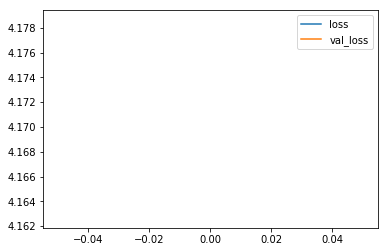

Epoch 2/300000
49091/49091 [==============================] - 2520s 51ms/step - loss: 4.1726 - val_loss: 4.1090
train loss: 4.172561950001329
validation loss: 4.1090342343345245


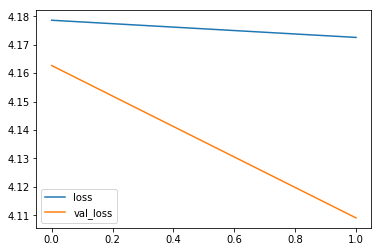

Epoch 3/300000
49091/49091 [==============================] - 3464s 71ms/step - loss: 4.1558 - val_loss: 4.0645
train loss: 4.155835807263962
validation loss: 4.064511109447392


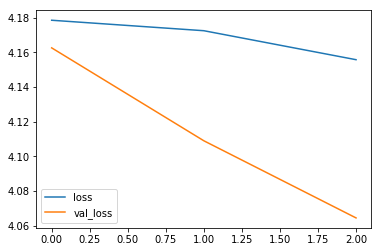

Epoch 4/300000
49091/49091 [==============================] - 595s 12ms/step - loss: 4.1517 - val_loss: 4.1827
train loss: 4.151682414131625
validation loss: 4.1827409666465245


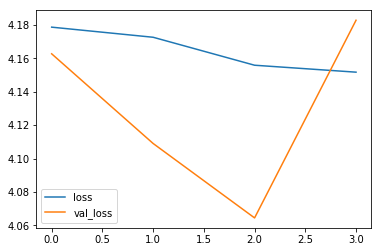

Epoch 5/300000
49091/49091 [==============================] - 2561s 52ms/step - loss: 4.1515 - val_loss: 4.0805
train loss: 4.151453175622154
validation loss: 4.080461228735178


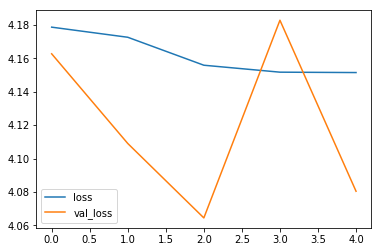

Epoch 6/300000
49091/49091 [==============================] - 2929s 60ms/step - loss: 4.1375 - val_loss: 4.2913
train loss: 4.137527350464787
validation loss: 4.291328180874301


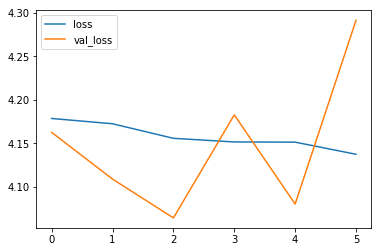

Epoch 7/300000
49091/49091 [==============================] - 1377s 28ms/step - loss: 4.1524 - val_loss: 4.2501
train loss: 4.152364701879519
validation loss: 4.250086275707353


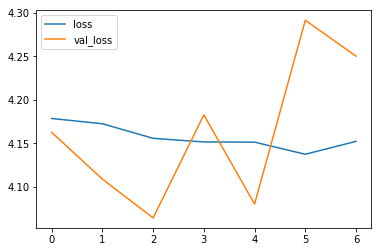

Epoch 8/300000
49091/49091 [==============================] - 611s 12ms/step - loss: 4.1314 - val_loss: 4.0974
train loss: 4.13138217099518
validation loss: 4.09743666425962


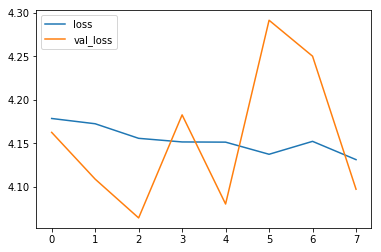

Epoch 9/300000
49091/49091 [==============================] - 577s 12ms/step - loss: 4.1248 - val_loss: 4.2514
train loss: 4.124783927056646
validation loss: 4.251405643389708


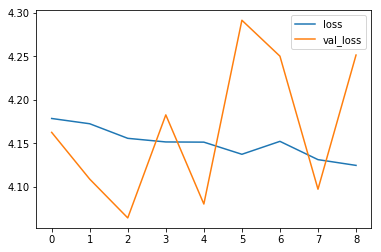

Epoch 10/300000
49091/49091 [==============================] - 582s 12ms/step - loss: 4.1260 - val_loss: 4.1722
train loss: 4.126044022811365
validation loss: 4.172221061661088


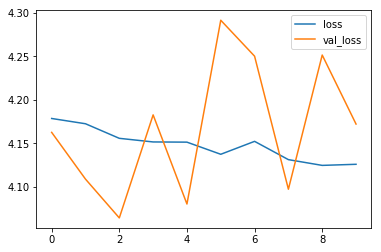

Epoch 11/300000
13312/49091 [=======>......................] - ETA: 7:32 - loss: 4.1787

In [ ]:
history_2_2 = model_2_2.fit(X_train_2_2, y_train_2_2, batch_size=1024, verbose=1, nb_epoch=300000, validation_split = 0.1, callbacks=[plot_losses], shuffle = True)

from IPython.display import clear_output
import keras
import matplotlib.pyplot as plt

class PlotLosses(keras.callbacks.Callback):
    def on_train_begin(self, logs={}):
        self.i = 0
        self.x = []
        self.losses = []
        self.val_losses = []
        
        self.fig = plt.figure()
        
        self.logs = []

    def on_epoch_end(self, epoch, logs={}):
        
        self.logs.append(logs)
        self.x.append(self.i)
        self.losses.append(logs.get('loss'))
        self.val_losses.append(logs.get('val_loss'))
        self.i += 1
        
        #clear_output(wait=True)
        print("train loss: {}".format(self.losses[-1]))
        print("validation loss: {}".format(self.val_losses[-1]))
        plt.plot(self.x, self.losses, label="loss")
        plt.plot(self.x, self.val_losses, label="val_loss")
        plt.legend()
        plt.show();
        
plot_losses = PlotLosses()

In [31]:
a = model_2_2.predict(X_test_2_2)

In [39]:
i = 50
j = 0
for index, x in enumerate(a[i]):
    print("prediction:{}".format(scaler_2_2.inverse_transform(a[i])[index]))
    print("test set:{}".format(scaler_2_2.inverse_transform(y_test_2_2[i])[index]))
    print()
    
print(scaler_2_2.inverse_transform(a[i]))
print(scaler_2_2.inverse_transform(y_test_2_2[i]))

prediction:[  1.15704492e-01   8.33059549e-02   8.32368508e-02   3.67612131e-02
   5.09808235e+01   4.64153786e+01   1.63114014e+02   4.62536507e+01
   4.67387199e+01   1.88529480e+02]
test set:[  7.09412992e-02   4.93073277e-02   5.55086993e-02   4.35611000e-03
  -5.90536003e+01  -4.28886986e+01  -1.78539993e+02  -5.90536003e+01
  -4.28886986e+01  -1.78539001e+02]

prediction:[  1.10712342e-01   7.84150884e-02   7.95405358e-02   3.02826036e-02
   9.31165390e+01   8.50679550e+01   3.27230316e+02   8.45676193e+01
   8.79602509e+01   3.35447052e+02]
test set:[  7.76197985e-02   4.38835360e-02   4.87652011e-02   1.19668001e-03
  -3.96697998e+01  -5.90265999e+01  -9.56694031e+01  -3.96710014e+01
  -5.90259018e+01  -9.56725006e+01]

prediction:[  0.14984477   0.1120979    0.11137805   0.07498824 -60.16738129
 -47.30195999 -72.3567276  -56.83273315 -48.96686935 -44.4812088 ]
test set:[  7.23178983e-02   5.54024614e-02   5.85592017e-02   2.91645993e-02
  -6.02832985e+01  -9.88852005e+01  -2.7